# ARIMAX_SE with GRIDSEARCH_CV and PCA on ADM0, MONTHLY

In [1]:
import pandas as pd

# pd.set_option('display.max_rows', 500)
# pd.set_option('display.max_columns', 500)

import warnings
warnings.simplefilter('ignore')

import warnings
from statsmodels.tools.sm_exceptions import ConvergenceWarning
warnings.simplefilter('ignore', ConvergenceWarning)
    
import time
import datetime

import os

## Model Specifications

In [2]:
TARGET_VARIABLE = "SUM(FATALITIES)"
SEASONAL_PERIODICITY = 12 # for data frequency & seasonality S

SEASONALITY = False
NEIGHBORS = False # X_N
SOCIO_ECO_VARS = True # X_SE
N_LAGS_X = 1 # todo: remove or change behavior from max lags to lag
DIM_REDUCTION_METHOD = "PCA"

if SEASONALITY:
    CV_FOLDS = 5
else:
    CV_FOLDS = 5

In [3]:
MODEL_NAME = ""
if SEASONALITY:
    MODEL_NAME += "S" 
    
MODEL_NAME += "ARIMA"

if SOCIO_ECO_VARS and NEIGHBORS:
    MODEL_NAME += "X_SE+N"
    
if SOCIO_ECO_VARS and not NEIGHBORS:
    MODEL_NAME += "X_SE"
    
if not SOCIO_ECO_VARS and NEIGHBORS:
    MODEL_NAME += "X_N"
    
if SEASONAL_PERIODICITY ==  12:
    MODEL_NAME += "_MONTHLY"
elif SEASONAL_PERIODICITY == 4:
    MODEL_NAME += "_QUARTERLY"

MODEL_NAME

'ARIMAX_SE_MONTHLY'

### Hyperparameter Grid

In [4]:
# create a set of sarima configs to try
PARAM_GRID = list()
# parameter options to try

### PCA
if NEIGHBORS or SOCIO_ECO_VARS:
    n_components = range(0, 4) # include up to three main components
else:
    n_components = [0]
    

### ARMA
p_params = range(4) # AR 3
d_params = range(2) # Differencing 1
q_params = range(4) # MA 3


### SEASONALITY
if SEASONALITY:
    P_params = range(3) # 5
    D_params = range(2) # 1
    Q_params = range(3) # 2
    
    ### TREND
    # t_params = ['n','c','t','ct'] # Form of Trend
    # t_params = ['n', 't', 'ct'] # Form of Trend
    t_params = ["n"]

    ### SEASONAL PERIODICITY
    m_params = [SEASONAL_PERIODICITY]   
else:
    P_params = [0]
    D_params = [0]
    Q_params = [0]

    t_params = ["n"] # Form of Trend

    m_params = [0] 

for n in n_components:
    for p in p_params:
        for d in d_params:
            for q in q_params:
                for P in P_params:
                    for D in D_params:
                        for Q in Q_params:
                            for m in m_params:
                                for t in t_params:
                                    cfg = [n, (p, d, q), (P, D, Q, m), t]
                                    PARAM_GRID.append(cfg)
len(PARAM_GRID)    

128

## Model Training

In [5]:
from common_functions import *
from forecasters import *

#### Training Method

In [6]:
def sarimax(target_variable="SUM(FATALITIES)", 
            target_country="MLI", 
            predictor_countries=["BFA"], 
            n_lags_X = N_LAGS_X, 
            seasonal_periodicity = SEASONAL_PERIODICITY):
        
    ### GET DATA
    y, X = getData(target_variable = target_variable, 
                   target_country = target_country, 
                   predictor_countries = predictor_countries,
                   socio_eco_vars = SOCIO_ECO_VARS,
                   n_lags_X = N_LAGS_X, 
                   seasonal_periodicity = SEASONAL_PERIODICITY)
    
    ### SPLIT DATA
    X_train, X_test, y_train, y_test = train_test_split(y = y,
                                                        X = X, 
                                                        forecast_horizon = SEASONAL_PERIODICITY)
    
    ### TRAINING WITH GRIDSEARCHCV
    gscv = GridSearchCV(param_grid = PARAM_GRID,
                        forecaster = TimeSeriesForecasterPCA_LinInt,
                        seasonal_periodicity = SEASONAL_PERIODICITY,
                        cv_folds = CV_FOLDS)
    training_res = gscv.train(X_train, y_train)

    if training_res is not None:
        model = gscv
        # print ARIMA summary
        print(training_res)
        print(model.best_model_result.mle_retvals)
        plt.tight_layout()
        try:
            model.best_model_result.plot_diagnostics(figsize=(16*0.7, 10*0.7), lags = SEASONAL_PERIODICITY+1)
        except: 
            pass
        best_parameters = str(model.best_model_cv_results)
        
    else:
        print("No model fitted --> Prediction with Naive Model ")
        model = NoChange().fit(X_train, y_train)
        best_parameters = np.nan
        
    ### PREDICTION
    prediction_results = model.evaluate_model(X_test, y_test, fh = SEASONAL_PERIODICITY)
    
    if prediction_results["FAT_PRED"].isnull().values.any():
        model = NoChange().fit(X_train, y_train)
        print("Model Prediction failed --> Prediction with Naive Model ")
        model = NoChange().fit(X_train, y_train)
        best_parameters = np.nan
        prediction_results = model.evaluate_model(X_test, y_test, fh = SEASONAL_PERIODICITY)
    
    ### ADJUST RESULT DF
    prediction_results["GID_0"] = target_country
    prediction_results["MONTH"] = pd.to_datetime(prediction_results["MONTH"].astype(str)) 
    prediction_results["PARAMETERS"] = best_parameters

    print(prediction_results)

    return prediction_results

#### Automated Training for all 234 Countries 

In [7]:
acled_monthly_adm0 = pd.read_csv("../data/TB003_EVENT_OUTCOMES_MONTHLY_START_DATE.csv")
gid0_neighbors = pd.read_csv("../data/GID_0_Neighbours.csv")
# gid_list = acled_monthly_adm0["GID_0"].unique()[::-1] #reverse
gid_list = acled_monthly_adm0["GID_0"].unique()
len(gid_list)

234

######## ABW (1/234) #########
0
Neighbor countries: []
Getting Data for ABW
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (38, 35)
y: (38, 1)
------------------------------------------------
Training started.
y_train is all zero. No GSCV necessary.
Best CV-Results
{}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_ABW   No. Observations:                   26
Model:                         SARIMAX   Log Likelihood                 275.444
Date:                 Wed, 19 Oct 2022   AIC                           -548.887
Time:                         10:23:23   BIC                           -547.629
Sample:                     01-31-2019   HQIC                          -548.525
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err

<Figure size 432x288 with 0 Axes>

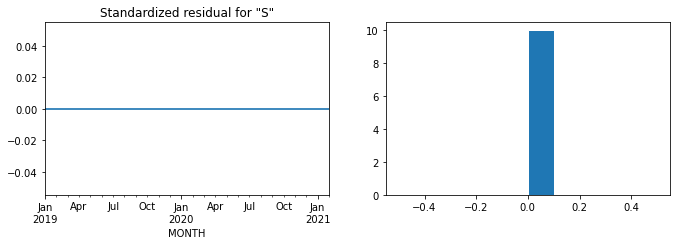

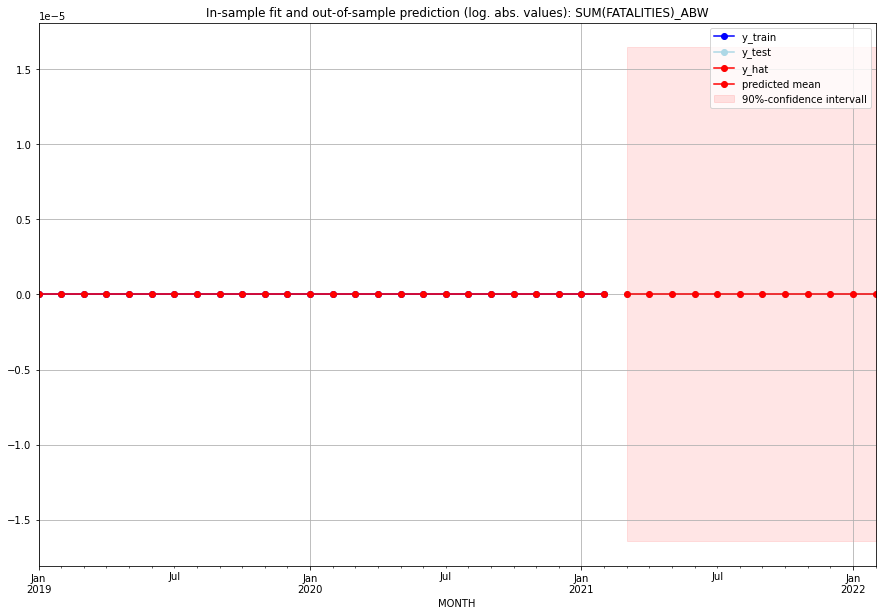

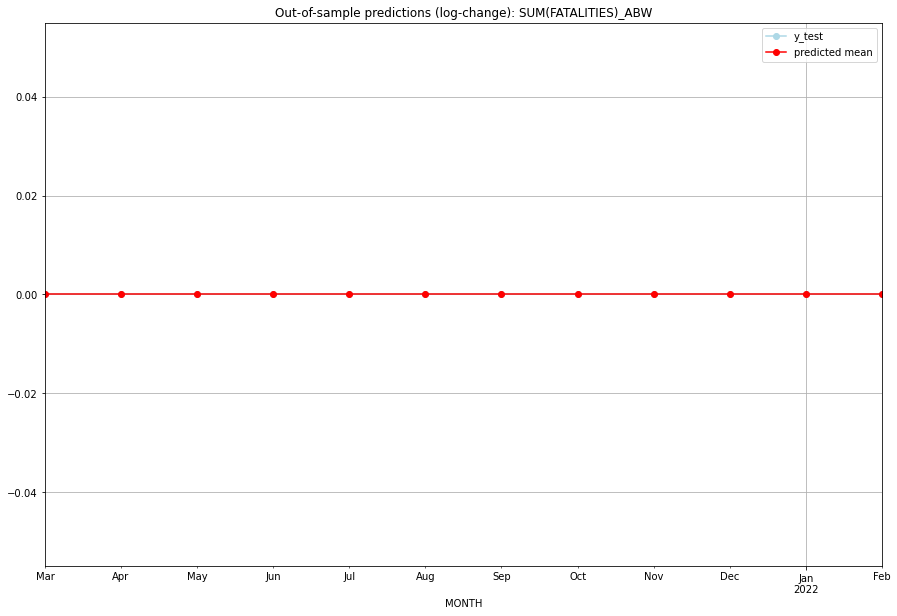

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   ABW   
1  2021-04-01       0.0         0.0           0.0             0.0   ABW   
2  2021-05-01       0.0         0.0           0.0             0.0   ABW   
3  2021-06-01       0.0         0.0           0.0             0.0   ABW   
4  2021-07-01       0.0         0.0           0.0             0.0   ABW   
5  2021-08-01       0.0         0.0           0.0             0.0   ABW   
6  2021-09-01       0.0         0.0           0.0             0.0   ABW   
7  2021-10-01       0.0         0.0           0.0             0.0   ABW   
8  2021-11-01       0.0         0.0           0.0             0.0   ABW   
9  2021-12-01       0.0         0.0           0.0             0.0   ABW   
10 2022-01-01       0.0         0.0           0.0             0.0   ABW   
11 2022-02-01       0.0         0.0           0.0             0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [2, (0, 1, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.2738278939171764, 'fold_results': [nan, 0.27217880221318486, 0.2754769856211679]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_AFG   No. Observations:                   50
Model:                SARIMAX(0, 1, 3)   Log Likelihood                  -2.200
Date:                 Wed, 19 Oct 2022   AIC                             16.400
Time:                         10:23:53   BIC                             27.751
Sample:                     01-31-2017   HQIC                            20.707
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             0.0427  

<Figure size 432x288 with 0 Axes>

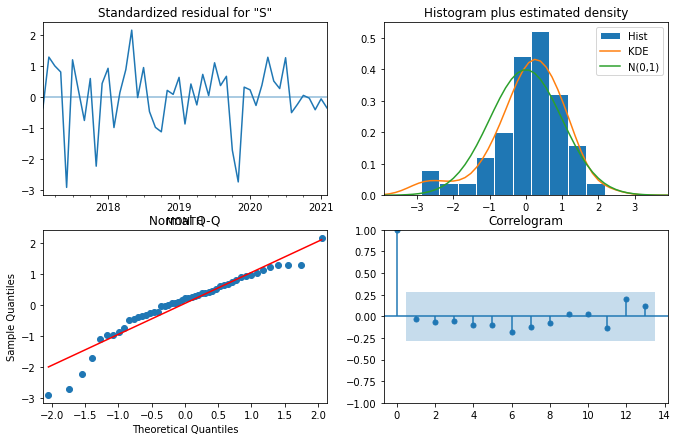

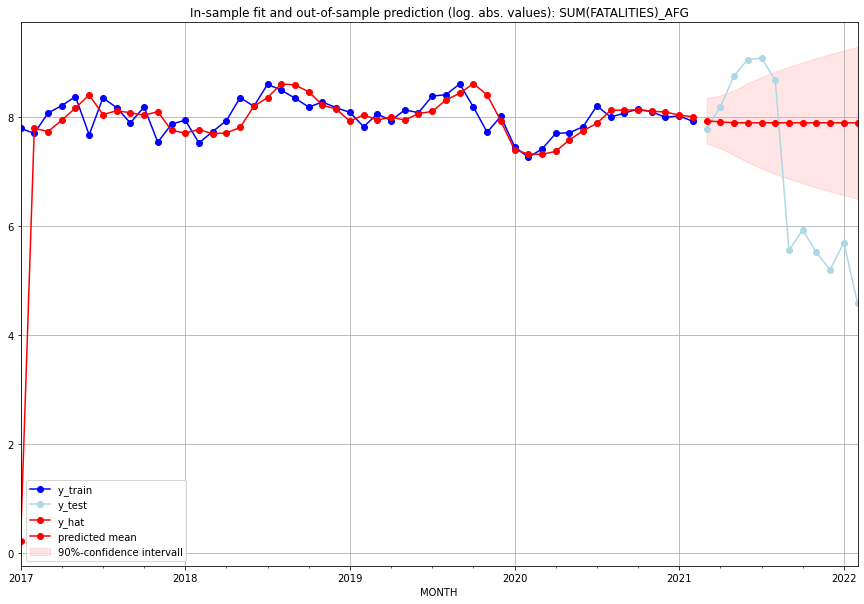

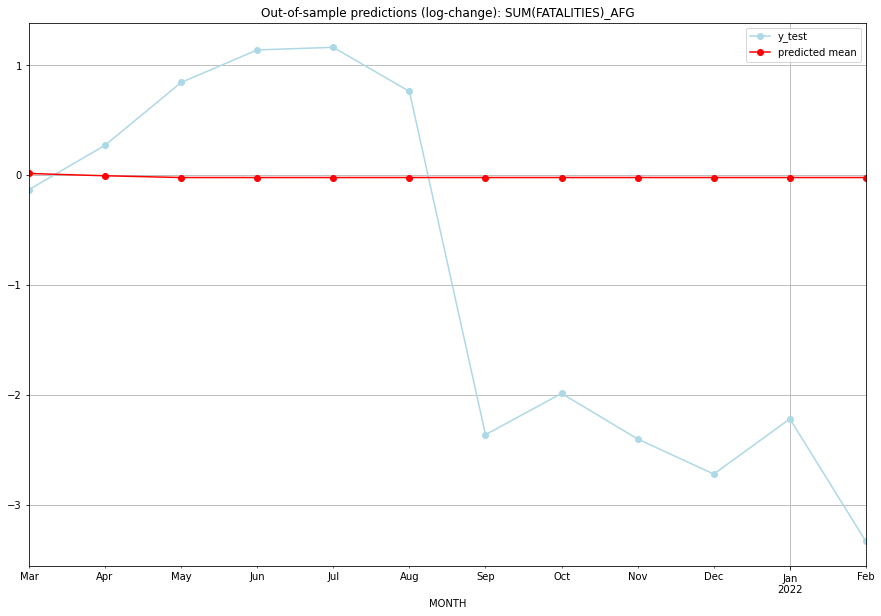

TADDA: 1.6189968613741386
Evaluation finished.
        MONTH     FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  2787.930911      2406.0      0.012241       -0.135036   AFG   
1  2021-04-01  2730.962842      3606.0     -0.008397        0.269459   AFG   
2  2021-05-01  2687.266407      6384.0     -0.024521        0.840534   AFG   
3  2021-06-01  2687.266407      8584.0     -0.024521        1.136599   AFG   
4  2021-07-01  2687.266407      8791.0     -0.024521        1.160425   AFG   
5  2021-08-01  2687.266407      5884.0     -0.024521        0.758989   AFG   
6  2021-09-01  2687.266407       258.0     -0.024521       -2.364345   AFG   
7  2021-10-01  2687.266407       376.0     -0.024521       -1.988928   AFG   
8  2021-11-01  2687.266407       248.0     -0.024521       -2.403720   AFG   
9  2021-12-01  2687.266407       180.0     -0.024521       -2.722676   AFG   
10 2022-01-01  2687.266407       298.0     -0.024521       -2.220729   AFG   
11 2022-02-01  26

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (0, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.9842262050704302, 'fold_results': [1.7389615744397713, 1.0121323662267203, 0.7967262928138655, 0.6057560463000363, 0.7675547455717581]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_AGO   No. Observations:                  289
Model:                SARIMAX(0, 1, 0)   Log Likelihood                -502.539
Date:                 Wed, 19 Oct 2022   AIC                           1013.078
Time:                         10:24:23   BIC                           1027.730
Sample:                     02-28-1997   HQIC                          1018.950
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------

<Figure size 432x288 with 0 Axes>

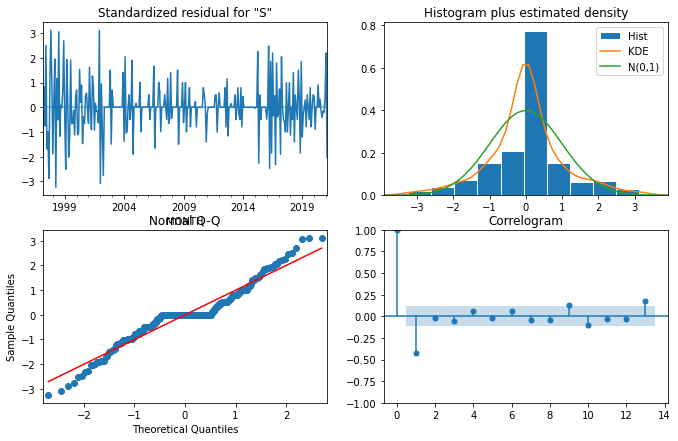

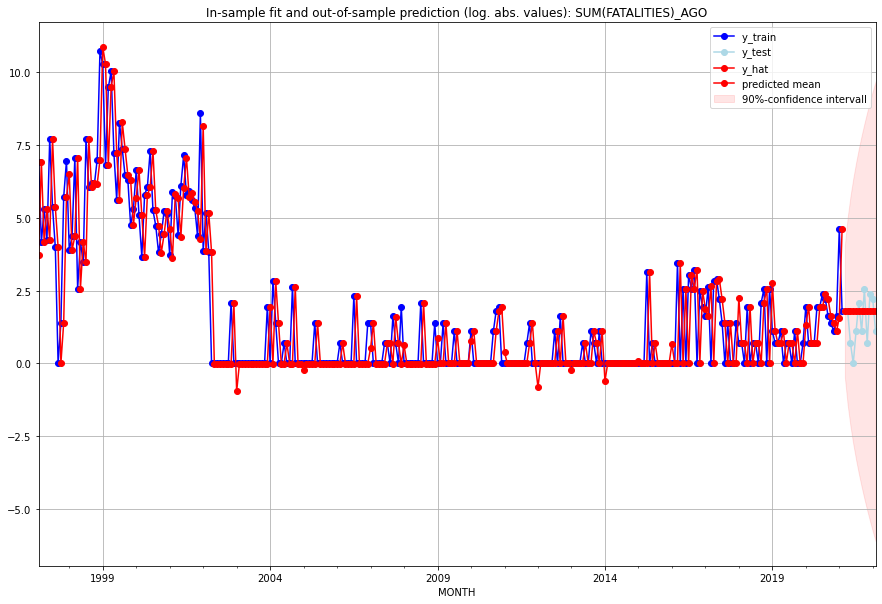

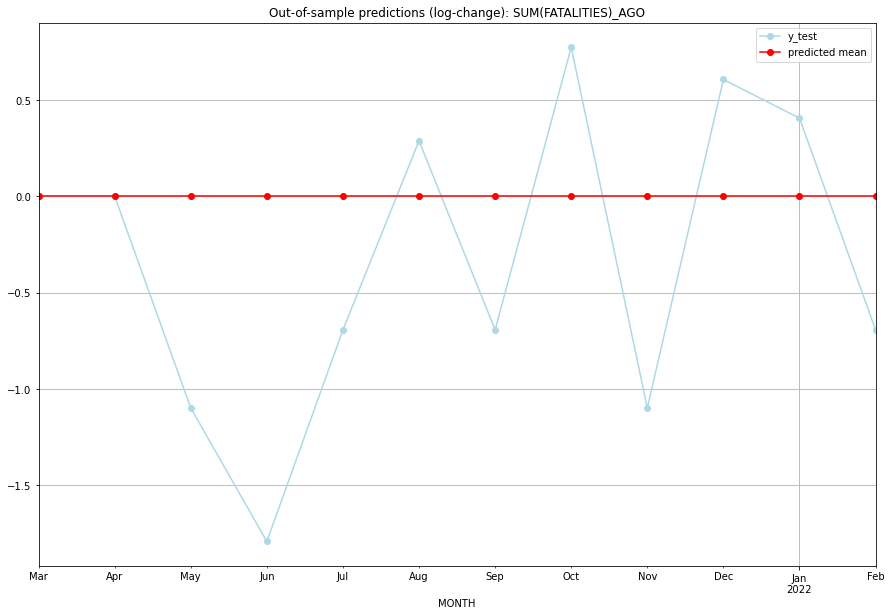

TADDA: 0.6784082050506655
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       5.0         5.0  1.332268e-14        0.000000   AGO   
1  2021-04-01       5.0         5.0  1.332268e-14        0.000000   AGO   
2  2021-05-01       5.0         1.0  1.332268e-14       -1.098612   AGO   
3  2021-06-01       5.0         0.0  1.332268e-14       -1.791759   AGO   
4  2021-07-01       5.0         2.0  1.332268e-14       -0.693147   AGO   
5  2021-08-01       5.0         7.0  1.332268e-14        0.287682   AGO   
6  2021-09-01       5.0         2.0  1.332268e-14       -0.693147   AGO   
7  2021-10-01       5.0        12.0  1.332268e-14        0.773190   AGO   
8  2021-11-01       5.0         1.0  1.332268e-14       -1.098612   AGO   
9  2021-12-01       5.0        10.0  1.332268e-14        0.606136   AGO   
10 2022-01-01       5.0         8.0  1.332268e-14        0.405465   AGO   
11 2022-02-01       5.0         2.0  1.332268e-14    

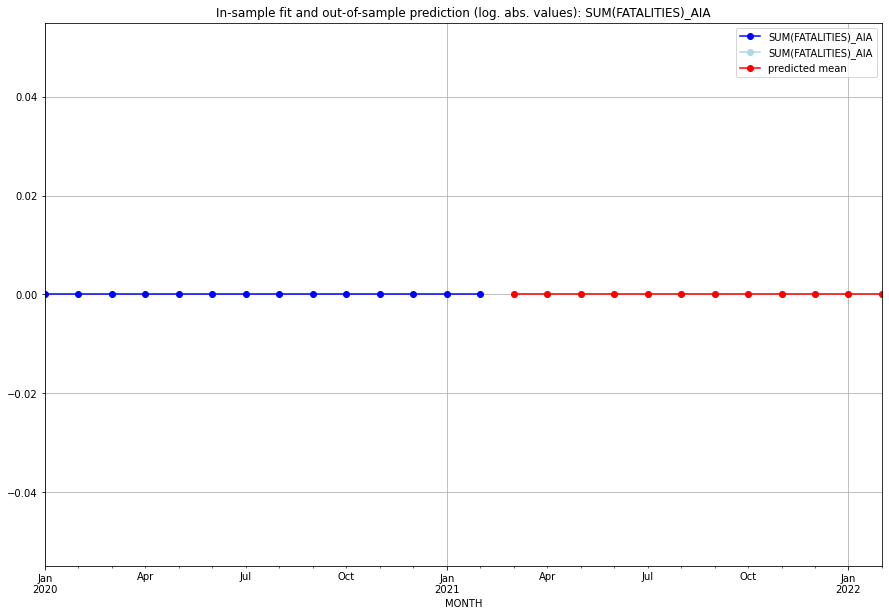

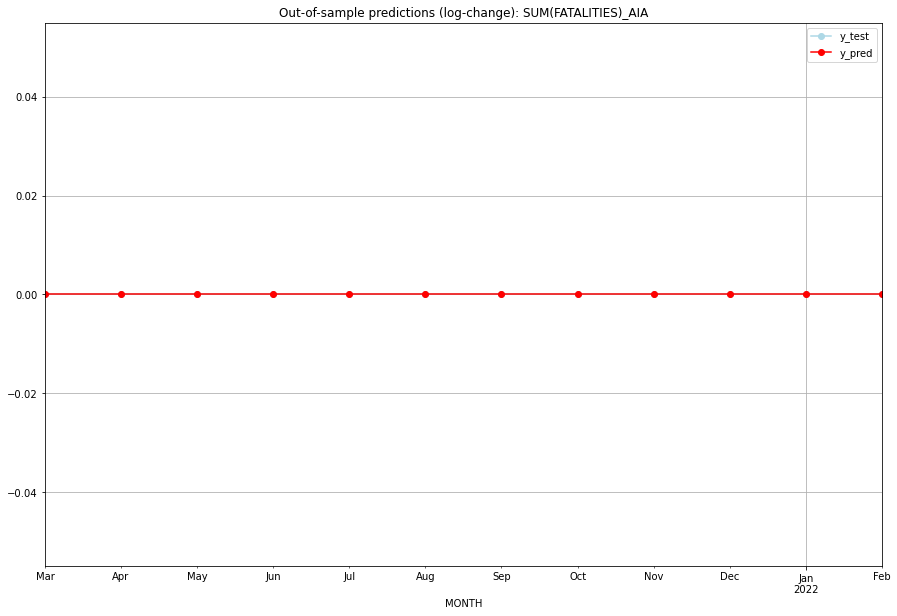

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   AIA   
1  2021-04-01       0.0         0.0           0.0             0.0   AIA   
2  2021-05-01       0.0         0.0           0.0             0.0   AIA   
3  2021-06-01       0.0         0.0           0.0             0.0   AIA   
4  2021-07-01       0.0         0.0           0.0             0.0   AIA   
5  2021-08-01       0.0         0.0           0.0             0.0   AIA   
6  2021-09-01       0.0         0.0           0.0             0.0   AIA   
7  2021-10-01       0.0         0.0           0.0             0.0   AIA   
8  2021-11-01       0.0         0.0           0.0             0.0   AIA   
9  2021-12-01       0.0         0.0           0.0             0.0   AIA   
10 2022-01-01       0.0         0.0           0.0             0.0   AIA   
11 2022-02-01       0.0         0.0           0.0             0.0   

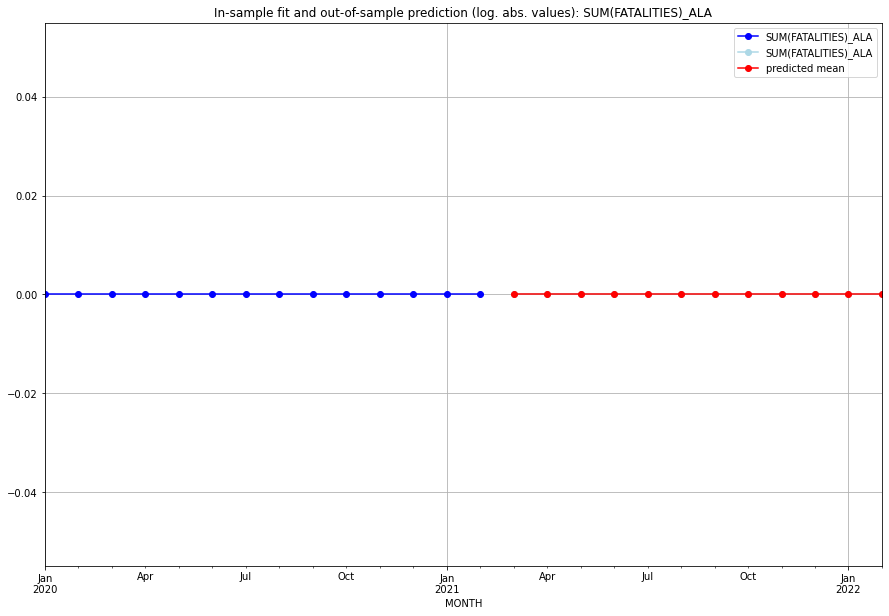

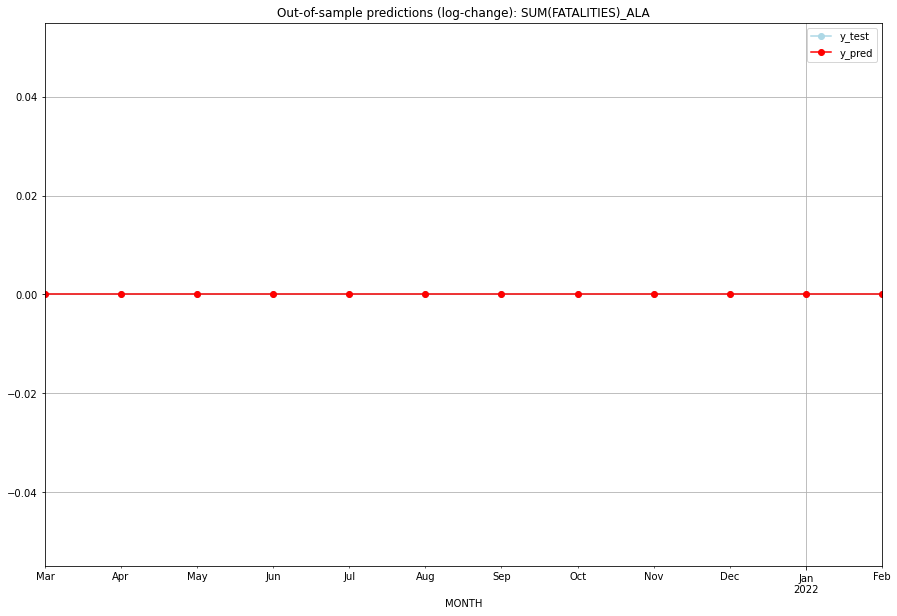

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   ALA   
1  2021-04-01       0.0         0.0           0.0             0.0   ALA   
2  2021-05-01       0.0         0.0           0.0             0.0   ALA   
3  2021-06-01       0.0         0.0           0.0             0.0   ALA   
4  2021-07-01       0.0         0.0           0.0             0.0   ALA   
5  2021-08-01       0.0         0.0           0.0             0.0   ALA   
6  2021-09-01       0.0         0.0           0.0             0.0   ALA   
7  2021-10-01       0.0         0.0           0.0             0.0   ALA   
8  2021-11-01       0.0         0.0           0.0             0.0   ALA   
9  2021-12-01       0.0         0.0           0.0             0.0   ALA   
10 2022-01-01       0.0         0.0           0.0             0.0   ALA   
11 2022-02-01       0.0         0.0           0.0             0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.0, 'fold_results': [0.0, 0.0]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_ALB   No. Observations:                   38
Model:                         SARIMAX   Log Likelihood                  29.122
Date:                 Wed, 19 Oct 2022   AIC                            -56.244
Time:                         10:24:41   BIC                            -54.606
Sample:                     01-31-2018   HQIC                           -55.661
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.0126      0.001     18.748      0.000       0.011       0

<Figure size 432x288 with 0 Axes>

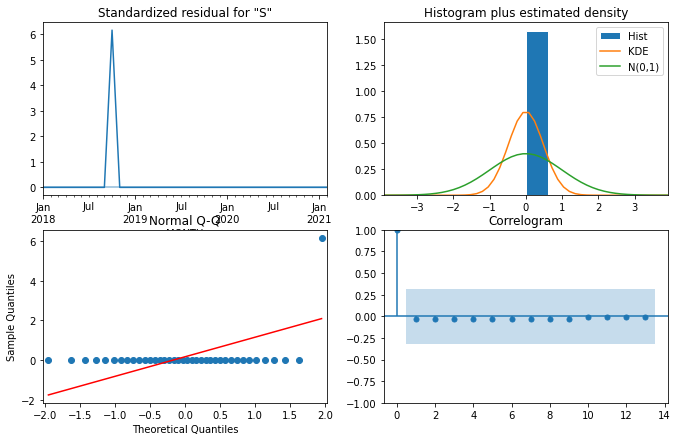

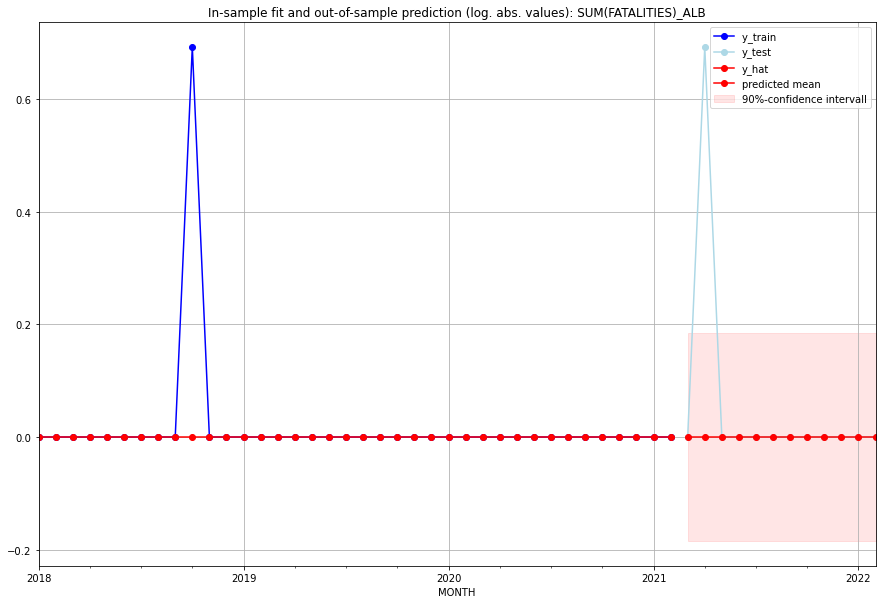

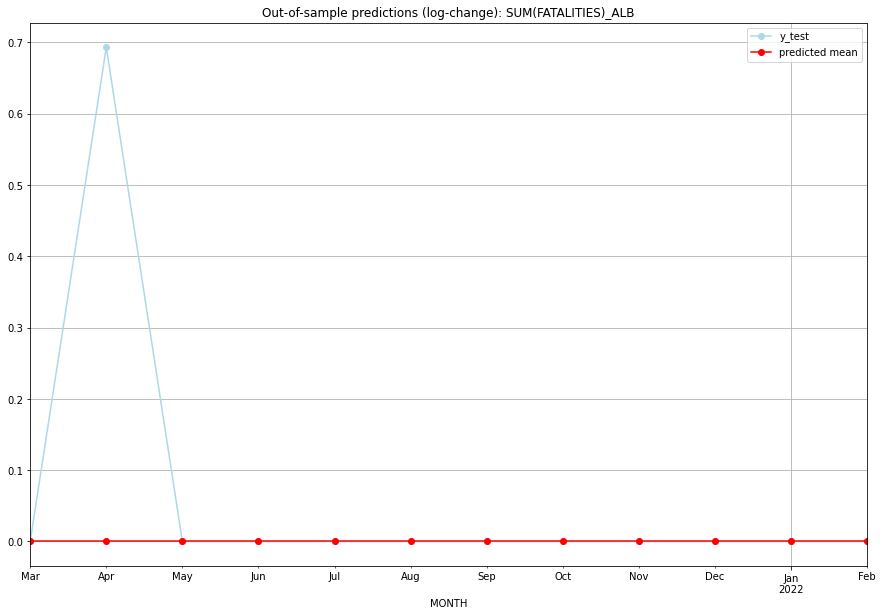

TADDA: 0.057762265046662105
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0        0.000000   ALB   
1  2021-04-01       0.0         1.0           0.0        0.693147   ALB   
2  2021-05-01       0.0         0.0           0.0        0.000000   ALB   
3  2021-06-01       0.0         0.0           0.0        0.000000   ALB   
4  2021-07-01       0.0         0.0           0.0        0.000000   ALB   
5  2021-08-01       0.0         0.0           0.0        0.000000   ALB   
6  2021-09-01       0.0         0.0           0.0        0.000000   ALB   
7  2021-10-01       0.0         0.0           0.0        0.000000   ALB   
8  2021-11-01       0.0         0.0           0.0        0.000000   ALB   
9  2021-12-01       0.0         0.0           0.0        0.000000   ALB   
10 2022-01-01       0.0         0.0           0.0        0.000000   ALB   
11 2022-02-01       0.0         0.0           0.0  

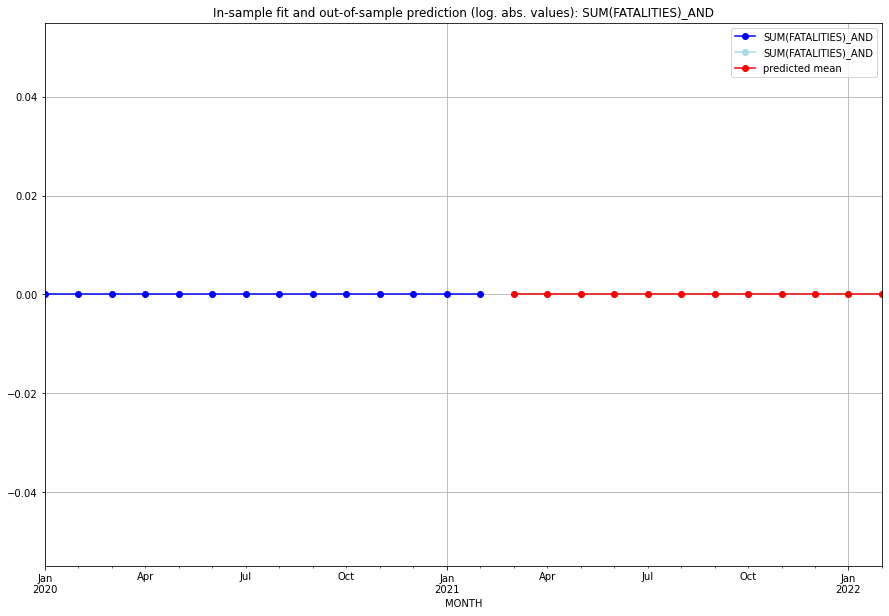

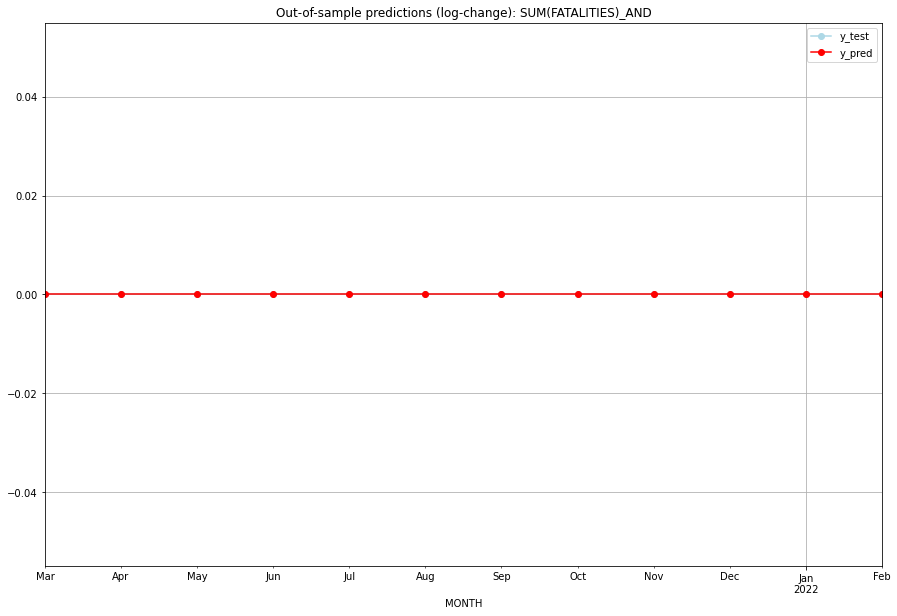

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   AND   
1  2021-04-01       0.0         0.0           0.0             0.0   AND   
2  2021-05-01       0.0         0.0           0.0             0.0   AND   
3  2021-06-01       0.0         0.0           0.0             0.0   AND   
4  2021-07-01       0.0         0.0           0.0             0.0   AND   
5  2021-08-01       0.0         0.0           0.0             0.0   AND   
6  2021-09-01       0.0         0.0           0.0             0.0   AND   
7  2021-10-01       0.0         0.0           0.0             0.0   AND   
8  2021-11-01       0.0         0.0           0.0             0.0   AND   
9  2021-12-01       0.0         0.0           0.0             0.0   AND   
10 2022-01-01       0.0         0.0           0.0             0.0   AND   
11 2022-02-01       0.0         0.0           0.0             0.0   

<Figure size 432x288 with 0 Axes>

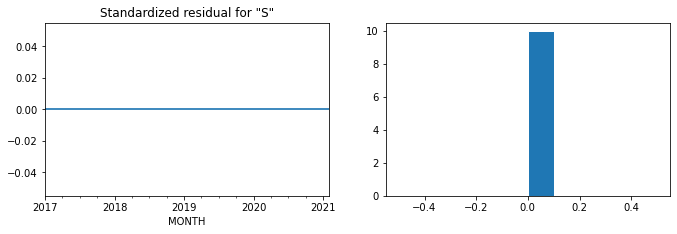

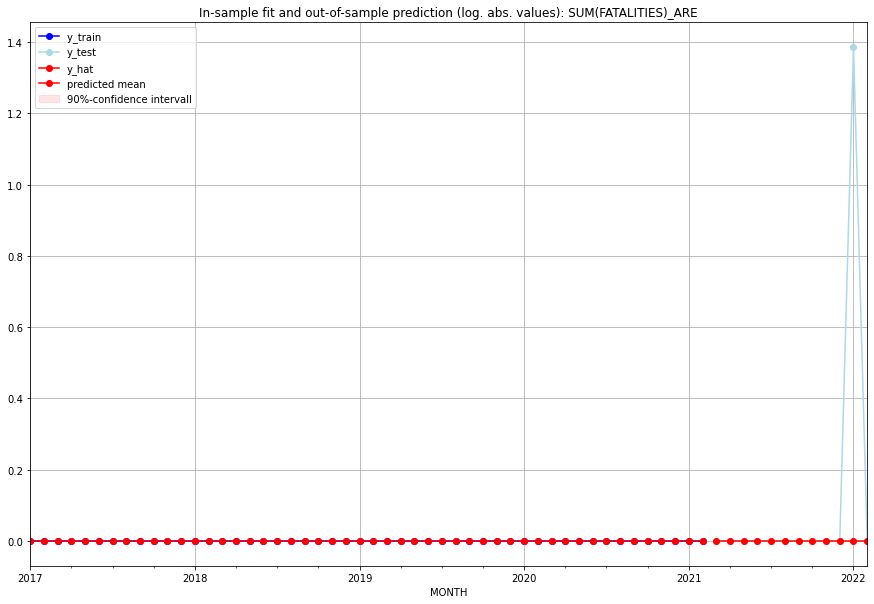

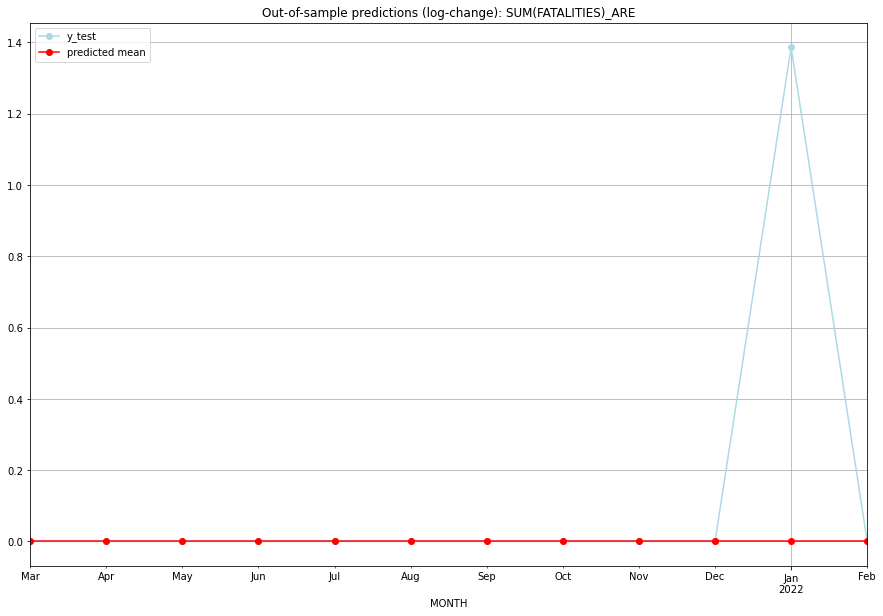

TADDA: 0.11552453009332421
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0        0.000000   ARE   
1  2021-04-01       0.0         0.0           0.0        0.000000   ARE   
2  2021-05-01       0.0         0.0           0.0        0.000000   ARE   
3  2021-06-01       0.0         0.0           0.0        0.000000   ARE   
4  2021-07-01       0.0         0.0           0.0        0.000000   ARE   
5  2021-08-01       0.0         0.0           0.0        0.000000   ARE   
6  2021-09-01       0.0         0.0           0.0        0.000000   ARE   
7  2021-10-01       0.0         0.0           0.0        0.000000   ARE   
8  2021-11-01       0.0         0.0           0.0        0.000000   ARE   
9  2021-12-01       0.0         0.0           0.0        0.000000   ARE   
10 2022-01-01       0.0         3.0           0.0        1.386294   ARE   
11 2022-02-01       0.0         0.0           0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [1, (3, 1, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.4103662779530157, 'fold_results': [nan, 0.4103662779530157]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_ARG   No. Observations:                   38
Model:                SARIMAX(3, 1, 3)   Log Likelihood                 -35.069
Date:                 Wed, 19 Oct 2022   AIC                             86.139
Time:                         10:24:56   BIC                             99.026
Sample:                     01-31-2018   HQIC                            90.682
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -0.0012      0.057     -0.020 

<Figure size 432x288 with 0 Axes>

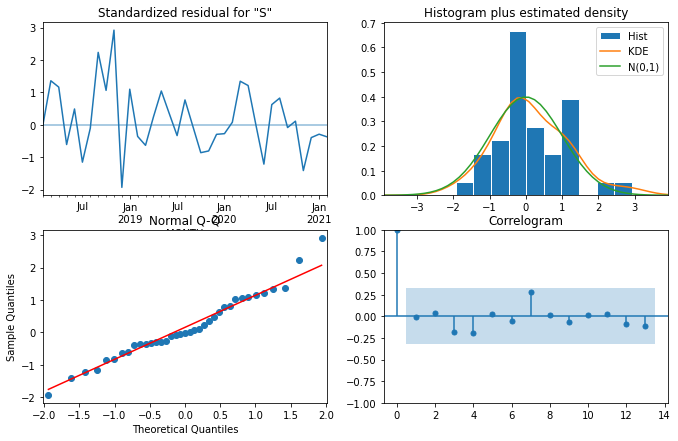

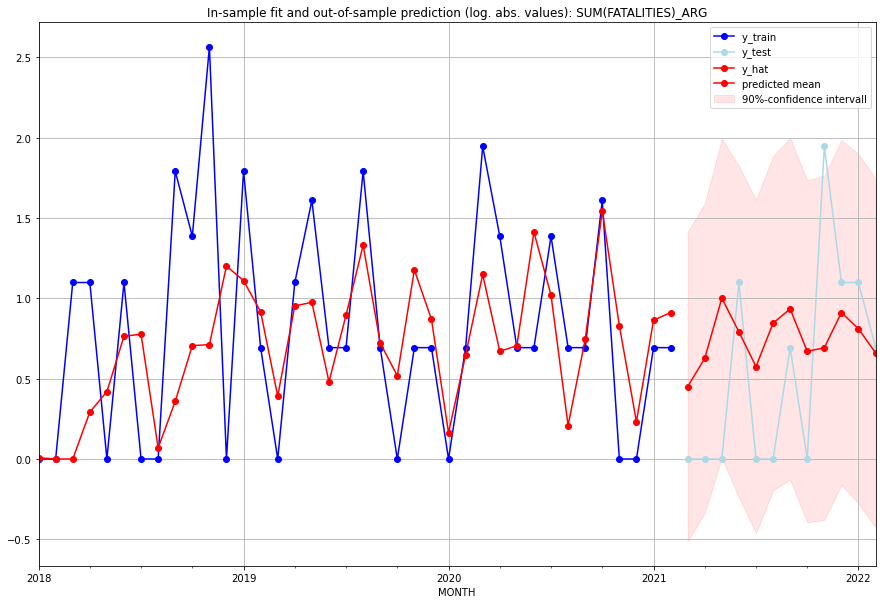

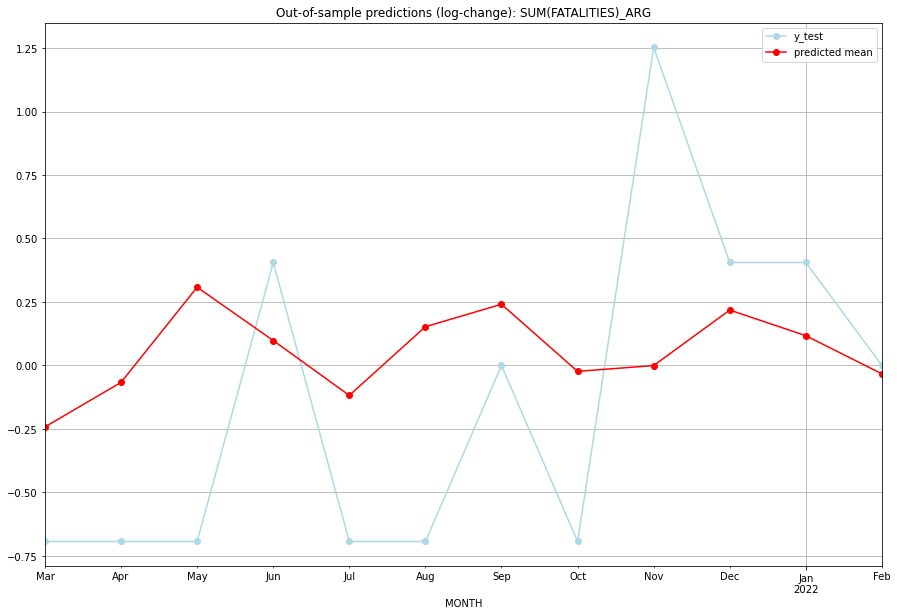

TADDA: 0.5783840264330188
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  0.569892         0.0     -0.242141       -0.693147   ARG   
1  2021-04-01  0.870997         0.0     -0.066676       -0.693147   ARG   
2  2021-05-01  1.721725         0.0      0.308119       -0.693147   ARG   
3  2021-06-01  1.206233         2.0      0.098139        0.405465   ARG   
4  2021-07-01  0.777513         0.0     -0.117932       -0.693147   ARG   
5  2021-08-01  1.329703         0.0      0.152594       -0.693147   ARG   
6  2021-09-01  1.544748         1.0      0.240884        0.000000   ARG   
7  2021-10-01  0.953927         0.0     -0.023306       -0.693147   ARG   
8  2021-11-01  0.999175         6.0     -0.000413        1.252763   ARG   
9  2021-12-01  1.487748         2.0      0.218231        0.405465   ARG   
10 2022-01-01  1.248686         2.0      0.117199        0.405465   ARG   
11 2022-02-01  0.934969         1.0     -0.033056    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (3, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.3807801558867648, 'fold_results': [0.11552453009332421, 0.6460357816802054]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_ARM   No. Observations:                   38
Model:                SARIMAX(3, 1, 0)   Log Likelihood                 -33.205
Date:                 Wed, 19 Oct 2022   AIC                             80.409
Time:                         10:25:10   BIC                             91.686
Sample:                     01-31-2018   HQIC                            84.385
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -0.0401      0

<Figure size 432x288 with 0 Axes>

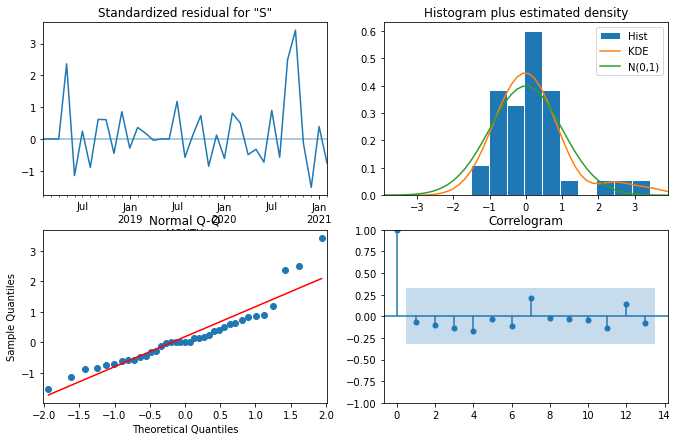

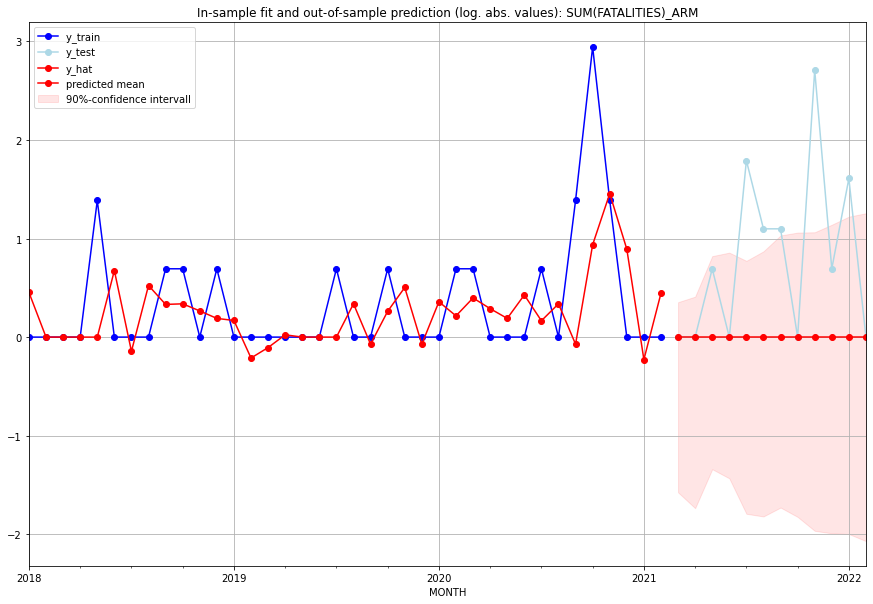

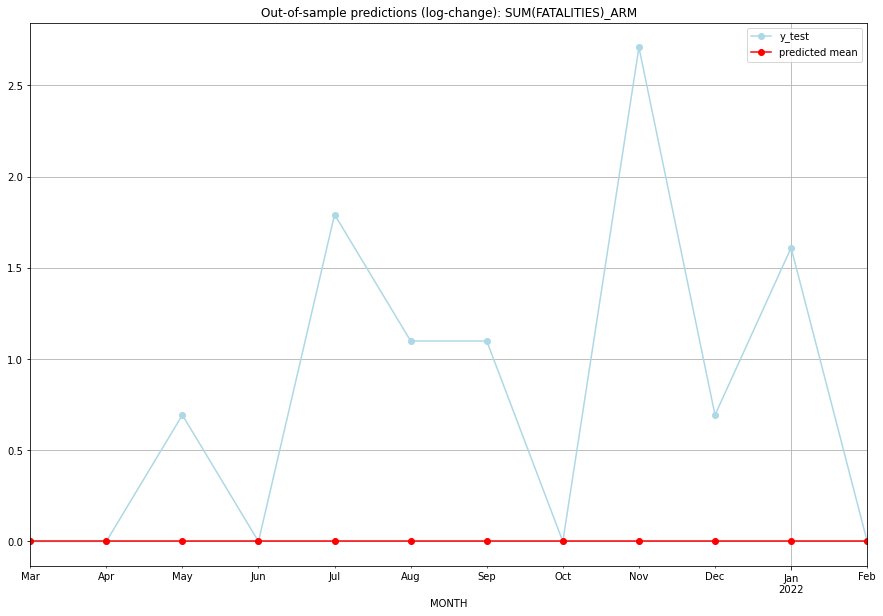

TADDA: 0.8077305434350398
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0        0.000000   ARM   
1  2021-04-01       0.0         0.0           0.0        0.000000   ARM   
2  2021-05-01       0.0         1.0           0.0        0.693147   ARM   
3  2021-06-01       0.0         0.0           0.0        0.000000   ARM   
4  2021-07-01       0.0         5.0           0.0        1.791759   ARM   
5  2021-08-01       0.0         2.0           0.0        1.098612   ARM   
6  2021-09-01       0.0         2.0           0.0        1.098612   ARM   
7  2021-10-01       0.0         0.0           0.0        0.000000   ARM   
8  2021-11-01       0.0        14.0           0.0        2.708050   ARM   
9  2021-12-01       0.0         1.0           0.0        0.693147   ARM   
10 2022-01-01       0.0         4.0           0.0        1.609438   ARM   
11 2022-02-01       0.0         0.0           0.0    

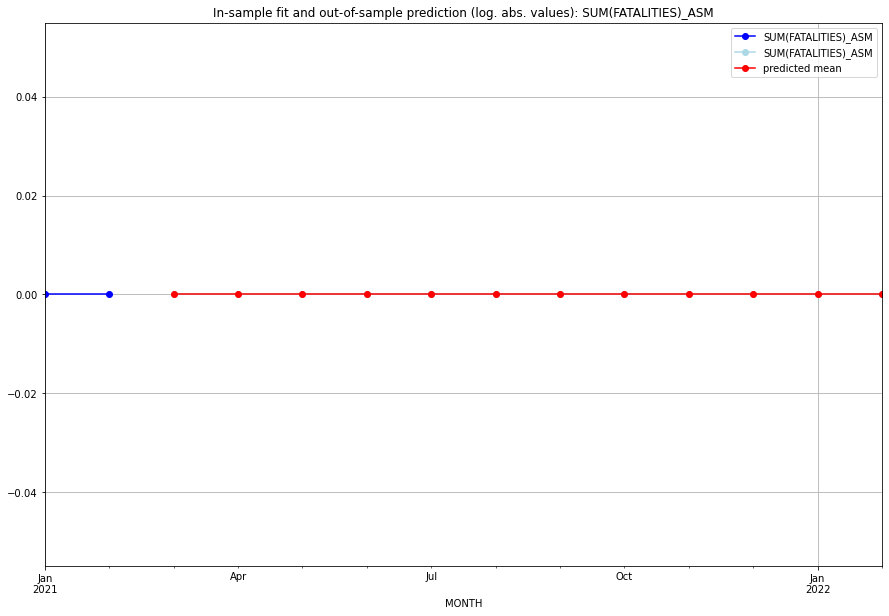

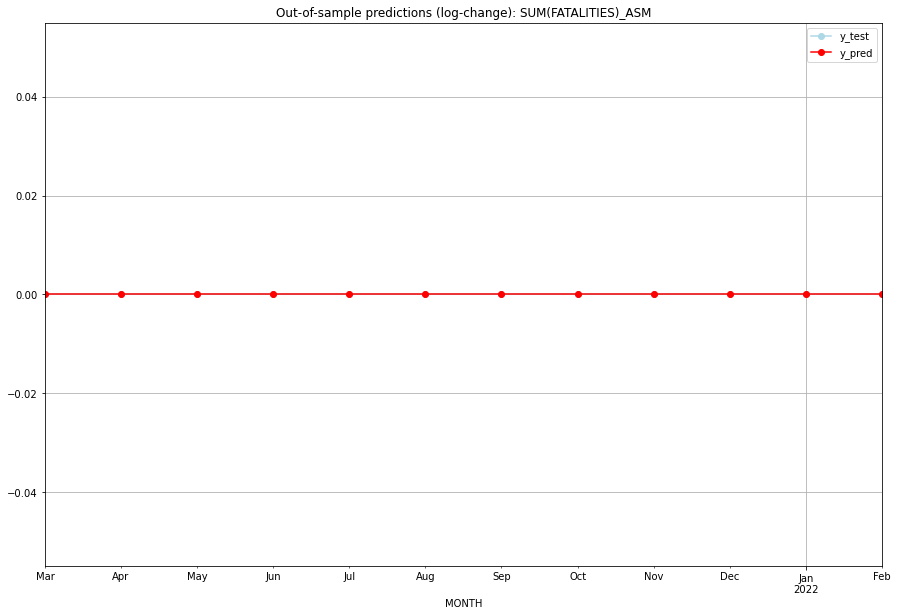

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   ASM   
1  2021-04-01       0.0         0.0           0.0             0.0   ASM   
2  2021-05-01       0.0         0.0           0.0             0.0   ASM   
3  2021-06-01       0.0         0.0           0.0             0.0   ASM   
4  2021-07-01       0.0         0.0           0.0             0.0   ASM   
5  2021-08-01       0.0         0.0           0.0             0.0   ASM   
6  2021-09-01       0.0         0.0           0.0             0.0   ASM   
7  2021-10-01       0.0         0.0           0.0             0.0   ASM   
8  2021-11-01       0.0         0.0           0.0             0.0   ASM   
9  2021-12-01       0.0         0.0           0.0             0.0   ASM   
10 2022-01-01       0.0         0.0           0.0             0.0   ASM   
11 2022-02-01       0.0         0.0           0.0             0.0   

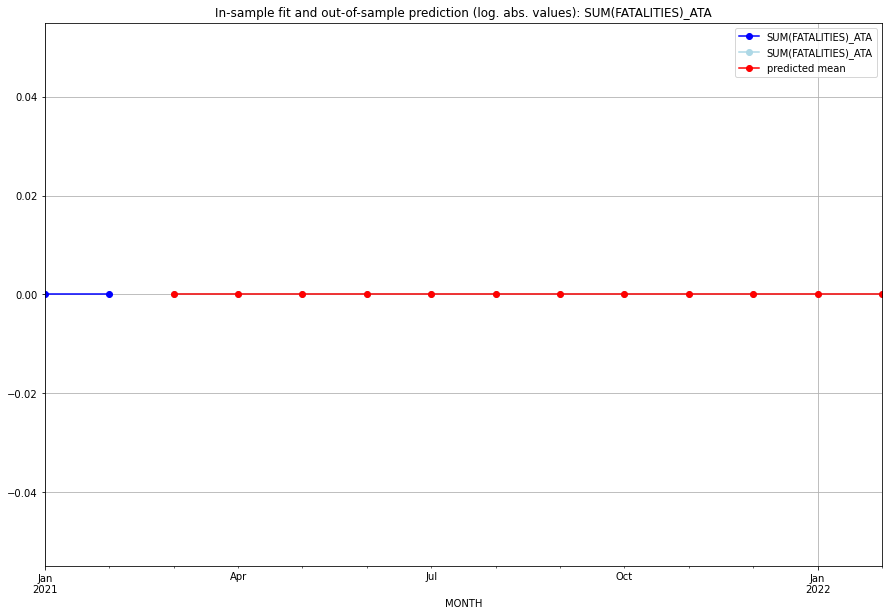

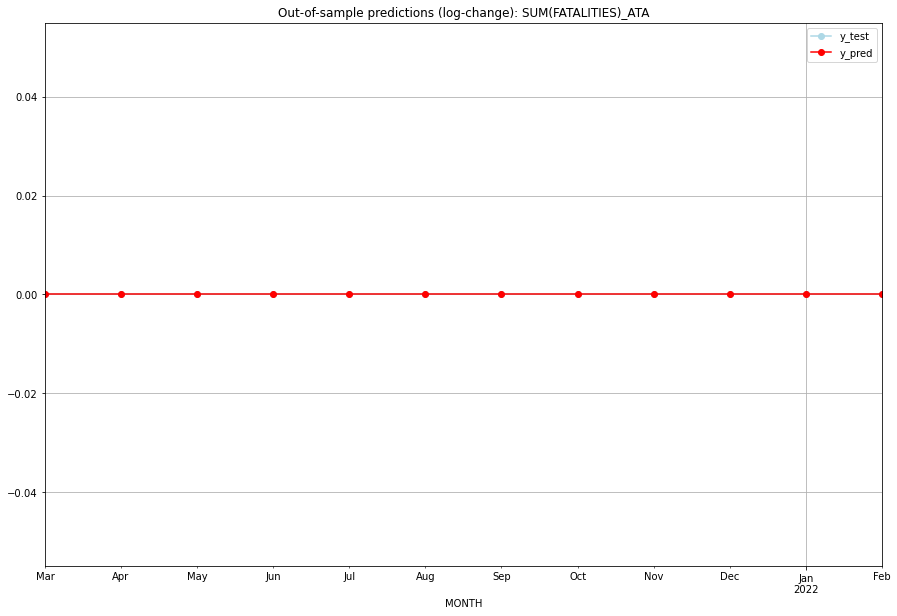

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   ATA   
1  2021-04-01       0.0         0.0           0.0             0.0   ATA   
2  2021-05-01       0.0         0.0           0.0             0.0   ATA   
3  2021-06-01       0.0         0.0           0.0             0.0   ATA   
4  2021-07-01       0.0         0.0           0.0             0.0   ATA   
5  2021-08-01       0.0         0.0           0.0             0.0   ATA   
6  2021-09-01       0.0         0.0           0.0             0.0   ATA   
7  2021-10-01       0.0         0.0           0.0             0.0   ATA   
8  2021-11-01       0.0         0.0           0.0             0.0   ATA   
9  2021-12-01       0.0         0.0           0.0             0.0   ATA   
10 2022-01-01       0.0         0.0           0.0             0.0   ATA   
11 2022-02-01       0.0         0.0           0.0             0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.028881132523331052, 'fold_results': [0.0, 0.057762265046662105]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_ATG   No. Observations:                   38
Model:                         SARIMAX   Log Likelihood                  29.122
Date:                 Wed, 19 Oct 2022   AIC                            -56.244
Time:                         10:25:39   BIC                            -54.606
Sample:                     01-31-2018   HQIC                           -55.661
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.0126      0.001     18.

<Figure size 432x288 with 0 Axes>

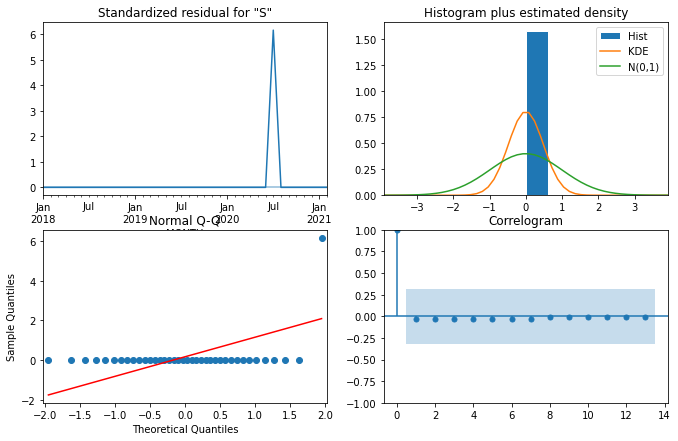

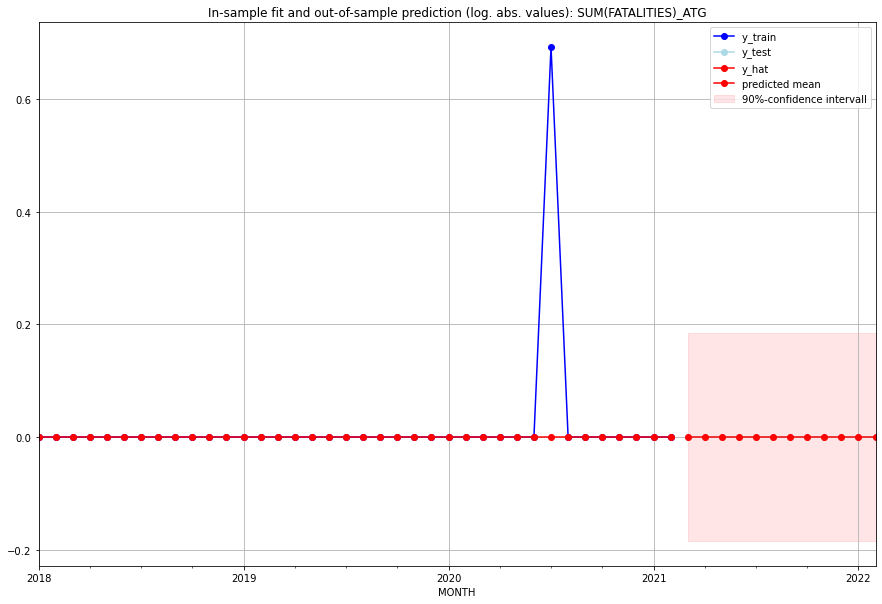

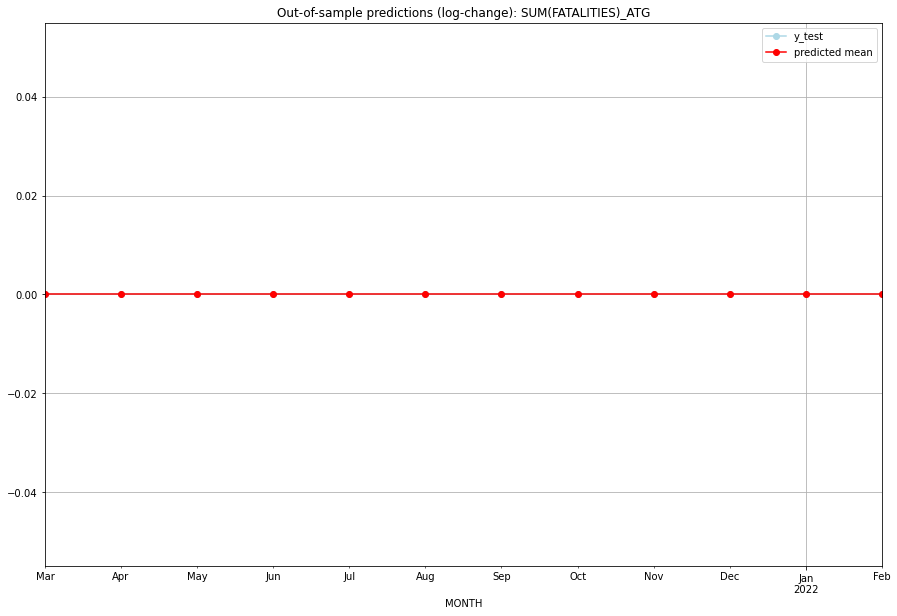

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   ATG   
1  2021-04-01       0.0         0.0           0.0             0.0   ATG   
2  2021-05-01       0.0         0.0           0.0             0.0   ATG   
3  2021-06-01       0.0         0.0           0.0             0.0   ATG   
4  2021-07-01       0.0         0.0           0.0             0.0   ATG   
5  2021-08-01       0.0         0.0           0.0             0.0   ATG   
6  2021-09-01       0.0         0.0           0.0             0.0   ATG   
7  2021-10-01       0.0         0.0           0.0             0.0   ATG   
8  2021-11-01       0.0         0.0           0.0             0.0   ATG   
9  2021-12-01       0.0         0.0           0.0             0.0   ATG   
10 2022-01-01       0.0         0.0           0.0             0.0   ATG   
11 2022-02-01       0.0         0.0           0.0             0.0   

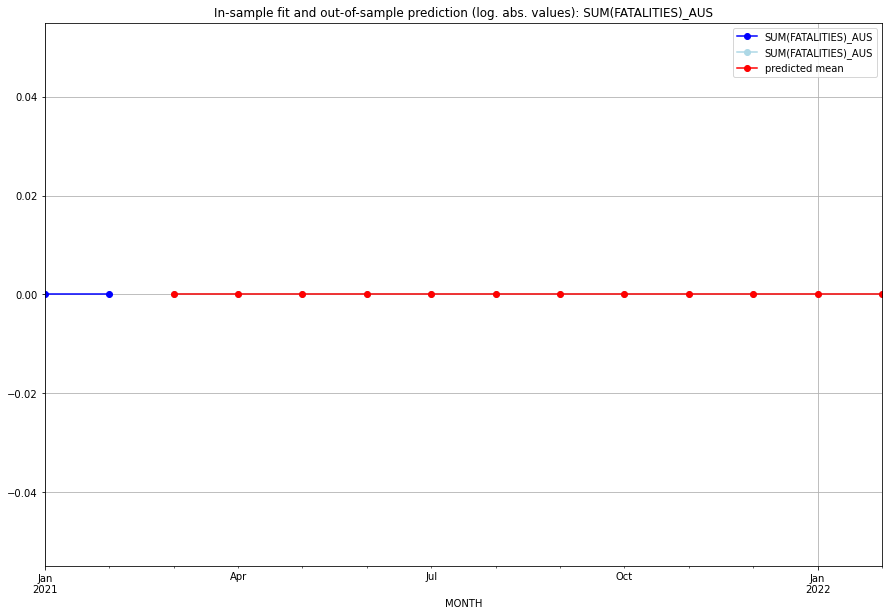

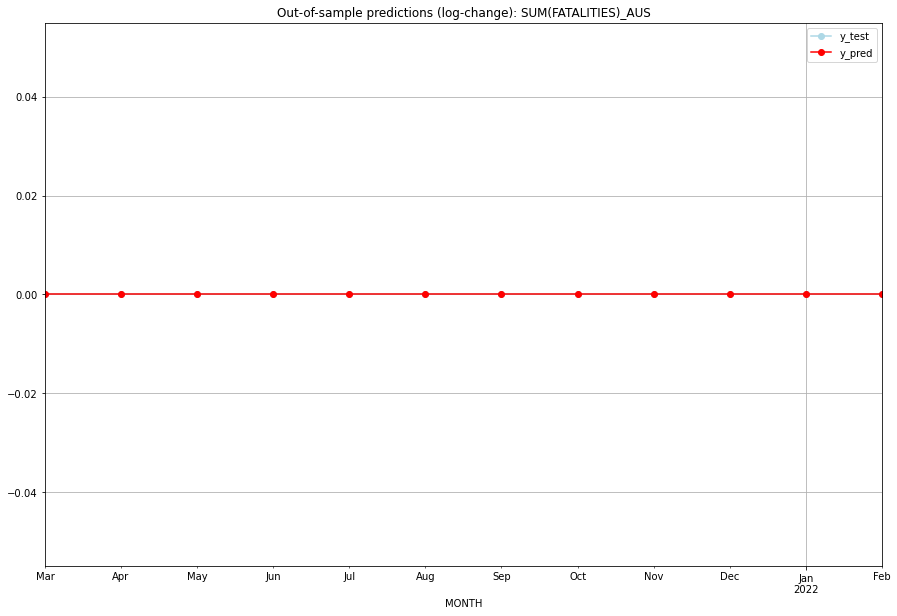

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   AUS   
1  2021-04-01       0.0         0.0           0.0             0.0   AUS   
2  2021-05-01       0.0         0.0           0.0             0.0   AUS   
3  2021-06-01       0.0         0.0           0.0             0.0   AUS   
4  2021-07-01       0.0         0.0           0.0             0.0   AUS   
5  2021-08-01       0.0         0.0           0.0             0.0   AUS   
6  2021-09-01       0.0         0.0           0.0             0.0   AUS   
7  2021-10-01       0.0         0.0           0.0             0.0   AUS   
8  2021-11-01       0.0         0.0           0.0             0.0   AUS   
9  2021-12-01       0.0         0.0           0.0             0.0   AUS   
10 2022-01-01       0.0         0.0           0.0             0.0   AUS   
11 2022-02-01       0.0         0.0           0.0             0.0   

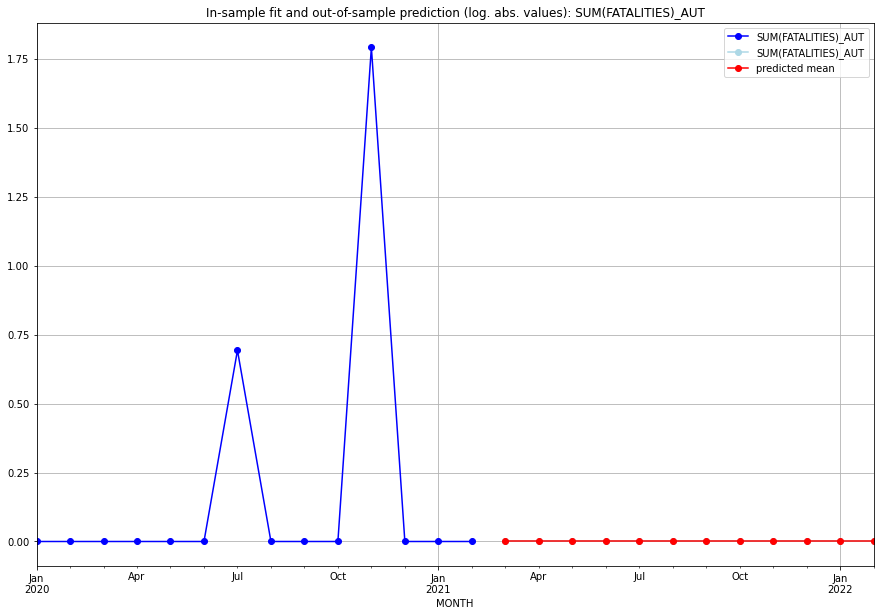

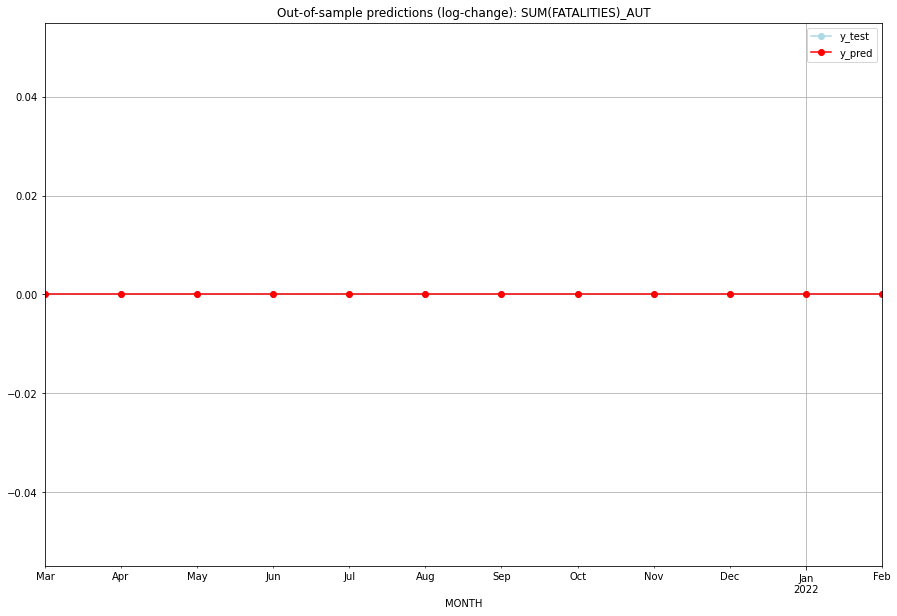

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   AUT   
1  2021-04-01       0.0         0.0           0.0             0.0   AUT   
2  2021-05-01       0.0         0.0           0.0             0.0   AUT   
3  2021-06-01       0.0         0.0           0.0             0.0   AUT   
4  2021-07-01       0.0         0.0           0.0             0.0   AUT   
5  2021-08-01       0.0         0.0           0.0             0.0   AUT   
6  2021-09-01       0.0         0.0           0.0             0.0   AUT   
7  2021-10-01       0.0         0.0           0.0             0.0   AUT   
8  2021-11-01       0.0         0.0           0.0             0.0   AUT   
9  2021-12-01       0.0         0.0           0.0             0.0   AUT   
10 2022-01-01       0.0         0.0           0.0             0.0   AUT   
11 2022-02-01       0.0         0.0           0.0             0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [2, (2, 0, 3), (0, 0, 0, 0), 'n'], 'cv_score': 1.4867024288835573, 'fold_results': [0.6691736745222969, 2.3042311832448177]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_AZE   No. Observations:                   38
Model:                SARIMAX(2, 0, 3)   Log Likelihood                 -67.291
Date:                 Wed, 19 Oct 2022   AIC                            150.582
Time:                         10:26:08   BIC                            163.683
Sample:                     01-31-2018   HQIC                           155.244
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             0.0878      0.

<Figure size 432x288 with 0 Axes>

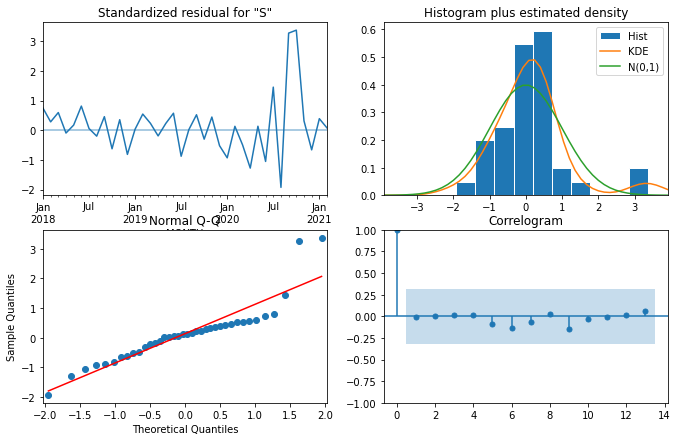

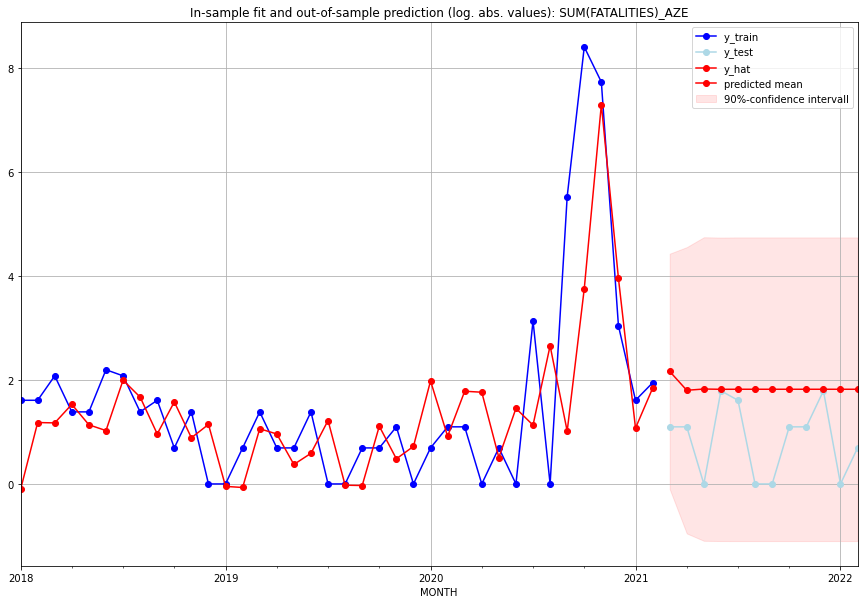

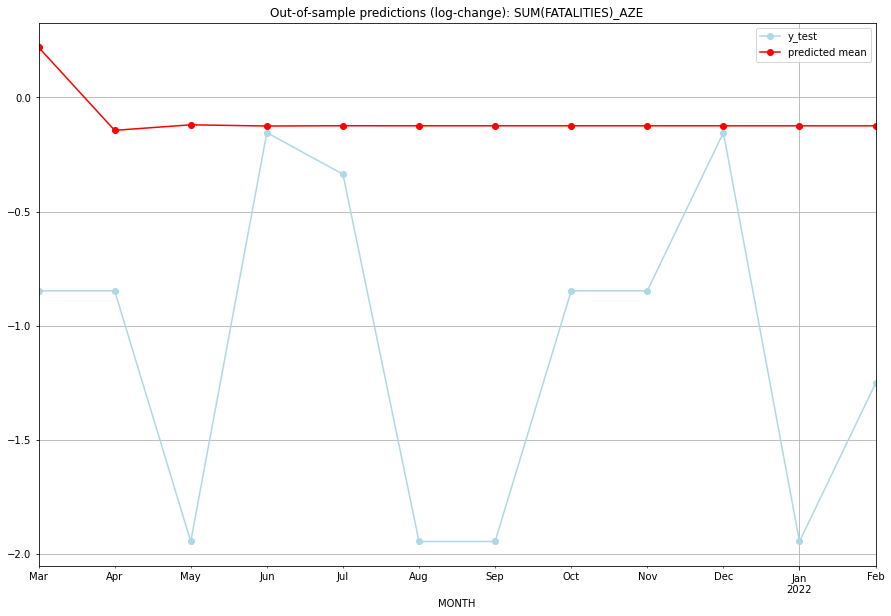

TADDA: 1.0104822858190878
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  7.719833         2.0      0.219690       -0.847298   AZE   
1  2021-04-01  5.060290         2.0     -0.144152       -0.847298   AZE   
2  2021-05-01  5.209060         0.0     -0.119901       -1.945910   AZE   
3  2021-06-01  5.176074         5.0     -0.125227       -0.154151   AZE   
4  2021-07-01  5.183137         4.0     -0.124084       -0.336472   AZE   
5  2021-08-01  5.181454         0.0     -0.124357       -1.945910   AZE   
6  2021-09-01  5.181685         0.0     -0.124319       -1.945910   AZE   
7  2021-10-01  5.181498         2.0     -0.124350       -0.847298   AZE   
8  2021-11-01  5.181402         2.0     -0.124365       -0.847298   AZE   
9  2021-12-01  5.181286         5.0     -0.124384       -0.154151   AZE   
10 2022-01-01  5.181174         0.0     -0.124402       -1.945910   AZE   
11 2022-02-01  5.181062         1.0     -0.124420    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (3, 1, 1), (0, 0, 0, 0), 'n'], 'cv_score': 0.38981922146854275, 'fold_results': [0.359424483342433, 0.26320839774957305, 0.38661452936869406, 0.5483321055625717, 0.39151659131944205]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_BDI   No. Observations:                  289
Model:                SARIMAX(3, 1, 1)   Log Likelihood                -413.222
Date:                 Wed, 19 Oct 2022   AIC                            842.443
Time:                         10:26:34   BIC                            871.747
Sample:                     02-28-1997   HQIC                           854.187
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------

<Figure size 432x288 with 0 Axes>

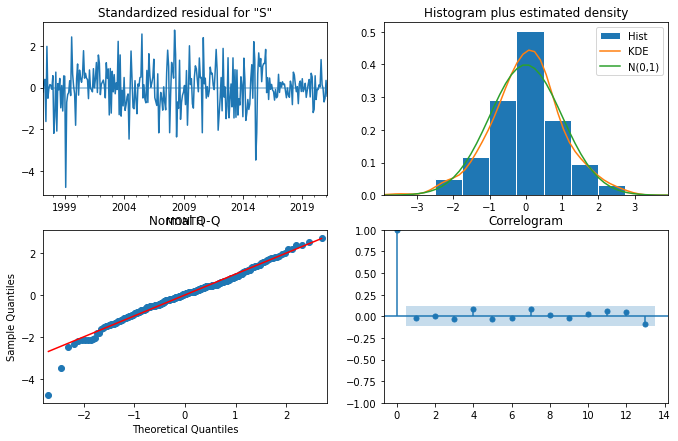

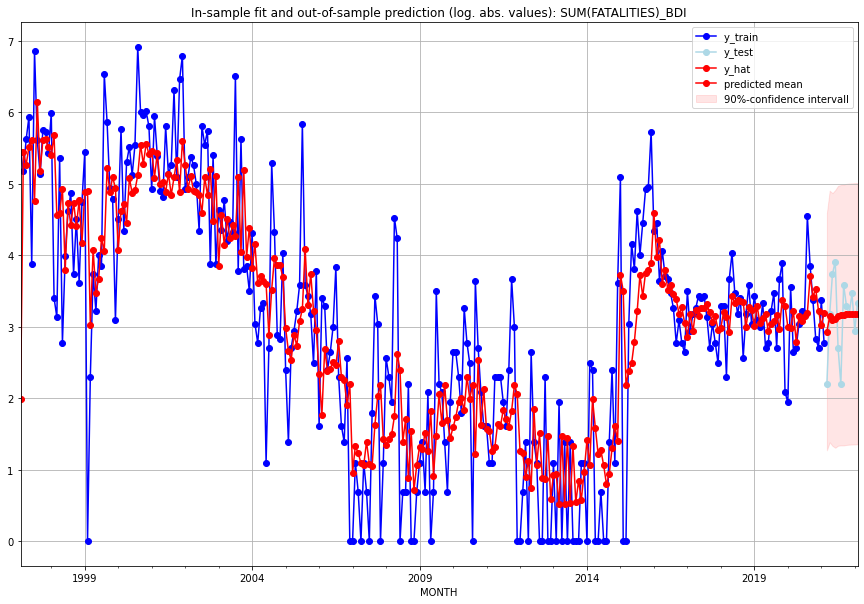

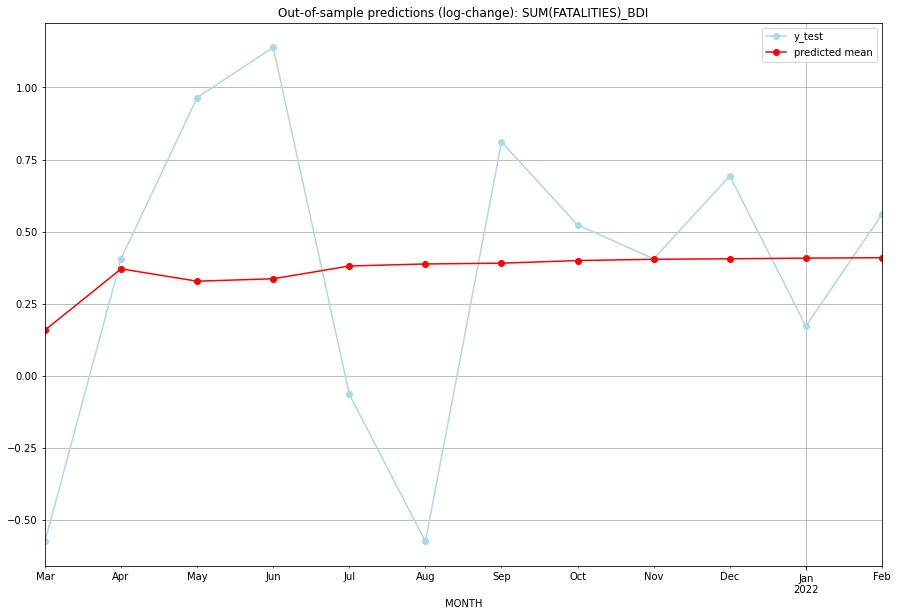

TADDA: 0.4802246041607911
Evaluation finished.
        MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  17.740115         8.0      0.158078       -0.575364   BDI   
1  2021-04-01  22.178650        23.0      0.370643        0.405465   BDI   
2  2021-05-01  21.207333        41.0      0.327834        0.965081   BDI   
3  2021-06-01  21.395390        49.0      0.336266        1.139434   BDI   
4  2021-07-01  22.409686        14.0      0.380561       -0.064539   BDI   
5  2021-08-01  22.576705         8.0      0.387670       -0.575364   BDI   
6  2021-09-01  22.641002        35.0      0.390394        0.810930   BDI   
7  2021-10-01  22.856663        26.0      0.399475        0.523248   BDI   
8  2021-11-01  22.962368        23.0      0.403896        0.405465   BDI   
9  2021-12-01  23.005019        31.0      0.405674        0.693147   BDI   
10 2022-01-01  23.057814        18.0      0.407871        0.171850   BDI   
11 2022-02-01  23.095005        27.0     

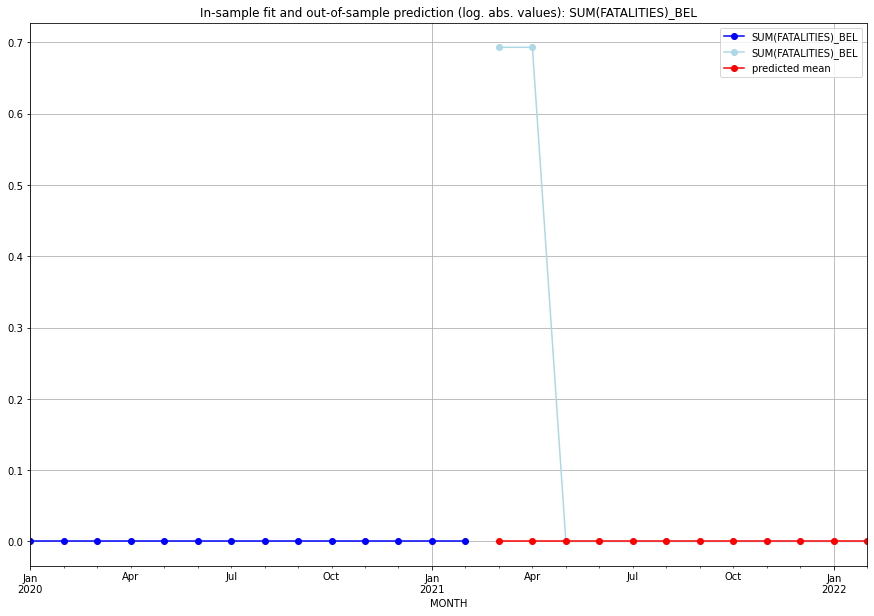

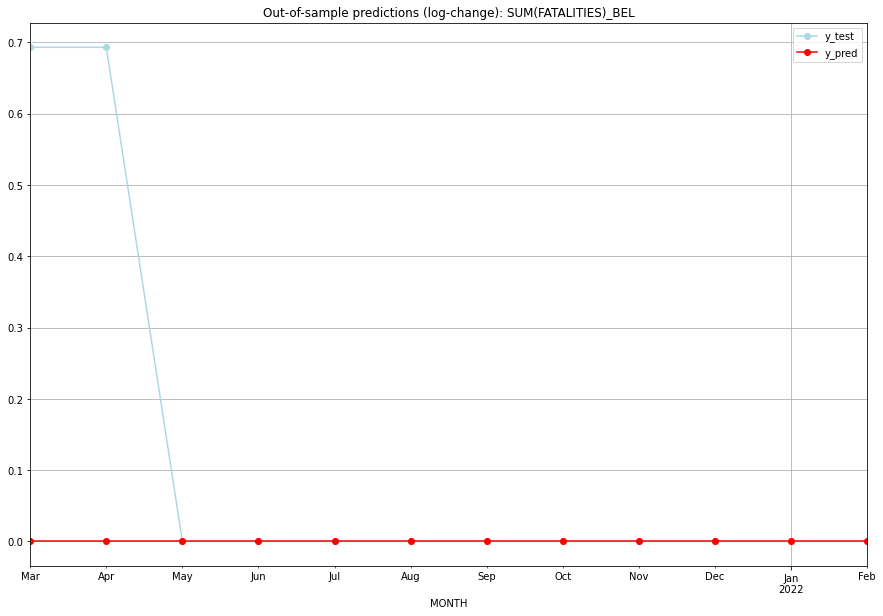

TADDA: 0.11552453009332421
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0    0.693147           0.0        0.693147   BEL   
1  2021-04-01       0.0    0.693147           0.0        0.693147   BEL   
2  2021-05-01       0.0    0.000000           0.0        0.000000   BEL   
3  2021-06-01       0.0    0.000000           0.0        0.000000   BEL   
4  2021-07-01       0.0    0.000000           0.0        0.000000   BEL   
5  2021-08-01       0.0    0.000000           0.0        0.000000   BEL   
6  2021-09-01       0.0    0.000000           0.0        0.000000   BEL   
7  2021-10-01       0.0    0.000000           0.0        0.000000   BEL   
8  2021-11-01       0.0    0.000000           0.0        0.000000   BEL   
9  2021-12-01       0.0    0.000000           0.0        0.000000   BEL   
10 2022-01-01       0.0    0.000000           0.0        0.000000   BEL   
11 2022-02-01       0.0    0.000000           0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (2, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.8687905363620828, 'fold_results': [0.8979940860660071, 0.7356107328397821, 0.8758684729182583, 1.0281272644221935, 0.8063521255641731]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_BEN   No. Observations:                  289
Model:                SARIMAX(2, 1, 0)   Log Likelihood                -201.559
Date:                 Wed, 19 Oct 2022   AIC                            415.117
Time:                         10:27:20   BIC                            437.095
Sample:                     02-28-1997   HQIC                           423.924
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------

<Figure size 432x288 with 0 Axes>

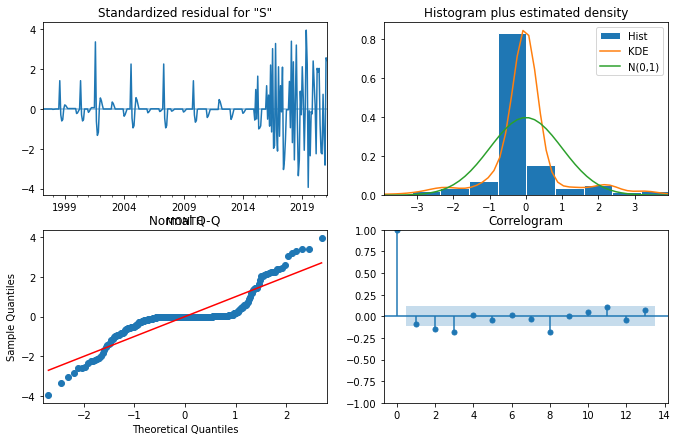

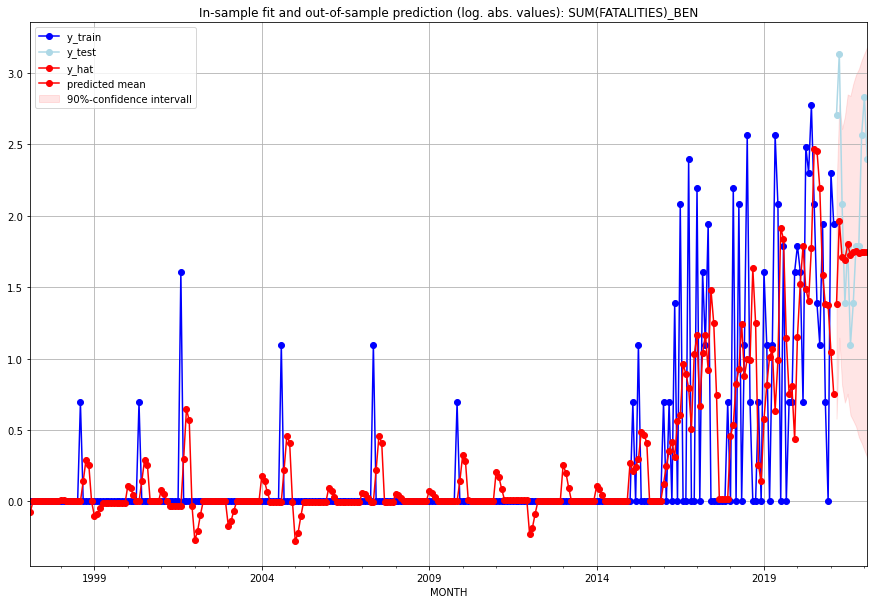

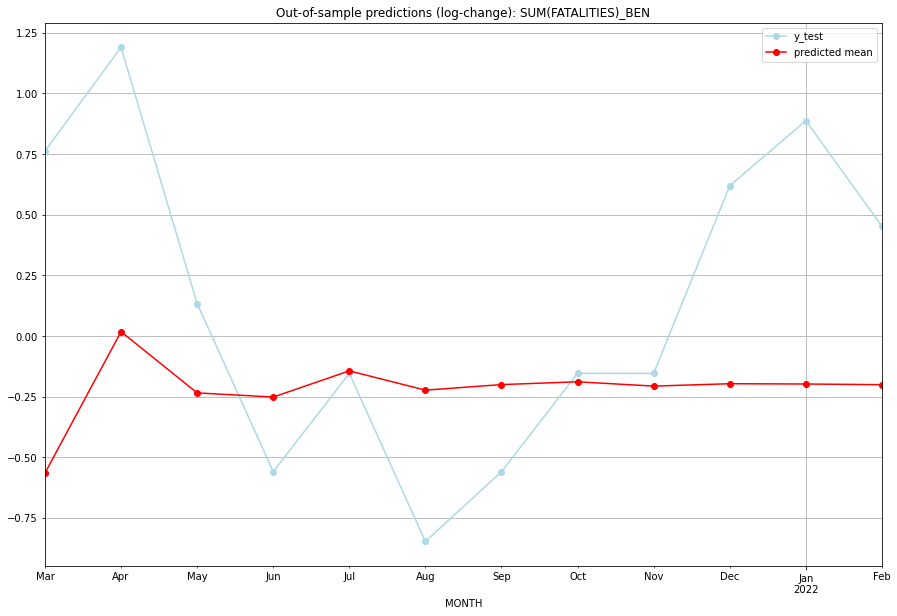

TADDA: 0.6839066301726073
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  2.976983        14.0     -0.565387        0.762140   BEN   
1  2021-04-01  6.123453        22.0      0.017482        1.189584   BEN   
2  2021-05-01  4.535219         7.0     -0.234779        0.133531   BEN   
3  2021-06-01  4.440963         3.0     -0.251954       -0.559616   BEN   
4  2021-07-01  5.060949         5.0     -0.144044       -0.154151   BEN   
5  2021-08-01  4.598347         2.0     -0.223439       -0.847298   BEN   
6  2021-09-01  4.727557         3.0     -0.200621       -0.559616   BEN   
7  2021-10-01  4.793916         5.0     -0.189102       -0.154151   BEN   
8  2021-11-01  4.692347         5.0     -0.206787       -0.154151   BEN   
9  2021-12-01  4.748177        12.0     -0.197027        0.619039   BEN   
10 2022-01-01  4.741551        16.0     -0.198181        0.887303   BEN   
11 2022-02-01  4.725901        10.0     -0.200910    

<Figure size 432x288 with 0 Axes>

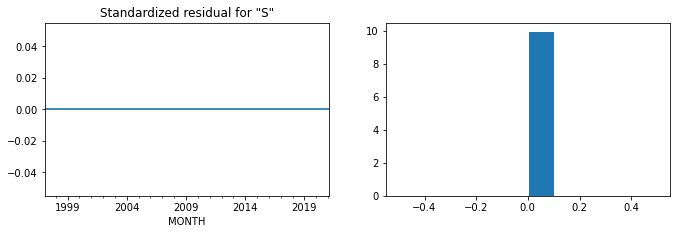

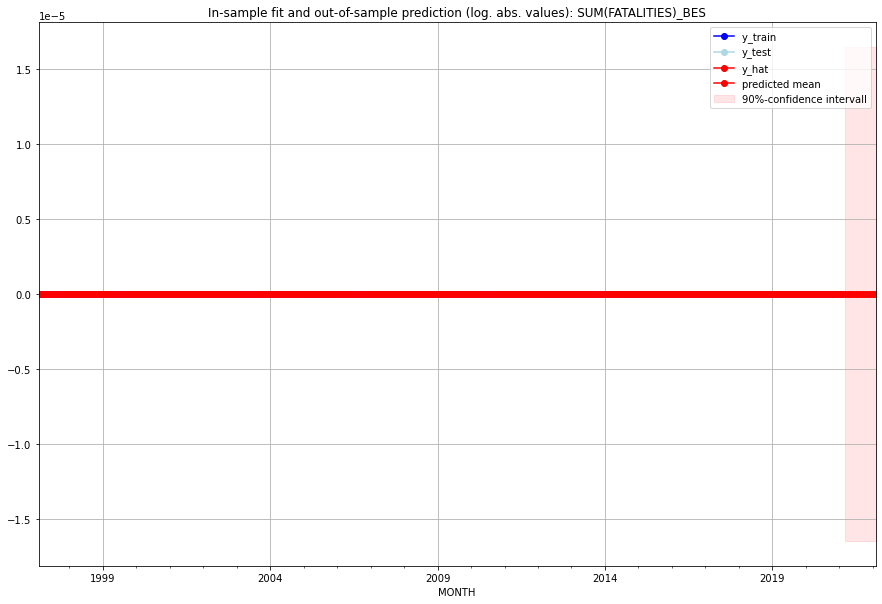

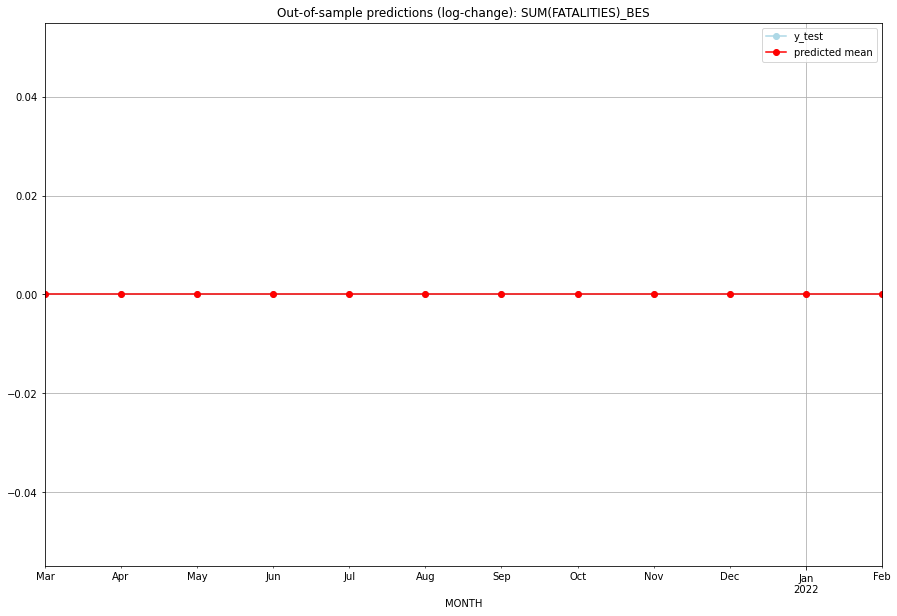

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   BES   
1  2021-04-01       0.0         0.0           0.0             0.0   BES   
2  2021-05-01       0.0         0.0           0.0             0.0   BES   
3  2021-06-01       0.0         0.0           0.0             0.0   BES   
4  2021-07-01       0.0         0.0           0.0             0.0   BES   
5  2021-08-01       0.0         0.0           0.0             0.0   BES   
6  2021-09-01       0.0         0.0           0.0             0.0   BES   
7  2021-10-01       0.0         0.0           0.0             0.0   BES   
8  2021-11-01       0.0         0.0           0.0             0.0   BES   
9  2021-12-01       0.0         0.0           0.0             0.0   BES   
10 2022-01-01       0.0         0.0           0.0             0.0   BES   
11 2022-02-01       0.0         0.0           0.0             0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (3, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.8748139344554253, 'fold_results': [0.8152481045940815, 0.7477869781456987, 1.3856918495926287, 0.6962022683980452, 0.7291404715466725]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_BFA   No. Observations:                  289
Model:                SARIMAX(3, 1, 0)   Log Likelihood                -323.661
Date:                 Wed, 19 Oct 2022   AIC                            655.321
Time:                         10:27:57   BIC                            669.973
Sample:                     02-28-1997   HQIC                           661.193
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------

<Figure size 432x288 with 0 Axes>

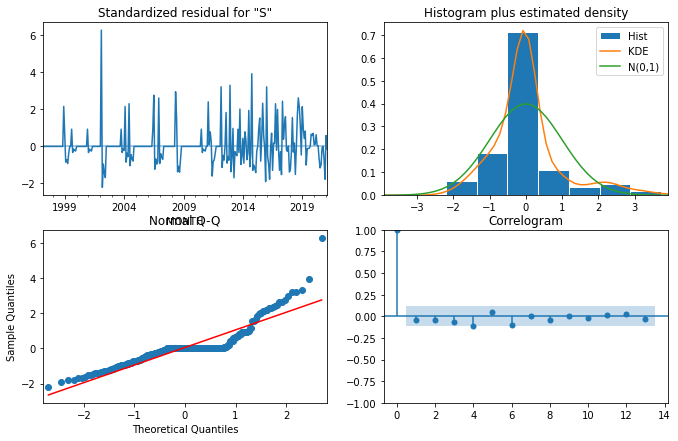

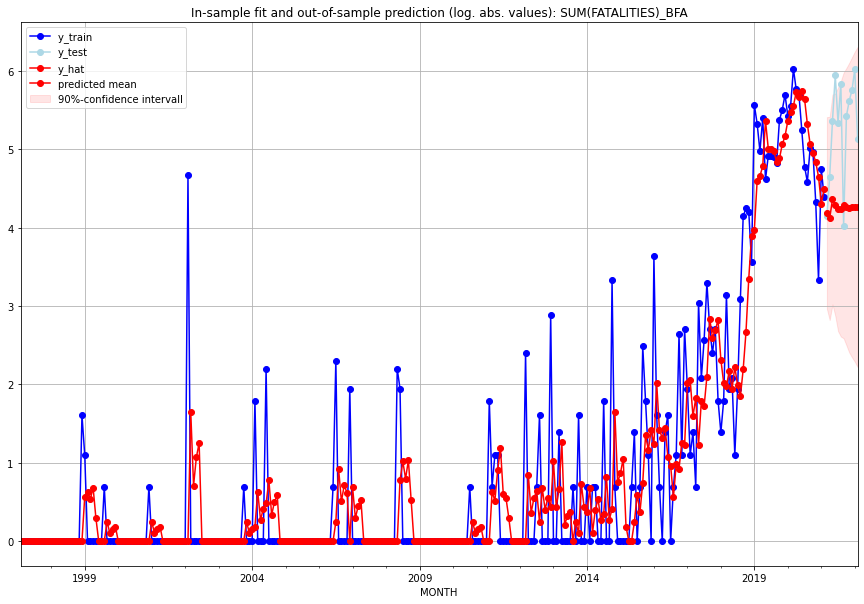

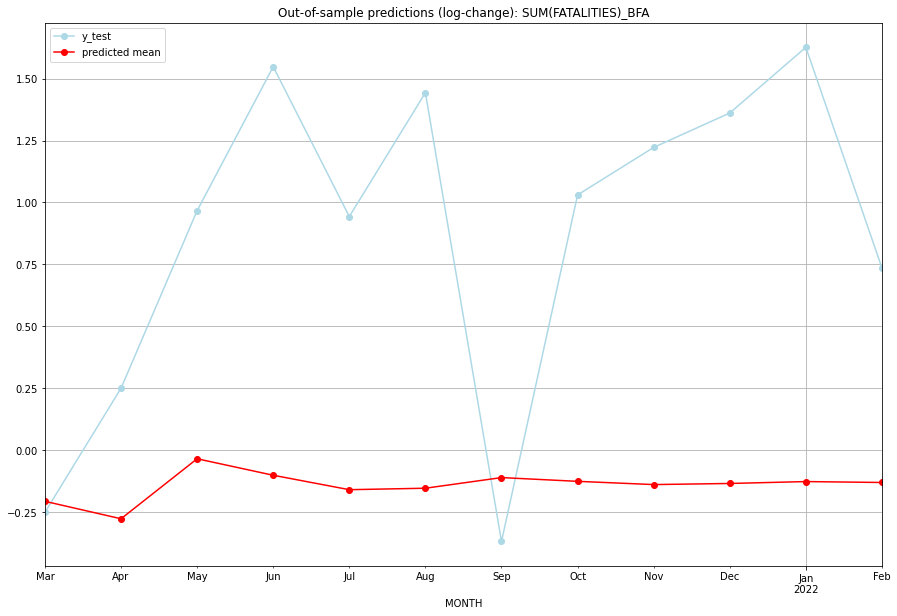

TADDA: 1.183519831773463
Evaluation finished.
        MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  64.862082        62.0     -0.206886       -0.251314   BFA   
1  2021-04-01  60.384491       103.0     -0.277292        0.249942   BFA   
2  2021-05-01  77.211176       212.0     -0.035037        0.966843   BFA   
3  2021-06-01  72.173218       380.0     -0.101620        1.548350   BFA   
4  2021-07-01  68.029928       207.0     -0.159909        0.943089   BFA   
5  2021-08-01  68.440299       342.0     -0.153982        1.443281   BFA   
6  2021-09-01  71.487224        55.0     -0.111039       -0.369097   BFA   
7  2021-10-01  70.397181       226.0     -0.126191        1.030501   BFA   
8  2021-11-01  69.468390       274.0     -0.139285        1.222322   BFA   
9  2021-12-01  69.786440       315.0     -0.134782        1.361293   BFA   
10 2022-01-01  70.329585       411.0     -0.127138        1.626574   BFA   
11 2022-02-01  70.067515       168.0     -

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [2, (3, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.504453776779278, 'fold_results': [0.5904327204456407, 0.6019998158891373, 0.8235076061719143, 0.31740085244189703, 0.18892788894780055]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_BGD   No. Observations:                  134
Model:                SARIMAX(3, 0, 0)   Log Likelihood                 -99.422
Date:                 Wed, 19 Oct 2022   AIC                            210.845
Time:                         10:28:25   BIC                            228.232
Sample:                     01-31-2010   HQIC                           217.910
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------

<Figure size 432x288 with 0 Axes>

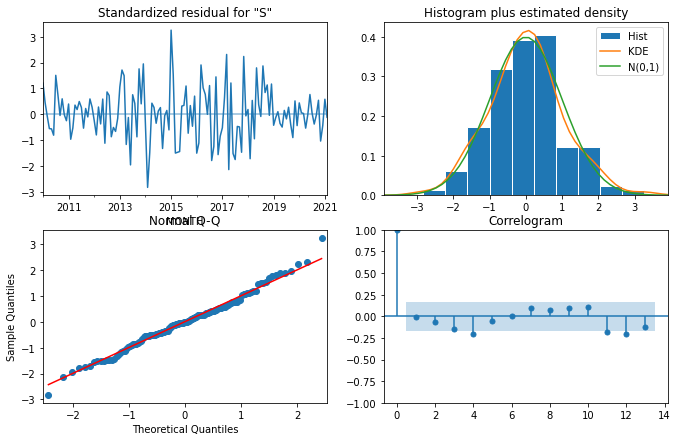

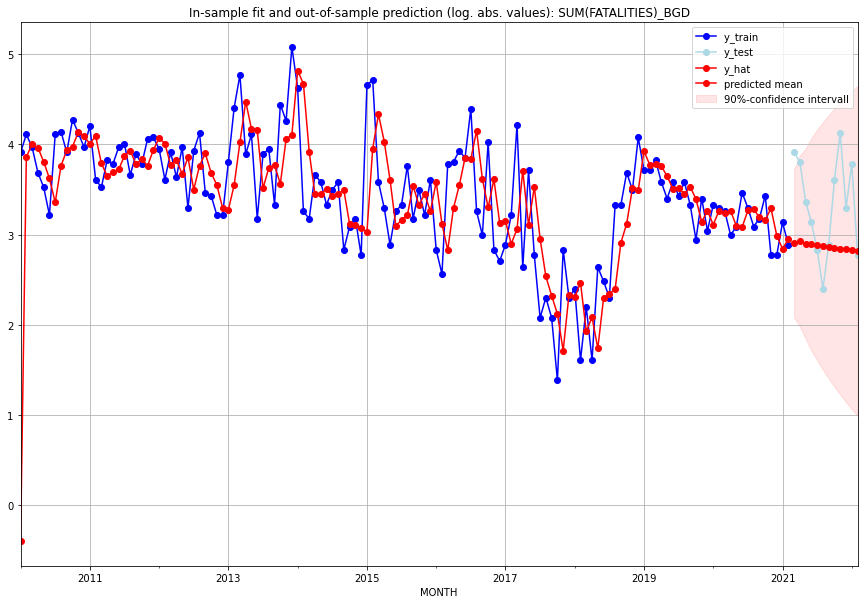

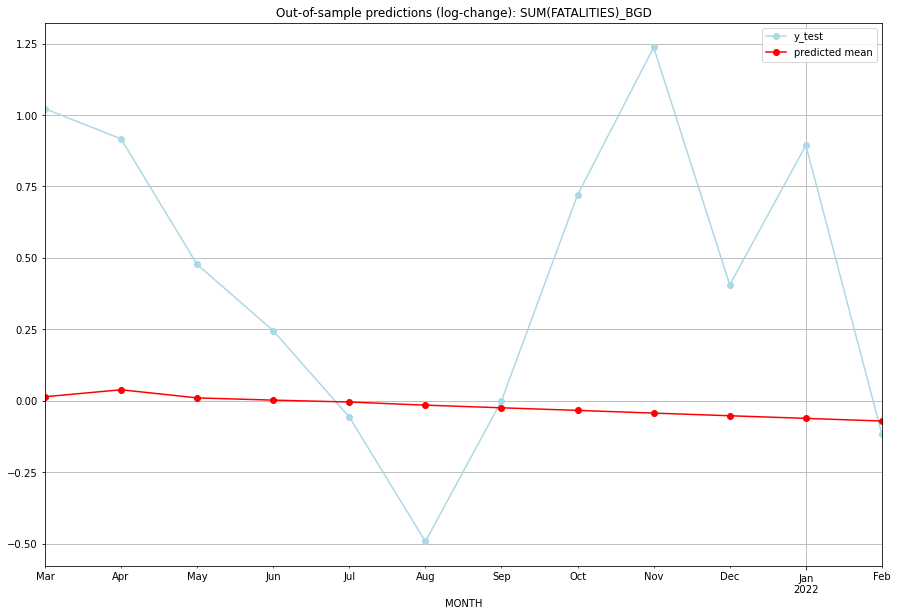

TADDA: 0.5696376878185432
Evaluation finished.
        MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  17.253345        49.0      0.013977        1.021651   BGD   
1  2021-04-01  17.705694        44.0      0.038456        0.916291   BGD   
2  2021-05-01  17.180833        28.0      0.009996        0.476924   BGD   
3  2021-06-01  17.039484        22.0      0.002191        0.245122   BGD   
4  2021-07-01  16.920173        16.0     -0.004445       -0.057158   BGD   
5  2021-08-01  16.725123        10.0     -0.015389       -0.492476   BGD   
6  2021-09-01  16.561590        17.0     -0.024658        0.000000   BGD   
7  2021-10-01  16.402186        36.0     -0.033776        0.720546   BGD   
8  2021-11-01  16.238705        61.0     -0.043215        1.236763   BGD   
9  2021-12-01  16.079589        26.0     -0.052488        0.405465   BGD   
10 2022-01-01  15.922728        43.0     -0.061714        0.893818   BGD   
11 2022-02-01  15.767409        15.0     

<Figure size 432x288 with 0 Axes>

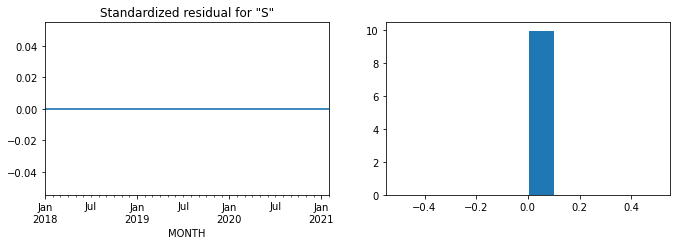

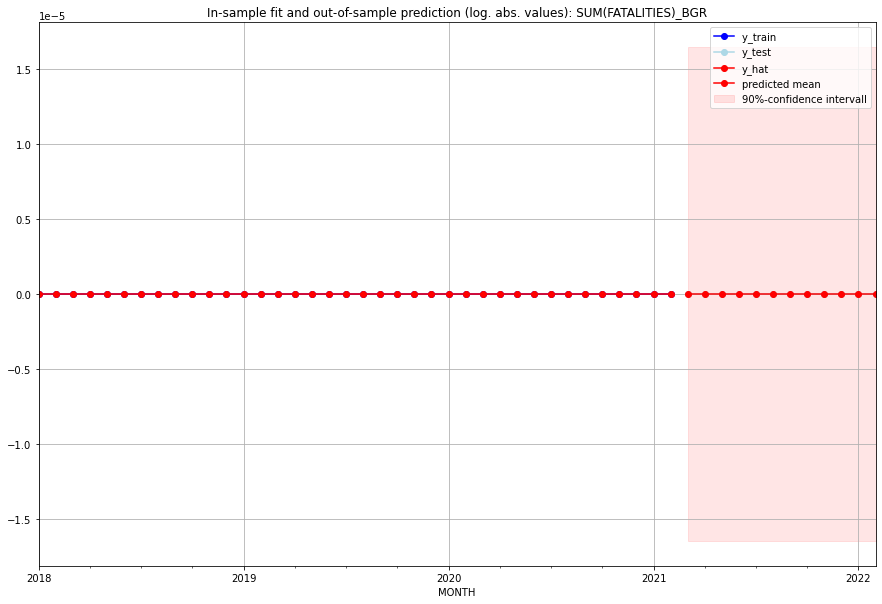

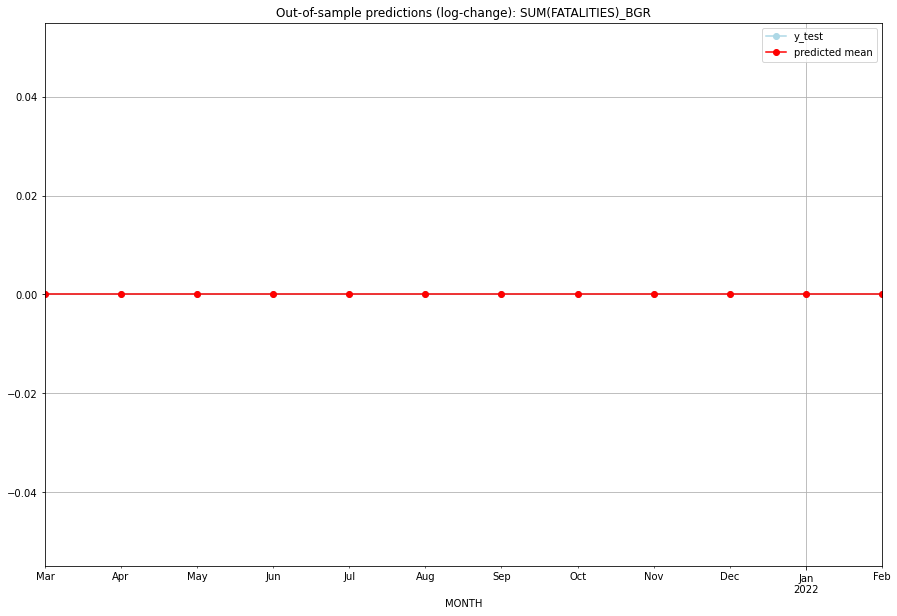

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   BGR   
1  2021-04-01       0.0         0.0           0.0             0.0   BGR   
2  2021-05-01       0.0         0.0           0.0             0.0   BGR   
3  2021-06-01       0.0         0.0           0.0             0.0   BGR   
4  2021-07-01       0.0         0.0           0.0             0.0   BGR   
5  2021-08-01       0.0         0.0           0.0             0.0   BGR   
6  2021-09-01       0.0         0.0           0.0             0.0   BGR   
7  2021-10-01       0.0         0.0           0.0             0.0   BGR   
8  2021-11-01       0.0         0.0           0.0             0.0   BGR   
9  2021-12-01       0.0         0.0           0.0             0.0   BGR   
10 2022-01-01       0.0         0.0           0.0             0.0   BGR   
11 2022-02-01       0.0         0.0           0.0             0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [2, (0, 1, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.01925408834888737, 'fold_results': [nan, 0.0, 0.057762265046662105, 0.0]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_BHR   No. Observations:                   62
Model:                SARIMAX(0, 1, 3)   Log Likelihood                 -30.712
Date:                 Wed, 19 Oct 2022   AIC                             73.423
Time:                         10:28:48   BIC                             86.088
Sample:                     01-31-2016   HQIC                            78.387
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             0.0425      0.12

<Figure size 432x288 with 0 Axes>

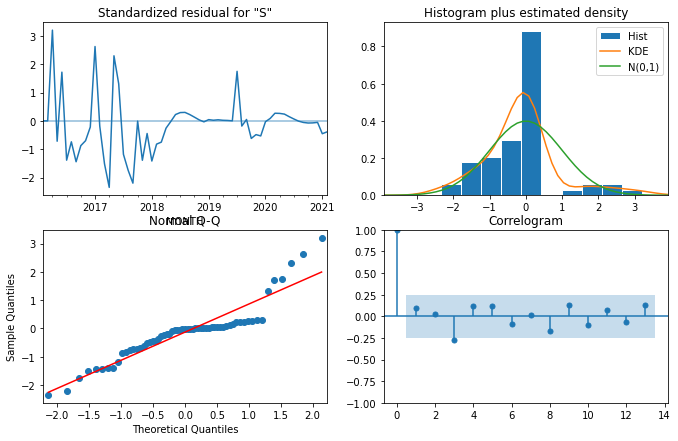

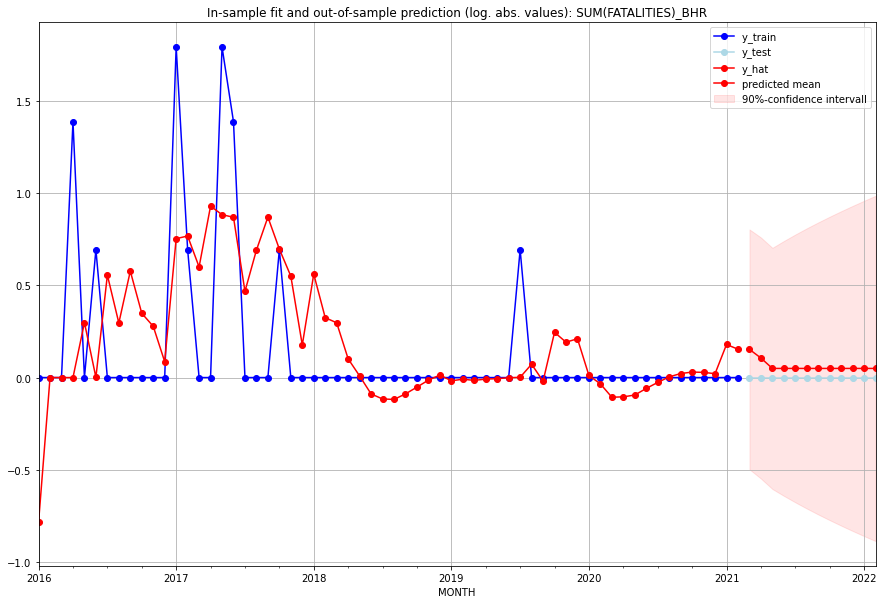

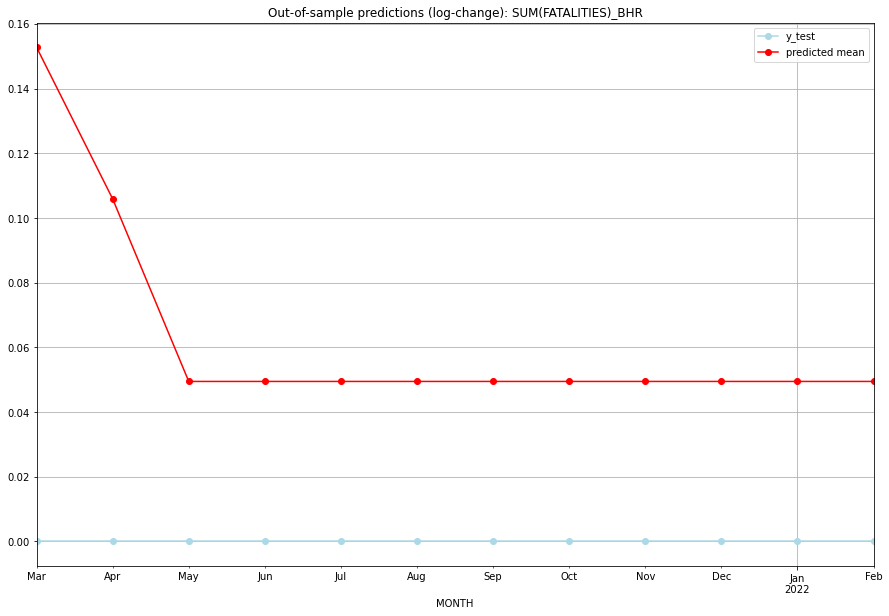

TADDA: 0.062776783847684
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  0.165023         0.0      0.152741             0.0   BHR   
1  2021-04-01  0.111691         0.0      0.105882             0.0   BHR   
2  2021-05-01  0.050714         0.0      0.049470             0.0   BHR   
3  2021-06-01  0.050714         0.0      0.049470             0.0   BHR   
4  2021-07-01  0.050714         0.0      0.049470             0.0   BHR   
5  2021-08-01  0.050714         0.0      0.049470             0.0   BHR   
6  2021-09-01  0.050714         0.0      0.049470             0.0   BHR   
7  2021-10-01  0.050714         0.0      0.049470             0.0   BHR   
8  2021-11-01  0.050714         0.0      0.049470             0.0   BHR   
9  2021-12-01  0.050714         0.0      0.049470             0.0   BHR   
10 2022-01-01  0.050714         0.0      0.049470             0.0   BHR   
11 2022-02-01  0.050714         0.0      0.049470     

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.11552453009332421, 'fold_results': [0.057762265046662105, 0.17328679513998632]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_BHS   No. Observations:                   38
Model:                         SARIMAX   Log Likelihood                  -1.457
Date:                 Wed, 19 Oct 2022   AIC                              4.915
Time:                         10:29:10   BIC                              6.552
Sample:                     01-31-2018   HQIC                             5.497
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.0632    

<Figure size 432x288 with 0 Axes>

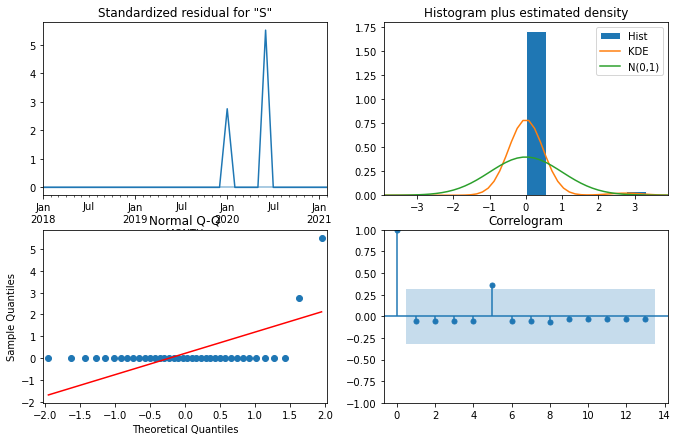

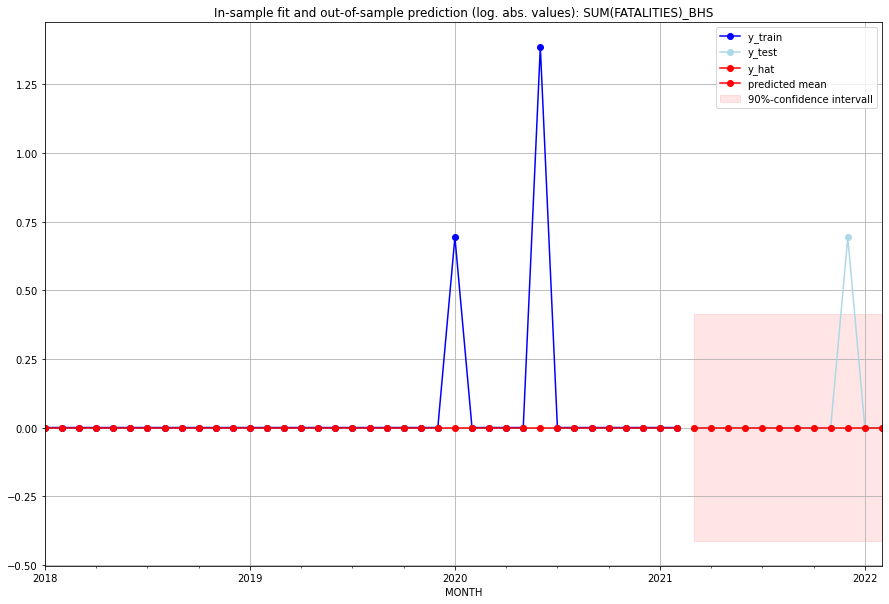

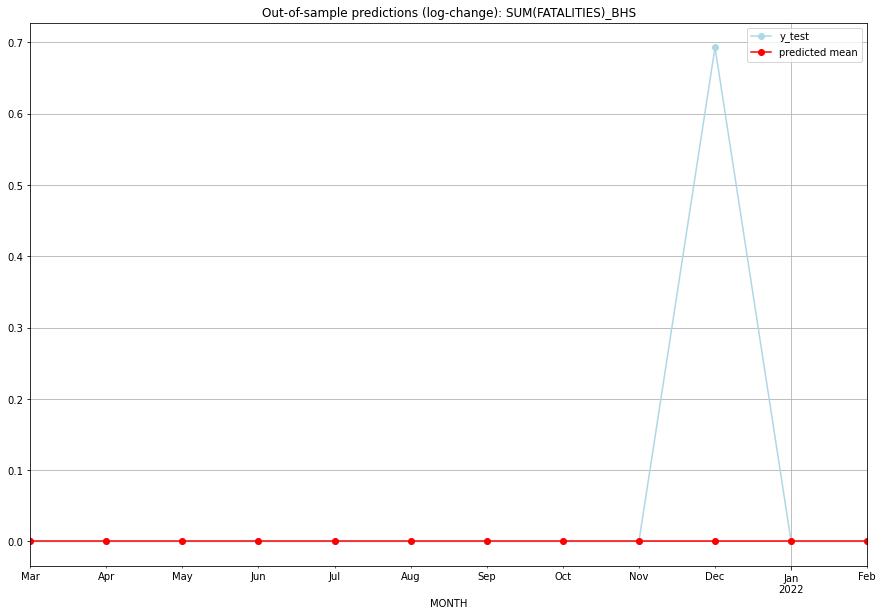

TADDA: 0.057762265046662105
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0        0.000000   BHS   
1  2021-04-01       0.0         0.0           0.0        0.000000   BHS   
2  2021-05-01       0.0         0.0           0.0        0.000000   BHS   
3  2021-06-01       0.0         0.0           0.0        0.000000   BHS   
4  2021-07-01       0.0         0.0           0.0        0.000000   BHS   
5  2021-08-01       0.0         0.0           0.0        0.000000   BHS   
6  2021-09-01       0.0         0.0           0.0        0.000000   BHS   
7  2021-10-01       0.0         0.0           0.0        0.000000   BHS   
8  2021-11-01       0.0         0.0           0.0        0.000000   BHS   
9  2021-12-01       0.0         1.0           0.0        0.693147   BHS   
10 2022-01-01       0.0         0.0           0.0        0.000000   BHS   
11 2022-02-01       0.0         0.0           0.0  

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [2, (0, 1, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.0, 'fold_results': [nan, 0.0]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_BIH   No. Observations:                   38
Model:                SARIMAX(0, 1, 3)   Log Likelihood                  15.190
Date:                 Wed, 19 Oct 2022   AIC                            -18.379
Time:                         10:29:22   BIC                             -8.714
Sample:                     01-31-2018   HQIC                           -14.972
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -0.0051      0.059     -0.088      0.930      -0.120       0

<Figure size 432x288 with 0 Axes>

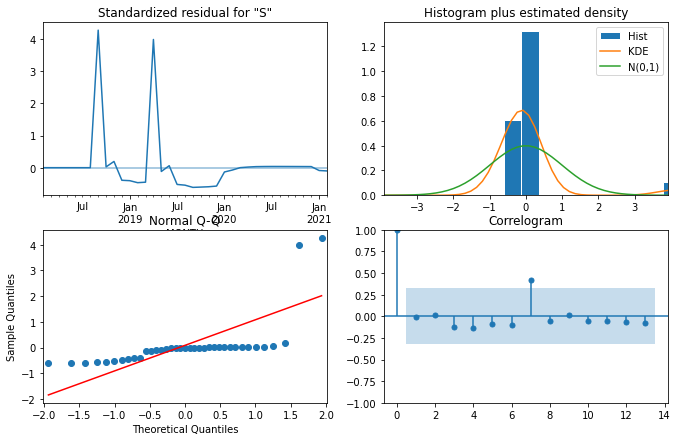

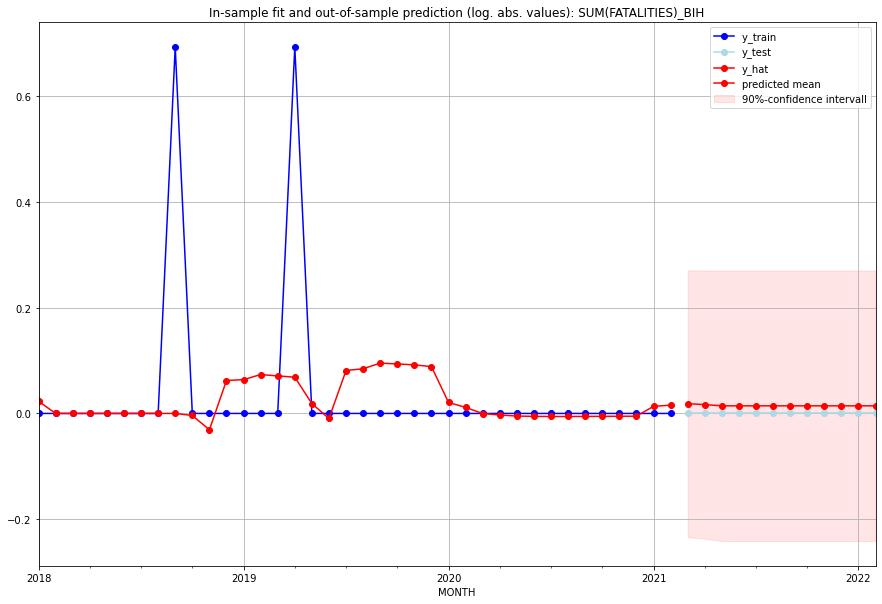

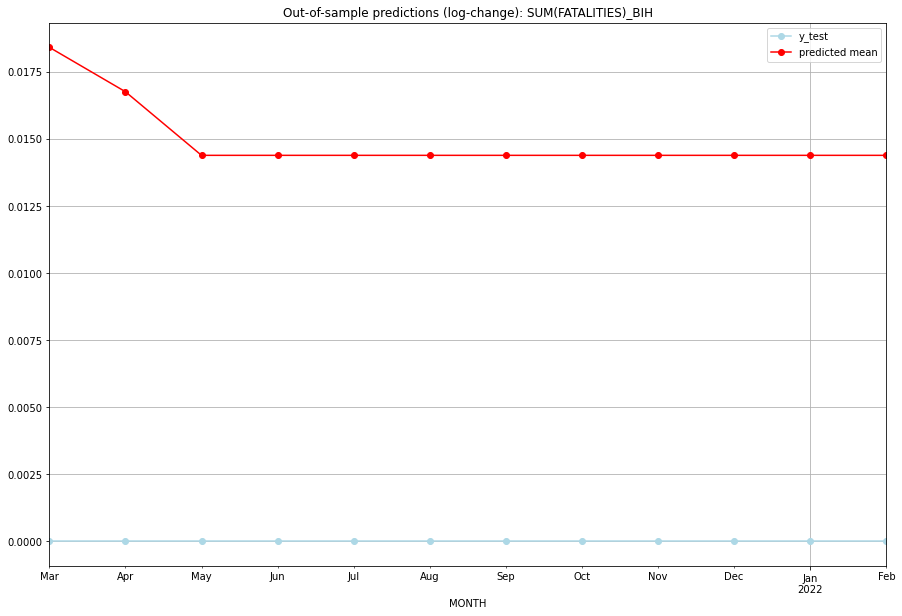

TADDA: 0.014918623593160303
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  0.018581         0.0      0.018410             0.0   BIH   
1  2021-04-01  0.016897         0.0      0.016756             0.0   BIH   
2  2021-05-01  0.014490         0.0      0.014386             0.0   BIH   
3  2021-06-01  0.014490         0.0      0.014386             0.0   BIH   
4  2021-07-01  0.014490         0.0      0.014386             0.0   BIH   
5  2021-08-01  0.014490         0.0      0.014386             0.0   BIH   
6  2021-09-01  0.014490         0.0      0.014386             0.0   BIH   
7  2021-10-01  0.014490         0.0      0.014386             0.0   BIH   
8  2021-11-01  0.014490         0.0      0.014386             0.0   BIH   
9  2021-12-01  0.014490         0.0      0.014386             0.0   BIH   
10 2022-01-01  0.014490         0.0      0.014386             0.0   BIH   
11 2022-02-01  0.014490         0.0      0.014386  

<Figure size 432x288 with 0 Axes>

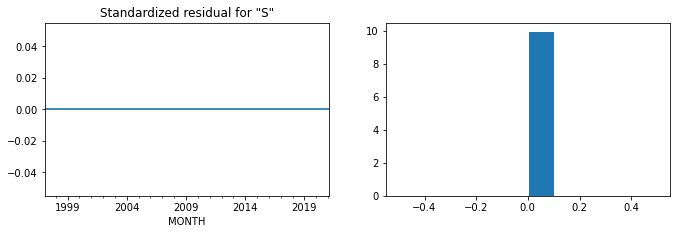

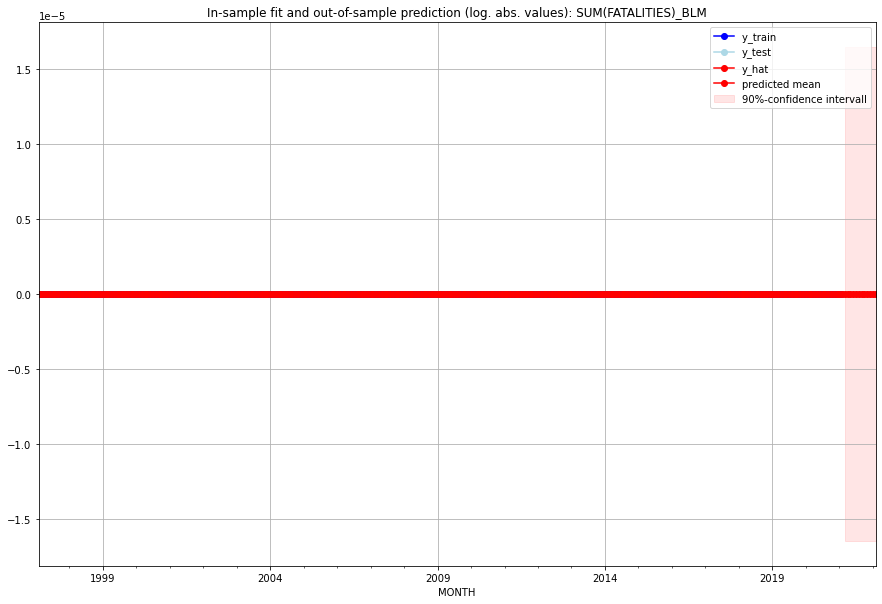

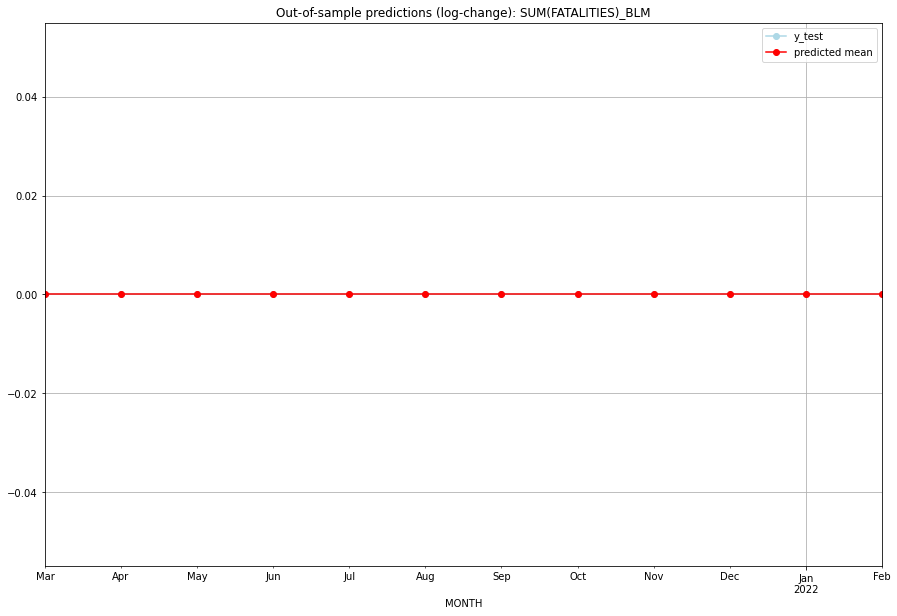

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   BLM   
1  2021-04-01       0.0         0.0           0.0             0.0   BLM   
2  2021-05-01       0.0         0.0           0.0             0.0   BLM   
3  2021-06-01       0.0         0.0           0.0             0.0   BLM   
4  2021-07-01       0.0         0.0           0.0             0.0   BLM   
5  2021-08-01       0.0         0.0           0.0             0.0   BLM   
6  2021-09-01       0.0         0.0           0.0             0.0   BLM   
7  2021-10-01       0.0         0.0           0.0             0.0   BLM   
8  2021-11-01       0.0         0.0           0.0             0.0   BLM   
9  2021-12-01       0.0         0.0           0.0             0.0   BLM   
10 2022-01-01       0.0         0.0           0.0             0.0   BLM   
11 2022-02-01       0.0         0.0           0.0             0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.12482217806474964, 'fold_results': [0.0, 0.24964435612949928]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_BLR   No. Observations:                   38
Model:                         SARIMAX   Log Likelihood                  -8.884
Date:                 Wed, 19 Oct 2022   AIC                             19.768
Time:                         10:30:04   BIC                             21.405
Sample:                     01-31-2018   HQIC                            20.351
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.0935      0.007     13.99

<Figure size 432x288 with 0 Axes>

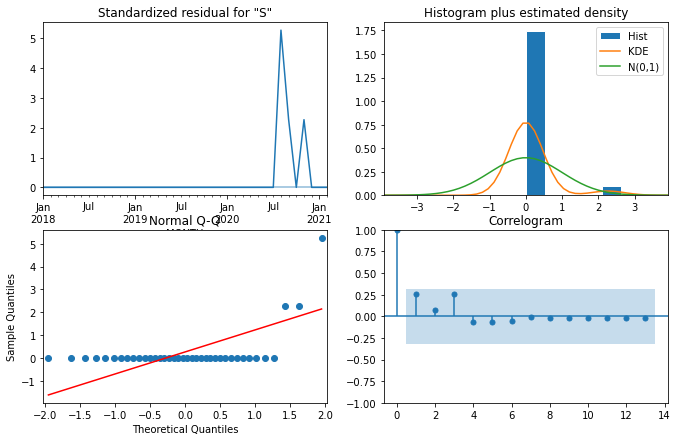

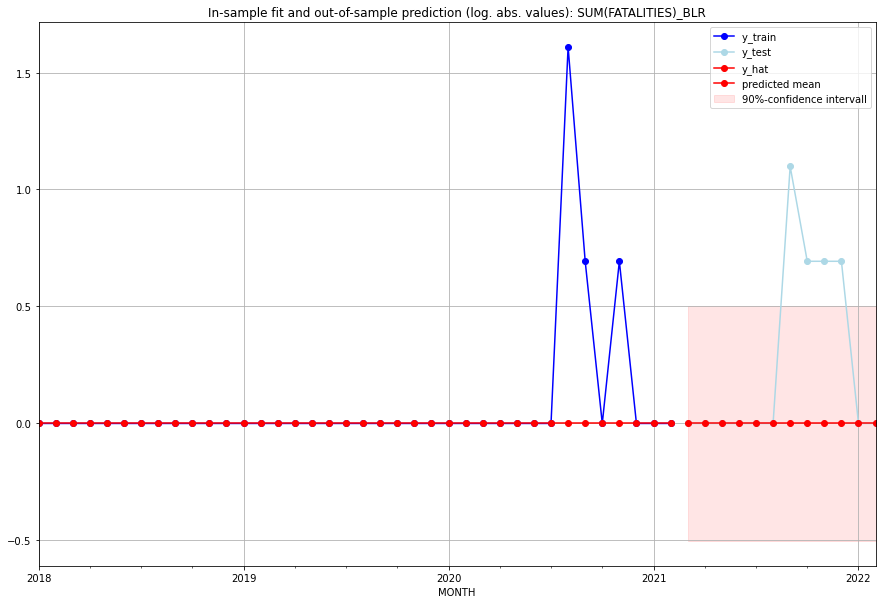

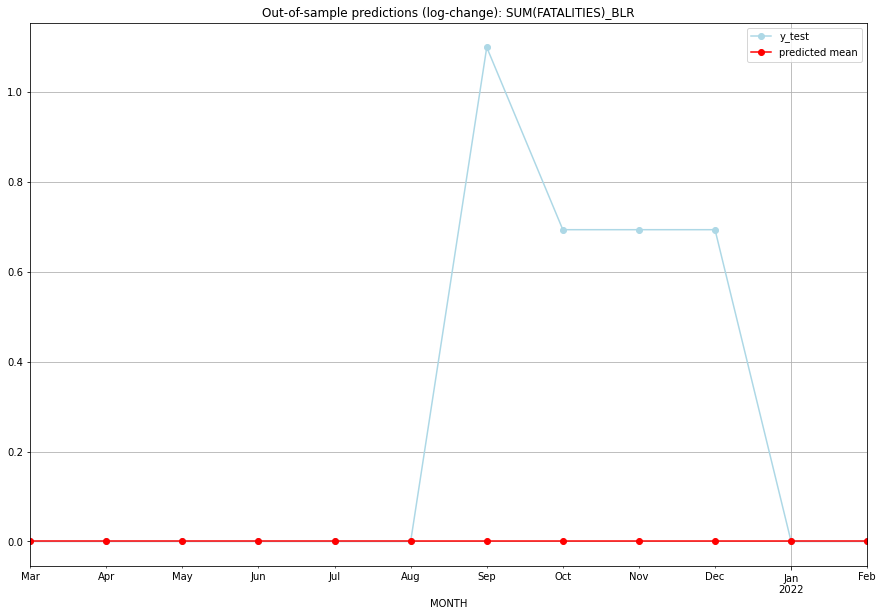

TADDA: 0.2648378191956621
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0        0.000000   BLR   
1  2021-04-01       0.0         0.0           0.0        0.000000   BLR   
2  2021-05-01       0.0         0.0           0.0        0.000000   BLR   
3  2021-06-01       0.0         0.0           0.0        0.000000   BLR   
4  2021-07-01       0.0         0.0           0.0        0.000000   BLR   
5  2021-08-01       0.0         0.0           0.0        0.000000   BLR   
6  2021-09-01       0.0         2.0           0.0        1.098612   BLR   
7  2021-10-01       0.0         1.0           0.0        0.693147   BLR   
8  2021-11-01       0.0         1.0           0.0        0.693147   BLR   
9  2021-12-01       0.0         1.0           0.0        0.693147   BLR   
10 2022-01-01       0.0         0.0           0.0        0.000000   BLR   
11 2022-02-01       0.0         0.0           0.0    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 1, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.5216703318381576, 'fold_results': [nan, 0.5216703318381576]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_BLZ   No. Observations:                   38
Model:                SARIMAX(0, 1, 3)   Log Likelihood                 -32.183
Date:                 Wed, 19 Oct 2022   AIC                             72.367
Time:                         10:30:13   BIC                             78.810
Sample:                     01-31-2018   HQIC                            74.638
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ma.L1         -0.8622     44.424     -0.019 

<Figure size 432x288 with 0 Axes>

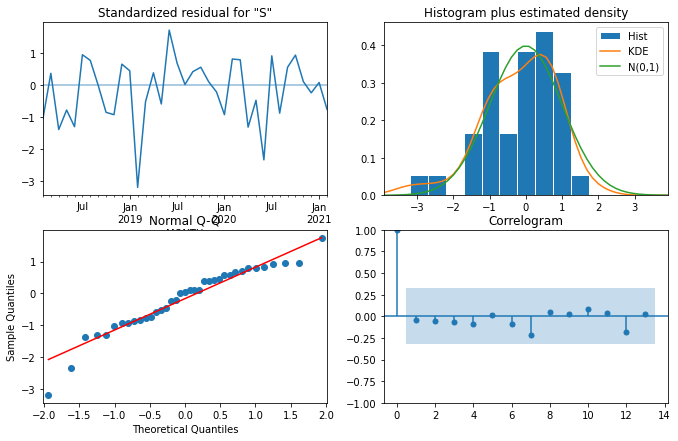

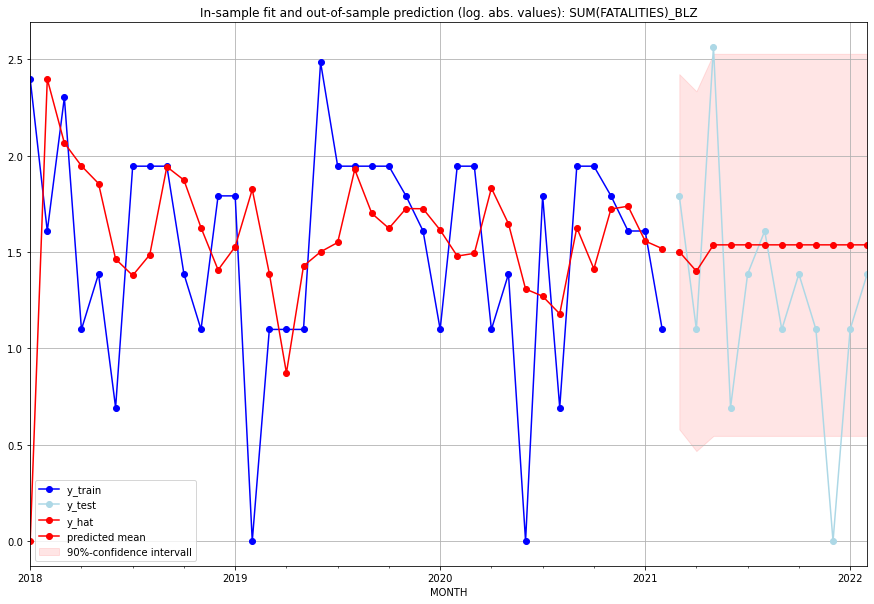

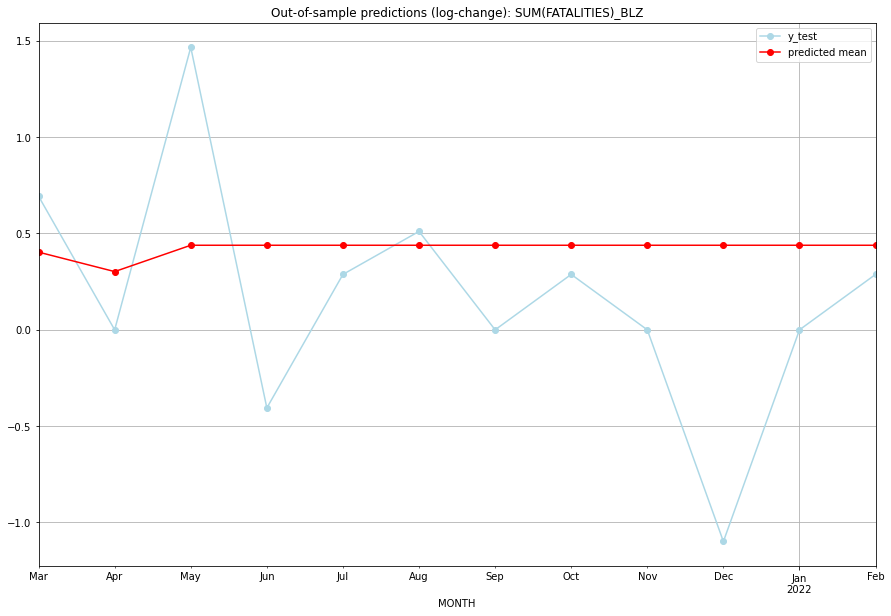

TADDA: 0.5601651283896704
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  3.489971         5.0      0.403234        0.693147   BLZ   
1  2021-04-01  3.058739         2.0      0.302260        0.000000   BLZ   
2  2021-05-01  3.653242        12.0      0.438952        1.466337   BLZ   
3  2021-06-01  3.653242         1.0      0.438952       -0.405465   BLZ   
4  2021-07-01  3.653242         3.0      0.438952        0.287682   BLZ   
5  2021-08-01  3.653242         4.0      0.438952        0.510826   BLZ   
6  2021-09-01  3.653242         2.0      0.438952        0.000000   BLZ   
7  2021-10-01  3.653242         3.0      0.438952        0.287682   BLZ   
8  2021-11-01  3.653242         2.0      0.438952        0.000000   BLZ   
9  2021-12-01  3.653242         0.0      0.438952       -1.098612   BLZ   
10 2022-01-01  3.653242         2.0      0.438952        0.000000   BLZ   
11 2022-02-01  3.653242         3.0      0.438952    

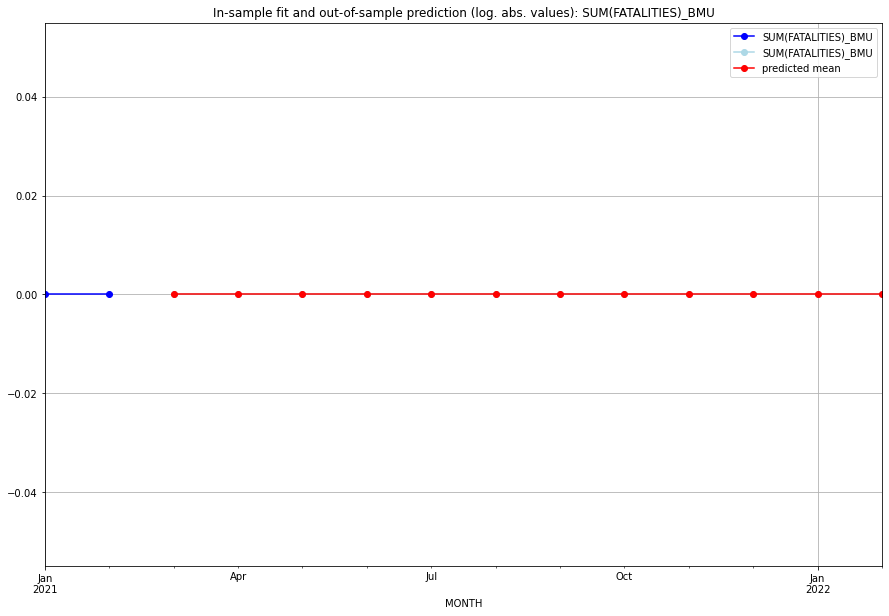

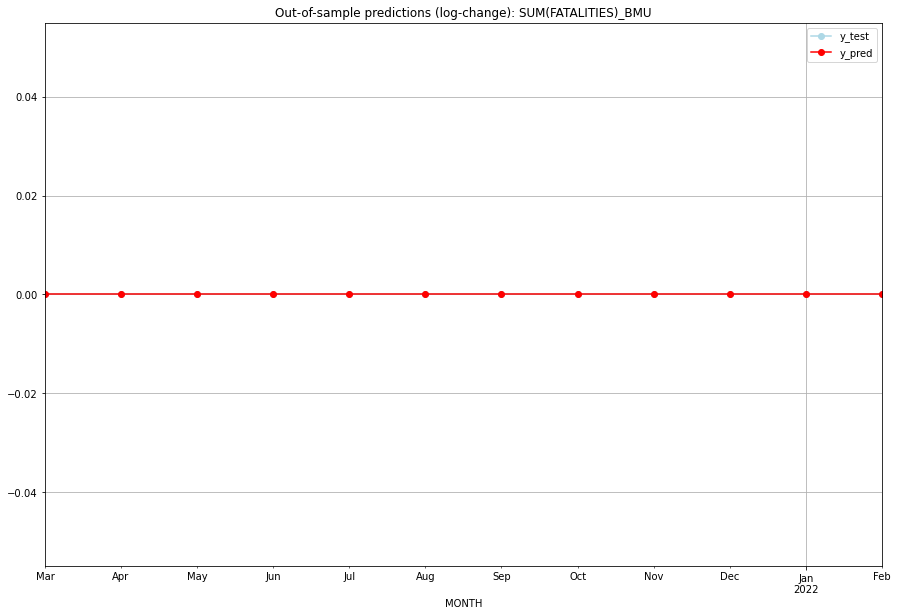

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   BMU   
1  2021-04-01       0.0         0.0           0.0             0.0   BMU   
2  2021-05-01       0.0         0.0           0.0             0.0   BMU   
3  2021-06-01       0.0         0.0           0.0             0.0   BMU   
4  2021-07-01       0.0         0.0           0.0             0.0   BMU   
5  2021-08-01       0.0         0.0           0.0             0.0   BMU   
6  2021-09-01       0.0         0.0           0.0             0.0   BMU   
7  2021-10-01       0.0         0.0           0.0             0.0   BMU   
8  2021-11-01       0.0         0.0           0.0             0.0   BMU   
9  2021-12-01       0.0         0.0           0.0             0.0   BMU   
10 2022-01-01       0.0         0.0           0.0             0.0   BMU   
11 2022-02-01       0.0         0.0           0.0             0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [1, (0, 1, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.11552453009332421, 'fold_results': [nan, 0.11552453009332421]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_BOL   No. Observations:                   38
Model:                SARIMAX(0, 1, 3)   Log Likelihood                 -35.923
Date:                 Wed, 19 Oct 2022   AIC                             81.846
Time:                         10:30:34   BIC                             89.901
Sample:                     01-31-2018   HQIC                            84.686
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -0.0482      0.063     -0.76

<Figure size 432x288 with 0 Axes>

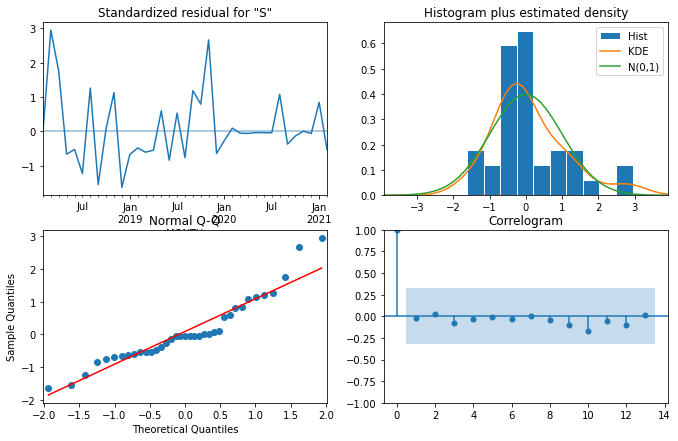

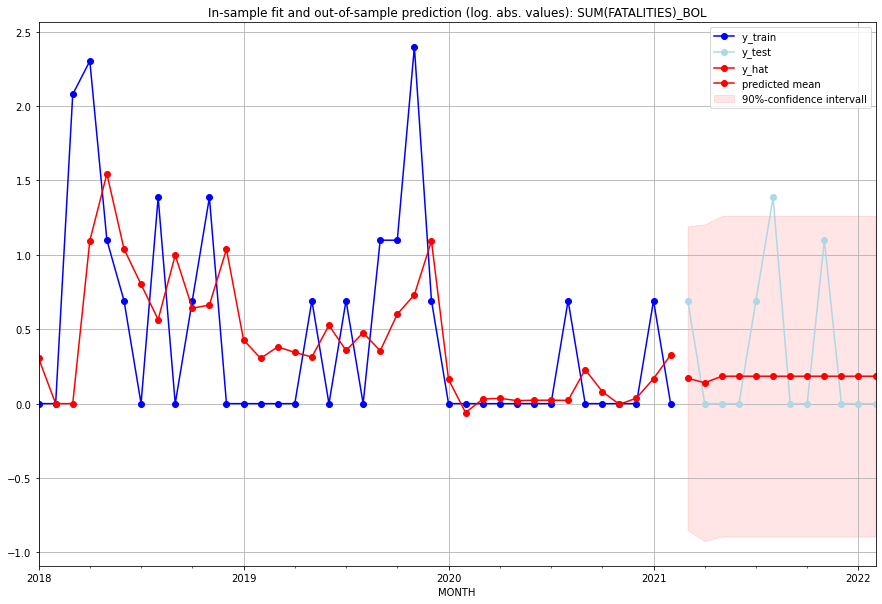

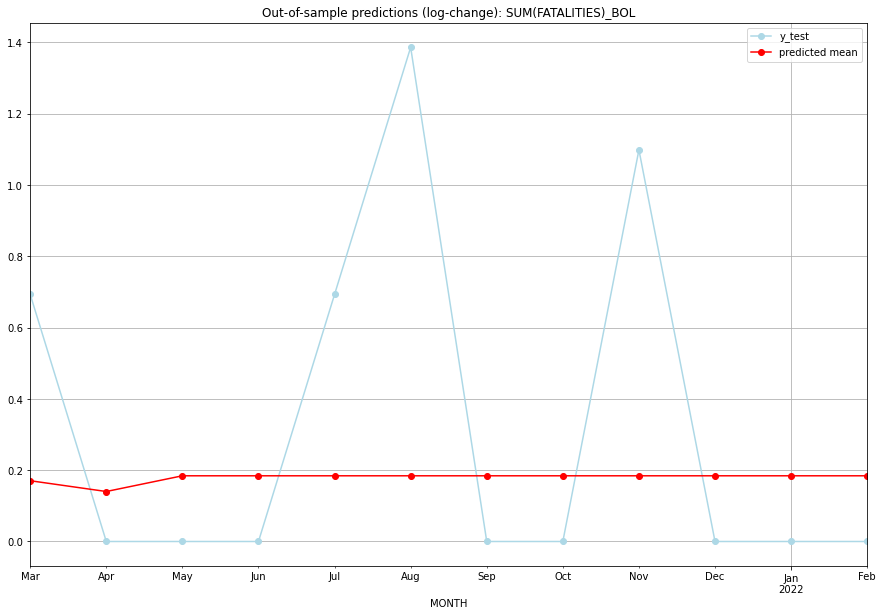

TADDA: 0.381510942042585
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  0.185861         1.0      0.170469        0.693147   BOL   
1  2021-04-01  0.150515         0.0      0.140210        0.000000   BOL   
2  2021-05-01  0.202374         0.0      0.184298        0.000000   BOL   
3  2021-06-01  0.202374         0.0      0.184298        0.000000   BOL   
4  2021-07-01  0.202374         1.0      0.184298        0.693147   BOL   
5  2021-08-01  0.202374         3.0      0.184298        1.386294   BOL   
6  2021-09-01  0.202374         0.0      0.184298        0.000000   BOL   
7  2021-10-01  0.202374         0.0      0.184298        0.000000   BOL   
8  2021-11-01  0.202374         2.0      0.184298        1.098612   BOL   
9  2021-12-01  0.202374         0.0      0.184298        0.000000   BOL   
10 2022-01-01  0.202374         0.0      0.184298        0.000000   BOL   
11 2022-02-01  0.202374         0.0      0.184298     

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (2, 0, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.17961864658820387, 'fold_results': [0.19345586926825176, 0.165781423908156]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_BRA   No. Observations:                   38
Model:                SARIMAX(2, 0, 2)   Log Likelihood                  -2.810
Date:                 Wed, 19 Oct 2022   AIC                             15.619
Time:                         10:30:48   BIC                             23.807
Sample:                     01-31-2018   HQIC                            18.532
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.0342      0

<Figure size 432x288 with 0 Axes>

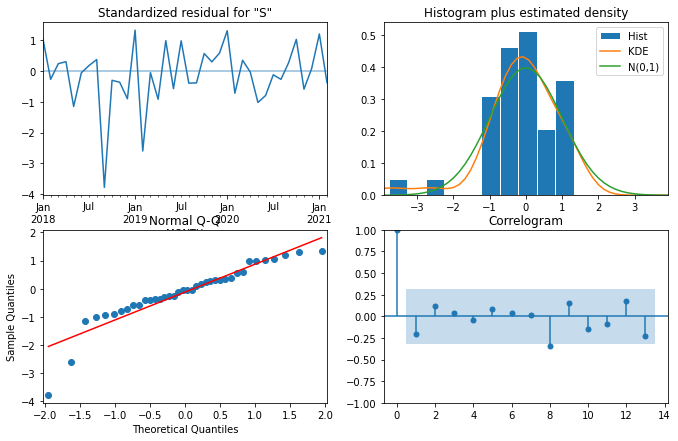

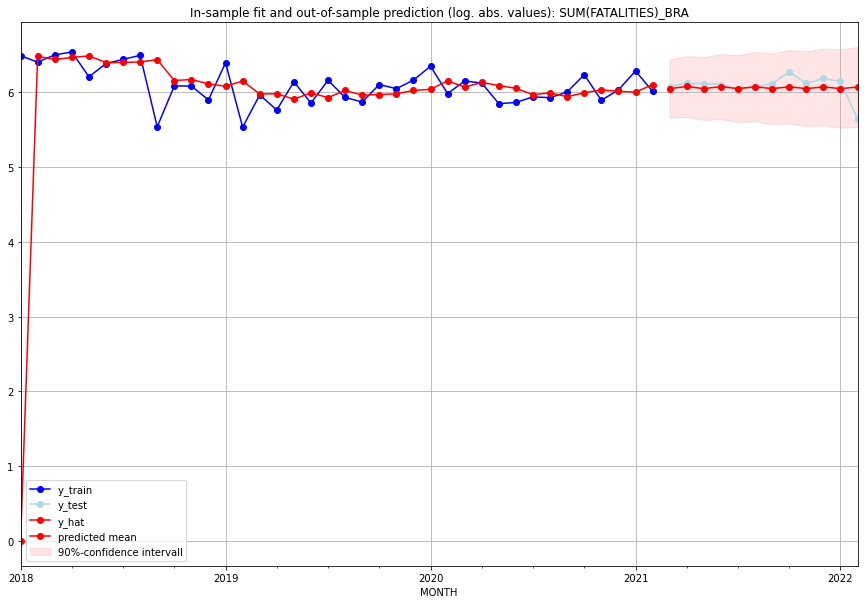

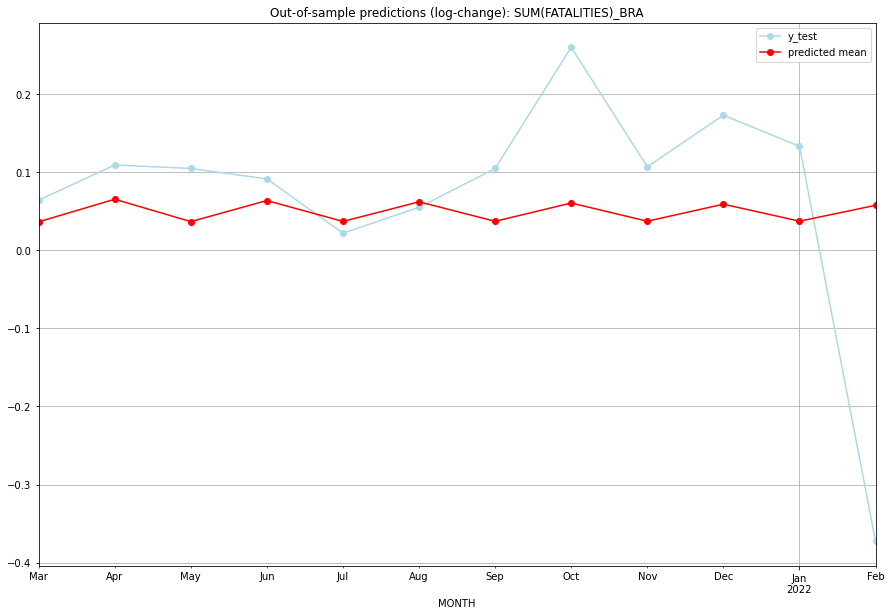

TADDA: 0.1019812896051356
Evaluation finished.
        MONTH    FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  422.080821       434.0      0.036296        0.064079   BRA   
1  2021-04-01  434.494536       454.0      0.065215        0.109030   BRA   
2  2021-05-01  422.205617       452.0      0.036591        0.104625   BRA   
3  2021-06-01  433.765473       446.0      0.063540        0.091291   BRA   
4  2021-07-01  422.301921       416.0      0.036819        0.021819   BRA   
5  2021-08-01  433.065952       430.0      0.061929        0.054841   BRA   
6  2021-09-01  422.371637       452.0      0.036983        0.104625   BRA   
7  2021-10-01  432.393932       528.0      0.060380        0.259721   BRA   
8  2021-11-01  422.416545       453.0      0.037089        0.106830   BRA   
9  2021-12-01  431.747518       484.0      0.058887        0.172882   BRA   
10 2022-01-01  422.438311       465.0      0.037141        0.132918   BRA   
11 2022-02-01  431.124952    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (2, 0, 1), (0, 0, 0, 0), 'n'], 'cv_score': 0.05776226477310199, 'fold_results': [0.057762265046662105, 0.05776226449954188]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_BRB   No. Observations:                   38
Model:                SARIMAX(2, 0, 1)   Log Likelihood                  21.147
Date:                 Wed, 19 Oct 2022   AIC                            -34.293
Time:                         10:31:09   BIC                            -27.743
Sample:                     01-31-2018   HQIC                           -31.963
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         5.9e-06   1

<Figure size 432x288 with 0 Axes>

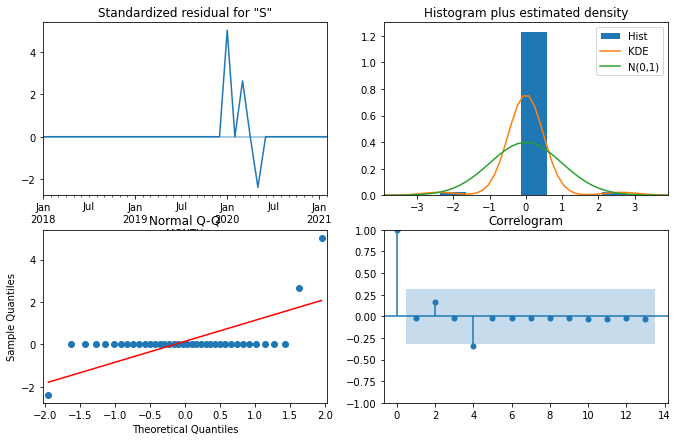

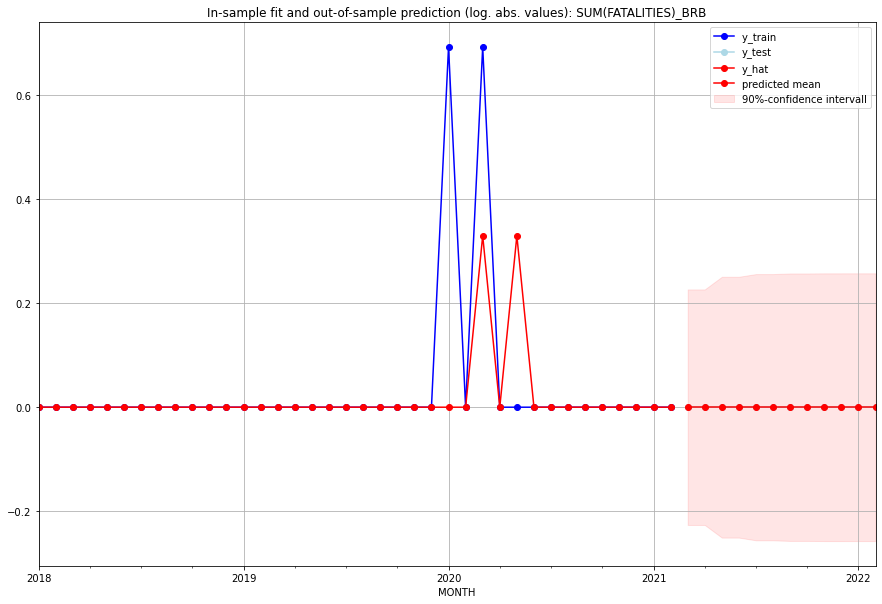

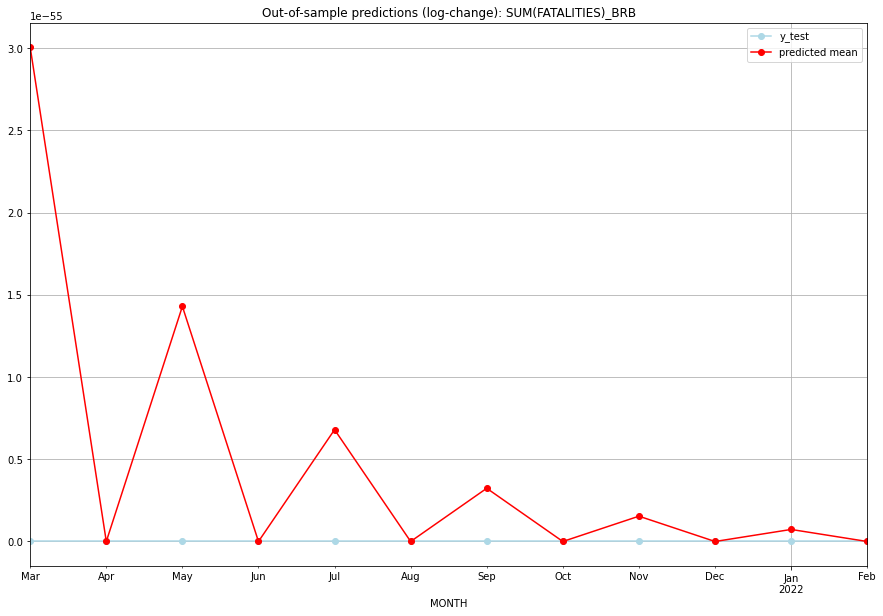

TADDA: 4.720896482131256e-56
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0  3.004909e-55             0.0   BRB   
1  2021-04-01       0.0         0.0  1.772912e-60             0.0   BRB   
2  2021-05-01       0.0         0.0  1.429480e-55             0.0   BRB   
3  2021-06-01       0.0         0.0  1.686802e-60             0.0   BRB   
4  2021-07-01       0.0         0.0  6.800250e-56             0.0   BRB   
5  2021-08-01       0.0         0.0  1.203656e-60             0.0   BRB   
6  2021-09-01       0.0         0.0  3.234980e-56             0.0   BRB   
7  2021-10-01       0.0         0.0  7.634626e-61             0.0   BRB   
8  2021-11-01       0.0         0.0  1.538928e-56             0.0   BRB   
9  2021-12-01       0.0         0.0  4.539882e-61             0.0   BRB   
10 2022-01-01       0.0         0.0  7.320912e-57             0.0   BRB   
11 2022-02-01       0.0         0.0  2.591628e-61 

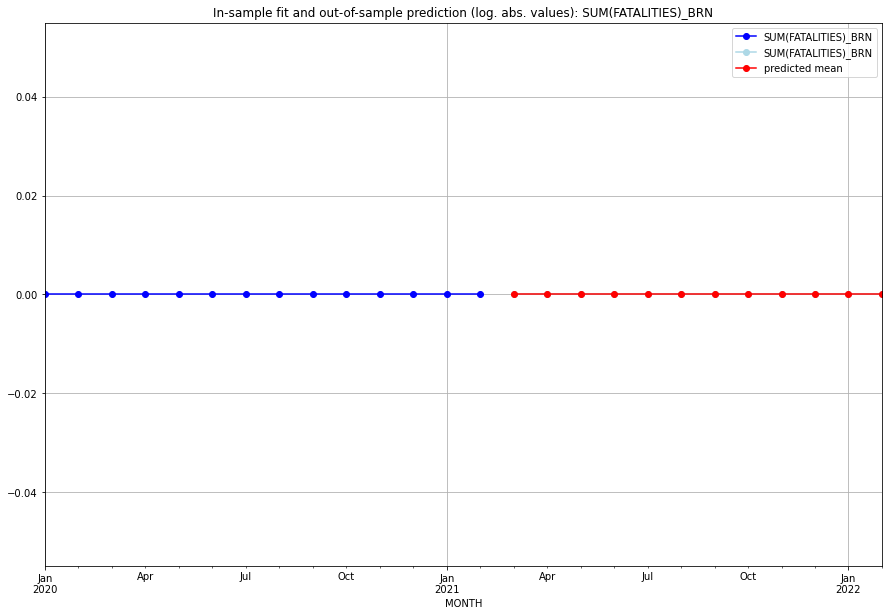

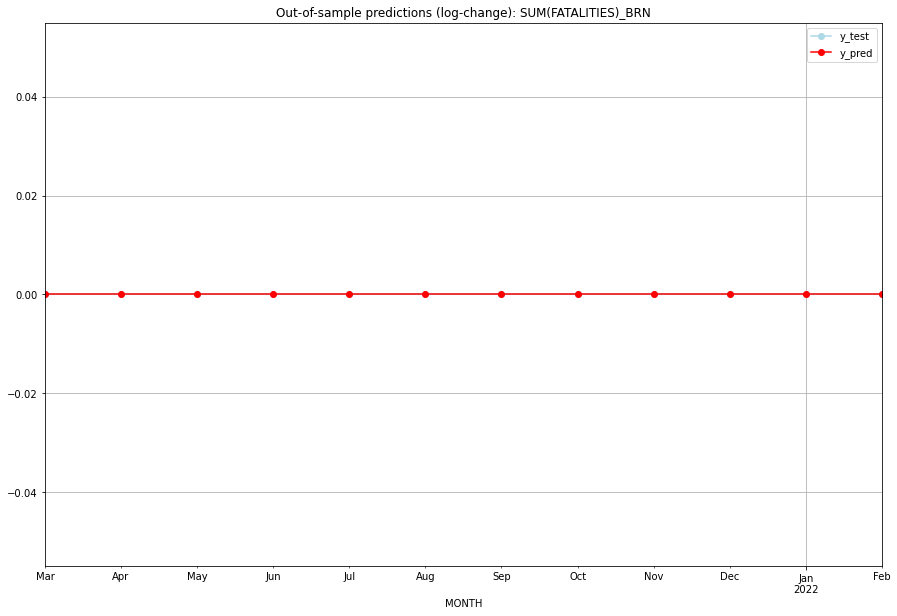

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   BRN   
1  2021-04-01       0.0         0.0           0.0             0.0   BRN   
2  2021-05-01       0.0         0.0           0.0             0.0   BRN   
3  2021-06-01       0.0         0.0           0.0             0.0   BRN   
4  2021-07-01       0.0         0.0           0.0             0.0   BRN   
5  2021-08-01       0.0         0.0           0.0             0.0   BRN   
6  2021-09-01       0.0         0.0           0.0             0.0   BRN   
7  2021-10-01       0.0         0.0           0.0             0.0   BRN   
8  2021-11-01       0.0         0.0           0.0             0.0   BRN   
9  2021-12-01       0.0         0.0           0.0             0.0   BRN   
10 2022-01-01       0.0         0.0           0.0             0.0   BRN   
11 2022-02-01       0.0         0.0           0.0             0.0   

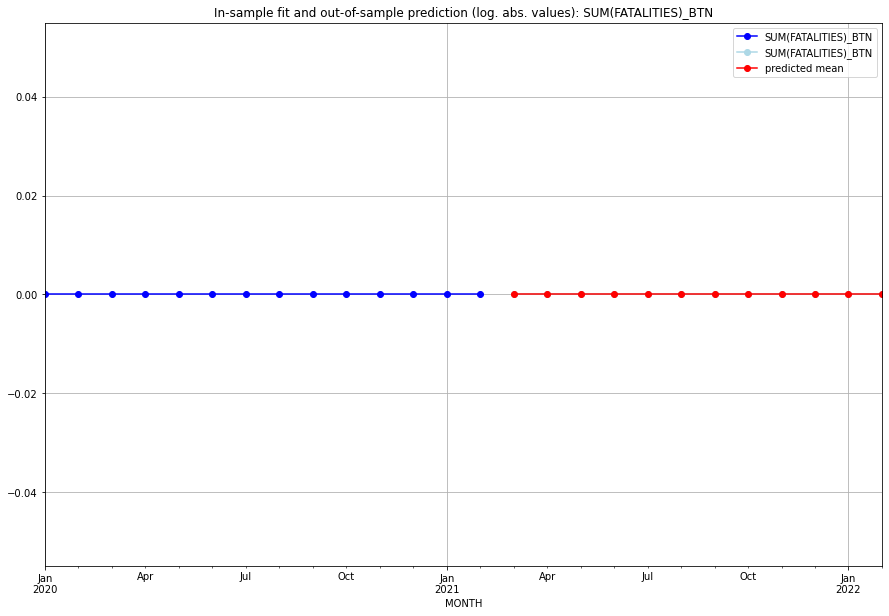

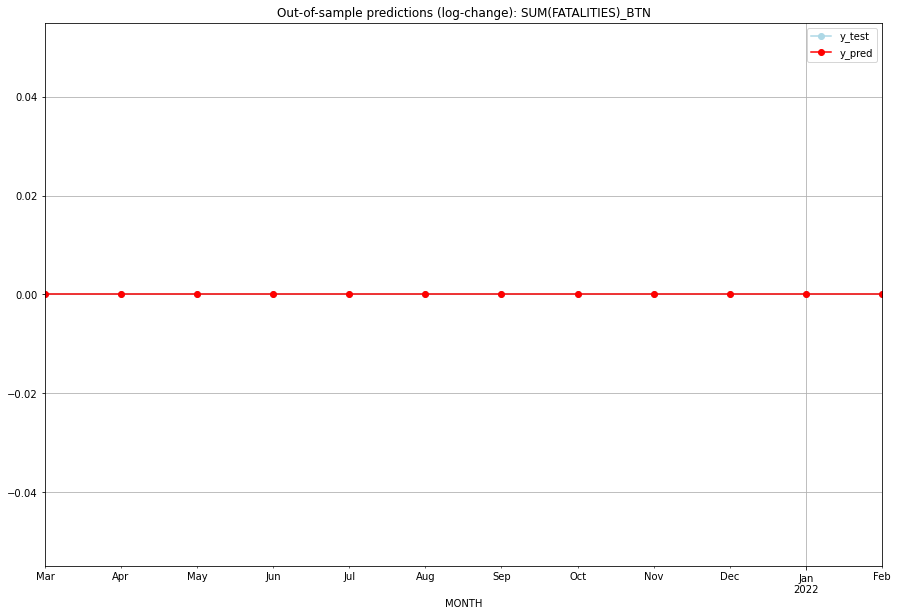

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   BTN   
1  2021-04-01       0.0         0.0           0.0             0.0   BTN   
2  2021-05-01       0.0         0.0           0.0             0.0   BTN   
3  2021-06-01       0.0         0.0           0.0             0.0   BTN   
4  2021-07-01       0.0         0.0           0.0             0.0   BTN   
5  2021-08-01       0.0         0.0           0.0             0.0   BTN   
6  2021-09-01       0.0         0.0           0.0             0.0   BTN   
7  2021-10-01       0.0         0.0           0.0             0.0   BTN   
8  2021-11-01       0.0         0.0           0.0             0.0   BTN   
9  2021-12-01       0.0         0.0           0.0             0.0   BTN   
10 2022-01-01       0.0         0.0           0.0             0.0   BTN   
11 2022-02-01       0.0         0.0           0.0             0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.08458623025389712, 'fold_results': [0.0, 0.0, 0.057762265046662105, 0.11552453009332421, 0.24964435612949928]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_BWA   No. Observations:                  289
Model:                         SARIMAX   Log Likelihood                 150.941
Date:                 Wed, 19 Oct 2022   AIC                           -299.883
Time:                         10:32:01   BIC                           -296.216
Sample:                     02-28-1997   HQIC                          -298.414
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------------------

<Figure size 432x288 with 0 Axes>

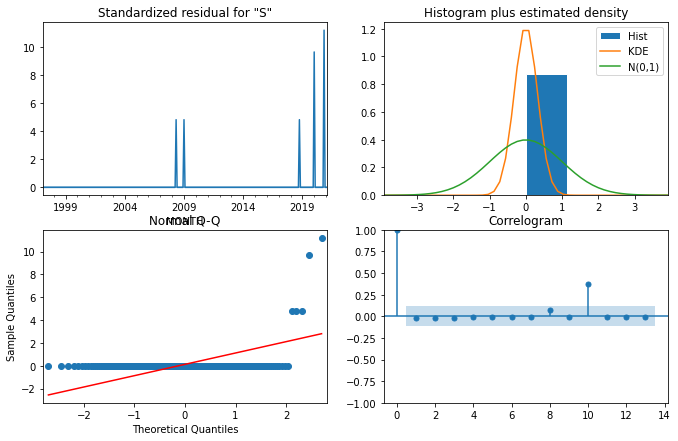

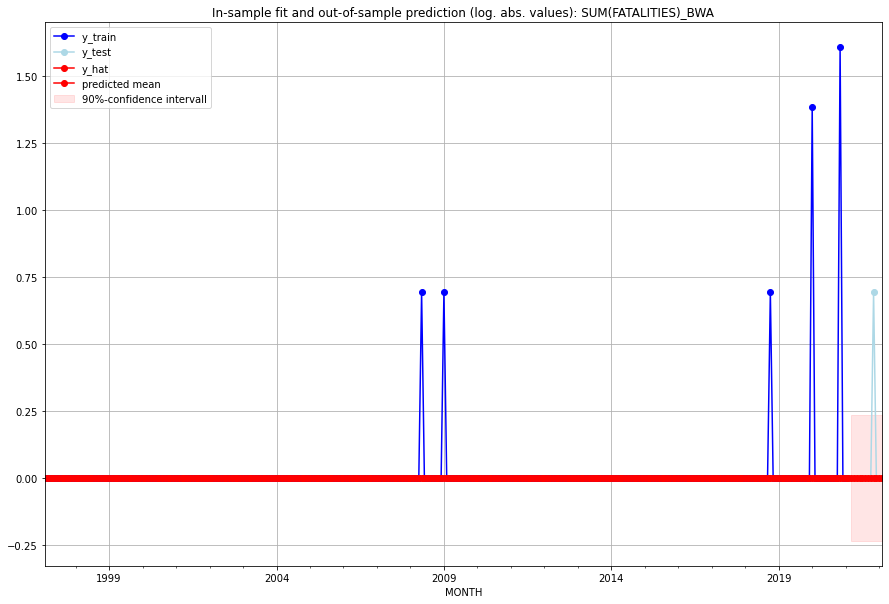

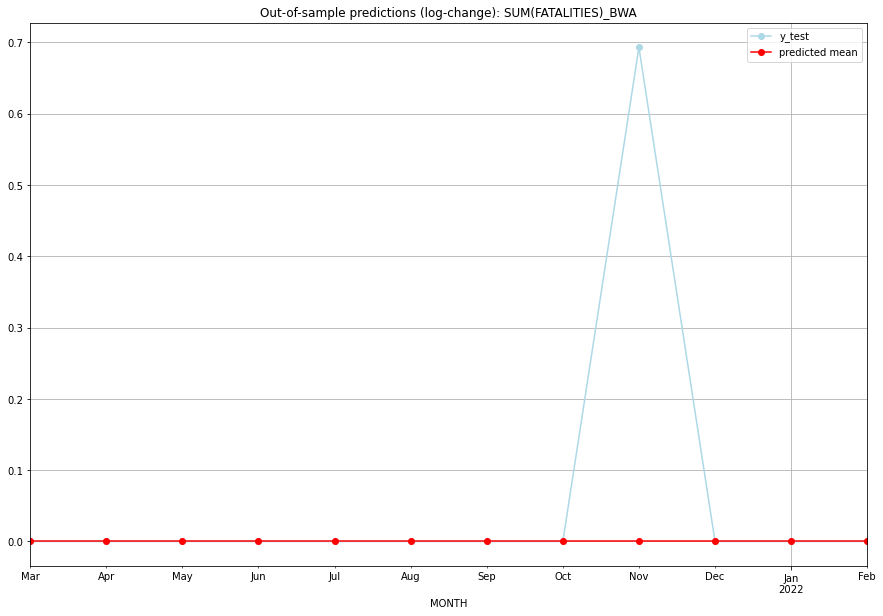

TADDA: 0.057762265046662105
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0        0.000000   BWA   
1  2021-04-01       0.0         0.0           0.0        0.000000   BWA   
2  2021-05-01       0.0         0.0           0.0        0.000000   BWA   
3  2021-06-01       0.0         0.0           0.0        0.000000   BWA   
4  2021-07-01       0.0         0.0           0.0        0.000000   BWA   
5  2021-08-01       0.0         0.0           0.0        0.000000   BWA   
6  2021-09-01       0.0         0.0           0.0        0.000000   BWA   
7  2021-10-01       0.0         0.0           0.0        0.000000   BWA   
8  2021-11-01       0.0         1.0           0.0        0.693147   BWA   
9  2021-12-01       0.0         0.0           0.0        0.000000   BWA   
10 2022-01-01       0.0         0.0           0.0        0.000000   BWA   
11 2022-02-01       0.0         0.0           0.0  

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [1, (3, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.9066333306733358, 'fold_results': [1.1104484852527912, 0.6256310495103193, 0.8122983443308861, 0.9755135693292573, 1.0092752049434255]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_CAF   No. Observations:                  289
Model:                SARIMAX(3, 1, 0)   Log Likelihood                -503.011
Date:                 Wed, 19 Oct 2022   AIC                           1016.021
Time:                         10:32:37   BIC                           1034.336
Sample:                     02-28-1997   HQIC                          1023.361
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------

<Figure size 432x288 with 0 Axes>

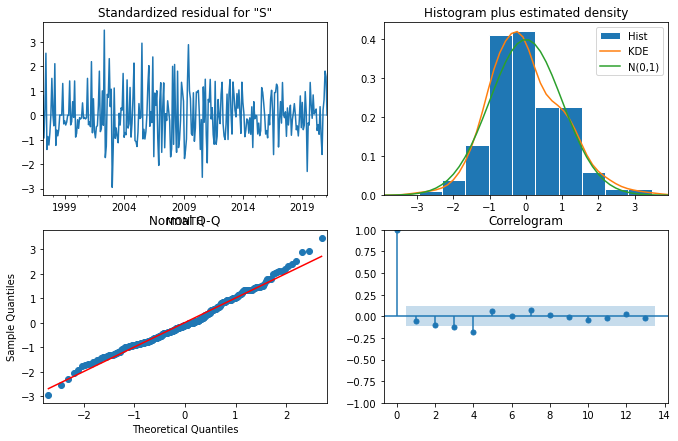

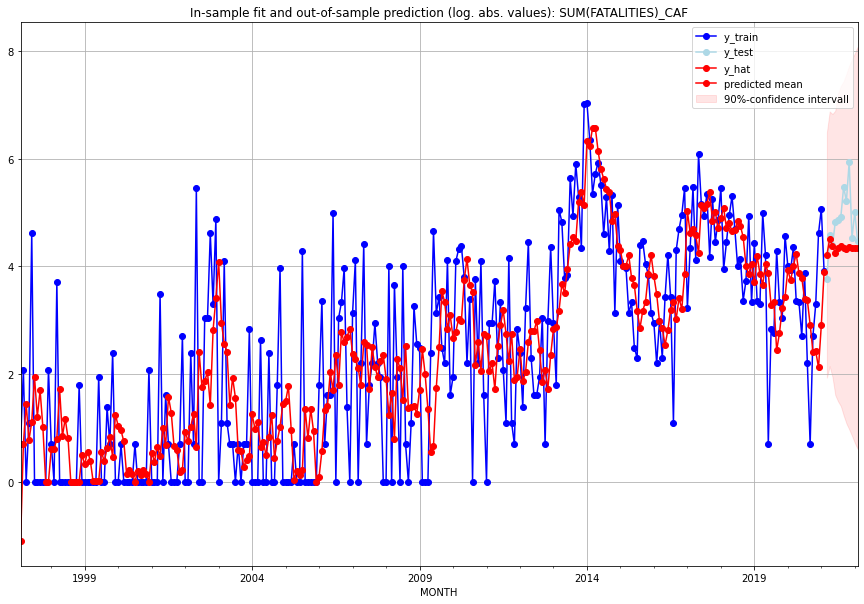

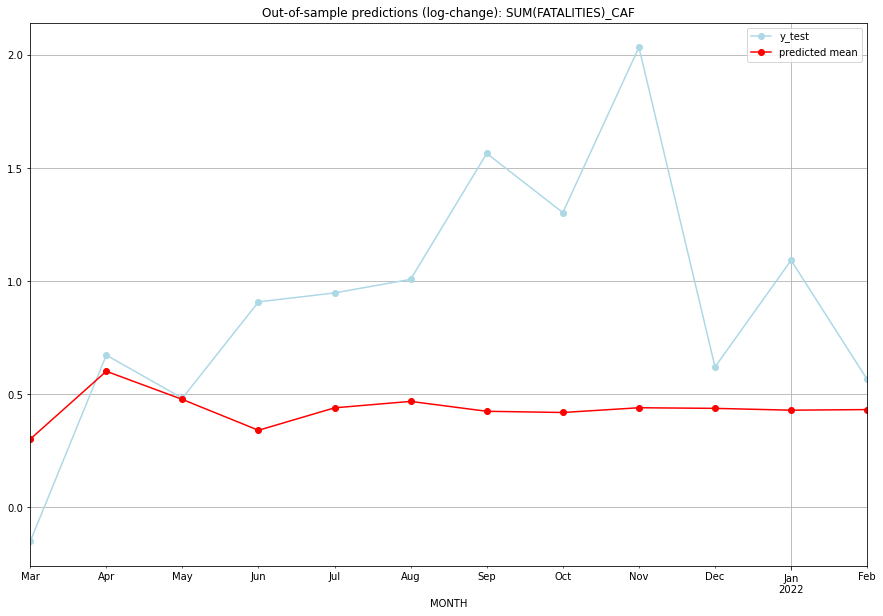

TADDA: 0.5867125570191426
Evaluation finished.
        MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  66.594718        42.0      0.301507       -0.150823   CAF   
1  2021-04-01  90.248424        97.0      0.601563        0.672944   CAF   
2  2021-05-01  79.562905        80.0      0.477015        0.482426   CAF   
3  2021-06-01  69.296936       123.0      0.340705        0.908259   CAF   
4  2021-07-01  76.632418       128.0      0.439962        0.947789   CAF   
5  2021-08-01  78.869756       136.0      0.468374        1.007958   CAF   
6  2021-09-01  75.454462       238.0      0.424672        1.564441   CAF   
7  2021-10-01  75.046903       183.0      0.419327        1.302913   CAF   
8  2021-11-01  76.659451       381.0      0.440310        2.033398   CAF   
9  2021-12-01  76.447770        92.0      0.437581        0.620576   CAF   
10 2022-01-01  75.825457       148.0      0.429513        1.091923   CAF   
11 2022-02-01  76.032442        87.0     

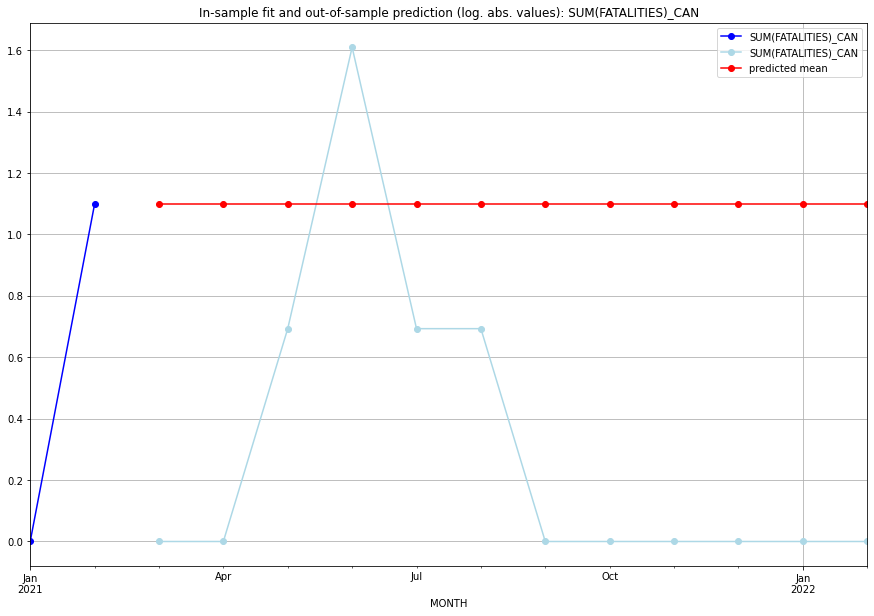

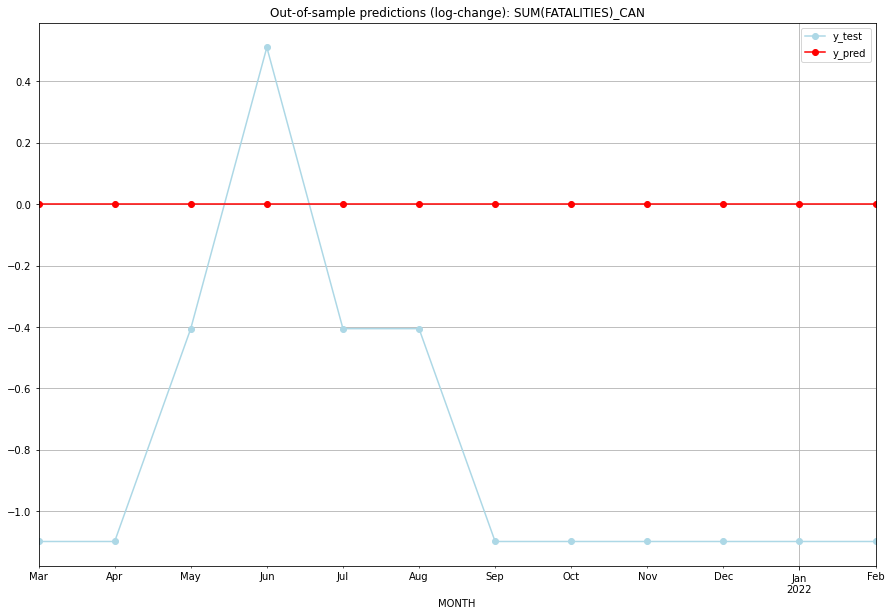

TADDA: 0.8763432714529468
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  1.098612    0.000000           0.0       -1.098612   CAN   
1  2021-04-01  1.098612    0.000000           0.0       -1.098612   CAN   
2  2021-05-01  1.098612    0.693147           0.0       -0.405465   CAN   
3  2021-06-01  1.098612    1.609438           0.0        0.510826   CAN   
4  2021-07-01  1.098612    0.693147           0.0       -0.405465   CAN   
5  2021-08-01  1.098612    0.693147           0.0       -0.405465   CAN   
6  2021-09-01  1.098612    0.000000           0.0       -1.098612   CAN   
7  2021-10-01  1.098612    0.000000           0.0       -1.098612   CAN   
8  2021-11-01  1.098612    0.000000           0.0       -1.098612   CAN   
9  2021-12-01  1.098612    0.000000           0.0       -1.098612   CAN   
10 2022-01-01  1.098612    0.000000           0.0       -1.098612   CAN   
11 2022-02-01  1.098612    0.000000           0.0    

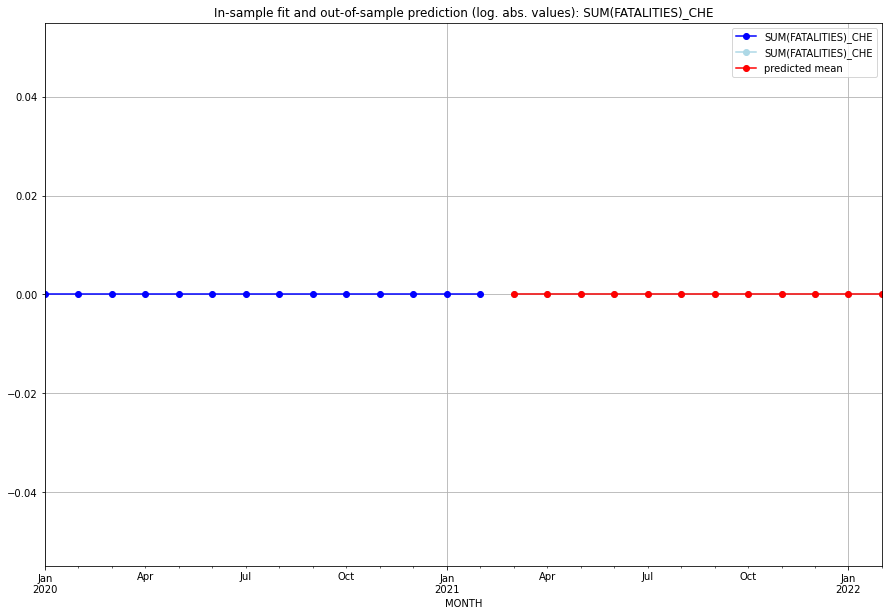

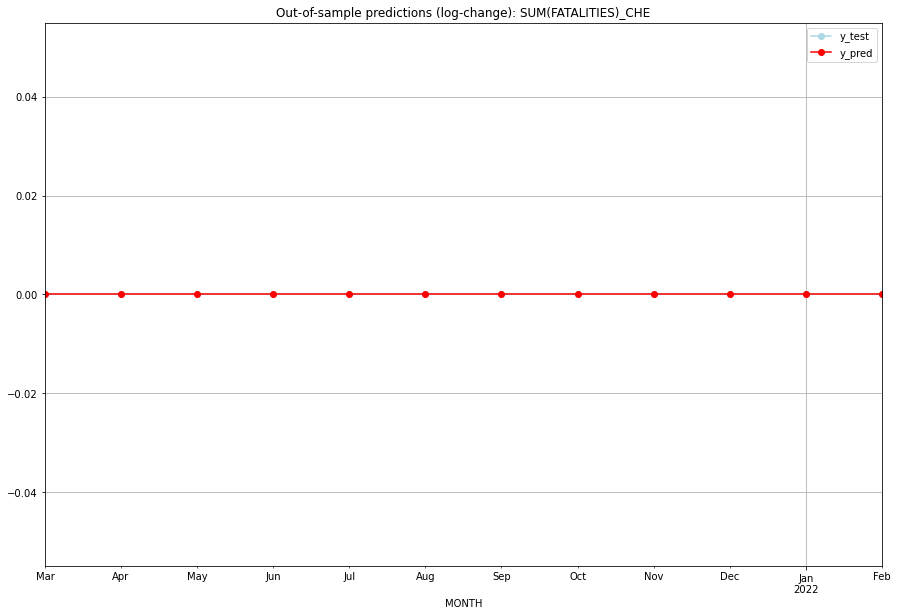

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   CHE   
1  2021-04-01       0.0         0.0           0.0             0.0   CHE   
2  2021-05-01       0.0         0.0           0.0             0.0   CHE   
3  2021-06-01       0.0         0.0           0.0             0.0   CHE   
4  2021-07-01       0.0         0.0           0.0             0.0   CHE   
5  2021-08-01       0.0         0.0           0.0             0.0   CHE   
6  2021-09-01       0.0         0.0           0.0             0.0   CHE   
7  2021-10-01       0.0         0.0           0.0             0.0   CHE   
8  2021-11-01       0.0         0.0           0.0             0.0   CHE   
9  2021-12-01       0.0         0.0           0.0             0.0   CHE   
10 2022-01-01       0.0         0.0           0.0             0.0   CHE   
11 2022-02-01       0.0         0.0           0.0             0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [1, (3, 1, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.40714395623052346, 'fold_results': [nan, 0.40714395623052346]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_CHL   No. Observations:                   38
Model:                SARIMAX(3, 1, 3)   Log Likelihood                 -36.577
Date:                 Wed, 19 Oct 2022   AIC                             89.153
Time:                         10:33:03   BIC                            102.041
Sample:                     01-31-2018   HQIC                            93.697
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             0.0511      0.040      1.27

<Figure size 432x288 with 0 Axes>

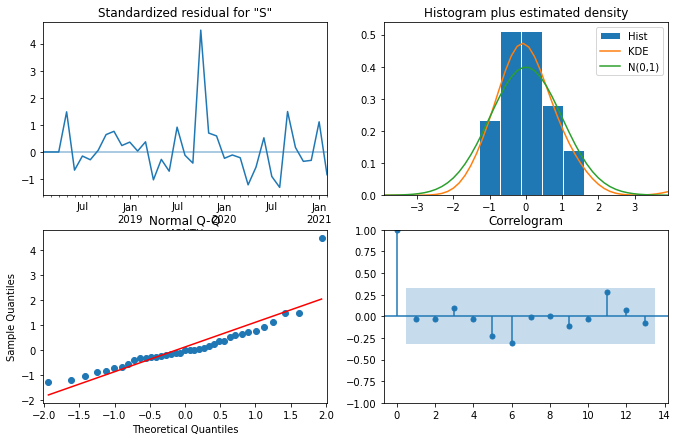

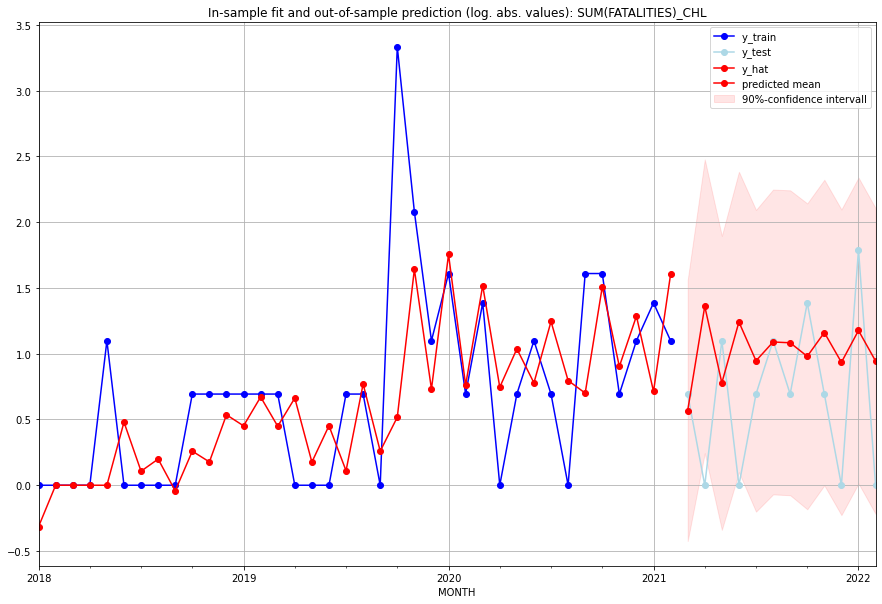

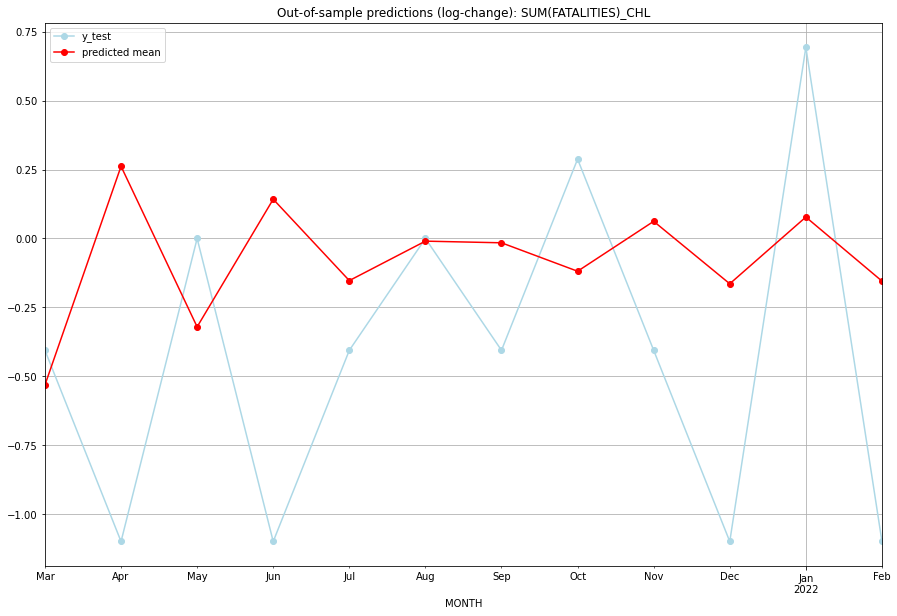

TADDA: 0.6377325731990554
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  0.763893         1.0     -0.531089       -0.405465   CHL   
1  2021-04-01  2.897394         0.0      0.261696       -1.098612   CHL   
2  2021-05-01  1.177561         2.0     -0.320407        0.000000   CHL   
3  2021-06-01  2.459053         0.0      0.142383       -1.098612   CHL   
4  2021-07-01  1.575240         1.0     -0.152670       -0.405465   CHL   
5  2021-08-01  1.971213         2.0     -0.009642        0.000000   CHL   
6  2021-09-01  1.953437         1.0     -0.015643       -0.405465   CHL   
7  2021-10-01  1.664077         3.0     -0.118755        0.287682   CHL   
8  2021-11-01  2.192488         1.0      0.062188       -0.405465   CHL   
9  2021-12-01  1.545729         0.0     -0.164195       -1.098612   CHL   
10 2022-01-01  2.242409         5.0      0.077704        0.693147   CHL   
11 2022-02-01  1.570822         0.0     -0.154387    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.37328322275584486, 'fold_results': [0.2986265782046759, 0.4479398673070138]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_CHN   No. Observations:                   38
Model:                SARIMAX(0, 1, 0)   Log Likelihood                 -48.159
Date:                 Wed, 19 Oct 2022   AIC                             98.318
Time:                         10:33:21   BIC                             99.929
Sample:                     01-31-2018   HQIC                            98.886
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.7908      0

<Figure size 432x288 with 0 Axes>

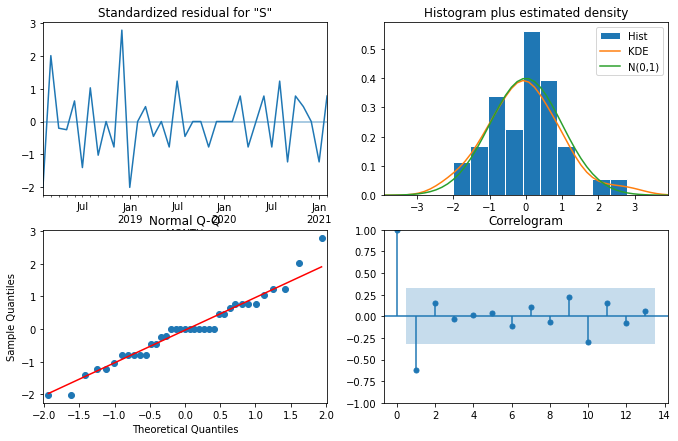

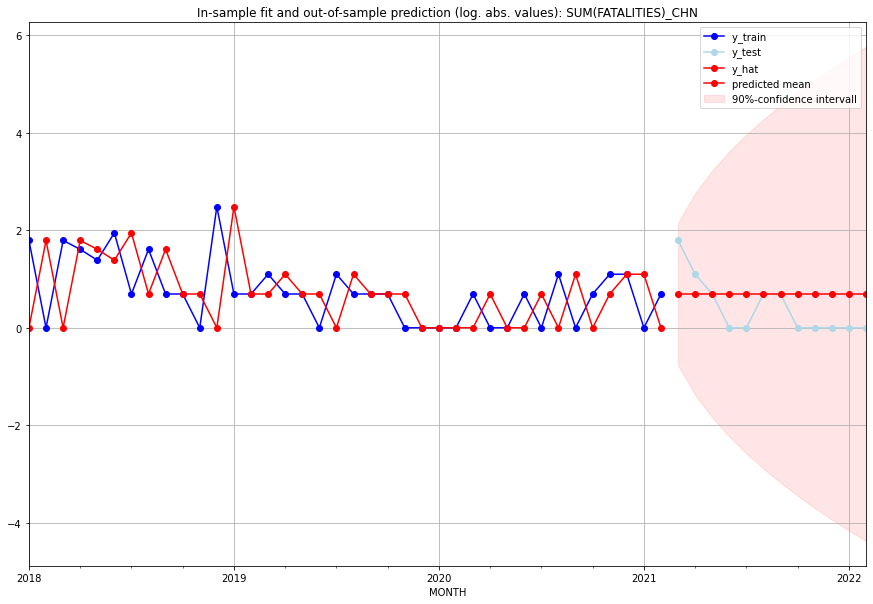

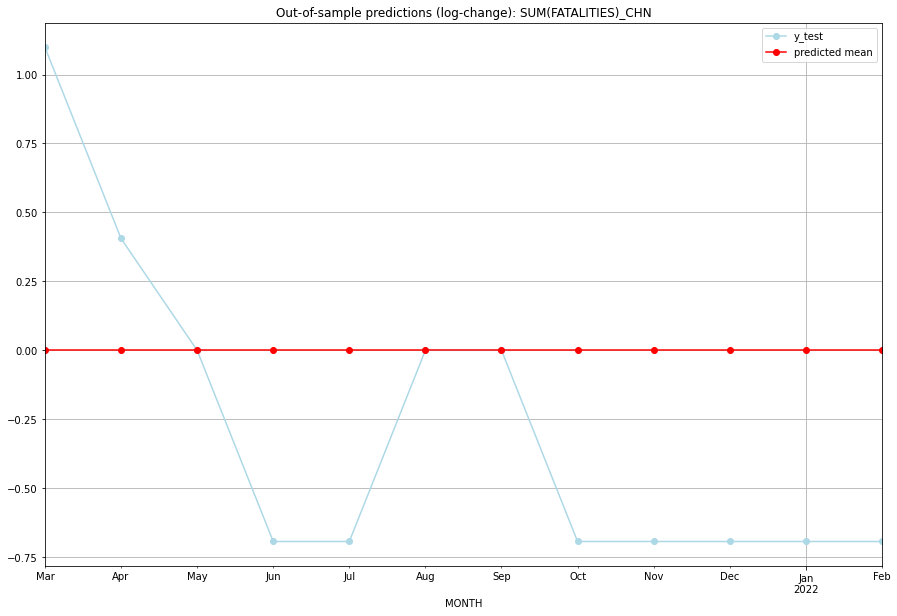

TADDA: 0.5296756383913243
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       1.0         5.0           0.0        1.098612   CHN   
1  2021-04-01       1.0         2.0           0.0        0.405465   CHN   
2  2021-05-01       1.0         1.0           0.0        0.000000   CHN   
3  2021-06-01       1.0         0.0           0.0       -0.693147   CHN   
4  2021-07-01       1.0         0.0           0.0       -0.693147   CHN   
5  2021-08-01       1.0         1.0           0.0        0.000000   CHN   
6  2021-09-01       1.0         1.0           0.0        0.000000   CHN   
7  2021-10-01       1.0         0.0           0.0       -0.693147   CHN   
8  2021-11-01       1.0         0.0           0.0       -0.693147   CHN   
9  2021-12-01       1.0         0.0           0.0       -0.693147   CHN   
10 2022-01-01       1.0         0.0           0.0       -0.693147   CHN   
11 2022-02-01       1.0         0.0           0.0    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (3, 1, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.8739159558487536, 'fold_results': [0.8179123676562247, 0.9335841314050363, 0.8887792429492457, 0.6609896859027957, 1.0683143513304658]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_CIV   No. Observations:                  289
Model:                SARIMAX(3, 1, 3)   Log Likelihood                -464.063
Date:                 Wed, 19 Oct 2022   AIC                            942.126
Time:                         10:33:46   BIC                            967.767
Sample:                     02-28-1997   HQIC                           952.401
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------

<Figure size 432x288 with 0 Axes>

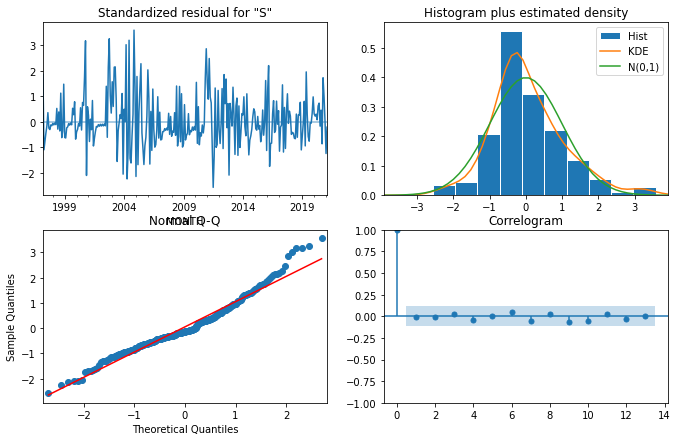

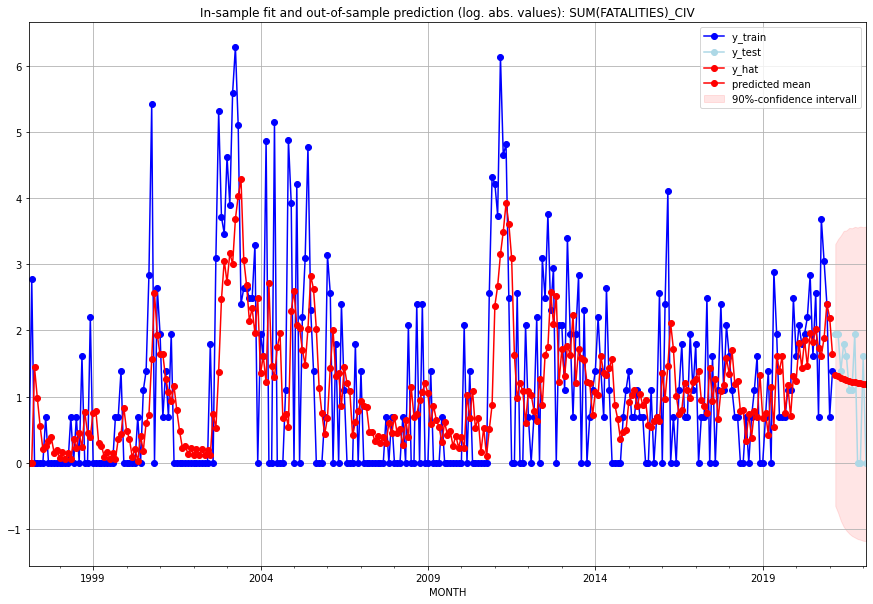

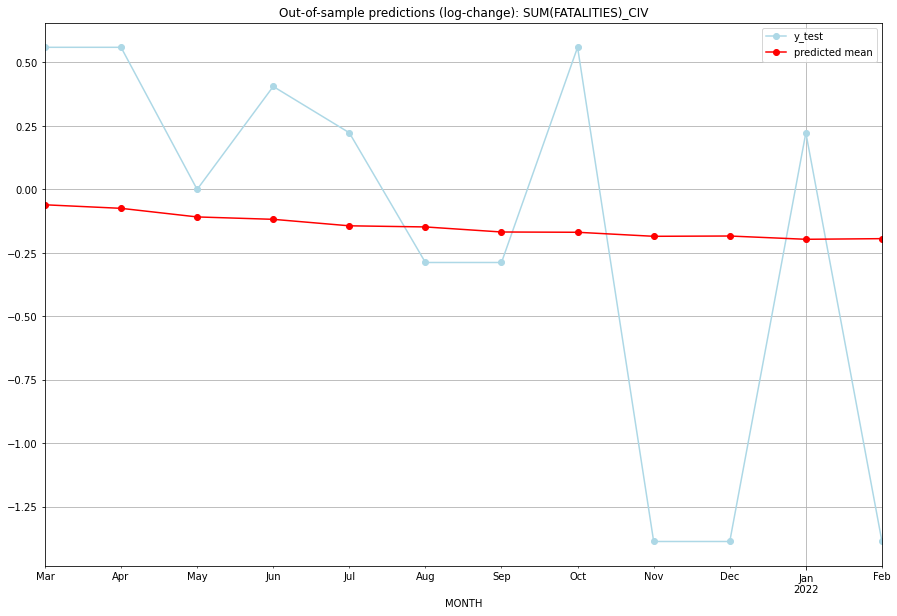

TADDA: 0.6681551078576327
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  2.765202         6.0     -0.060493        0.559616   CIV   
1  2021-04-01  2.713057         6.0     -0.074439        0.559616   CIV   
2  2021-05-01  2.589447         3.0     -0.108296        0.000000   CIV   
3  2021-06-01  2.555804         5.0     -0.117713        0.405465   CIV   
4  2021-07-01  2.466135         4.0     -0.143254        0.223144   CIV   
5  2021-08-01  2.450764         2.0     -0.147699       -0.287682   CIV   
6  2021-09-01  2.382641         2.0     -0.167637       -0.287682   CIV   
7  2021-10-01  2.379030         6.0     -0.168706        0.559616   CIV   
8  2021-11-01  2.325796         0.0     -0.184585       -1.386294   CIV   
9  2021-12-01  2.329578         0.0     -0.183449       -1.386294   CIV   
10 2022-01-01  2.286912         4.0     -0.196346        0.223144   CIV   
11 2022-02-01  2.295249         0.0     -0.193813    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [1, (3, 1, 1), (0, 0, 0, 0), 'n'], 'cv_score': 0.5640339876488648, 'fold_results': [0.7199125815656161, 0.8012238829418749, 0.597890962371543, 0.4447208945014595, 0.25642161686383047]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_CMR   No. Observations:                  289
Model:                SARIMAX(3, 1, 1)   Log Likelihood                -384.647
Date:                 Wed, 19 Oct 2022   AIC                            781.294
Time:                         10:34:17   BIC                            803.272
Sample:                     02-28-1997   HQIC                           790.102
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------

<Figure size 432x288 with 0 Axes>

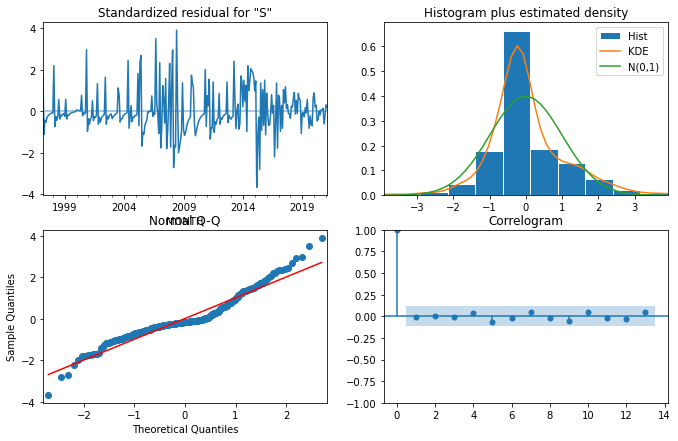

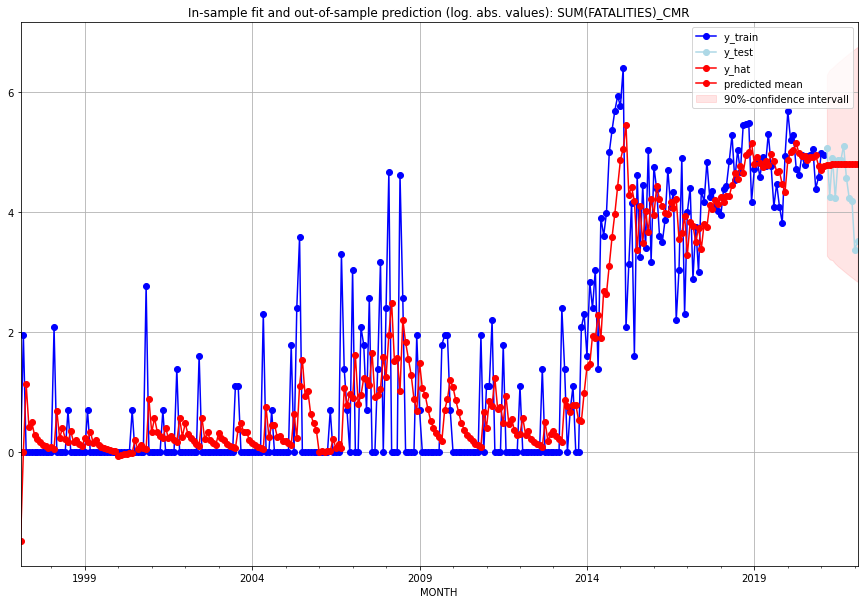

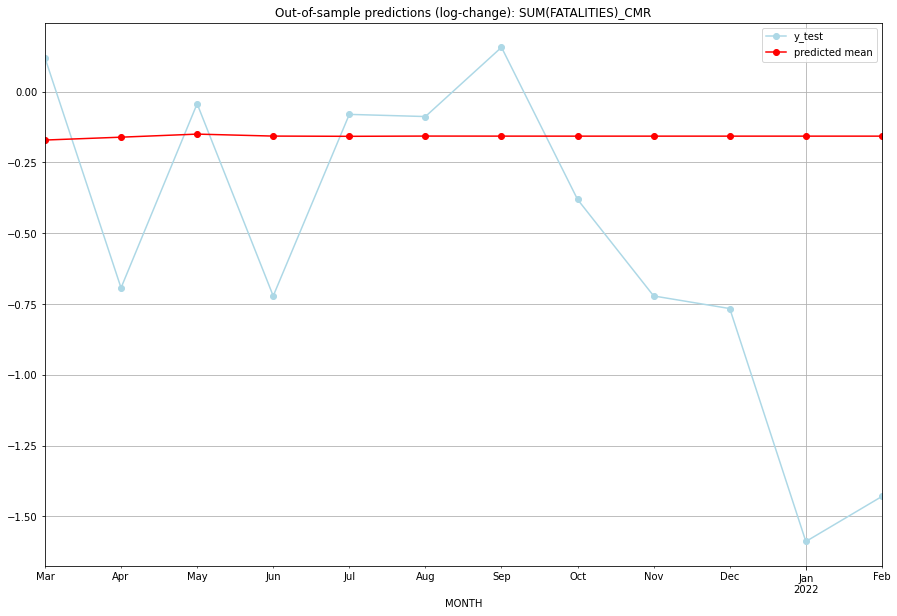

TADDA: 0.5318692647770984
Evaluation finished.
        MONTH    FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  118.652110       159.0     -0.171239        0.119347   CMR   
1  2021-04-01  119.868815        70.0     -0.161121       -0.693147   CMR   
2  2021-05-01  121.186063       135.0     -0.150282       -0.043172   CMR   
3  2021-06-01  120.336914        68.0     -0.157256       -0.721721   CMR   
4  2021-07-01  120.237503       130.0     -0.158076       -0.080630   CMR   
5  2021-08-01  120.341605       129.0     -0.157217       -0.088293   CMR   
6  2021-09-01  120.320894       165.0     -0.157388        0.156161   CMR   
7  2021-10-01  120.308260        96.0     -0.157492       -0.381116   CMR   
8  2021-11-01  120.313040        68.0     -0.157453       -0.721721   CMR   
9  2021-12-01  120.313383        65.0     -0.157450       -0.766172   CMR   
10 2022-01-01  120.312563        28.0     -0.157457       -1.588531   CMR   
11 2022-02-01  120.312678    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (2, 1, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.45969440961905816, 'fold_results': [0.29235947643672017, 0.6248853757607852, 0.43268606257635045, 0.49246844713254956, 0.45607268618888525]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_COD   No. Observations:                  289
Model:                SARIMAX(2, 1, 3)   Log Likelihood                -468.780
Date:                 Wed, 19 Oct 2022   AIC                            955.560
Time:                         10:34:45   BIC                            988.527
Sample:                     02-28-1997   HQIC                           968.771
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------

<Figure size 432x288 with 0 Axes>

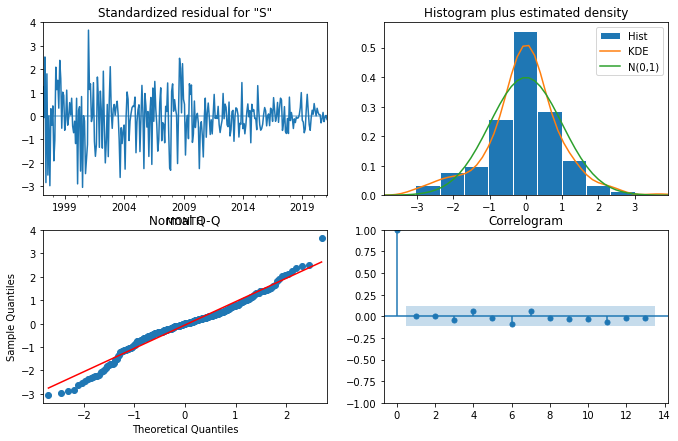

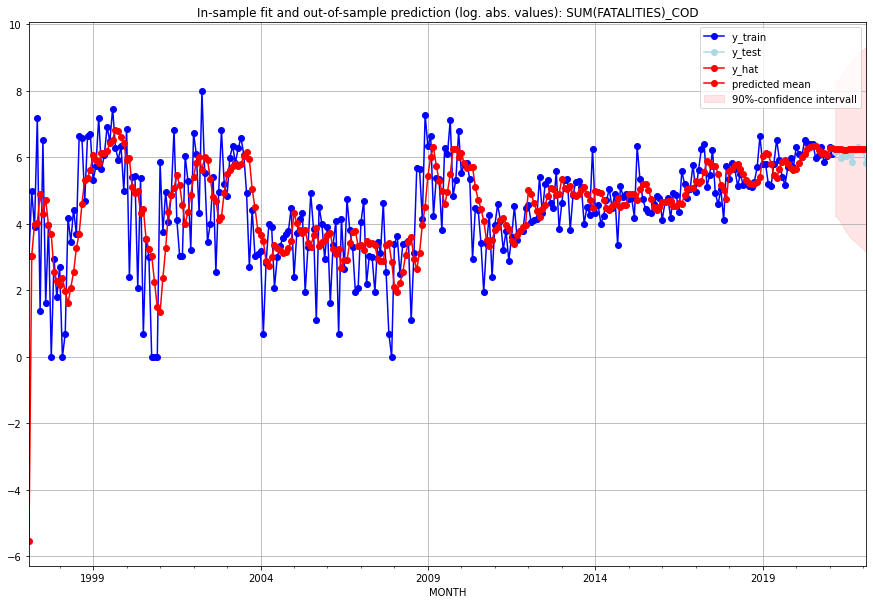

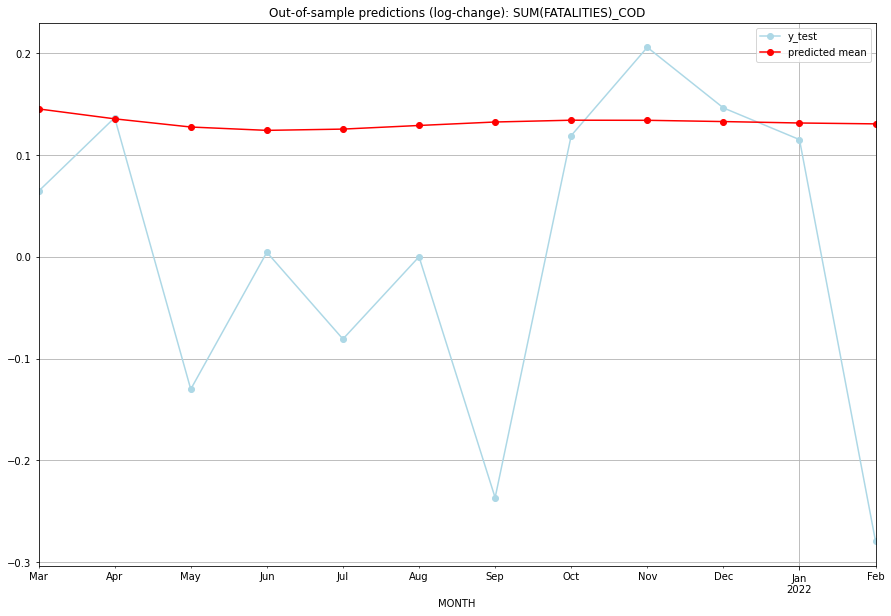

TADDA: 0.18378028737505434
Evaluation finished.
        MONTH    FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  520.471545       480.0      0.145187        0.064400   COD   
1  2021-04-01  515.423589       516.0      0.135460        0.136576   COD   
2  2021-05-01  511.289946       395.0      0.127423       -0.130053   COD   
3  2021-06-01  509.608590       452.0      0.124136        0.004425   COD   
4  2021-07-01  510.243063       415.0      0.125378       -0.080782   COD   
5  2021-08-01  512.067268       450.0      0.128940        0.000000   COD   
6  2021-09-01  513.821700       355.0      0.132353       -0.236537   COD   
7  2021-10-01  514.728468       507.0      0.134113        0.119014   COD   
8  2021-11-01  514.677699       553.0      0.134015        0.205697   COD   
9  2021-12-01  514.039658       521.0      0.132777        0.146200   COD   
10 2022-01-01  513.319643       505.0      0.131378        0.115069   COD   
11 2022-02-01  512.876256   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.49081247332870725, 'fold_results': [0.8251571892640962, 0.46209812037329684, 0.603923382048813, 0.09155102405567582, 0.4713326509016544]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_COG   No. Observations:                  289
Model:                         SARIMAX   Log Likelihood                -387.345
Date:                 Wed, 19 Oct 2022   AIC                            776.690
Time:                         10:35:22   BIC                            780.356
Sample:                     02-28-1997   HQIC                           778.159
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------

<Figure size 432x288 with 0 Axes>

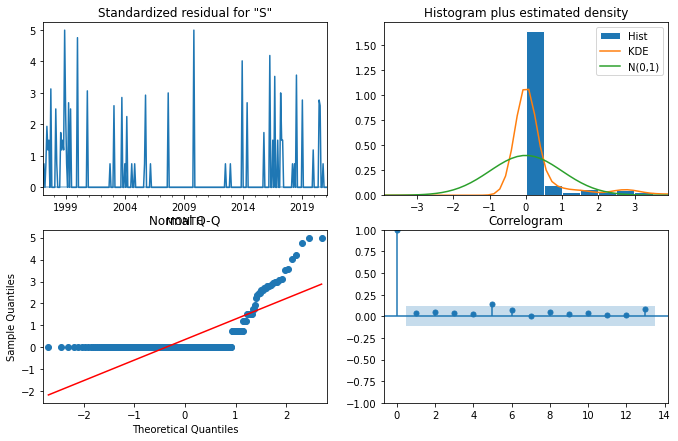

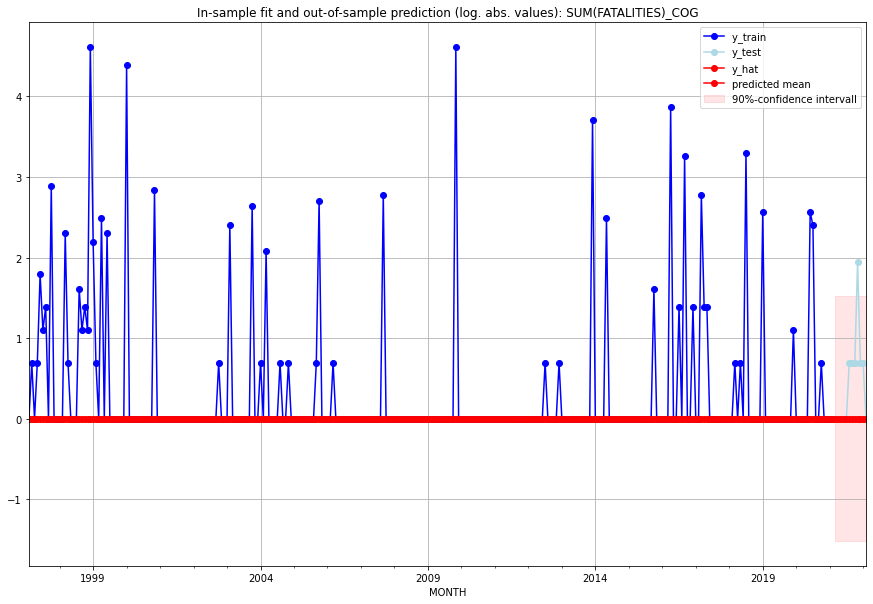

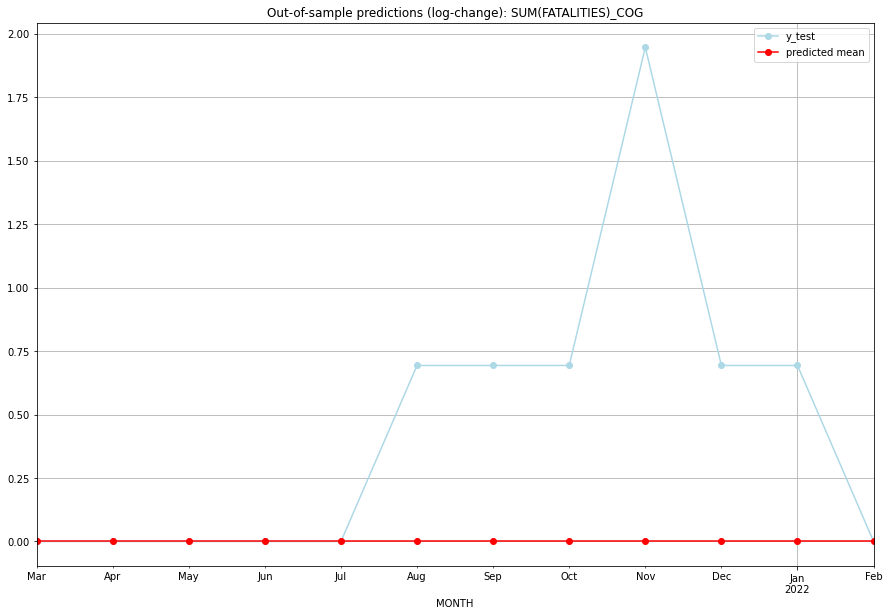

TADDA: 0.4509705043212533
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0        0.000000   COG   
1  2021-04-01       0.0         0.0           0.0        0.000000   COG   
2  2021-05-01       0.0         0.0           0.0        0.000000   COG   
3  2021-06-01       0.0         0.0           0.0        0.000000   COG   
4  2021-07-01       0.0         0.0           0.0        0.000000   COG   
5  2021-08-01       0.0         1.0           0.0        0.693147   COG   
6  2021-09-01       0.0         1.0           0.0        0.693147   COG   
7  2021-10-01       0.0         1.0           0.0        0.693147   COG   
8  2021-11-01       0.0         6.0           0.0        1.945910   COG   
9  2021-12-01       0.0         1.0           0.0        0.693147   COG   
10 2022-01-01       0.0         1.0           0.0        0.693147   COG   
11 2022-02-01       0.0         0.0           0.0    

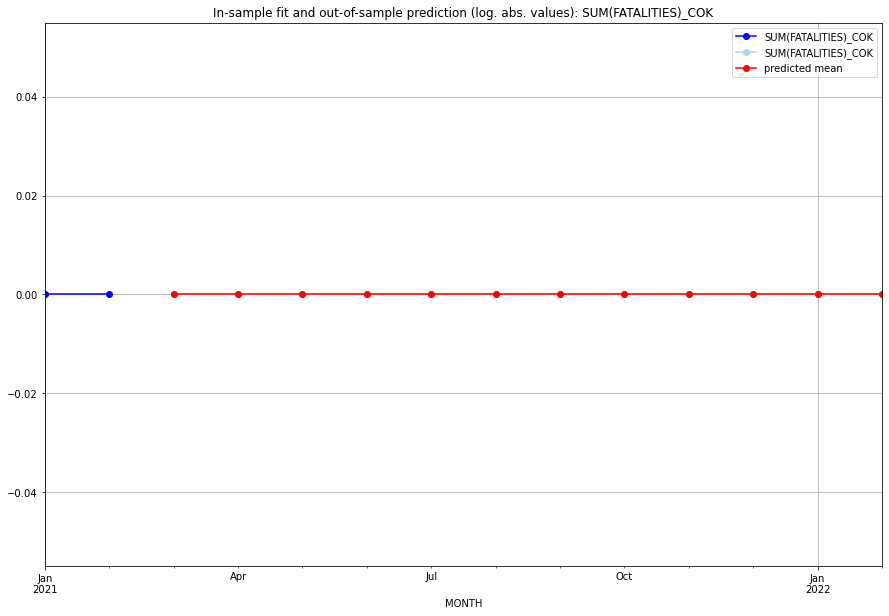

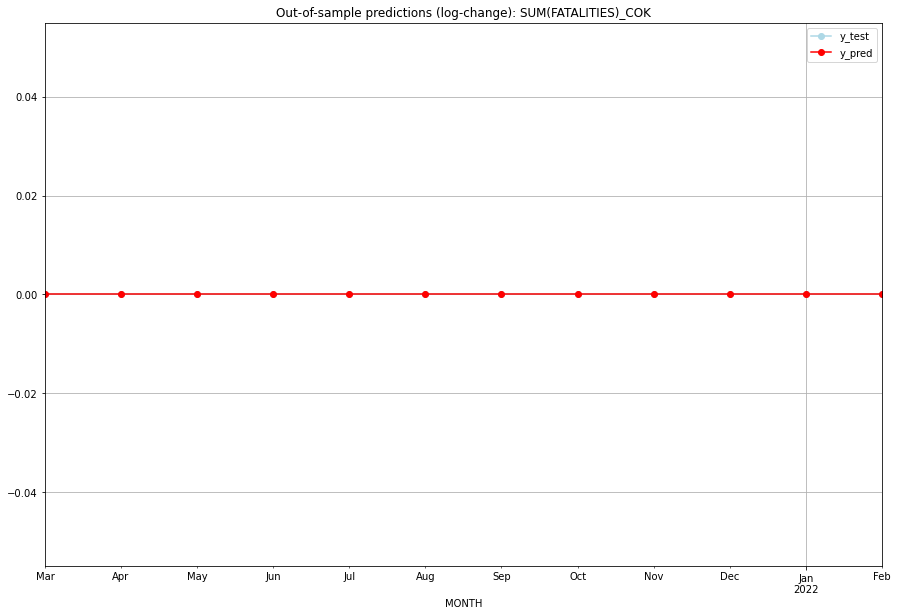

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   COK   
1  2021-04-01       0.0         0.0           0.0             0.0   COK   
2  2021-05-01       0.0         0.0           0.0             0.0   COK   
3  2021-06-01       0.0         0.0           0.0             0.0   COK   
4  2021-07-01       0.0         0.0           0.0             0.0   COK   
5  2021-08-01       0.0         0.0           0.0             0.0   COK   
6  2021-09-01       0.0         0.0           0.0             0.0   COK   
7  2021-10-01       0.0         0.0           0.0             0.0   COK   
8  2021-11-01       0.0         0.0           0.0             0.0   COK   
9  2021-12-01       0.0         0.0           0.0             0.0   COK   
10 2022-01-01       0.0         0.0           0.0             0.0   COK   
11 2022-02-01       0.0         0.0           0.0             0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (2, 1, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.24276848651910207, 'fold_results': [nan, 0.24276848651910207]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_COL   No. Observations:                   38
Model:                SARIMAX(2, 1, 3)   Log Likelihood                  -3.954
Date:                 Wed, 19 Oct 2022   AIC                             25.908
Time:                         10:35:43   BIC                             40.406
Sample:                     01-31-2018   HQIC                            31.019
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             0.0045      0.009      0.50

<Figure size 432x288 with 0 Axes>

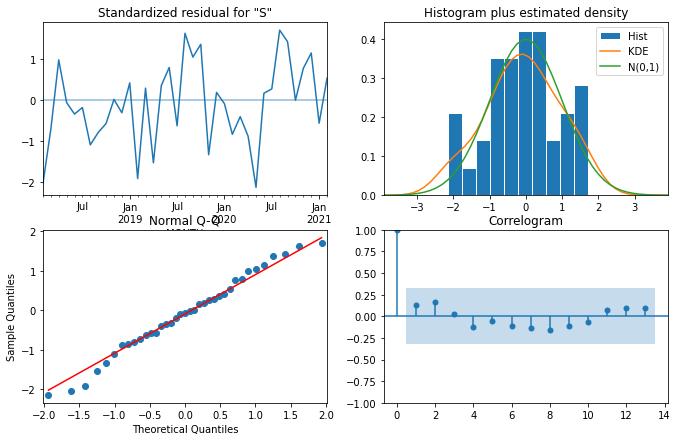

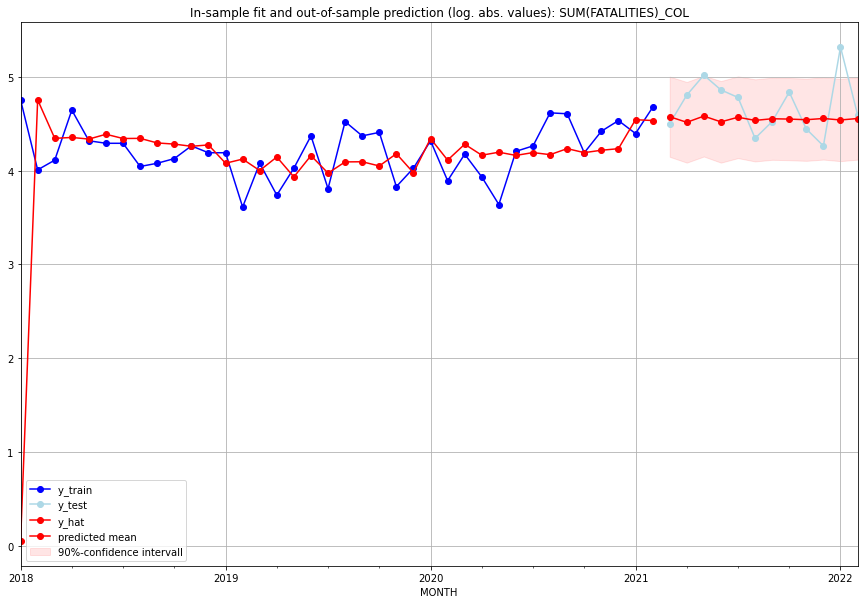

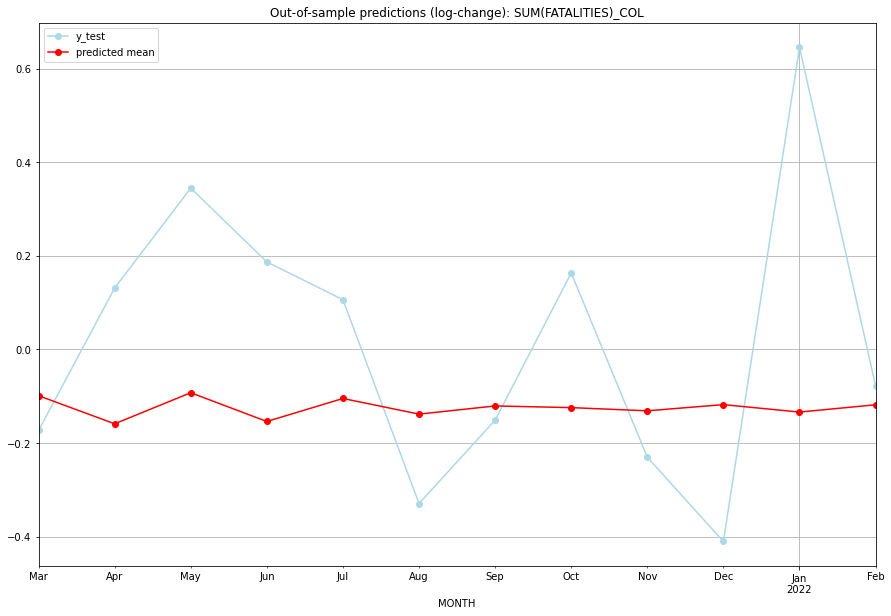

TADDA: 0.32004381008022564
Evaluation finished.
        MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  95.934065        89.0     -0.098798       -0.173019   COL   
1  2021-04-01  90.292206       121.0     -0.158763        0.131192   COL   
2  2021-05-01  96.553137       150.0     -0.092432        0.344451   COL   
3  2021-06-01  90.742562       128.0     -0.153842        0.186984   COL   
4  2021-07-01  95.364664       118.0     -0.104689        0.106295   COL   
5  2021-08-01  92.197569        76.0     -0.138107       -0.329023   COL   
6  2021-09-01  93.838047        91.0     -0.120658       -0.151040   COL   
7  2021-10-01  93.498203       125.0     -0.124248        0.163453   COL   
8  2021-11-01  92.858593        84.0     -0.131040       -0.230178   COL   
9  2021-12-01  94.107303        70.0     -0.117823       -0.410149   COL   
10 2022-01-01  92.606300       203.0     -0.133731        0.645291   COL   
11 2022-02-01  94.073959        98.0    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.011552453009332421, 'fold_results': [0.0, 0.0, 0.0, 0.0, 0.057762265046662105]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_COM   No. Observations:                  289
Model:                         SARIMAX   Log Likelihood                 514.648
Date:                 Wed, 19 Oct 2022   AIC                          -1027.295
Time:                         10:37:06   BIC                          -1023.629
Sample:                     02-28-1997   HQIC                         -1025.826
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.0017   1

<Figure size 432x288 with 0 Axes>

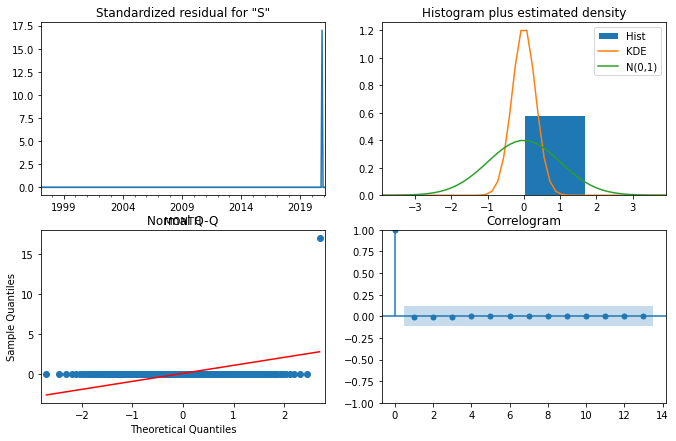

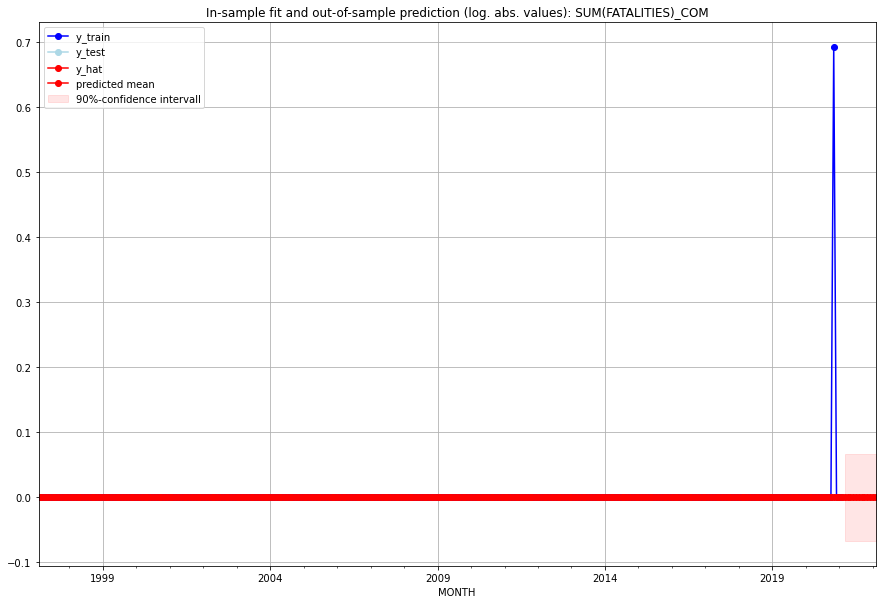

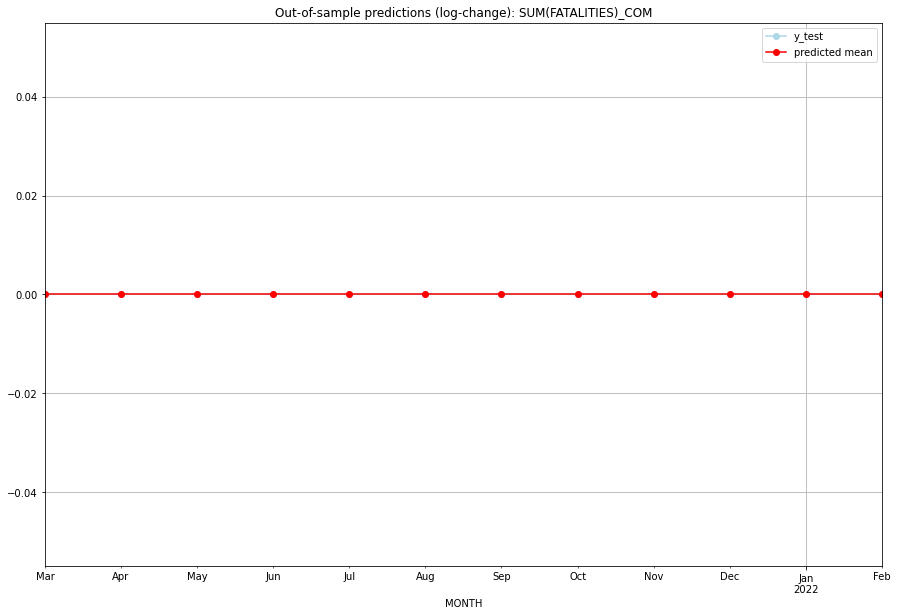

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   COM   
1  2021-04-01       0.0         0.0           0.0             0.0   COM   
2  2021-05-01       0.0         0.0           0.0             0.0   COM   
3  2021-06-01       0.0         0.0           0.0             0.0   COM   
4  2021-07-01       0.0         0.0           0.0             0.0   COM   
5  2021-08-01       0.0         0.0           0.0             0.0   COM   
6  2021-09-01       0.0         0.0           0.0             0.0   COM   
7  2021-10-01       0.0         0.0           0.0             0.0   COM   
8  2021-11-01       0.0         0.0           0.0             0.0   COM   
9  2021-12-01       0.0         0.0           0.0             0.0   COM   
10 2022-01-01       0.0         0.0           0.0             0.0   COM   
11 2022-02-01       0.0         0.0           0.0             0.0   

<Figure size 432x288 with 0 Axes>

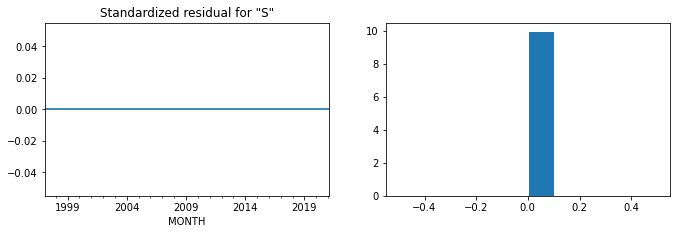

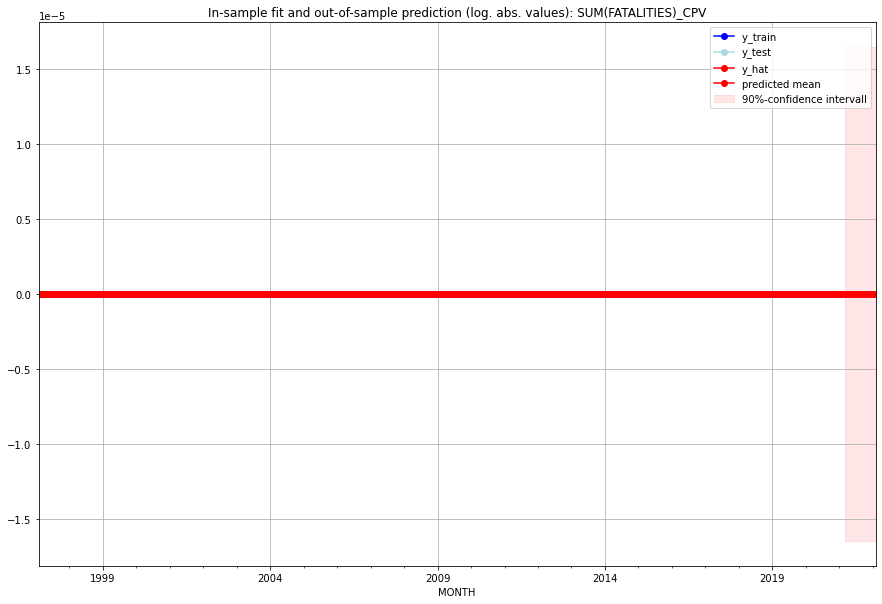

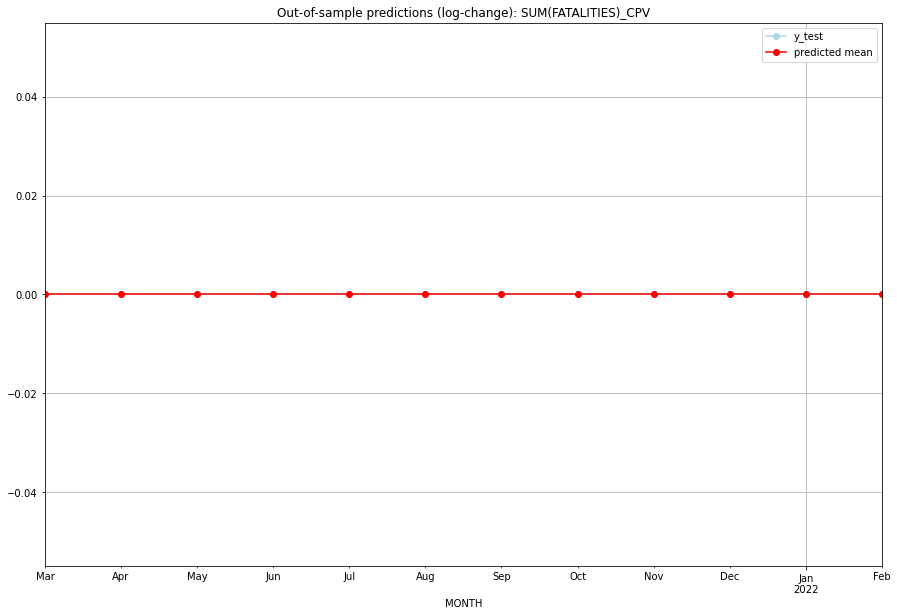

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   CPV   
1  2021-04-01       0.0         0.0           0.0             0.0   CPV   
2  2021-05-01       0.0         0.0           0.0             0.0   CPV   
3  2021-06-01       0.0         0.0           0.0             0.0   CPV   
4  2021-07-01       0.0         0.0           0.0             0.0   CPV   
5  2021-08-01       0.0         0.0           0.0             0.0   CPV   
6  2021-09-01       0.0         0.0           0.0             0.0   CPV   
7  2021-10-01       0.0         0.0           0.0             0.0   CPV   
8  2021-11-01       0.0         0.0           0.0             0.0   CPV   
9  2021-12-01       0.0         0.0           0.0             0.0   CPV   
10 2022-01-01       0.0         0.0           0.0             0.0   CPV   
11 2022-02-01       0.0         0.0           0.0             0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.37788167175655635, 'fold_results': [0.4479398673070138, 0.3078234762060989]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_CRI   No. Observations:                   38
Model:                SARIMAX(0, 0, 2)   Log Likelihood                 -28.980
Date:                 Wed, 19 Oct 2022   AIC                             63.960
Time:                         10:37:30   BIC                             68.873
Sample:                     01-31-2018   HQIC                            65.708
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ma.L1          0.1882      0

<Figure size 432x288 with 0 Axes>

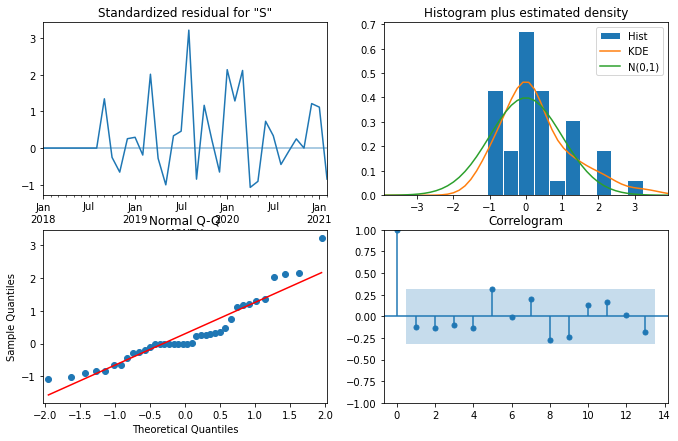

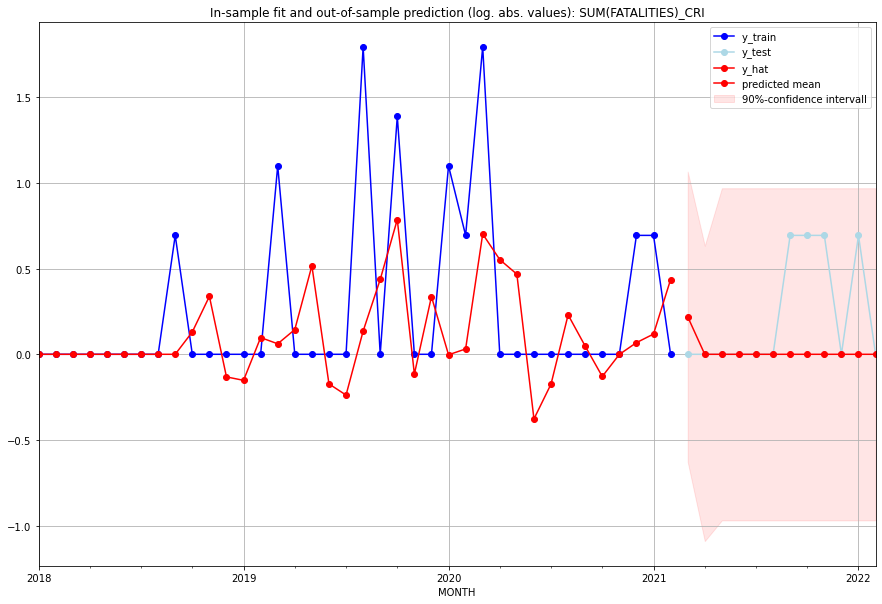

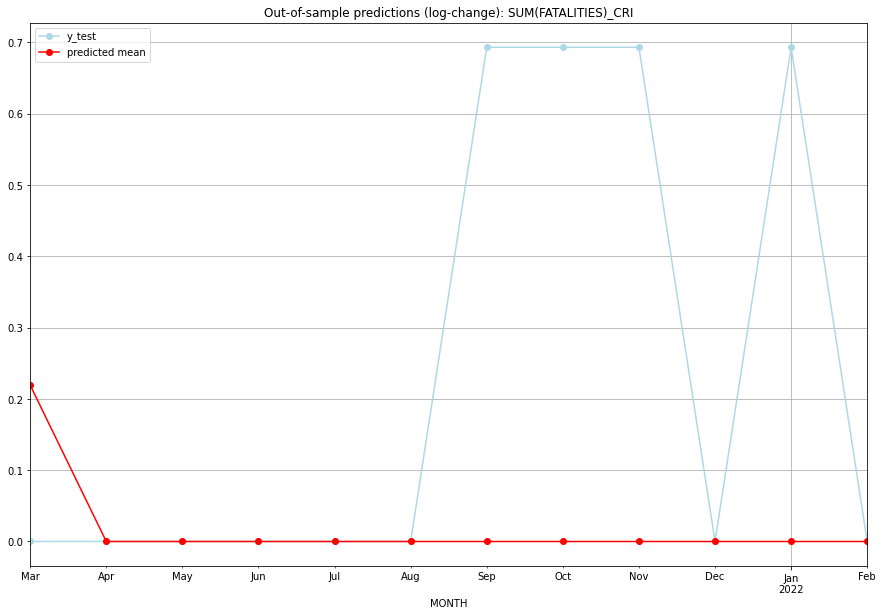

TADDA: 0.24931378754892342
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  0.245051         0.0      0.219177        0.000000   CRI   
1  2021-04-01  0.000000         0.0      0.000000        0.000000   CRI   
2  2021-05-01  0.000000         0.0      0.000000        0.000000   CRI   
3  2021-06-01  0.000000         0.0      0.000000        0.000000   CRI   
4  2021-07-01  0.000000         0.0      0.000000        0.000000   CRI   
5  2021-08-01  0.000000         0.0      0.000000        0.000000   CRI   
6  2021-09-01  0.000000         1.0      0.000000        0.693147   CRI   
7  2021-10-01  0.000000         1.0      0.000000        0.693147   CRI   
8  2021-11-01  0.000000         1.0      0.000000        0.693147   CRI   
9  2021-12-01  0.000000         0.0      0.000000        0.000000   CRI   
10 2022-01-01  0.000000         1.0      0.000000        0.693147   CRI   
11 2022-02-01  0.000000         0.0      0.000000   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.1613000421211621, 'fold_results': [0.11552453009332421, 0.20707555414900003]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_CUB   No. Observations:                   38
Model:                         SARIMAX   Log Likelihood                  -6.478
Date:                 Wed, 19 Oct 2022   AIC                             14.955
Time:                         10:37:45   BIC                             16.593
Sample:                     01-31-2018   HQIC                            15.538
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.0823      

<Figure size 432x288 with 0 Axes>

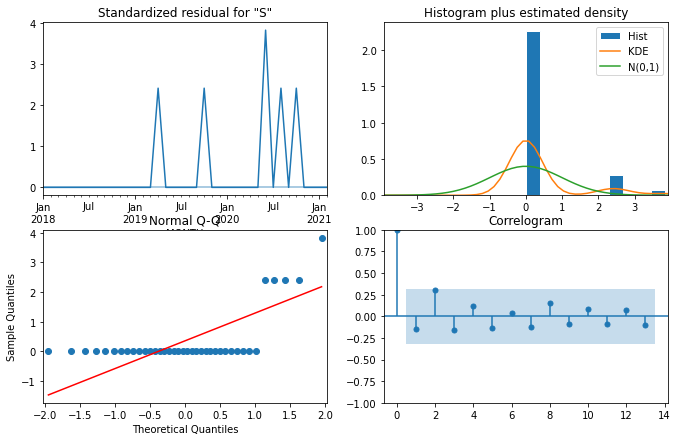

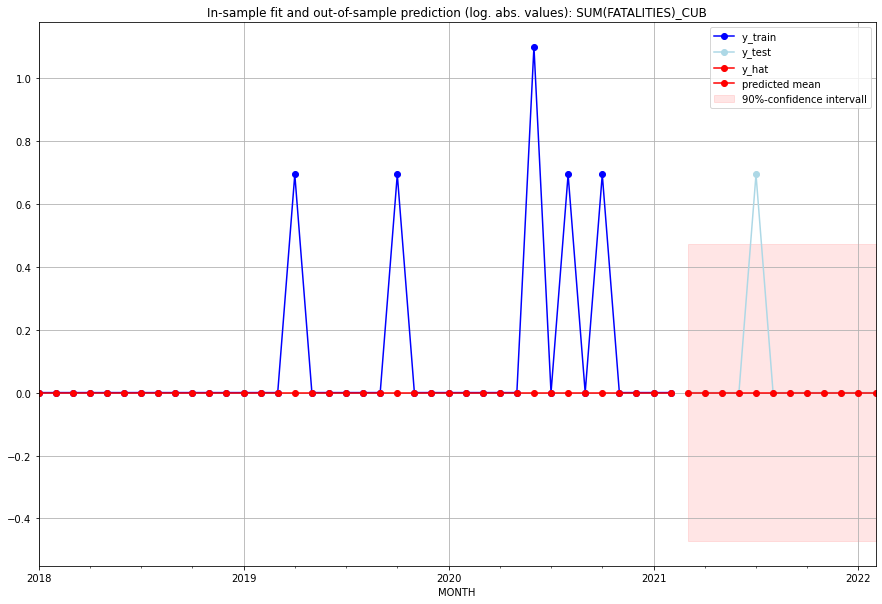

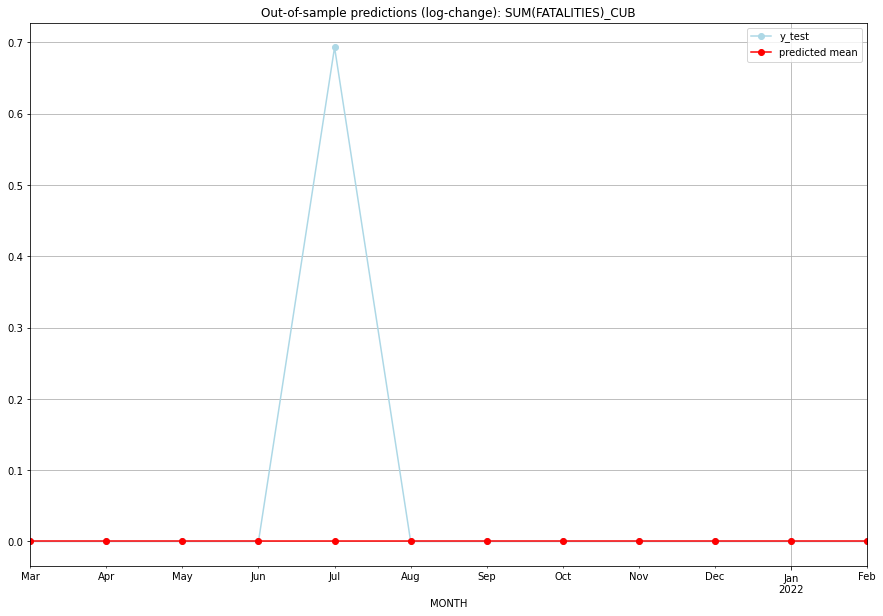

TADDA: 0.057762265046662105
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0        0.000000   CUB   
1  2021-04-01       0.0         0.0           0.0        0.000000   CUB   
2  2021-05-01       0.0         0.0           0.0        0.000000   CUB   
3  2021-06-01       0.0         0.0           0.0        0.000000   CUB   
4  2021-07-01       0.0         1.0           0.0        0.693147   CUB   
5  2021-08-01       0.0         0.0           0.0        0.000000   CUB   
6  2021-09-01       0.0         0.0           0.0        0.000000   CUB   
7  2021-10-01       0.0         0.0           0.0        0.000000   CUB   
8  2021-11-01       0.0         0.0           0.0        0.000000   CUB   
9  2021-12-01       0.0         0.0           0.0        0.000000   CUB   
10 2022-01-01       0.0         0.0           0.0        0.000000   CUB   
11 2022-02-01       0.0         0.0           0.0  

<Figure size 432x288 with 0 Axes>

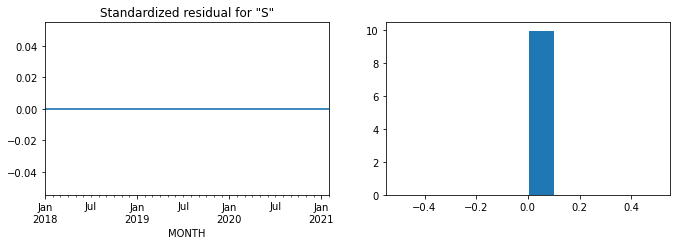

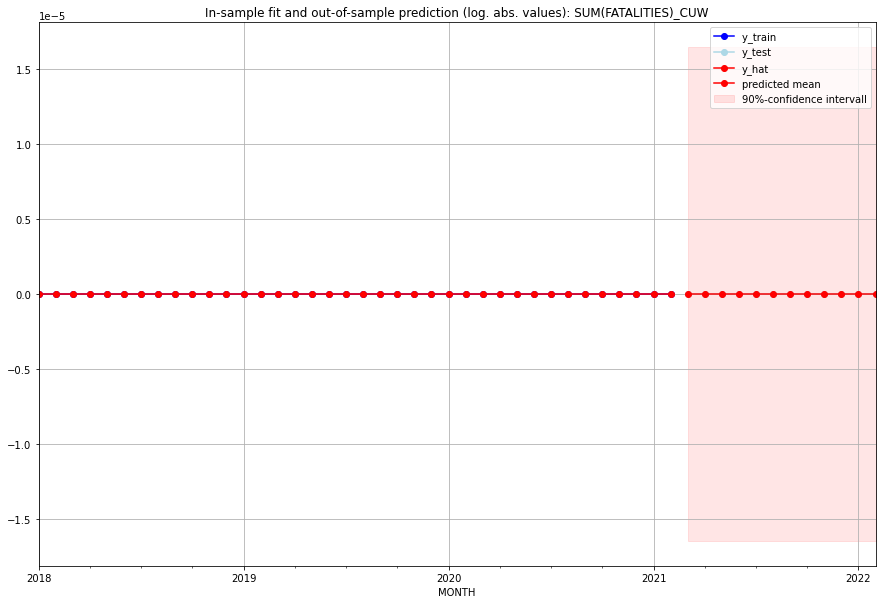

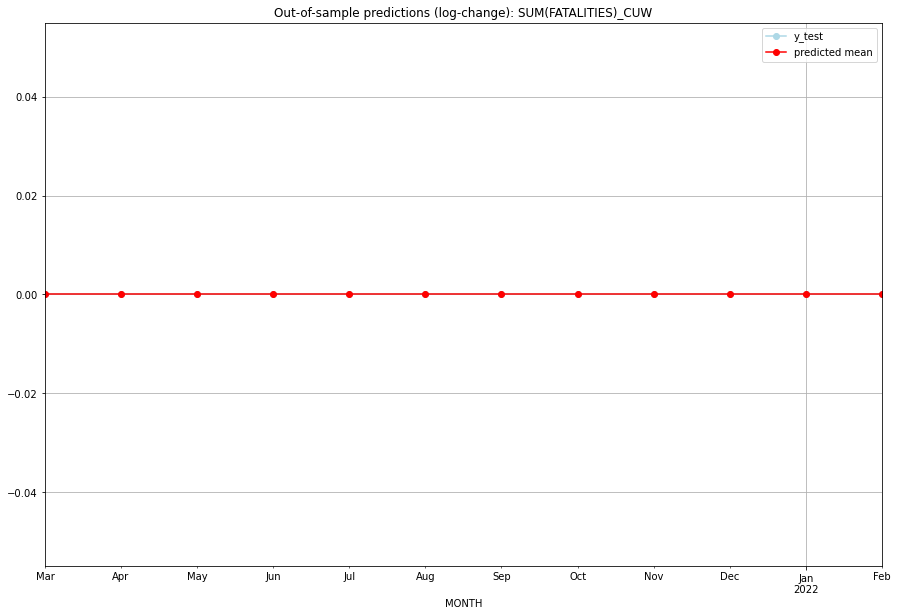

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   CUW   
1  2021-04-01       0.0         0.0           0.0             0.0   CUW   
2  2021-05-01       0.0         0.0           0.0             0.0   CUW   
3  2021-06-01       0.0         0.0           0.0             0.0   CUW   
4  2021-07-01       0.0         0.0           0.0             0.0   CUW   
5  2021-08-01       0.0         0.0           0.0             0.0   CUW   
6  2021-09-01       0.0         0.0           0.0             0.0   CUW   
7  2021-10-01       0.0         0.0           0.0             0.0   CUW   
8  2021-11-01       0.0         0.0           0.0             0.0   CUW   
9  2021-12-01       0.0         0.0           0.0             0.0   CUW   
10 2022-01-01       0.0         0.0           0.0             0.0   CUW   
11 2022-02-01       0.0         0.0           0.0             0.0   

<Figure size 432x288 with 0 Axes>

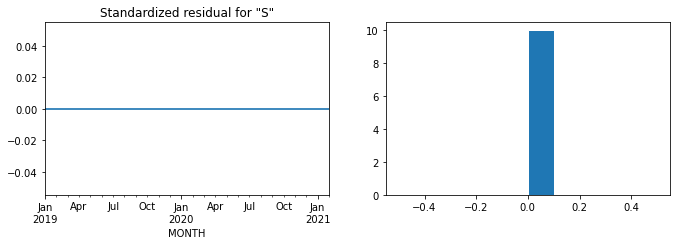

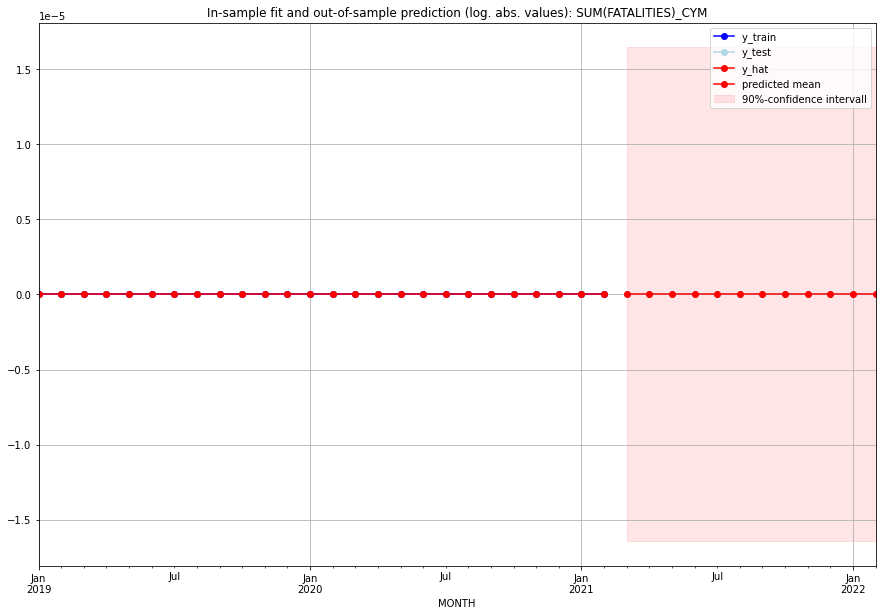

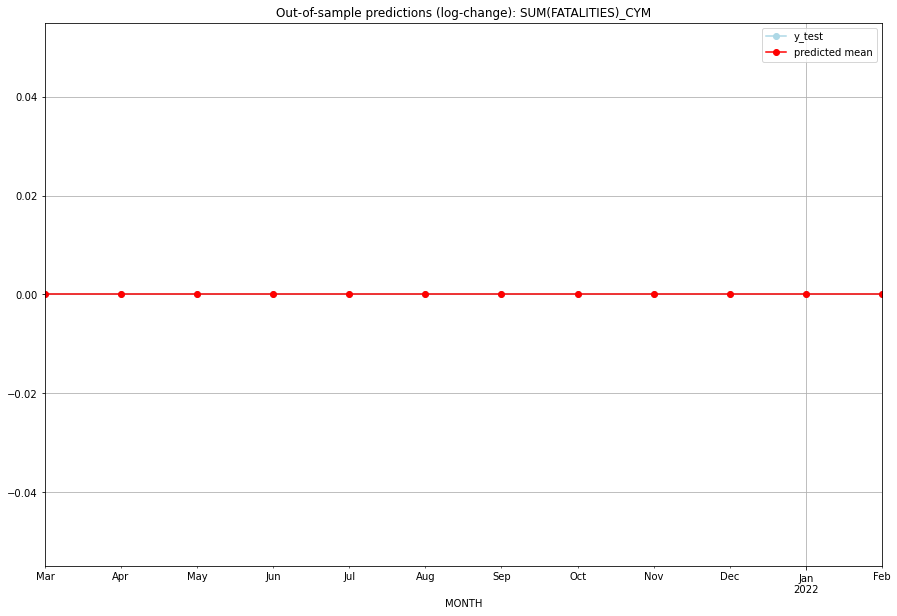

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   CYM   
1  2021-04-01       0.0         0.0           0.0             0.0   CYM   
2  2021-05-01       0.0         0.0           0.0             0.0   CYM   
3  2021-06-01       0.0         0.0           0.0             0.0   CYM   
4  2021-07-01       0.0         0.0           0.0             0.0   CYM   
5  2021-08-01       0.0         0.0           0.0             0.0   CYM   
6  2021-09-01       0.0         0.0           0.0             0.0   CYM   
7  2021-10-01       0.0         0.0           0.0             0.0   CYM   
8  2021-11-01       0.0         0.0           0.0             0.0   CYM   
9  2021-12-01       0.0         0.0           0.0             0.0   CYM   
10 2022-01-01       0.0         0.0           0.0             0.0   CYM   
11 2022-02-01       0.0         0.0           0.0             0.0   

<Figure size 432x288 with 0 Axes>

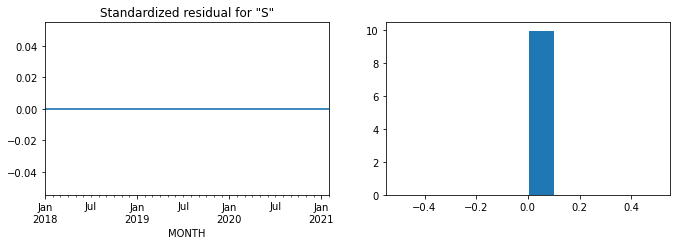

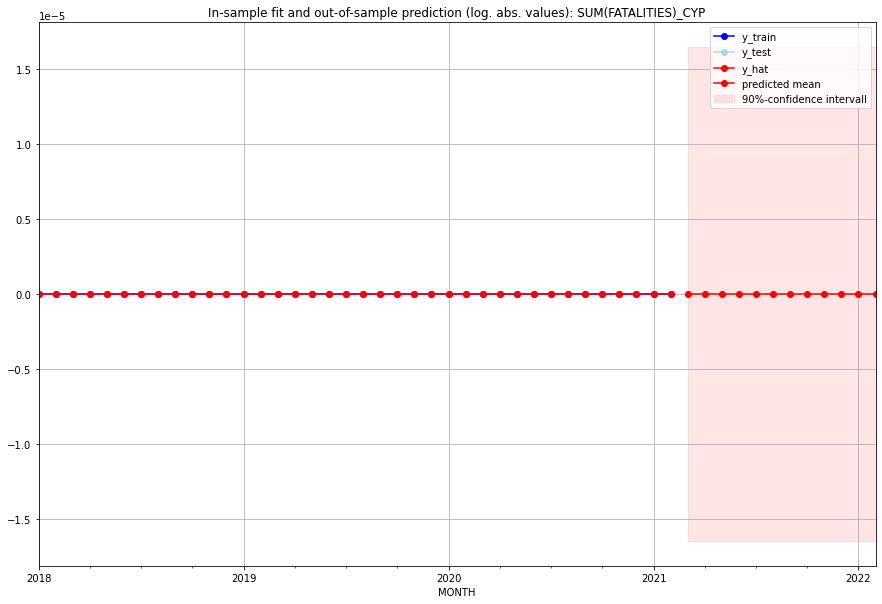

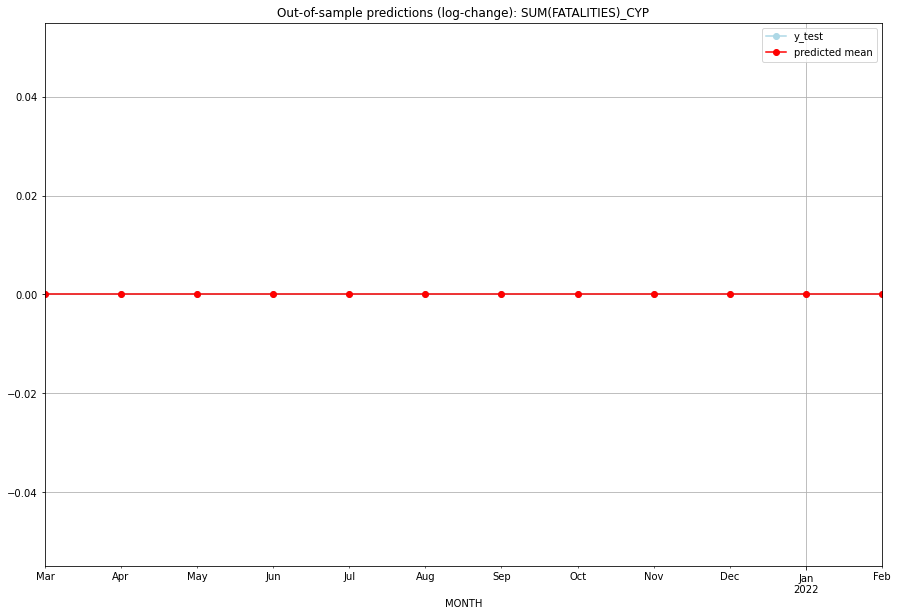

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   CYP   
1  2021-04-01       0.0         0.0           0.0             0.0   CYP   
2  2021-05-01       0.0         0.0           0.0             0.0   CYP   
3  2021-06-01       0.0         0.0           0.0             0.0   CYP   
4  2021-07-01       0.0         0.0           0.0             0.0   CYP   
5  2021-08-01       0.0         0.0           0.0             0.0   CYP   
6  2021-09-01       0.0         0.0           0.0             0.0   CYP   
7  2021-10-01       0.0         0.0           0.0             0.0   CYP   
8  2021-11-01       0.0         0.0           0.0             0.0   CYP   
9  2021-12-01       0.0         0.0           0.0             0.0   CYP   
10 2022-01-01       0.0         0.0           0.0             0.0   CYP   
11 2022-02-01       0.0         0.0           0.0             0.0   

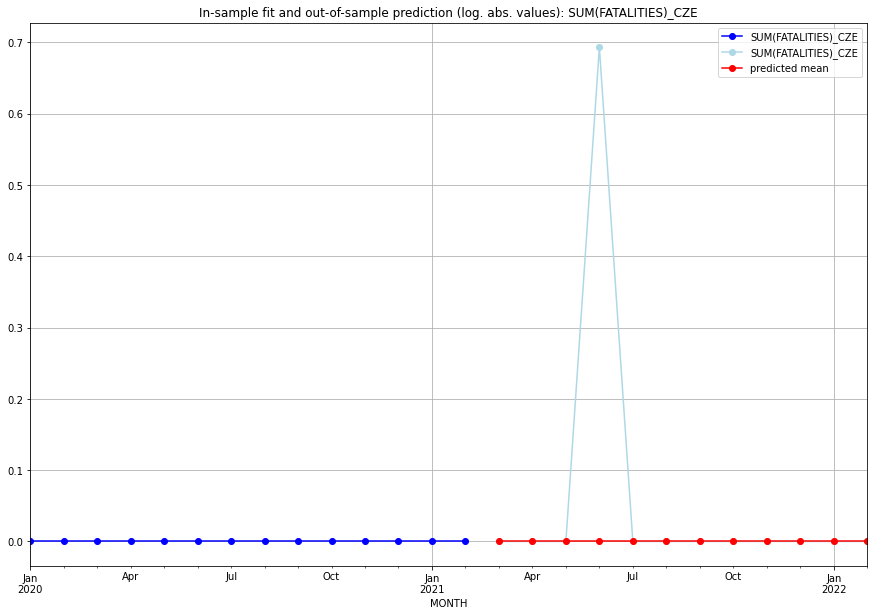

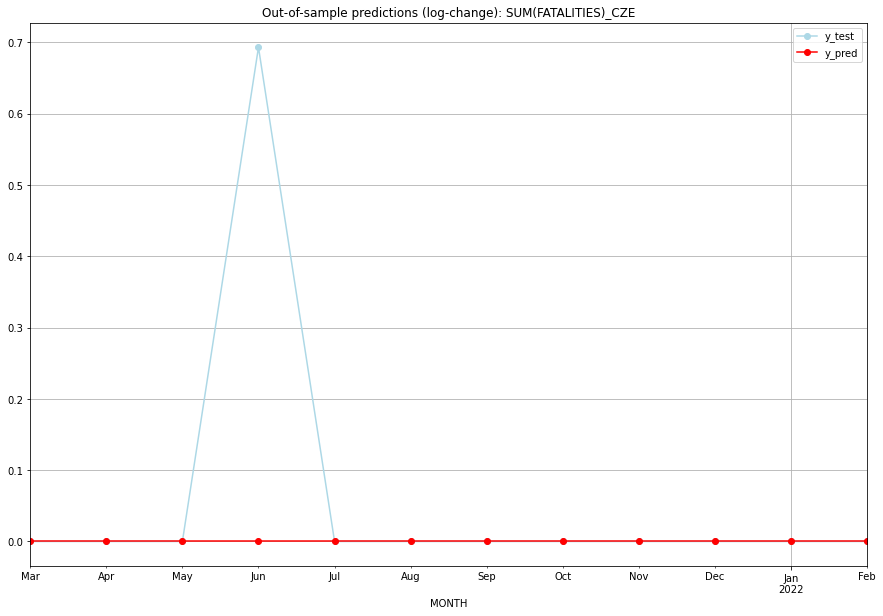

TADDA: 0.057762265046662105
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0    0.000000           0.0        0.000000   CZE   
1  2021-04-01       0.0    0.000000           0.0        0.000000   CZE   
2  2021-05-01       0.0    0.000000           0.0        0.000000   CZE   
3  2021-06-01       0.0    0.693147           0.0        0.693147   CZE   
4  2021-07-01       0.0    0.000000           0.0        0.000000   CZE   
5  2021-08-01       0.0    0.000000           0.0        0.000000   CZE   
6  2021-09-01       0.0    0.000000           0.0        0.000000   CZE   
7  2021-10-01       0.0    0.000000           0.0        0.000000   CZE   
8  2021-11-01       0.0    0.000000           0.0        0.000000   CZE   
9  2021-12-01       0.0    0.000000           0.0        0.000000   CZE   
10 2022-01-01       0.0    0.000000           0.0        0.000000   CZE   
11 2022-02-01       0.0    0.000000           0.0  

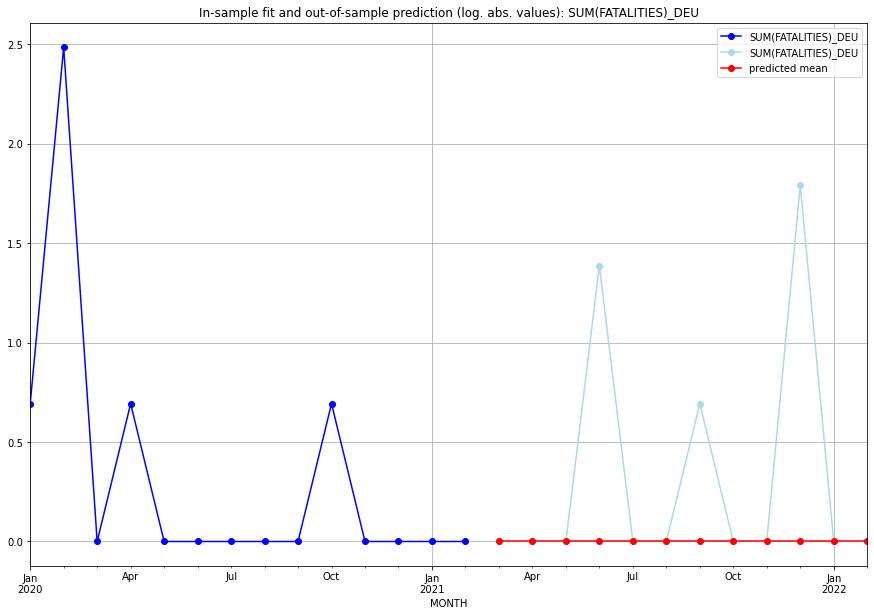

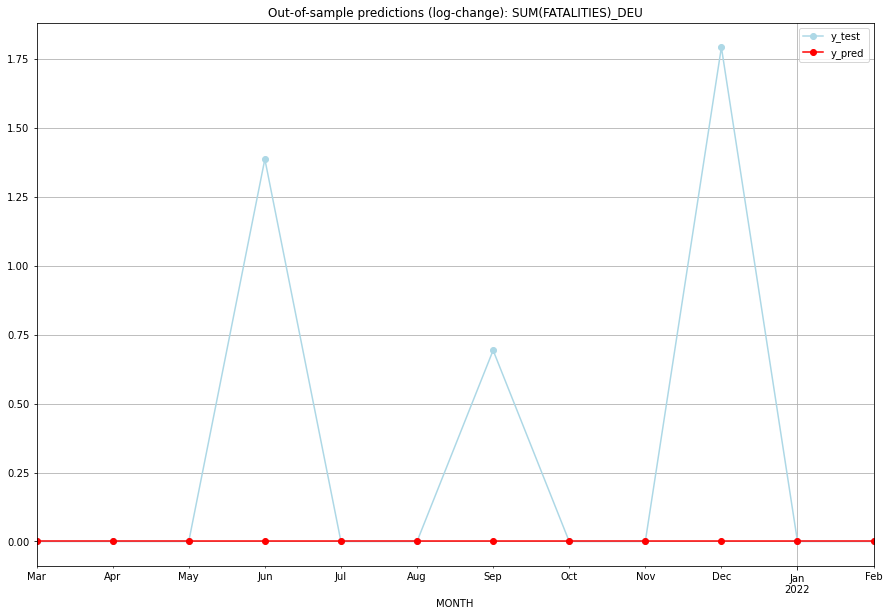

TADDA: 0.3226000842423242
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0    0.000000           0.0        0.000000   DEU   
1  2021-04-01       0.0    0.000000           0.0        0.000000   DEU   
2  2021-05-01       0.0    0.000000           0.0        0.000000   DEU   
3  2021-06-01       0.0    1.386294           0.0        1.386294   DEU   
4  2021-07-01       0.0    0.000000           0.0        0.000000   DEU   
5  2021-08-01       0.0    0.000000           0.0        0.000000   DEU   
6  2021-09-01       0.0    0.693147           0.0        0.693147   DEU   
7  2021-10-01       0.0    0.000000           0.0        0.000000   DEU   
8  2021-11-01       0.0    0.000000           0.0        0.000000   DEU   
9  2021-12-01       0.0    1.791759           0.0        1.791759   DEU   
10 2022-01-01       0.0    0.000000           0.0        0.000000   DEU   
11 2022-02-01       0.0    0.000000           0.0    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.052967563839132425, 'fold_results': [0.0, 0.0, 0.0, 0.17328679513998632, 0.09155102405567582]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_DJI   No. Observations:                  289
Model:                         SARIMAX   Log Likelihood                -147.220
Date:                 Wed, 19 Oct 2022   AIC                            296.439
Time:                         10:38:50   BIC                            300.106
Sample:                     02-28-1997   HQIC                           297.909
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2    

<Figure size 432x288 with 0 Axes>

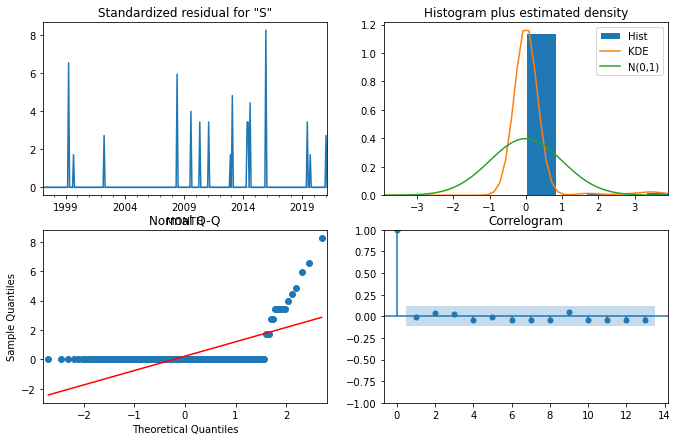

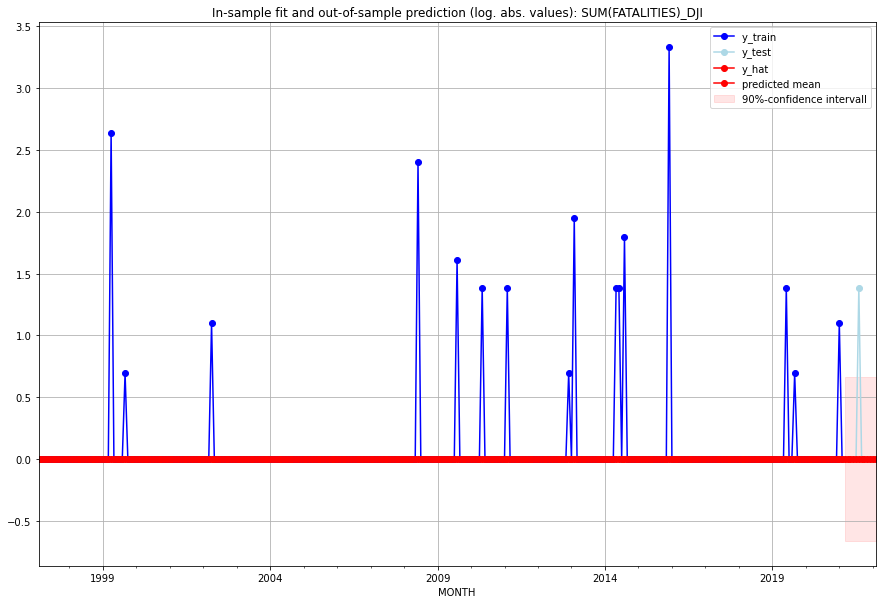

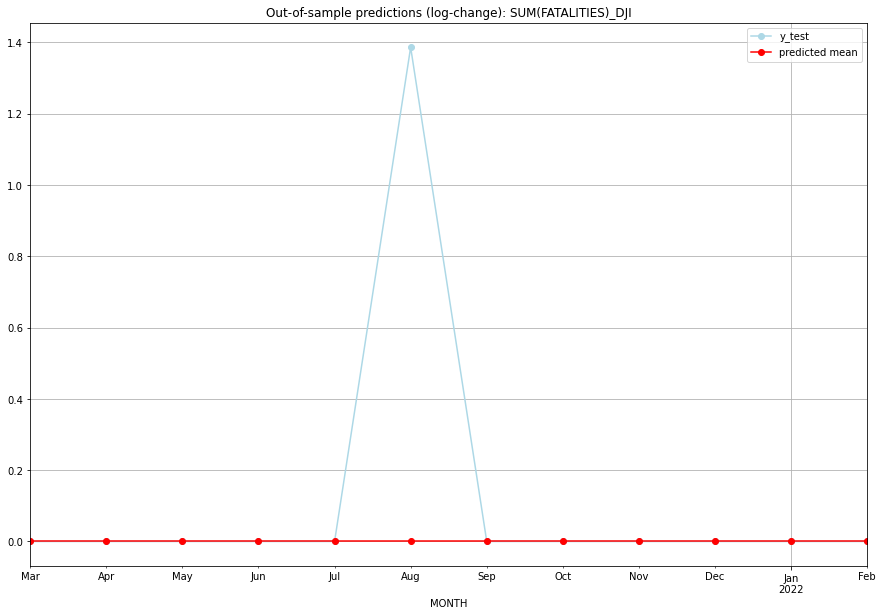

TADDA: 0.11552453009332421
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0        0.000000   DJI   
1  2021-04-01       0.0         0.0           0.0        0.000000   DJI   
2  2021-05-01       0.0         0.0           0.0        0.000000   DJI   
3  2021-06-01       0.0         0.0           0.0        0.000000   DJI   
4  2021-07-01       0.0         0.0           0.0        0.000000   DJI   
5  2021-08-01       0.0         3.0           0.0        1.386294   DJI   
6  2021-09-01       0.0         0.0           0.0        0.000000   DJI   
7  2021-10-01       0.0         0.0           0.0        0.000000   DJI   
8  2021-11-01       0.0         0.0           0.0        0.000000   DJI   
9  2021-12-01       0.0         0.0           0.0        0.000000   DJI   
10 2022-01-01       0.0         0.0           0.0        0.000000   DJI   
11 2022-02-01       0.0         0.0           0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [2, (0, 1, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.0, 'fold_results': [nan, 0.0]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_DMA   No. Observations:                   38
Model:                SARIMAX(0, 1, 3)   Log Likelihood                  27.748
Date:                 Wed, 19 Oct 2022   AIC                            -43.495
Time:                         10:39:06   BIC                            -33.830
Sample:                     01-31-2018   HQIC                           -40.088
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -0.0022      0.207     -0.011      0.992      -0.408       0

<Figure size 432x288 with 0 Axes>

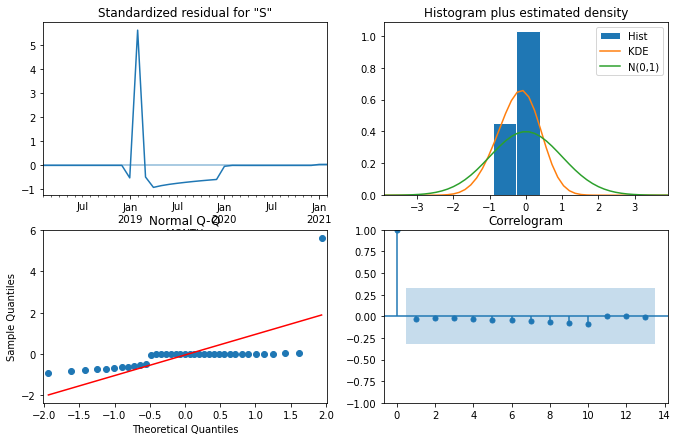

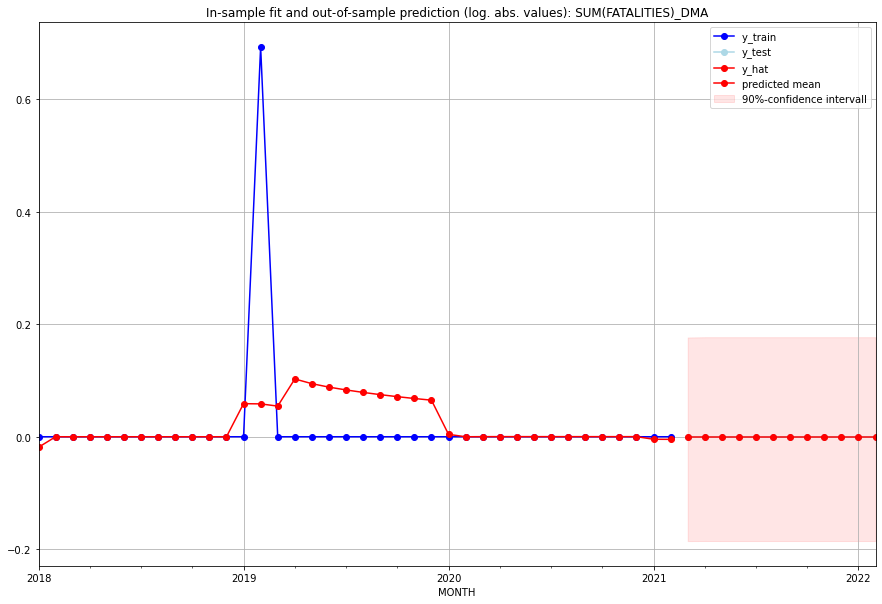

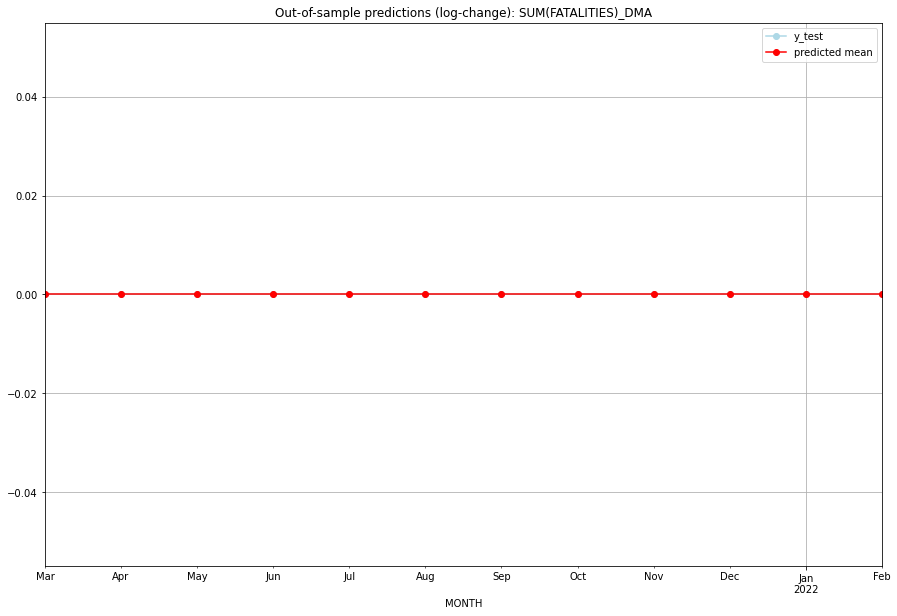

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   DMA   
1  2021-04-01       0.0         0.0           0.0             0.0   DMA   
2  2021-05-01       0.0         0.0           0.0             0.0   DMA   
3  2021-06-01       0.0         0.0           0.0             0.0   DMA   
4  2021-07-01       0.0         0.0           0.0             0.0   DMA   
5  2021-08-01       0.0         0.0           0.0             0.0   DMA   
6  2021-09-01       0.0         0.0           0.0             0.0   DMA   
7  2021-10-01       0.0         0.0           0.0             0.0   DMA   
8  2021-11-01       0.0         0.0           0.0             0.0   DMA   
9  2021-12-01       0.0         0.0           0.0             0.0   DMA   
10 2022-01-01       0.0         0.0           0.0             0.0   DMA   
11 2022-02-01       0.0         0.0           0.0             0.0   

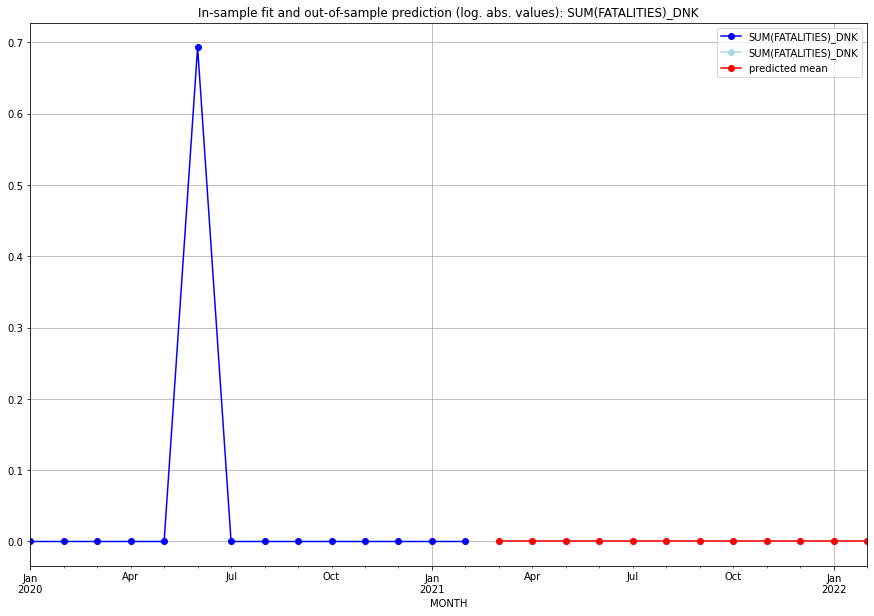

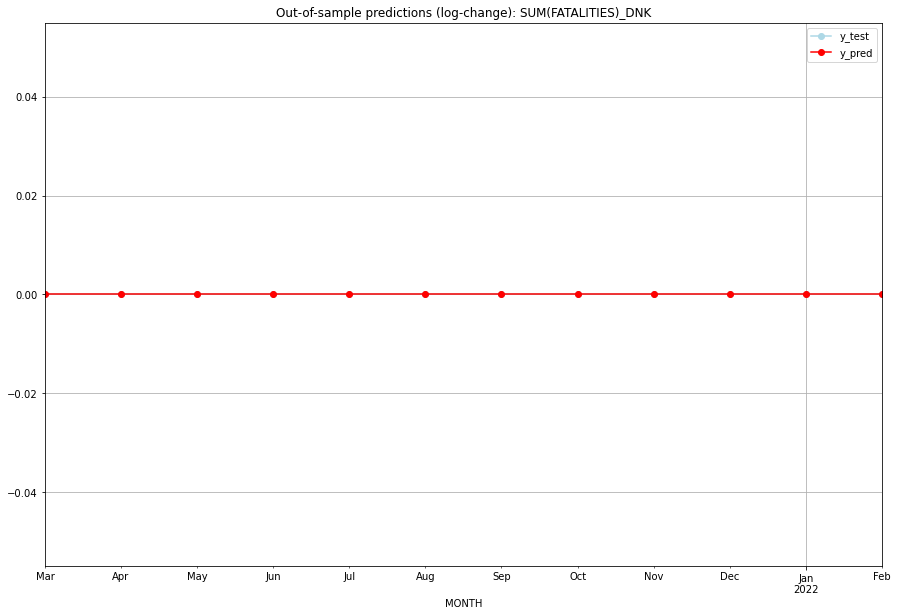

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   DNK   
1  2021-04-01       0.0         0.0           0.0             0.0   DNK   
2  2021-05-01       0.0         0.0           0.0             0.0   DNK   
3  2021-06-01       0.0         0.0           0.0             0.0   DNK   
4  2021-07-01       0.0         0.0           0.0             0.0   DNK   
5  2021-08-01       0.0         0.0           0.0             0.0   DNK   
6  2021-09-01       0.0         0.0           0.0             0.0   DNK   
7  2021-10-01       0.0         0.0           0.0             0.0   DNK   
8  2021-11-01       0.0         0.0           0.0             0.0   DNK   
9  2021-12-01       0.0         0.0           0.0             0.0   DNK   
10 2022-01-01       0.0         0.0           0.0             0.0   DNK   
11 2022-02-01       0.0         0.0           0.0             0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.45176765383628725, 'fold_results': [0.6975842234365132, 0.20595108423606137]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_DOM   No. Observations:                   38
Model:                SARIMAX(0, 0, 3)   Log Likelihood                 -36.674
Date:                 Wed, 19 Oct 2022   AIC                             81.348
Time:                         10:39:23   BIC                             87.899
Sample:                     01-31-2018   HQIC                            83.679
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ma.L1          0.1167      

<Figure size 432x288 with 0 Axes>

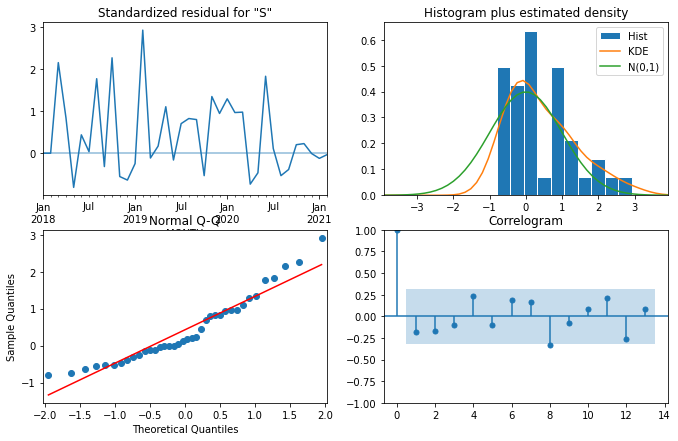

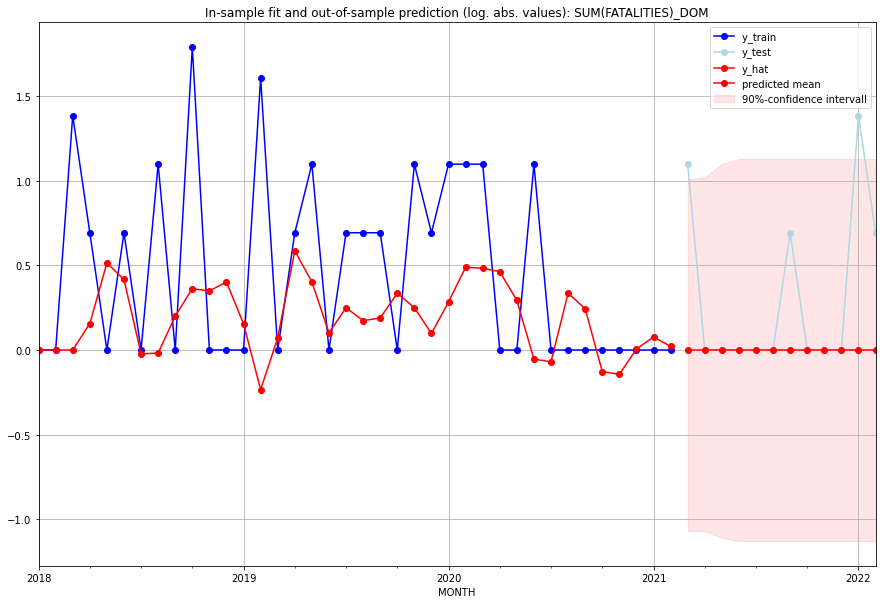

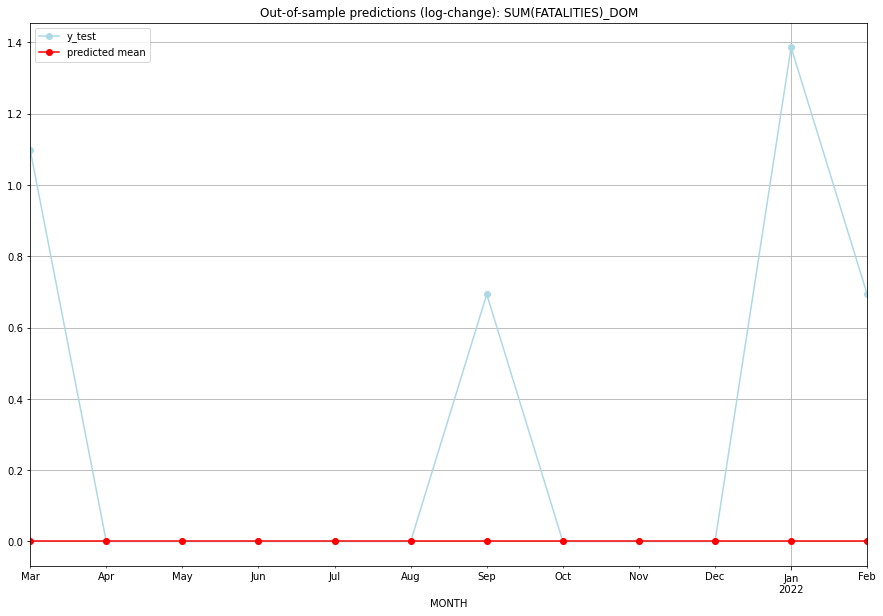

TADDA: 0.3226000842423242
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         2.0           0.0        1.098612   DOM   
1  2021-04-01       0.0         0.0           0.0        0.000000   DOM   
2  2021-05-01       0.0         0.0           0.0        0.000000   DOM   
3  2021-06-01       0.0         0.0           0.0        0.000000   DOM   
4  2021-07-01       0.0         0.0           0.0        0.000000   DOM   
5  2021-08-01       0.0         0.0           0.0        0.000000   DOM   
6  2021-09-01       0.0         1.0           0.0        0.693147   DOM   
7  2021-10-01       0.0         0.0           0.0        0.000000   DOM   
8  2021-11-01       0.0         0.0           0.0        0.000000   DOM   
9  2021-12-01       0.0         0.0           0.0        0.000000   DOM   
10 2022-01-01       0.0         3.0           0.0        1.386294   DOM   
11 2022-02-01       0.0         1.0           0.0    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.865377616869228, 'fold_results': [0.7774916339194852, 0.543278952545517, 1.2869044613109588, 1.0729586082894003, 0.6462544282807784]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_DZA   No. Observations:                  289
Model:                SARIMAX(0, 1, 0)   Log Likelihood                -496.609
Date:                 Wed, 19 Oct 2022   AIC                            995.218
Time:                         10:39:57   BIC                            998.881
Sample:                     02-28-1997   HQIC                           996.686
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------

<Figure size 432x288 with 0 Axes>

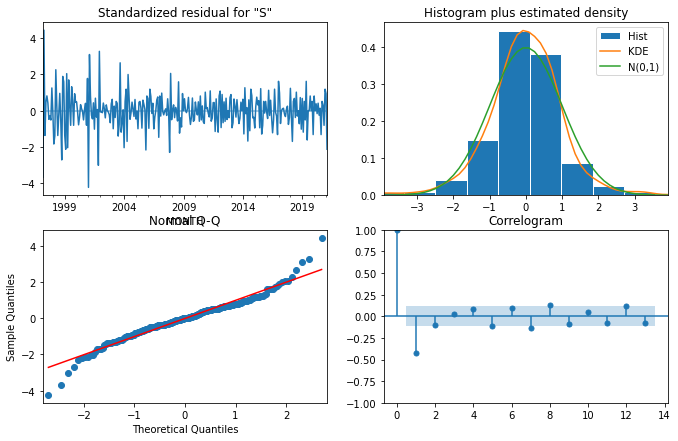

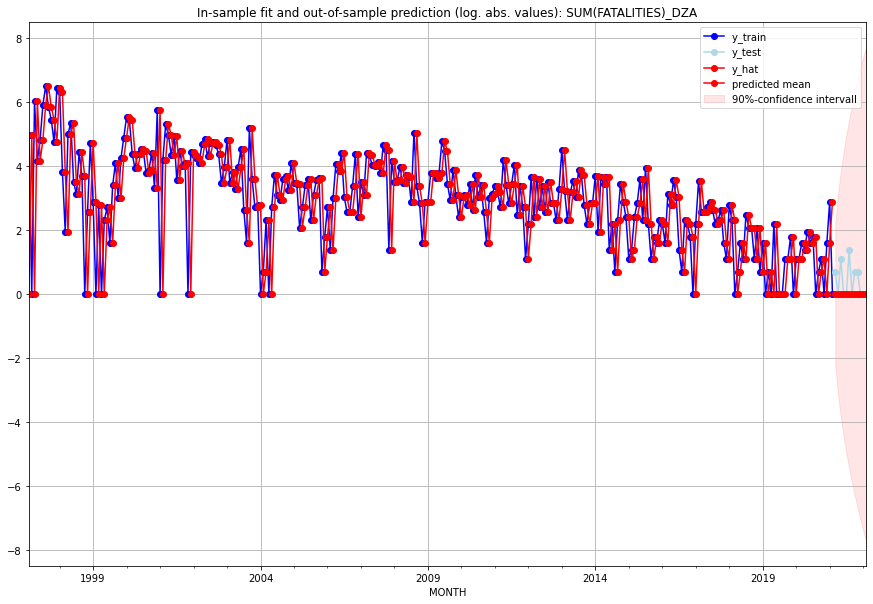

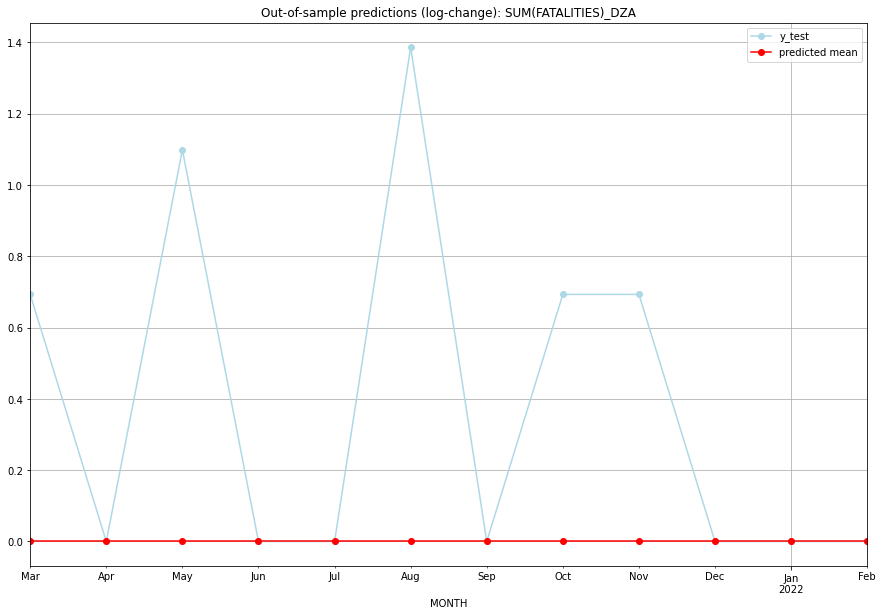

TADDA: 0.3803623492889863
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         1.0           0.0        0.693147   DZA   
1  2021-04-01       0.0         0.0           0.0        0.000000   DZA   
2  2021-05-01       0.0         2.0           0.0        1.098612   DZA   
3  2021-06-01       0.0         0.0           0.0        0.000000   DZA   
4  2021-07-01       0.0         0.0           0.0        0.000000   DZA   
5  2021-08-01       0.0         3.0           0.0        1.386294   DZA   
6  2021-09-01       0.0         0.0           0.0        0.000000   DZA   
7  2021-10-01       0.0         1.0           0.0        0.693147   DZA   
8  2021-11-01       0.0         1.0           0.0        0.693147   DZA   
9  2021-12-01       0.0         0.0           0.0        0.000000   DZA   
10 2022-01-01       0.0         0.0           0.0        0.000000   DZA   
11 2022-02-01       0.0         0.0           0.0    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (2, 1, 1), (0, 0, 0, 0), 'n'], 'cv_score': 0.5287054189036913, 'fold_results': [0.42151611556389734, 0.6358947222434851]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_ECU   No. Observations:                   38
Model:                SARIMAX(2, 1, 1)   Log Likelihood                 -41.996
Date:                 Wed, 19 Oct 2022   AIC                             91.992
Time:                         10:40:11   BIC                             98.435
Sample:                     01-31-2018   HQIC                            94.263
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.2175      0

<Figure size 432x288 with 0 Axes>

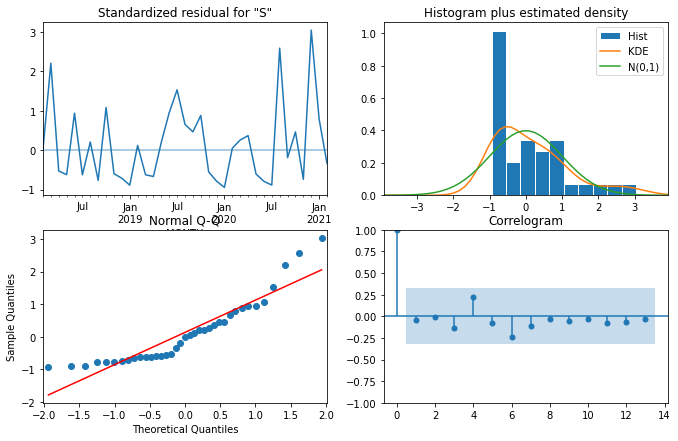

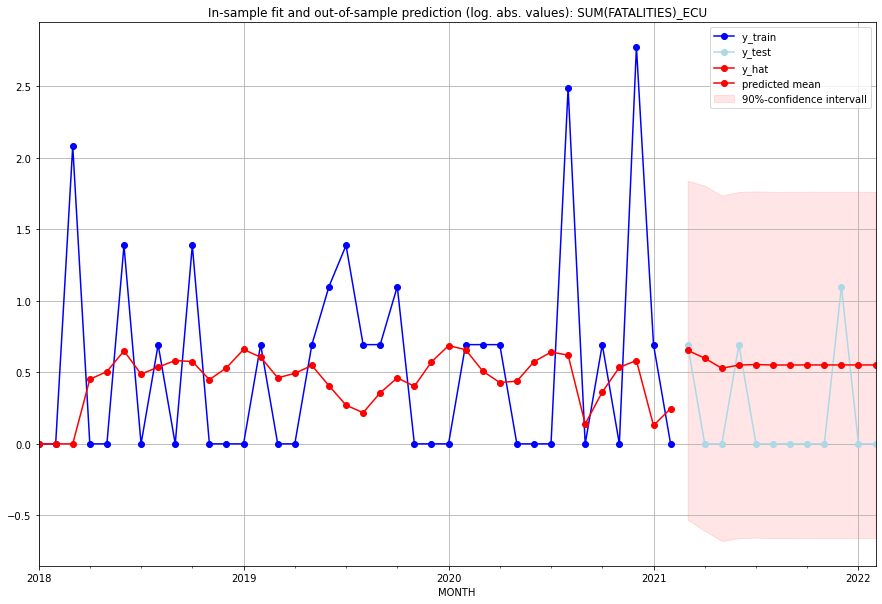

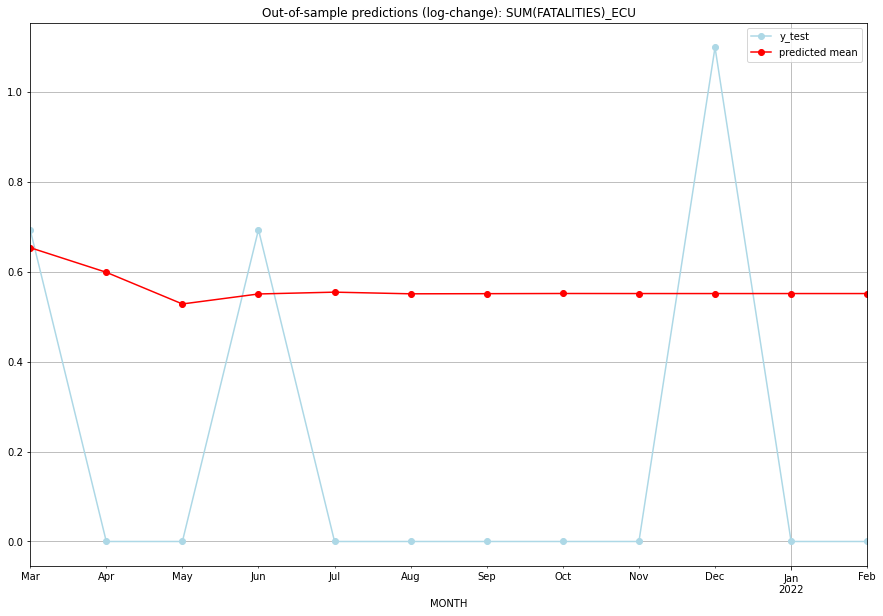

TADDA: 0.4764582854739356
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  0.921678         1.0      0.653199        0.693147   ECU   
1  2021-04-01  0.819319         0.0      0.598462        0.000000   ECU   
2  2021-05-01  0.695608         0.0      0.528041        0.000000   ECU   
3  2021-06-01  0.733704         1.0      0.550260        0.693147   ECU   
4  2021-07-01  0.740726         0.0      0.554302        0.000000   ECU   
5  2021-08-01  0.734332         0.0      0.550622        0.000000   ECU   
6  2021-09-01  0.734837         0.0      0.550913        0.000000   ECU   
7  2021-10-01  0.735532         0.0      0.551314        0.000000   ECU   
8  2021-11-01  0.735317         0.0      0.551190        0.000000   ECU   
9  2021-12-01  0.735276         2.0      0.551166        1.098612   ECU   
10 2022-01-01  0.735312         0.0      0.551187        0.000000   ECU   
11 2022-02-01  0.735309         0.0      0.551186    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (1, 0, 1), (0, 0, 0, 0), 'n'], 'cv_score': 0.4234620428517567, 'fold_results': [0.39745138925386286, 0.5489038162885591, 0.4964436198063513, 0.35628430667170946, 0.3182270822383006]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_EGY   No. Observations:                  289
Model:                SARIMAX(1, 0, 1)   Log Likelihood                -405.176
Date:                 Wed, 19 Oct 2022   AIC                            816.352
Time:                         10:40:46   BIC                            827.351
Sample:                     02-28-1997   HQIC                           820.759
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------

<Figure size 432x288 with 0 Axes>

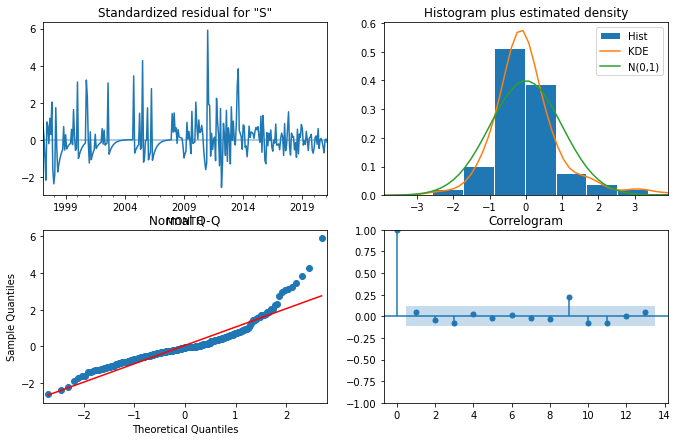

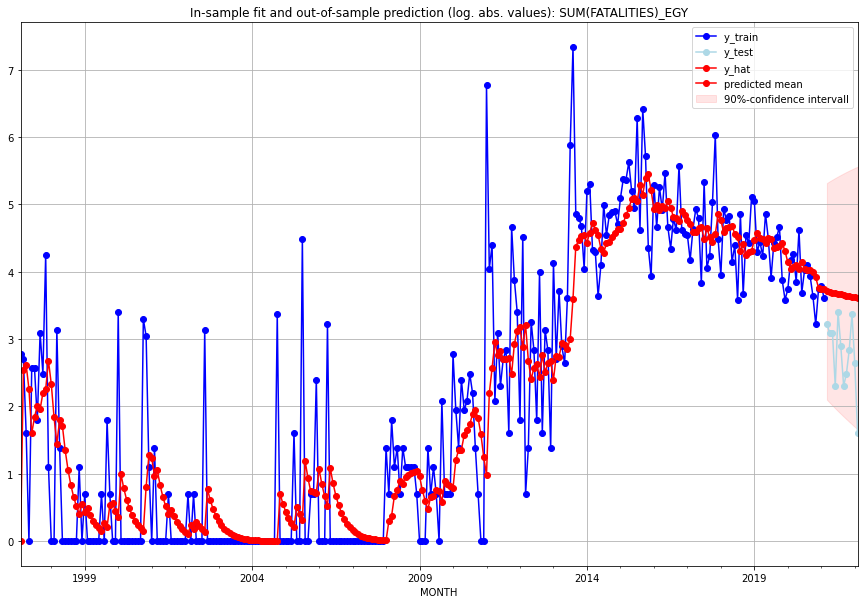

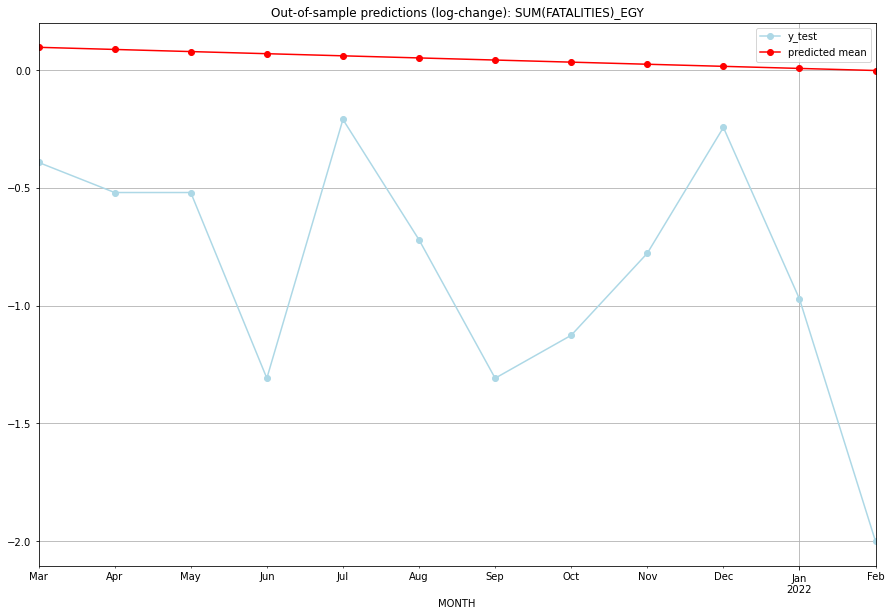

TADDA: 0.9361603234853941
Evaluation finished.
        MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  39.754228        24.0      0.096642       -0.392042   EGY   
1  2021-04-01  39.386507        21.0      0.087578       -0.519875   EGY   
2  2021-05-01  39.022991        21.0      0.078536       -0.519875   EGY   
3  2021-06-01  38.663623         9.0      0.069517       -1.308333   EGY   
4  2021-07-01  38.308349        29.0      0.060519       -0.209721   EGY   
5  2021-08-01  37.957115        17.0      0.051544       -0.720546   EGY   
6  2021-09-01  37.609866         9.0      0.042590       -1.308333   EGY   
7  2021-10-01  37.266549        11.0      0.033658       -1.126011   EGY   
8  2021-11-01  36.927114        16.0      0.024748       -0.777705   EGY   
9  2021-12-01  36.591508        28.0      0.015860       -0.243622   EGY   
10 2022-01-01  36.259682        13.0      0.006994       -0.971861   EGY   
11 2022-02-01  35.931585         4.0     

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.2314252353088817, 'fold_results': [0.8922883573487465, 0.057762265046662105, 0.1493132891023379, 0.0, 0.057762265046662105]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_ERI   No. Observations:                  289
Model:                         SARIMAX   Log Likelihood                -551.707
Date:                 Wed, 19 Oct 2022   AIC                           1105.415
Time:                         10:41:23   BIC                           1109.081
Sample:                     02-28-1997   HQIC                          1106.884
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------

<Figure size 432x288 with 0 Axes>

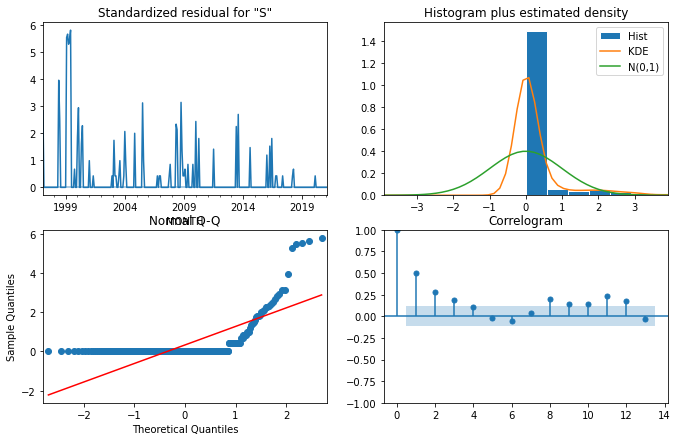

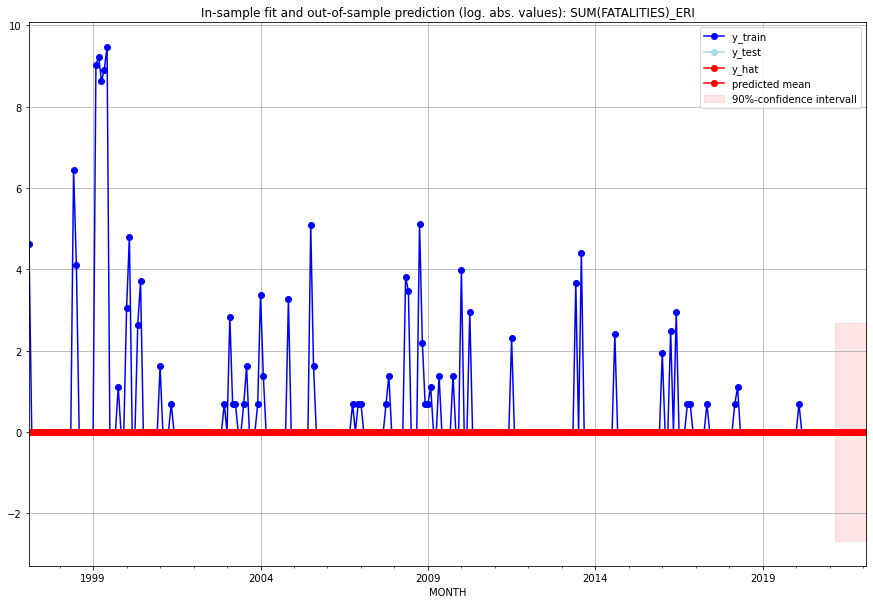

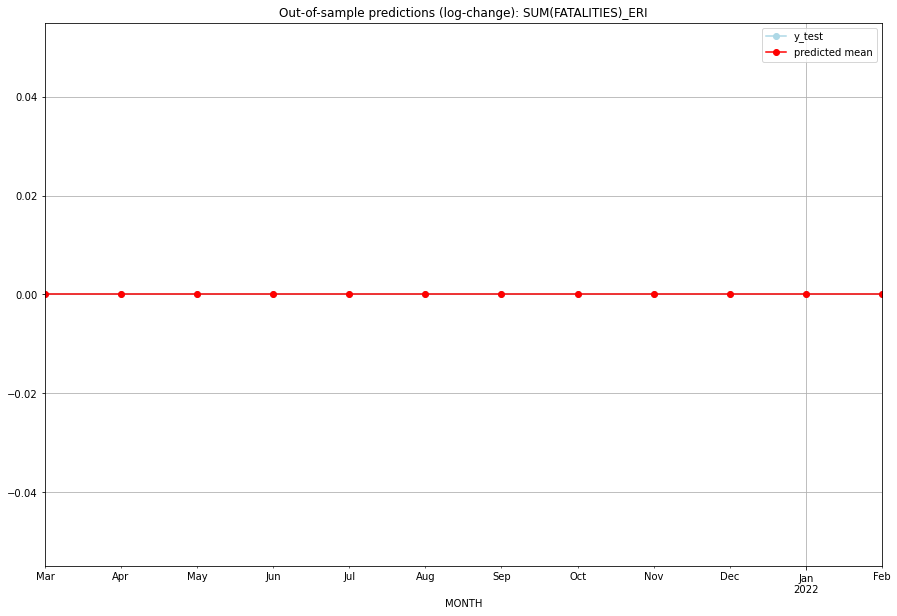

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   ERI   
1  2021-04-01       0.0         0.0           0.0             0.0   ERI   
2  2021-05-01       0.0         0.0           0.0             0.0   ERI   
3  2021-06-01       0.0         0.0           0.0             0.0   ERI   
4  2021-07-01       0.0         0.0           0.0             0.0   ERI   
5  2021-08-01       0.0         0.0           0.0             0.0   ERI   
6  2021-09-01       0.0         0.0           0.0             0.0   ERI   
7  2021-10-01       0.0         0.0           0.0             0.0   ERI   
8  2021-11-01       0.0         0.0           0.0             0.0   ERI   
9  2021-12-01       0.0         0.0           0.0             0.0   ERI   
10 2022-01-01       0.0         0.0           0.0             0.0   ERI   
11 2022-02-01       0.0         0.0           0.0             0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.09917737587646211, 'fold_results': [0.17328679513998632, 0.0, 0.0, 0.1493132891023379, 0.17328679513998632]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_ESH   No. Observations:                  289
Model:                         SARIMAX   Log Likelihood                 -66.106
Date:                 Wed, 19 Oct 2022   AIC                            134.211
Time:                         10:41:45   BIC                            137.878
Sample:                     02-28-1997   HQIC                           135.680
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------------------

<Figure size 432x288 with 0 Axes>

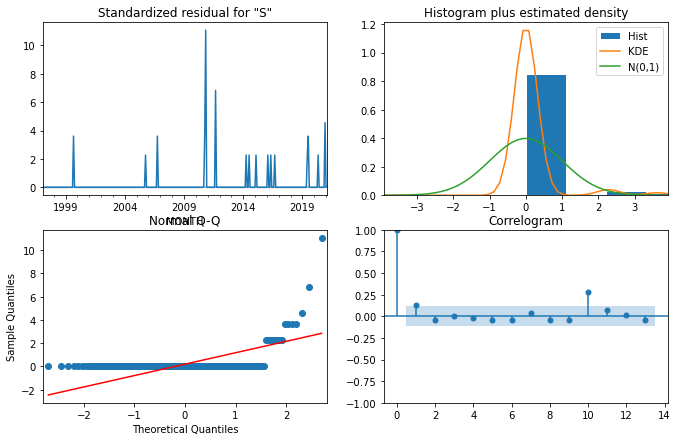

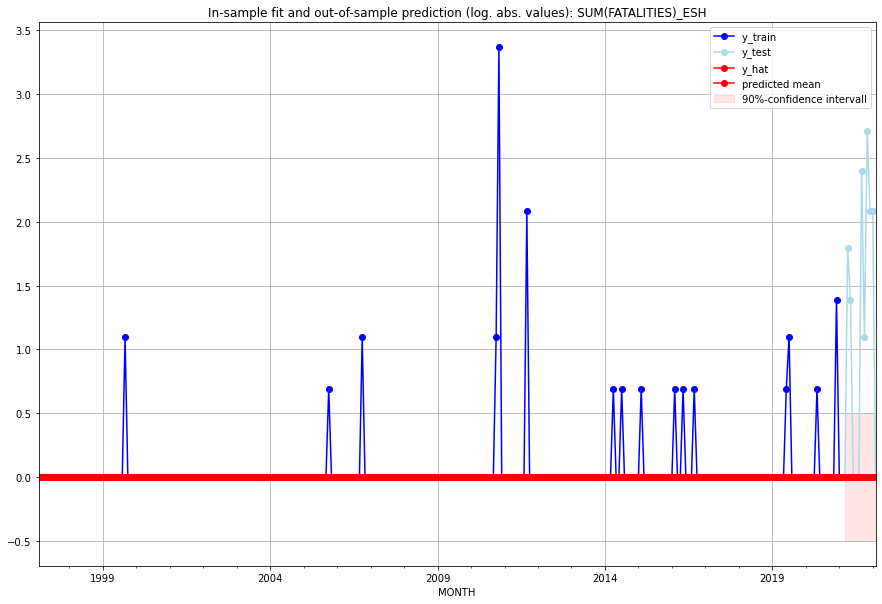

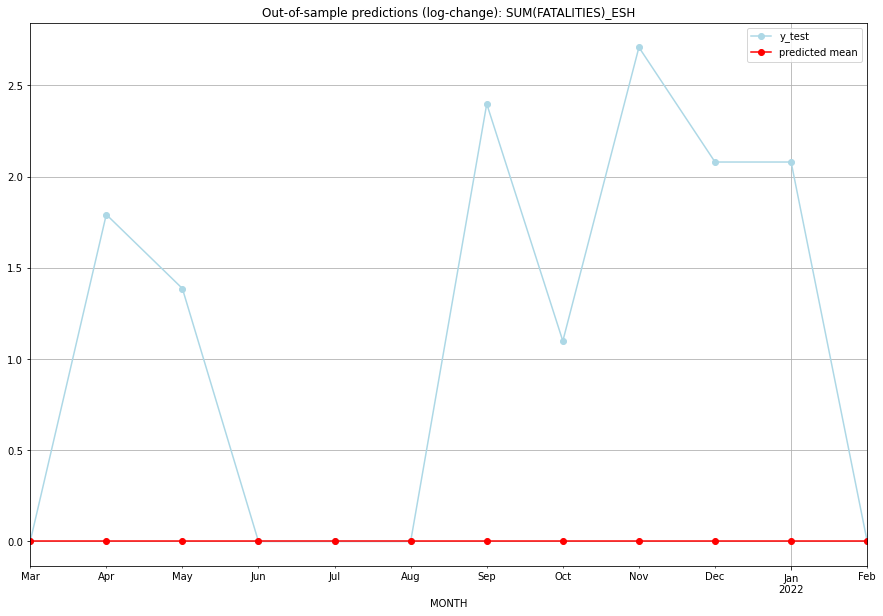

TADDA: 1.1284578896896924
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0        0.000000   ESH   
1  2021-04-01       0.0         5.0           0.0        1.791759   ESH   
2  2021-05-01       0.0         3.0           0.0        1.386294   ESH   
3  2021-06-01       0.0         0.0           0.0        0.000000   ESH   
4  2021-07-01       0.0         0.0           0.0        0.000000   ESH   
5  2021-08-01       0.0         0.0           0.0        0.000000   ESH   
6  2021-09-01       0.0        10.0           0.0        2.397895   ESH   
7  2021-10-01       0.0         2.0           0.0        1.098612   ESH   
8  2021-11-01       0.0        14.0           0.0        2.708050   ESH   
9  2021-12-01       0.0         7.0           0.0        2.079442   ESH   
10 2022-01-01       0.0         7.0           0.0        2.079442   ESH   
11 2022-02-01       0.0         0.0           0.0    

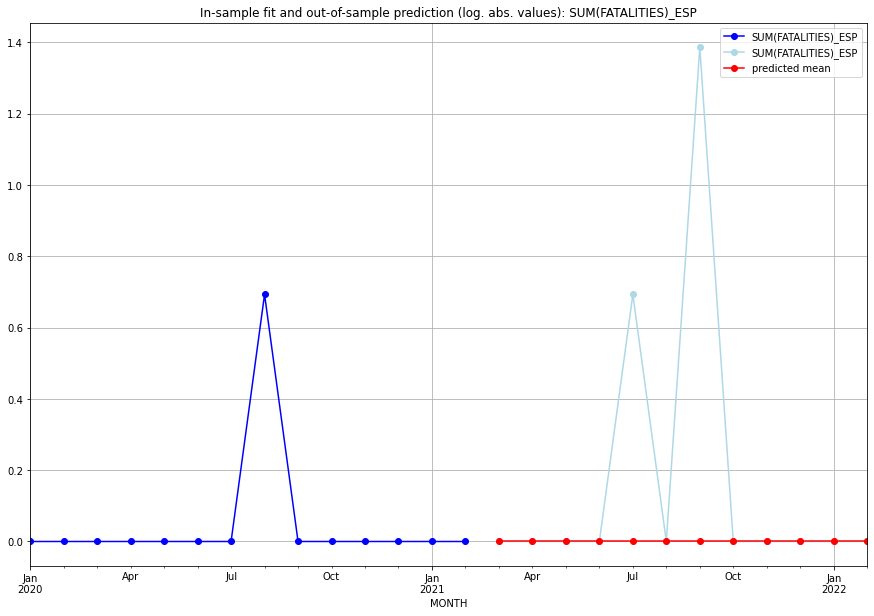

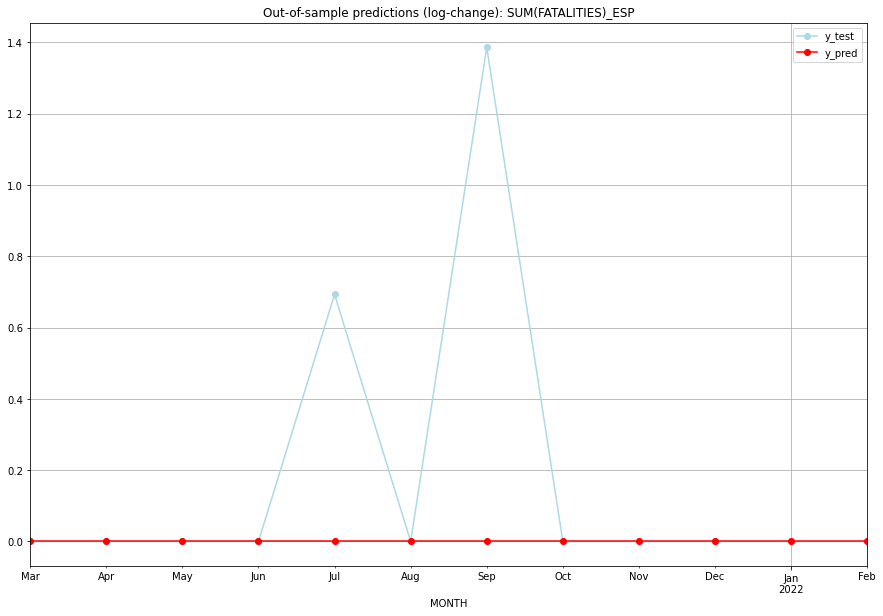

TADDA: 0.17328679513998632
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0    0.000000           0.0        0.000000   ESP   
1  2021-04-01       0.0    0.000000           0.0        0.000000   ESP   
2  2021-05-01       0.0    0.000000           0.0        0.000000   ESP   
3  2021-06-01       0.0    0.000000           0.0        0.000000   ESP   
4  2021-07-01       0.0    0.693147           0.0        0.693147   ESP   
5  2021-08-01       0.0    0.000000           0.0        0.000000   ESP   
6  2021-09-01       0.0    1.386294           0.0        1.386294   ESP   
7  2021-10-01       0.0    0.000000           0.0        0.000000   ESP   
8  2021-11-01       0.0    0.000000           0.0        0.000000   ESP   
9  2021-12-01       0.0    0.000000           0.0        0.000000   ESP   
10 2022-01-01       0.0    0.000000           0.0        0.000000   ESP   
11 2022-02-01       0.0    0.000000           0.0   

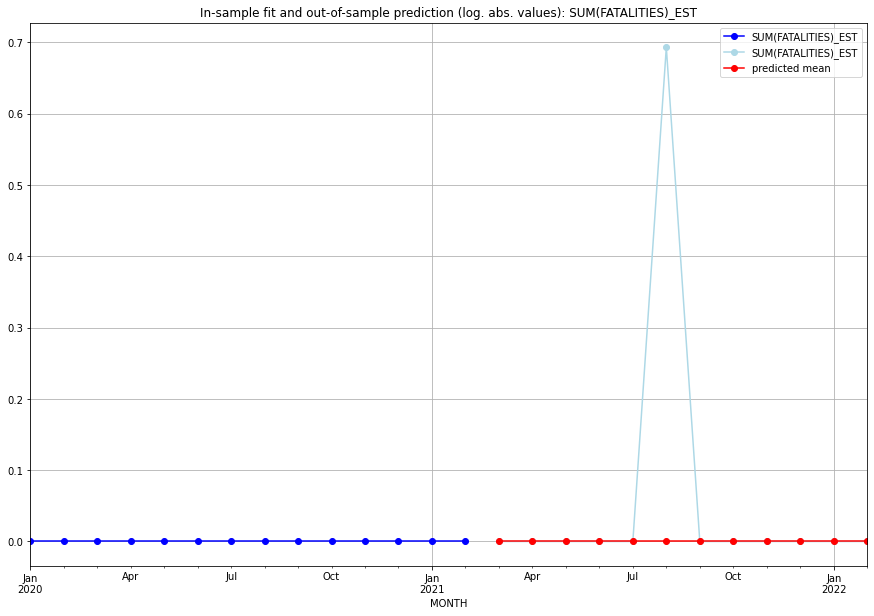

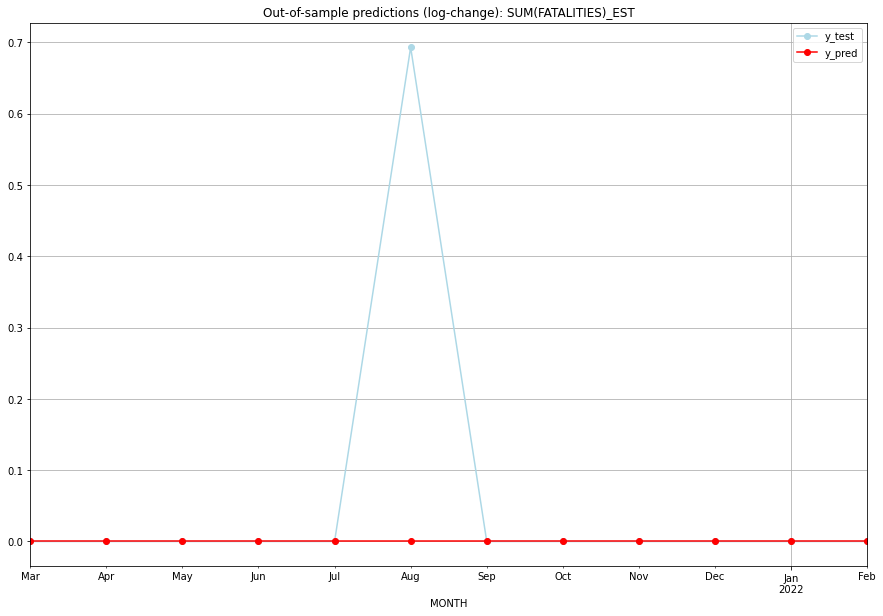

TADDA: 0.057762265046662105
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0    0.000000           0.0        0.000000   EST   
1  2021-04-01       0.0    0.000000           0.0        0.000000   EST   
2  2021-05-01       0.0    0.000000           0.0        0.000000   EST   
3  2021-06-01       0.0    0.000000           0.0        0.000000   EST   
4  2021-07-01       0.0    0.000000           0.0        0.000000   EST   
5  2021-08-01       0.0    0.693147           0.0        0.693147   EST   
6  2021-09-01       0.0    0.000000           0.0        0.000000   EST   
7  2021-10-01       0.0    0.000000           0.0        0.000000   EST   
8  2021-11-01       0.0    0.000000           0.0        0.000000   EST   
9  2021-12-01       0.0    0.000000           0.0        0.000000   EST   
10 2022-01-01       0.0    0.000000           0.0        0.000000   EST   
11 2022-02-01       0.0    0.000000           0.0  

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [1, (0, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.6819003992708403, 'fold_results': [0.4172724501345166, 0.5854200718884837, 0.42525603335487344, 0.6804492543827502, 1.3011041865935775]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_ETH   No. Observations:                  289
Model:                SARIMAX(0, 1, 0)   Log Likelihood                -635.424
Date:                 Wed, 19 Oct 2022   AIC                           1274.848
Time:                         10:42:38   BIC                           1282.174
Sample:                     02-28-1997   HQIC                          1277.784
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------

<Figure size 432x288 with 0 Axes>

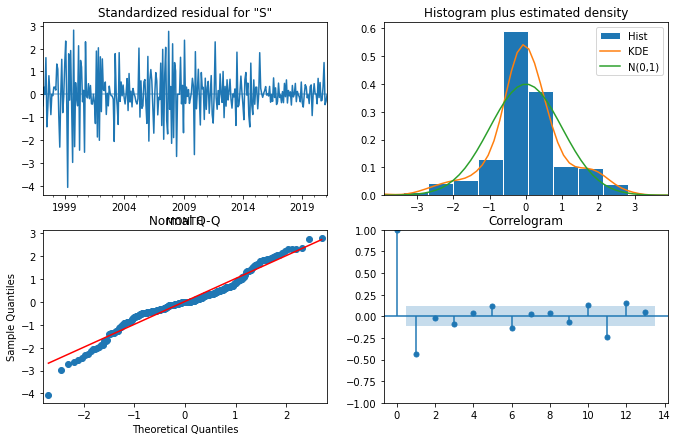

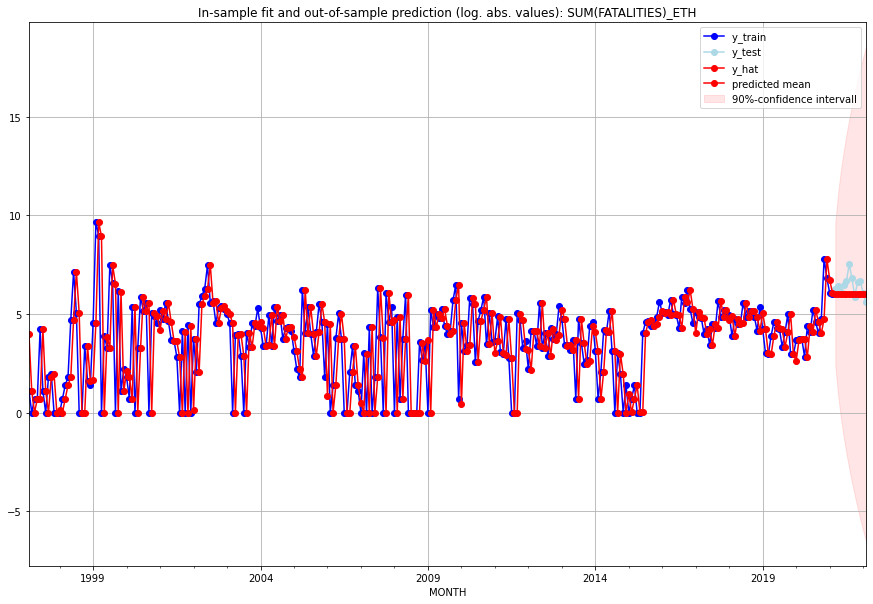

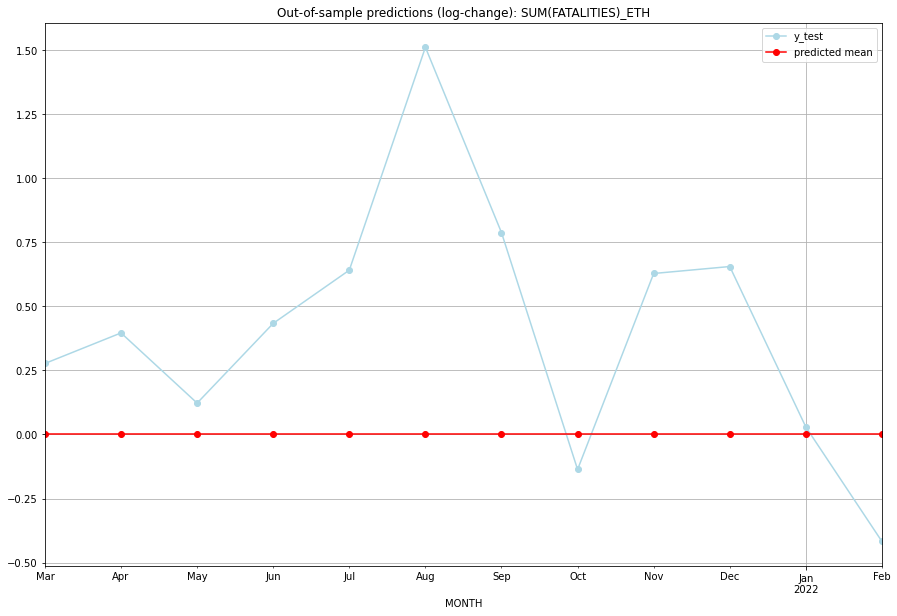

TADDA: 0.50318818748816
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01     406.0       536.0  8.881784e-16        0.277185   ETH   
1  2021-04-01     406.0       604.0  8.881784e-16        0.396415   ETH   
2  2021-05-01     406.0       459.0  8.881784e-16        0.122413   ETH   
3  2021-06-01     406.0       627.0  8.881784e-16        0.433727   ETH   
4  2021-07-01     406.0       772.0  8.881784e-16        0.641466   ETH   
5  2021-08-01     406.0      1844.0  8.881784e-16        1.511421   ETH   
6  2021-09-01     406.0       894.0  8.881784e-16        0.788011   ETH   
7  2021-10-01     406.0       354.0  8.881784e-16       -0.136695   ETH   
8  2021-11-01     406.0       762.0  8.881784e-16        0.628445   ETH   
9  2021-12-01     406.0       783.0  8.881784e-16        0.655596   ETH   
10 2022-01-01     406.0       418.0  8.881784e-16        0.029058   ETH   
11 2022-02-01     406.0       267.0  8.881784e-16      

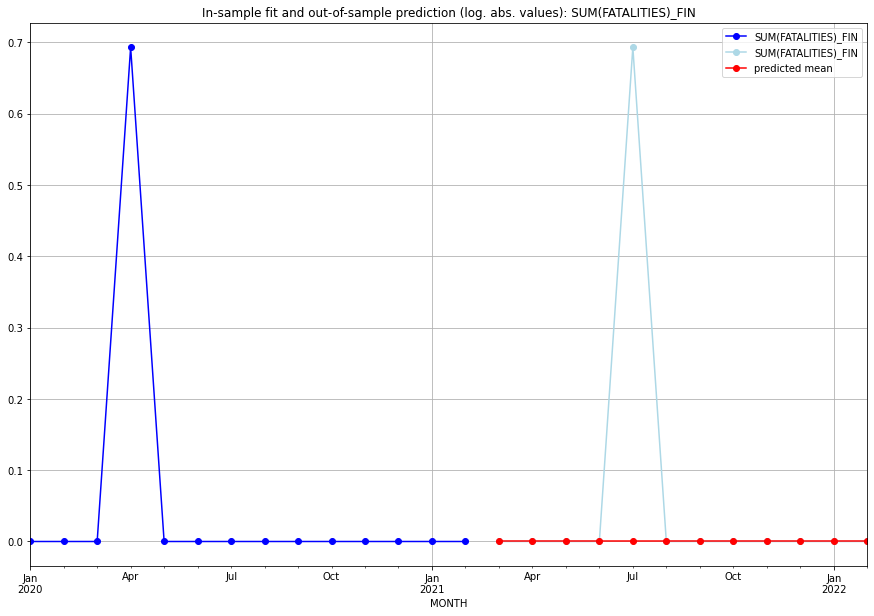

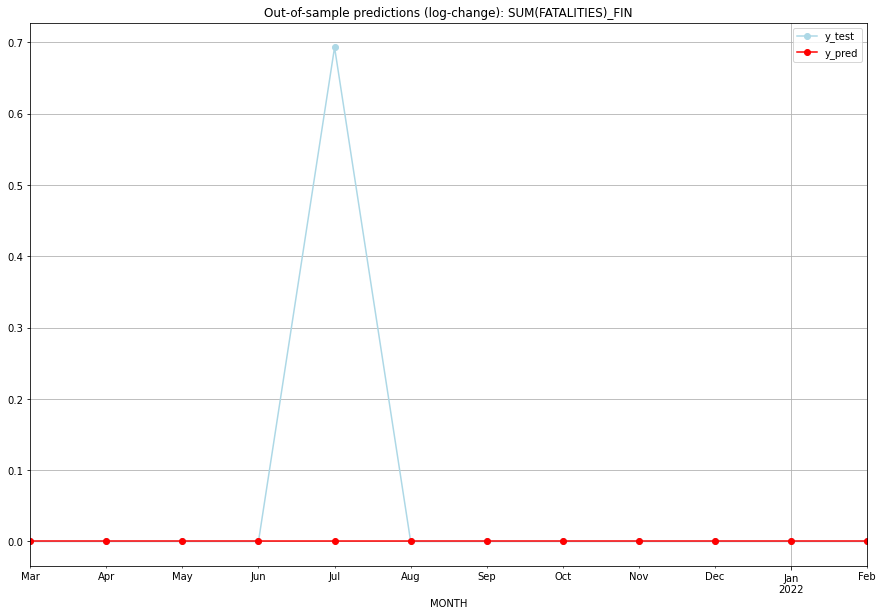

TADDA: 0.057762265046662105
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0    0.000000           0.0        0.000000   FIN   
1  2021-04-01       0.0    0.000000           0.0        0.000000   FIN   
2  2021-05-01       0.0    0.000000           0.0        0.000000   FIN   
3  2021-06-01       0.0    0.000000           0.0        0.000000   FIN   
4  2021-07-01       0.0    0.693147           0.0        0.693147   FIN   
5  2021-08-01       0.0    0.000000           0.0        0.000000   FIN   
6  2021-09-01       0.0    0.000000           0.0        0.000000   FIN   
7  2021-10-01       0.0    0.000000           0.0        0.000000   FIN   
8  2021-11-01       0.0    0.000000           0.0        0.000000   FIN   
9  2021-12-01       0.0    0.000000           0.0        0.000000   FIN   
10 2022-01-01       0.0    0.000000           0.0        0.000000   FIN   
11 2022-02-01       0.0    0.000000           0.0  

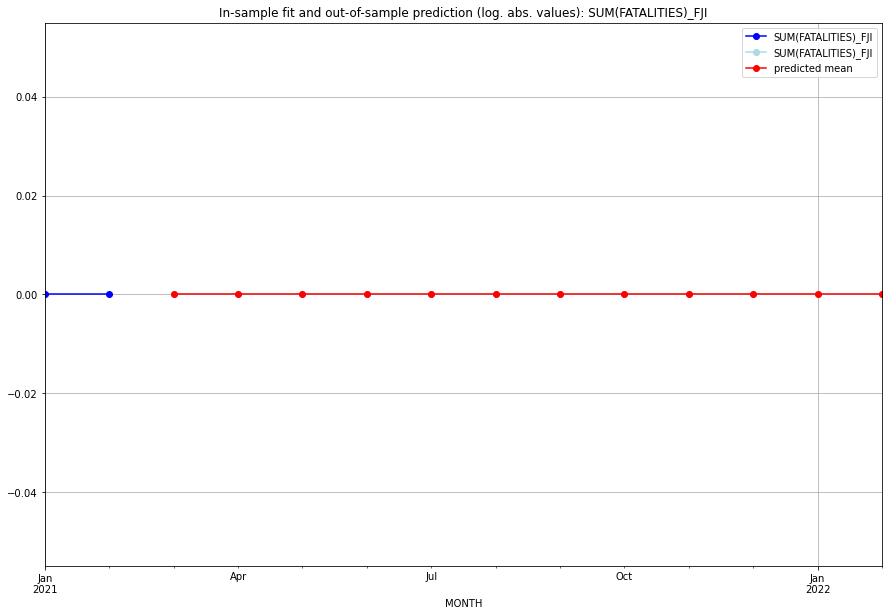

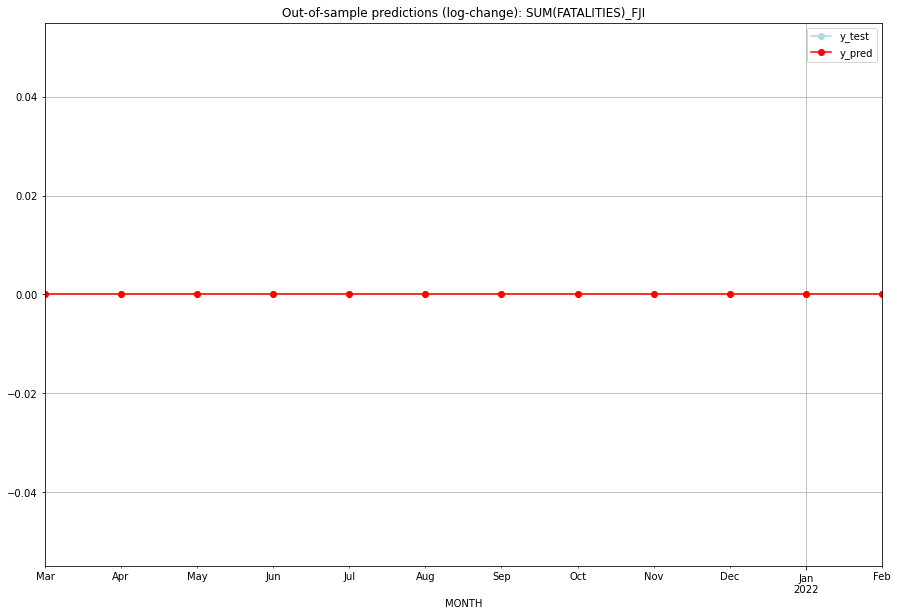

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   FJI   
1  2021-04-01       0.0         0.0           0.0             0.0   FJI   
2  2021-05-01       0.0         0.0           0.0             0.0   FJI   
3  2021-06-01       0.0         0.0           0.0             0.0   FJI   
4  2021-07-01       0.0         0.0           0.0             0.0   FJI   
5  2021-08-01       0.0         0.0           0.0             0.0   FJI   
6  2021-09-01       0.0         0.0           0.0             0.0   FJI   
7  2021-10-01       0.0         0.0           0.0             0.0   FJI   
8  2021-11-01       0.0         0.0           0.0             0.0   FJI   
9  2021-12-01       0.0         0.0           0.0             0.0   FJI   
10 2022-01-01       0.0         0.0           0.0             0.0   FJI   
11 2022-02-01       0.0         0.0           0.0             0.0   

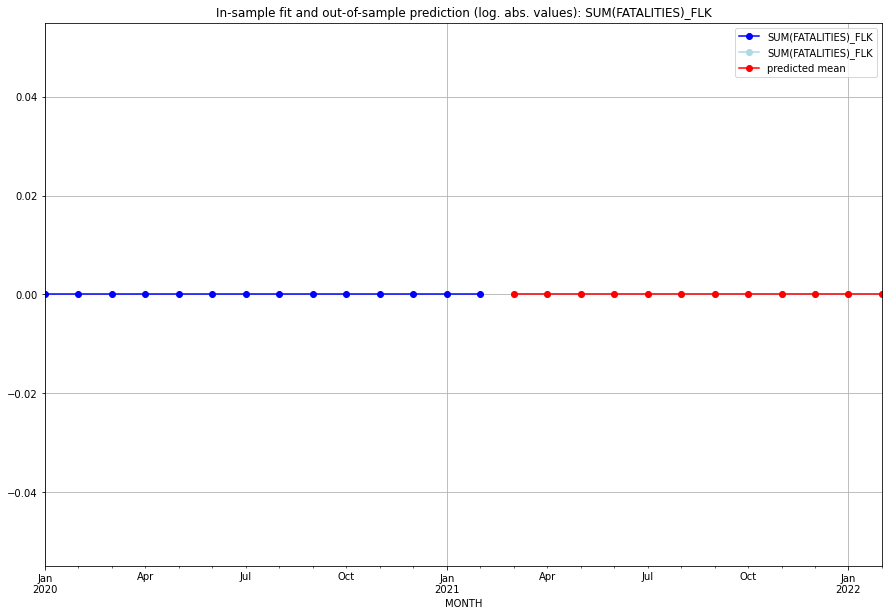

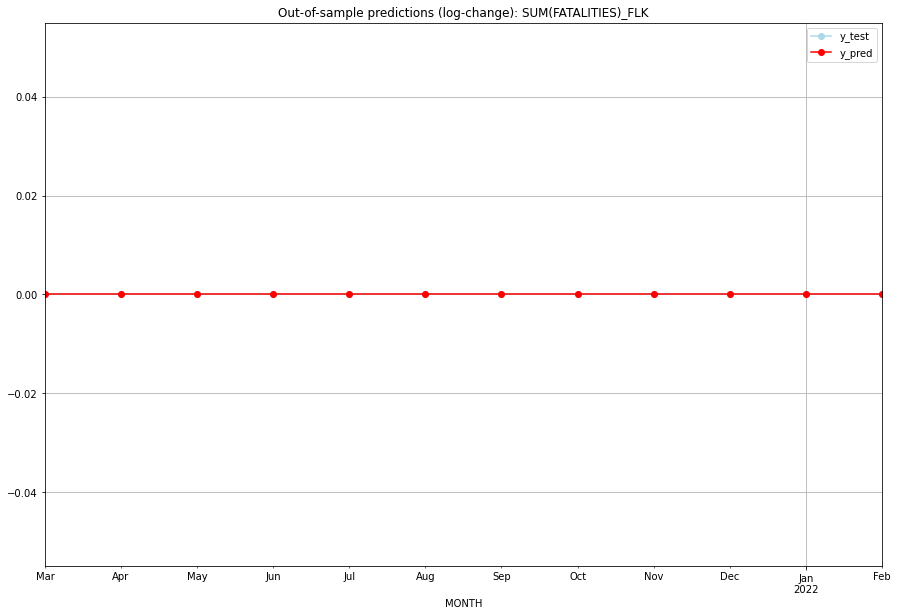

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   FLK   
1  2021-04-01       0.0         0.0           0.0             0.0   FLK   
2  2021-05-01       0.0         0.0           0.0             0.0   FLK   
3  2021-06-01       0.0         0.0           0.0             0.0   FLK   
4  2021-07-01       0.0         0.0           0.0             0.0   FLK   
5  2021-08-01       0.0         0.0           0.0             0.0   FLK   
6  2021-09-01       0.0         0.0           0.0             0.0   FLK   
7  2021-10-01       0.0         0.0           0.0             0.0   FLK   
8  2021-11-01       0.0         0.0           0.0             0.0   FLK   
9  2021-12-01       0.0         0.0           0.0             0.0   FLK   
10 2022-01-01       0.0         0.0           0.0             0.0   FLK   
11 2022-02-01       0.0         0.0           0.0             0.0   

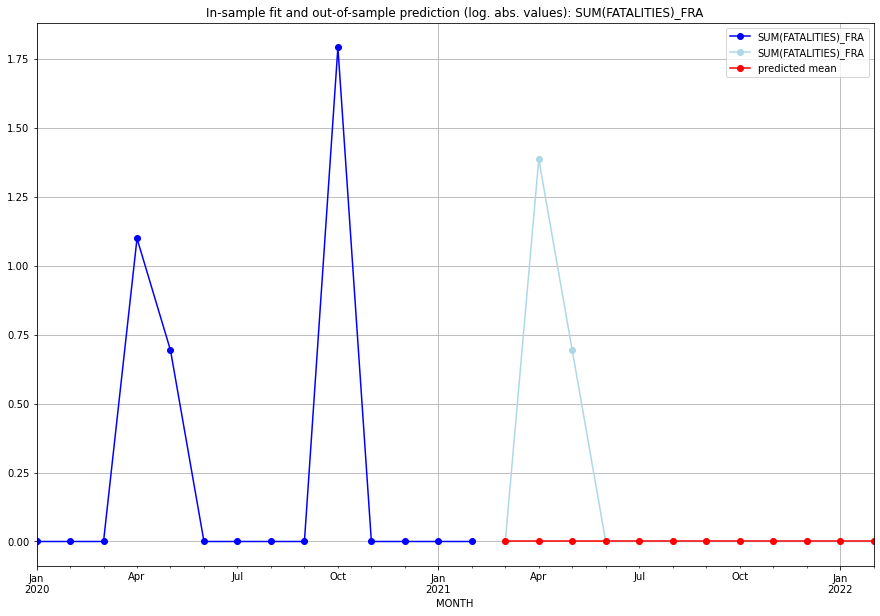

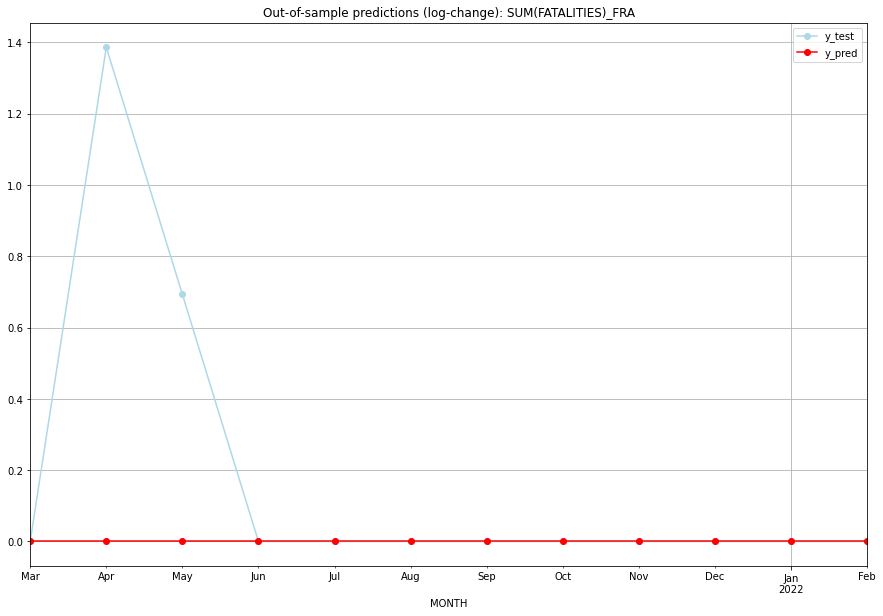

TADDA: 0.17328679513998632
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0    0.000000           0.0        0.000000   FRA   
1  2021-04-01       0.0    1.386294           0.0        1.386294   FRA   
2  2021-05-01       0.0    0.693147           0.0        0.693147   FRA   
3  2021-06-01       0.0    0.000000           0.0        0.000000   FRA   
4  2021-07-01       0.0    0.000000           0.0        0.000000   FRA   
5  2021-08-01       0.0    0.000000           0.0        0.000000   FRA   
6  2021-09-01       0.0    0.000000           0.0        0.000000   FRA   
7  2021-10-01       0.0    0.000000           0.0        0.000000   FRA   
8  2021-11-01       0.0    0.000000           0.0        0.000000   FRA   
9  2021-12-01       0.0    0.000000           0.0        0.000000   FRA   
10 2022-01-01       0.0    0.000000           0.0        0.000000   FRA   
11 2022-02-01       0.0    0.000000           0.0   

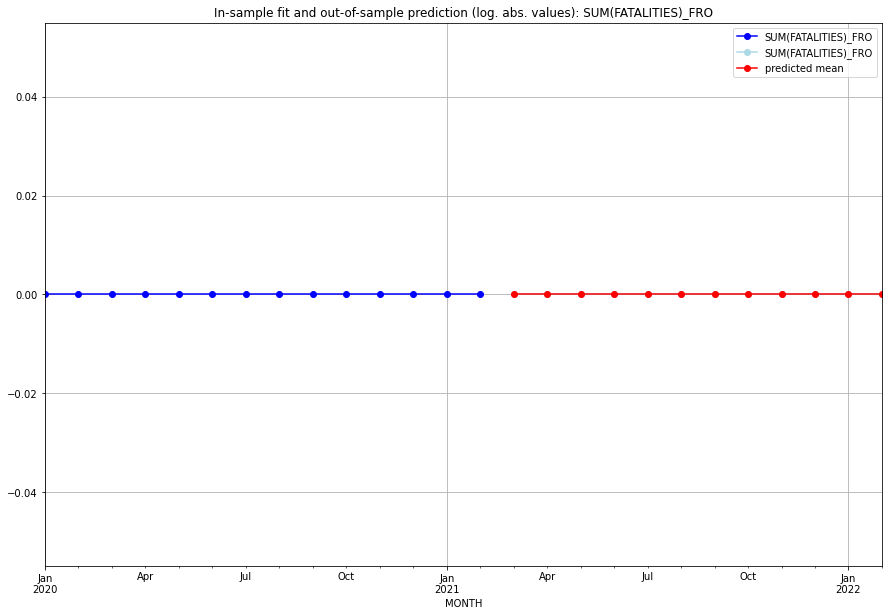

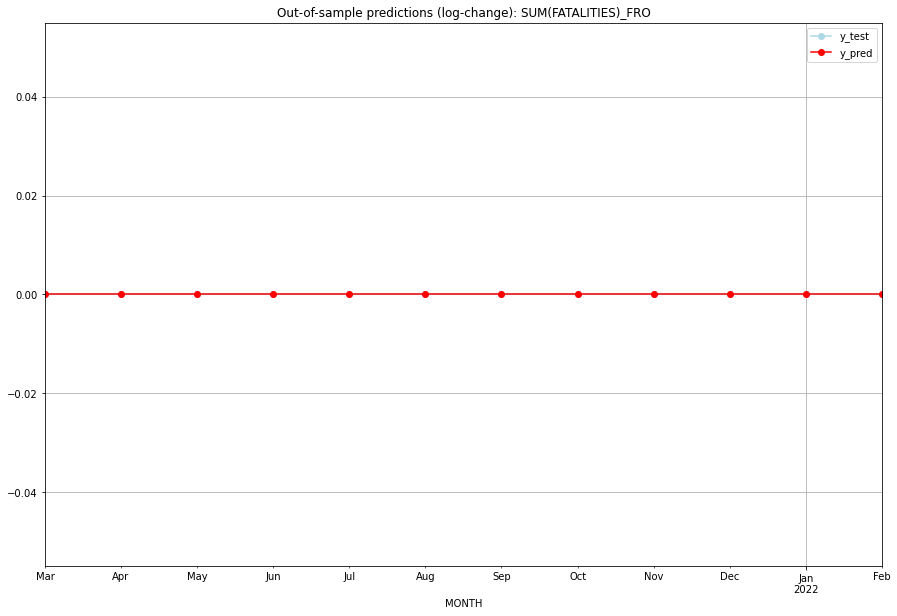

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   FRO   
1  2021-04-01       0.0         0.0           0.0             0.0   FRO   
2  2021-05-01       0.0         0.0           0.0             0.0   FRO   
3  2021-06-01       0.0         0.0           0.0             0.0   FRO   
4  2021-07-01       0.0         0.0           0.0             0.0   FRO   
5  2021-08-01       0.0         0.0           0.0             0.0   FRO   
6  2021-09-01       0.0         0.0           0.0             0.0   FRO   
7  2021-10-01       0.0         0.0           0.0             0.0   FRO   
8  2021-11-01       0.0         0.0           0.0             0.0   FRO   
9  2021-12-01       0.0         0.0           0.0             0.0   FRO   
10 2022-01-01       0.0         0.0           0.0             0.0   FRO   
11 2022-02-01       0.0         0.0           0.0             0.0   

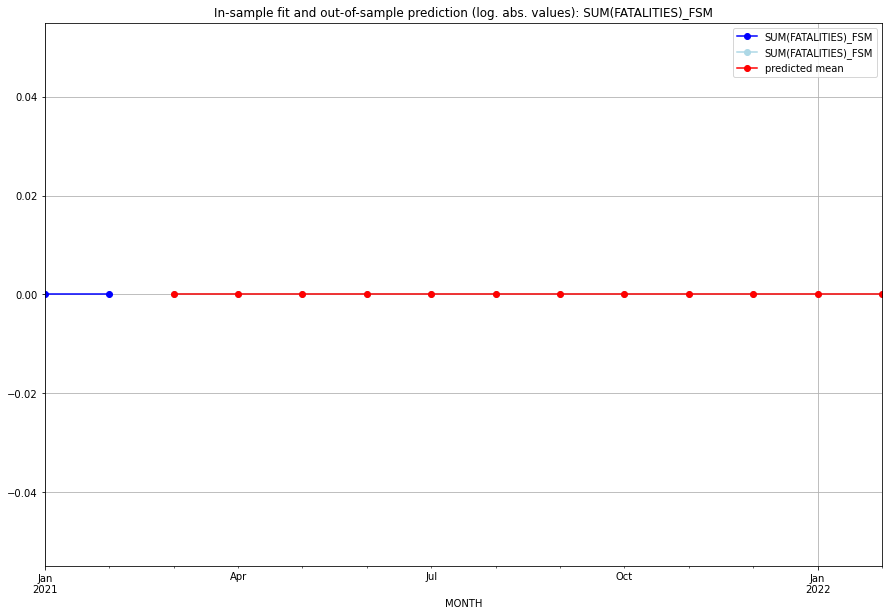

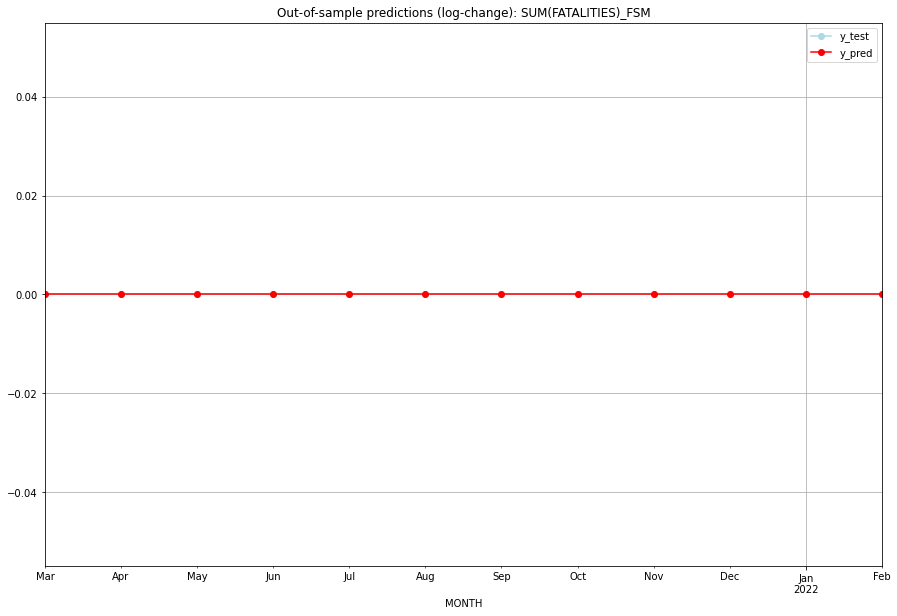

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   FSM   
1  2021-04-01       0.0         0.0           0.0             0.0   FSM   
2  2021-05-01       0.0         0.0           0.0             0.0   FSM   
3  2021-06-01       0.0         0.0           0.0             0.0   FSM   
4  2021-07-01       0.0         0.0           0.0             0.0   FSM   
5  2021-08-01       0.0         0.0           0.0             0.0   FSM   
6  2021-09-01       0.0         0.0           0.0             0.0   FSM   
7  2021-10-01       0.0         0.0           0.0             0.0   FSM   
8  2021-11-01       0.0         0.0           0.0             0.0   FSM   
9  2021-12-01       0.0         0.0           0.0             0.0   FSM   
10 2022-01-01       0.0         0.0           0.0             0.0   FSM   
11 2022-02-01       0.0         0.0           0.0             0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.1431616647033831, 'fold_results': [0.21992144413460482, 0.057762265046662105, 0.20707555414900003, 0.17328679513998635, 0.057762265046662105]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_GAB   No. Observations:                  289
Model:                         SARIMAX   Log Likelihood                 -49.955
Date:                 Wed, 19 Oct 2022   AIC                            101.909
Time:                         10:43:43   BIC                            105.576
Sample:                     02-28-1997   HQIC                           103.378
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------

<Figure size 432x288 with 0 Axes>

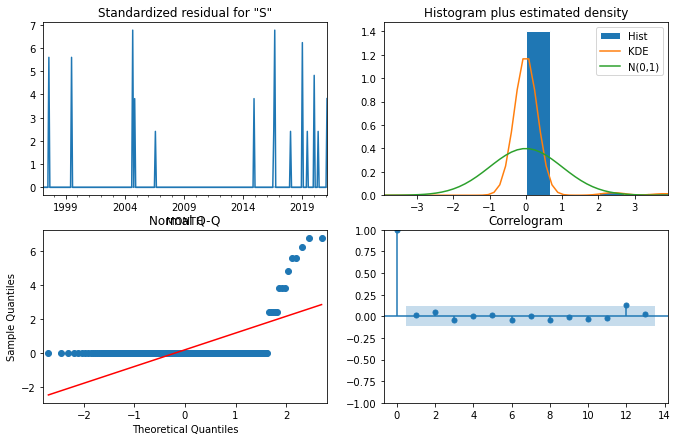

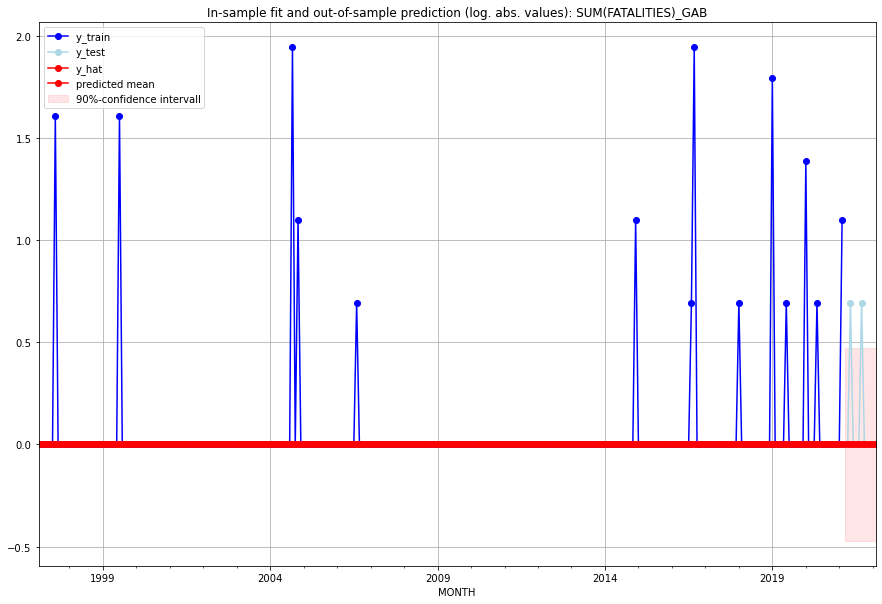

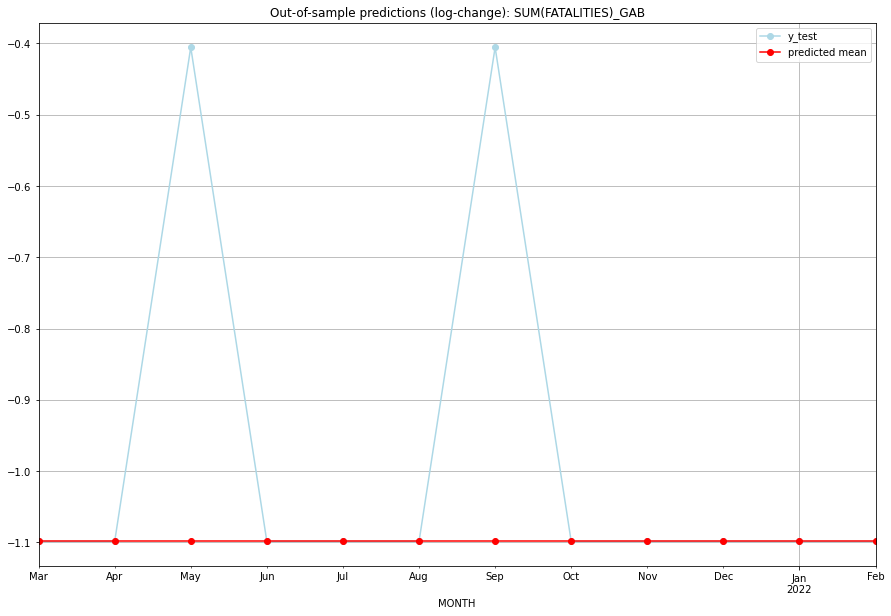

TADDA: 0.11552453009332421
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0     -1.098612       -1.098612   GAB   
1  2021-04-01       0.0         0.0     -1.098612       -1.098612   GAB   
2  2021-05-01       0.0         1.0     -1.098612       -0.405465   GAB   
3  2021-06-01       0.0         0.0     -1.098612       -1.098612   GAB   
4  2021-07-01       0.0         0.0     -1.098612       -1.098612   GAB   
5  2021-08-01       0.0         0.0     -1.098612       -1.098612   GAB   
6  2021-09-01       0.0         1.0     -1.098612       -0.405465   GAB   
7  2021-10-01       0.0         0.0     -1.098612       -1.098612   GAB   
8  2021-11-01       0.0         0.0     -1.098612       -1.098612   GAB   
9  2021-12-01       0.0         0.0     -1.098612       -1.098612   GAB   
10 2022-01-01       0.0         0.0     -1.098612       -1.098612   GAB   
11 2022-02-01       0.0         0.0     -1.098612   

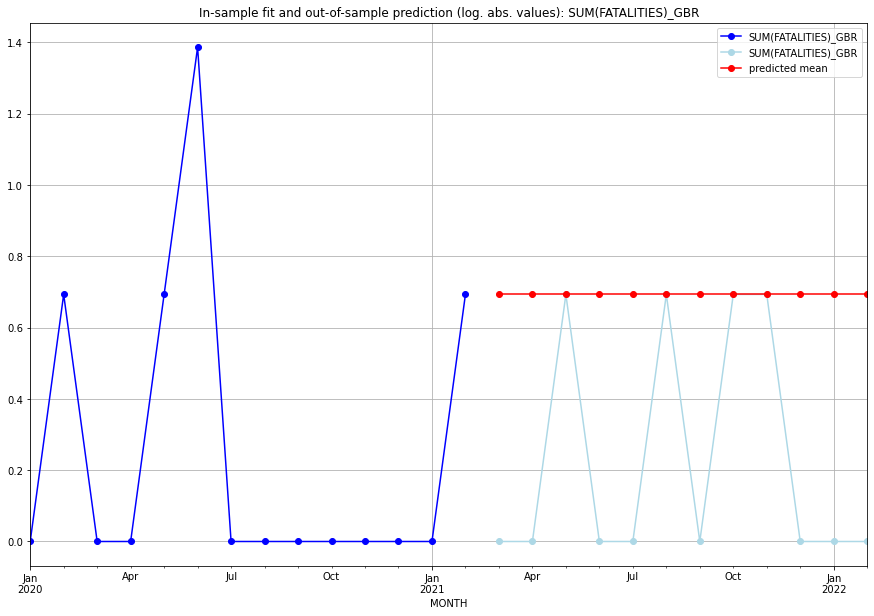

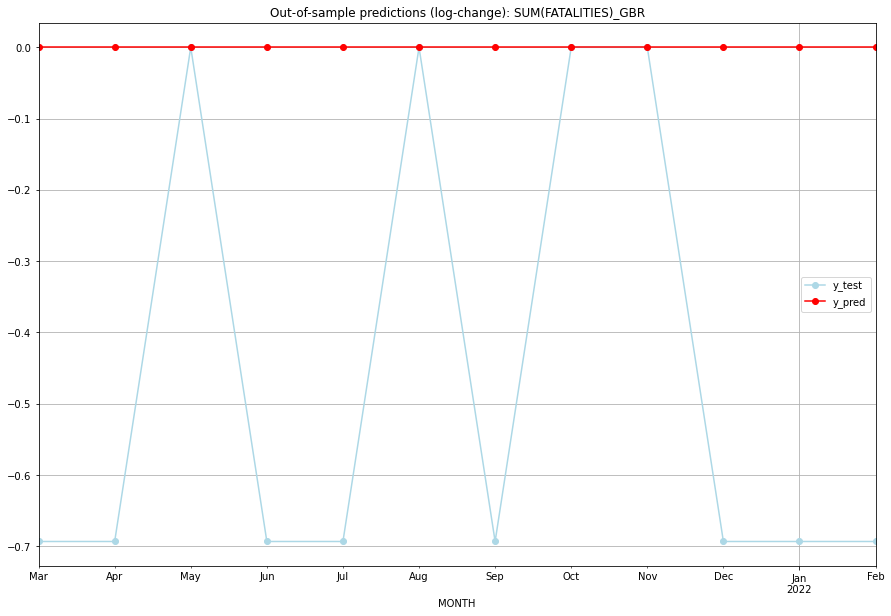

TADDA: 0.46209812037329684
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  0.693147    0.000000           0.0       -0.693147   GBR   
1  2021-04-01  0.693147    0.000000           0.0       -0.693147   GBR   
2  2021-05-01  0.693147    0.693147           0.0        0.000000   GBR   
3  2021-06-01  0.693147    0.000000           0.0       -0.693147   GBR   
4  2021-07-01  0.693147    0.000000           0.0       -0.693147   GBR   
5  2021-08-01  0.693147    0.693147           0.0        0.000000   GBR   
6  2021-09-01  0.693147    0.000000           0.0       -0.693147   GBR   
7  2021-10-01  0.693147    0.693147           0.0        0.000000   GBR   
8  2021-11-01  0.693147    0.693147           0.0        0.000000   GBR   
9  2021-12-01  0.693147    0.000000           0.0       -0.693147   GBR   
10 2022-01-01  0.693147    0.000000           0.0       -0.693147   GBR   
11 2022-02-01  0.693147    0.000000           0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [2, (2, 1, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.057762265046662105, 'fold_results': [nan, 0.057762265046662105]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_GEO   No. Observations:                   38
Model:                SARIMAX(2, 1, 3)   Log Likelihood                  -6.530
Date:                 Wed, 19 Oct 2022   AIC                             29.060
Time:                         10:43:56   BIC                             41.947
Sample:                     01-31-2018   HQIC                            33.603
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -0.0089      0.020     -0.

<Figure size 432x288 with 0 Axes>

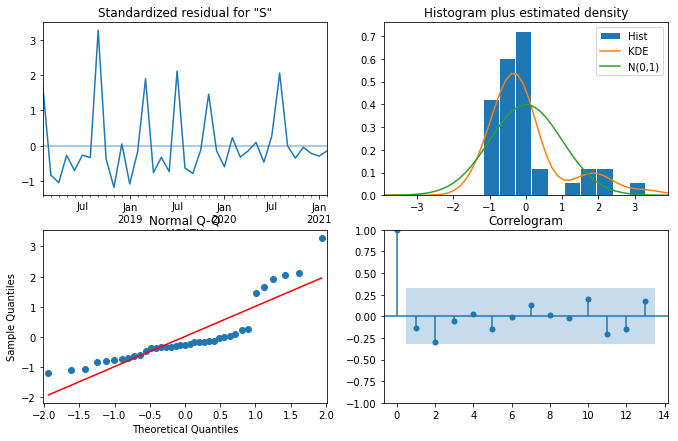

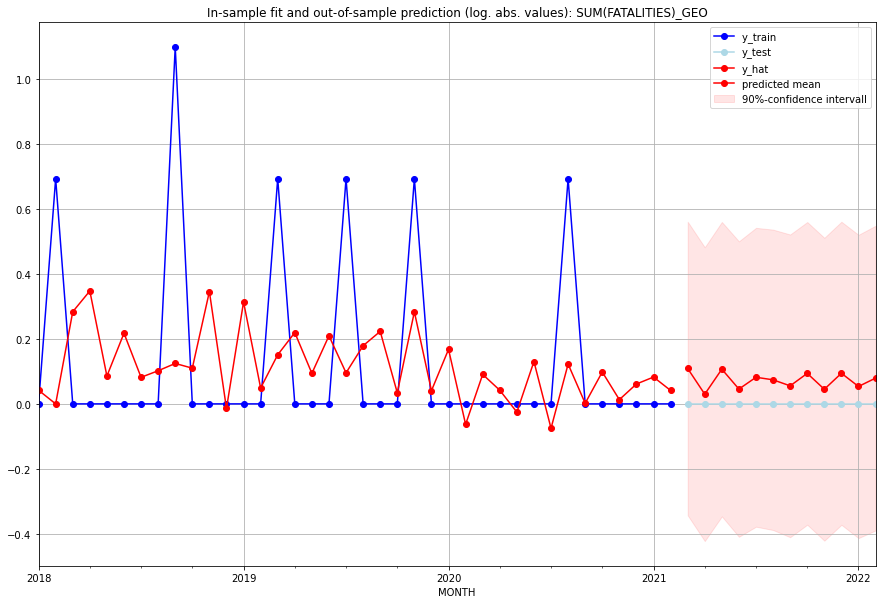

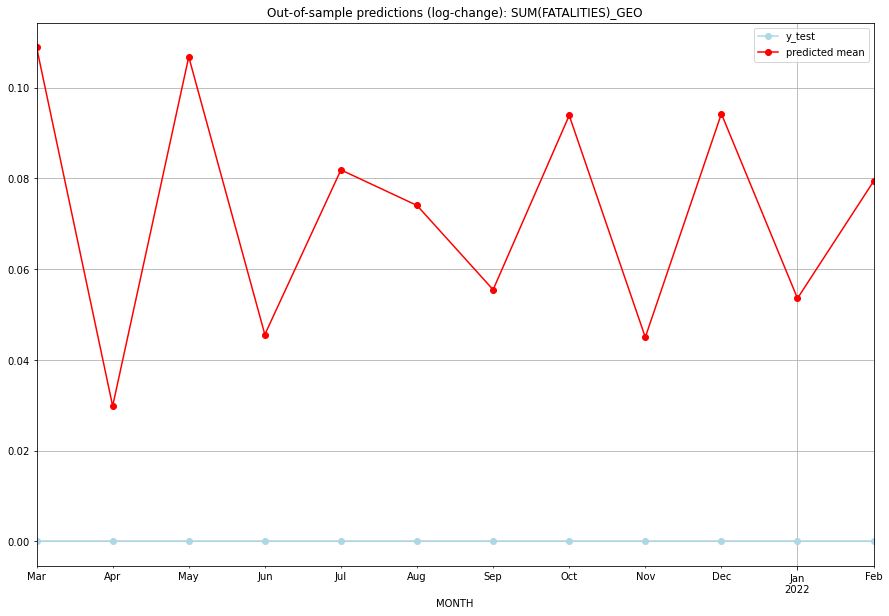

TADDA: 0.07237550668969006
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  0.115027         0.0      0.108879             0.0   GEO   
1  2021-04-01  0.030294         0.0      0.029844             0.0   GEO   
2  2021-05-01  0.112682         0.0      0.106773             0.0   GEO   
3  2021-06-01  0.046657         0.0      0.045602             0.0   GEO   
4  2021-07-01  0.085317         0.0      0.081872             0.0   GEO   
5  2021-08-01  0.076844         0.0      0.074034             0.0   GEO   
6  2021-09-01  0.057045         0.0      0.055478             0.0   GEO   
7  2021-10-01  0.098412         0.0      0.093866             0.0   GEO   
8  2021-11-01  0.046024         0.0      0.044996             0.0   GEO   
9  2021-12-01  0.098822         0.0      0.094239             0.0   GEO   
10 2022-01-01  0.055032         0.0      0.053571             0.0   GEO   
11 2022-02-01  0.082587         0.0      0.079353   

<Figure size 432x288 with 0 Axes>

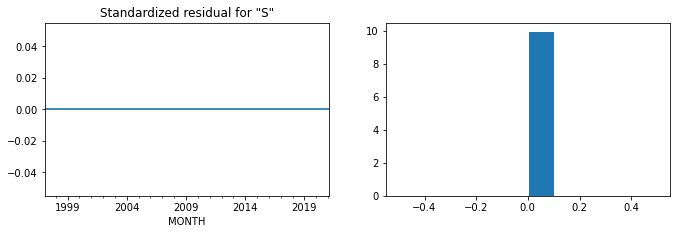

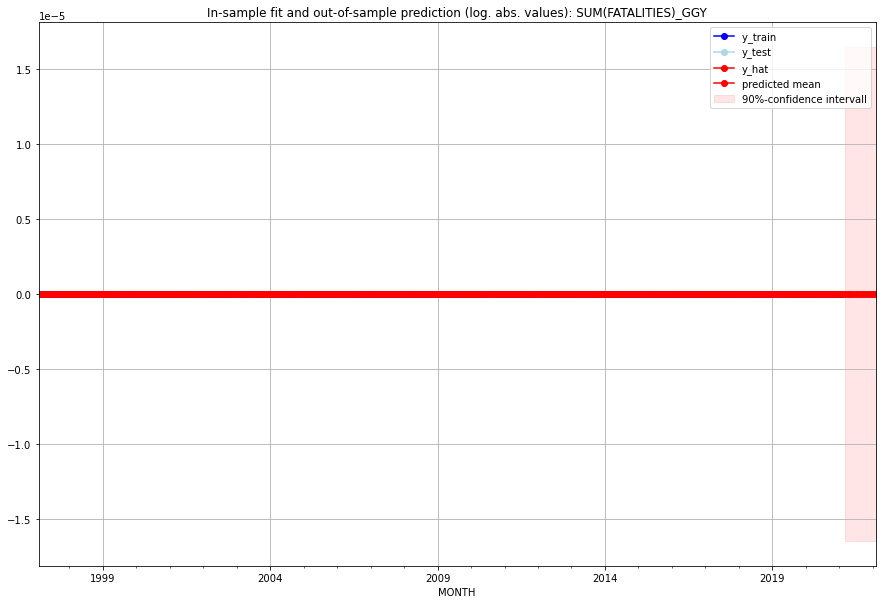

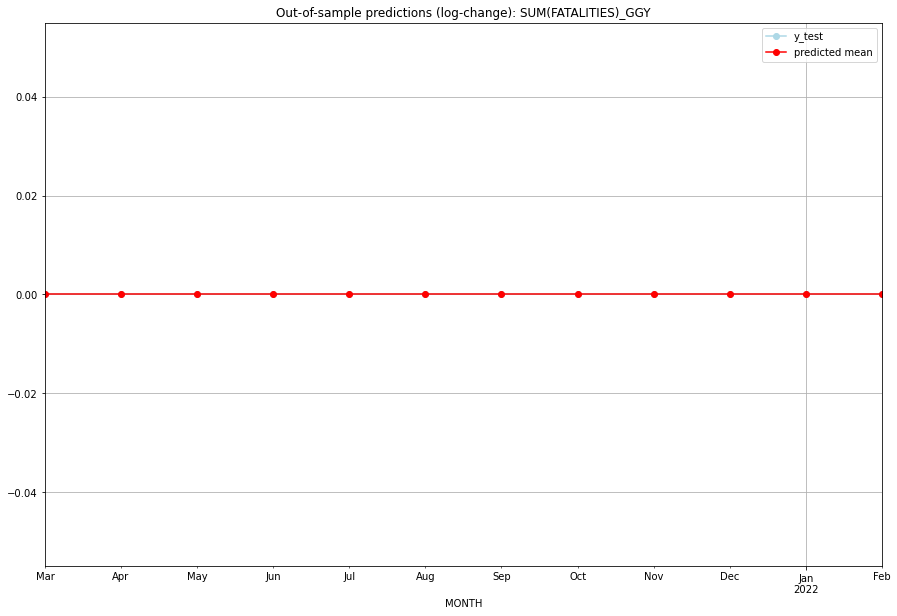

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   GGY   
1  2021-04-01       0.0         0.0           0.0             0.0   GGY   
2  2021-05-01       0.0         0.0           0.0             0.0   GGY   
3  2021-06-01       0.0         0.0           0.0             0.0   GGY   
4  2021-07-01       0.0         0.0           0.0             0.0   GGY   
5  2021-08-01       0.0         0.0           0.0             0.0   GGY   
6  2021-09-01       0.0         0.0           0.0             0.0   GGY   
7  2021-10-01       0.0         0.0           0.0             0.0   GGY   
8  2021-11-01       0.0         0.0           0.0             0.0   GGY   
9  2021-12-01       0.0         0.0           0.0             0.0   GGY   
10 2022-01-01       0.0         0.0           0.0             0.0   GGY   
11 2022-02-01       0.0         0.0           0.0             0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (3, 1, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.7910590354757613, 'fold_results': [0.8904488688577152, 1.1201261118649894, 0.8312295934093061, 0.4516560817190225, 0.6618345215277727]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_GHA   No. Observations:                  289
Model:                SARIMAX(3, 1, 3)   Log Likelihood                -332.568
Date:                 Wed, 19 Oct 2022   AIC                            685.136
Time:                         10:44:48   BIC                            721.766
Sample:                     02-28-1997   HQIC                           699.815
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------

<Figure size 432x288 with 0 Axes>

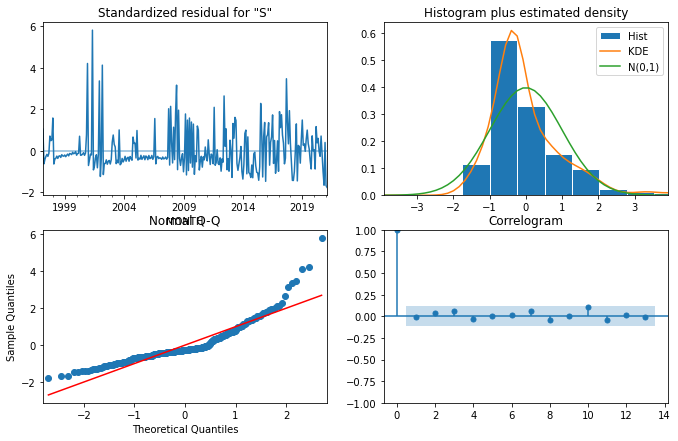

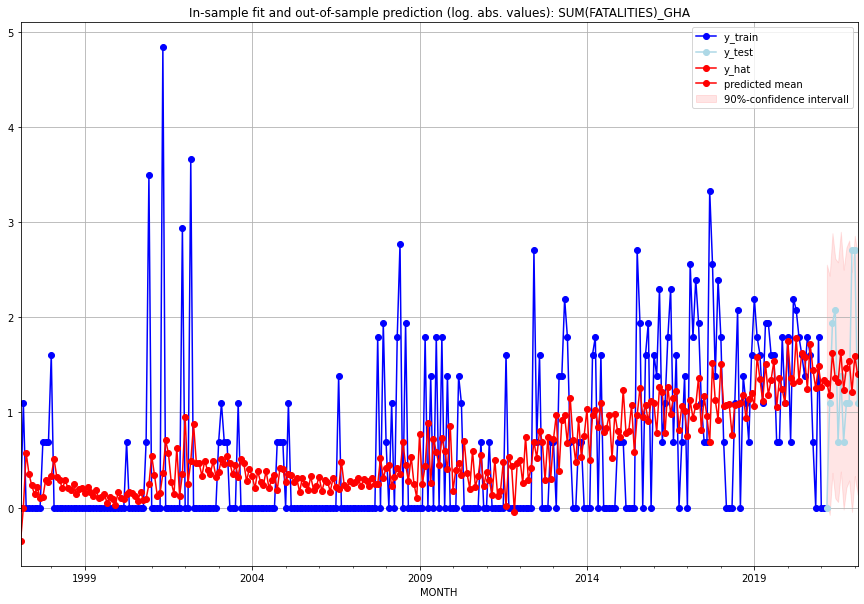

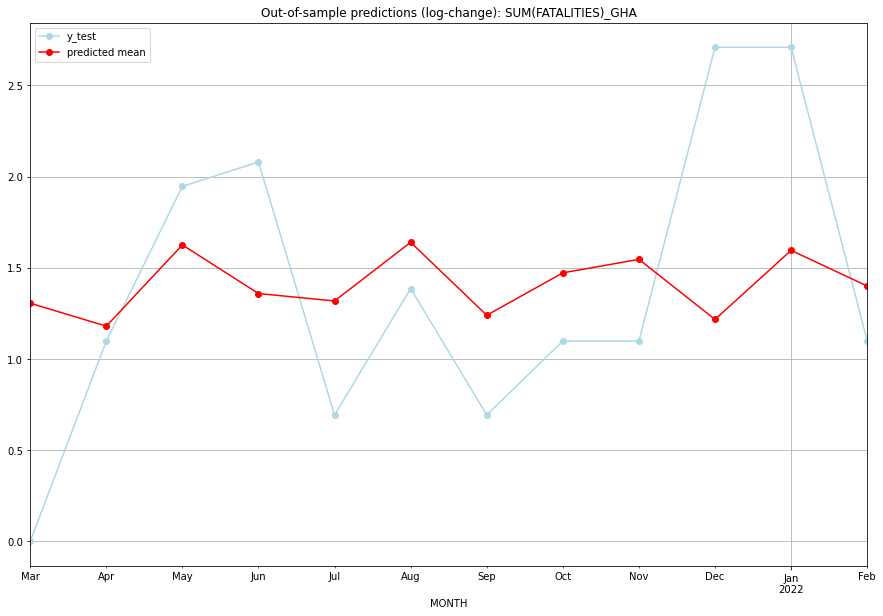

TADDA: 0.6316346574622337
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  2.689878         0.0      1.305593        0.000000   GHA   
1  2021-04-01  2.254490         2.0      1.180036        1.098612   GHA   
2  2021-05-01  4.079839         6.0      1.625279        1.945910   GHA   
3  2021-06-01  2.890867         7.0      1.358632        2.079442   GHA   
4  2021-07-01  2.736740         1.0      1.318214        0.693147   GHA   
5  2021-08-01  4.152803         3.0      1.639541        1.386294   GHA   
6  2021-09-01  2.454683         1.0      1.239731        0.693147   GHA   
7  2021-10-01  3.358767         2.0      1.472189        1.098612   GHA   
8  2021-11-01  3.692748         2.0      1.546018        1.098612   GHA   
9  2021-12-01  2.376635        14.0      1.216880        2.708050   GHA   
10 2022-01-01  3.929506        14.0      1.595239        2.708050   GHA   
11 2022-02-01  3.054835         2.0      1.399910    

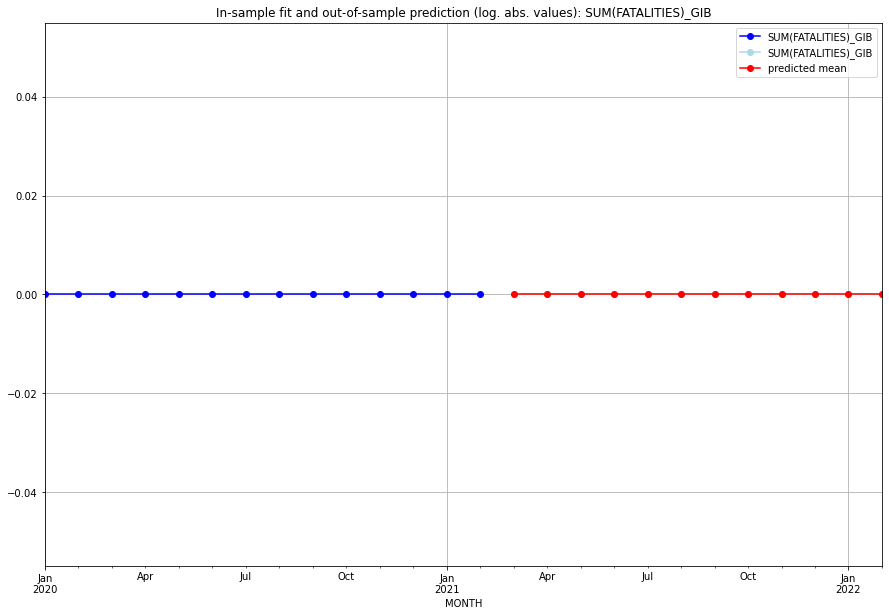

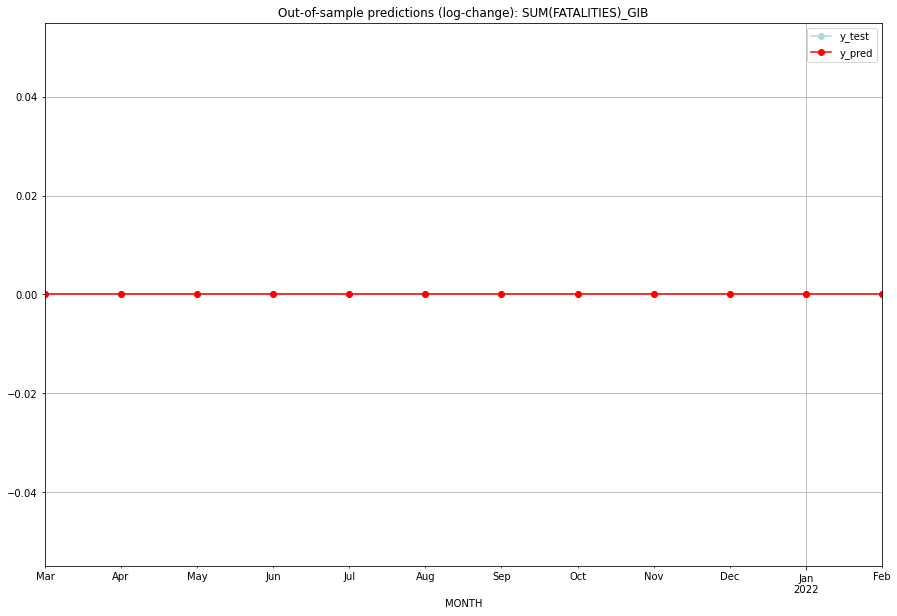

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   GIB   
1  2021-04-01       0.0         0.0           0.0             0.0   GIB   
2  2021-05-01       0.0         0.0           0.0             0.0   GIB   
3  2021-06-01       0.0         0.0           0.0             0.0   GIB   
4  2021-07-01       0.0         0.0           0.0             0.0   GIB   
5  2021-08-01       0.0         0.0           0.0             0.0   GIB   
6  2021-09-01       0.0         0.0           0.0             0.0   GIB   
7  2021-10-01       0.0         0.0           0.0             0.0   GIB   
8  2021-11-01       0.0         0.0           0.0             0.0   GIB   
9  2021-12-01       0.0         0.0           0.0             0.0   GIB   
10 2022-01-01       0.0         0.0           0.0             0.0   GIB   
11 2022-02-01       0.0         0.0           0.0             0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.6835137129286623, 'fold_results': [0.35638884325133796, 0.6530390442379043, 0.5722444403718235, 0.9121274574763203, 0.9237687793059256]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_GIN   No. Observations:                  289
Model:                SARIMAX(0, 1, 0)   Log Likelihood                -515.810
Date:                 Wed, 19 Oct 2022   AIC                           1033.619
Time:                         10:45:22   BIC                           1037.282
Sample:                     02-28-1997   HQIC                          1035.087
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------

<Figure size 432x288 with 0 Axes>

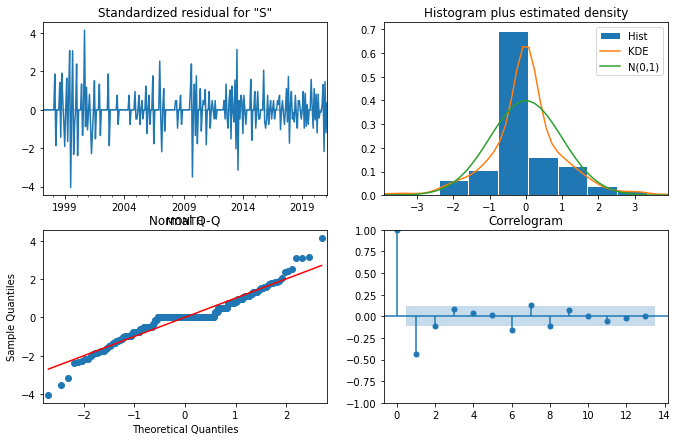

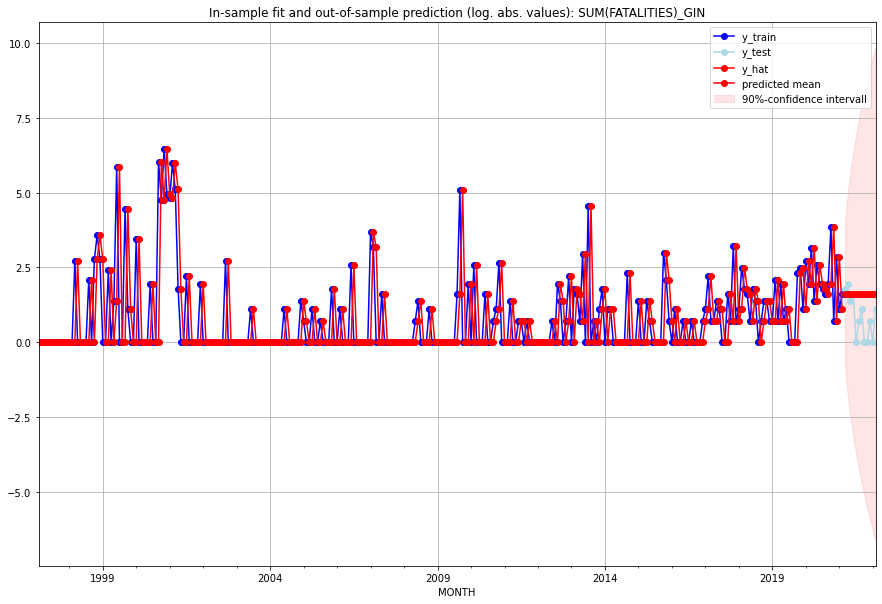

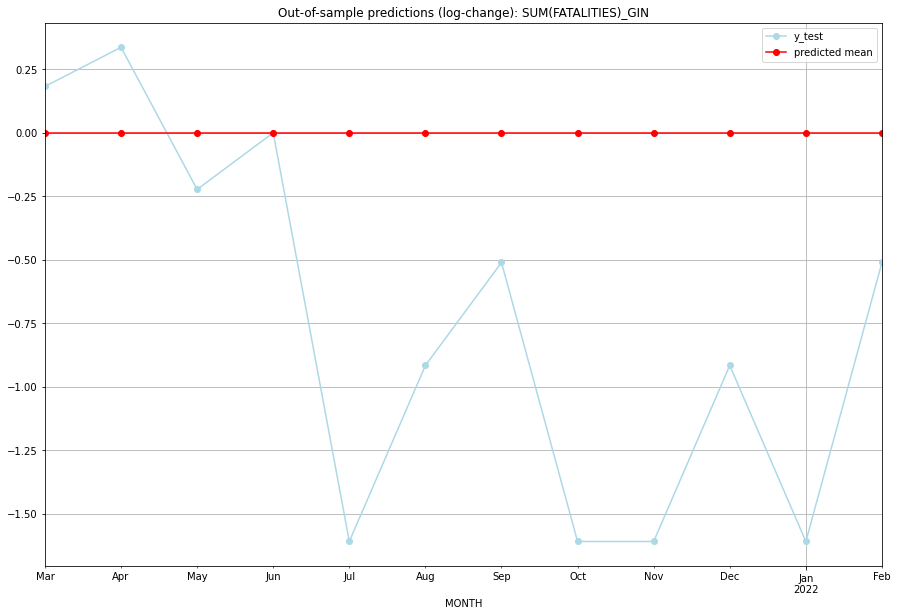

TADDA: 0.8361601421455057
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       4.0         5.0           0.0        0.182322   GIN   
1  2021-04-01       4.0         6.0           0.0        0.336472   GIN   
2  2021-05-01       4.0         3.0           0.0       -0.223144   GIN   
3  2021-06-01       4.0         4.0           0.0        0.000000   GIN   
4  2021-07-01       4.0         0.0           0.0       -1.609438   GIN   
5  2021-08-01       4.0         1.0           0.0       -0.916291   GIN   
6  2021-09-01       4.0         2.0           0.0       -0.510826   GIN   
7  2021-10-01       4.0         0.0           0.0       -1.609438   GIN   
8  2021-11-01       4.0         0.0           0.0       -1.609438   GIN   
9  2021-12-01       4.0         1.0           0.0       -0.916291   GIN   
10 2022-01-01       4.0         0.0           0.0       -1.609438   GIN   
11 2022-02-01       4.0         2.0           0.0    

<Figure size 432x288 with 0 Axes>

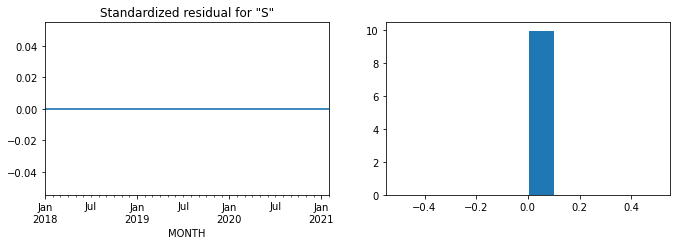

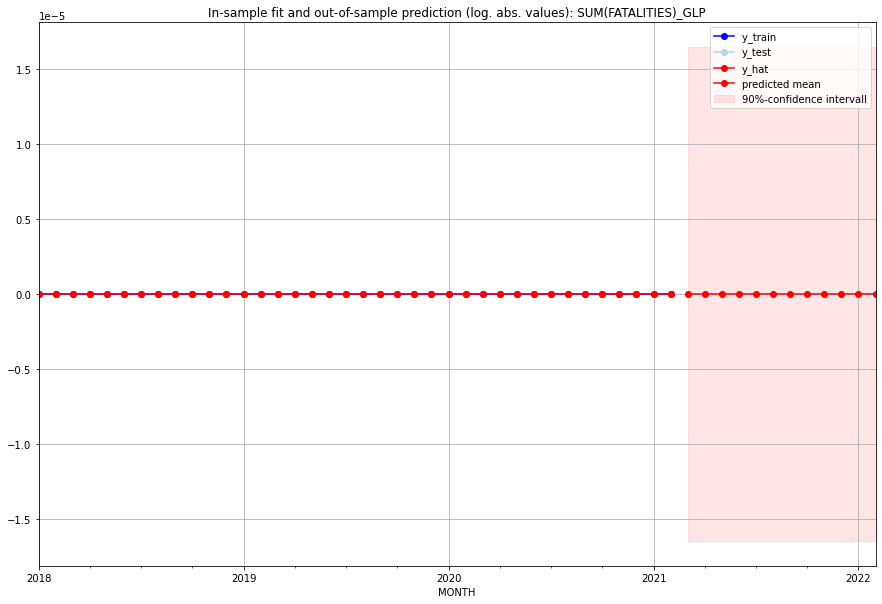

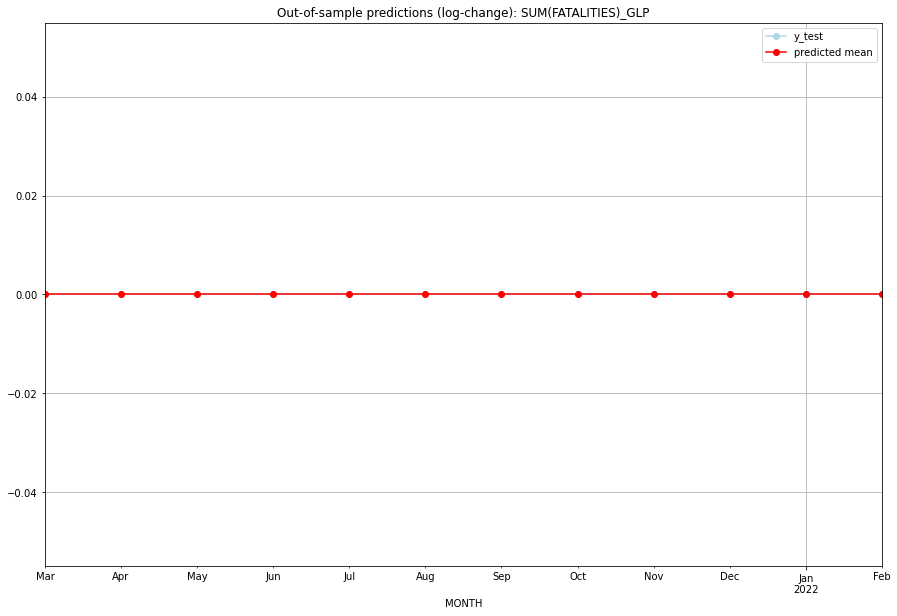

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   GLP   
1  2021-04-01       0.0         0.0           0.0             0.0   GLP   
2  2021-05-01       0.0         0.0           0.0             0.0   GLP   
3  2021-06-01       0.0         0.0           0.0             0.0   GLP   
4  2021-07-01       0.0         0.0           0.0             0.0   GLP   
5  2021-08-01       0.0         0.0           0.0             0.0   GLP   
6  2021-09-01       0.0         0.0           0.0             0.0   GLP   
7  2021-10-01       0.0         0.0           0.0             0.0   GLP   
8  2021-11-01       0.0         0.0           0.0             0.0   GLP   
9  2021-12-01       0.0         0.0           0.0             0.0   GLP   
10 2022-01-01       0.0         0.0           0.0             0.0   GLP   
11 2022-02-01       0.0         0.0           0.0             0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.14910624710236195, 'fold_results': [0.13411982603617503, 0.2648378191956621, 0.11552453009332421, 0.23104906018664842, 0.0]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_GMB   No. Observations:                  289
Model:                         SARIMAX   Log Likelihood                -196.003
Date:                 Wed, 19 Oct 2022   AIC                            394.007
Time:                         10:46:10   BIC                            397.673
Sample:                     02-28-1997   HQIC                           395.476
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------

<Figure size 432x288 with 0 Axes>

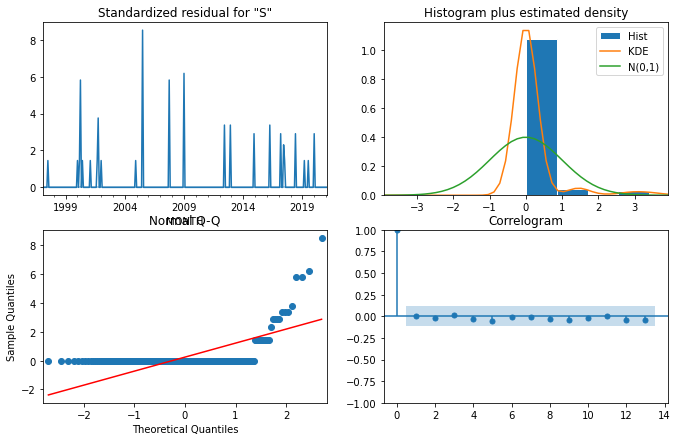

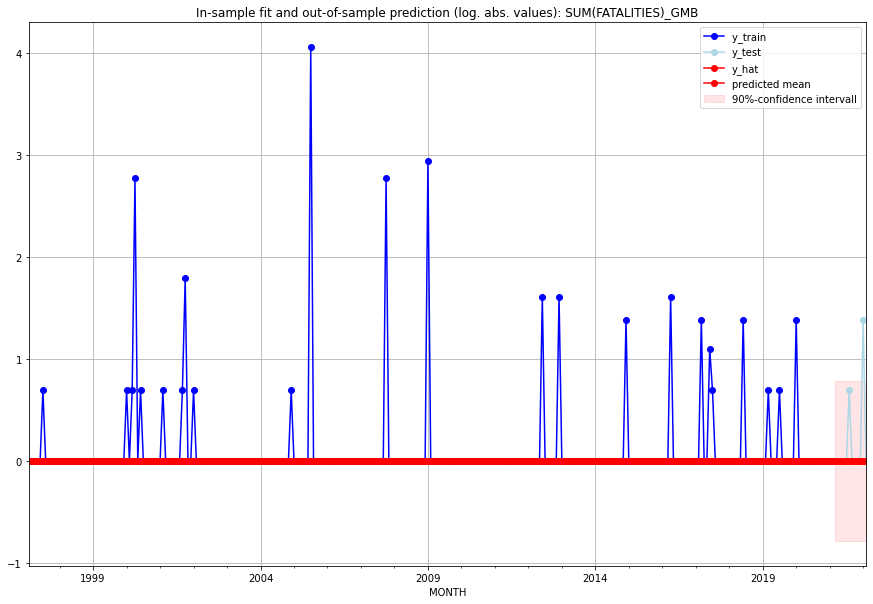

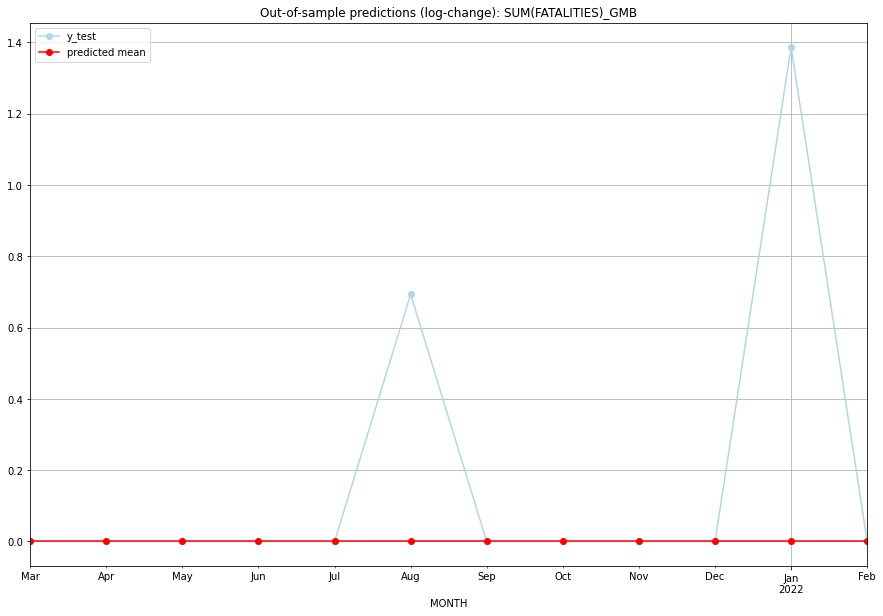

TADDA: 0.17328679513998632
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0        0.000000   GMB   
1  2021-04-01       0.0         0.0           0.0        0.000000   GMB   
2  2021-05-01       0.0         0.0           0.0        0.000000   GMB   
3  2021-06-01       0.0         0.0           0.0        0.000000   GMB   
4  2021-07-01       0.0         0.0           0.0        0.000000   GMB   
5  2021-08-01       0.0         1.0           0.0        0.693147   GMB   
6  2021-09-01       0.0         0.0           0.0        0.000000   GMB   
7  2021-10-01       0.0         0.0           0.0        0.000000   GMB   
8  2021-11-01       0.0         0.0           0.0        0.000000   GMB   
9  2021-12-01       0.0         0.0           0.0        0.000000   GMB   
10 2022-01-01       0.0         3.0           0.0        1.386294   GMB   
11 2022-02-01       0.0         0.0           0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.0730337772445647, 'fold_results': [0.0, 0.0, 0.0, 0.057762265046662105, 0.30740662117616135]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_GNB   No. Observations:                  289
Model:                         SARIMAX   Log Likelihood                -357.339
Date:                 Wed, 19 Oct 2022   AIC                            716.678
Time:                         10:46:34   BIC                            720.345
Sample:                     02-28-1997   HQIC                           718.147
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2     

<Figure size 432x288 with 0 Axes>

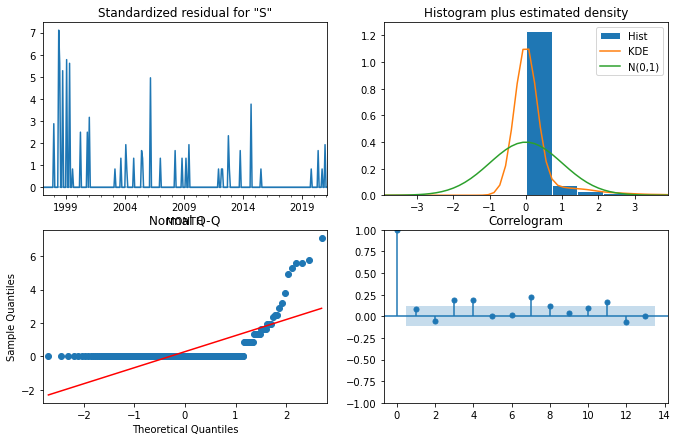

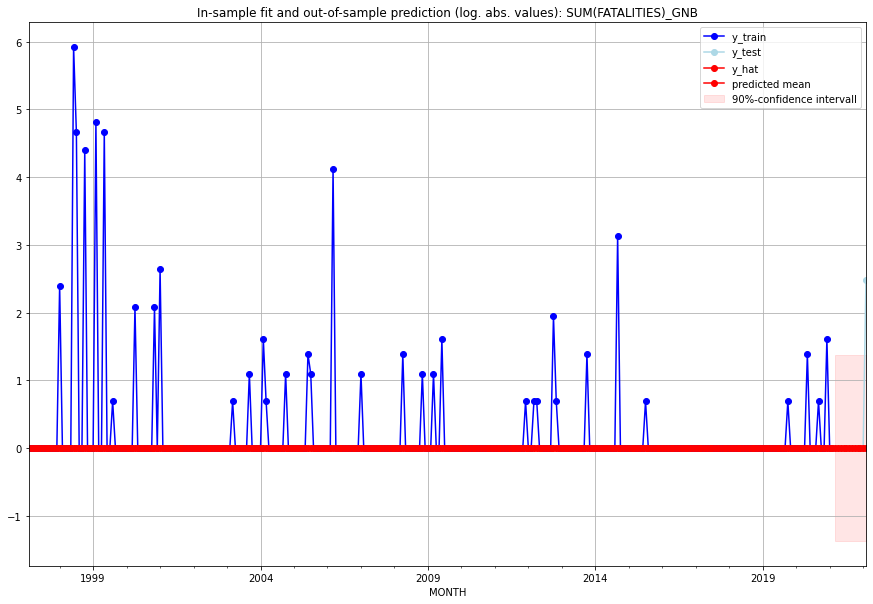

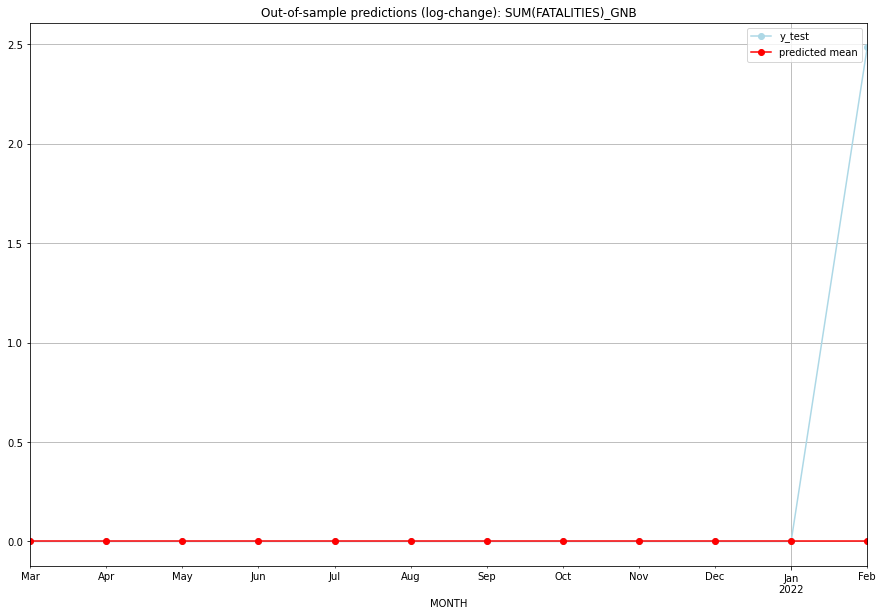

TADDA: 0.20707555414900003
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0        0.000000   GNB   
1  2021-04-01       0.0         0.0           0.0        0.000000   GNB   
2  2021-05-01       0.0         0.0           0.0        0.000000   GNB   
3  2021-06-01       0.0         0.0           0.0        0.000000   GNB   
4  2021-07-01       0.0         0.0           0.0        0.000000   GNB   
5  2021-08-01       0.0         0.0           0.0        0.000000   GNB   
6  2021-09-01       0.0         0.0           0.0        0.000000   GNB   
7  2021-10-01       0.0         0.0           0.0        0.000000   GNB   
8  2021-11-01       0.0         0.0           0.0        0.000000   GNB   
9  2021-12-01       0.0         0.0           0.0        0.000000   GNB   
10 2022-01-01       0.0         0.0           0.0        0.000000   GNB   
11 2022-02-01       0.0        11.0           0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.09438267466893244, 'fold_results': [0.0, 0.29862657820467586, 0.11552453009332421, 0.057762265046662105, 0.0]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_GNQ   No. Observations:                  289
Model:                         SARIMAX   Log Likelihood                 -50.960
Date:                 Wed, 19 Oct 2022   AIC                            103.919
Time:                         10:47:17   BIC                            107.586
Sample:                     02-28-1997   HQIC                           105.388
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------------------

<Figure size 432x288 with 0 Axes>

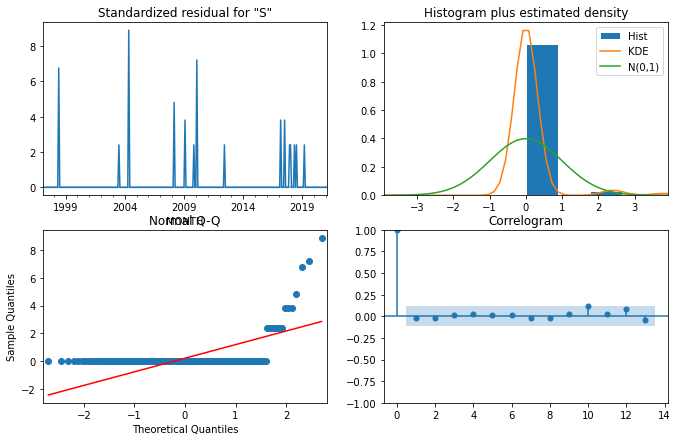

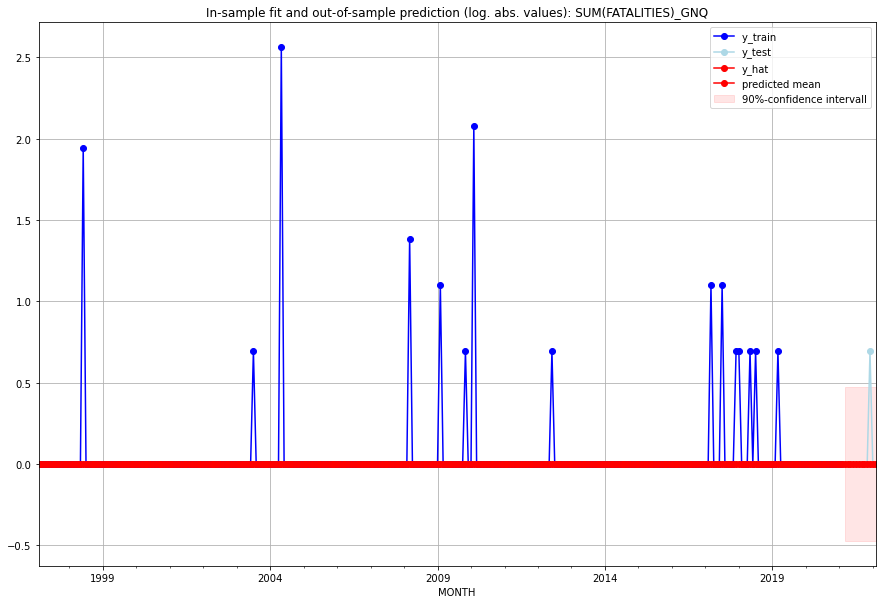

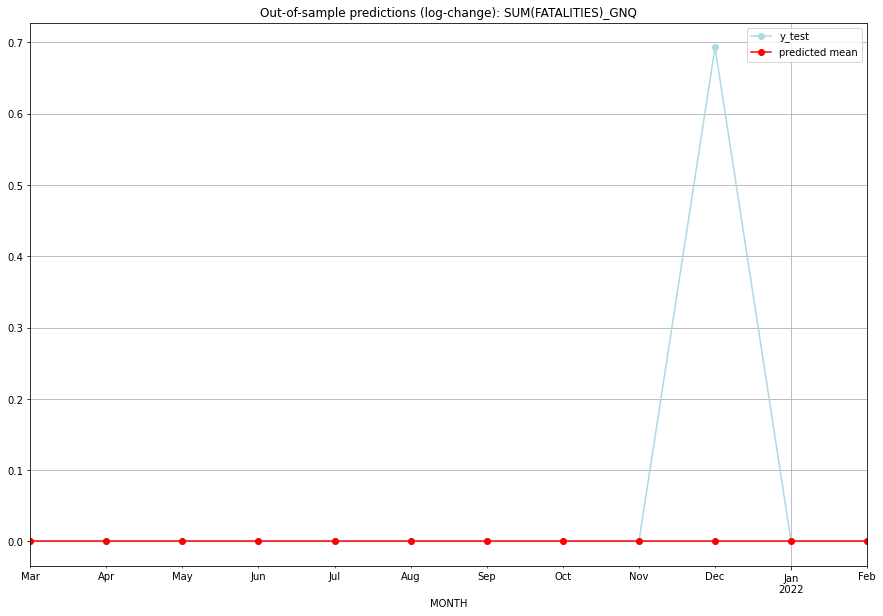

TADDA: 0.057762265046662105
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0        0.000000   GNQ   
1  2021-04-01       0.0         0.0           0.0        0.000000   GNQ   
2  2021-05-01       0.0         0.0           0.0        0.000000   GNQ   
3  2021-06-01       0.0         0.0           0.0        0.000000   GNQ   
4  2021-07-01       0.0         0.0           0.0        0.000000   GNQ   
5  2021-08-01       0.0         0.0           0.0        0.000000   GNQ   
6  2021-09-01       0.0         0.0           0.0        0.000000   GNQ   
7  2021-10-01       0.0         0.0           0.0        0.000000   GNQ   
8  2021-11-01       0.0         0.0           0.0        0.000000   GNQ   
9  2021-12-01       0.0         1.0           0.0        0.693147   GNQ   
10 2022-01-01       0.0         0.0           0.0        0.000000   GNQ   
11 2022-02-01       0.0         0.0           0.0  

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (2, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.3408982740008947, 'fold_results': [0.4053353833272412, 0.27646116467454807]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_GRC   No. Observations:                   38
Model:                SARIMAX(2, 0, 0)   Log Likelihood                 -25.337
Date:                 Wed, 19 Oct 2022   AIC                             56.673
Time:                         10:47:26   BIC                             61.586
Sample:                     01-31-2018   HQIC                            58.421
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.4607      0

<Figure size 432x288 with 0 Axes>

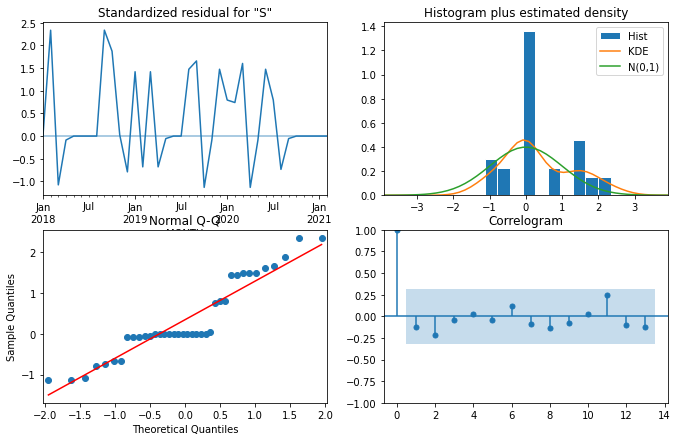

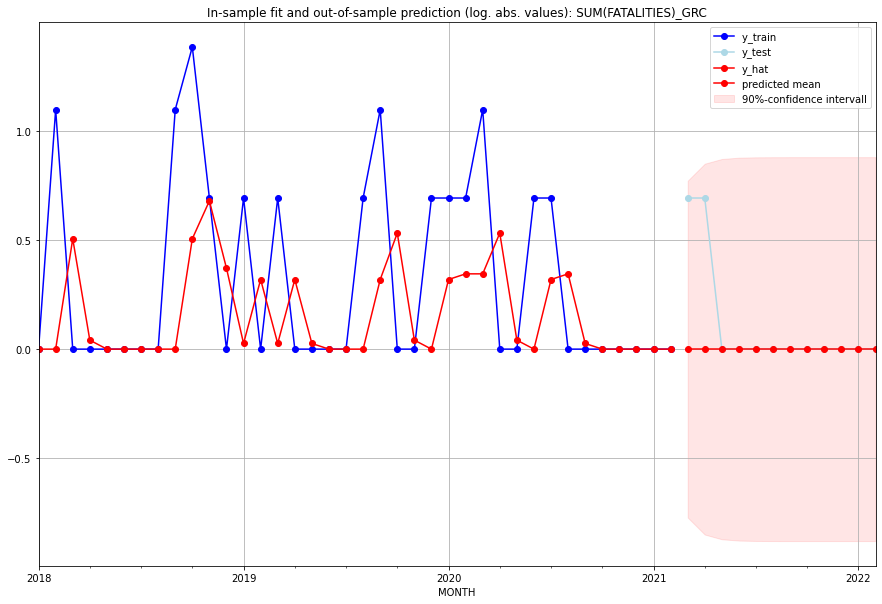

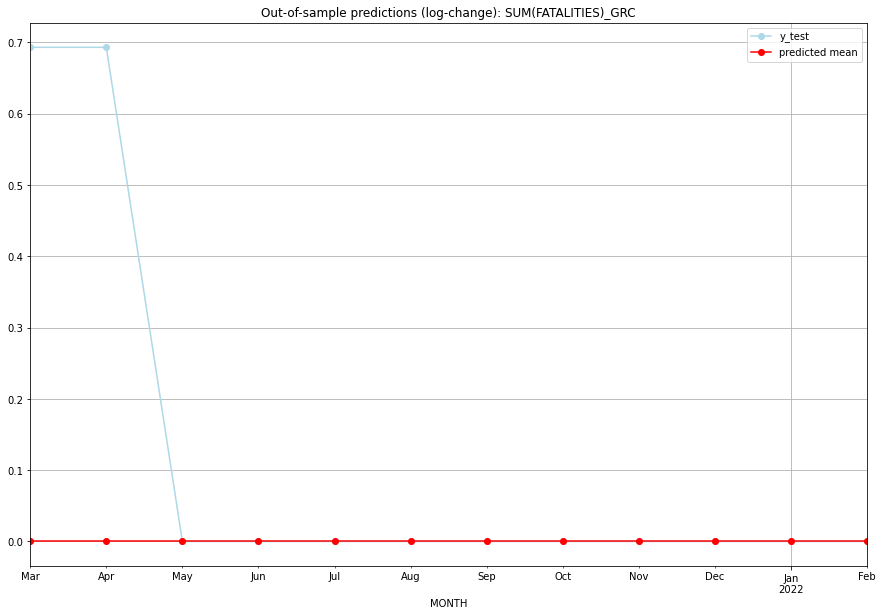

TADDA: 0.11552453009332421
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         1.0  1.065967e-54        0.693147   GRC   
1  2021-04-01       0.0         1.0  4.911165e-55        0.693147   GRC   
2  2021-05-01       0.0         0.0  2.662001e-55        0.000000   GRC   
3  2021-06-01       0.0         0.0  1.410419e-55        0.000000   GRC   
4  2021-07-01       0.0         0.0  7.495316e-56        0.000000   GRC   
5  2021-08-01       0.0         0.0  3.981612e-56        0.000000   GRC   
6  2021-09-01       0.0         0.0  2.115197e-56        0.000000   GRC   
7  2021-10-01       0.0         0.0  1.123672e-56        0.000000   GRC   
8  2021-11-01       0.0         0.0  5.969375e-57        0.000000   GRC   
9  2021-12-01       0.0         0.0  3.171159e-57        0.000000   GRC   
10 2022-01-01       0.0         0.0  1.684640e-57        0.000000   GRC   
11 2022-02-01       0.0         0.0  8.949451e-58   

<Figure size 432x288 with 0 Axes>

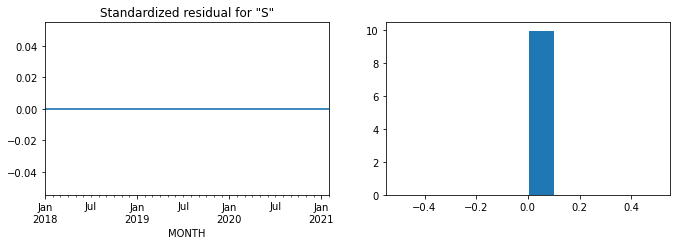

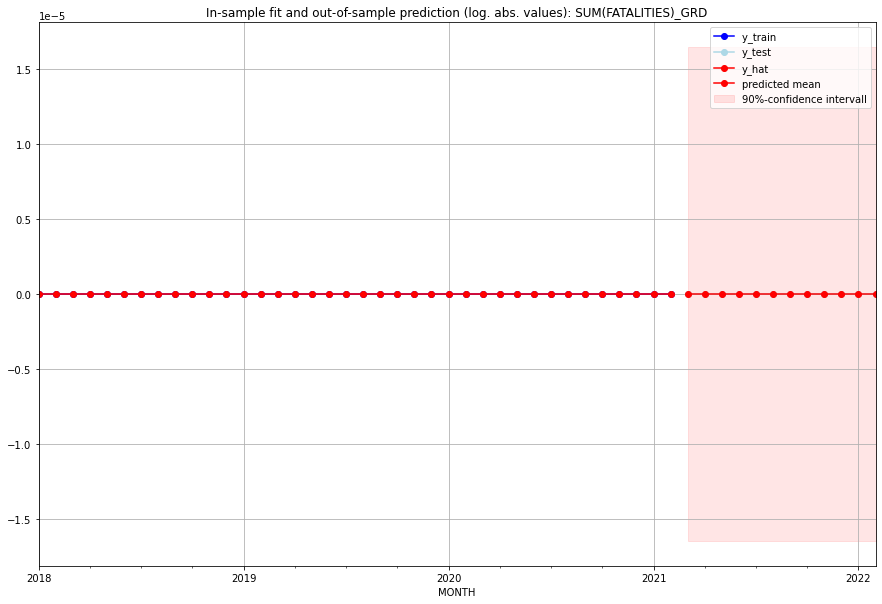

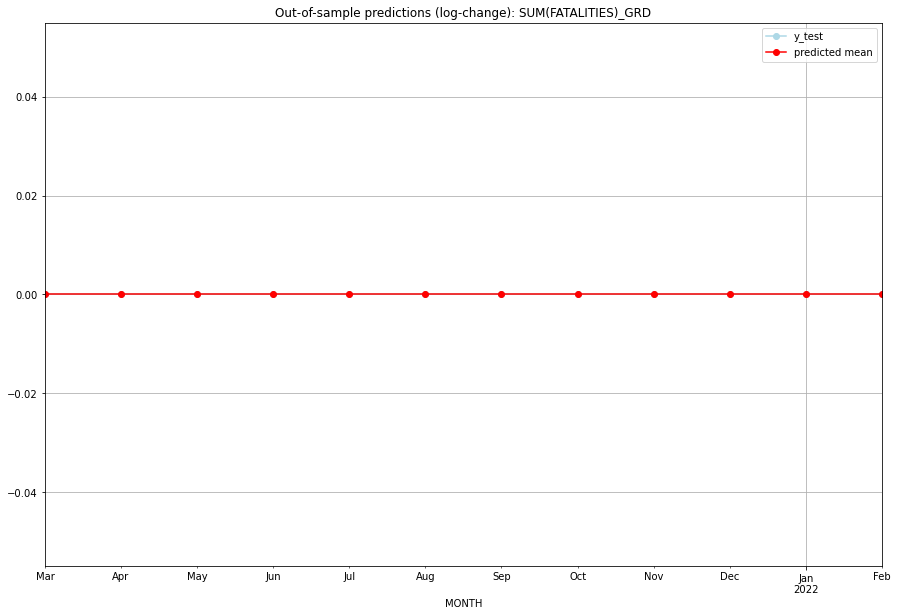

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   GRD   
1  2021-04-01       0.0         0.0           0.0             0.0   GRD   
2  2021-05-01       0.0         0.0           0.0             0.0   GRD   
3  2021-06-01       0.0         0.0           0.0             0.0   GRD   
4  2021-07-01       0.0         0.0           0.0             0.0   GRD   
5  2021-08-01       0.0         0.0           0.0             0.0   GRD   
6  2021-09-01       0.0         0.0           0.0             0.0   GRD   
7  2021-10-01       0.0         0.0           0.0             0.0   GRD   
8  2021-11-01       0.0         0.0           0.0             0.0   GRD   
9  2021-12-01       0.0         0.0           0.0             0.0   GRD   
10 2022-01-01       0.0         0.0           0.0             0.0   GRD   
11 2022-02-01       0.0         0.0           0.0             0.0   

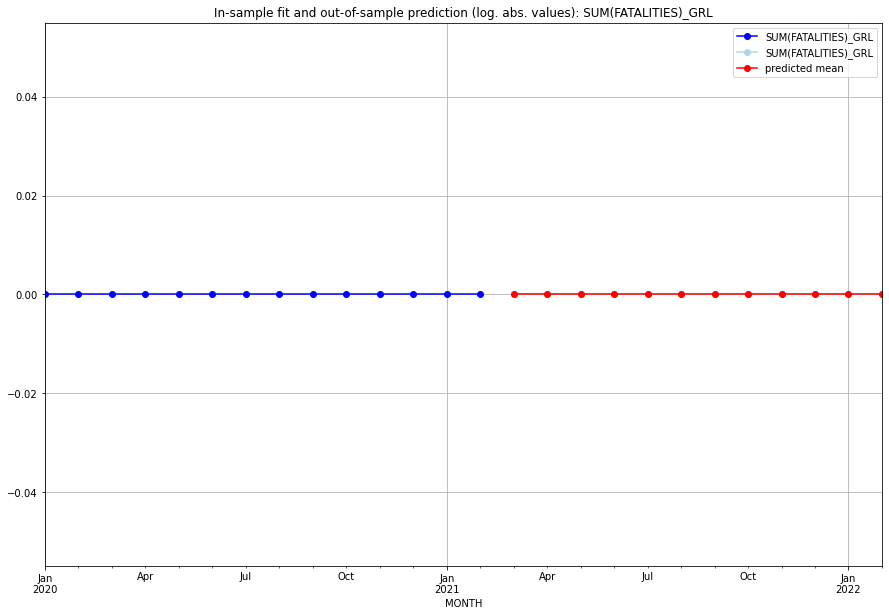

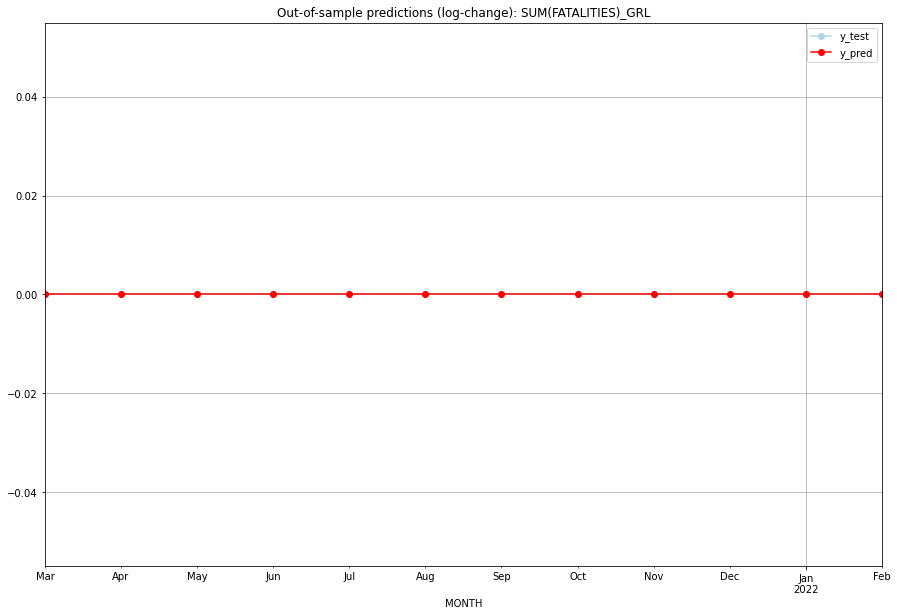

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   GRL   
1  2021-04-01       0.0         0.0           0.0             0.0   GRL   
2  2021-05-01       0.0         0.0           0.0             0.0   GRL   
3  2021-06-01       0.0         0.0           0.0             0.0   GRL   
4  2021-07-01       0.0         0.0           0.0             0.0   GRL   
5  2021-08-01       0.0         0.0           0.0             0.0   GRL   
6  2021-09-01       0.0         0.0           0.0             0.0   GRL   
7  2021-10-01       0.0         0.0           0.0             0.0   GRL   
8  2021-11-01       0.0         0.0           0.0             0.0   GRL   
9  2021-12-01       0.0         0.0           0.0             0.0   GRL   
10 2022-01-01       0.0         0.0           0.0             0.0   GRL   
11 2022-02-01       0.0         0.0           0.0             0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (2, 0, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.30681852901319223, 'fold_results': [0.1823170192759863, 0.4313200387503982]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_GTM   No. Observations:                   38
Model:                SARIMAX(2, 0, 2)   Log Likelihood                  -4.562
Date:                 Wed, 19 Oct 2022   AIC                             19.123
Time:                         10:47:54   BIC                             27.311
Sample:                     01-31-2018   HQIC                            22.036
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.0016      0

<Figure size 432x288 with 0 Axes>

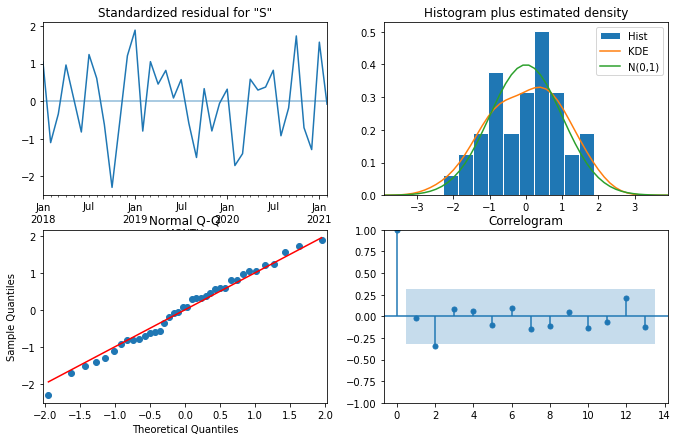

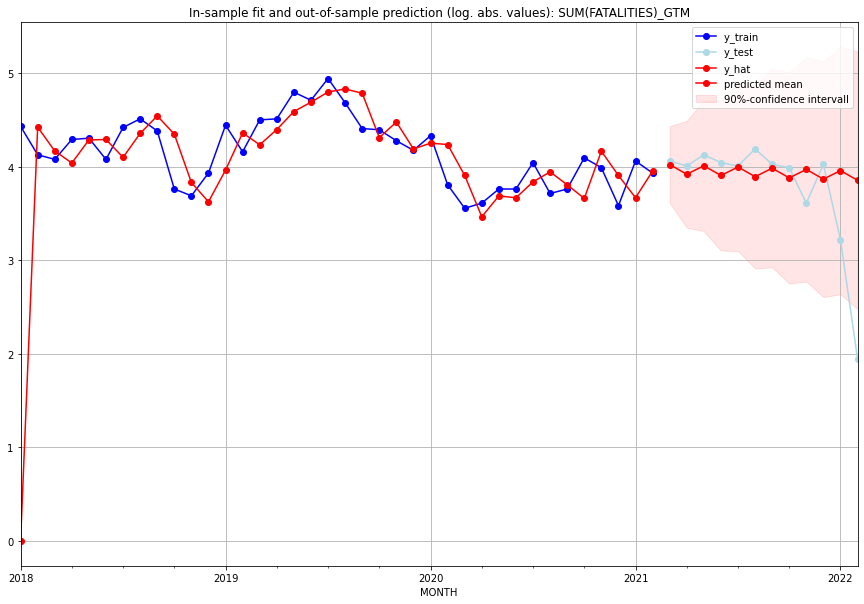

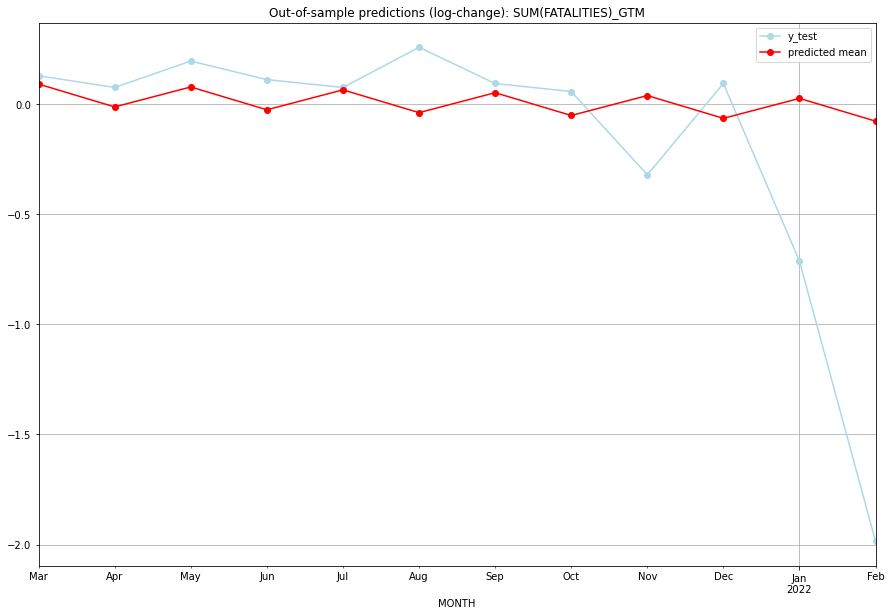

TADDA: 0.3552144940004633
Evaluation finished.
        MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  54.846595        57.0      0.090783        0.128617   GTM   
1  2021-04-01  49.351155        54.0     -0.012804        0.075508   GTM   
2  2021-05-01  54.122011        61.0      0.077723        0.195309   GTM   
3  2021-06-01  48.699823        56.0     -0.025824        0.111226   GTM   
4  2021-07-01  53.409160        54.0      0.064707        0.075508   GTM   
5  2021-08-01  48.059016        65.0     -0.038802        0.257829   GTM   
6  2021-09-01  52.707822        55.0      0.051733        0.093526   GTM   
7  2021-10-01  47.428537        53.0     -0.051736        0.057158   GTM   
8  2021-11-01  52.017782        36.0      0.038802       -0.320908   GTM   
9  2021-12-01  46.808192        55.0     -0.064629        0.093526   GTM   
10 2022-01-01  51.338828        24.0      0.025913       -0.712950   GTM   
11 2022-02-01  46.197792         6.0     

<Figure size 432x288 with 0 Axes>

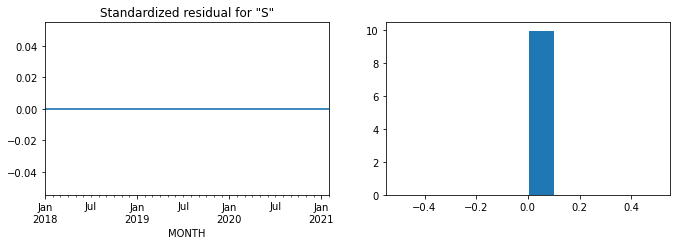

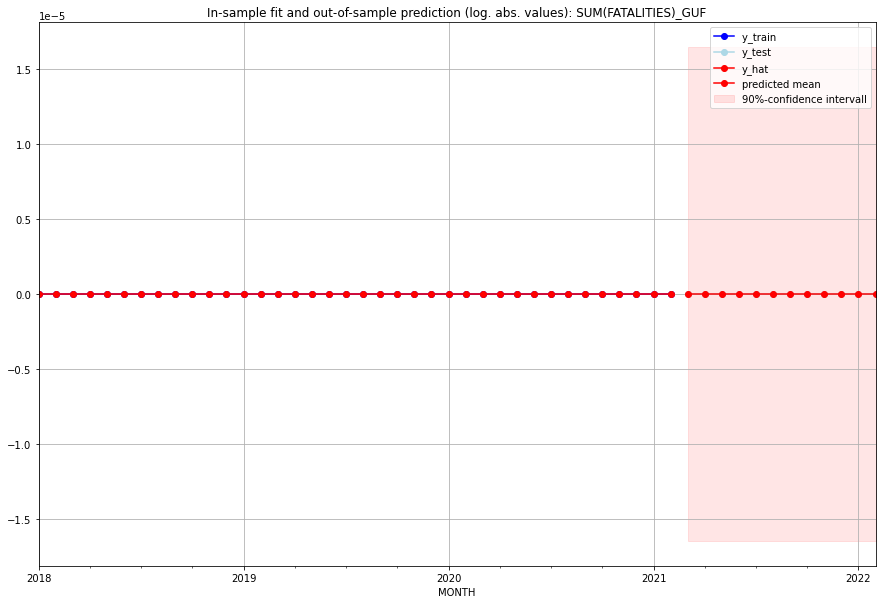

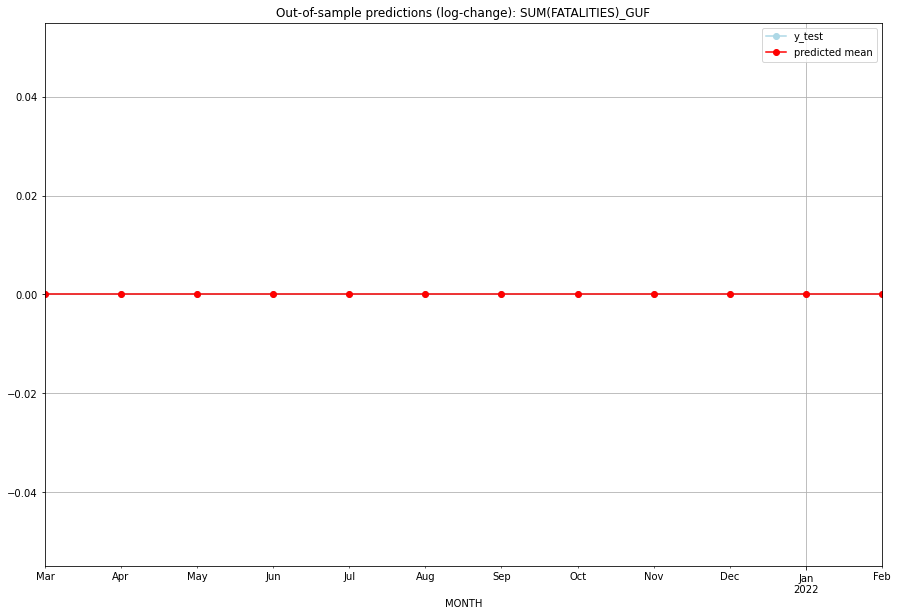

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   GUF   
1  2021-04-01       0.0         0.0           0.0             0.0   GUF   
2  2021-05-01       0.0         0.0           0.0             0.0   GUF   
3  2021-06-01       0.0         0.0           0.0             0.0   GUF   
4  2021-07-01       0.0         0.0           0.0             0.0   GUF   
5  2021-08-01       0.0         0.0           0.0             0.0   GUF   
6  2021-09-01       0.0         0.0           0.0             0.0   GUF   
7  2021-10-01       0.0         0.0           0.0             0.0   GUF   
8  2021-11-01       0.0         0.0           0.0             0.0   GUF   
9  2021-12-01       0.0         0.0           0.0             0.0   GUF   
10 2022-01-01       0.0         0.0           0.0             0.0   GUF   
11 2022-02-01       0.0         0.0           0.0             0.0   

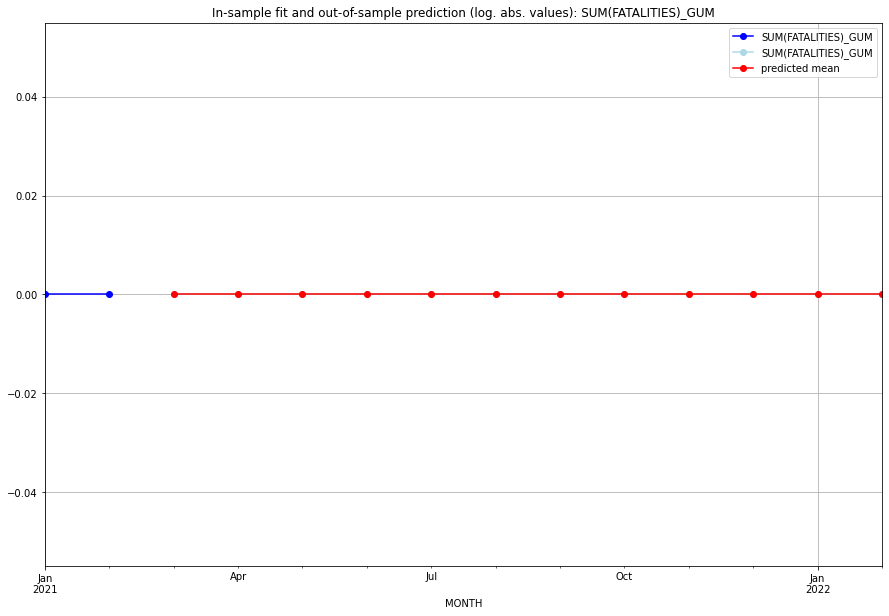

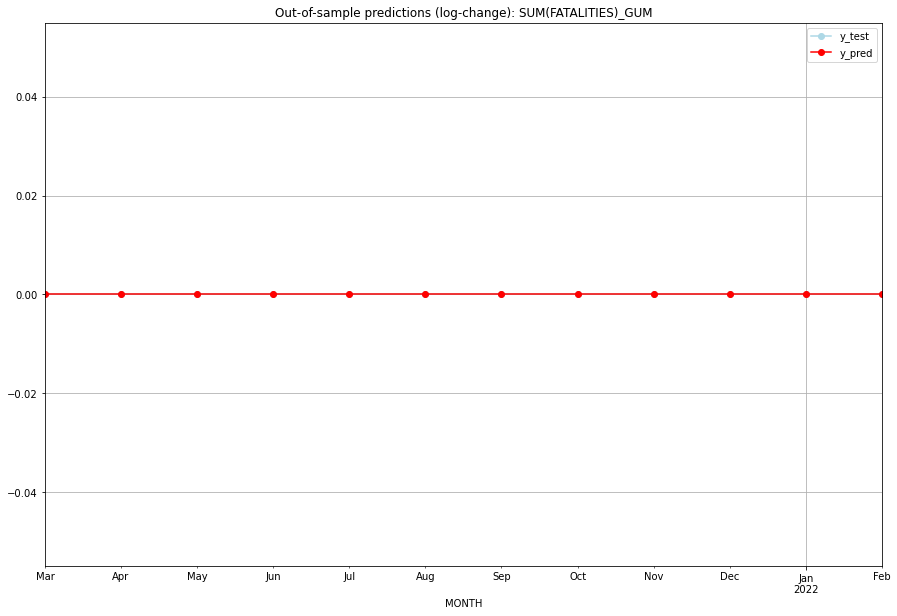

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   GUM   
1  2021-04-01       0.0         0.0           0.0             0.0   GUM   
2  2021-05-01       0.0         0.0           0.0             0.0   GUM   
3  2021-06-01       0.0         0.0           0.0             0.0   GUM   
4  2021-07-01       0.0         0.0           0.0             0.0   GUM   
5  2021-08-01       0.0         0.0           0.0             0.0   GUM   
6  2021-09-01       0.0         0.0           0.0             0.0   GUM   
7  2021-10-01       0.0         0.0           0.0             0.0   GUM   
8  2021-11-01       0.0         0.0           0.0             0.0   GUM   
9  2021-12-01       0.0         0.0           0.0             0.0   GUM   
10 2022-01-01       0.0         0.0           0.0             0.0   GUM   
11 2022-02-01       0.0         0.0           0.0             0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.12482217806474963, 'fold_results': [0.057762265046662105, 0.19188209108283716]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_GUY   No. Observations:                   38
Model:                         SARIMAX   Log Likelihood                 -13.434
Date:                 Wed, 19 Oct 2022   AIC                             28.868
Time:                         10:48:18   BIC                             30.506
Sample:                     01-31-2018   HQIC                            29.451
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.1187    

<Figure size 432x288 with 0 Axes>

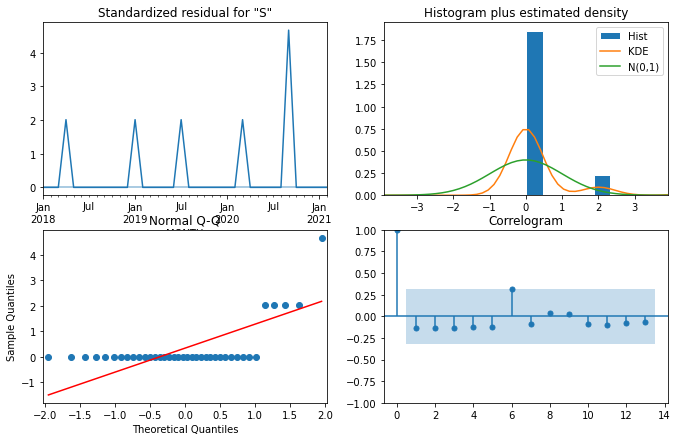

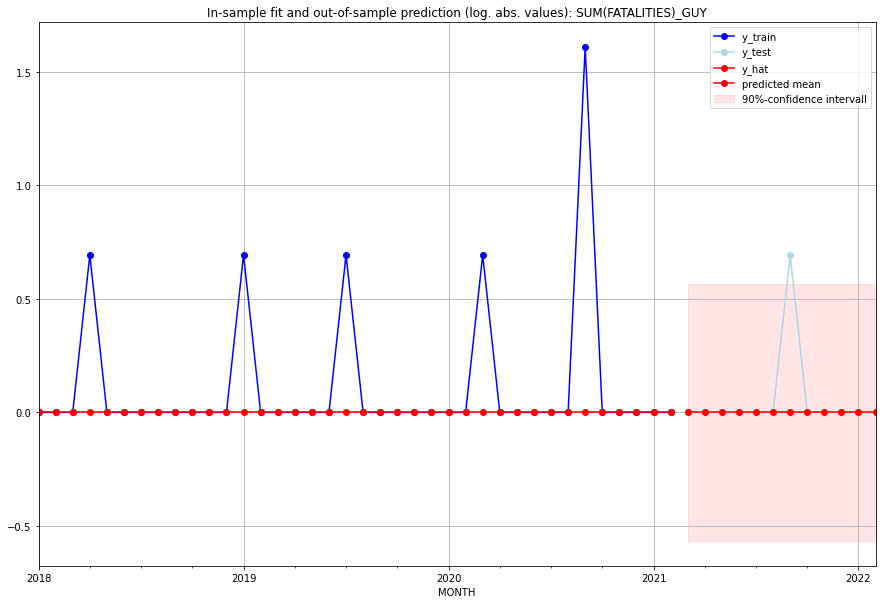

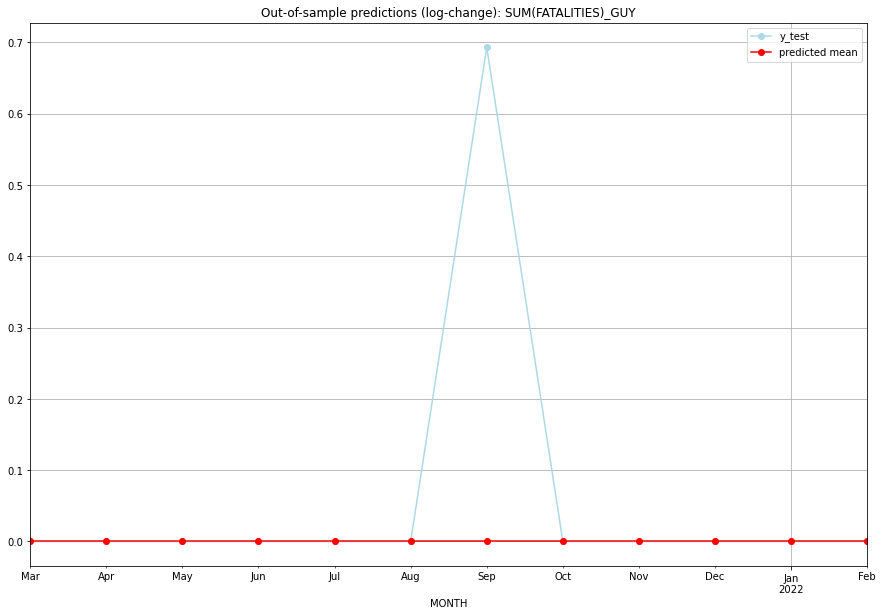

TADDA: 0.057762265046662105
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0        0.000000   GUY   
1  2021-04-01       0.0         0.0           0.0        0.000000   GUY   
2  2021-05-01       0.0         0.0           0.0        0.000000   GUY   
3  2021-06-01       0.0         0.0           0.0        0.000000   GUY   
4  2021-07-01       0.0         0.0           0.0        0.000000   GUY   
5  2021-08-01       0.0         0.0           0.0        0.000000   GUY   
6  2021-09-01       0.0         1.0           0.0        0.693147   GUY   
7  2021-10-01       0.0         0.0           0.0        0.000000   GUY   
8  2021-11-01       0.0         0.0           0.0        0.000000   GUY   
9  2021-12-01       0.0         0.0           0.0        0.000000   GUY   
10 2022-01-01       0.0         0.0           0.0        0.000000   GUY   
11 2022-02-01       0.0         0.0           0.0  

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [2, (0, 1, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.0, 'fold_results': [nan, 0.0]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_HKG   No. Observations:                   38
Model:                SARIMAX(0, 1, 3)   Log Likelihood                  27.679
Date:                 Wed, 19 Oct 2022   AIC                            -43.357
Time:                         10:48:34   BIC                            -33.692
Sample:                     01-31-2018   HQIC                           -39.950
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             0.0002      0.031      0.008      0.994      -0.061       0

<Figure size 432x288 with 0 Axes>

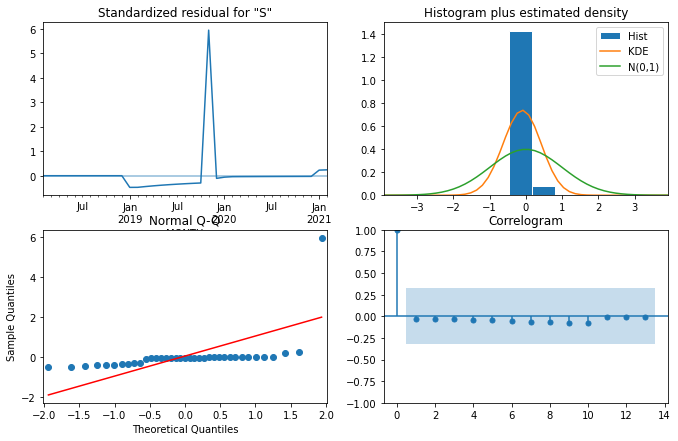

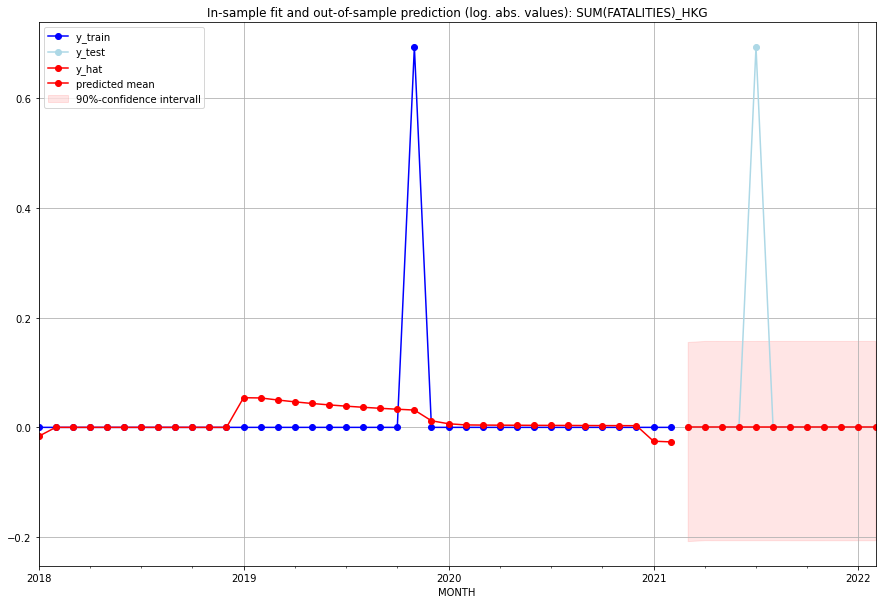

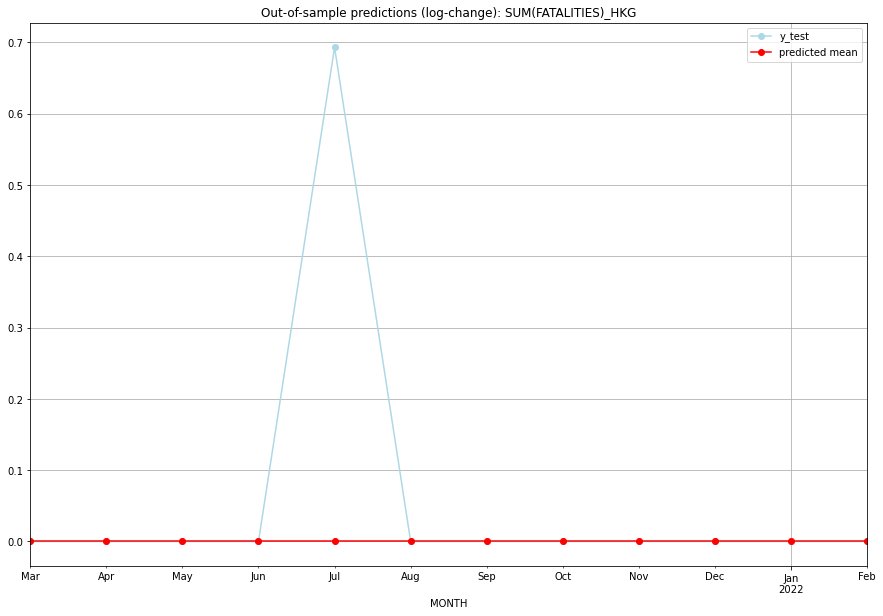

TADDA: 0.057762265046662105
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0        0.000000   HKG   
1  2021-04-01       0.0         0.0           0.0        0.000000   HKG   
2  2021-05-01       0.0         0.0           0.0        0.000000   HKG   
3  2021-06-01       0.0         0.0           0.0        0.000000   HKG   
4  2021-07-01       0.0         1.0           0.0        0.693147   HKG   
5  2021-08-01       0.0         0.0           0.0        0.000000   HKG   
6  2021-09-01       0.0         0.0           0.0        0.000000   HKG   
7  2021-10-01       0.0         0.0           0.0        0.000000   HKG   
8  2021-11-01       0.0         0.0           0.0        0.000000   HKG   
9  2021-12-01       0.0         0.0           0.0        0.000000   HKG   
10 2022-01-01       0.0         0.0           0.0        0.000000   HKG   
11 2022-02-01       0.0         0.0           0.0  

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [1, (0, 1, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.28935944097117877, 'fold_results': [nan, 0.28935944097117877]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_HND   No. Observations:                   38
Model:                SARIMAX(0, 1, 3)   Log Likelihood                  -9.453
Date:                 Wed, 19 Oct 2022   AIC                             28.907
Time:                         10:48:52   BIC                             36.962
Sample:                     01-31-2018   HQIC                            31.747
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -0.0411      0.038     -1.08

<Figure size 432x288 with 0 Axes>

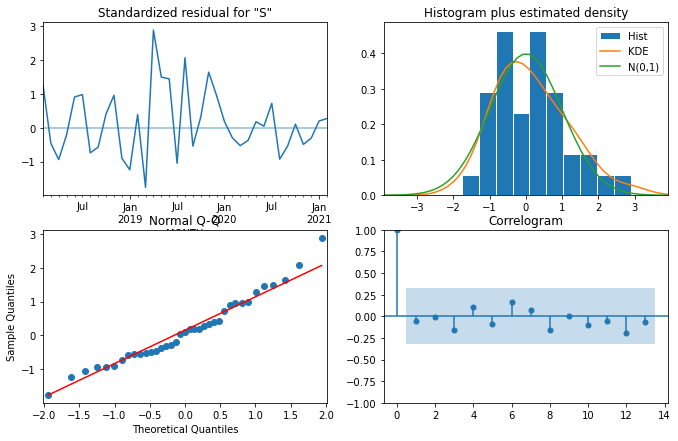

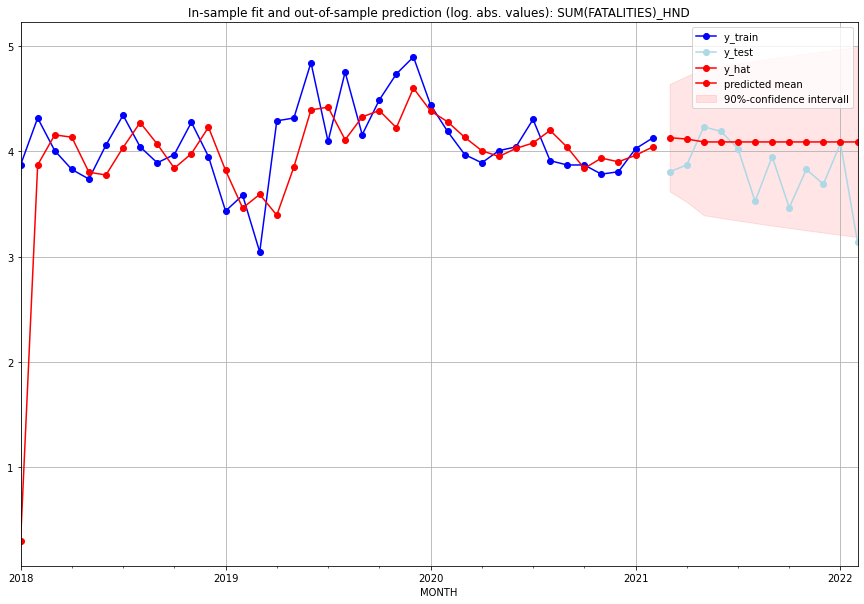

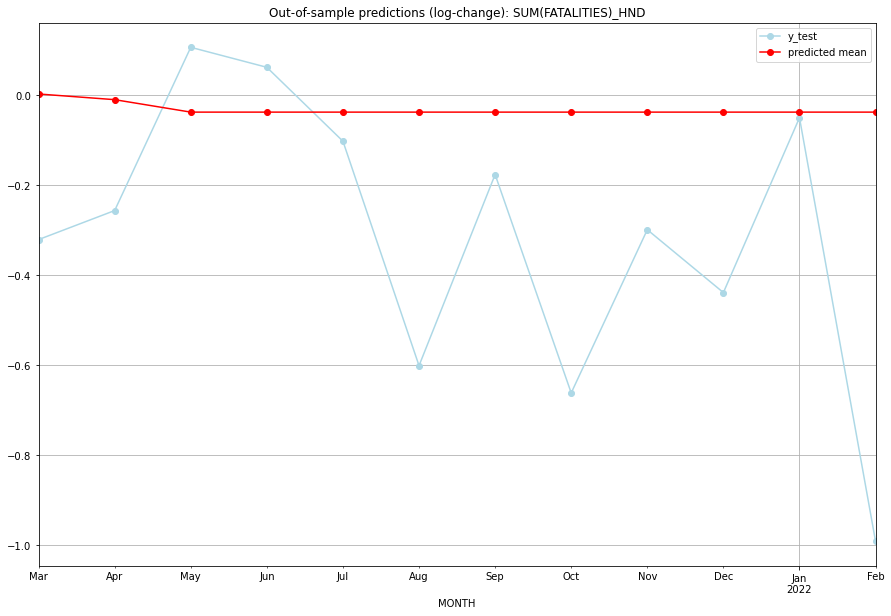

TADDA: 0.32601987622961276
Evaluation finished.
        MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  61.198160        44.0      0.003191       -0.320472   HND   
1  2021-04-01  60.418798        47.0     -0.009418       -0.255933   HND   
2  2021-05-01  58.741146        68.0     -0.037113        0.106972   HND   
3  2021-06-01  58.741146        65.0     -0.037113        0.062520   HND   
4  2021-07-01  58.741146        55.0     -0.037113       -0.101783   HND   
5  2021-08-01  58.741146        33.0     -0.037113       -0.600774   HND   
6  2021-09-01  58.741146        51.0     -0.037113       -0.175891   HND   
7  2021-10-01  58.741146        31.0     -0.037113       -0.661398   HND   
8  2021-11-01  58.741146        45.0     -0.037113       -0.298493   HND   
9  2021-12-01  58.741146        39.0     -0.037113       -0.438255   HND   
10 2022-01-01  58.741146        58.0     -0.037113       -0.049597   HND   
11 2022-02-01  58.741146        22.0    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 1, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.0, 'fold_results': [nan, 0.0]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_HRV   No. Observations:                   38
Model:                SARIMAX(0, 1, 3)   Log Likelihood                  14.618
Date:                 Wed, 19 Oct 2022   AIC                            -21.236
Time:                         10:49:09   BIC                            -14.792
Sample:                     01-31-2018   HQIC                           -18.964
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ma.L1         -0.7319      0.133     -5.518      0.000      -0.992      -0

<Figure size 432x288 with 0 Axes>

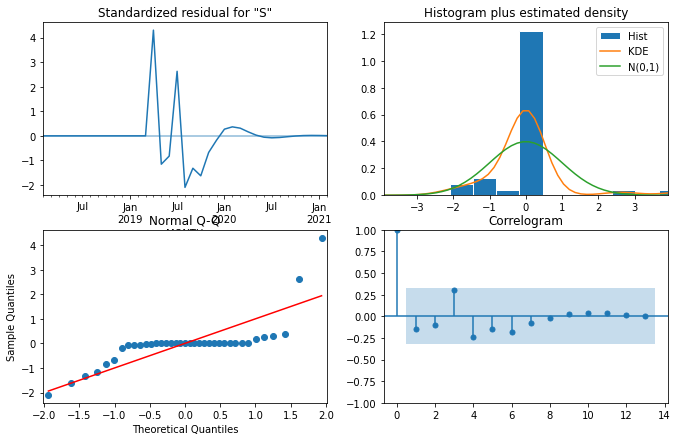

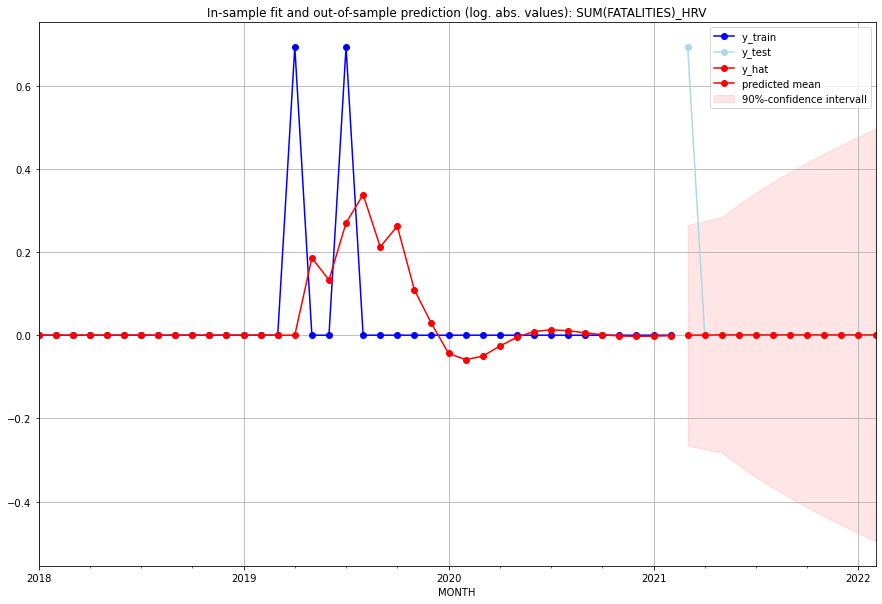

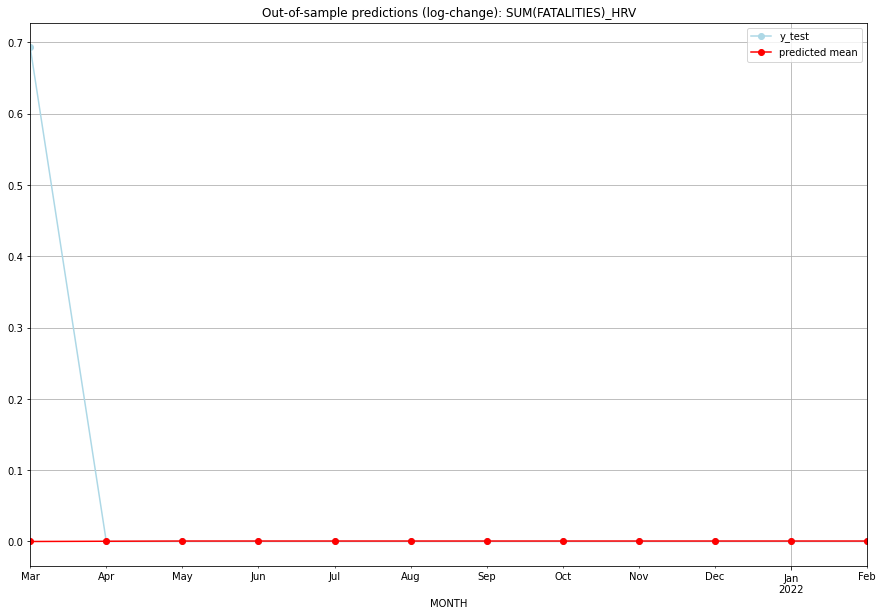

TADDA: 0.058333509986322966
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  0.000000         1.0      0.000000        0.693147   HRV   
1  2021-04-01  0.000344         0.0      0.000344        0.000000   HRV   
2  2021-05-01  0.000651         0.0      0.000651        0.000000   HRV   
3  2021-06-01  0.000651         0.0      0.000651        0.000000   HRV   
4  2021-07-01  0.000651         0.0      0.000651        0.000000   HRV   
5  2021-08-01  0.000651         0.0      0.000651        0.000000   HRV   
6  2021-09-01  0.000651         0.0      0.000651        0.000000   HRV   
7  2021-10-01  0.000651         0.0      0.000651        0.000000   HRV   
8  2021-11-01  0.000651         0.0      0.000651        0.000000   HRV   
9  2021-12-01  0.000651         0.0      0.000651        0.000000   HRV   
10 2022-01-01  0.000651         0.0      0.000651        0.000000   HRV   
11 2022-02-01  0.000651         0.0      0.000651  

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 1, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.3845760533641086, 'fold_results': [0.41844846350057546, 0.35070364322764175]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_HTI   No. Observations:                   38
Model:                SARIMAX(0, 1, 2)   Log Likelihood                 -43.012
Date:                 Wed, 19 Oct 2022   AIC                             92.024
Time:                         10:49:23   BIC                             96.857
Sample:                     01-31-2018   HQIC                            93.728
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ma.L1         -0.7979      

<Figure size 432x288 with 0 Axes>

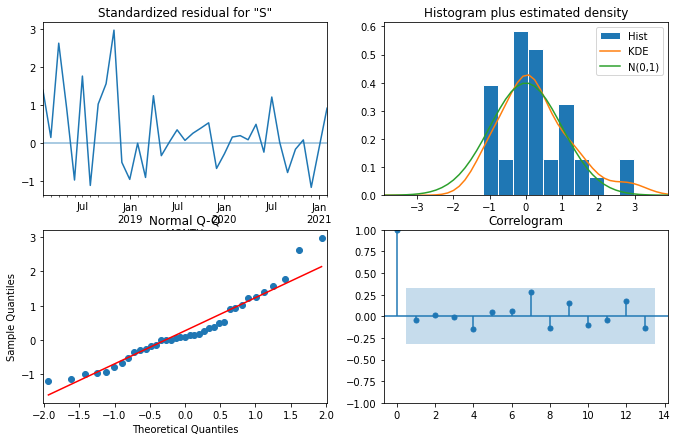

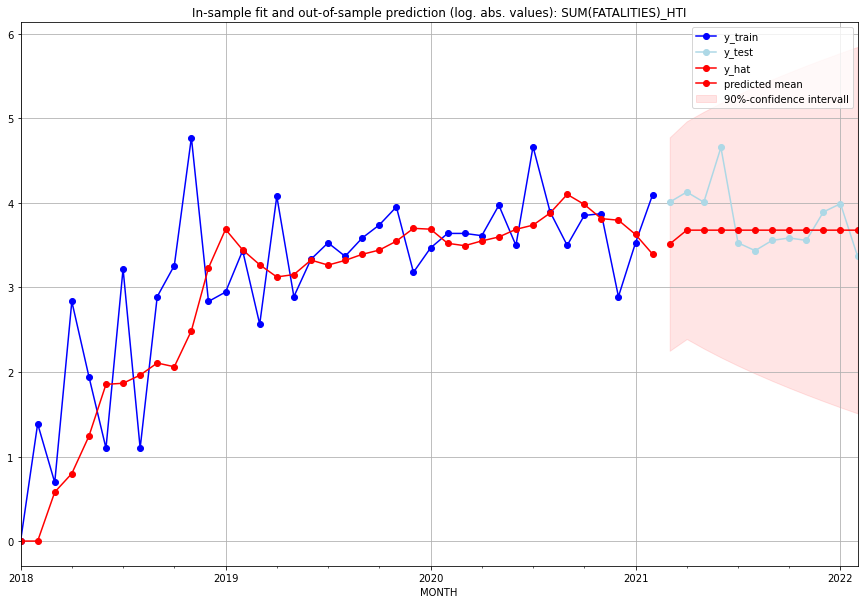

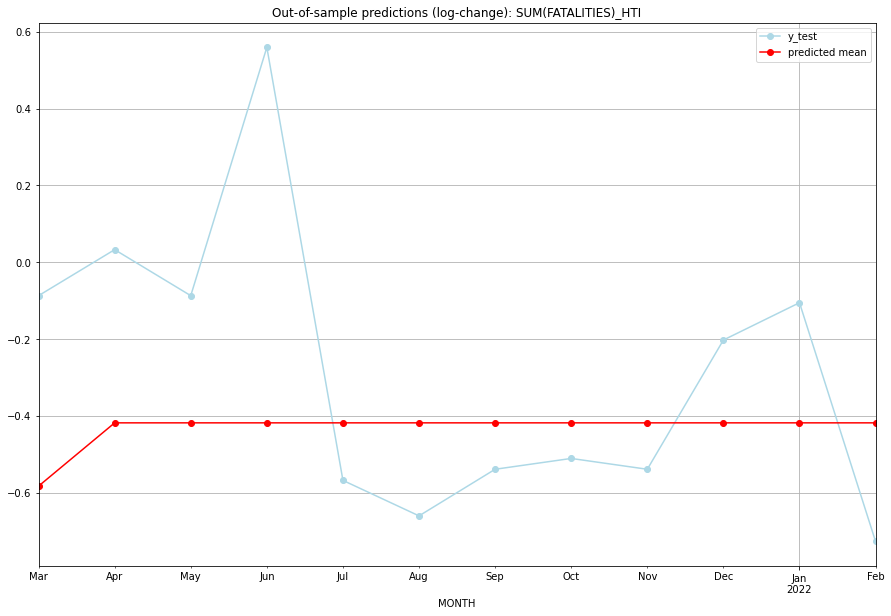

TADDA: 0.38797375870747003
Evaluation finished.
        MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  32.498861        54.0     -0.582833       -0.087011   HTI   
1  2021-04-01  38.496000        61.0     -0.418145        0.032790   HTI   
2  2021-05-01  38.496000        54.0     -0.418145       -0.087011   HTI   
3  2021-06-01  38.496000       104.0     -0.418145        0.559616   HTI   
4  2021-07-01  38.496000        33.0     -0.418145       -0.567984   HTI   
5  2021-08-01  38.496000        30.0     -0.418145       -0.660357   HTI   
6  2021-09-01  38.496000        34.0     -0.418145       -0.538997   HTI   
7  2021-10-01  38.496000        35.0     -0.418145       -0.510826   HTI   
8  2021-11-01  38.496000        34.0     -0.418145       -0.538997   HTI   
9  2021-12-01  38.496000        48.0     -0.418145       -0.202524   HTI   
10 2022-01-01  38.496000        53.0     -0.418145       -0.105361   HTI   
11 2022-02-01  38.496000        28.0    

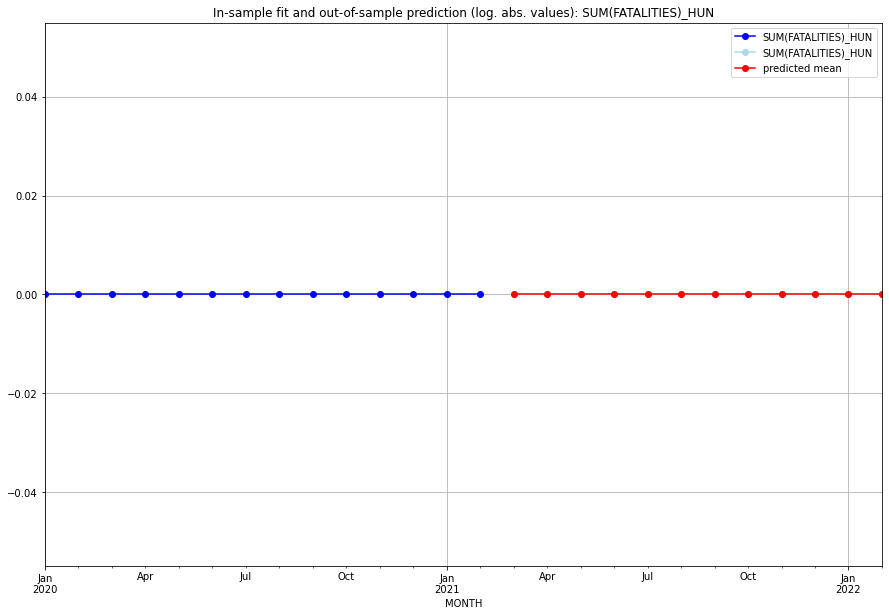

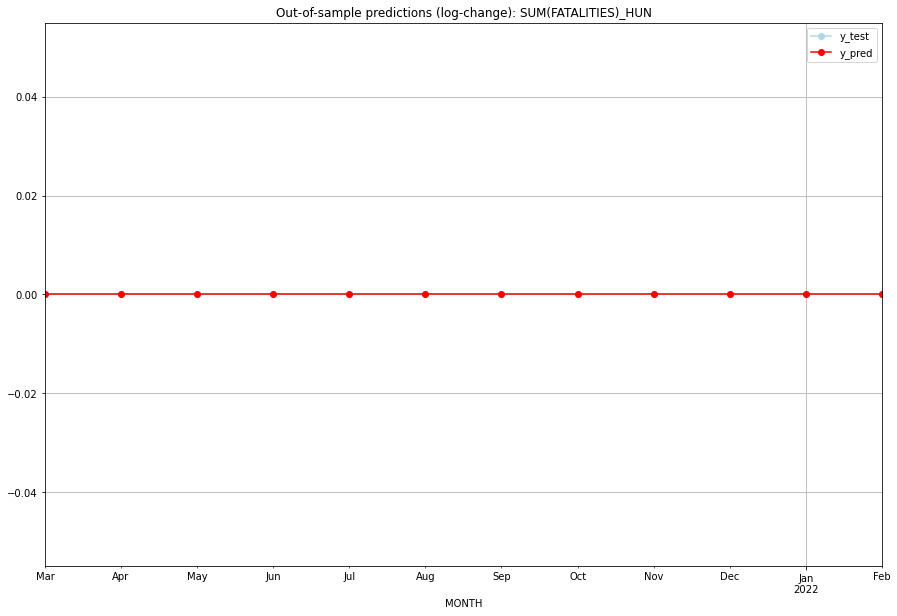

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   HUN   
1  2021-04-01       0.0         0.0           0.0             0.0   HUN   
2  2021-05-01       0.0         0.0           0.0             0.0   HUN   
3  2021-06-01       0.0         0.0           0.0             0.0   HUN   
4  2021-07-01       0.0         0.0           0.0             0.0   HUN   
5  2021-08-01       0.0         0.0           0.0             0.0   HUN   
6  2021-09-01       0.0         0.0           0.0             0.0   HUN   
7  2021-10-01       0.0         0.0           0.0             0.0   HUN   
8  2021-11-01       0.0         0.0           0.0             0.0   HUN   
9  2021-12-01       0.0         0.0           0.0             0.0   HUN   
10 2022-01-01       0.0         0.0           0.0             0.0   HUN   
11 2022-02-01       0.0         0.0           0.0             0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (1, 1, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.6985887919514409, 'fold_results': [0.6728996860684965, 0.5545674947198648, 1.1585582264805157, 0.6866712640528951, 0.4202472884354321]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_IDN   No. Observations:                   74
Model:                SARIMAX(1, 1, 2)   Log Likelihood                 -86.430
Date:                 Wed, 19 Oct 2022   AIC                            180.860
Time:                         10:49:46   BIC                            190.022
Sample:                     01-31-2015   HQIC                           184.512
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------

<Figure size 432x288 with 0 Axes>

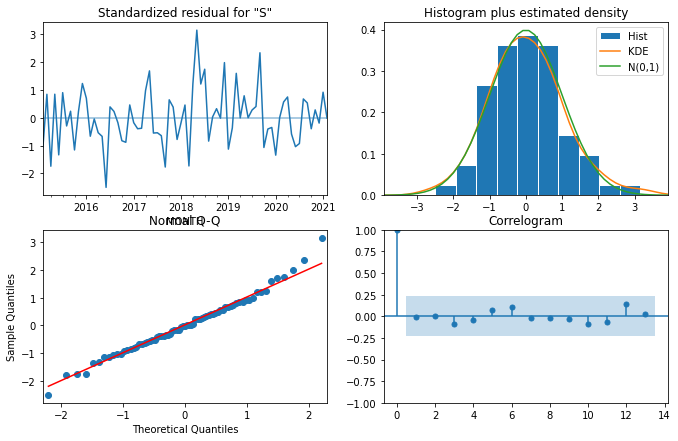

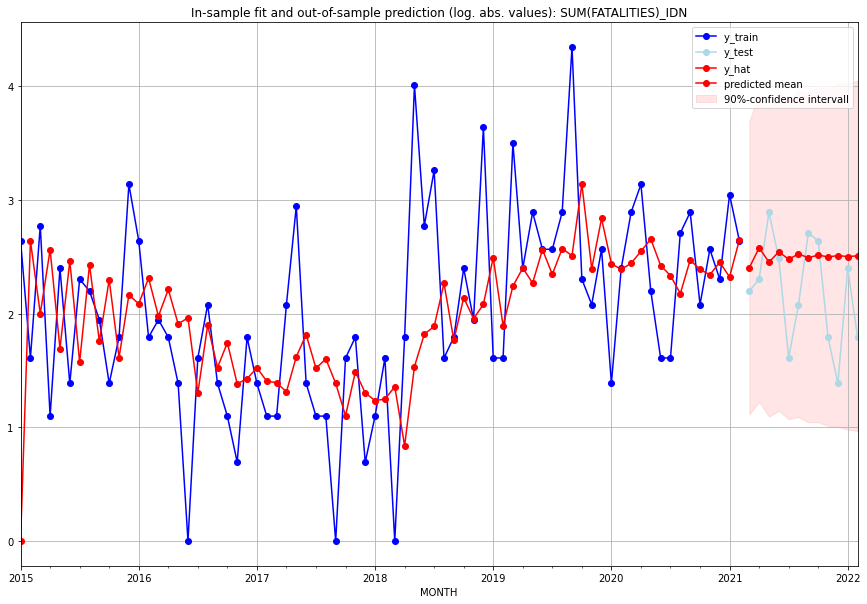

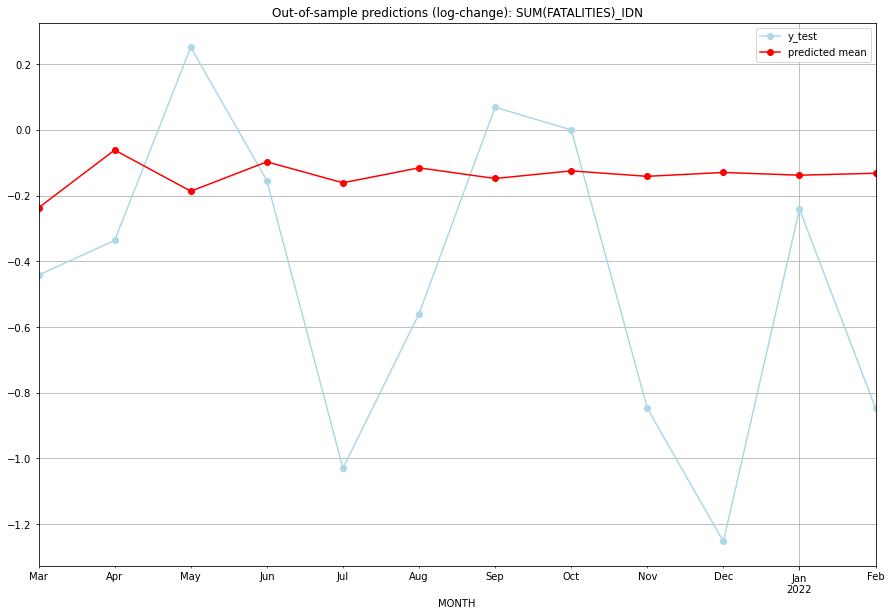

TADDA: 0.4676341984295646
Evaluation finished.
        MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  10.045308         8.0     -0.237052       -0.441833   IDN   
1  2021-04-01  12.167611         9.0     -0.061297       -0.336472   IDN   
2  2021-05-01  10.616349        17.0     -0.186644        0.251314   IDN   
3  2021-06-01  11.702638        11.0     -0.097248       -0.154151   IDN   
4  2021-07-01  10.918039         4.0     -0.161004       -1.029619   IDN   
5  2021-08-01  11.472469         7.0     -0.115534       -0.559616   IDN   
6  2021-09-01  11.074484        14.0     -0.147963        0.068993   IDN   
7  2021-10-01  11.357001        13.0     -0.124835        0.000000   IDN   
8  2021-11-01  11.154845         5.0     -0.141329       -0.847298   IDN   
9  2021-12-01  11.298679         3.0     -0.129565       -1.252763   IDN   
10 2022-01-01  11.195925        10.0     -0.137955       -0.241162   IDN   
11 2022-02-01  11.269120         5.0     

<Figure size 432x288 with 0 Axes>

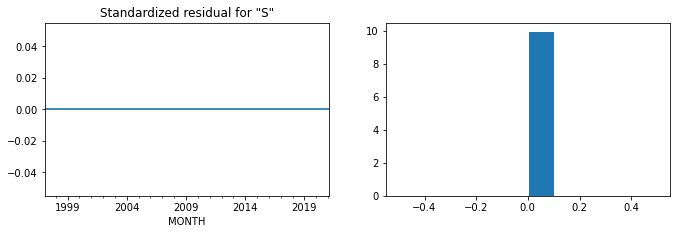

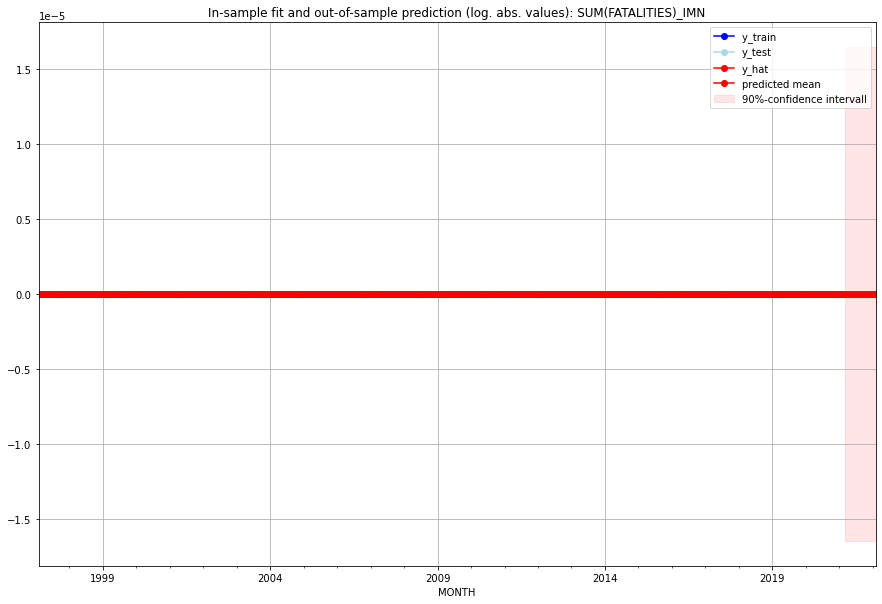

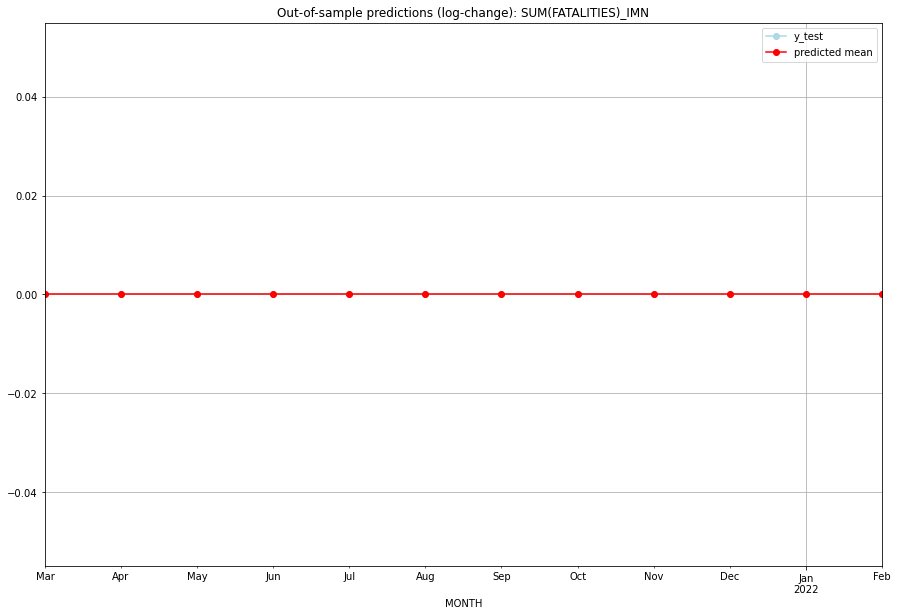

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   IMN   
1  2021-04-01       0.0         0.0           0.0             0.0   IMN   
2  2021-05-01       0.0         0.0           0.0             0.0   IMN   
3  2021-06-01       0.0         0.0           0.0             0.0   IMN   
4  2021-07-01       0.0         0.0           0.0             0.0   IMN   
5  2021-08-01       0.0         0.0           0.0             0.0   IMN   
6  2021-09-01       0.0         0.0           0.0             0.0   IMN   
7  2021-10-01       0.0         0.0           0.0             0.0   IMN   
8  2021-11-01       0.0         0.0           0.0             0.0   IMN   
9  2021-12-01       0.0         0.0           0.0             0.0   IMN   
10 2022-01-01       0.0         0.0           0.0             0.0   IMN   
11 2022-02-01       0.0         0.0           0.0             0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (1, 0, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.2607711016104753, 'fold_results': [0.19467567270162034, 0.24764741145677394, 0.3322746838725883, 0.26848663841091863]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_IND   No. Observations:                   62
Model:                SARIMAX(1, 0, 3)   Log Likelihood                 -13.168
Date:                 Wed, 19 Oct 2022   AIC                             42.337
Time:                         10:50:15   BIC                             59.354
Sample:                     01-31-2016   HQIC                            49.018
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------

<Figure size 432x288 with 0 Axes>

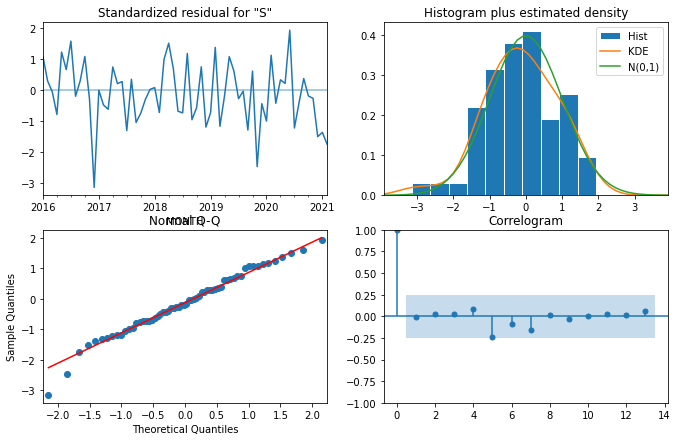

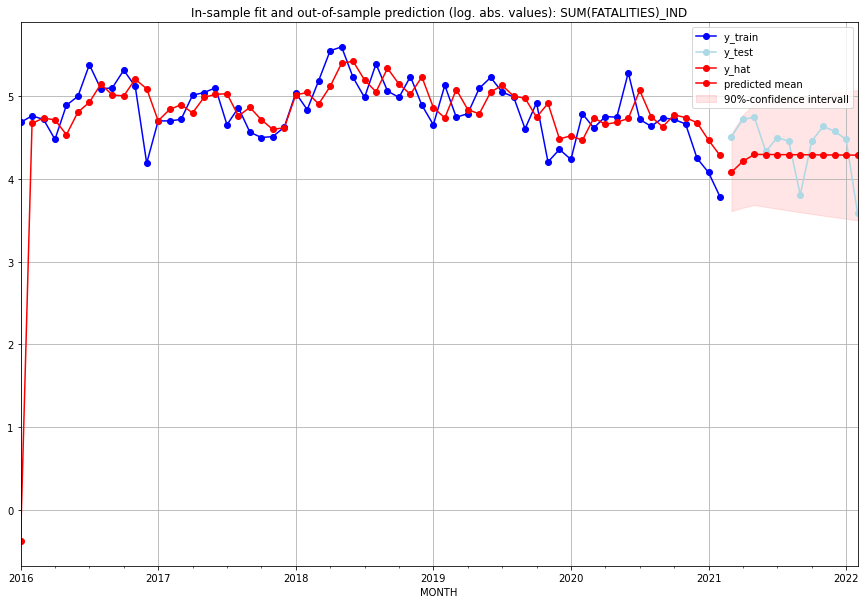

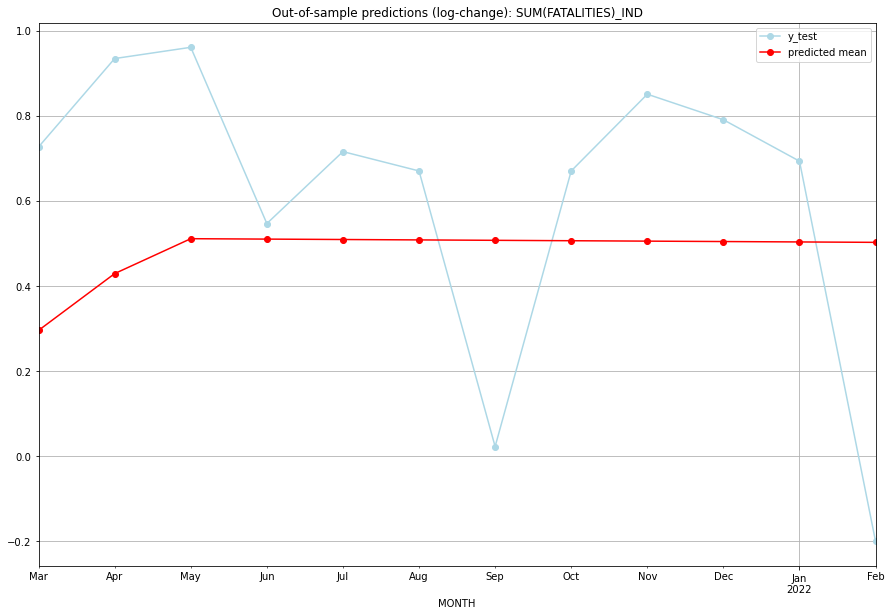

TADDA: 0.37224309412627204
Evaluation finished.
        MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  58.129567        90.0      0.295541        0.726670   IND   
1  2021-04-01  66.567790       111.0      0.428942        0.934309   IND   
2  2021-05-01  72.342748       114.0      0.510954        0.960742   IND   
3  2021-06-01  72.272637        75.0      0.509998        0.546544   IND   
4  2021-07-01  72.202610        89.0      0.509041        0.715620   IND   
5  2021-08-01  72.132665        85.0      0.508085        0.670158   IND   
6  2021-09-01  72.062805        44.0      0.507130        0.022473   IND   
7  2021-10-01  71.993027        85.0      0.506174        0.670158   IND   
8  2021-11-01  71.923332       102.0      0.505219        0.850539   IND   
9  2021-12-01  71.853720        96.0      0.504264        0.790521   IND   
10 2022-01-01  71.784190        87.0      0.503309        0.693147   IND   
11 2022-02-01  71.714743        35.0    

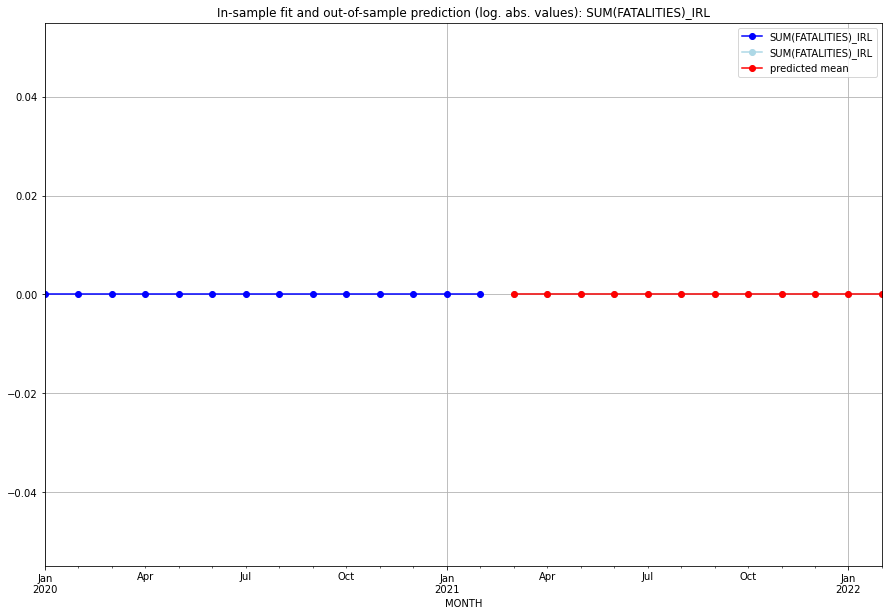

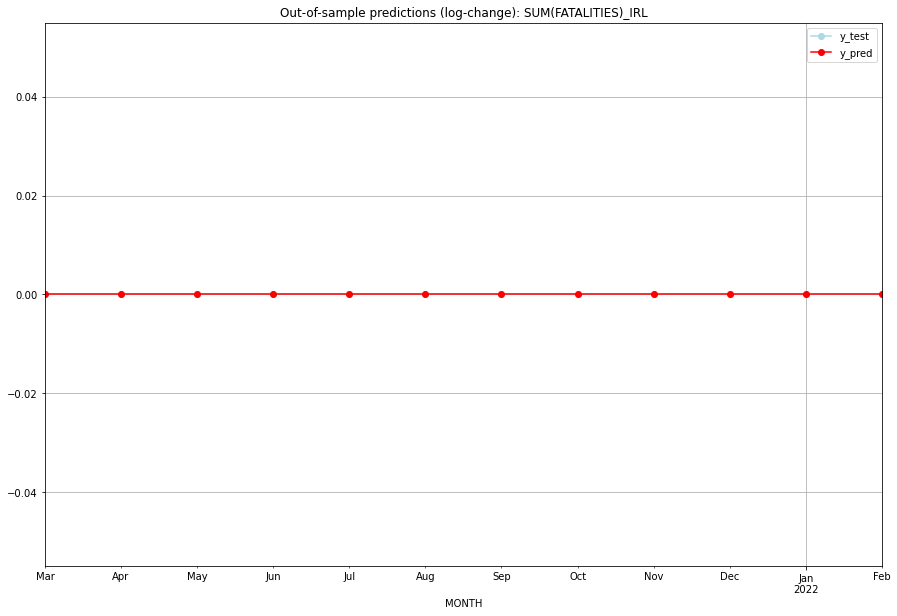

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   IRL   
1  2021-04-01       0.0         0.0           0.0             0.0   IRL   
2  2021-05-01       0.0         0.0           0.0             0.0   IRL   
3  2021-06-01       0.0         0.0           0.0             0.0   IRL   
4  2021-07-01       0.0         0.0           0.0             0.0   IRL   
5  2021-08-01       0.0         0.0           0.0             0.0   IRL   
6  2021-09-01       0.0         0.0           0.0             0.0   IRL   
7  2021-10-01       0.0         0.0           0.0             0.0   IRL   
8  2021-11-01       0.0         0.0           0.0             0.0   IRL   
9  2021-12-01       0.0         0.0           0.0             0.0   IRL   
10 2022-01-01       0.0         0.0           0.0             0.0   IRL   
11 2022-02-01       0.0         0.0           0.0             0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [1, (1, 1, 3), (0, 0, 0, 0), 'n'], 'cv_score': 1.1315201210359336, 'fold_results': [nan, 1.0419287075596342, 1.5100806656882053, 0.8425509898599614]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_IRN   No. Observations:                   62
Model:                SARIMAX(1, 1, 3)   Log Likelihood                 -99.212
Date:                 Wed, 19 Oct 2022   AIC                            210.425
Time:                         10:50:46   BIC                            223.090
Sample:                     01-31-2016   HQIC                           215.388
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1  

<Figure size 432x288 with 0 Axes>

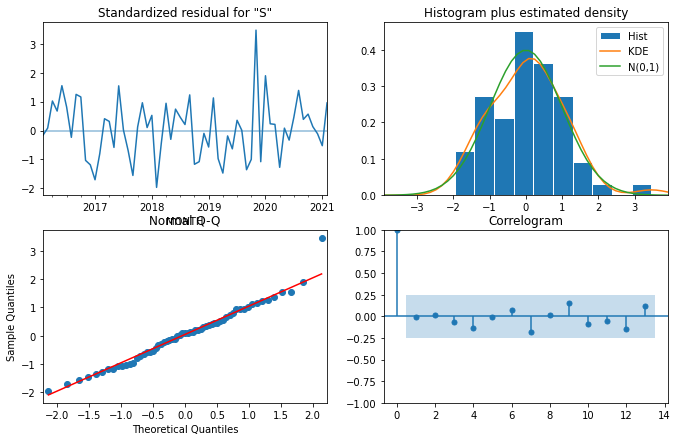

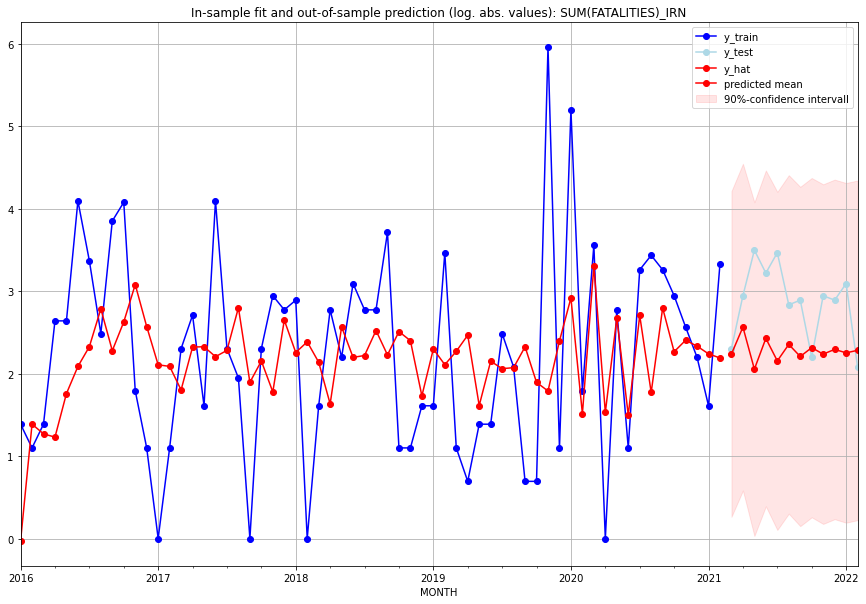

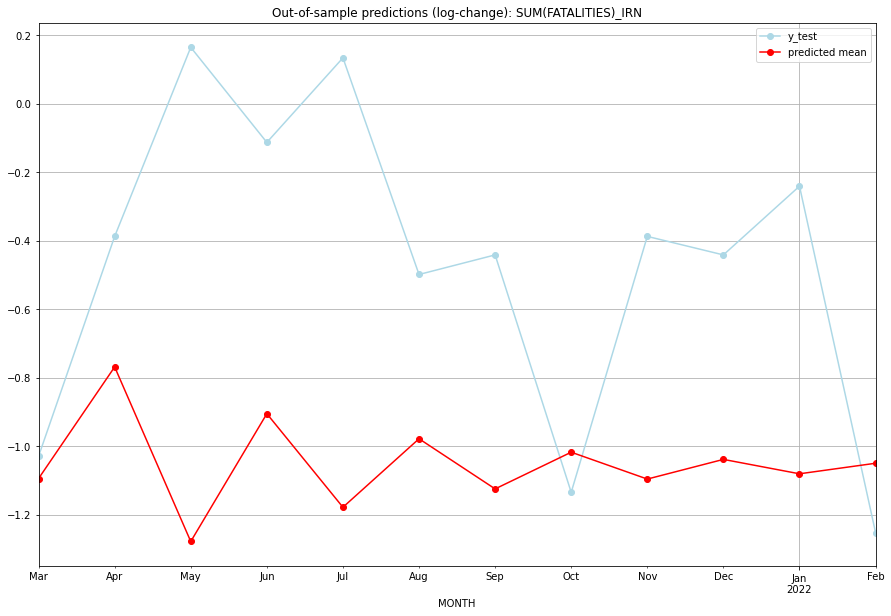

TADDA: 0.8398649359463134
Evaluation finished.
        MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01   8.369894         9.0     -1.094703       -1.029619   IRN   
1  2021-04-01  11.979016        18.0     -0.768871       -0.387766   IRN   
2  2021-05-01   6.796156        32.0     -1.278574        0.164303   IRN   
3  2021-06-01  10.322087        24.0     -0.905449       -0.113329   IRN   
4  2021-07-01   7.615924        31.0     -1.178592        0.133531   IRN   
5  2021-08-01   9.523015        16.0     -0.978640       -0.498991   IRN   
6  2021-09-01   8.090144        17.0     -1.125014       -0.441833   IRN   
7  2021-10-01   9.118271         8.0     -1.017862       -1.134980   IRN   
8  2021-11-01   8.354925        18.0     -1.096302       -0.387766   IRN   
9  2021-12-01   8.907820        17.0     -1.038880       -0.441833   IRN   
10 2022-01-01   8.499977        21.0     -1.080915       -0.241162   IRN   
11 2022-02-01   8.796849         7.0     

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [2, (1, 1, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.3340712290232824, 'fold_results': [nan, 0.31680651347376676, 0.4374590557409875, 0.24794811785509316]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_IRQ   No. Observations:                   62
Model:                SARIMAX(1, 1, 3)   Log Likelihood                 -19.802
Date:                 Wed, 19 Oct 2022   AIC                             53.605
Time:                         10:51:11   BIC                             68.381
Sample:                     01-31-2016   HQIC                            59.396
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1

<Figure size 432x288 with 0 Axes>

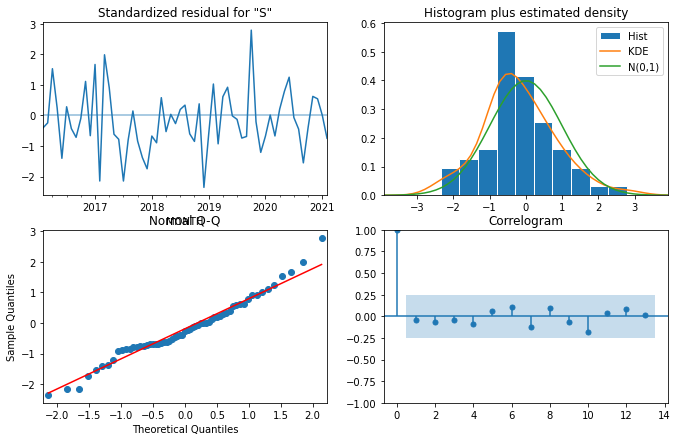

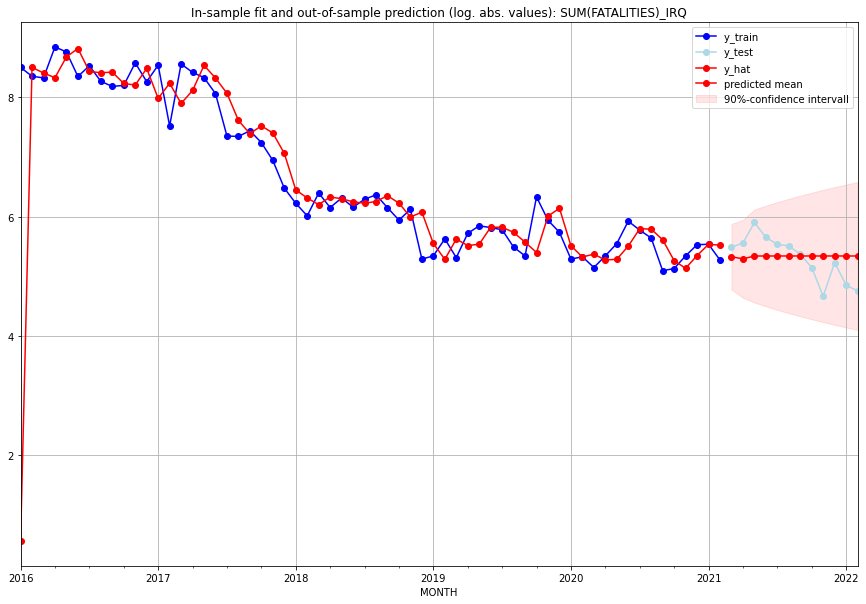

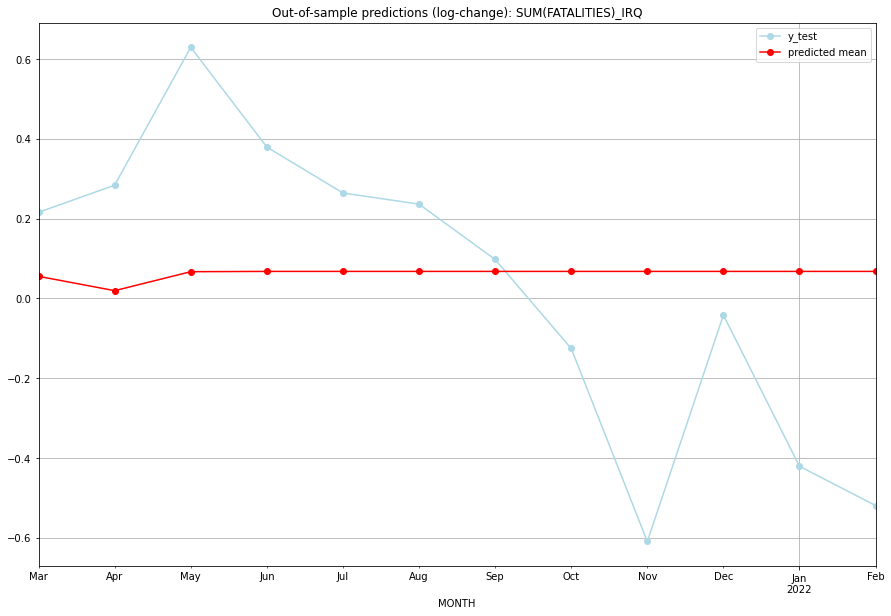

TADDA: 0.3407683633231468
Evaluation finished.
        MONTH    FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  205.088692       241.0      0.055307        0.215938   IRQ   
1  2021-04-01  197.822044       258.0      0.019411        0.283829   IRQ   
2  2021-05-01  207.507016       365.0      0.066973        0.629634   IRQ   
3  2021-06-01  207.660133       284.0      0.067707        0.379490   IRQ   
4  2021-07-01  207.662497       253.0      0.067719        0.264335   IRQ   
5  2021-08-01  207.662533       246.0      0.067719        0.236389   IRQ   
6  2021-09-01  207.662534       214.0      0.067719        0.097638   IRQ   
7  2021-10-01  207.662534       171.0      0.067719       -0.125505   IRQ   
8  2021-11-01  207.662534       105.0      0.067719       -0.609560   IRQ   
9  2021-12-01  207.662534       186.0      0.067719       -0.041891   IRQ   
10 2022-01-01  207.662534       127.0      0.067719       -0.420969   IRQ   
11 2022-02-01  207.662534    

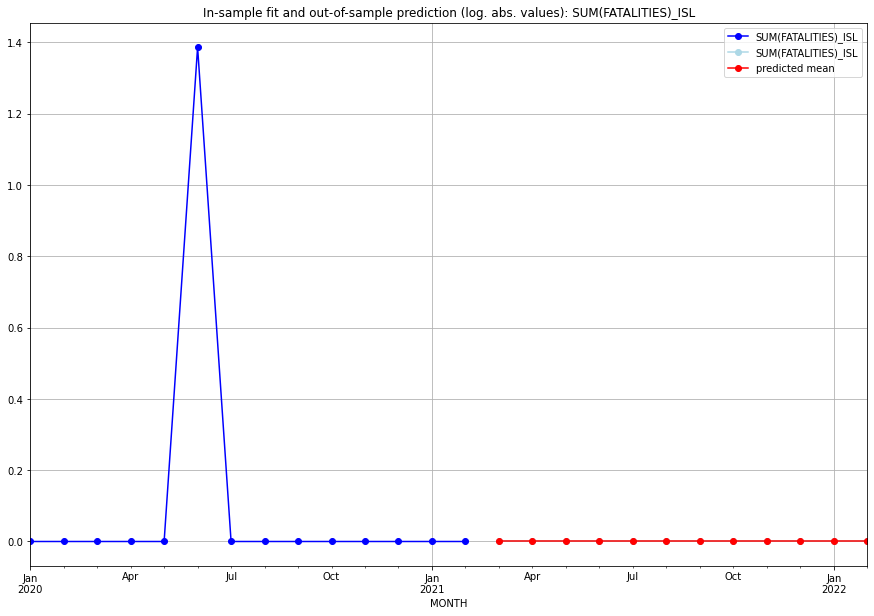

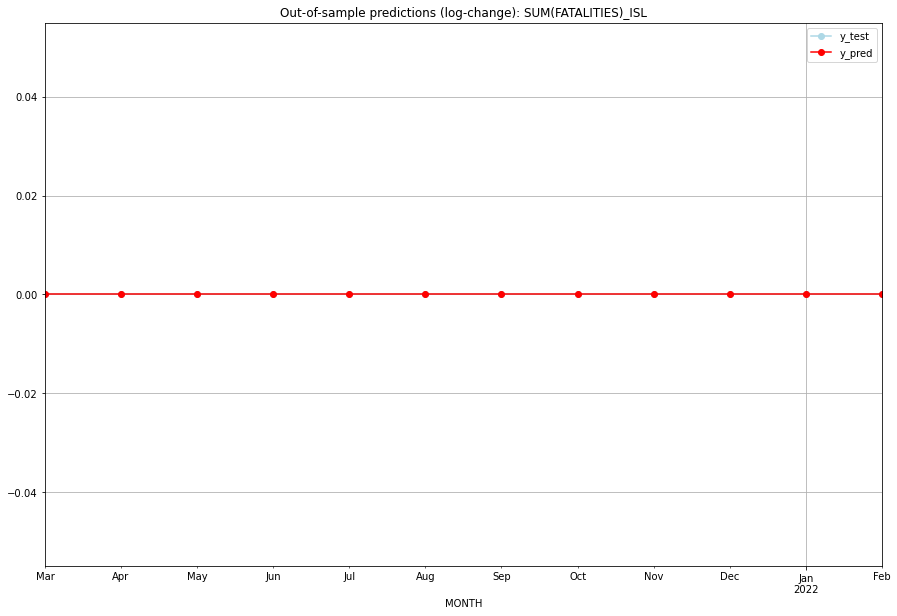

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   ISL   
1  2021-04-01       0.0         0.0           0.0             0.0   ISL   
2  2021-05-01       0.0         0.0           0.0             0.0   ISL   
3  2021-06-01       0.0         0.0           0.0             0.0   ISL   
4  2021-07-01       0.0         0.0           0.0             0.0   ISL   
5  2021-08-01       0.0         0.0           0.0             0.0   ISL   
6  2021-09-01       0.0         0.0           0.0             0.0   ISL   
7  2021-10-01       0.0         0.0           0.0             0.0   ISL   
8  2021-11-01       0.0         0.0           0.0             0.0   ISL   
9  2021-12-01       0.0         0.0           0.0             0.0   ISL   
10 2022-01-01       0.0         0.0           0.0             0.0   ISL   
11 2022-02-01       0.0         0.0           0.0             0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [1, (2, 1, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.7165908957173733, 'fold_results': [nan, 0.6189043719336919, 0.8766539975509452, 0.654214317667483]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_ISR   No. Observations:                   62
Model:                SARIMAX(2, 1, 3)   Log Likelihood                 -82.058
Date:                 Wed, 19 Oct 2022   AIC                            178.116
Time:                         10:51:36   BIC                            192.892
Sample:                     01-31-2016   HQIC                           183.906
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1   

<Figure size 432x288 with 0 Axes>

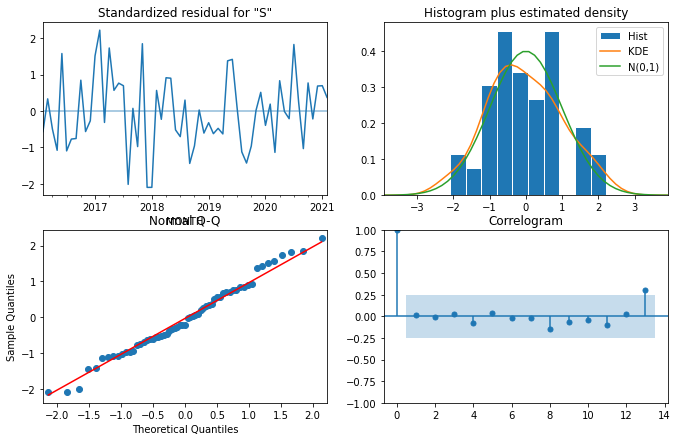

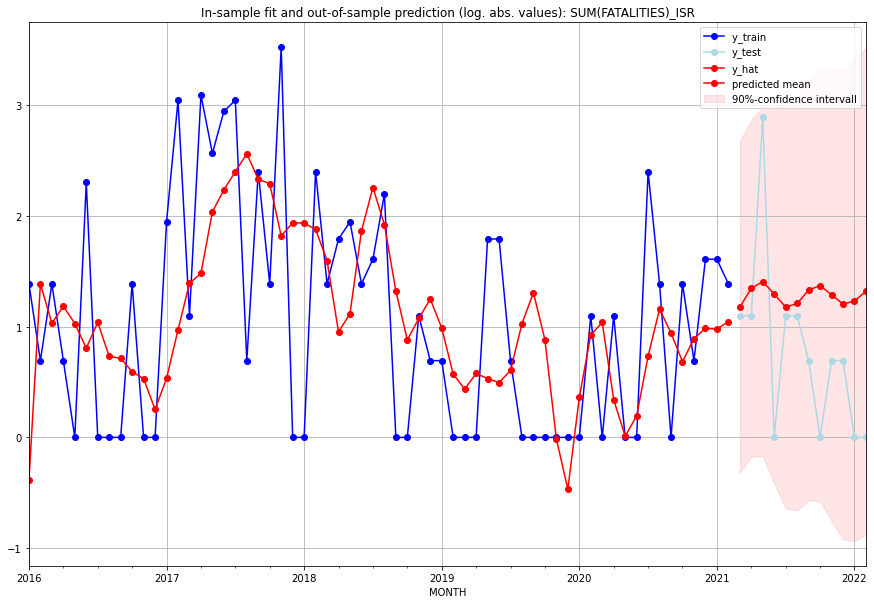

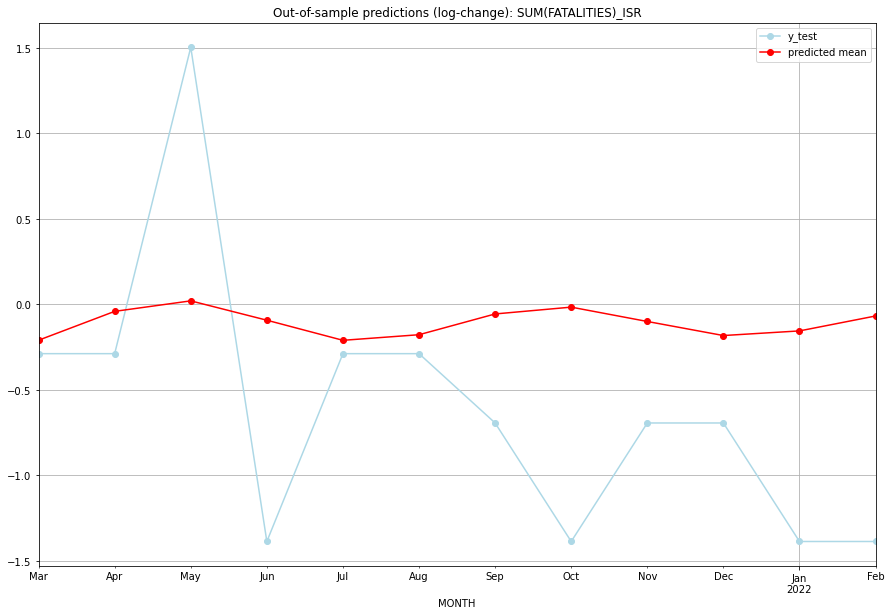

TADDA: 0.7463413434031673
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  2.245387         2.0     -0.209060       -0.287682   ISR   
1  2021-04-01  2.841909         2.0     -0.040325       -0.287682   ISR   
2  2021-05-01  3.085262        17.0      0.021091        1.504077   ISR   
3  2021-06-01  2.648269         0.0     -0.092042       -1.386294   ISR   
4  2021-07-01  2.243460         2.0     -0.209654       -0.287682   ISR   
5  2021-08-01  2.351387         2.0     -0.176920       -0.287682   ISR   
6  2021-09-01  2.784248         1.0     -0.055447       -0.693147   ISR   
7  2021-10-01  2.938131         0.0     -0.015588       -1.386294   ISR   
8  2021-11-01  2.621197         1.0     -0.099490       -0.693147   ISR   
9  2021-12-01  2.335302         1.0     -0.181731       -0.693147   ISR   
10 2022-01-01  2.426878         0.0     -0.154645       -1.386294   ISR   
11 2022-02-01  2.739525         0.0     -0.067336    

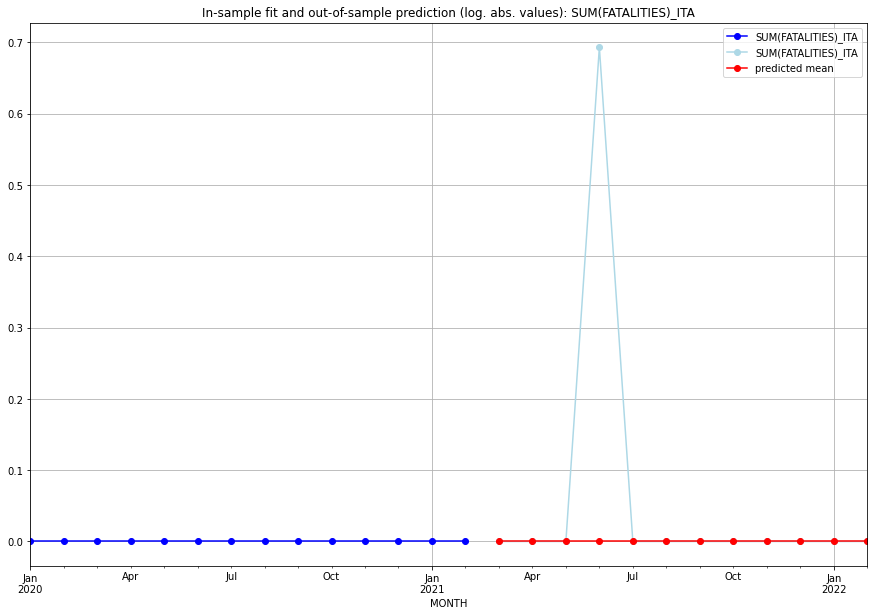

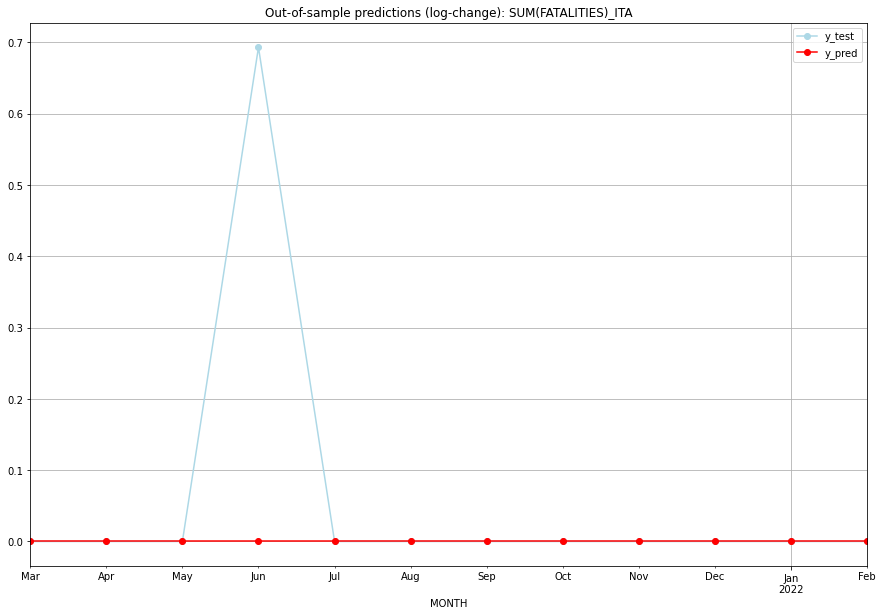

TADDA: 0.057762265046662105
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0    0.000000           0.0        0.000000   ITA   
1  2021-04-01       0.0    0.000000           0.0        0.000000   ITA   
2  2021-05-01       0.0    0.000000           0.0        0.000000   ITA   
3  2021-06-01       0.0    0.693147           0.0        0.693147   ITA   
4  2021-07-01       0.0    0.000000           0.0        0.000000   ITA   
5  2021-08-01       0.0    0.000000           0.0        0.000000   ITA   
6  2021-09-01       0.0    0.000000           0.0        0.000000   ITA   
7  2021-10-01       0.0    0.000000           0.0        0.000000   ITA   
8  2021-11-01       0.0    0.000000           0.0        0.000000   ITA   
9  2021-12-01       0.0    0.000000           0.0        0.000000   ITA   
10 2022-01-01       0.0    0.000000           0.0        0.000000   ITA   
11 2022-02-01       0.0    0.000000           0.0  

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (2, 0, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.22226745779554352, 'fold_results': [0.20921902732736364, 0.23531588826372343]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_JAM   No. Observations:                   38
Model:                SARIMAX(2, 0, 2)   Log Likelihood                  -9.206
Date:                 Wed, 19 Oct 2022   AIC                             34.412
Time:                         10:51:55   BIC                             47.513
Sample:                     01-31-2018   HQIC                            39.073
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             0.0083     

<Figure size 432x288 with 0 Axes>

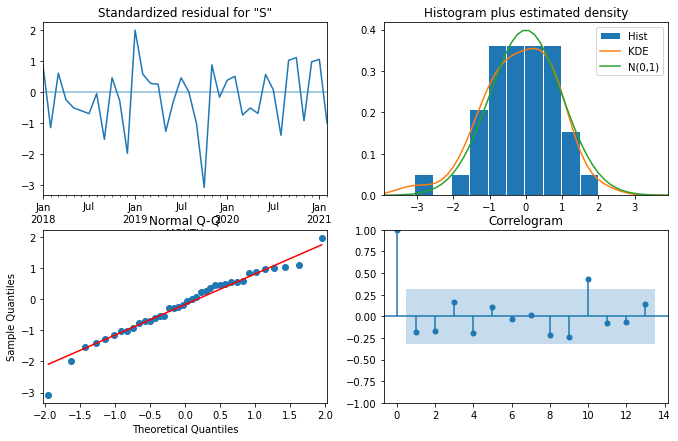

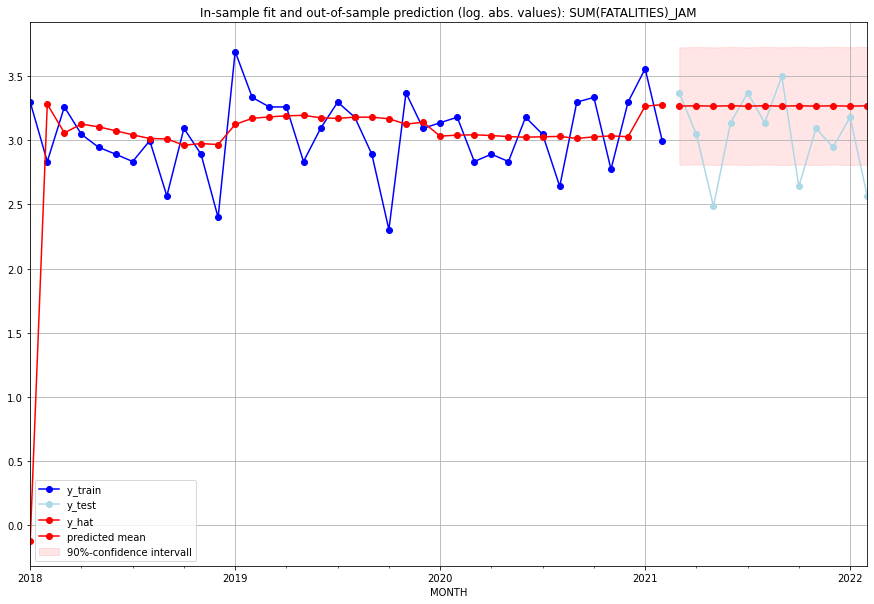

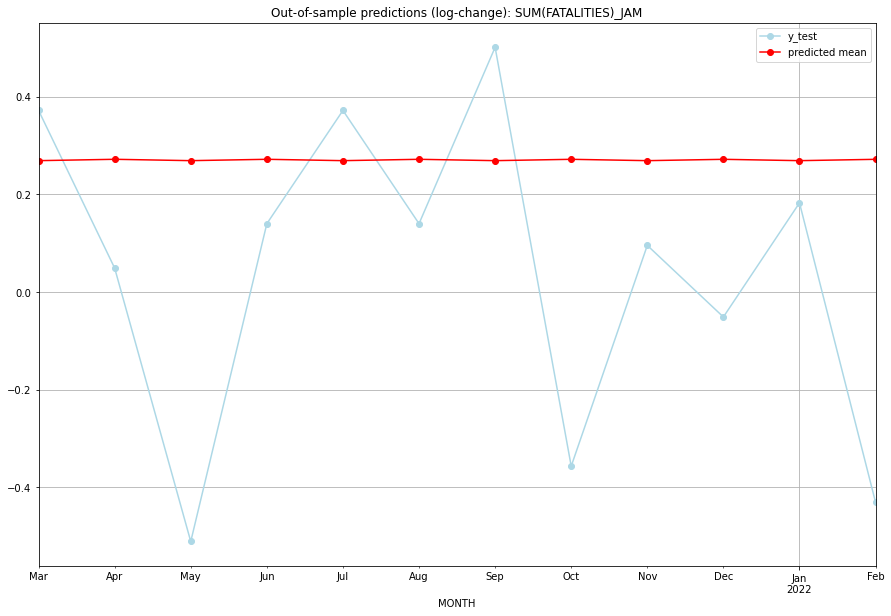

TADDA: 0.391654608582328
Evaluation finished.
        MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  25.166584        28.0      0.268751        0.371564   JAM   
1  2021-04-01  25.239701        20.0      0.271541        0.048790   JAM   
2  2021-05-01  25.166559        11.0      0.268750       -0.510826   JAM   
3  2021-06-01  25.239414        22.0      0.271530        0.139762   JAM   
4  2021-07-01  25.166533        28.0      0.268749        0.371564   JAM   
5  2021-08-01  25.239128        22.0      0.271519        0.139762   JAM   
6  2021-09-01  25.166506        32.0      0.268748        0.500775   JAM   
7  2021-10-01  25.238842        13.0      0.271509       -0.356675   JAM   
8  2021-11-01  25.166479        21.0      0.268747        0.095310   JAM   
9  2021-12-01  25.238556        18.0      0.271498       -0.051293   JAM   
10 2022-01-01  25.166452        23.0      0.268746        0.182322   JAM   
11 2022-02-01  25.238271        12.0      

<Figure size 432x288 with 0 Axes>

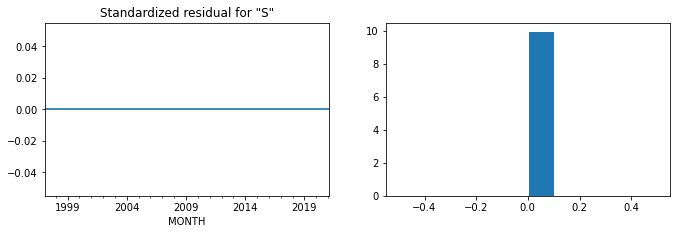

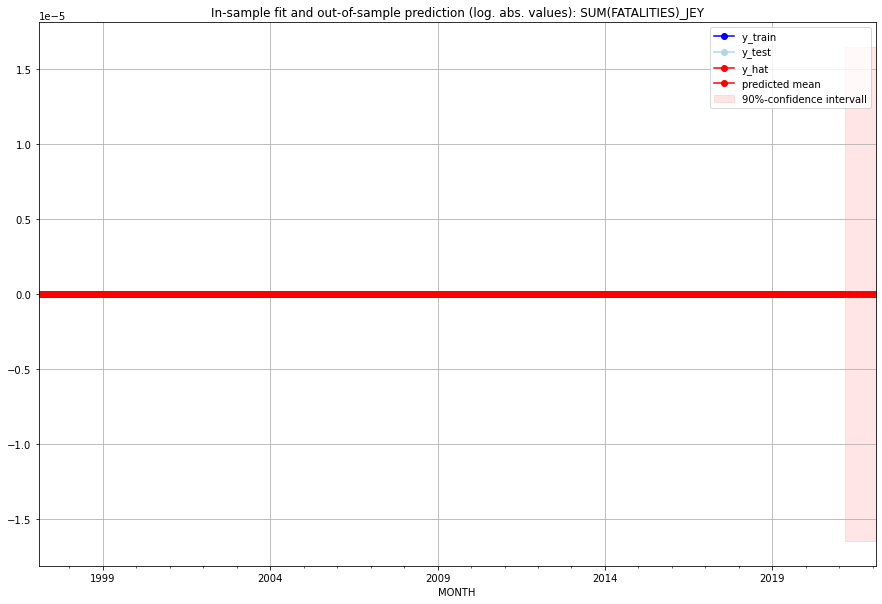

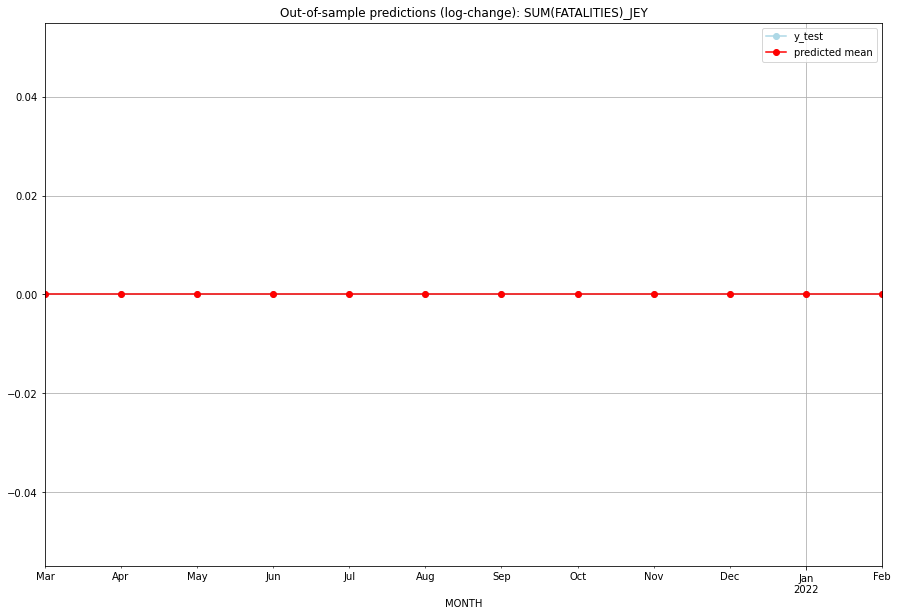

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   JEY   
1  2021-04-01       0.0         0.0           0.0             0.0   JEY   
2  2021-05-01       0.0         0.0           0.0             0.0   JEY   
3  2021-06-01       0.0         0.0           0.0             0.0   JEY   
4  2021-07-01       0.0         0.0           0.0             0.0   JEY   
5  2021-08-01       0.0         0.0           0.0             0.0   JEY   
6  2021-09-01       0.0         0.0           0.0             0.0   JEY   
7  2021-10-01       0.0         0.0           0.0             0.0   JEY   
8  2021-11-01       0.0         0.0           0.0             0.0   JEY   
9  2021-12-01       0.0         0.0           0.0             0.0   JEY   
10 2022-01-01       0.0         0.0           0.0             0.0   JEY   
11 2022-02-01       0.0         0.0           0.0             0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (0, 1, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.2467176751390041, 'fold_results': [nan, 0.24964435612949928, 0.20707555414900003, 0.283433115138513]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_JOR   No. Observations:                   62
Model:                SARIMAX(0, 1, 3)   Log Likelihood                 -75.865
Date:                 Wed, 19 Oct 2022   AIC                            165.729
Time:                         10:52:25   BIC                            180.505
Sample:                     01-31-2016   HQIC                           171.520
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1 

<Figure size 432x288 with 0 Axes>

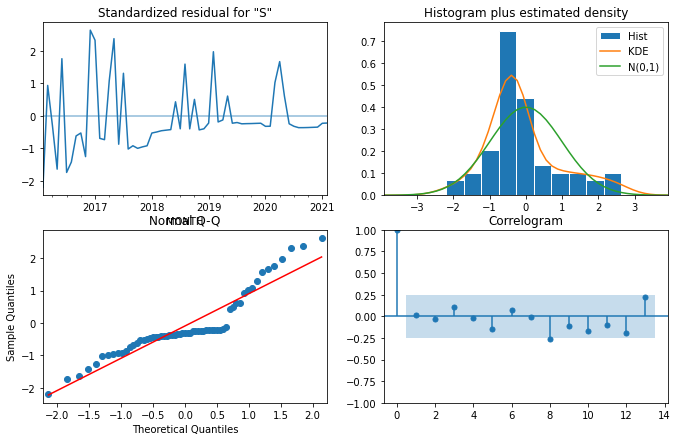

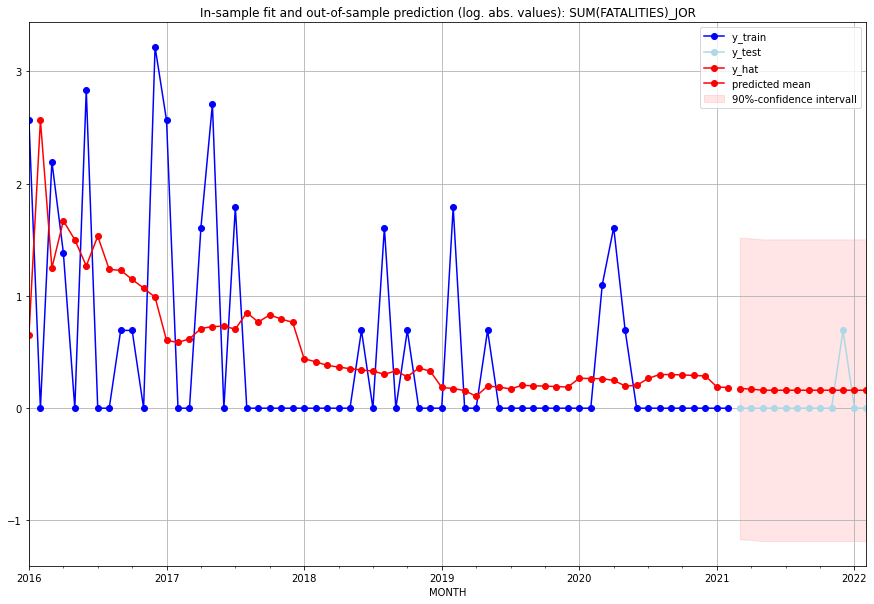

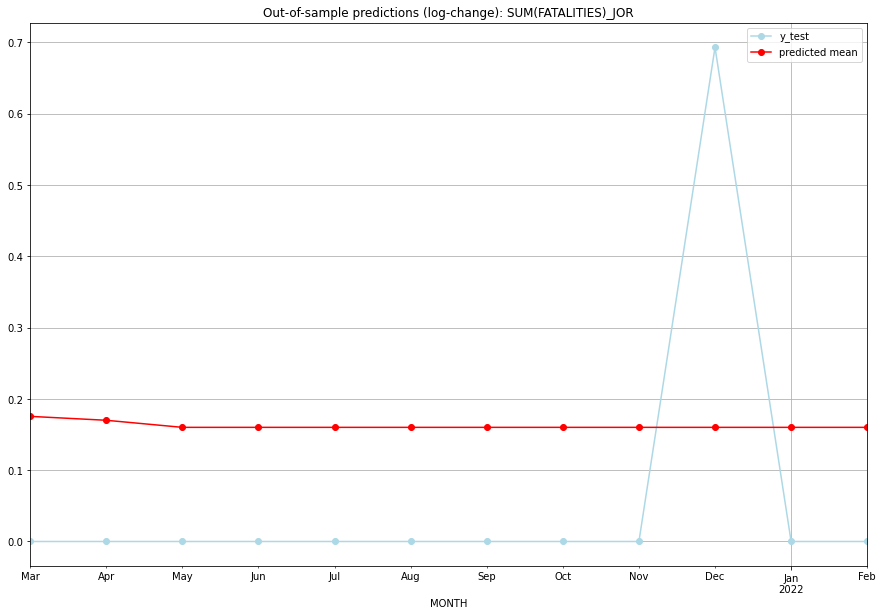

TADDA: 0.19328984005195562
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  0.191850         0.0      0.175506        0.000000   JOR   
1  2021-04-01  0.185319         0.0      0.170012        0.000000   JOR   
2  2021-05-01  0.173630         0.0      0.160102        0.000000   JOR   
3  2021-06-01  0.173630         0.0      0.160102        0.000000   JOR   
4  2021-07-01  0.173630         0.0      0.160102        0.000000   JOR   
5  2021-08-01  0.173630         0.0      0.160102        0.000000   JOR   
6  2021-09-01  0.173630         0.0      0.160102        0.000000   JOR   
7  2021-10-01  0.173630         0.0      0.160102        0.000000   JOR   
8  2021-11-01  0.173630         0.0      0.160102        0.000000   JOR   
9  2021-12-01  0.173630         1.0      0.160102        0.693147   JOR   
10 2022-01-01  0.173630         0.0      0.160102        0.000000   JOR   
11 2022-02-01  0.173630         0.0      0.160102   

<Figure size 432x288 with 0 Axes>

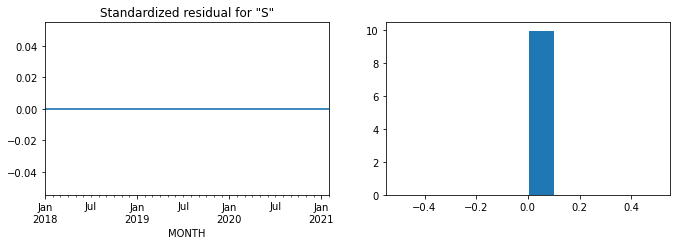

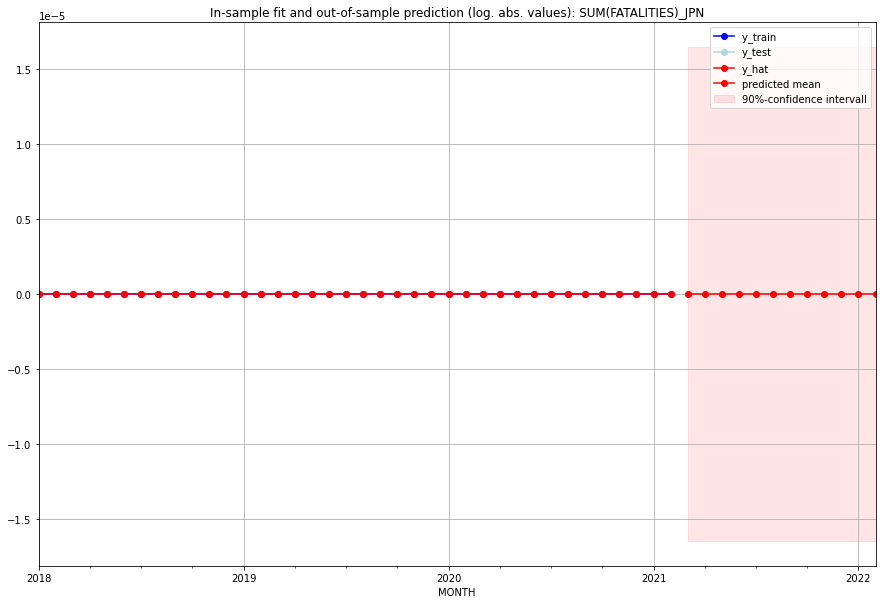

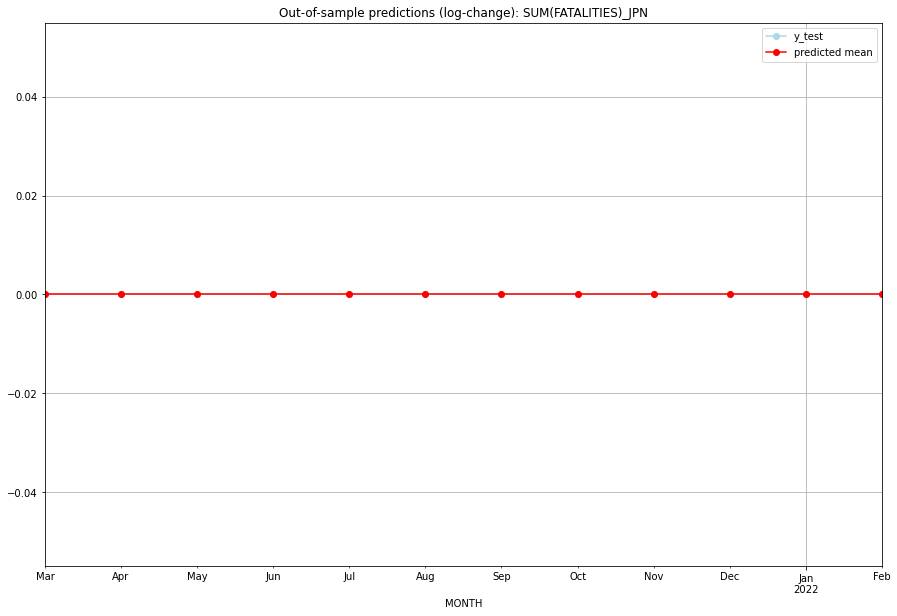

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   JPN   
1  2021-04-01       0.0         0.0           0.0             0.0   JPN   
2  2021-05-01       0.0         0.0           0.0             0.0   JPN   
3  2021-06-01       0.0         0.0           0.0             0.0   JPN   
4  2021-07-01       0.0         0.0           0.0             0.0   JPN   
5  2021-08-01       0.0         0.0           0.0             0.0   JPN   
6  2021-09-01       0.0         0.0           0.0             0.0   JPN   
7  2021-10-01       0.0         0.0           0.0             0.0   JPN   
8  2021-11-01       0.0         0.0           0.0             0.0   JPN   
9  2021-12-01       0.0         0.0           0.0             0.0   JPN   
10 2022-01-01       0.0         0.0           0.0             0.0   JPN   
11 2022-02-01       0.0         0.0           0.0             0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (1, 0, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.30772199717912174, 'fold_results': [0.3167253471786981, 0.2987186471795454]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_KAZ   No. Observations:                   38
Model:                SARIMAX(1, 0, 2)   Log Likelihood                 -34.780
Date:                 Wed, 19 Oct 2022   AIC                             77.560
Time:                         10:52:48   BIC                             84.111
Sample:                     01-31-2018   HQIC                            79.891
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          1.0000      0

<Figure size 432x288 with 0 Axes>

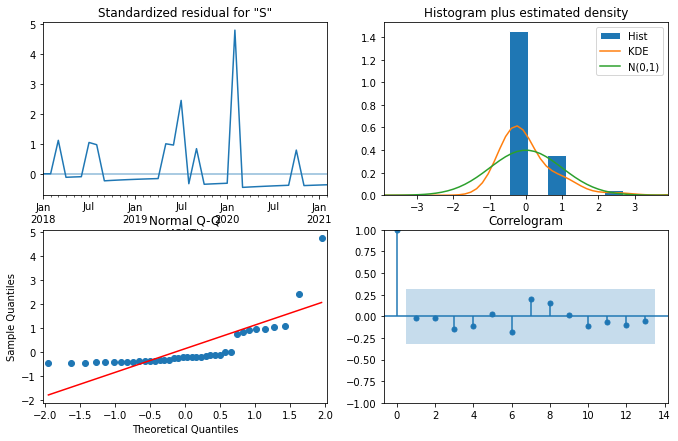

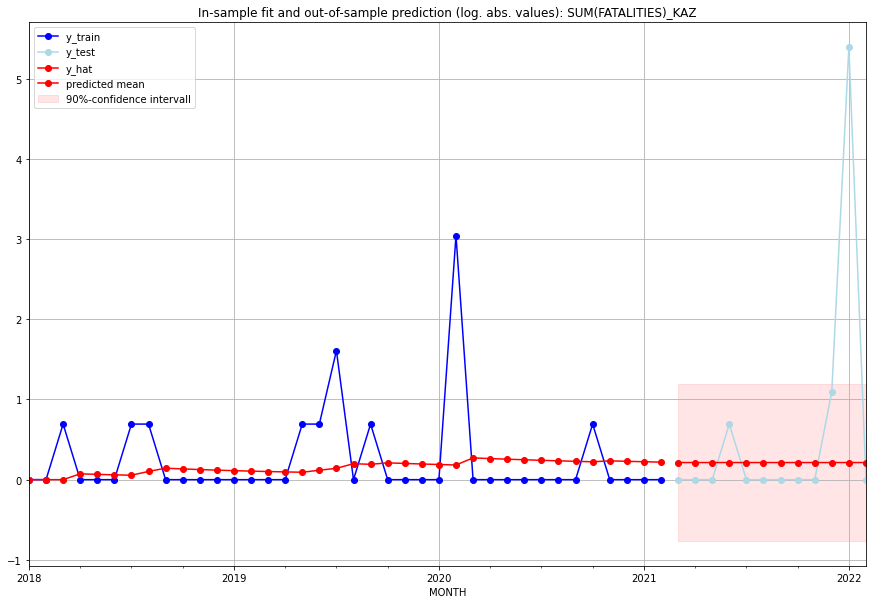

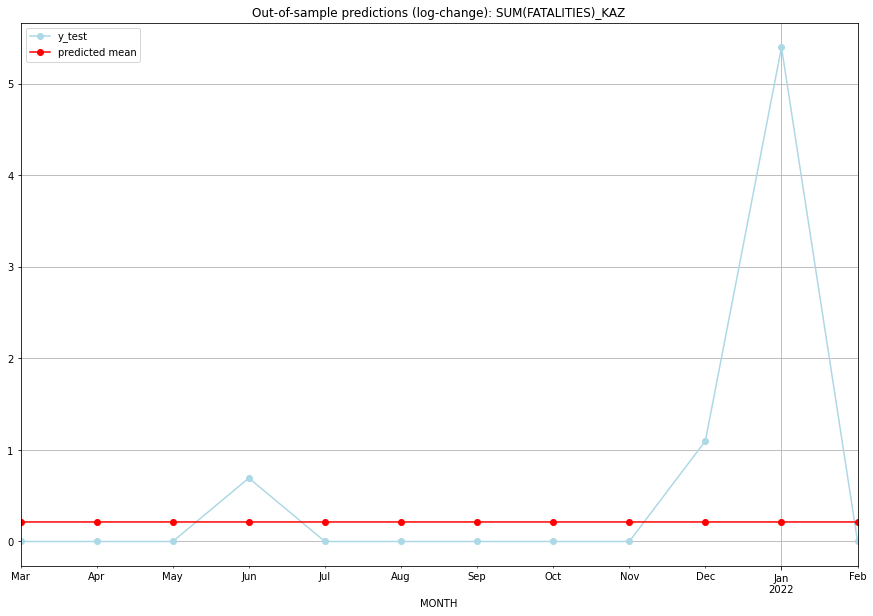

TADDA: 0.7058460798892586
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  0.237844         0.0      0.213371        0.000000   KAZ   
1  2021-04-01  0.237860         0.0      0.213384        0.000000   KAZ   
2  2021-05-01  0.237856         0.0      0.213380        0.000000   KAZ   
3  2021-06-01  0.237851         1.0      0.213377        0.693147   KAZ   
4  2021-07-01  0.237847         0.0      0.213373        0.000000   KAZ   
5  2021-08-01  0.237842         0.0      0.213370        0.000000   KAZ   
6  2021-09-01  0.237838         0.0      0.213366        0.000000   KAZ   
7  2021-10-01  0.237833         0.0      0.213363        0.000000   KAZ   
8  2021-11-01  0.237829         0.0      0.213359        0.000000   KAZ   
9  2021-12-01  0.237825         2.0      0.213355        1.098612   KAZ   
10 2022-01-01  0.237820       220.0      0.213352        5.398163   KAZ   
11 2022-02-01  0.237816         0.0      0.213348    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.4600301584639486, 'fold_results': [0.6096710541380006, 0.4501156859231867, 0.3424104939982908, 0.5250236130569989, 0.372929945203266]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_KEN   No. Observations:                  289
Model:                SARIMAX(0, 1, 0)   Log Likelihood                -516.624
Date:                 Wed, 19 Oct 2022   AIC                           1035.248
Time:                         10:53:15   BIC                           1038.911
Sample:                     02-28-1997   HQIC                          1036.716
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------

<Figure size 432x288 with 0 Axes>

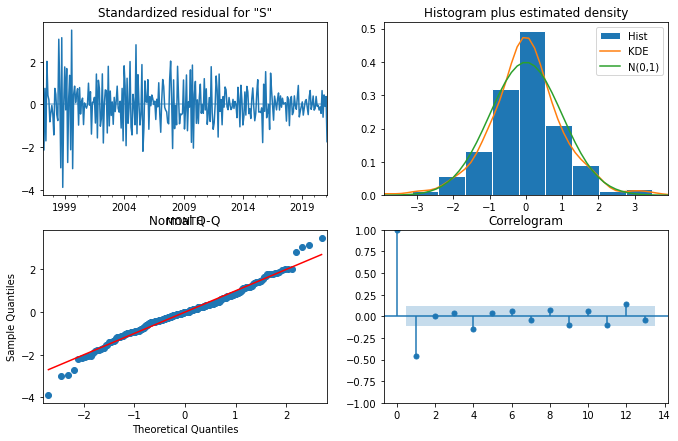

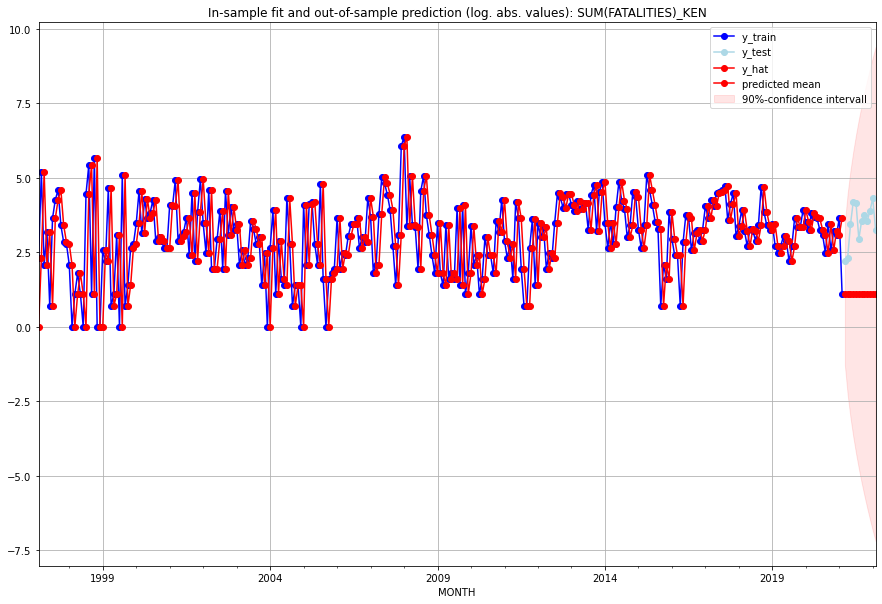

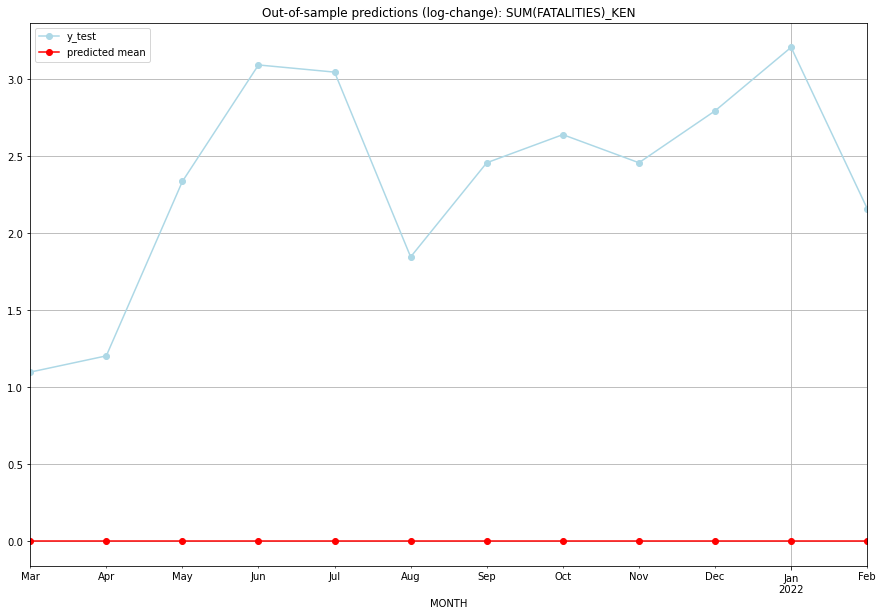

TADDA: 2.360835460748414
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       2.0         8.0  2.220446e-16        1.098612   KEN   
1  2021-04-01       2.0         9.0  2.220446e-16        1.203973   KEN   
2  2021-05-01       2.0        30.0  2.220446e-16        2.335375   KEN   
3  2021-06-01       2.0        65.0  2.220446e-16        3.091042   KEN   
4  2021-07-01       2.0        62.0  2.220446e-16        3.044522   KEN   
5  2021-08-01       2.0        18.0  2.220446e-16        1.845827   KEN   
6  2021-09-01       2.0        34.0  2.220446e-16        2.456736   KEN   
7  2021-10-01       2.0        41.0  2.220446e-16        2.639057   KEN   
8  2021-11-01       2.0        34.0  2.220446e-16        2.456736   KEN   
9  2021-12-01       2.0        48.0  2.220446e-16        2.793208   KEN   
10 2022-01-01       2.0        73.0  2.220446e-16        3.205453   KEN   
11 2022-02-01       2.0        25.0  2.220446e-16     

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [1, (0, 1, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.09155102405567582, 'fold_results': [nan, 0.09155102405567582]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_KGZ   No. Observations:                   38
Model:                SARIMAX(0, 1, 3)   Log Likelihood                 -21.154
Date:                 Wed, 19 Oct 2022   AIC                             52.308
Time:                         10:53:26   BIC                             60.363
Sample:                     01-31-2018   HQIC                            55.148
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -0.0151      0.021     -0.72

<Figure size 432x288 with 0 Axes>

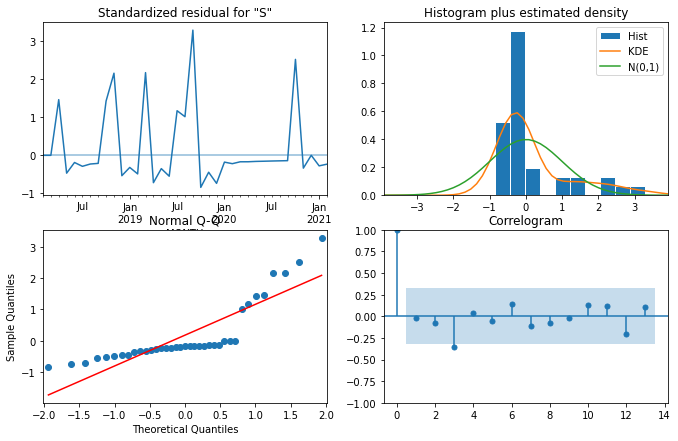

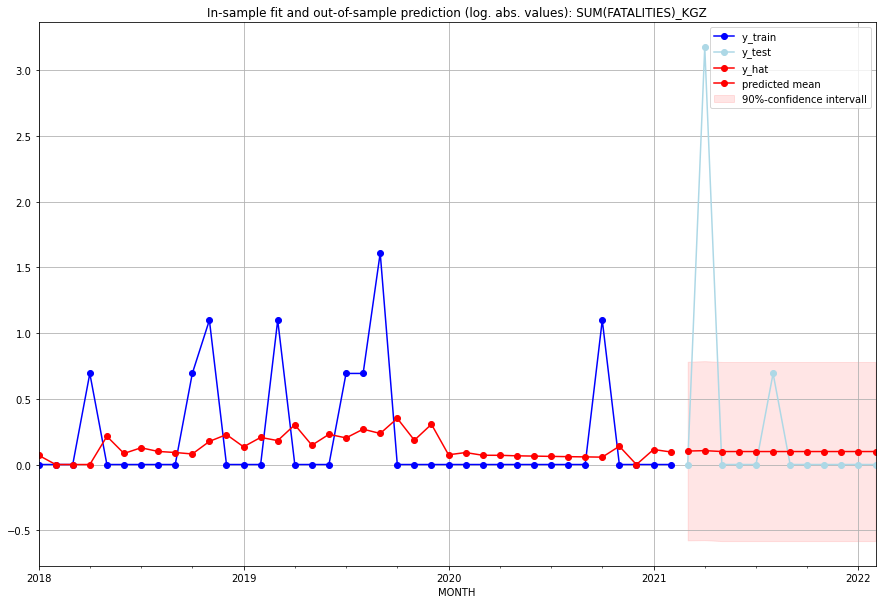

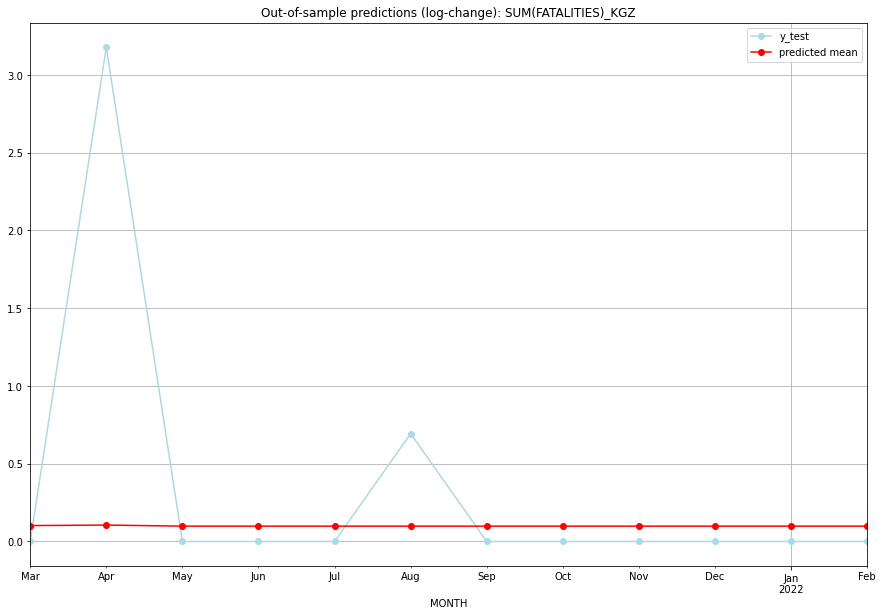

TADDA: 0.3881738400085517
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  0.107794         0.0      0.102371        0.000000   KGZ   
1  2021-04-01  0.111424        23.0      0.105642        3.178054   KGZ   
2  2021-05-01  0.103812         0.0      0.098770        0.000000   KGZ   
3  2021-06-01  0.103812         0.0      0.098770        0.000000   KGZ   
4  2021-07-01  0.103812         0.0      0.098770        0.000000   KGZ   
5  2021-08-01  0.103812         1.0      0.098770        0.693147   KGZ   
6  2021-09-01  0.103812         0.0      0.098770        0.000000   KGZ   
7  2021-10-01  0.103812         0.0      0.098770        0.000000   KGZ   
8  2021-11-01  0.103812         0.0      0.098770        0.000000   KGZ   
9  2021-12-01  0.103812         0.0      0.098770        0.000000   KGZ   
10 2022-01-01  0.103812         0.0      0.098770        0.000000   KGZ   
11 2022-02-01  0.103812         0.0      0.098770    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (1, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.46909631359910564, 'fold_results': [0.3803623492889863, 0.35682965939762584, 0.5561242079517908, 0.2691813997627734, 0.782983951594352]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_KHM   No. Observations:                  134
Model:                SARIMAX(1, 0, 0)   Log Likelihood                -154.287
Date:                 Wed, 19 Oct 2022   AIC                            318.575
Time:                         10:53:54   BIC                            333.064
Sample:                     01-31-2010   HQIC                           324.463
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------

<Figure size 432x288 with 0 Axes>

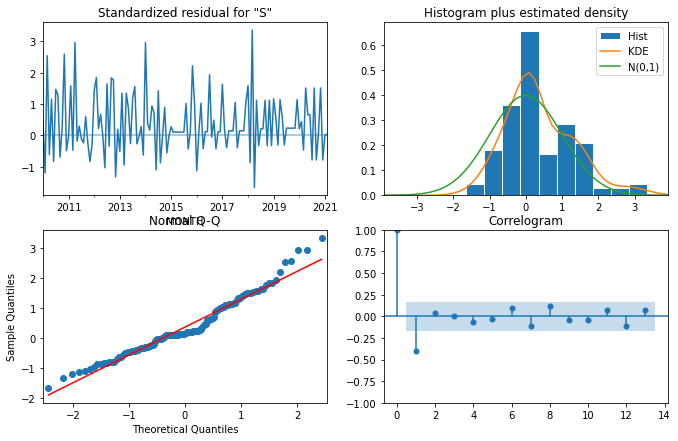

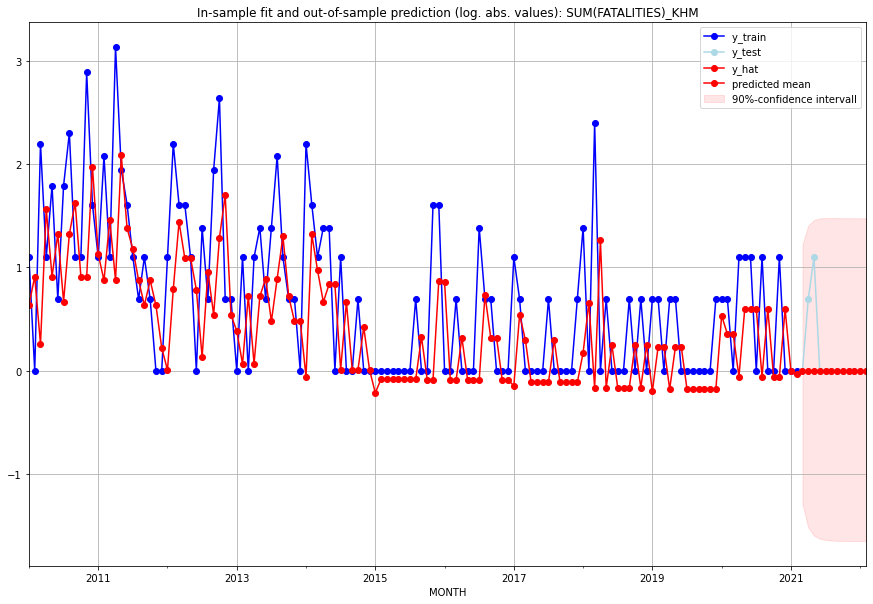

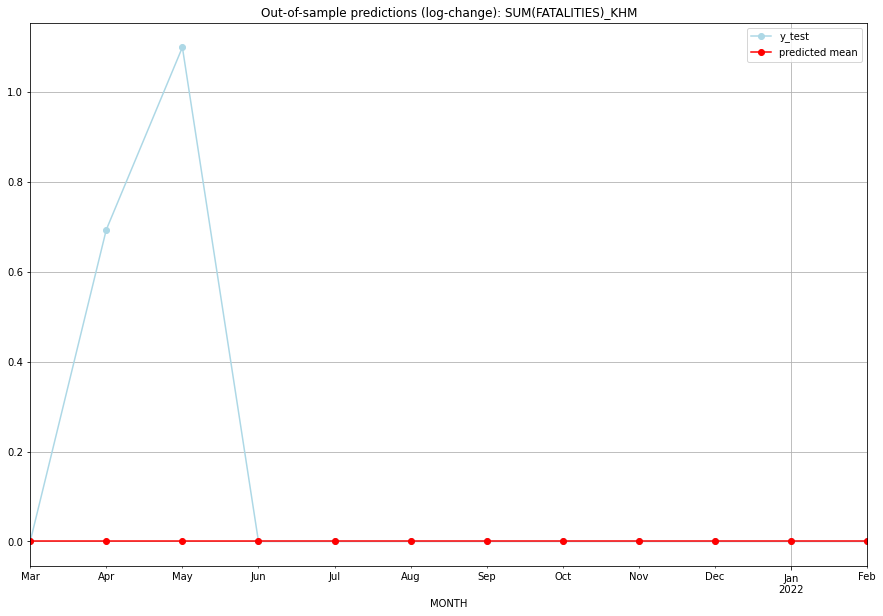

TADDA: 0.1493132891023379
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0        0.000000   KHM   
1  2021-04-01       0.0         1.0           0.0        0.693147   KHM   
2  2021-05-01       0.0         2.0           0.0        1.098612   KHM   
3  2021-06-01       0.0         0.0           0.0        0.000000   KHM   
4  2021-07-01       0.0         0.0           0.0        0.000000   KHM   
5  2021-08-01       0.0         0.0           0.0        0.000000   KHM   
6  2021-09-01       0.0         0.0           0.0        0.000000   KHM   
7  2021-10-01       0.0         0.0           0.0        0.000000   KHM   
8  2021-11-01       0.0         0.0           0.0        0.000000   KHM   
9  2021-12-01       0.0         0.0           0.0        0.000000   KHM   
10 2022-01-01       0.0         0.0           0.0        0.000000   KHM   
11 2022-02-01       0.0         0.0           0.0    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.0, 'fold_results': [0.0, 0.0]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_KNA   No. Observations:                   38
Model:                         SARIMAX   Log Likelihood                  29.122
Date:                 Wed, 19 Oct 2022   AIC                            -56.244
Time:                         10:54:05   BIC                            -54.606
Sample:                     01-31-2018   HQIC                           -55.661
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.0126      0.001     18.748      0.000       0.011       0

<Figure size 432x288 with 0 Axes>

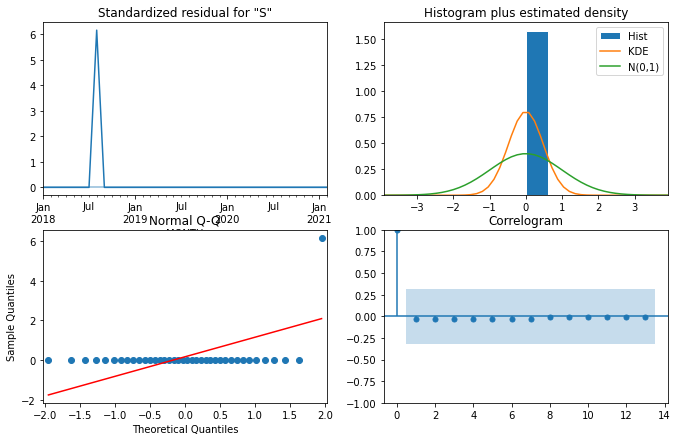

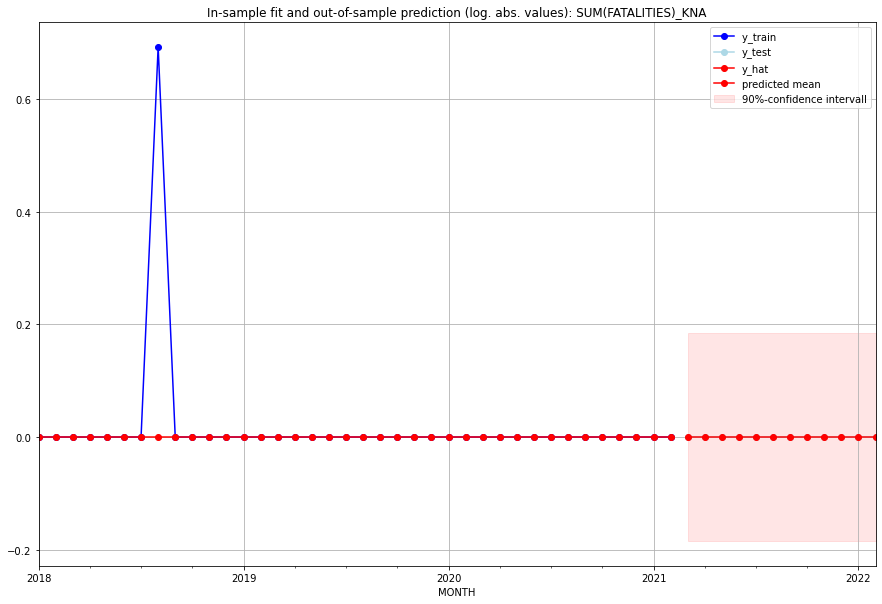

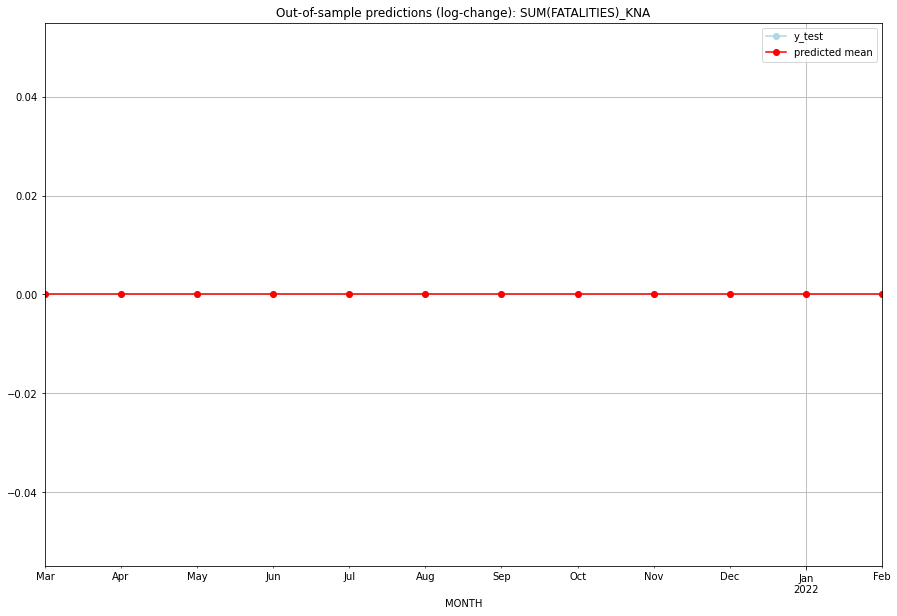

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   KNA   
1  2021-04-01       0.0         0.0           0.0             0.0   KNA   
2  2021-05-01       0.0         0.0           0.0             0.0   KNA   
3  2021-06-01       0.0         0.0           0.0             0.0   KNA   
4  2021-07-01       0.0         0.0           0.0             0.0   KNA   
5  2021-08-01       0.0         0.0           0.0             0.0   KNA   
6  2021-09-01       0.0         0.0           0.0             0.0   KNA   
7  2021-10-01       0.0         0.0           0.0             0.0   KNA   
8  2021-11-01       0.0         0.0           0.0             0.0   KNA   
9  2021-12-01       0.0         0.0           0.0             0.0   KNA   
10 2022-01-01       0.0         0.0           0.0             0.0   KNA   
11 2022-02-01       0.0         0.0           0.0             0.0   

<Figure size 432x288 with 0 Axes>

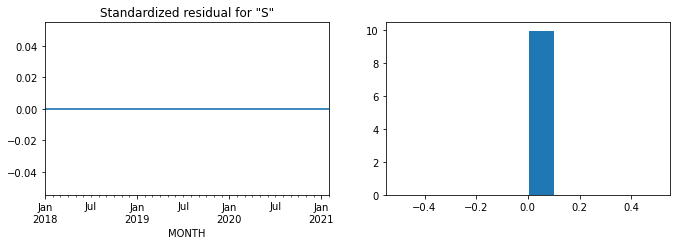

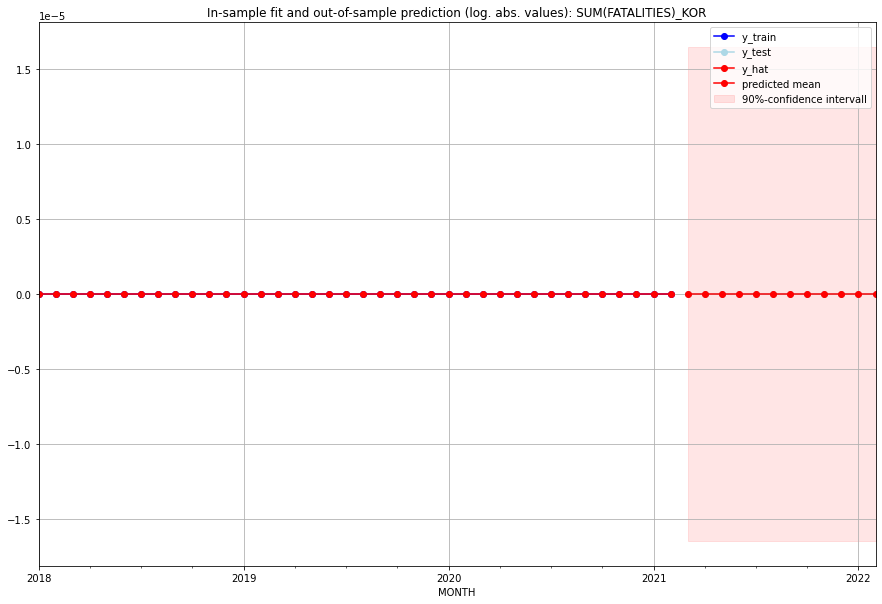

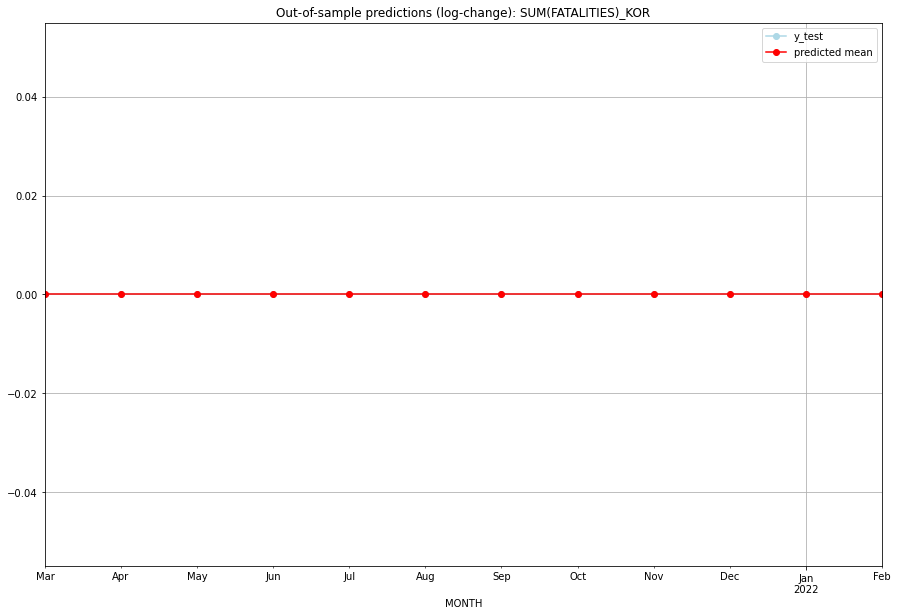

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   KOR   
1  2021-04-01       0.0         0.0           0.0             0.0   KOR   
2  2021-05-01       0.0         0.0           0.0             0.0   KOR   
3  2021-06-01       0.0         0.0           0.0             0.0   KOR   
4  2021-07-01       0.0         0.0           0.0             0.0   KOR   
5  2021-08-01       0.0         0.0           0.0             0.0   KOR   
6  2021-09-01       0.0         0.0           0.0             0.0   KOR   
7  2021-10-01       0.0         0.0           0.0             0.0   KOR   
8  2021-11-01       0.0         0.0           0.0             0.0   KOR   
9  2021-12-01       0.0         0.0           0.0             0.0   KOR   
10 2022-01-01       0.0         0.0           0.0             0.0   KOR   
11 2022-02-01       0.0         0.0           0.0             0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.014440566261665526, 'fold_results': [0.0, 0.0, 0.0, 0.057762265046662105]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_KWT   No. Observations:                   62
Model:                         SARIMAX   Log Likelihood                  62.691
Date:                 Wed, 19 Oct 2022   AIC                           -123.382
Time:                         10:54:50   BIC                           -121.254
Sample:                     01-31-2016   HQIC                          -122.546
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.0077      0.0

<Figure size 432x288 with 0 Axes>

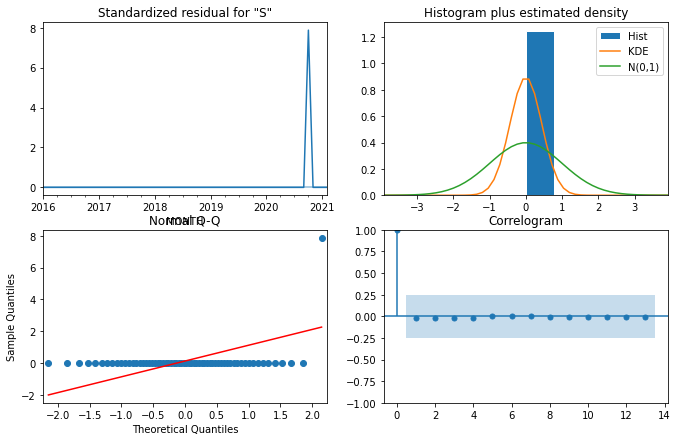

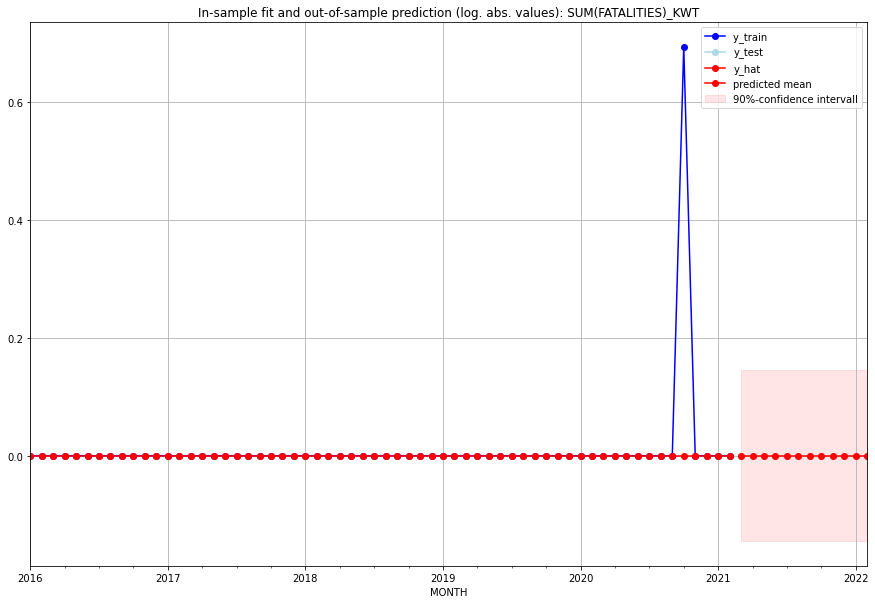

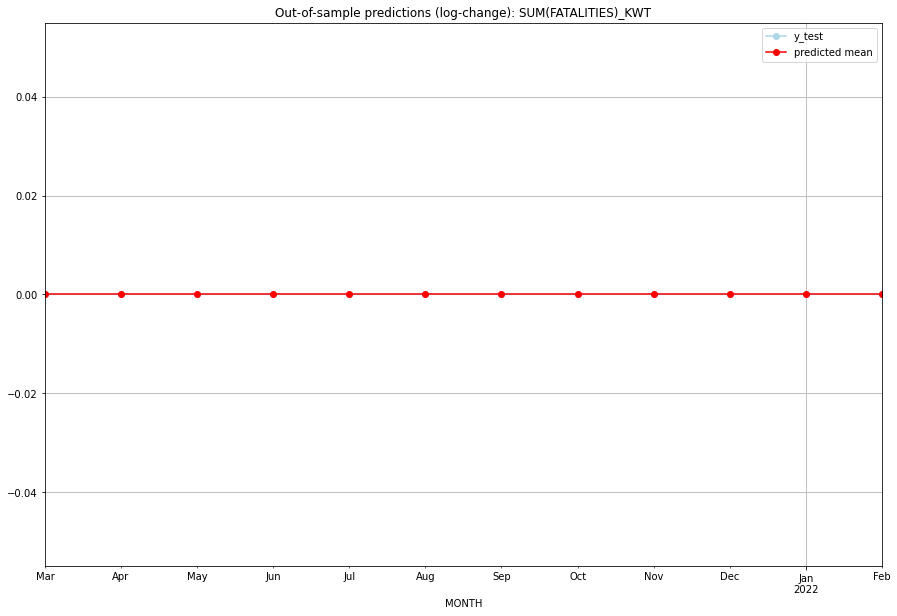

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   KWT   
1  2021-04-01       0.0         0.0           0.0             0.0   KWT   
2  2021-05-01       0.0         0.0           0.0             0.0   KWT   
3  2021-06-01       0.0         0.0           0.0             0.0   KWT   
4  2021-07-01       0.0         0.0           0.0             0.0   KWT   
5  2021-08-01       0.0         0.0           0.0             0.0   KWT   
6  2021-09-01       0.0         0.0           0.0             0.0   KWT   
7  2021-10-01       0.0         0.0           0.0             0.0   KWT   
8  2021-11-01       0.0         0.0           0.0             0.0   KWT   
9  2021-12-01       0.0         0.0           0.0             0.0   KWT   
10 2022-01-01       0.0         0.0           0.0             0.0   KWT   
11 2022-02-01       0.0         0.0           0.0             0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.17524984573425936, 'fold_results': [0.41415110829800006, 0.23104906018664842, 0.0, 0.11552453009332421, 0.11552453009332421]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_LAO   No. Observations:                  134
Model:                         SARIMAX   Log Likelihood                 -65.286
Date:                 Wed, 19 Oct 2022   AIC                            132.571
Time:                         10:55:16   BIC                            135.469
Sample:                     01-31-2010   HQIC                           133.749
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------

<Figure size 432x288 with 0 Axes>

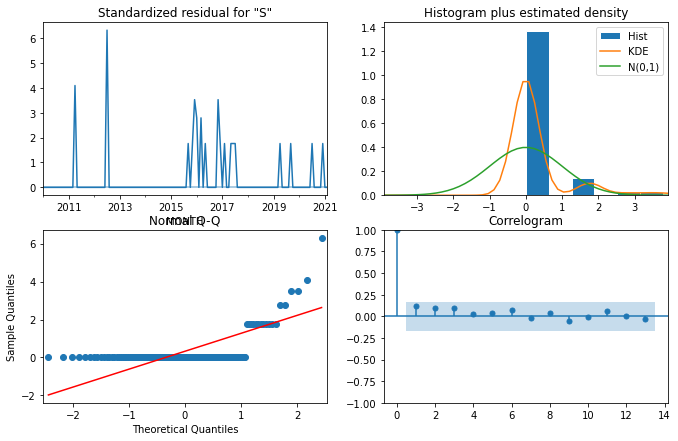

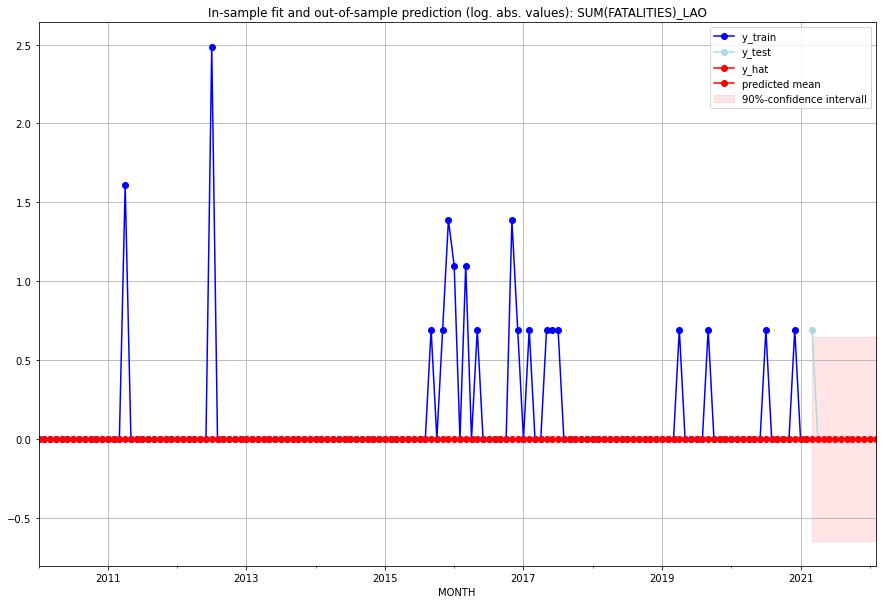

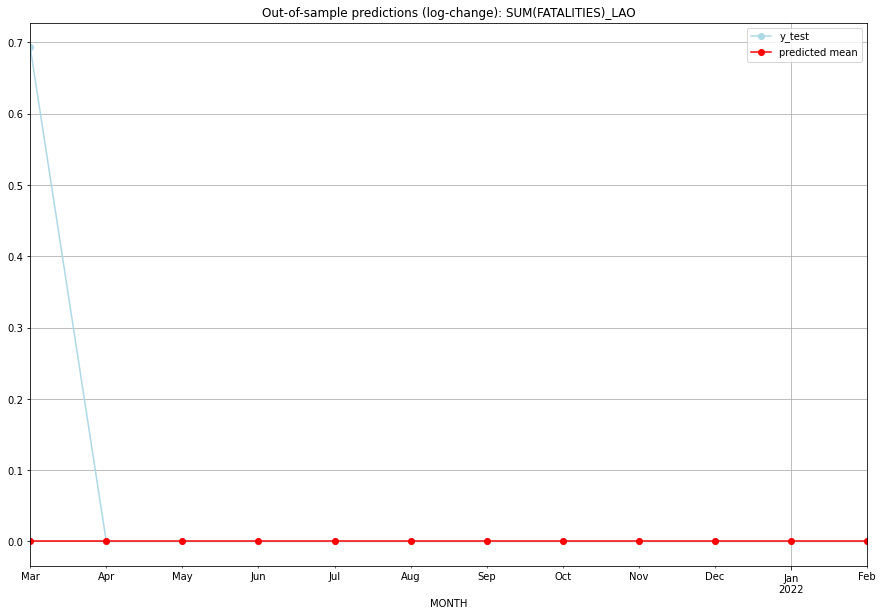

TADDA: 0.057762265046662105
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         1.0           0.0        0.693147   LAO   
1  2021-04-01       0.0         0.0           0.0        0.000000   LAO   
2  2021-05-01       0.0         0.0           0.0        0.000000   LAO   
3  2021-06-01       0.0         0.0           0.0        0.000000   LAO   
4  2021-07-01       0.0         0.0           0.0        0.000000   LAO   
5  2021-08-01       0.0         0.0           0.0        0.000000   LAO   
6  2021-09-01       0.0         0.0           0.0        0.000000   LAO   
7  2021-10-01       0.0         0.0           0.0        0.000000   LAO   
8  2021-11-01       0.0         0.0           0.0        0.000000   LAO   
9  2021-12-01       0.0         0.0           0.0        0.000000   LAO   
10 2022-01-01       0.0         0.0           0.0        0.000000   LAO   
11 2022-02-01       0.0         0.0           0.0  

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [2, (0, 1, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.709426302838822, 'fold_results': [nan, 0.5341318802987856, 0.5618429334791251, 1.0323040947385553]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_LBN   No. Observations:                   62
Model:                SARIMAX(0, 1, 3)   Log Likelihood                 -82.733
Date:                 Wed, 19 Oct 2022   AIC                            177.466
Time:                         10:55:30   BIC                            190.131
Sample:                     01-31-2016   HQIC                           182.430
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1   

<Figure size 432x288 with 0 Axes>

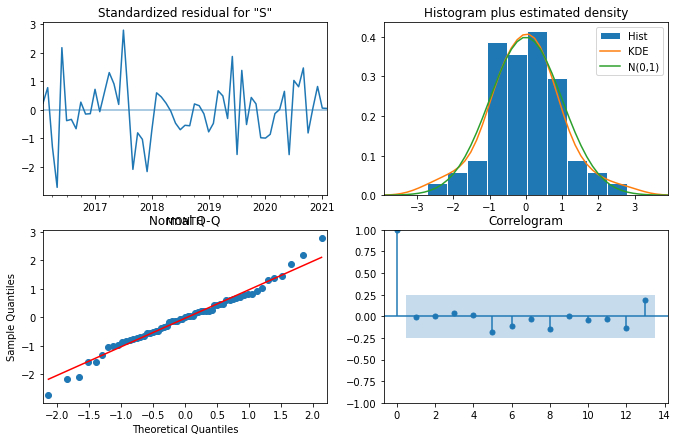

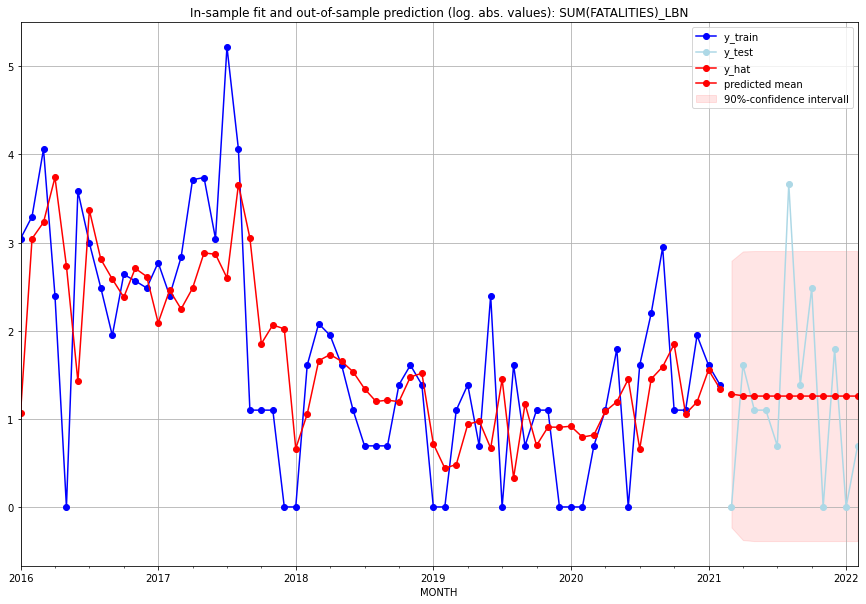

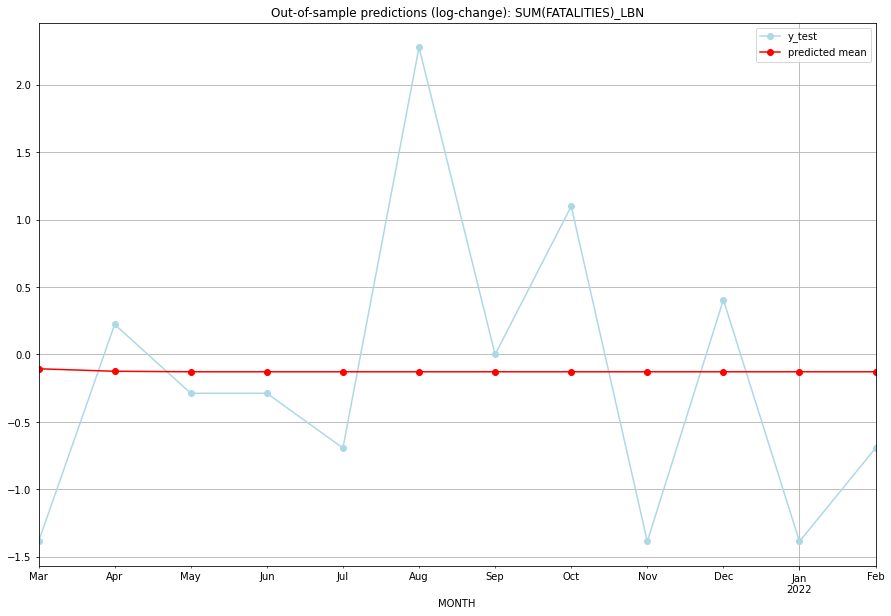

TADDA: 0.8663279032643776
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  2.597869         0.0     -0.105953       -1.386294   LBN   
1  2021-04-01  2.532204         4.0     -0.124372        0.223144   LBN   
2  2021-05-01  2.519017         2.0     -0.128113       -0.287682   LBN   
3  2021-06-01  2.519017         2.0     -0.128113       -0.287682   LBN   
4  2021-07-01  2.519017         1.0     -0.128113       -0.693147   LBN   
5  2021-08-01  2.519017        38.0     -0.128113        2.277267   LBN   
6  2021-09-01  2.519017         3.0     -0.128113        0.000000   LBN   
7  2021-10-01  2.519017        11.0     -0.128113        1.098612   LBN   
8  2021-11-01  2.519017         0.0     -0.128113       -1.386294   LBN   
9  2021-12-01  2.519017         5.0     -0.128113        0.405465   LBN   
10 2022-01-01  2.519017         0.0     -0.128113       -1.386294   LBN   
11 2022-02-01  2.519017         1.0     -0.128113    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (1, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.3567096332239187, 'fold_results': [0.46209812037329684, 0.3554860599295475, 0.23104906018664842, 0.6193903955367764, 0.11552453009332421]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_LBR   No. Observations:                  289
Model:                SARIMAX(1, 0, 0)   Log Likelihood                -386.398
Date:                 Wed, 19 Oct 2022   AIC                            776.795
Time:                         10:56:15   BIC                            784.128
Sample:                     02-28-1997   HQIC                           779.734
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------

<Figure size 432x288 with 0 Axes>

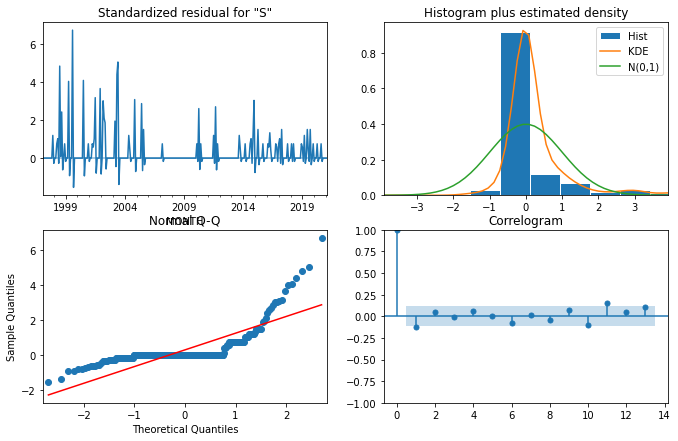

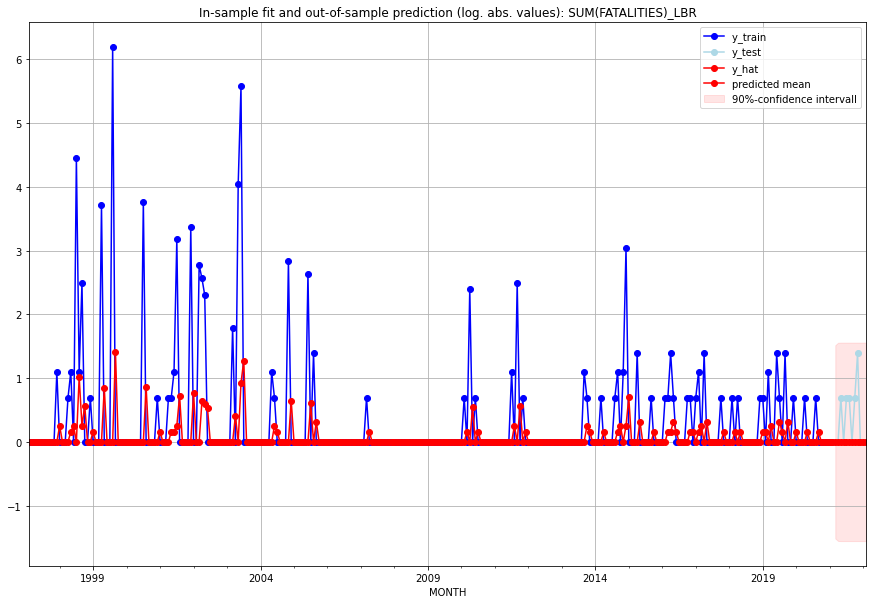

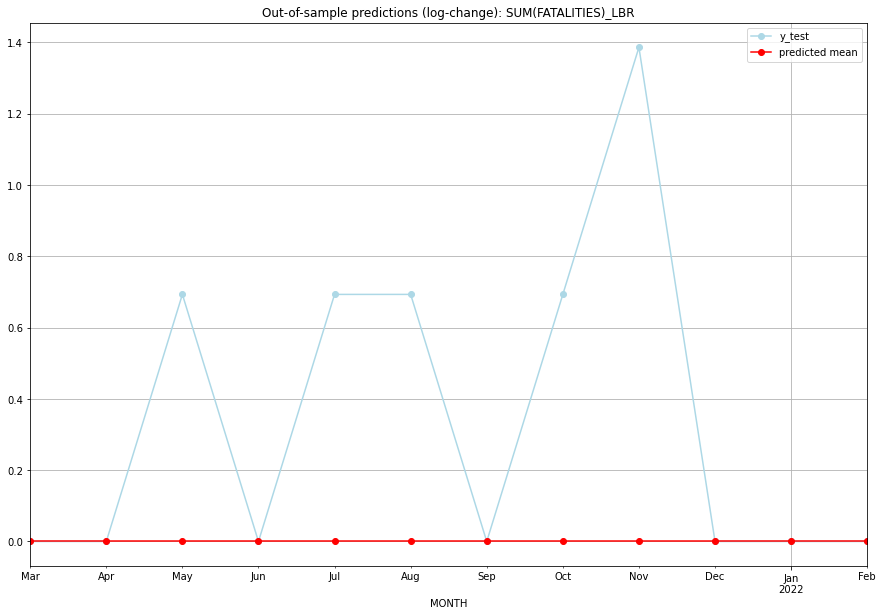

TADDA: 0.34657359027997264
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0        0.000000   LBR   
1  2021-04-01       0.0         0.0           0.0        0.000000   LBR   
2  2021-05-01       0.0         1.0           0.0        0.693147   LBR   
3  2021-06-01       0.0         0.0           0.0        0.000000   LBR   
4  2021-07-01       0.0         1.0           0.0        0.693147   LBR   
5  2021-08-01       0.0         1.0           0.0        0.693147   LBR   
6  2021-09-01       0.0         0.0           0.0        0.000000   LBR   
7  2021-10-01       0.0         1.0           0.0        0.693147   LBR   
8  2021-11-01       0.0         3.0           0.0        1.386294   LBR   
9  2021-12-01       0.0         0.0           0.0        0.000000   LBR   
10 2022-01-01       0.0         0.0           0.0        0.000000   LBR   
11 2022-02-01       0.0         0.0           0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.9241841025254294, 'fold_results': [0.2771158018421405, 0.6031575219386583, 1.1390516845719183, 0.8028211416237969, 1.798774362650633]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_LBY   No. Observations:                  289
Model:                SARIMAX(0, 1, 0)   Log Likelihood                -399.355
Date:                 Wed, 19 Oct 2022   AIC                            800.709
Time:                         10:56:52   BIC                            804.372
Sample:                     02-28-1997   HQIC                           802.177
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------

<Figure size 432x288 with 0 Axes>

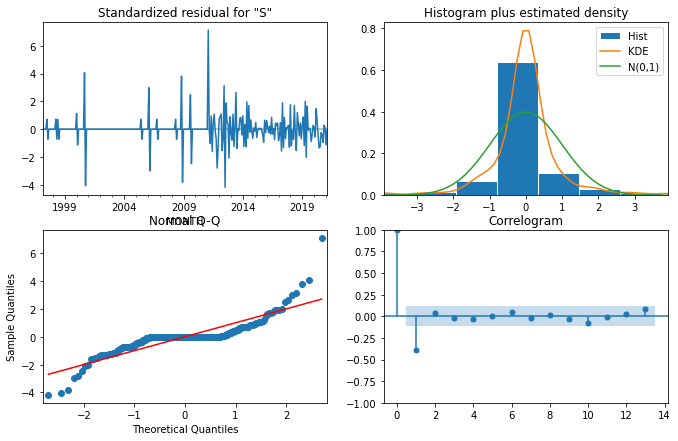

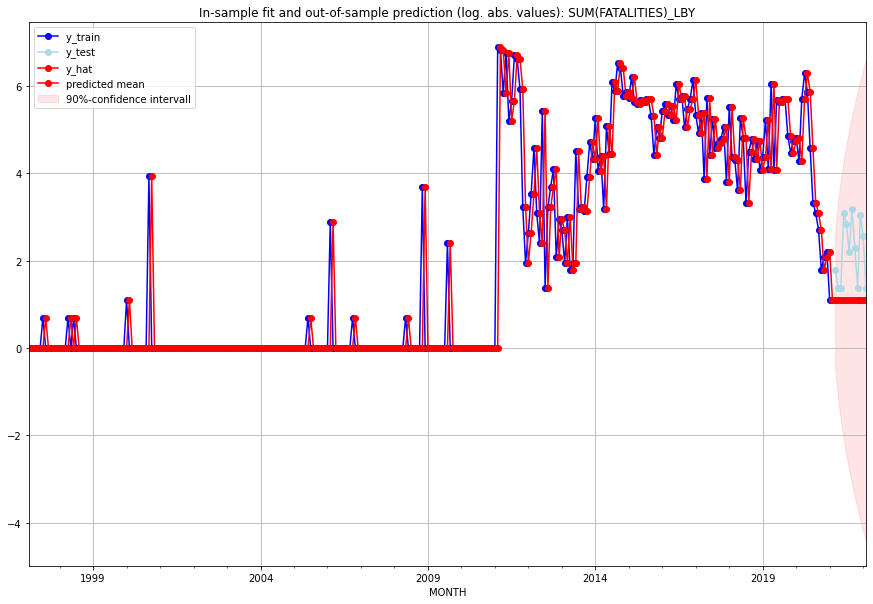

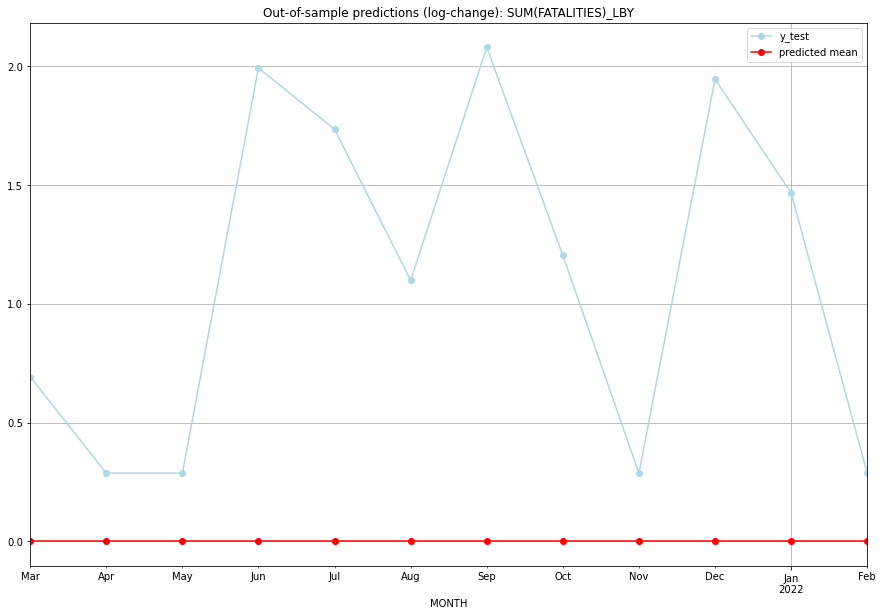

TADDA: 1.1137650452473336
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       2.0         5.0           0.0        0.693147   LBY   
1  2021-04-01       2.0         3.0           0.0        0.287682   LBY   
2  2021-05-01       2.0         3.0           0.0        0.287682   LBY   
3  2021-06-01       2.0        21.0           0.0        1.992430   LBY   
4  2021-07-01       2.0        16.0           0.0        1.734601   LBY   
5  2021-08-01       2.0         8.0           0.0        1.098612   LBY   
6  2021-09-01       2.0        23.0           0.0        2.079442   LBY   
7  2021-10-01       2.0         9.0           0.0        1.203973   LBY   
8  2021-11-01       2.0         3.0           0.0        0.287682   LBY   
9  2021-12-01       2.0        20.0           0.0        1.945910   LBY   
10 2022-01-01       2.0        12.0           0.0        1.466337   LBY   
11 2022-02-01       2.0         3.0           0.0    

<Figure size 432x288 with 0 Axes>

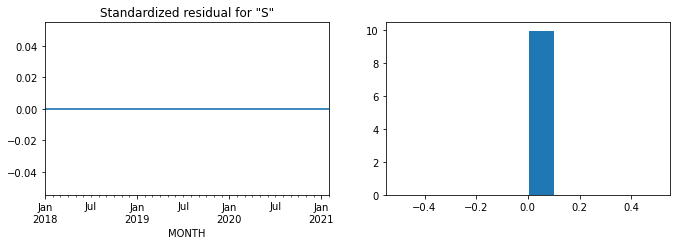

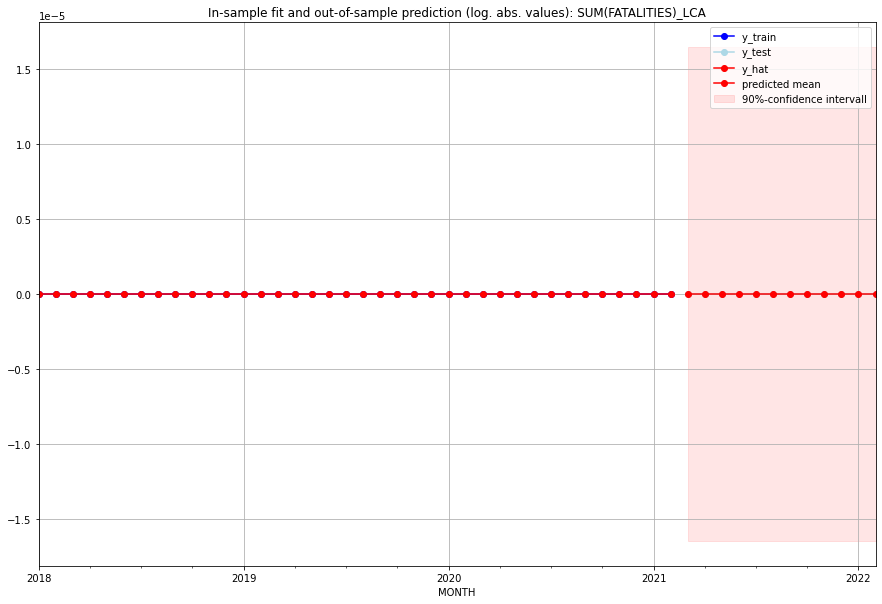

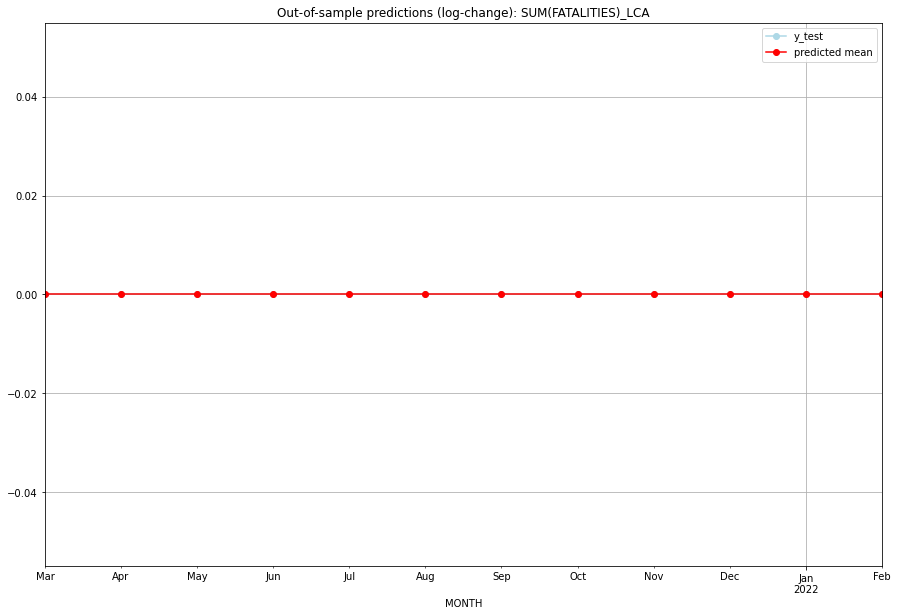

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   LCA   
1  2021-04-01       0.0         0.0           0.0             0.0   LCA   
2  2021-05-01       0.0         0.0           0.0             0.0   LCA   
3  2021-06-01       0.0         0.0           0.0             0.0   LCA   
4  2021-07-01       0.0         0.0           0.0             0.0   LCA   
5  2021-08-01       0.0         0.0           0.0             0.0   LCA   
6  2021-09-01       0.0         0.0           0.0             0.0   LCA   
7  2021-10-01       0.0         0.0           0.0             0.0   LCA   
8  2021-11-01       0.0         0.0           0.0             0.0   LCA   
9  2021-12-01       0.0         0.0           0.0             0.0   LCA   
10 2022-01-01       0.0         0.0           0.0             0.0   LCA   
11 2022-02-01       0.0         0.0           0.0             0.0   

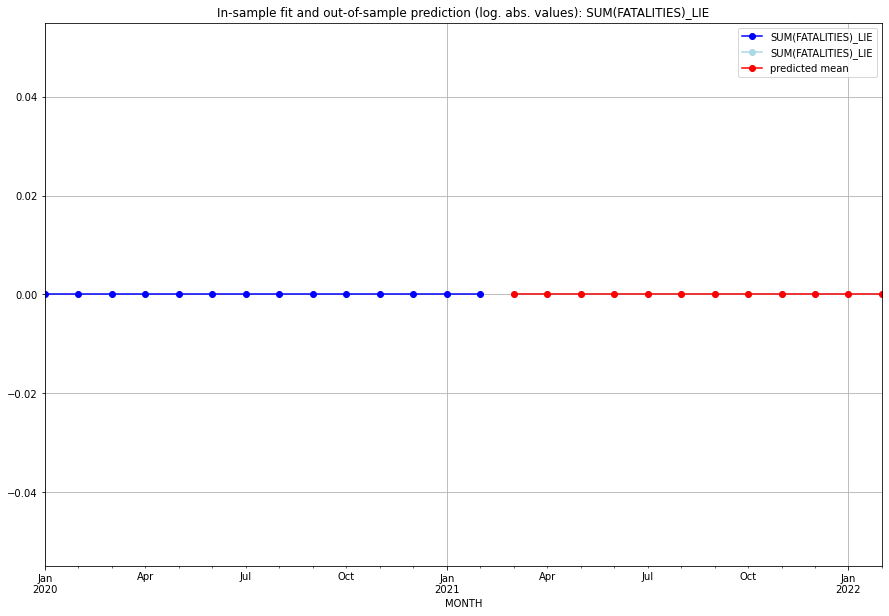

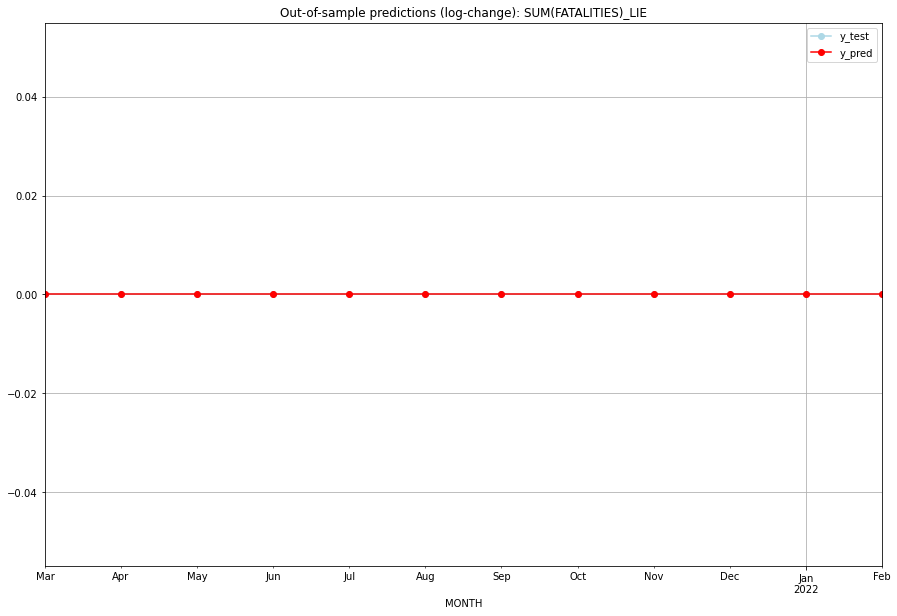

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   LIE   
1  2021-04-01       0.0         0.0           0.0             0.0   LIE   
2  2021-05-01       0.0         0.0           0.0             0.0   LIE   
3  2021-06-01       0.0         0.0           0.0             0.0   LIE   
4  2021-07-01       0.0         0.0           0.0             0.0   LIE   
5  2021-08-01       0.0         0.0           0.0             0.0   LIE   
6  2021-09-01       0.0         0.0           0.0             0.0   LIE   
7  2021-10-01       0.0         0.0           0.0             0.0   LIE   
8  2021-11-01       0.0         0.0           0.0             0.0   LIE   
9  2021-12-01       0.0         0.0           0.0             0.0   LIE   
10 2022-01-01       0.0         0.0           0.0             0.0   LIE   
11 2022-02-01       0.0         0.0           0.0             0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.5951532345418479, 'fold_results': [0.6114114094756348, 0.1493132891023379, 0.5033545592731179, 1.0549532194685738, 0.6567336953895752]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_LKA   No. Observations:                  134
Model:                SARIMAX(0, 1, 0)   Log Likelihood                -192.565
Date:                 Wed, 19 Oct 2022   AIC                            387.130
Time:                         10:57:26   BIC                            390.020
Sample:                     01-31-2010   HQIC                           388.305
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------

<Figure size 432x288 with 0 Axes>

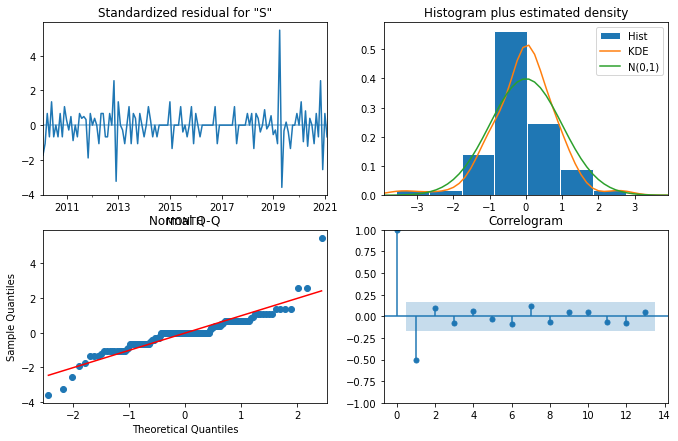

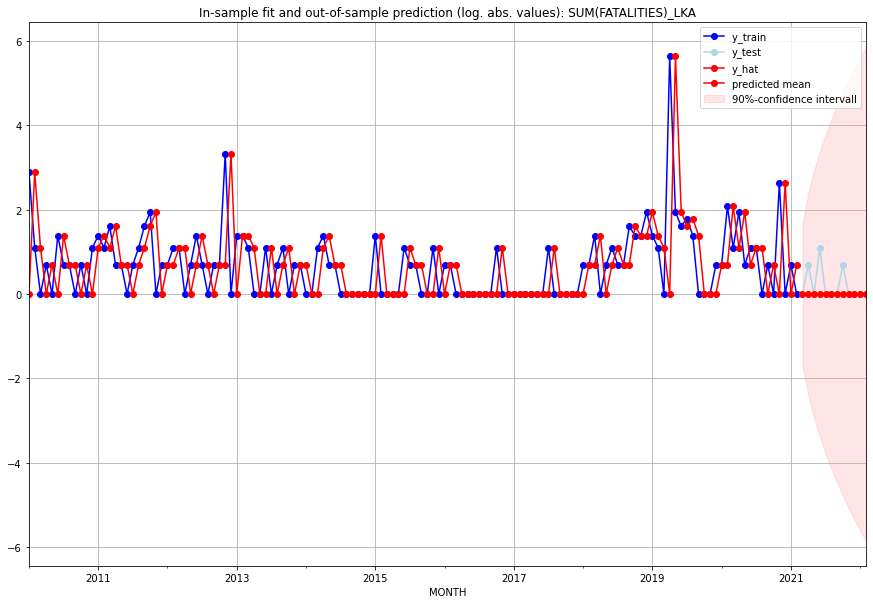

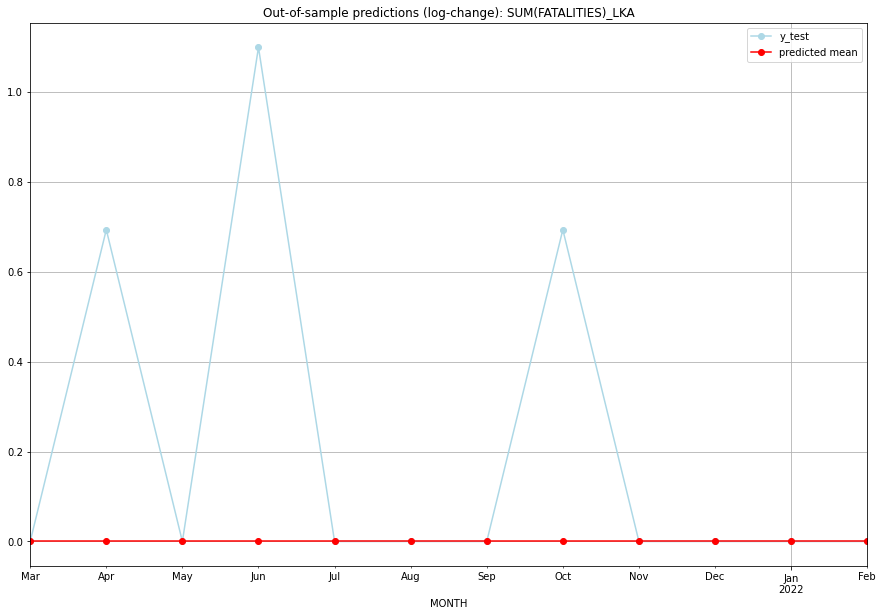

TADDA: 0.20707555414900003
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0        0.000000   LKA   
1  2021-04-01       0.0         1.0           0.0        0.693147   LKA   
2  2021-05-01       0.0         0.0           0.0        0.000000   LKA   
3  2021-06-01       0.0         2.0           0.0        1.098612   LKA   
4  2021-07-01       0.0         0.0           0.0        0.000000   LKA   
5  2021-08-01       0.0         0.0           0.0        0.000000   LKA   
6  2021-09-01       0.0         0.0           0.0        0.000000   LKA   
7  2021-10-01       0.0         1.0           0.0        0.693147   LKA   
8  2021-11-01       0.0         0.0           0.0        0.000000   LKA   
9  2021-12-01       0.0         0.0           0.0        0.000000   LKA   
10 2022-01-01       0.0         0.0           0.0        0.000000   LKA   
11 2022-02-01       0.0         0.0           0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.14431154589483228, 'fold_results': [0.13411982603617503, 0.17328679513998632, 0.0, 0.29862657820467586, 0.11552453009332421]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_LSO   No. Observations:                  289
Model:                         SARIMAX   Log Likelihood                -215.594
Date:                 Wed, 19 Oct 2022   AIC                            433.187
Time:                         10:57:59   BIC                            436.854
Sample:                     02-28-1997   HQIC                           434.656
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------

<Figure size 432x288 with 0 Axes>

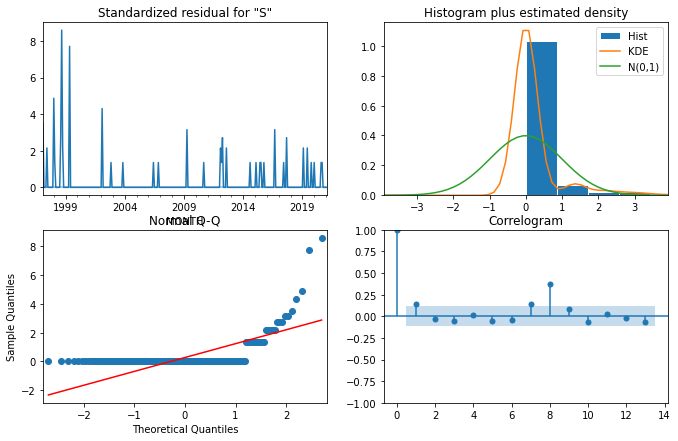

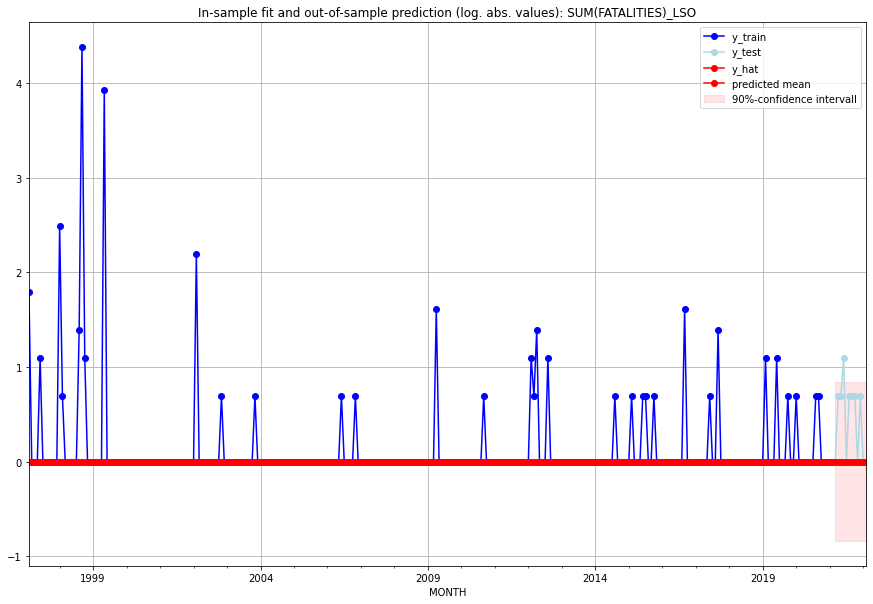

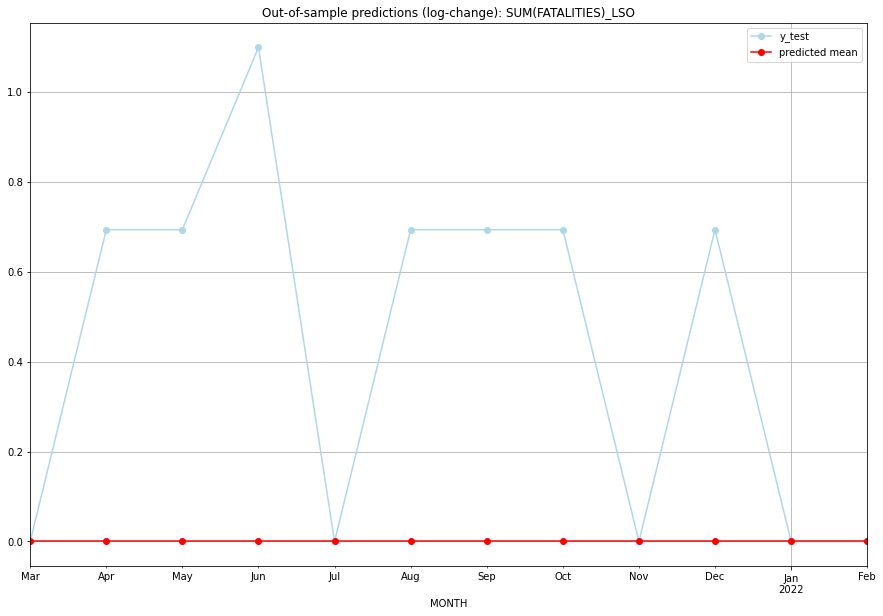

TADDA: 0.4381246143356485
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0        0.000000   LSO   
1  2021-04-01       0.0         1.0           0.0        0.693147   LSO   
2  2021-05-01       0.0         1.0           0.0        0.693147   LSO   
3  2021-06-01       0.0         2.0           0.0        1.098612   LSO   
4  2021-07-01       0.0         0.0           0.0        0.000000   LSO   
5  2021-08-01       0.0         1.0           0.0        0.693147   LSO   
6  2021-09-01       0.0         1.0           0.0        0.693147   LSO   
7  2021-10-01       0.0         1.0           0.0        0.693147   LSO   
8  2021-11-01       0.0         0.0           0.0        0.000000   LSO   
9  2021-12-01       0.0         1.0           0.0        0.693147   LSO   
10 2022-01-01       0.0         0.0           0.0        0.000000   LSO   
11 2022-02-01       0.0         0.0           0.0    

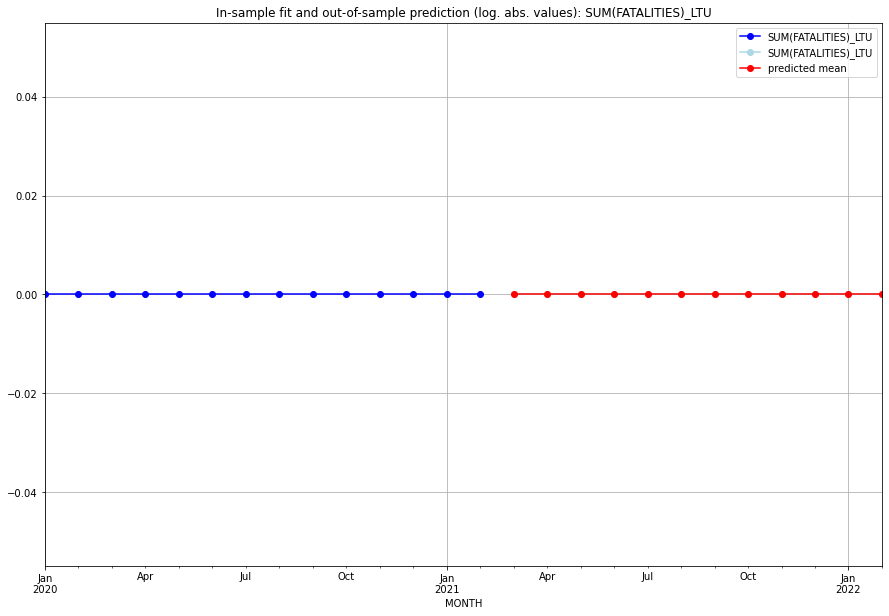

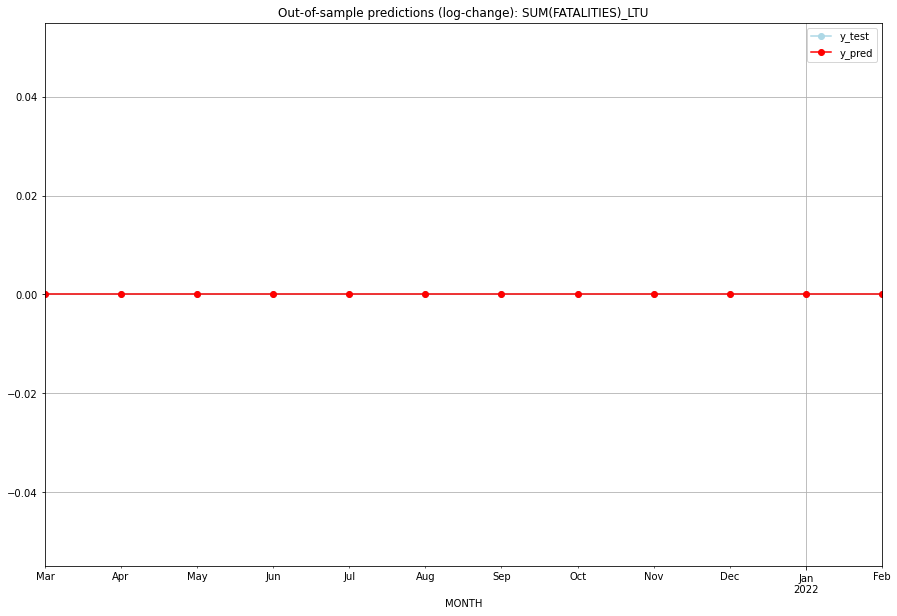

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   LTU   
1  2021-04-01       0.0         0.0           0.0             0.0   LTU   
2  2021-05-01       0.0         0.0           0.0             0.0   LTU   
3  2021-06-01       0.0         0.0           0.0             0.0   LTU   
4  2021-07-01       0.0         0.0           0.0             0.0   LTU   
5  2021-08-01       0.0         0.0           0.0             0.0   LTU   
6  2021-09-01       0.0         0.0           0.0             0.0   LTU   
7  2021-10-01       0.0         0.0           0.0             0.0   LTU   
8  2021-11-01       0.0         0.0           0.0             0.0   LTU   
9  2021-12-01       0.0         0.0           0.0             0.0   LTU   
10 2022-01-01       0.0         0.0           0.0             0.0   LTU   
11 2022-02-01       0.0         0.0           0.0             0.0   

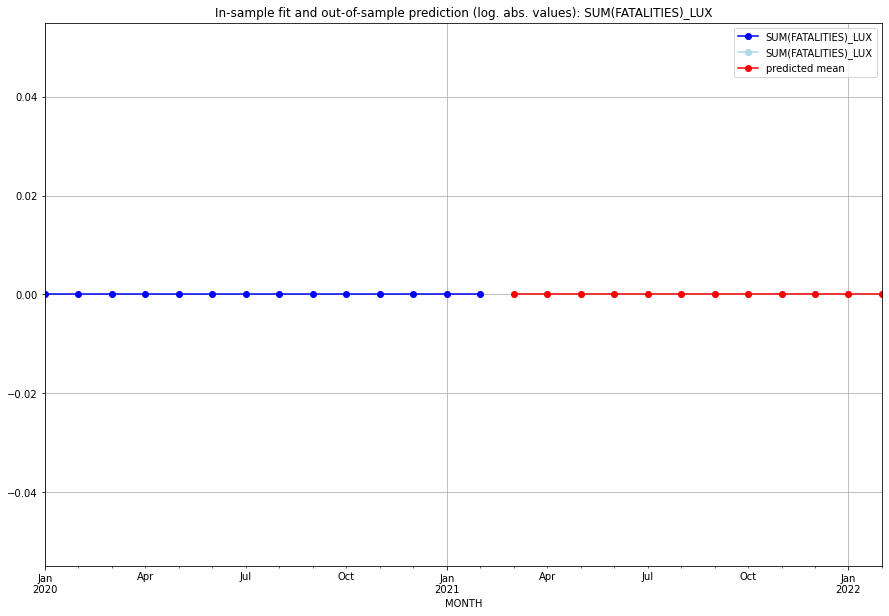

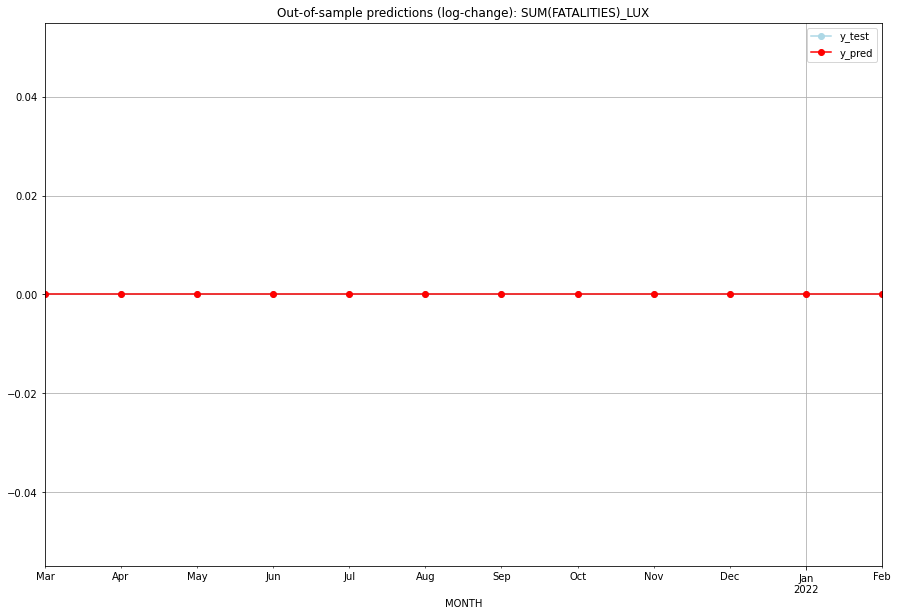

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   LUX   
1  2021-04-01       0.0         0.0           0.0             0.0   LUX   
2  2021-05-01       0.0         0.0           0.0             0.0   LUX   
3  2021-06-01       0.0         0.0           0.0             0.0   LUX   
4  2021-07-01       0.0         0.0           0.0             0.0   LUX   
5  2021-08-01       0.0         0.0           0.0             0.0   LUX   
6  2021-09-01       0.0         0.0           0.0             0.0   LUX   
7  2021-10-01       0.0         0.0           0.0             0.0   LUX   
8  2021-11-01       0.0         0.0           0.0             0.0   LUX   
9  2021-12-01       0.0         0.0           0.0             0.0   LUX   
10 2022-01-01       0.0         0.0           0.0             0.0   LUX   
11 2022-02-01       0.0         0.0           0.0             0.0   

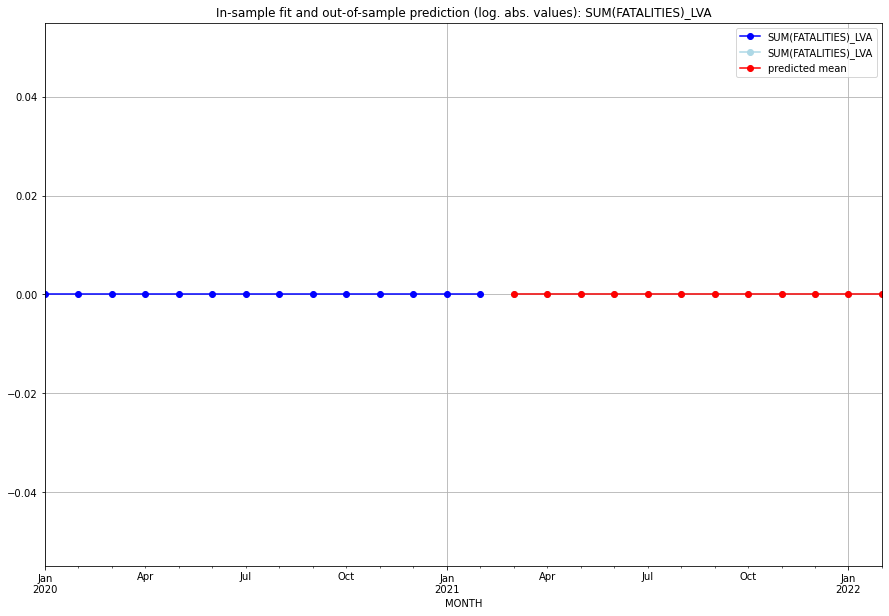

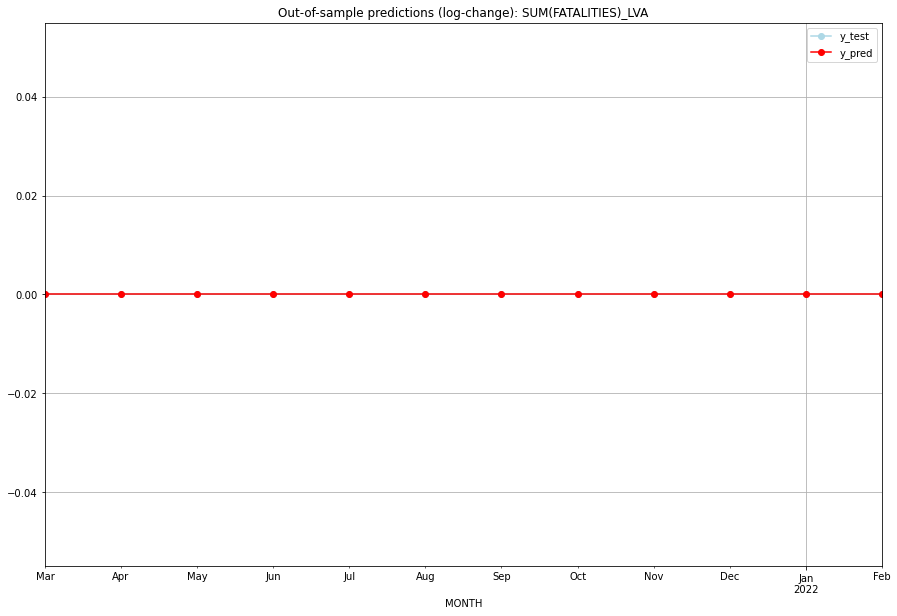

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   LVA   
1  2021-04-01       0.0         0.0           0.0             0.0   LVA   
2  2021-05-01       0.0         0.0           0.0             0.0   LVA   
3  2021-06-01       0.0         0.0           0.0             0.0   LVA   
4  2021-07-01       0.0         0.0           0.0             0.0   LVA   
5  2021-08-01       0.0         0.0           0.0             0.0   LVA   
6  2021-09-01       0.0         0.0           0.0             0.0   LVA   
7  2021-10-01       0.0         0.0           0.0             0.0   LVA   
8  2021-11-01       0.0         0.0           0.0             0.0   LVA   
9  2021-12-01       0.0         0.0           0.0             0.0   LVA   
10 2022-01-01       0.0         0.0           0.0             0.0   LVA   
11 2022-02-01       0.0         0.0           0.0             0.0   

<Figure size 432x288 with 0 Axes>

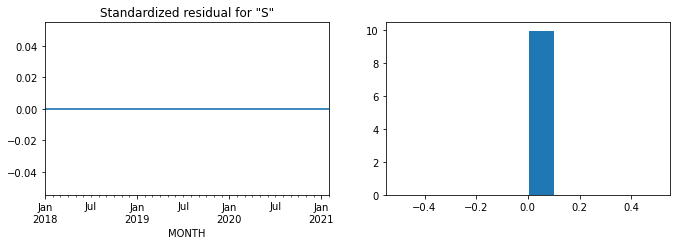

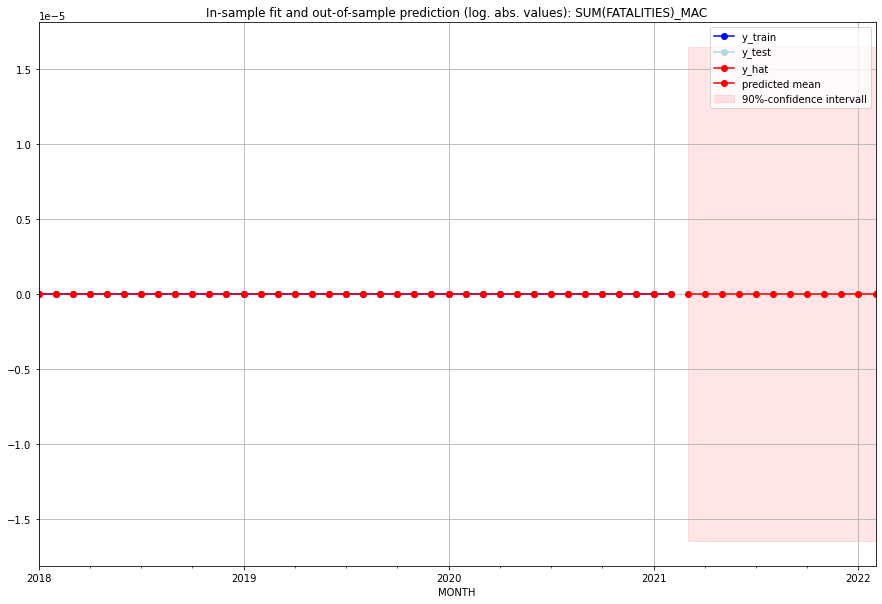

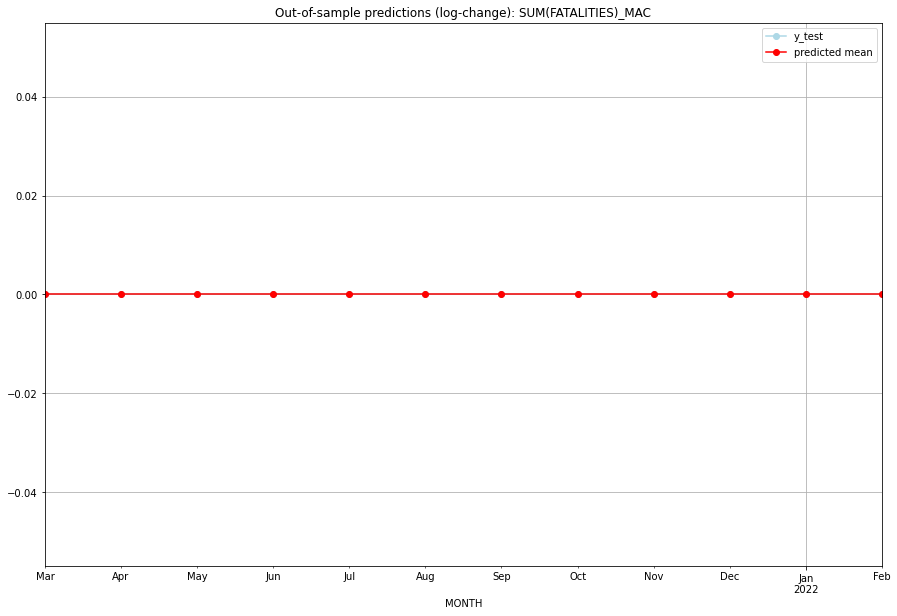

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   MAC   
1  2021-04-01       0.0         0.0           0.0             0.0   MAC   
2  2021-05-01       0.0         0.0           0.0             0.0   MAC   
3  2021-06-01       0.0         0.0           0.0             0.0   MAC   
4  2021-07-01       0.0         0.0           0.0             0.0   MAC   
5  2021-08-01       0.0         0.0           0.0             0.0   MAC   
6  2021-09-01       0.0         0.0           0.0             0.0   MAC   
7  2021-10-01       0.0         0.0           0.0             0.0   MAC   
8  2021-11-01       0.0         0.0           0.0             0.0   MAC   
9  2021-12-01       0.0         0.0           0.0             0.0   MAC   
10 2022-01-01       0.0         0.0           0.0             0.0   MAC   
11 2022-02-01       0.0         0.0           0.0             0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.14255553730053516, 'fold_results': [0.0, 0.20707555414900003, 0.35638884325133796, 0.1493132891023379, 0.0]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_MAR   No. Observations:                  289
Model:                         SARIMAX   Log Likelihood                -185.334
Date:                 Wed, 19 Oct 2022   AIC                            372.667
Time:                         10:58:59   BIC                            376.333
Sample:                     02-28-1997   HQIC                           374.136
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------------------

<Figure size 432x288 with 0 Axes>

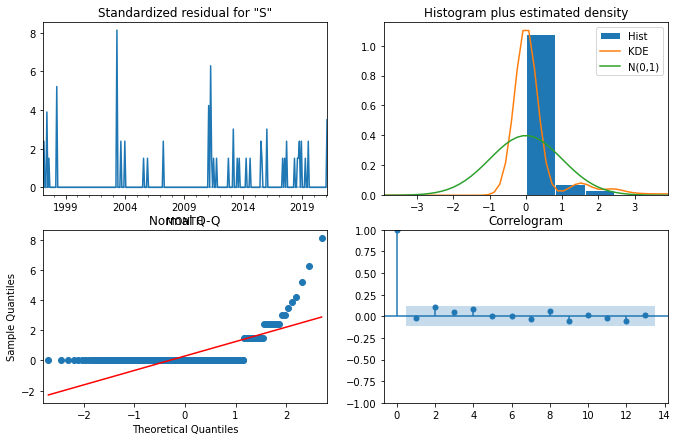

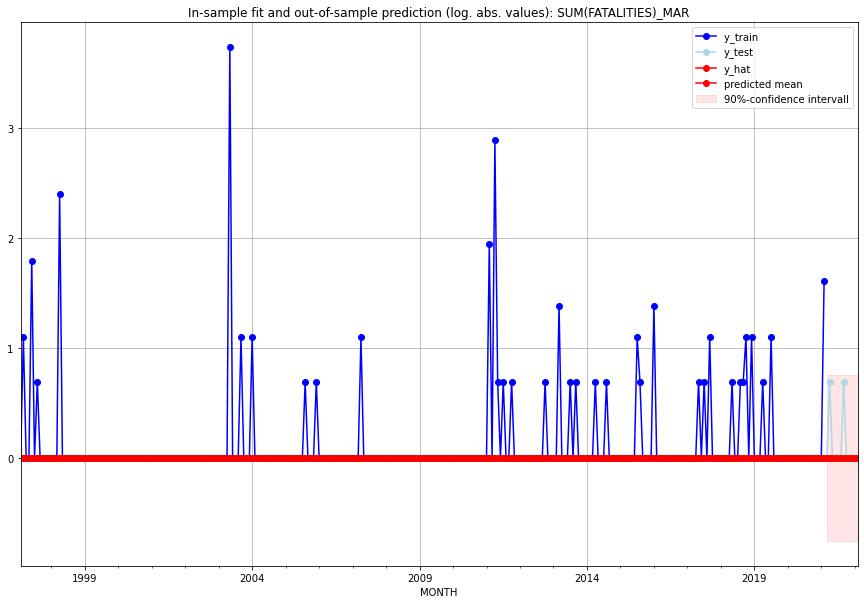

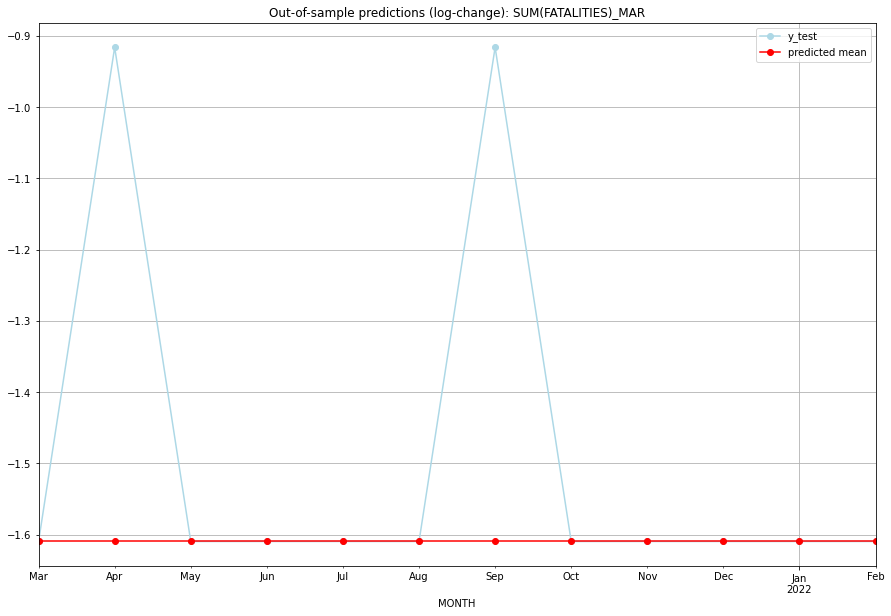

TADDA: 0.11552453009332421
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0     -1.609438       -1.609438   MAR   
1  2021-04-01       0.0         1.0     -1.609438       -0.916291   MAR   
2  2021-05-01       0.0         0.0     -1.609438       -1.609438   MAR   
3  2021-06-01       0.0         0.0     -1.609438       -1.609438   MAR   
4  2021-07-01       0.0         0.0     -1.609438       -1.609438   MAR   
5  2021-08-01       0.0         0.0     -1.609438       -1.609438   MAR   
6  2021-09-01       0.0         1.0     -1.609438       -0.916291   MAR   
7  2021-10-01       0.0         0.0     -1.609438       -1.609438   MAR   
8  2021-11-01       0.0         0.0     -1.609438       -1.609438   MAR   
9  2021-12-01       0.0         0.0     -1.609438       -1.609438   MAR   
10 2022-01-01       0.0         0.0     -1.609438       -1.609438   MAR   
11 2022-02-01       0.0         0.0     -1.609438   

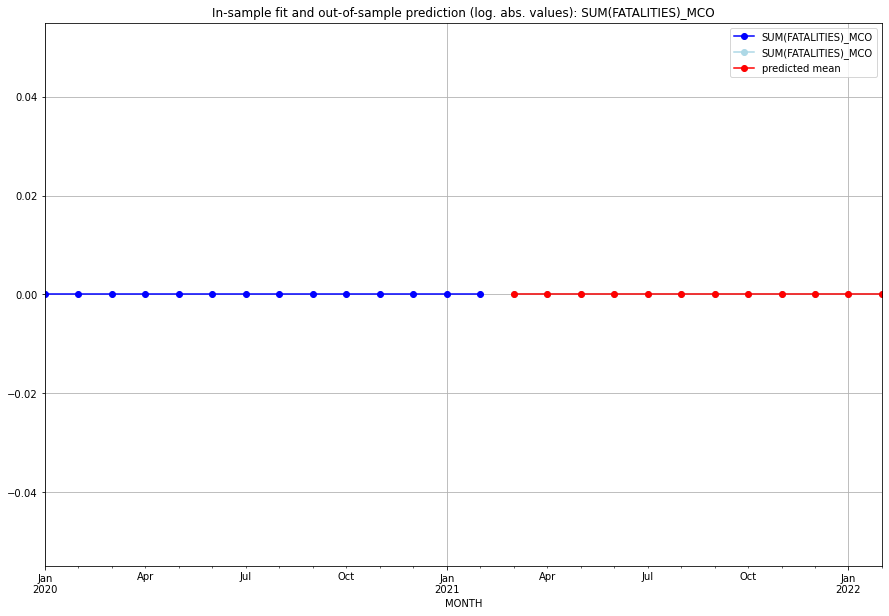

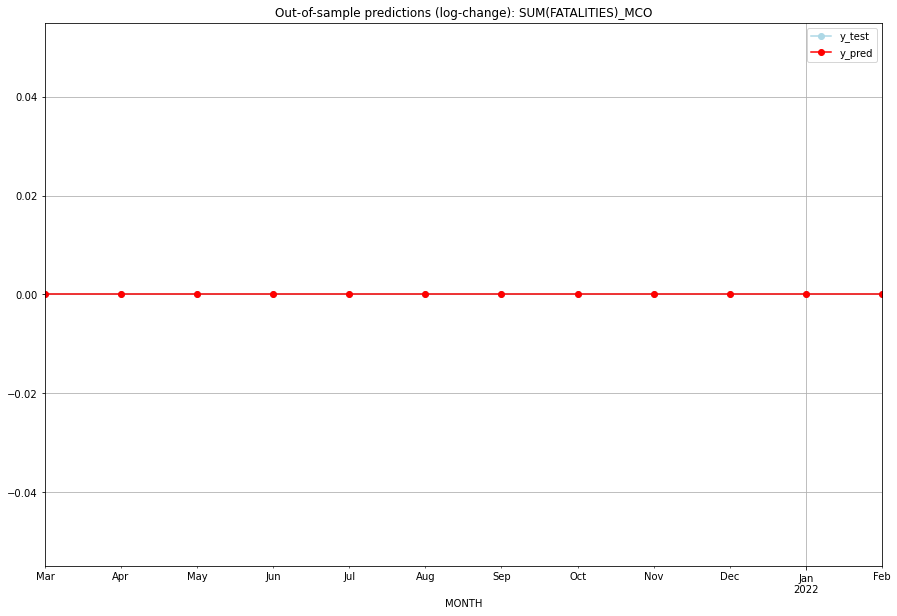

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   MCO   
1  2021-04-01       0.0         0.0           0.0             0.0   MCO   
2  2021-05-01       0.0         0.0           0.0             0.0   MCO   
3  2021-06-01       0.0         0.0           0.0             0.0   MCO   
4  2021-07-01       0.0         0.0           0.0             0.0   MCO   
5  2021-08-01       0.0         0.0           0.0             0.0   MCO   
6  2021-09-01       0.0         0.0           0.0             0.0   MCO   
7  2021-10-01       0.0         0.0           0.0             0.0   MCO   
8  2021-11-01       0.0         0.0           0.0             0.0   MCO   
9  2021-12-01       0.0         0.0           0.0             0.0   MCO   
10 2022-01-01       0.0         0.0           0.0             0.0   MCO   
11 2022-02-01       0.0         0.0           0.0             0.0   

<Figure size 432x288 with 0 Axes>

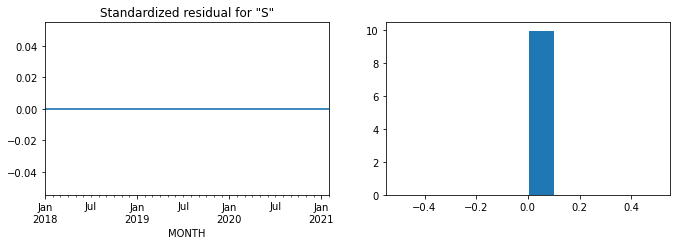

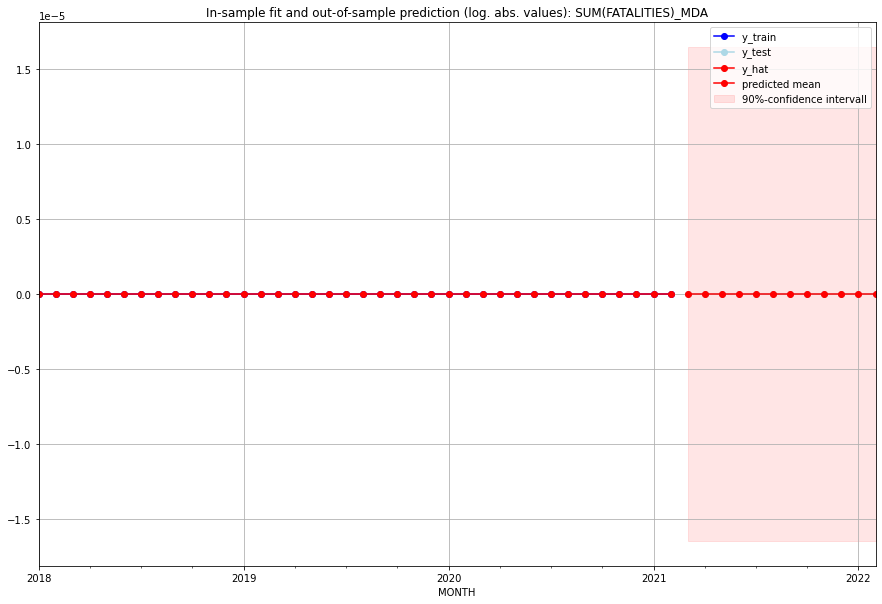

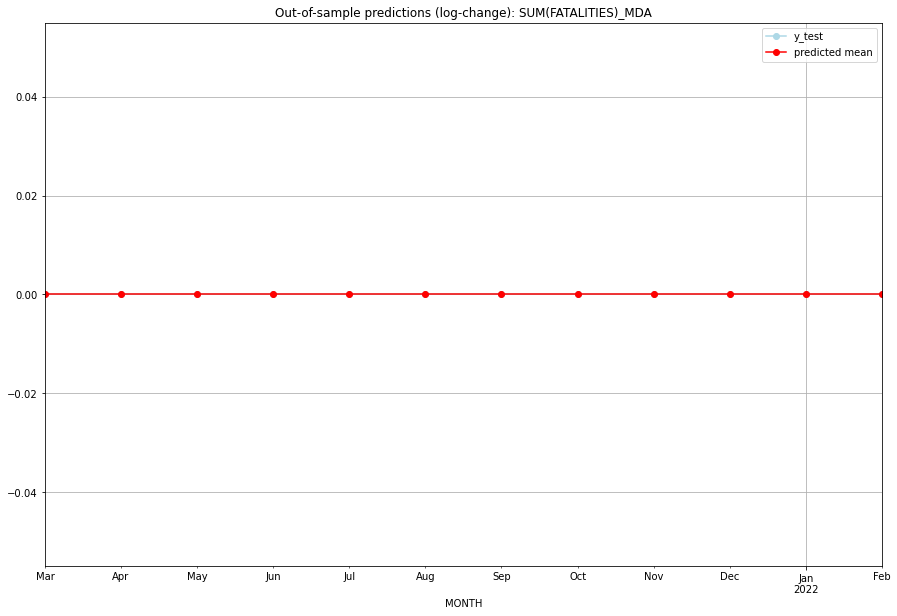

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   MDA   
1  2021-04-01       0.0         0.0           0.0             0.0   MDA   
2  2021-05-01       0.0         0.0           0.0             0.0   MDA   
3  2021-06-01       0.0         0.0           0.0             0.0   MDA   
4  2021-07-01       0.0         0.0           0.0             0.0   MDA   
5  2021-08-01       0.0         0.0           0.0             0.0   MDA   
6  2021-09-01       0.0         0.0           0.0             0.0   MDA   
7  2021-10-01       0.0         0.0           0.0             0.0   MDA   
8  2021-11-01       0.0         0.0           0.0             0.0   MDA   
9  2021-12-01       0.0         0.0           0.0             0.0   MDA   
10 2022-01-01       0.0         0.0           0.0             0.0   MDA   
11 2022-02-01       0.0         0.0           0.0             0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (3, 1, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.7549703286591043, 'fold_results': [1.0532978648547762, 0.5566134830115996, 0.7625294761378055, 0.8131863113109228, 0.5892245079804171]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_MDG   No. Observations:                  289
Model:                SARIMAX(3, 1, 3)   Log Likelihood                -354.551
Date:                 Wed, 19 Oct 2022   AIC                            723.103
Time:                         10:59:38   BIC                            748.744
Sample:                     02-28-1997   HQIC                           733.378
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------

<Figure size 432x288 with 0 Axes>

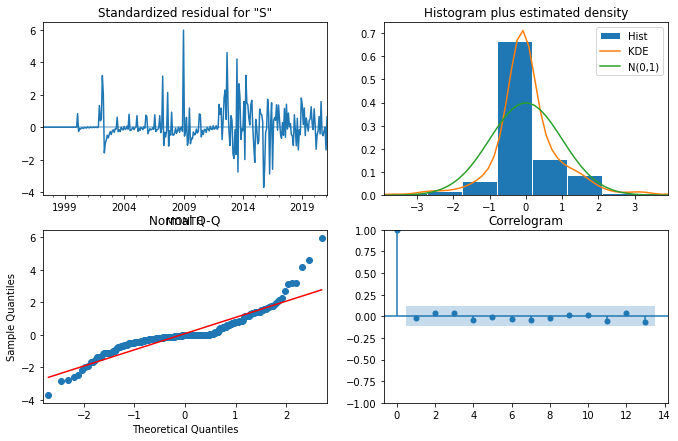

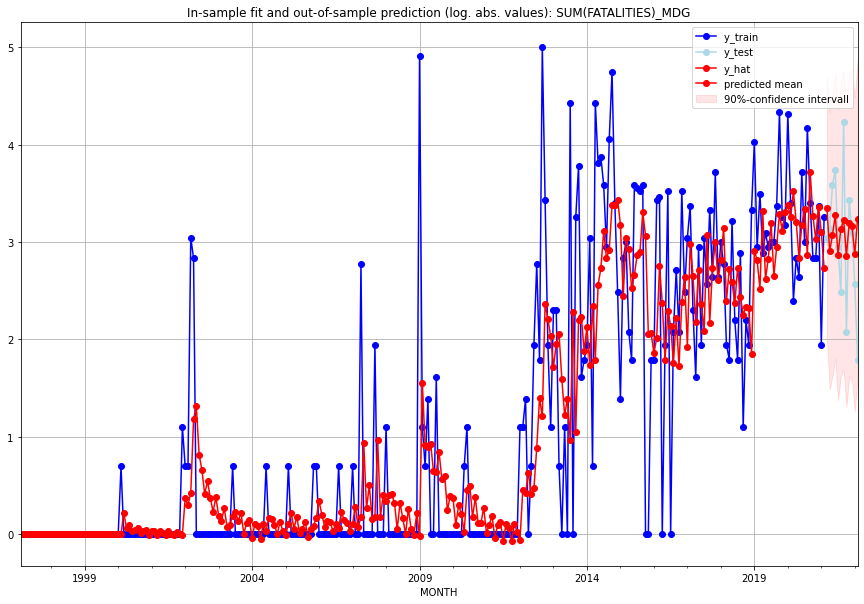

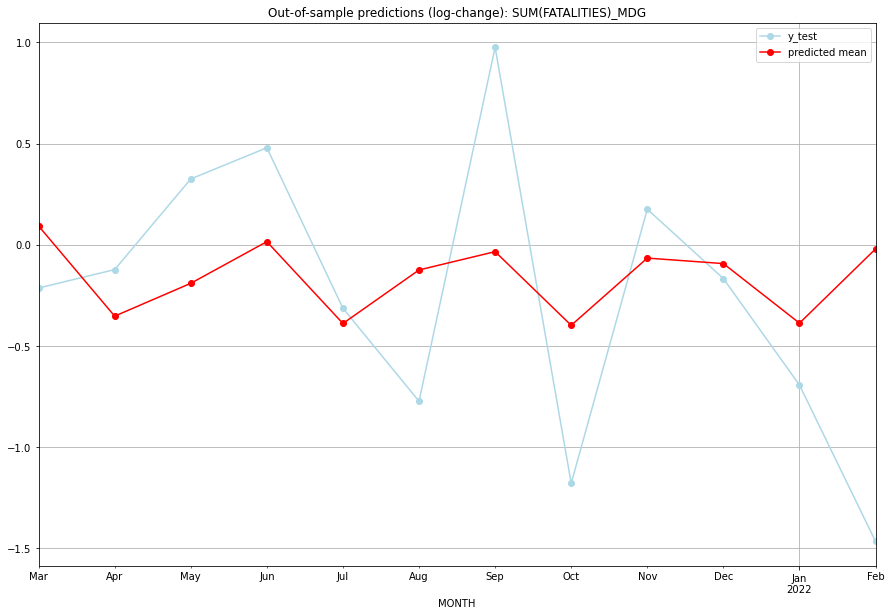

TADDA: 0.5401625501414217
Evaluation finished.
        MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  27.535691        20.0      0.093059       -0.213574   MDG   
1  2021-04-01  17.274364        22.0     -0.352597       -0.122602   MDG   
2  2021-05-01  20.493326        35.0     -0.190354        0.325422   MDG   
3  2021-06-01  25.406252        41.0      0.015504        0.479573   MDG   
4  2021-07-01  16.623289        18.0     -0.388875       -0.313658   MDG   
5  2021-08-01  21.959460        11.0     -0.124366       -0.773190   MDG   
6  2021-09-01  24.133983        68.0     -0.033876        0.976010   MDG   
7  2021-10-01  16.464510         7.0     -0.397926       -1.178655   MDG   
8  2021-11-01  23.346265        30.0     -0.065718        0.175891   MDG   
9  2021-12-01  22.694453        21.0     -0.092856       -0.167054   MDG   
10 2022-01-01  16.652028        12.0     -0.387246       -0.693147   MDG   
11 2022-02-01  24.479265         5.0     

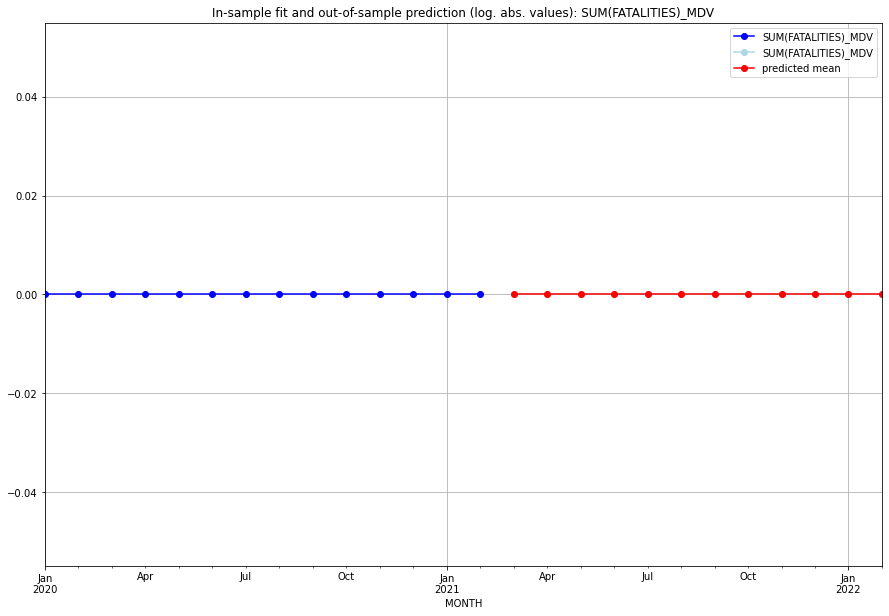

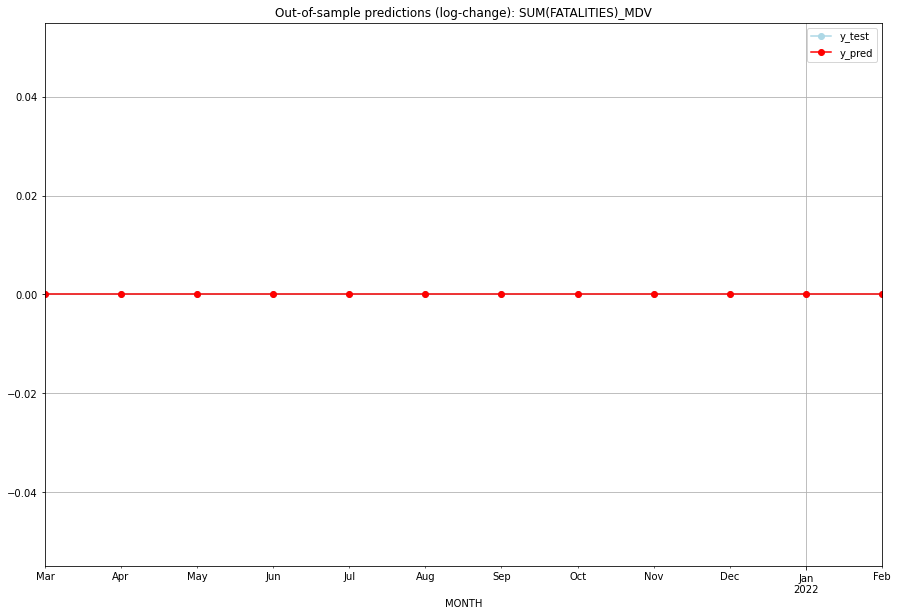

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   MDV   
1  2021-04-01       0.0         0.0           0.0             0.0   MDV   
2  2021-05-01       0.0         0.0           0.0             0.0   MDV   
3  2021-06-01       0.0         0.0           0.0             0.0   MDV   
4  2021-07-01       0.0         0.0           0.0             0.0   MDV   
5  2021-08-01       0.0         0.0           0.0             0.0   MDV   
6  2021-09-01       0.0         0.0           0.0             0.0   MDV   
7  2021-10-01       0.0         0.0           0.0             0.0   MDV   
8  2021-11-01       0.0         0.0           0.0             0.0   MDV   
9  2021-12-01       0.0         0.0           0.0             0.0   MDV   
10 2022-01-01       0.0         0.0           0.0             0.0   MDV   
11 2022-02-01       0.0         0.0           0.0             0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (0, 1, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.09455473355956918, 'fold_results': [nan, 0.09455473355956918]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_MEX   No. Observations:                   38
Model:                SARIMAX(0, 1, 3)   Log Likelihood                  25.880
Date:                 Wed, 19 Oct 2022   AIC                            -37.760
Time:                         10:59:54   BIC                            -26.483
Sample:                     01-31-2018   HQIC                           -33.784
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             0.0056      0.017      0.33

<Figure size 432x288 with 0 Axes>

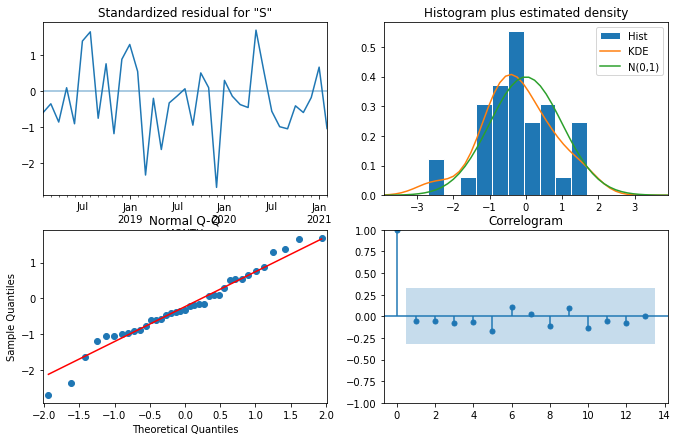

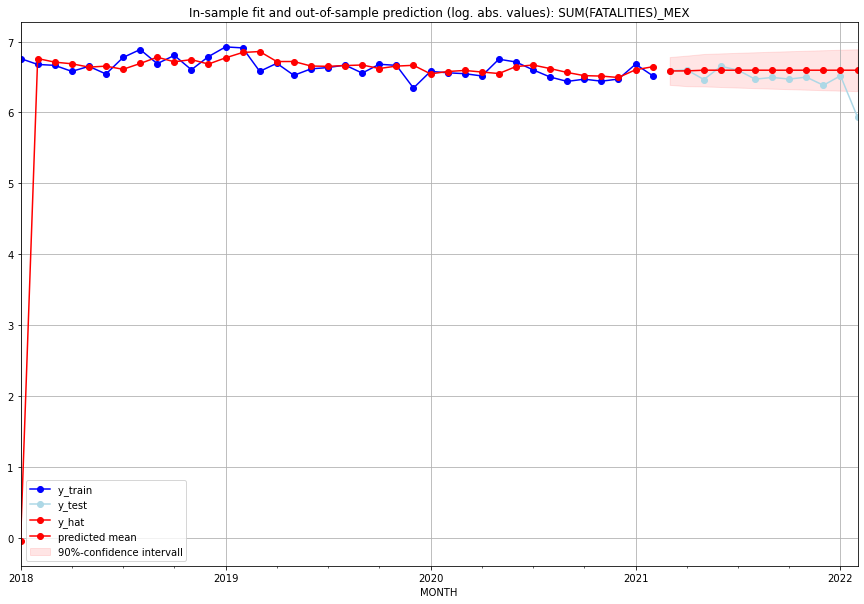

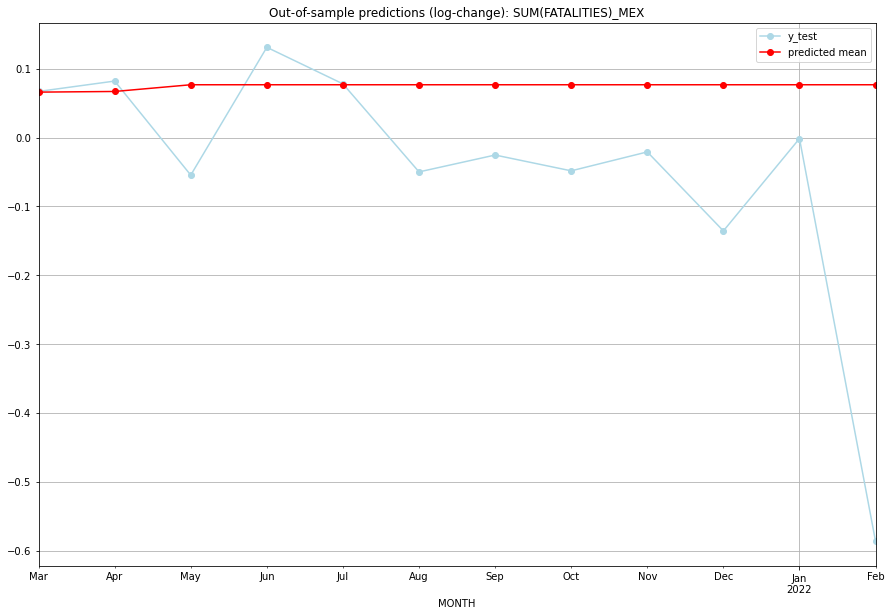

TADDA: 0.18521021472745755
Evaluation finished.
        MONTH    FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  723.269110       724.0      0.066016        0.067024   MEX   
1  2021-04-01  723.955064       735.0      0.066962        0.082083   MEX   
2  2021-05-01  731.068867       641.0      0.076727       -0.054559   MEX   
3  2021-06-01  731.068867       772.0      0.076727        0.131132   MEX   
4  2021-07-01  731.068867       732.0      0.076727        0.077998   MEX   
5  2021-08-01  731.068867       644.0      0.076727       -0.049897   MEX   
6  2021-09-01  731.068867       660.0      0.076727       -0.025393   MEX   
7  2021-10-01  731.068867       645.0      0.076727       -0.048348   MEX   
8  2021-11-01  731.068867       663.0      0.076727       -0.020865   MEX   
9  2021-12-01  731.068867       591.0      0.076727       -0.135641   MEX   
10 2022-01-01  731.068867       676.0      0.076727       -0.001476   MEX   
11 2022-02-01  731.068867   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.0, 'fold_results': [0.0, 0.0]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_MKD   No. Observations:                   38
Model:                         SARIMAX   Log Likelihood                  29.122
Date:                 Wed, 19 Oct 2022   AIC                            -56.244
Time:                         11:00:11   BIC                            -54.606
Sample:                     01-31-2018   HQIC                           -55.661
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.0126      0.001     18.748      0.000       0.011       0

<Figure size 432x288 with 0 Axes>

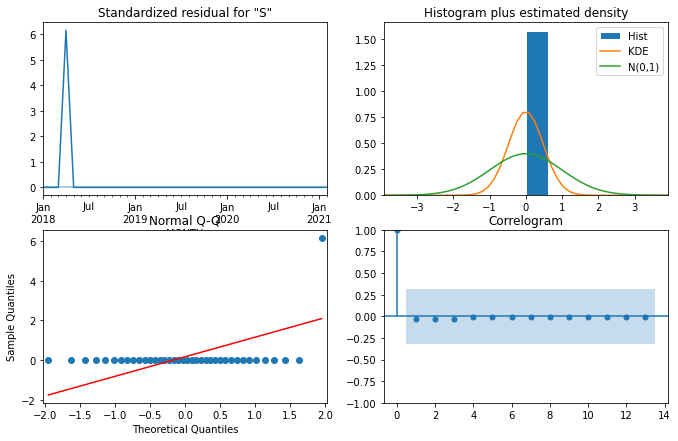

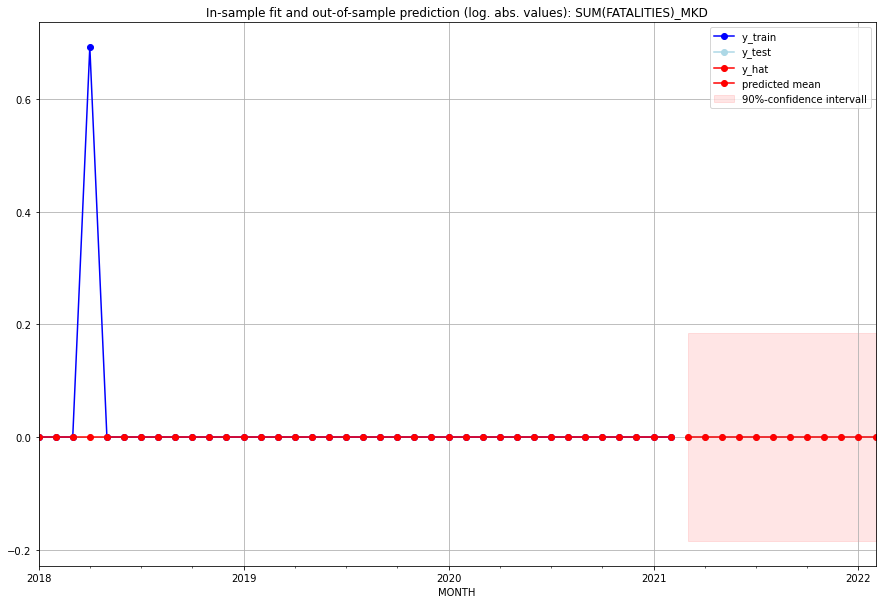

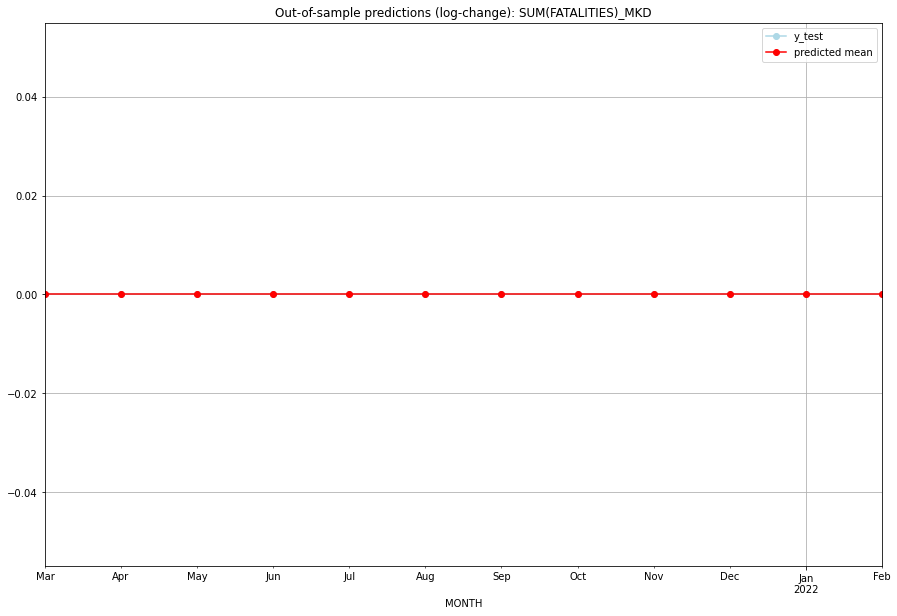

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   MKD   
1  2021-04-01       0.0         0.0           0.0             0.0   MKD   
2  2021-05-01       0.0         0.0           0.0             0.0   MKD   
3  2021-06-01       0.0         0.0           0.0             0.0   MKD   
4  2021-07-01       0.0         0.0           0.0             0.0   MKD   
5  2021-08-01       0.0         0.0           0.0             0.0   MKD   
6  2021-09-01       0.0         0.0           0.0             0.0   MKD   
7  2021-10-01       0.0         0.0           0.0             0.0   MKD   
8  2021-11-01       0.0         0.0           0.0             0.0   MKD   
9  2021-12-01       0.0         0.0           0.0             0.0   MKD   
10 2022-01-01       0.0         0.0           0.0             0.0   MKD   
11 2022-02-01       0.0         0.0           0.0             0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.5549704712189527, 'fold_results': [0.7235335071859482, 0.5901656241423264, 0.6631737542547959, 0.3950940057335783, 0.4028854647781148]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_MLI   No. Observations:                  289
Model:                SARIMAX(0, 1, 0)   Log Likelihood                -474.614
Date:                 Wed, 19 Oct 2022   AIC                            951.227
Time:                         11:00:43   BIC                            954.890
Sample:                     02-28-1997   HQIC                           952.695
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------

<Figure size 432x288 with 0 Axes>

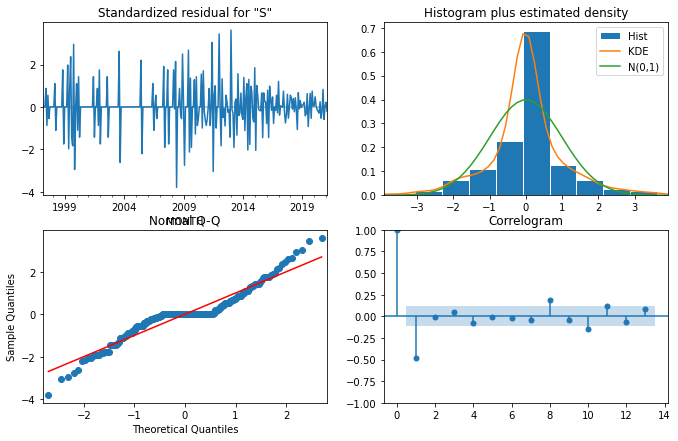

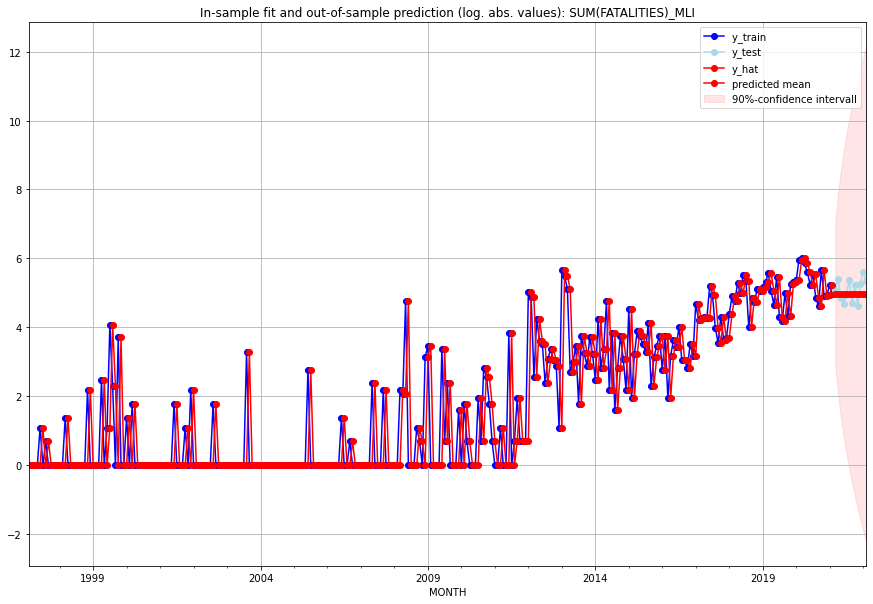

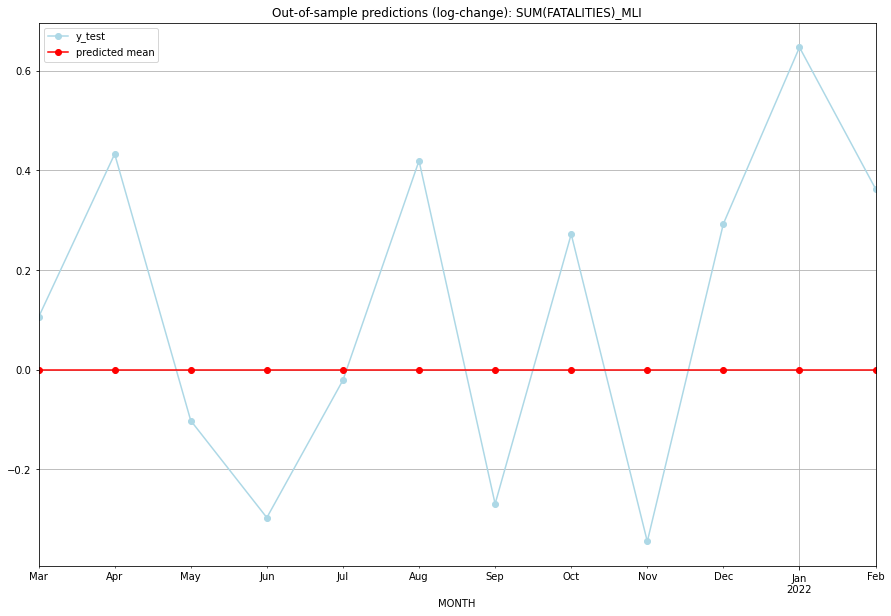

TADDA: 0.2972205890245609
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01     143.0       159.0           0.0        0.105361   MLI   
1  2021-04-01     143.0       221.0           0.0        0.432864   MLI   
2  2021-05-01     143.0       129.0           0.0       -0.102279   MLI   
3  2021-06-01     143.0       106.0           0.0       -0.296984   MLI   
4  2021-07-01     143.0       140.0           0.0       -0.021053   MLI   
5  2021-08-01     143.0       218.0           0.0        0.419258   MLI   
6  2021-09-01     143.0       109.0           0.0       -0.269333   MLI   
7  2021-10-01     143.0       188.0           0.0        0.271934   MLI   
8  2021-11-01     143.0       101.0           0.0       -0.344840   MLI   
9  2021-12-01     143.0       192.0           0.0        0.292877   MLI   
10 2022-01-01     143.0       274.0           0.0        0.646958   MLI   
11 2022-02-01     143.0       206.0           0.0    

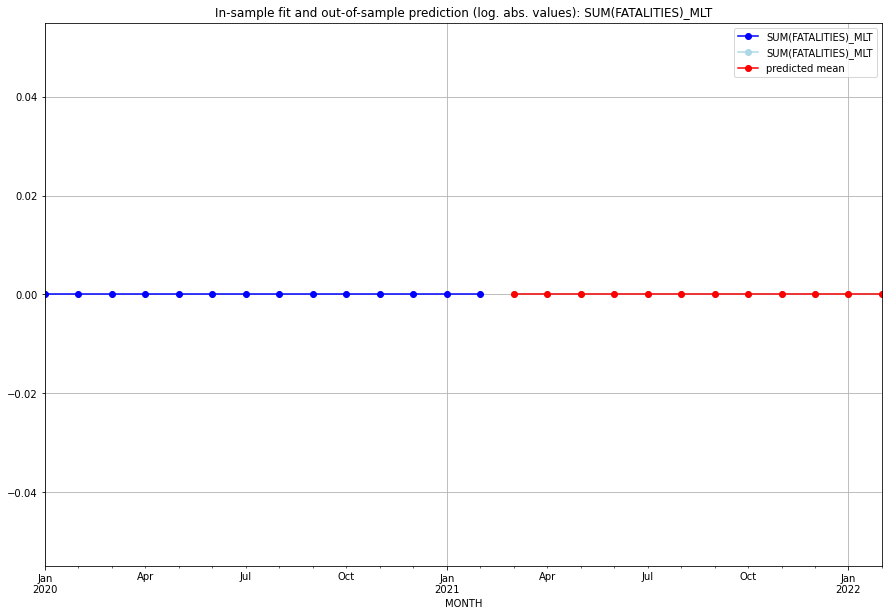

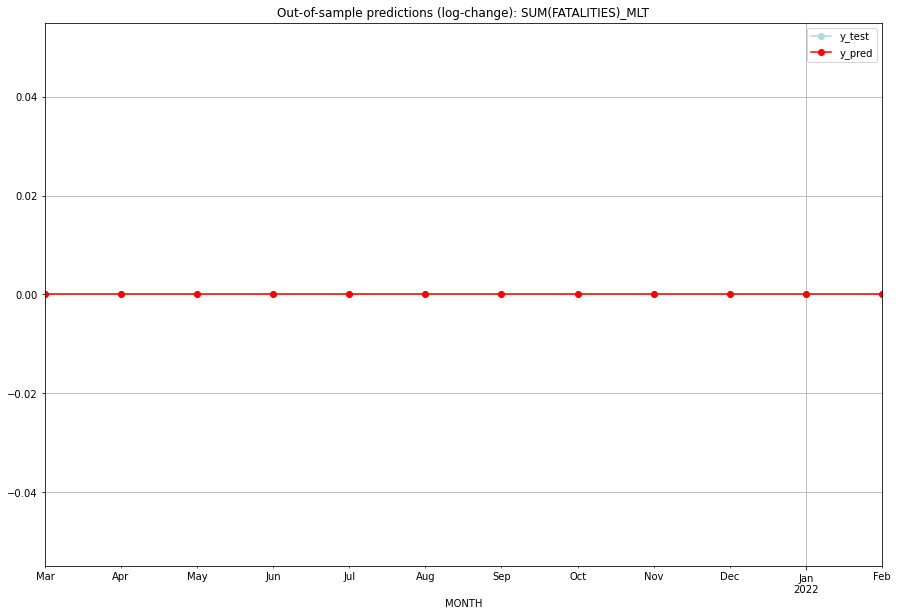

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   MLT   
1  2021-04-01       0.0         0.0           0.0             0.0   MLT   
2  2021-05-01       0.0         0.0           0.0             0.0   MLT   
3  2021-06-01       0.0         0.0           0.0             0.0   MLT   
4  2021-07-01       0.0         0.0           0.0             0.0   MLT   
5  2021-08-01       0.0         0.0           0.0             0.0   MLT   
6  2021-09-01       0.0         0.0           0.0             0.0   MLT   
7  2021-10-01       0.0         0.0           0.0             0.0   MLT   
8  2021-11-01       0.0         0.0           0.0             0.0   MLT   
9  2021-12-01       0.0         0.0           0.0             0.0   MLT   
10 2022-01-01       0.0         0.0           0.0             0.0   MLT   
11 2022-02-01       0.0         0.0           0.0             0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.9234454769390563, 'fold_results': [0.9050028390805833, 1.1930793015248335, 0.7865530620171114, 0.7059922162639228, 1.02659996580883]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_MMR   No. Observations:                  134
Model:                SARIMAX(0, 1, 0)   Log Likelihood                -204.376
Date:                 Wed, 19 Oct 2022   AIC                            410.753
Time:                         11:01:13   BIC                            413.643
Sample:                     01-31-2010   HQIC                           411.927
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------

<Figure size 432x288 with 0 Axes>

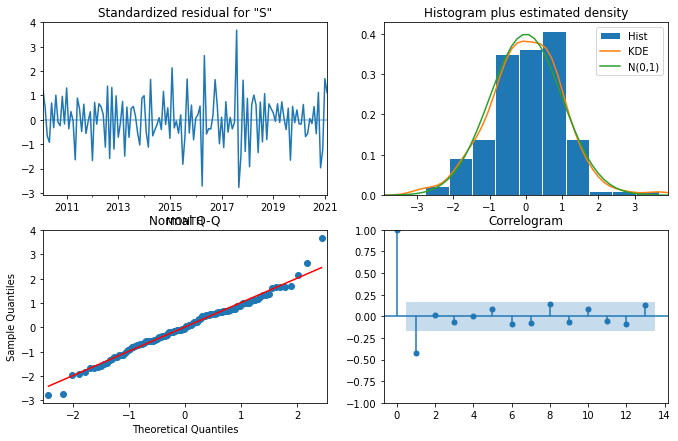

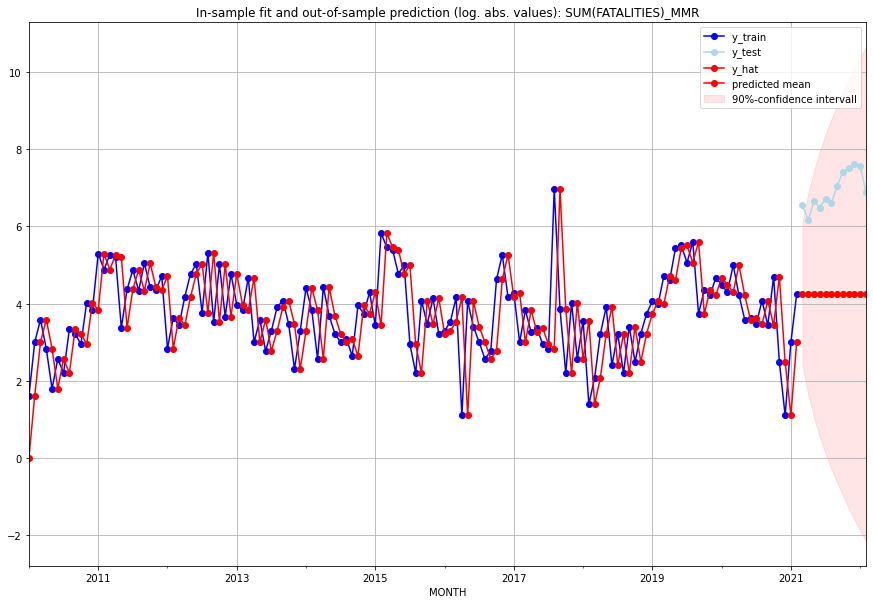

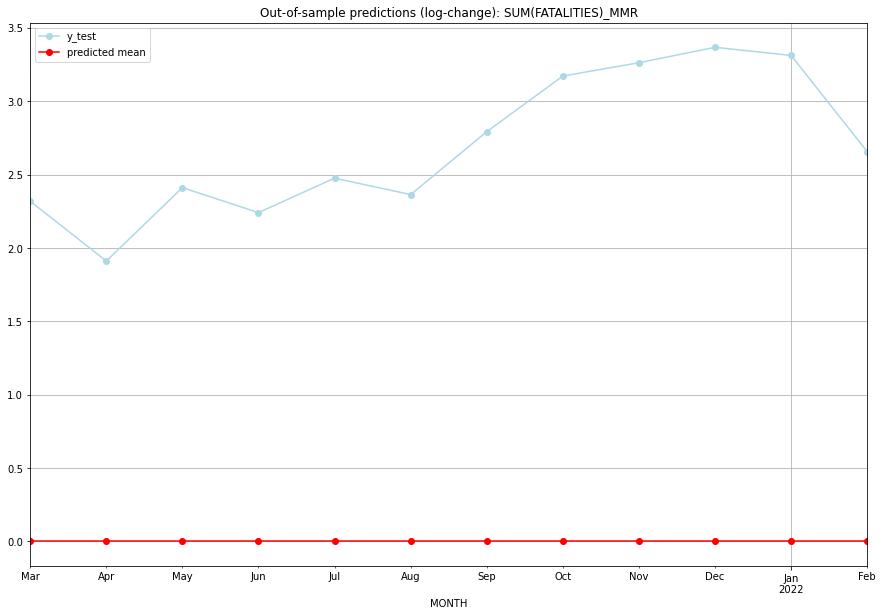

TADDA: 2.6898895287240205
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01      69.0       710.0           0.0        2.318177   MMR   
1  2021-04-01      69.0       472.0           0.0        1.910600   MMR   
2  2021-05-01      69.0       779.0           0.0        2.410799   MMR   
3  2021-06-01      69.0       657.0           0.0        2.240710   MMR   
4  2021-07-01      69.0       831.0           0.0        2.475337   MMR   
5  2021-08-01      69.0       743.0           0.0        2.363546   MMR   
6  2021-09-01      69.0      1141.0           0.0        2.792041   MMR   
7  2021-10-01      69.0      1667.0           0.0        3.170885   MMR   
8  2021-11-01      69.0      1826.0           0.0        3.261935   MMR   
9  2021-12-01      69.0      2028.0           0.0        3.366803   MMR   
10 2022-01-01      69.0      1919.0           0.0        3.311585   MMR   
11 2022-02-01      69.0       996.0           0.0    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.0, 'fold_results': [0.0, 0.0]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_MNE   No. Observations:                   38
Model:                         SARIMAX   Log Likelihood                  15.952
Date:                 Wed, 19 Oct 2022   AIC                            -29.904
Time:                         11:01:26   BIC                            -28.267
Sample:                     01-31-2018   HQIC                           -29.322
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.0253      0.002     13.077      0.000       0.021       0

<Figure size 432x288 with 0 Axes>

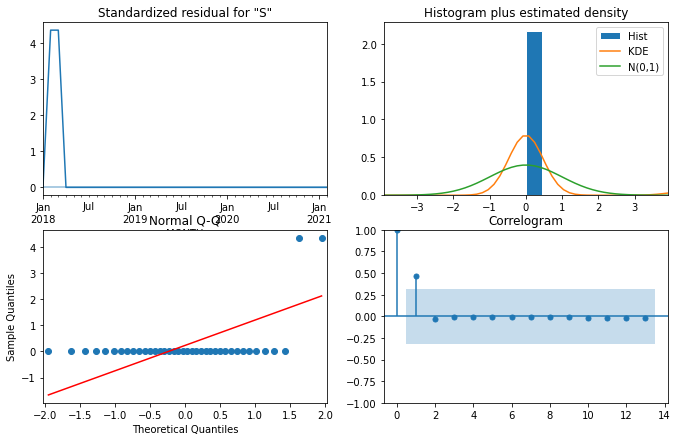

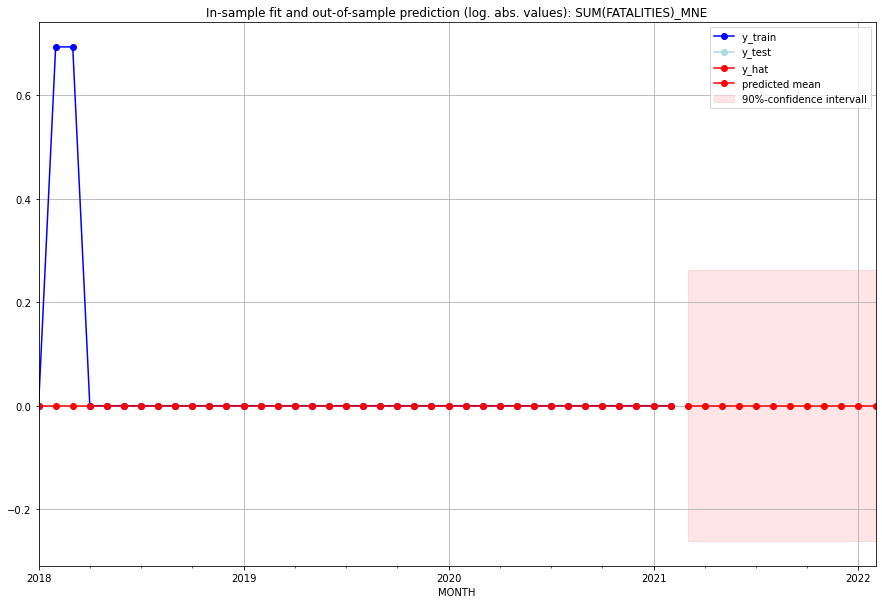

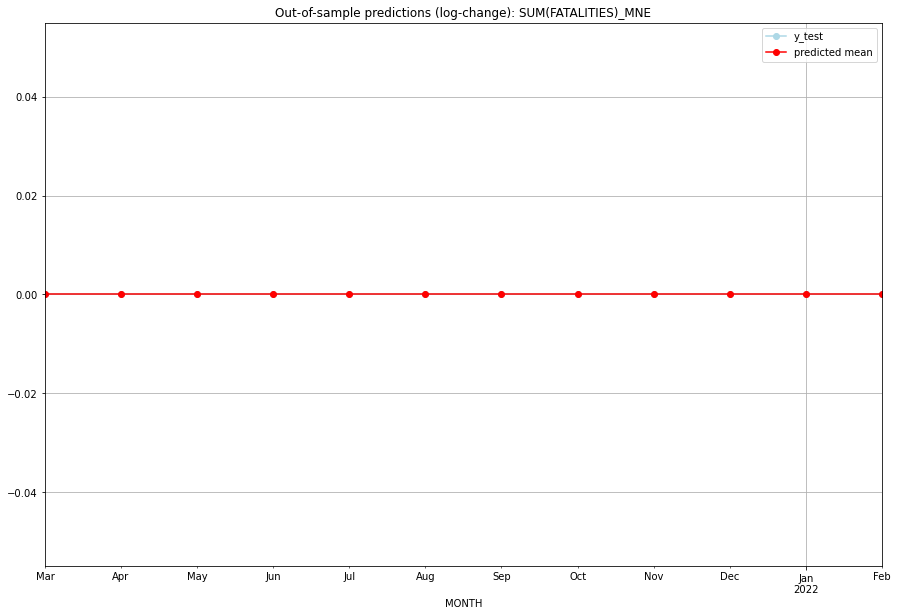

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   MNE   
1  2021-04-01       0.0         0.0           0.0             0.0   MNE   
2  2021-05-01       0.0         0.0           0.0             0.0   MNE   
3  2021-06-01       0.0         0.0           0.0             0.0   MNE   
4  2021-07-01       0.0         0.0           0.0             0.0   MNE   
5  2021-08-01       0.0         0.0           0.0             0.0   MNE   
6  2021-09-01       0.0         0.0           0.0             0.0   MNE   
7  2021-10-01       0.0         0.0           0.0             0.0   MNE   
8  2021-11-01       0.0         0.0           0.0             0.0   MNE   
9  2021-12-01       0.0         0.0           0.0             0.0   MNE   
10 2022-01-01       0.0         0.0           0.0             0.0   MNE   
11 2022-02-01       0.0         0.0           0.0             0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.0, 'fold_results': [0.0, 0.0]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_MNG   No. Observations:                   38
Model:                         SARIMAX   Log Likelihood                  29.122
Date:                 Wed, 19 Oct 2022   AIC                            -56.244
Time:                         11:01:36   BIC                            -54.606
Sample:                     01-31-2018   HQIC                           -55.661
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.0126      0.001     18.748      0.000       0.011       0

<Figure size 432x288 with 0 Axes>

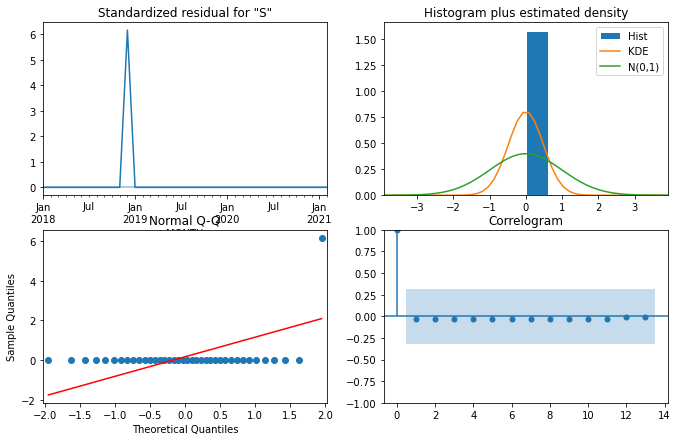

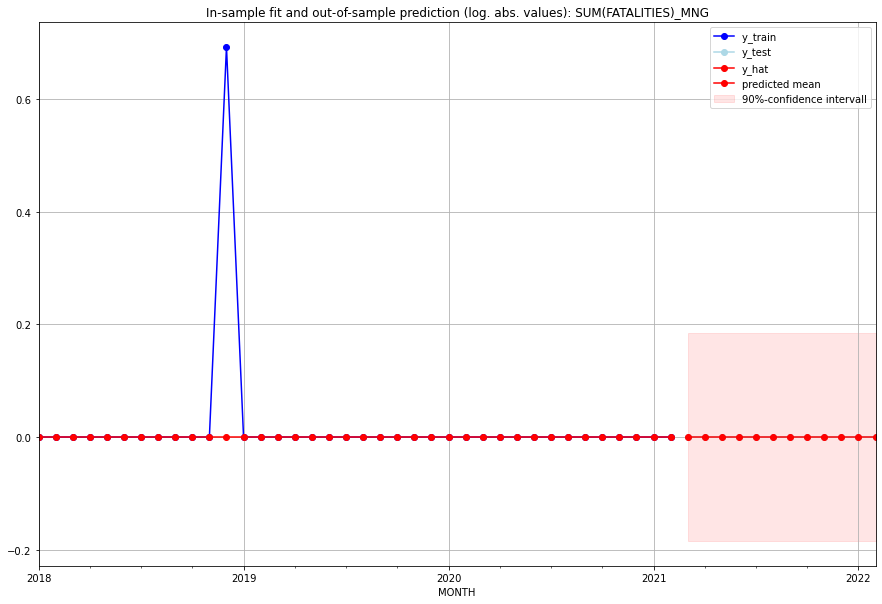

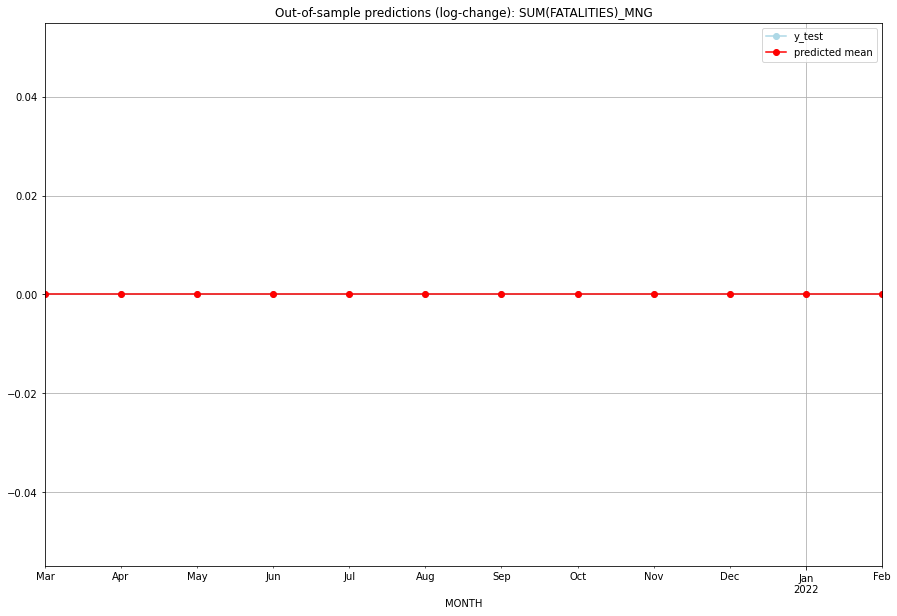

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   MNG   
1  2021-04-01       0.0         0.0           0.0             0.0   MNG   
2  2021-05-01       0.0         0.0           0.0             0.0   MNG   
3  2021-06-01       0.0         0.0           0.0             0.0   MNG   
4  2021-07-01       0.0         0.0           0.0             0.0   MNG   
5  2021-08-01       0.0         0.0           0.0             0.0   MNG   
6  2021-09-01       0.0         0.0           0.0             0.0   MNG   
7  2021-10-01       0.0         0.0           0.0             0.0   MNG   
8  2021-11-01       0.0         0.0           0.0             0.0   MNG   
9  2021-12-01       0.0         0.0           0.0             0.0   MNG   
10 2022-01-01       0.0         0.0           0.0             0.0   MNG   
11 2022-02-01       0.0         0.0           0.0             0.0   

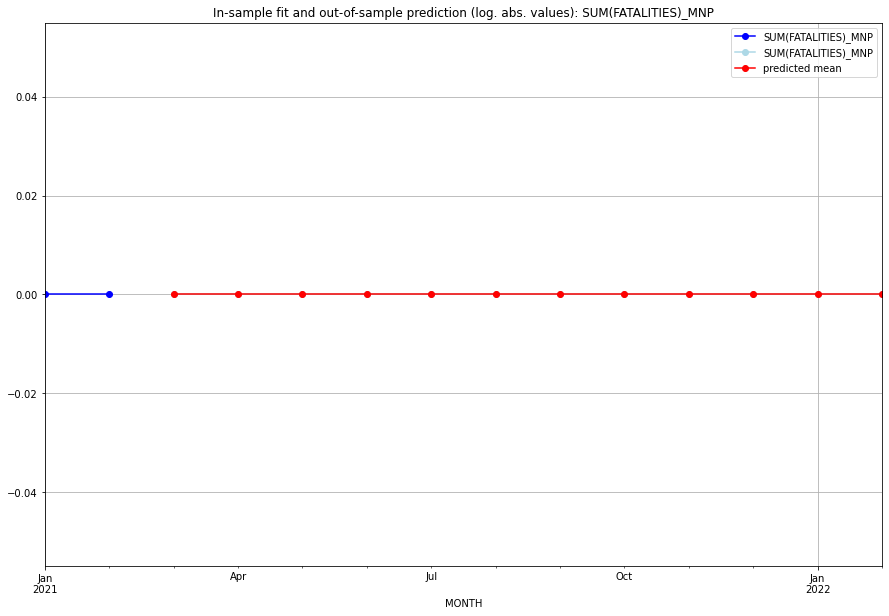

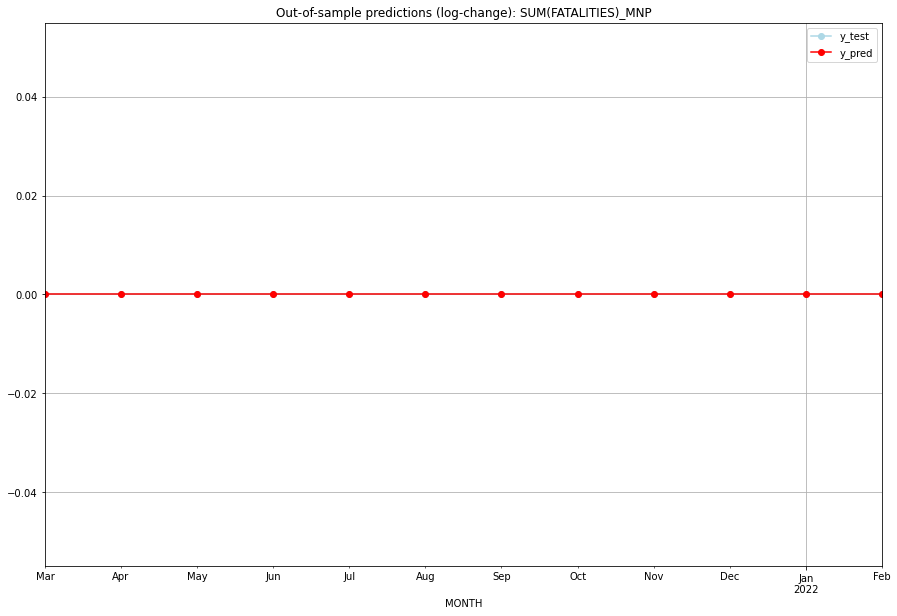

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   MNP   
1  2021-04-01       0.0         0.0           0.0             0.0   MNP   
2  2021-05-01       0.0         0.0           0.0             0.0   MNP   
3  2021-06-01       0.0         0.0           0.0             0.0   MNP   
4  2021-07-01       0.0         0.0           0.0             0.0   MNP   
5  2021-08-01       0.0         0.0           0.0             0.0   MNP   
6  2021-09-01       0.0         0.0           0.0             0.0   MNP   
7  2021-10-01       0.0         0.0           0.0             0.0   MNP   
8  2021-11-01       0.0         0.0           0.0             0.0   MNP   
9  2021-12-01       0.0         0.0           0.0             0.0   MNP   
10 2022-01-01       0.0         0.0           0.0             0.0   MNP   
11 2022-02-01       0.0         0.0           0.0             0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.7742585088447526, 'fold_results': [0.9449691432819655, 0.4057465418928771, 0.8721193983763252, 0.8250088365655817, 0.8234486241070136]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_MOZ   No. Observations:                  289
Model:                SARIMAX(0, 1, 0)   Log Likelihood                -347.135
Date:                 Wed, 19 Oct 2022   AIC                            696.270
Time:                         11:02:11   BIC                            699.933
Sample:                     02-28-1997   HQIC                           697.738
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------

<Figure size 432x288 with 0 Axes>

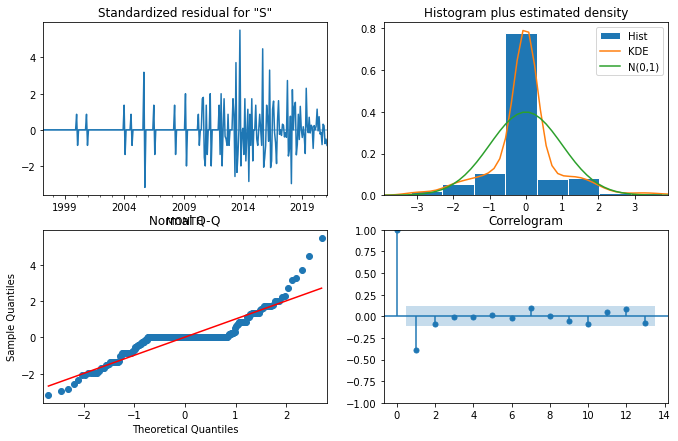

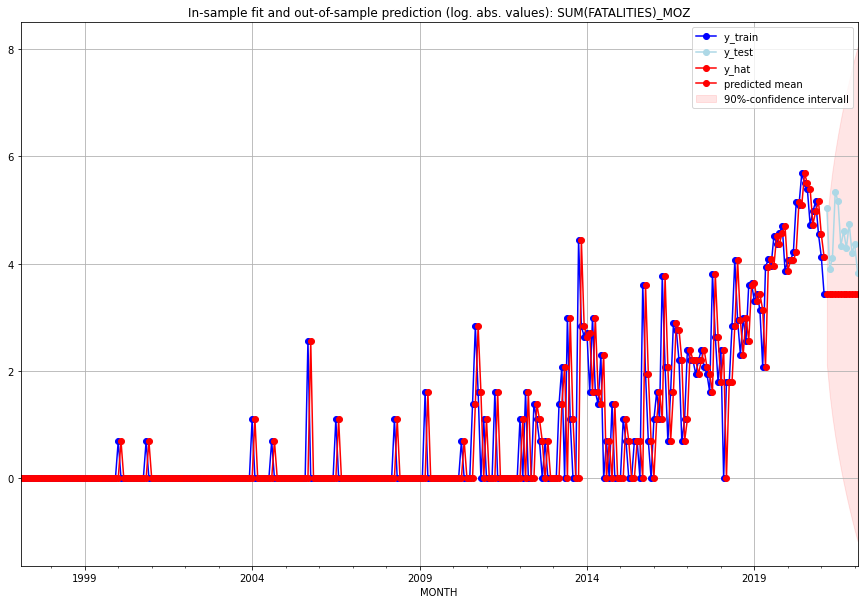

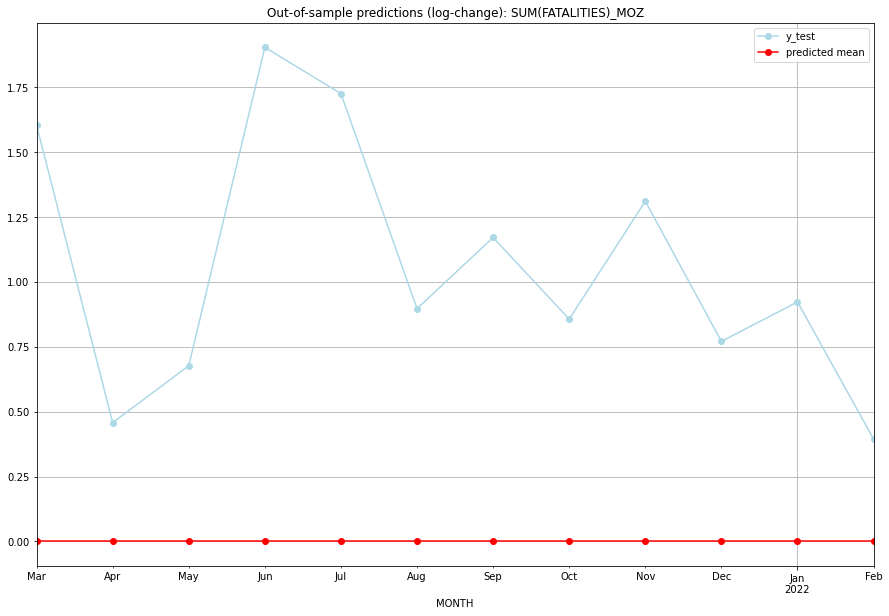

TADDA: 1.0574776356789486
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01      30.0       153.0 -4.440892e-16        1.602965   MOZ   
1  2021-04-01      30.0        48.0 -4.440892e-16        0.457833   MOZ   
2  2021-05-01      30.0        60.0 -4.440892e-16        0.676887   MOZ   
3  2021-06-01      30.0       207.0 -4.440892e-16        1.903551   MOZ   
4  2021-07-01      30.0       173.0 -4.440892e-16        1.725068   MOZ   
5  2021-08-01      30.0        75.0 -4.440892e-16        0.896746   MOZ   
6  2021-09-01      30.0        99.0 -4.440892e-16        1.171183   MOZ   
7  2021-10-01      30.0        72.0 -4.440892e-16        0.856472   MOZ   
8  2021-11-01      30.0       114.0 -4.440892e-16        1.310945   MOZ   
9  2021-12-01      30.0        66.0 -4.440892e-16        0.770705   MOZ   
10 2022-01-01      30.0        77.0 -4.440892e-16        0.922722   MOZ   
11 2022-02-01      30.0        45.0 -4.440892e-16    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.14255553730053516, 'fold_results': [0.0, 0.09155102405567582, 0.1493132891023379, 0.1493132891023379, 0.3226000842423242]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_MRT   No. Observations:                  289
Model:                         SARIMAX   Log Likelihood                -214.031
Date:                 Wed, 19 Oct 2022   AIC                            430.061
Time:                         11:02:49   BIC                            433.728
Sample:                     02-28-1997   HQIC                           431.530
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------

<Figure size 432x288 with 0 Axes>

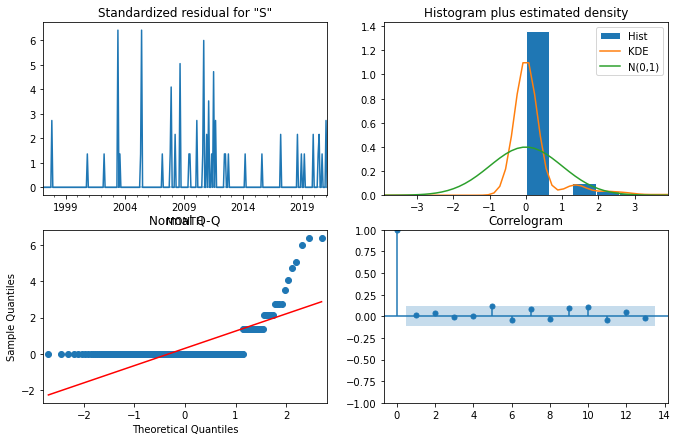

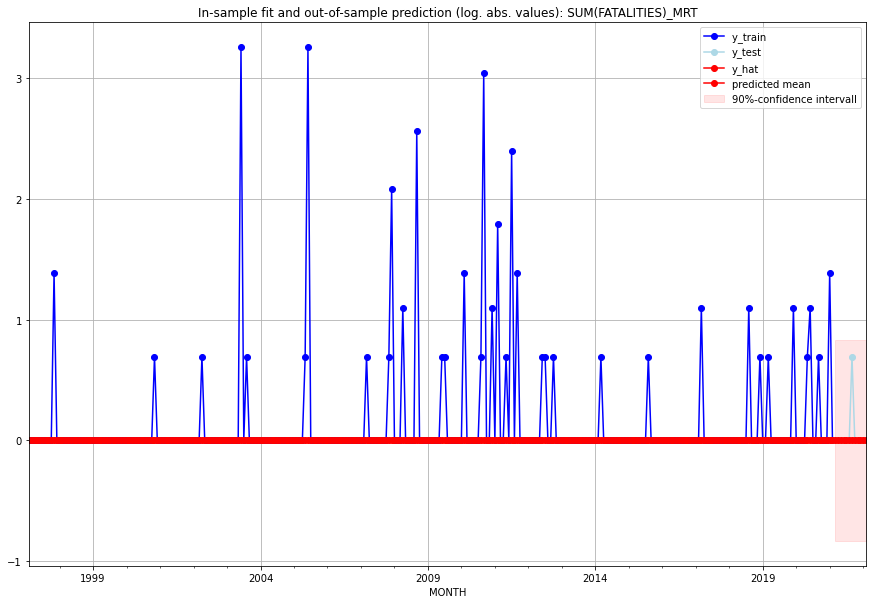

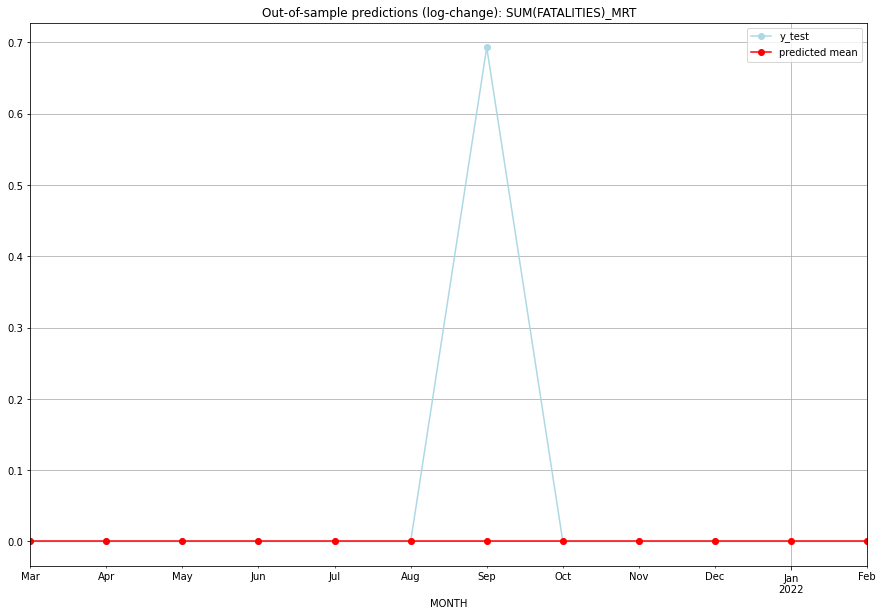

TADDA: 0.057762265046662105
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0        0.000000   MRT   
1  2021-04-01       0.0         0.0           0.0        0.000000   MRT   
2  2021-05-01       0.0         0.0           0.0        0.000000   MRT   
3  2021-06-01       0.0         0.0           0.0        0.000000   MRT   
4  2021-07-01       0.0         0.0           0.0        0.000000   MRT   
5  2021-08-01       0.0         0.0           0.0        0.000000   MRT   
6  2021-09-01       0.0         1.0           0.0        0.693147   MRT   
7  2021-10-01       0.0         0.0           0.0        0.000000   MRT   
8  2021-11-01       0.0         0.0           0.0        0.000000   MRT   
9  2021-12-01       0.0         0.0           0.0        0.000000   MRT   
10 2022-01-01       0.0         0.0           0.0        0.000000   MRT   
11 2022-02-01       0.0         0.0           0.0  

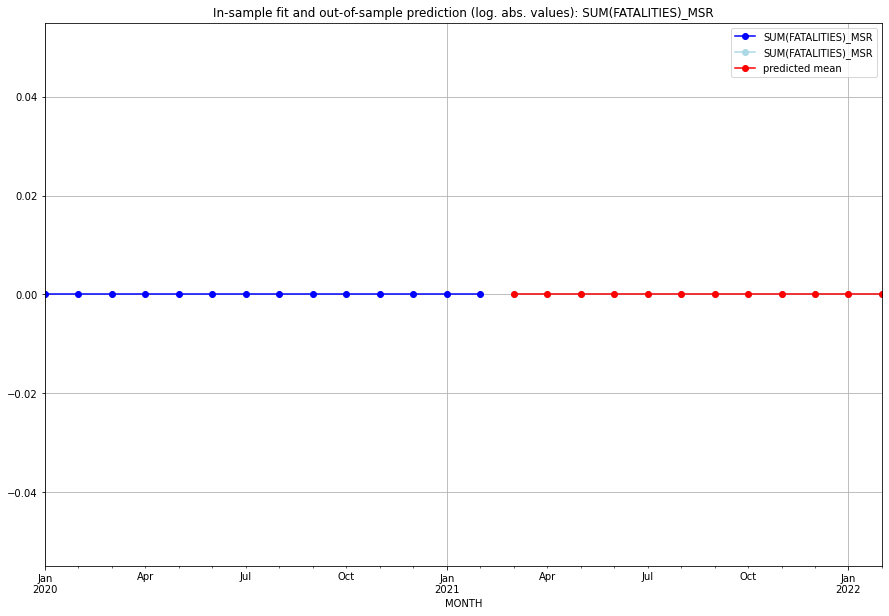

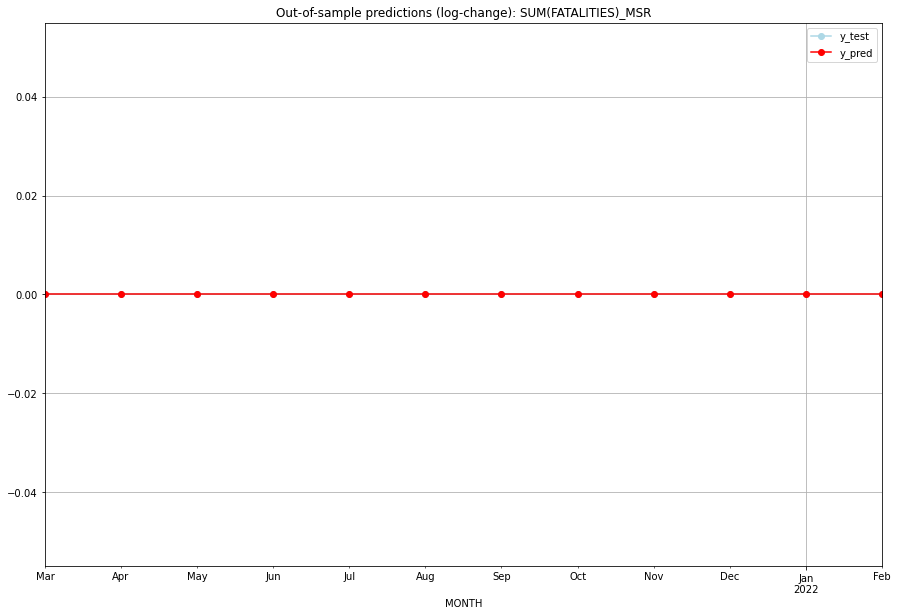

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   MSR   
1  2021-04-01       0.0         0.0           0.0             0.0   MSR   
2  2021-05-01       0.0         0.0           0.0             0.0   MSR   
3  2021-06-01       0.0         0.0           0.0             0.0   MSR   
4  2021-07-01       0.0         0.0           0.0             0.0   MSR   
5  2021-08-01       0.0         0.0           0.0             0.0   MSR   
6  2021-09-01       0.0         0.0           0.0             0.0   MSR   
7  2021-10-01       0.0         0.0           0.0             0.0   MSR   
8  2021-11-01       0.0         0.0           0.0             0.0   MSR   
9  2021-12-01       0.0         0.0           0.0             0.0   MSR   
10 2022-01-01       0.0         0.0           0.0             0.0   MSR   
11 2022-02-01       0.0         0.0           0.0             0.0   

<Figure size 432x288 with 0 Axes>

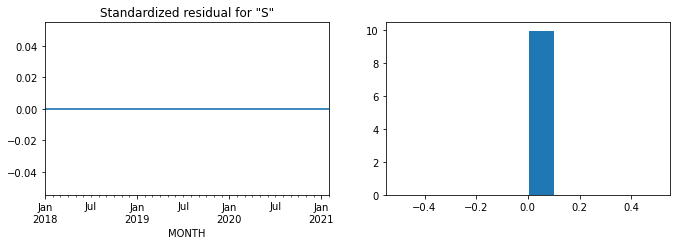

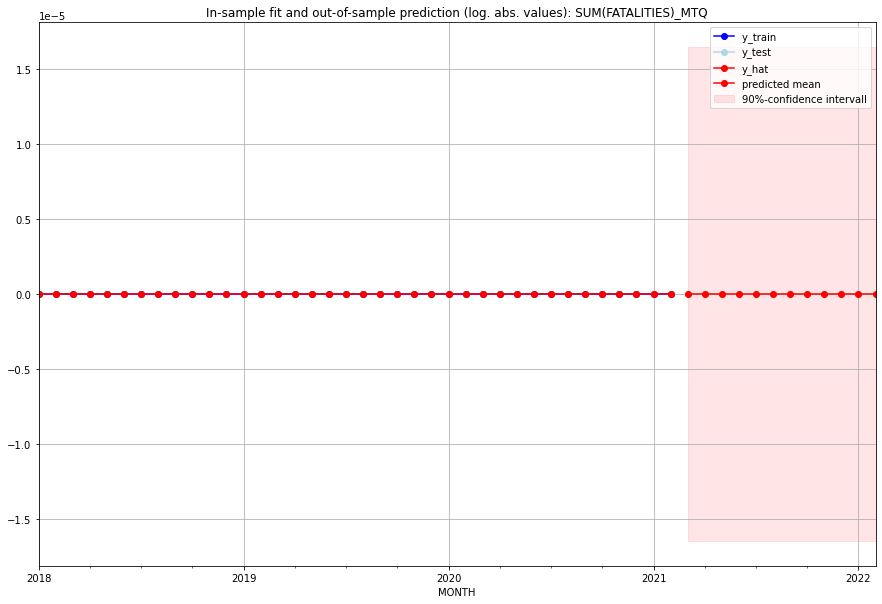

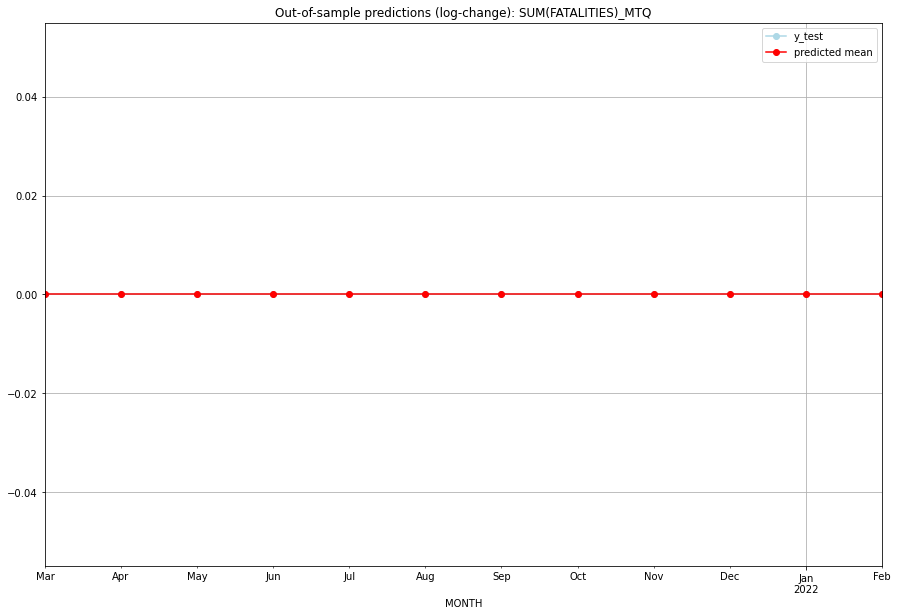

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   MTQ   
1  2021-04-01       0.0         0.0           0.0             0.0   MTQ   
2  2021-05-01       0.0         0.0           0.0             0.0   MTQ   
3  2021-06-01       0.0         0.0           0.0             0.0   MTQ   
4  2021-07-01       0.0         0.0           0.0             0.0   MTQ   
5  2021-08-01       0.0         0.0           0.0             0.0   MTQ   
6  2021-09-01       0.0         0.0           0.0             0.0   MTQ   
7  2021-10-01       0.0         0.0           0.0             0.0   MTQ   
8  2021-11-01       0.0         0.0           0.0             0.0   MTQ   
9  2021-12-01       0.0         0.0           0.0             0.0   MTQ   
10 2022-01-01       0.0         0.0           0.0             0.0   MTQ   
11 2022-02-01       0.0         0.0           0.0             0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.03465735902799726, 'fold_results': [0.0, 0.0, 0.0, 0.0, 0.17328679513998632]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_MUS   No. Observations:                  289
Model:                         SARIMAX   Log Likelihood                 355.898
Date:                 Wed, 19 Oct 2022   AIC                           -709.796
Time:                         11:04:15   BIC                           -706.130
Sample:                     02-28-1997   HQIC                          -708.327
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.0050   6.0

<Figure size 432x288 with 0 Axes>

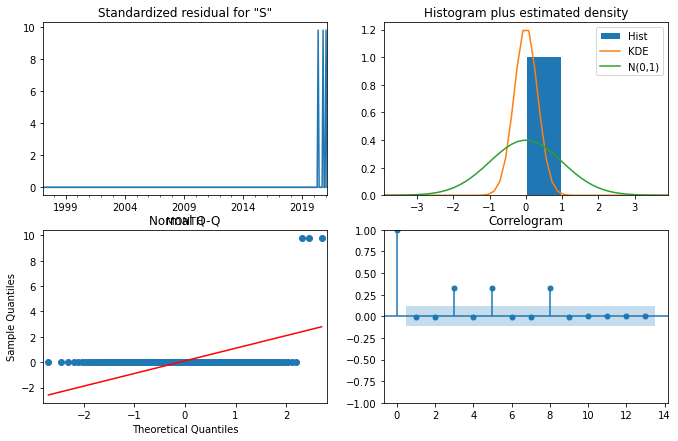

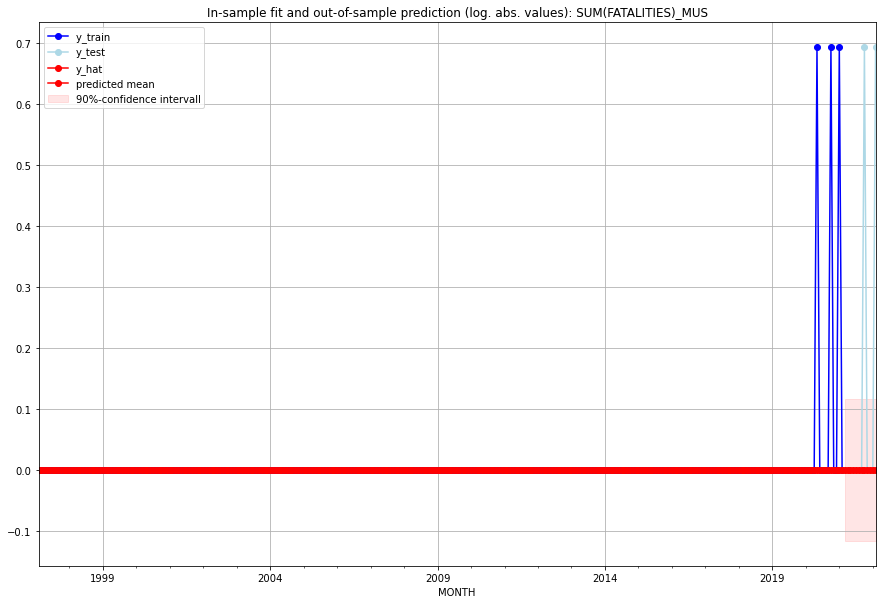

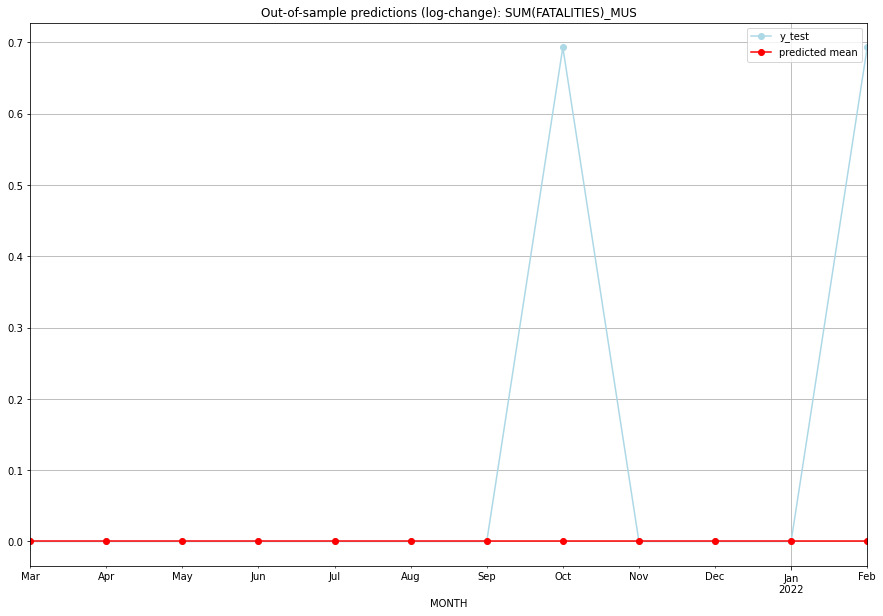

TADDA: 0.11552453009332421
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0        0.000000   MUS   
1  2021-04-01       0.0         0.0           0.0        0.000000   MUS   
2  2021-05-01       0.0         0.0           0.0        0.000000   MUS   
3  2021-06-01       0.0         0.0           0.0        0.000000   MUS   
4  2021-07-01       0.0         0.0           0.0        0.000000   MUS   
5  2021-08-01       0.0         0.0           0.0        0.000000   MUS   
6  2021-09-01       0.0         0.0           0.0        0.000000   MUS   
7  2021-10-01       0.0         1.0           0.0        0.693147   MUS   
8  2021-11-01       0.0         0.0           0.0        0.000000   MUS   
9  2021-12-01       0.0         0.0           0.0        0.000000   MUS   
10 2022-01-01       0.0         0.0           0.0        0.000000   MUS   
11 2022-02-01       0.0         1.0           0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (3, 1, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.6840678619342946, 'fold_results': [0.7837708645338965, 0.5016268586253307, 0.6266789608120956, 0.6612300198745619, 0.8470326058255885]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_MWI   No. Observations:                  289
Model:                SARIMAX(3, 1, 3)   Log Likelihood                -178.280
Date:                 Wed, 19 Oct 2022   AIC                            376.559
Time:                         11:04:44   BIC                            413.189
Sample:                     02-28-1997   HQIC                           391.238
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------

<Figure size 432x288 with 0 Axes>

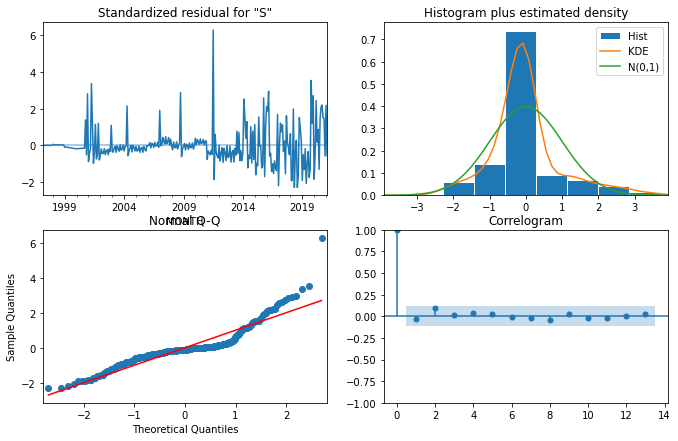

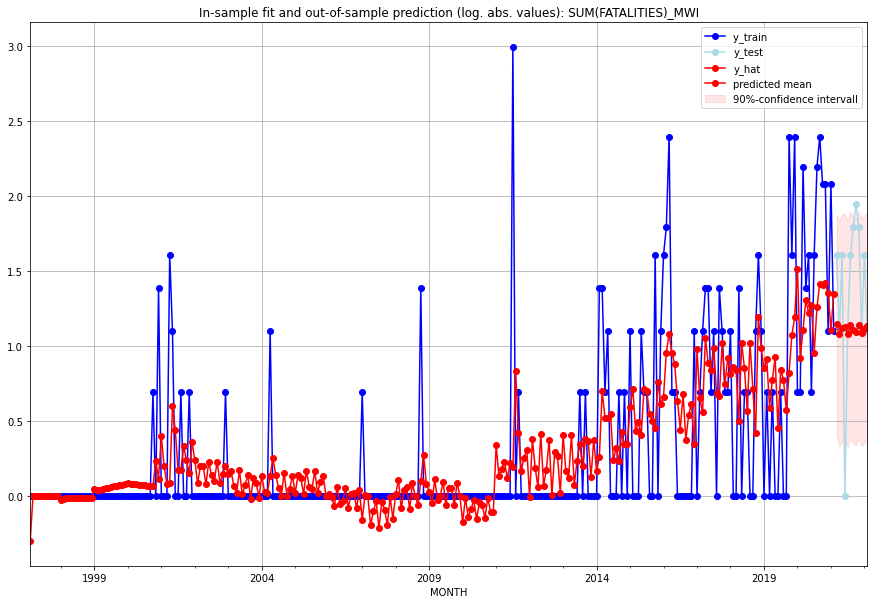

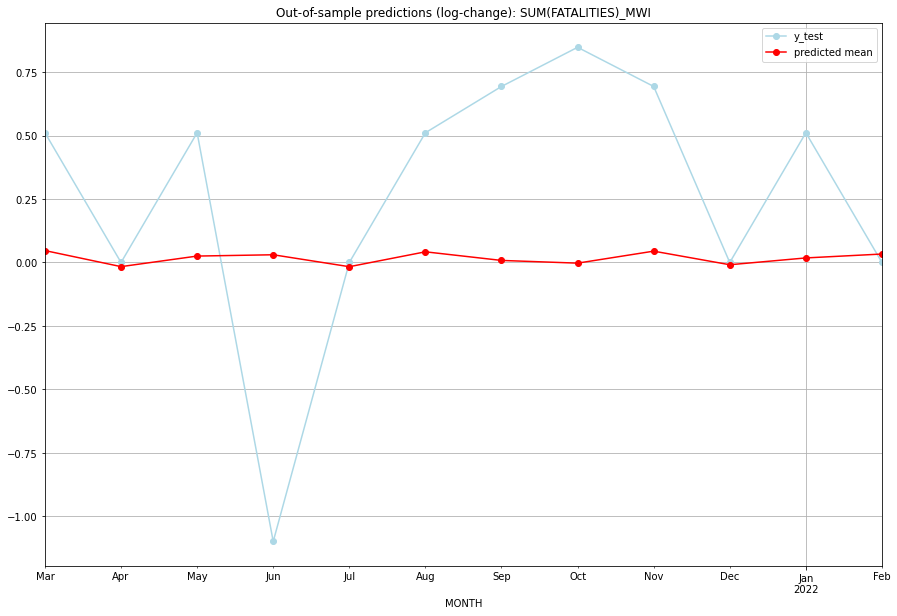

TADDA: 0.4443009629448673
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  2.144112         4.0      0.046919        0.510826   MWI   
1  2021-04-01  1.951500         2.0     -0.016299        0.000000   MWI   
2  2021-05-01  2.076805         4.0      0.025279        0.510826   MWI   
3  2021-06-01  2.092639         0.0      0.030412       -1.098612   MWI   
4  2021-07-01  1.950696         2.0     -0.016571        0.000000   MWI   
5  2021-08-01  2.128821         4.0      0.042044        0.510826   MWI   
6  2021-09-01  2.024460         5.0      0.008120        0.693147   MWI   
7  2021-10-01  1.992297         6.0     -0.002571        0.847298   MWI   
8  2021-11-01  2.136932         5.0      0.044633        0.693147   MWI   
9  2021-12-01  1.973441         2.0     -0.008892        0.000000   MWI   
10 2022-01-01  2.054307         4.0      0.017940        0.510826   MWI   
11 2022-02-01  2.101617         2.0      0.033311    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [2, (0, 1, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.17328679513998632, 'fold_results': [nan, 0.17328679513998632]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_MYS   No. Observations:                   38
Model:                SARIMAX(0, 1, 3)   Log Likelihood                 -24.244
Date:                 Wed, 19 Oct 2022   AIC                             60.487
Time:                         11:04:58   BIC                             70.153
Sample:                     01-31-2018   HQIC                            63.895
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             0.0385      0.027      1.42

<Figure size 432x288 with 0 Axes>

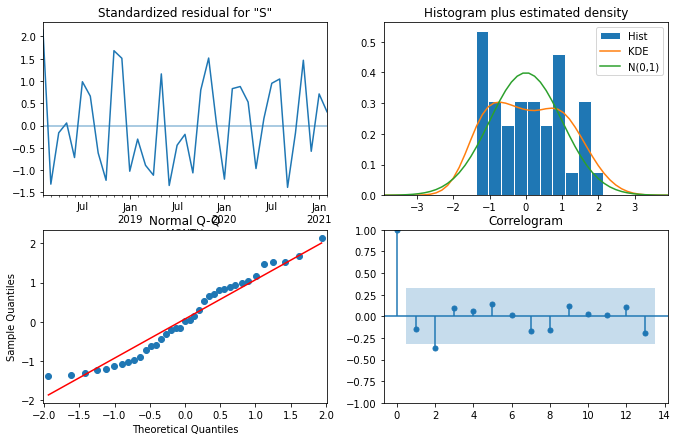

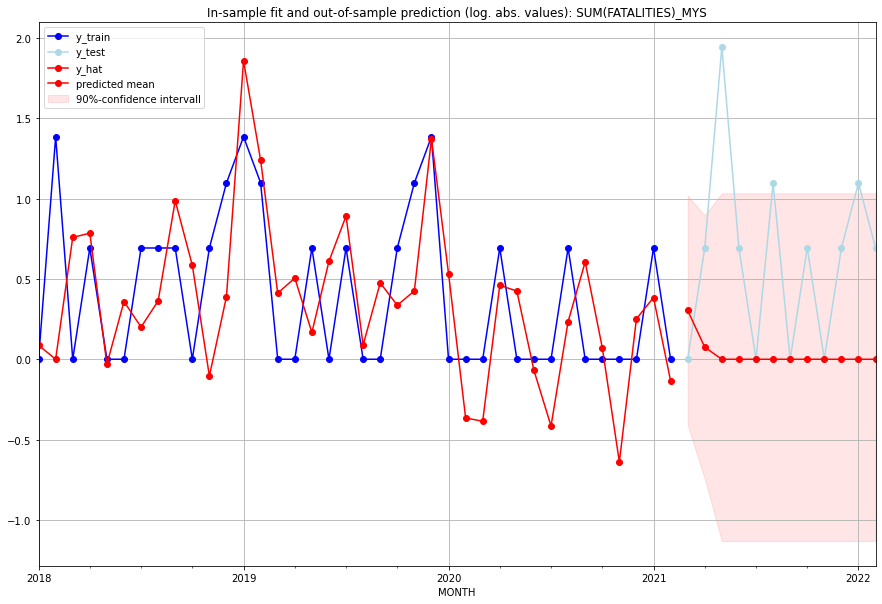

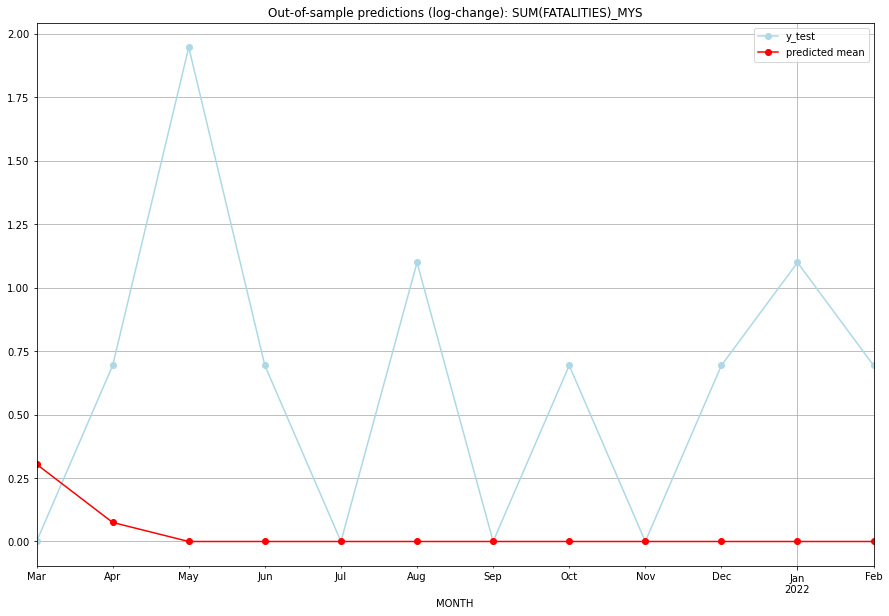

TADDA: 0.653181312509199
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  0.355617         0.0      0.304256        0.000000   MYS   
1  2021-04-01  0.077832         1.0      0.074951        0.693147   MYS   
2  2021-05-01  0.000000         6.0      0.000000        1.945910   MYS   
3  2021-06-01  0.000000         1.0      0.000000        0.693147   MYS   
4  2021-07-01  0.000000         0.0      0.000000        0.000000   MYS   
5  2021-08-01  0.000000         2.0      0.000000        1.098612   MYS   
6  2021-09-01  0.000000         0.0      0.000000        0.000000   MYS   
7  2021-10-01  0.000000         1.0      0.000000        0.693147   MYS   
8  2021-11-01  0.000000         0.0      0.000000        0.000000   MYS   
9  2021-12-01  0.000000         1.0      0.000000        0.693147   MYS   
10 2022-01-01  0.000000         2.0      0.000000        1.098612   MYS   
11 2022-02-01  0.000000         1.0      0.000000     

<Figure size 432x288 with 0 Axes>

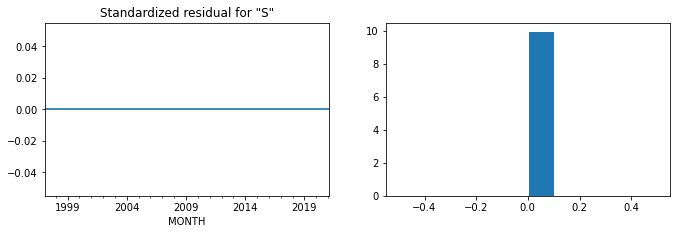

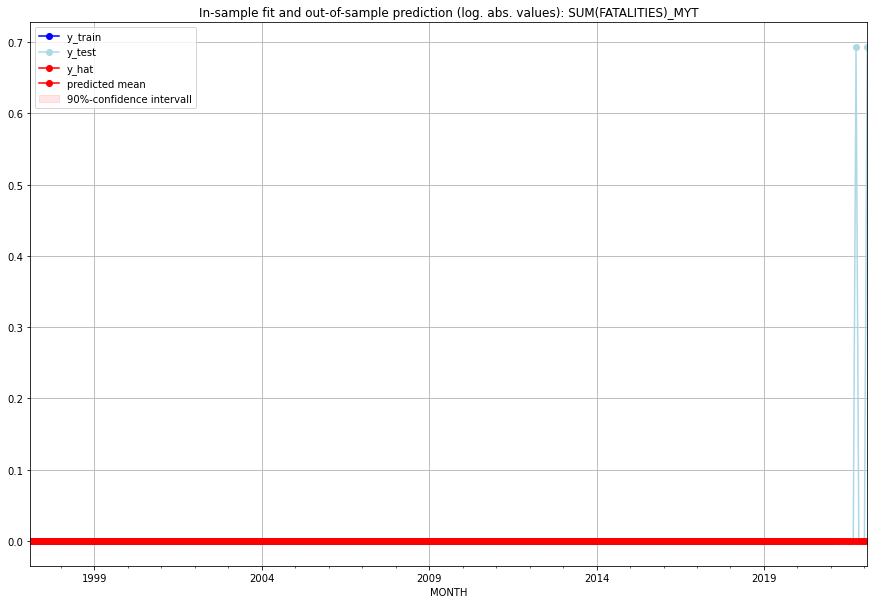

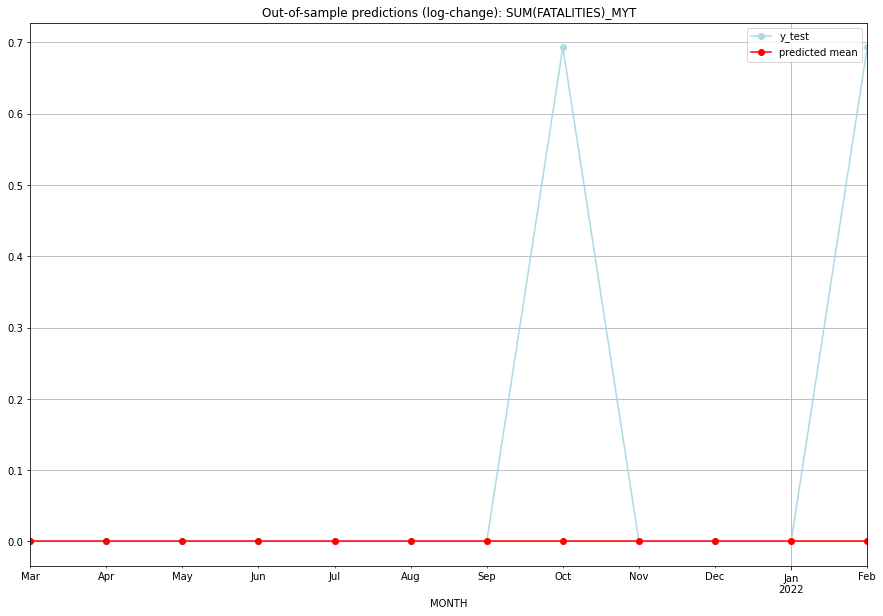

TADDA: 0.11552453009332421
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0        0.000000   MYT   
1  2021-04-01       0.0         0.0           0.0        0.000000   MYT   
2  2021-05-01       0.0         0.0           0.0        0.000000   MYT   
3  2021-06-01       0.0         0.0           0.0        0.000000   MYT   
4  2021-07-01       0.0         0.0           0.0        0.000000   MYT   
5  2021-08-01       0.0         0.0           0.0        0.000000   MYT   
6  2021-09-01       0.0         0.0           0.0        0.000000   MYT   
7  2021-10-01       0.0         1.0           0.0        0.693147   MYT   
8  2021-11-01       0.0         0.0           0.0        0.000000   MYT   
9  2021-12-01       0.0         0.0           0.0        0.000000   MYT   
10 2022-01-01       0.0         0.0           0.0        0.000000   MYT   
11 2022-02-01       0.0         1.0           0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.07607246985779728, 'fold_results': [0.0, 0.11552453009332421, 0.057762265046662105, 0.20707555414900003, 0.0]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_NAM   No. Observations:                  289
Model:                         SARIMAX   Log Likelihood                -279.797
Date:                 Wed, 19 Oct 2022   AIC                            561.594
Time:                         11:05:33   BIC                            565.260
Sample:                     02-28-1997   HQIC                           563.063
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------------------

<Figure size 432x288 with 0 Axes>

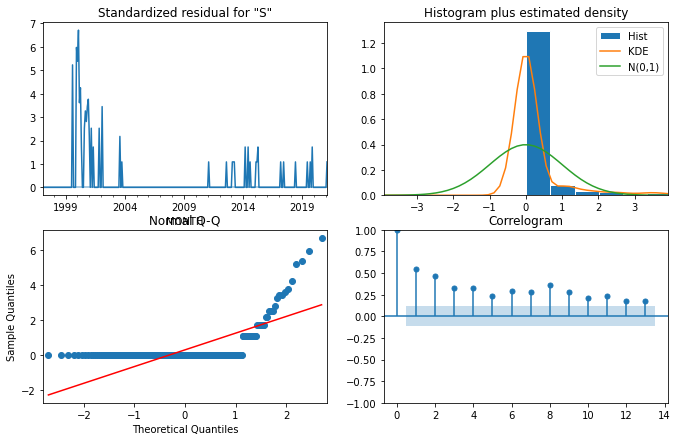

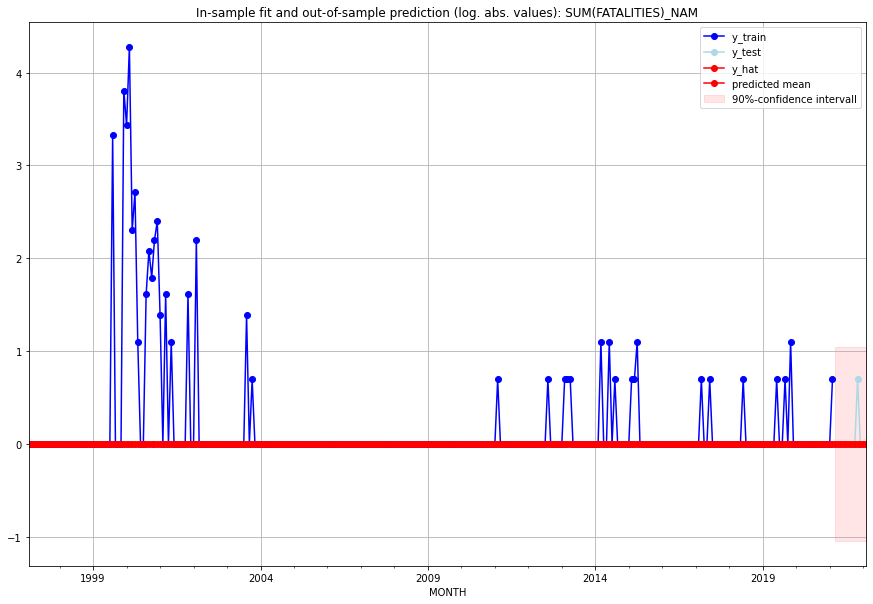

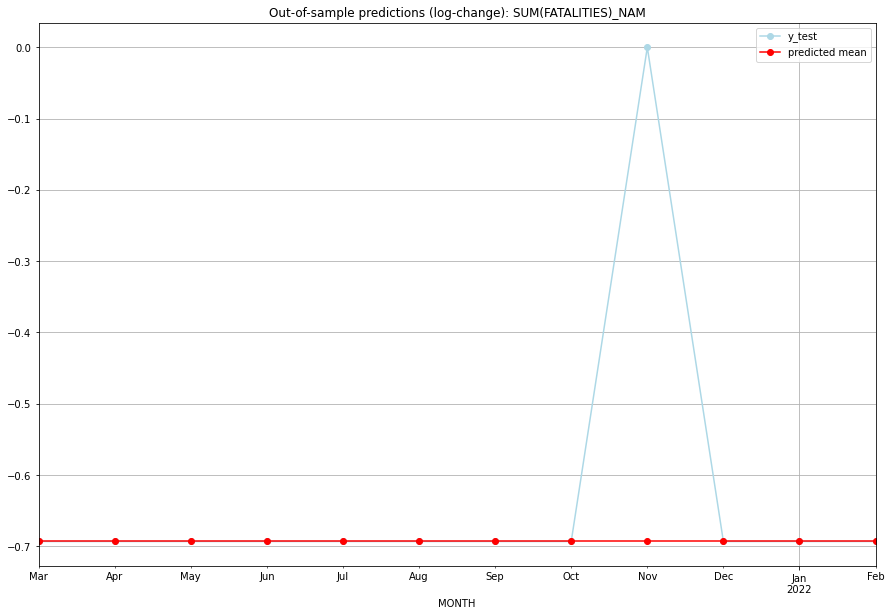

TADDA: 0.057762265046662105
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0     -0.693147       -0.693147   NAM   
1  2021-04-01       0.0         0.0     -0.693147       -0.693147   NAM   
2  2021-05-01       0.0         0.0     -0.693147       -0.693147   NAM   
3  2021-06-01       0.0         0.0     -0.693147       -0.693147   NAM   
4  2021-07-01       0.0         0.0     -0.693147       -0.693147   NAM   
5  2021-08-01       0.0         0.0     -0.693147       -0.693147   NAM   
6  2021-09-01       0.0         0.0     -0.693147       -0.693147   NAM   
7  2021-10-01       0.0         0.0     -0.693147       -0.693147   NAM   
8  2021-11-01       0.0         1.0     -0.693147        0.000000   NAM   
9  2021-12-01       0.0         0.0     -0.693147       -0.693147   NAM   
10 2022-01-01       0.0         0.0     -0.693147       -0.693147   NAM   
11 2022-02-01       0.0         0.0     -0.693147  

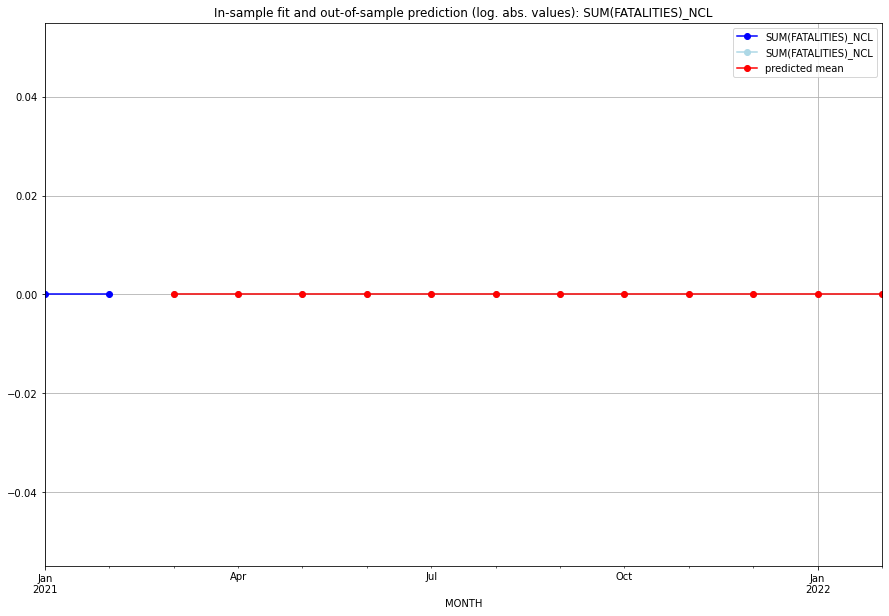

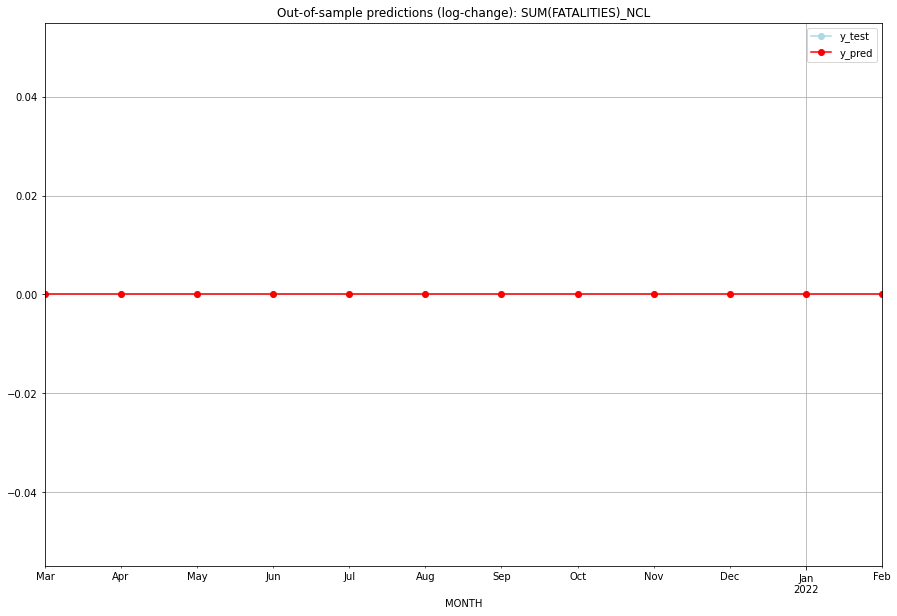

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   NCL   
1  2021-04-01       0.0         0.0           0.0             0.0   NCL   
2  2021-05-01       0.0         0.0           0.0             0.0   NCL   
3  2021-06-01       0.0         0.0           0.0             0.0   NCL   
4  2021-07-01       0.0         0.0           0.0             0.0   NCL   
5  2021-08-01       0.0         0.0           0.0             0.0   NCL   
6  2021-09-01       0.0         0.0           0.0             0.0   NCL   
7  2021-10-01       0.0         0.0           0.0             0.0   NCL   
8  2021-11-01       0.0         0.0           0.0             0.0   NCL   
9  2021-12-01       0.0         0.0           0.0             0.0   NCL   
10 2022-01-01       0.0         0.0           0.0             0.0   NCL   
11 2022-02-01       0.0         0.0           0.0             0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (3, 1, 2), (0, 0, 0, 0), 'n'], 'cv_score': 1.0180298132795473, 'fold_results': [1.0414627962413763, 1.0270485086869023, 0.9121597108535505, 1.2495722779201373, 0.8599057726957701]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_NER   No. Observations:                  289
Model:                SARIMAX(3, 1, 2)   Log Likelihood                -420.733
Date:                 Wed, 19 Oct 2022   AIC                            859.466
Time:                         11:05:55   BIC                            892.432
Sample:                     02-28-1997   HQIC                           872.677
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------

<Figure size 432x288 with 0 Axes>

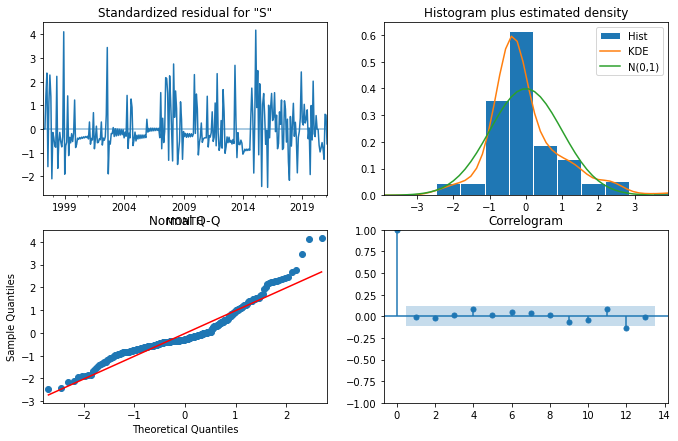

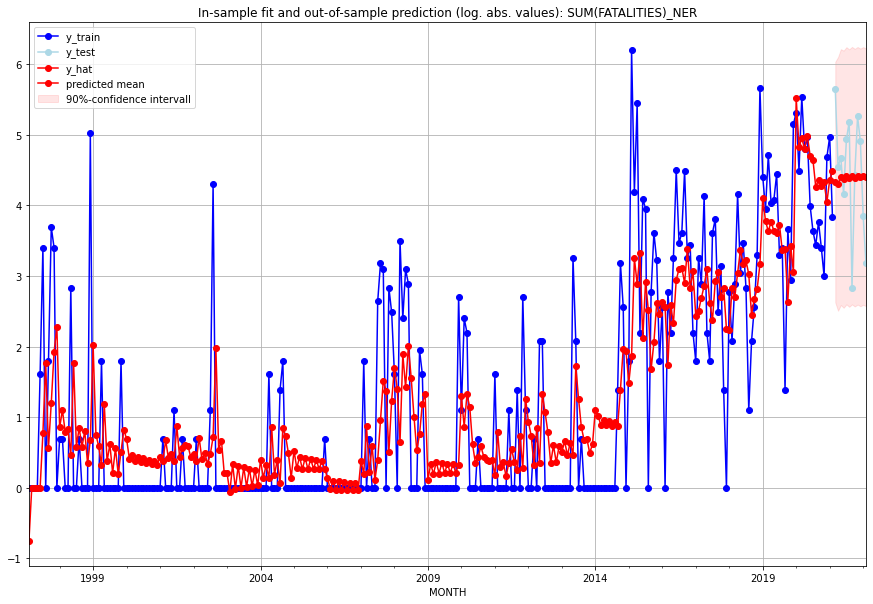

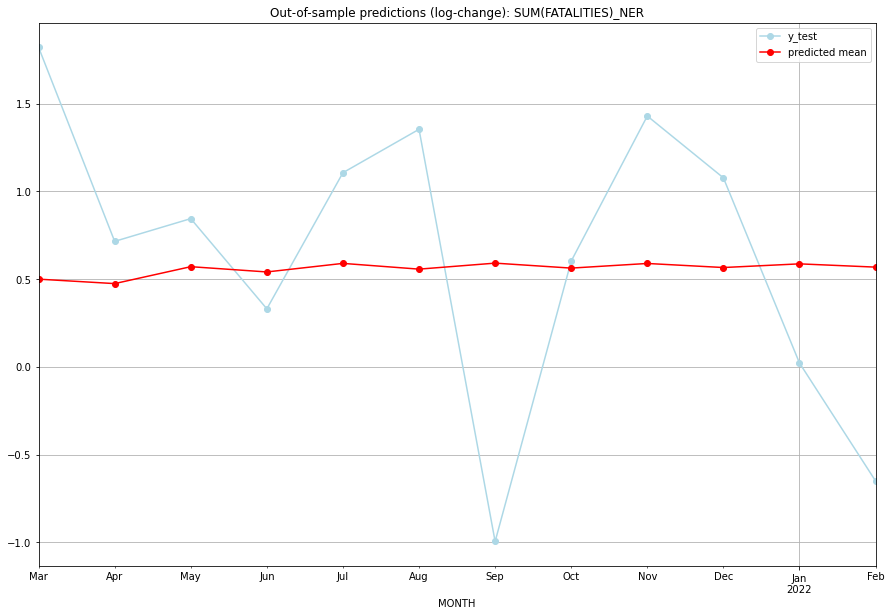

TADDA: 0.7731734533972398
Evaluation finished.
        MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  74.790914       283.0      0.499337        1.820333   NER   
1  2021-04-01  72.894159        93.0      0.473992        0.714653   NER   
2  2021-05-01  80.369228       106.0      0.570356        0.844187   NER   
3  2021-06-01  77.966357        63.0      0.540381        0.330242   NER   
4  2021-07-01  81.912731       138.0      0.589147        1.105833   NER   
5  2021-08-01  79.242518       177.0      0.556412        1.353142   NER   
6  2021-09-01  82.033087        16.0      0.590598       -0.995428   NER   
7  2021-10-01  79.716893        83.0      0.562306        0.602175   NER   
8  2021-11-01  81.873229       191.0      0.588671        1.428854   NER   
9  2021-12-01  79.981068       134.0      0.565574        1.076633   NER   
10 2022-01-01  81.690392        46.0      0.586462        0.021506   NER   
11 2022-02-01  80.168035        23.0     

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (1, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.4260326193792004, 'fold_results': [0.5270862283983215, 0.4843394859524213, 0.2840587715952753, 0.44952473306284574, 0.3851538778871382]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_NGA   No. Observations:                  289
Model:                SARIMAX(1, 1, 0)   Log Likelihood                -449.878
Date:                 Wed, 19 Oct 2022   AIC                            909.755
Time:                         11:06:27   BIC                            928.070
Sample:                     02-28-1997   HQIC                           917.095
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------

<Figure size 432x288 with 0 Axes>

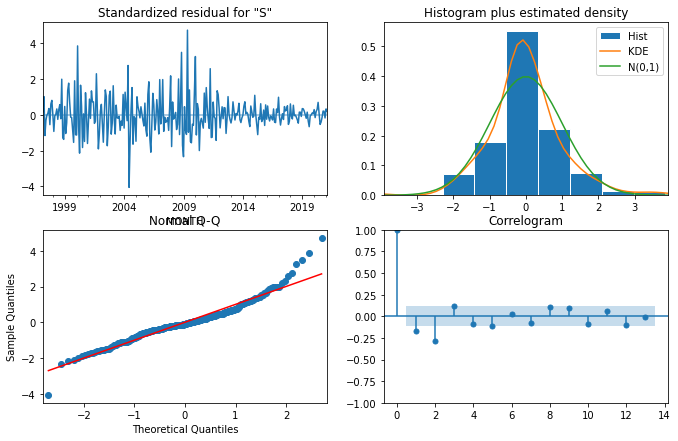

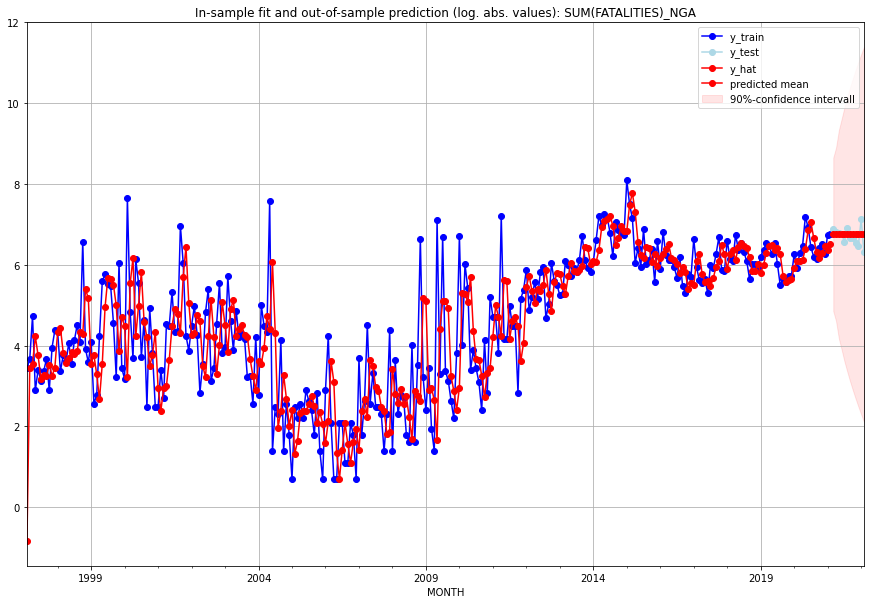

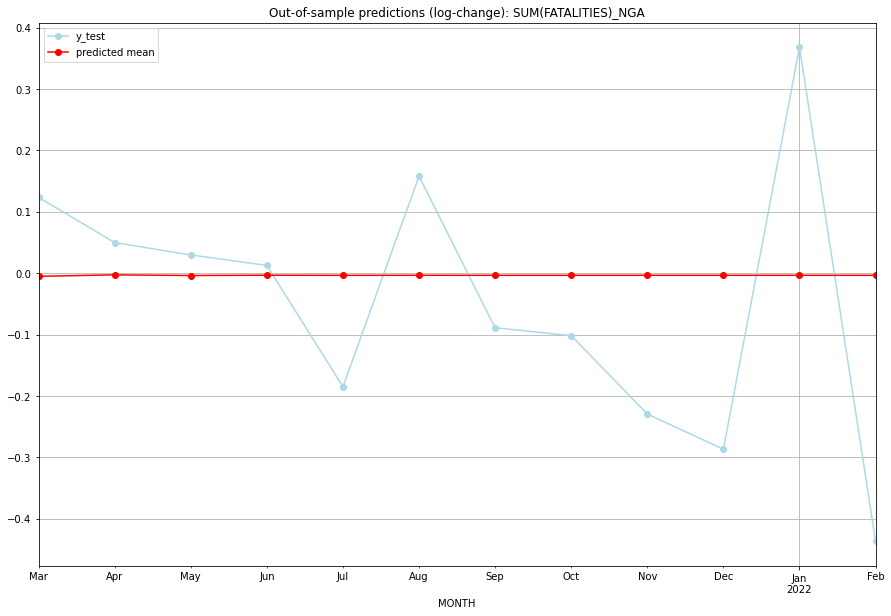

TADDA: 0.17375452747196438
Evaluation finished.
        MONTH    FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  853.751391       971.0     -0.004958        0.123587   NGA   
1  2021-04-01  855.748823       902.0     -0.002624        0.049954   NGA   
2  2021-05-01  854.807940       884.0     -0.003723        0.029819   NGA   
3  2021-06-01  855.250737       869.0     -0.003206        0.012724   NGA   
4  2021-07-01  855.042259       713.0     -0.003449       -0.184886   NGA   
5  2021-08-01  855.140395      1005.0     -0.003335        0.157968   NGA   
6  2021-09-01  855.094196       785.0     -0.003389       -0.088812   NGA   
7  2021-10-01  855.115944       775.0     -0.003363       -0.101616   NGA   
8  2021-11-01  855.105706       682.0     -0.003375       -0.229274   NGA   
9  2021-12-01  855.110526       644.0     -0.003369       -0.286519   NGA   
10 2022-01-01  855.108257      1240.0     -0.003372        0.367904   NGA   
11 2022-02-01  855.109325   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [1, (0, 0, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.6859182262733157, 'fold_results': [0.8286823721886298, 0.5431540803580014]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_NIC   No. Observations:                   38
Model:                SARIMAX(0, 0, 2)   Log Likelihood                 -59.446
Date:                 Wed, 19 Oct 2022   AIC                            126.892
Time:                         11:06:38   BIC                            133.442
Sample:                     01-31-2018   HQIC                           129.222
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -0.0089      0.

<Figure size 432x288 with 0 Axes>

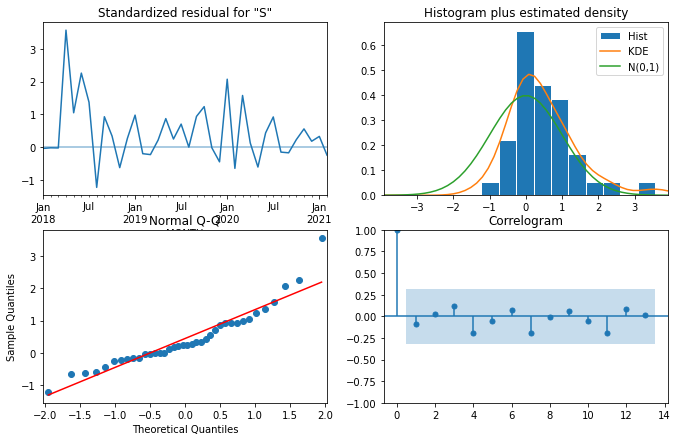

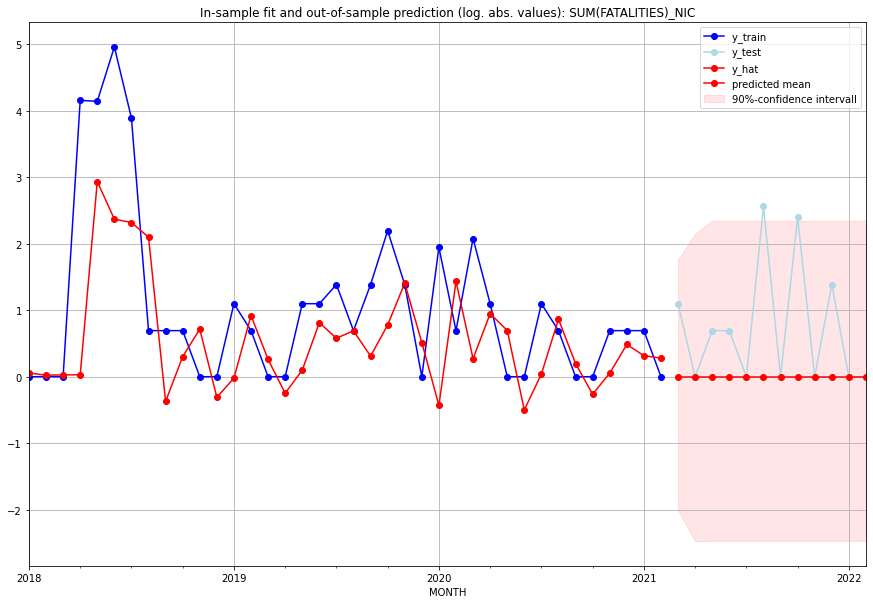

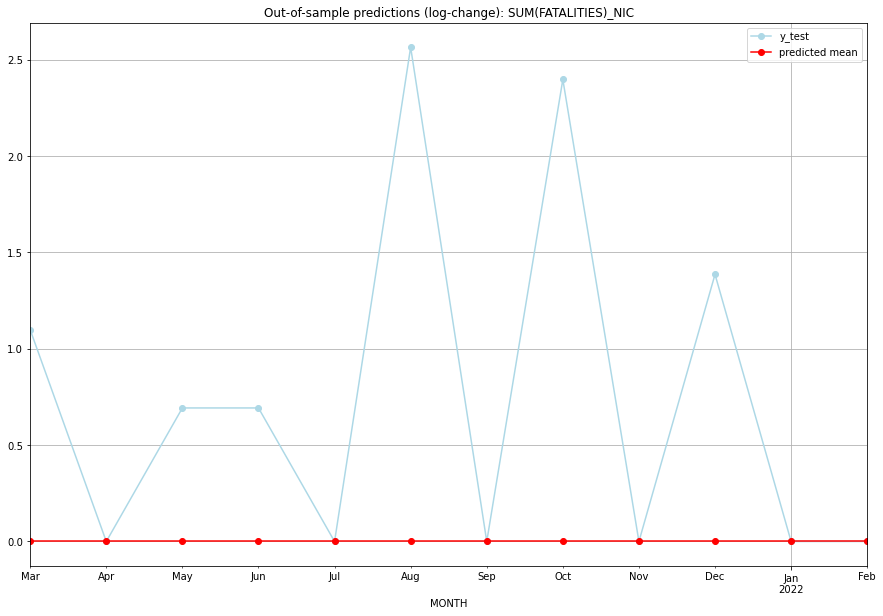

TADDA: 0.7361704700973165
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         2.0           0.0        1.098612   NIC   
1  2021-04-01       0.0         0.0           0.0        0.000000   NIC   
2  2021-05-01       0.0         1.0           0.0        0.693147   NIC   
3  2021-06-01       0.0         1.0           0.0        0.693147   NIC   
4  2021-07-01       0.0         0.0           0.0        0.000000   NIC   
5  2021-08-01       0.0        12.0           0.0        2.564949   NIC   
6  2021-09-01       0.0         0.0           0.0        0.000000   NIC   
7  2021-10-01       0.0        10.0           0.0        2.397895   NIC   
8  2021-11-01       0.0         0.0           0.0        0.000000   NIC   
9  2021-12-01       0.0         3.0           0.0        1.386294   NIC   
10 2022-01-01       0.0         0.0           0.0        0.000000   NIC   
11 2022-02-01       0.0         0.0           0.0    

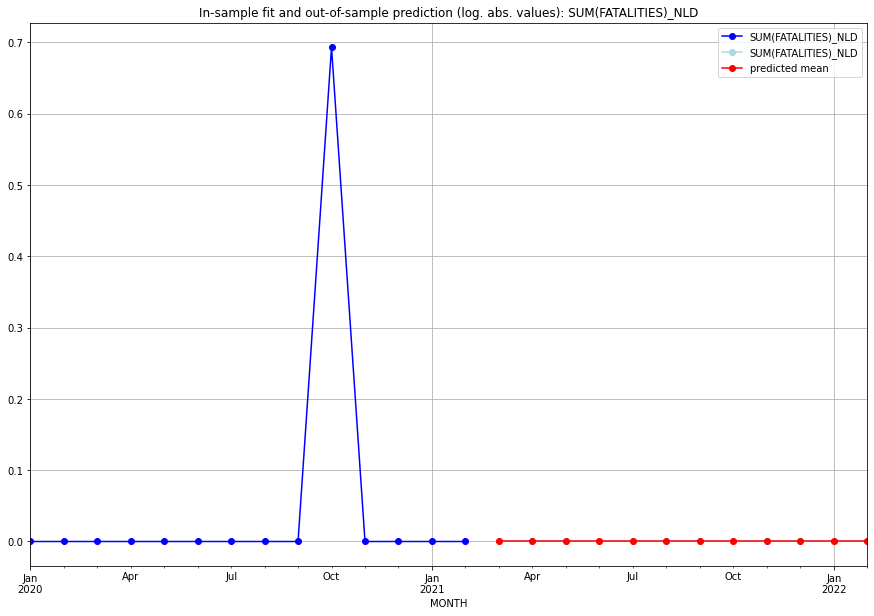

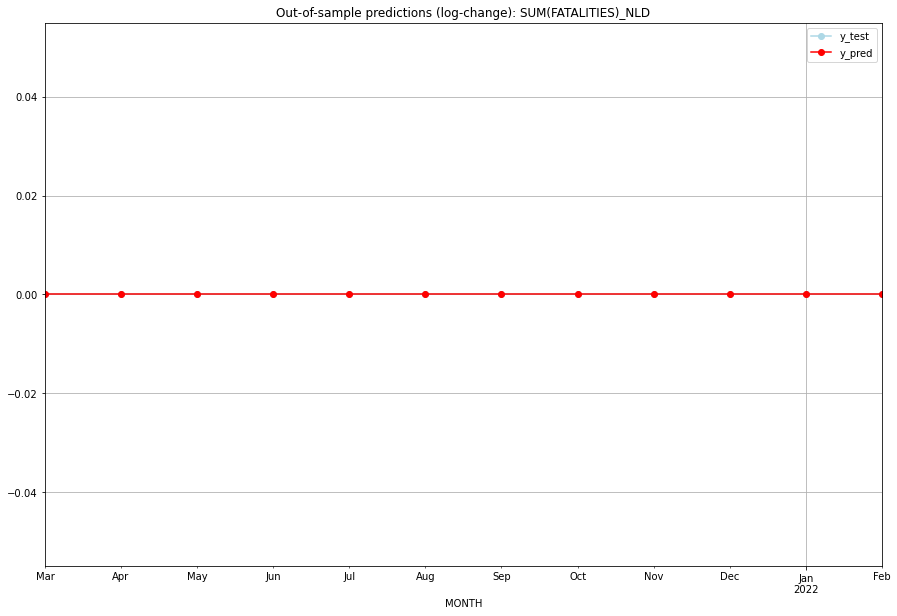

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   NLD   
1  2021-04-01       0.0         0.0           0.0             0.0   NLD   
2  2021-05-01       0.0         0.0           0.0             0.0   NLD   
3  2021-06-01       0.0         0.0           0.0             0.0   NLD   
4  2021-07-01       0.0         0.0           0.0             0.0   NLD   
5  2021-08-01       0.0         0.0           0.0             0.0   NLD   
6  2021-09-01       0.0         0.0           0.0             0.0   NLD   
7  2021-10-01       0.0         0.0           0.0             0.0   NLD   
8  2021-11-01       0.0         0.0           0.0             0.0   NLD   
9  2021-12-01       0.0         0.0           0.0             0.0   NLD   
10 2022-01-01       0.0         0.0           0.0             0.0   NLD   
11 2022-02-01       0.0         0.0           0.0             0.0   

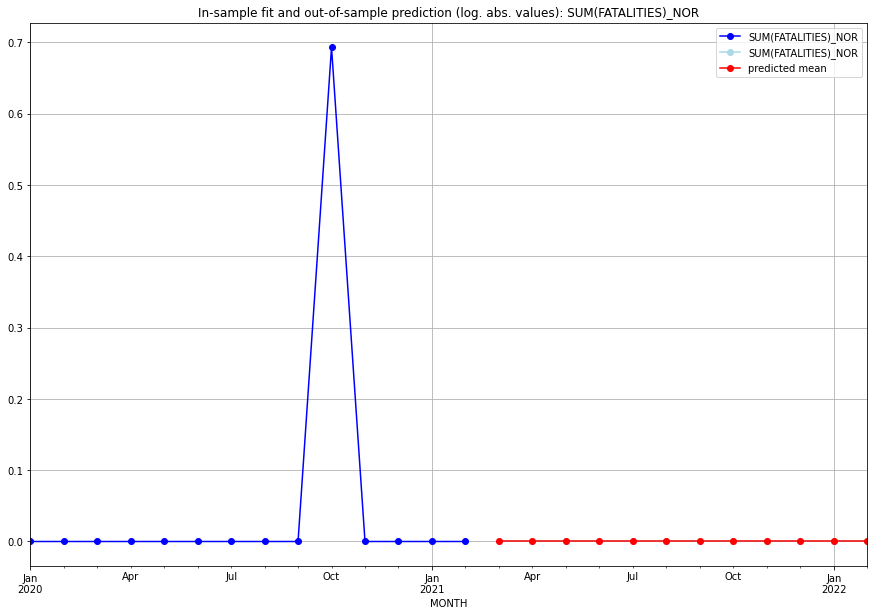

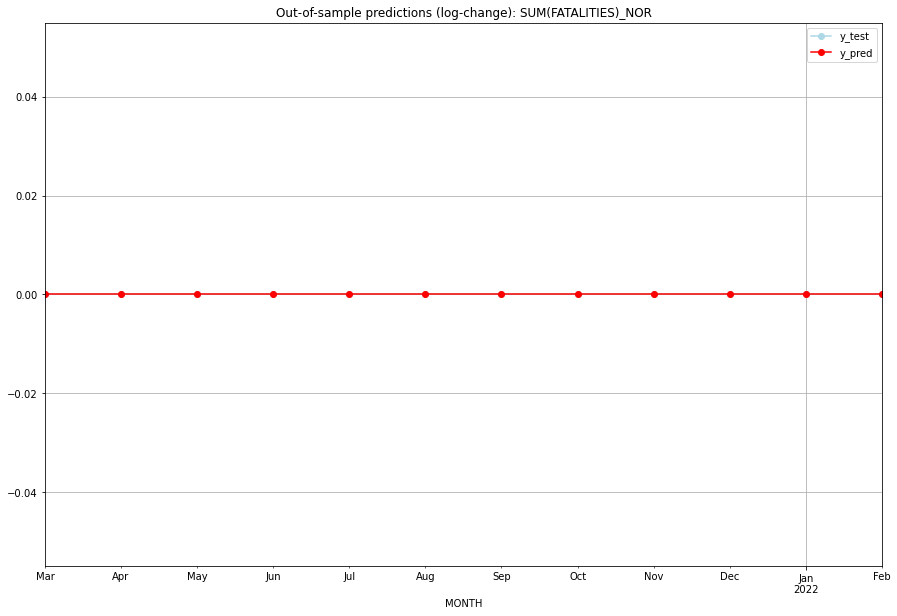

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   NOR   
1  2021-04-01       0.0         0.0           0.0             0.0   NOR   
2  2021-05-01       0.0         0.0           0.0             0.0   NOR   
3  2021-06-01       0.0         0.0           0.0             0.0   NOR   
4  2021-07-01       0.0         0.0           0.0             0.0   NOR   
5  2021-08-01       0.0         0.0           0.0             0.0   NOR   
6  2021-09-01       0.0         0.0           0.0             0.0   NOR   
7  2021-10-01       0.0         0.0           0.0             0.0   NOR   
8  2021-11-01       0.0         0.0           0.0             0.0   NOR   
9  2021-12-01       0.0         0.0           0.0             0.0   NOR   
10 2022-01-01       0.0         0.0           0.0             0.0   NOR   
11 2022-02-01       0.0         0.0           0.0             0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [1, (1, 0, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.5571913795628868, 'fold_results': [0.5748658660562792, 0.668693689038157, 0.5189971685971165, 0.5731106259121571, 0.4502895482107246]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_NPL   No. Observations:                  134
Model:                SARIMAX(1, 0, 2)   Log Likelihood                -143.452
Date:                 Wed, 19 Oct 2022   AIC                            296.904
Time:                         11:07:07   BIC                            311.393
Sample:                     01-31-2010   HQIC                           302.792
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------

<Figure size 432x288 with 0 Axes>

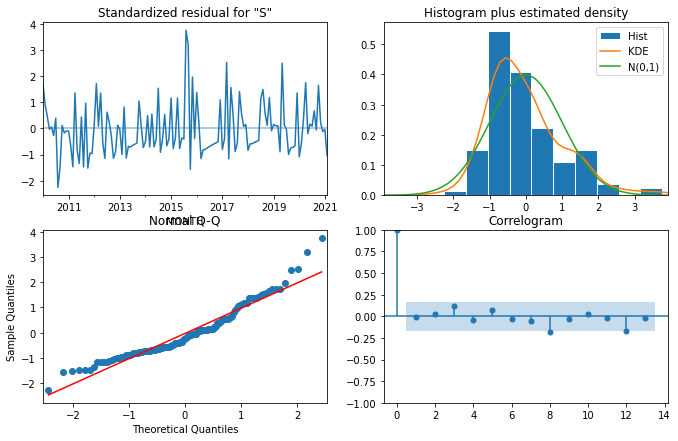

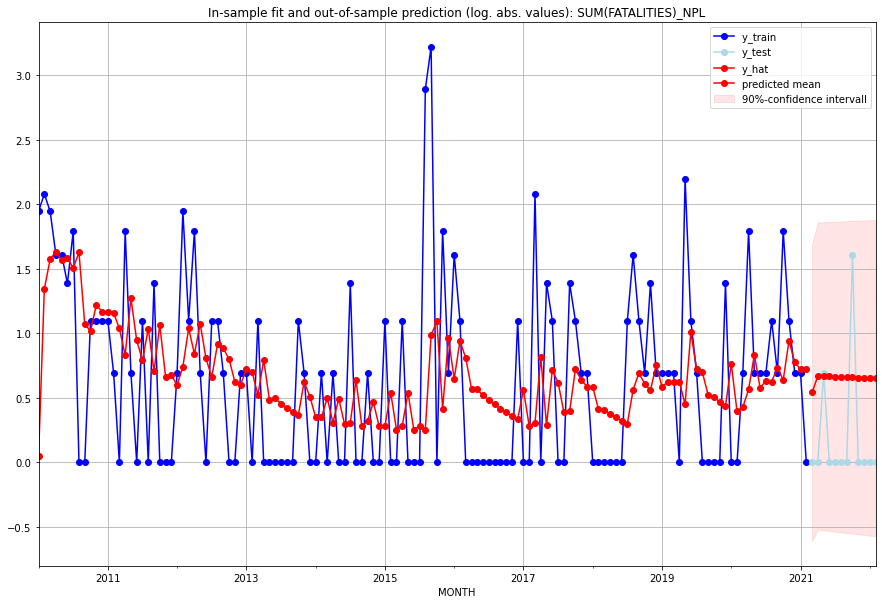

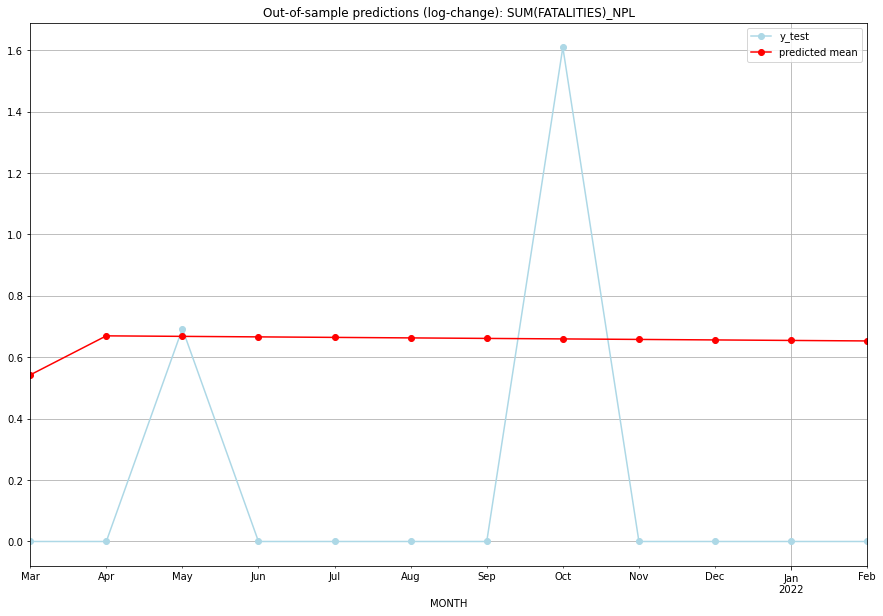

TADDA: 0.6220835943703543
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  0.720310         0.0      0.542504        0.000000   NPL   
1  2021-04-01  0.953693         0.0      0.669721        0.000000   NPL   
2  2021-05-01  0.950424         1.0      0.668047        0.693147   NPL   
3  2021-06-01  0.947169         0.0      0.666376        0.000000   NPL   
4  2021-07-01  0.943926         0.0      0.664710        0.000000   NPL   
5  2021-08-01  0.940696         0.0      0.663047        0.000000   NPL   
6  2021-09-01  0.937479         0.0      0.661387        0.000000   NPL   
7  2021-10-01  0.934274         4.0      0.659732        1.609438   NPL   
8  2021-11-01  0.931082         0.0      0.658081        0.000000   NPL   
9  2021-12-01  0.927903         0.0      0.656433        0.000000   NPL   
10 2022-01-01  0.924737         0.0      0.654789        0.000000   NPL   
11 2022-02-01  0.921582         0.0      0.653149    

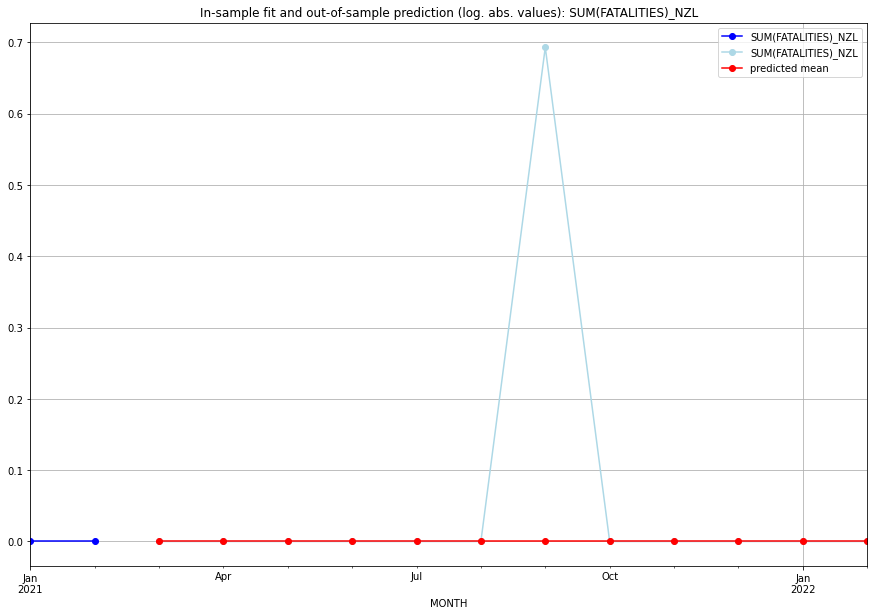

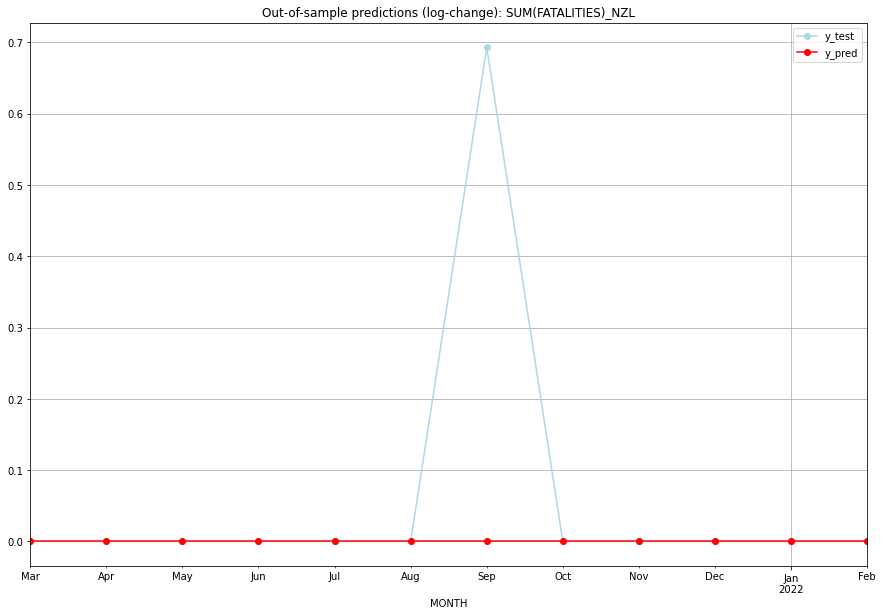

TADDA: 0.057762265046662105
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0    0.000000           0.0        0.000000   NZL   
1  2021-04-01       0.0    0.000000           0.0        0.000000   NZL   
2  2021-05-01       0.0    0.000000           0.0        0.000000   NZL   
3  2021-06-01       0.0    0.000000           0.0        0.000000   NZL   
4  2021-07-01       0.0    0.000000           0.0        0.000000   NZL   
5  2021-08-01       0.0    0.000000           0.0        0.000000   NZL   
6  2021-09-01       0.0    0.693147           0.0        0.693147   NZL   
7  2021-10-01       0.0    0.000000           0.0        0.000000   NZL   
8  2021-11-01       0.0    0.000000           0.0        0.000000   NZL   
9  2021-12-01       0.0    0.000000           0.0        0.000000   NZL   
10 2022-01-01       0.0    0.000000           0.0        0.000000   NZL   
11 2022-02-01       0.0    0.000000           0.0  

<Figure size 432x288 with 0 Axes>

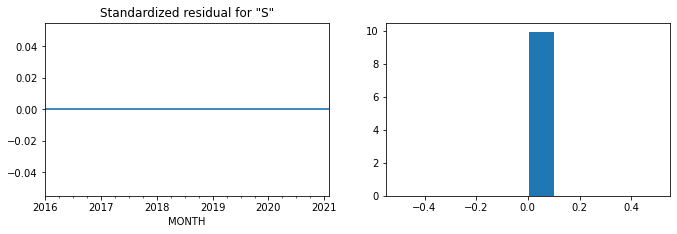

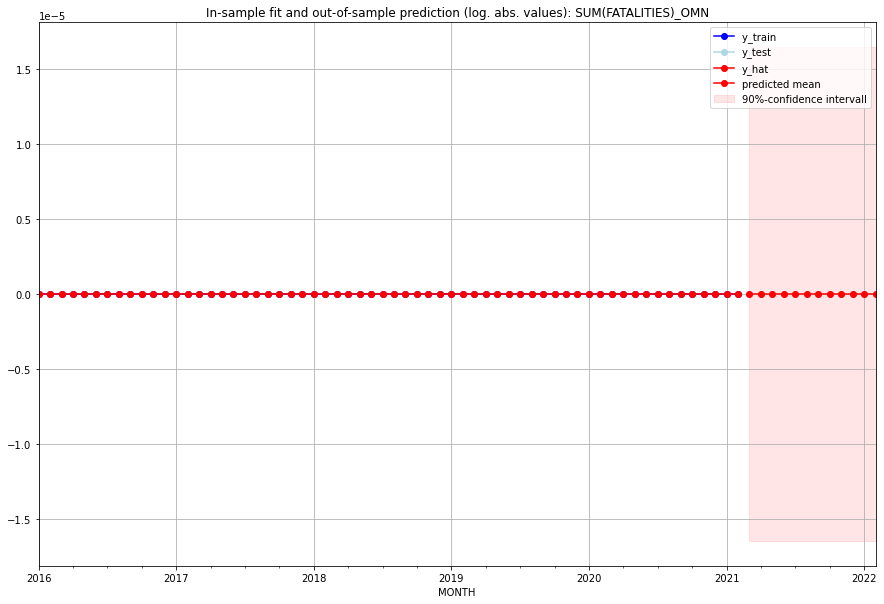

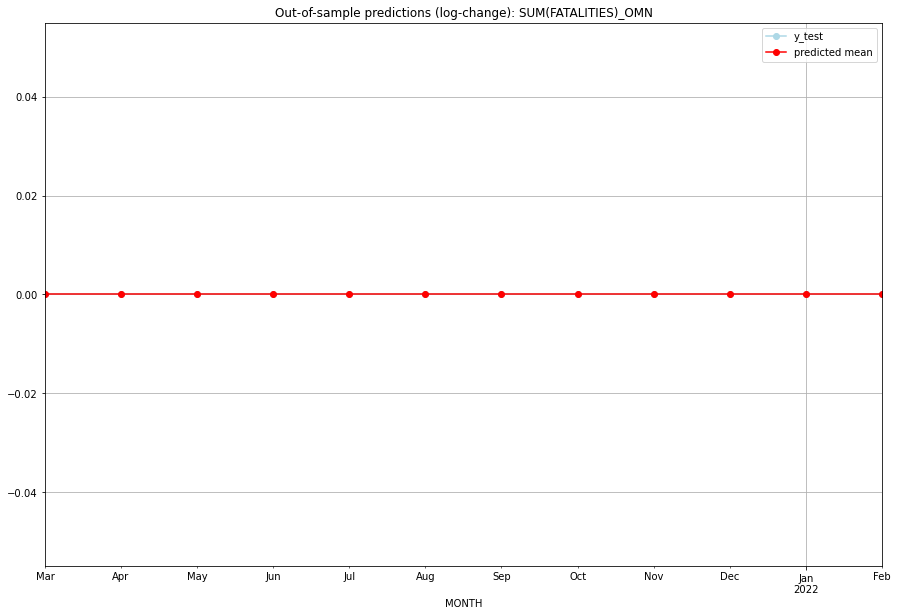

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   OMN   
1  2021-04-01       0.0         0.0           0.0             0.0   OMN   
2  2021-05-01       0.0         0.0           0.0             0.0   OMN   
3  2021-06-01       0.0         0.0           0.0             0.0   OMN   
4  2021-07-01       0.0         0.0           0.0             0.0   OMN   
5  2021-08-01       0.0         0.0           0.0             0.0   OMN   
6  2021-09-01       0.0         0.0           0.0             0.0   OMN   
7  2021-10-01       0.0         0.0           0.0             0.0   OMN   
8  2021-11-01       0.0         0.0           0.0             0.0   OMN   
9  2021-12-01       0.0         0.0           0.0             0.0   OMN   
10 2022-01-01       0.0         0.0           0.0             0.0   OMN   
11 2022-02-01       0.0         0.0           0.0             0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (2, 0, 1), (0, 0, 0, 0), 'n'], 'cv_score': 0.332505097850062, 'fold_results': [0.43517968531620127, 0.37906413475476225, 0.2974716985720824, 0.25085817186630155, 0.29995179874096267]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_PAK   No. Observations:                  134
Model:                SARIMAX(2, 0, 1)   Log Likelihood                 -76.917
Date:                 Wed, 19 Oct 2022   AIC                            161.835
Time:                         11:07:30   BIC                            173.426
Sample:                     01-31-2010   HQIC                           166.545
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------

<Figure size 432x288 with 0 Axes>

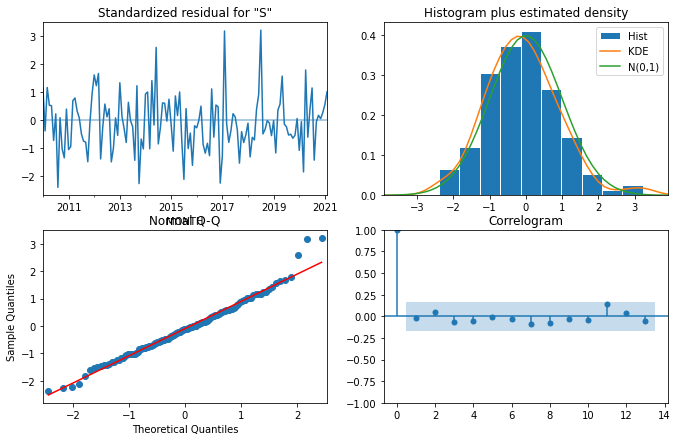

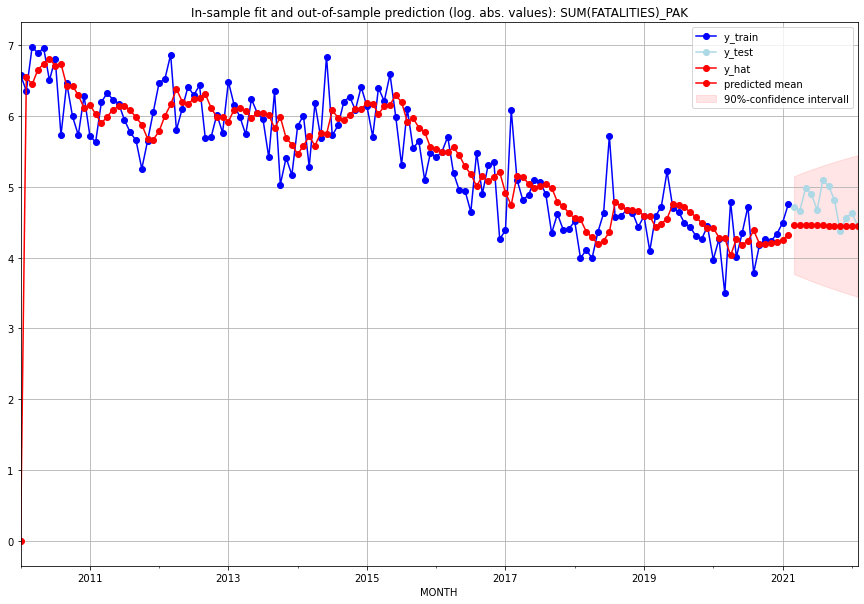

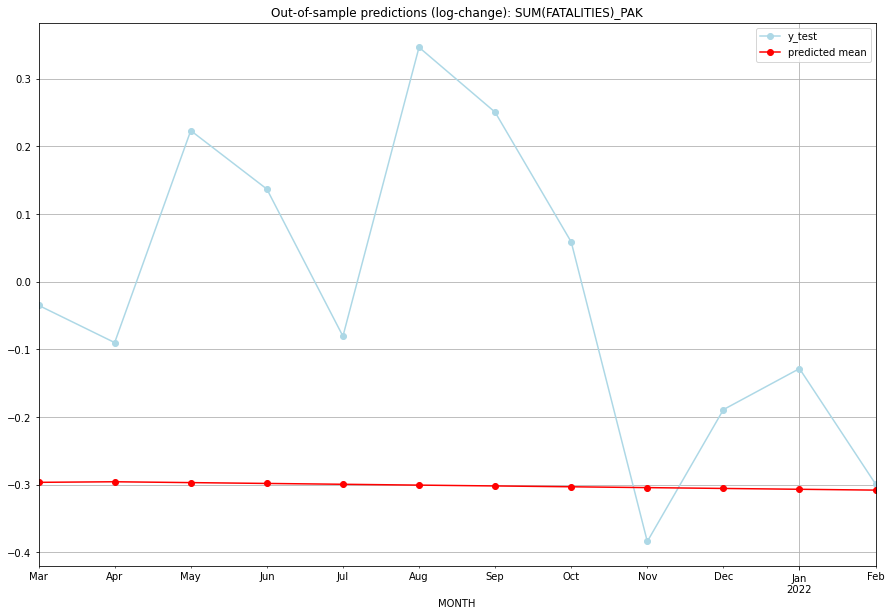

TADDA: 0.42399420577160046
Evaluation finished.
        MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  85.218122       111.0     -0.296710       -0.035091   PAK   
1  2021-04-01  85.290763       105.0     -0.295868       -0.090151   PAK   
2  2021-05-01  85.183137       144.0     -0.297116        0.223144   PAK   
3  2021-06-01  85.076939       132.0     -0.298349        0.136759   PAK   
4  2021-07-01  84.970893       106.0     -0.299581       -0.080761   PAK   
5  2021-08-01  84.865006       163.0     -0.300814        0.346276   PAK   
6  2021-09-01  84.759279       148.0     -0.302046        0.250356   PAK   
7  2021-10-01  84.653712       122.0     -0.303278        0.058594   PAK   
8  2021-11-01  84.548303        78.0     -0.304509       -0.384142   PAK   
9  2021-12-01  84.443054        95.0     -0.305740       -0.189242   PAK   
10 2022-01-01  84.337963       101.0     -0.306971       -0.128617   PAK   
11 2022-02-01  84.233030        85.0    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.17328679513998632, 'fold_results': [0.17328679513998632, 0.17328679513998632]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_PAN   No. Observations:                   38
Model:                         SARIMAX   Log Likelihood                 -12.625
Date:                 Wed, 19 Oct 2022   AIC                             27.251
Time:                         11:07:37   BIC                             28.888
Sample:                     01-31-2018   HQIC                            27.833
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.1138     

<Figure size 432x288 with 0 Axes>

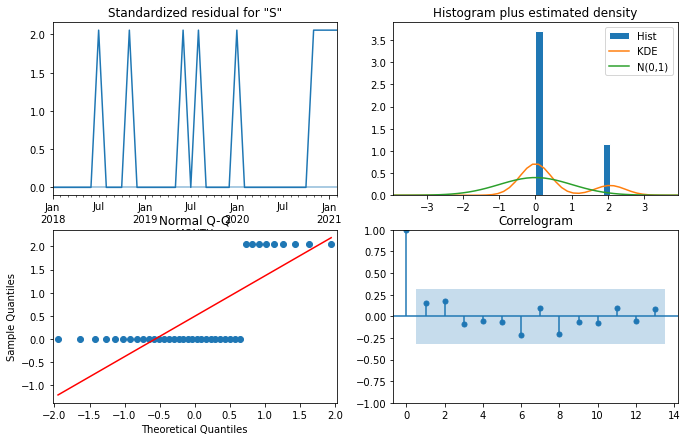

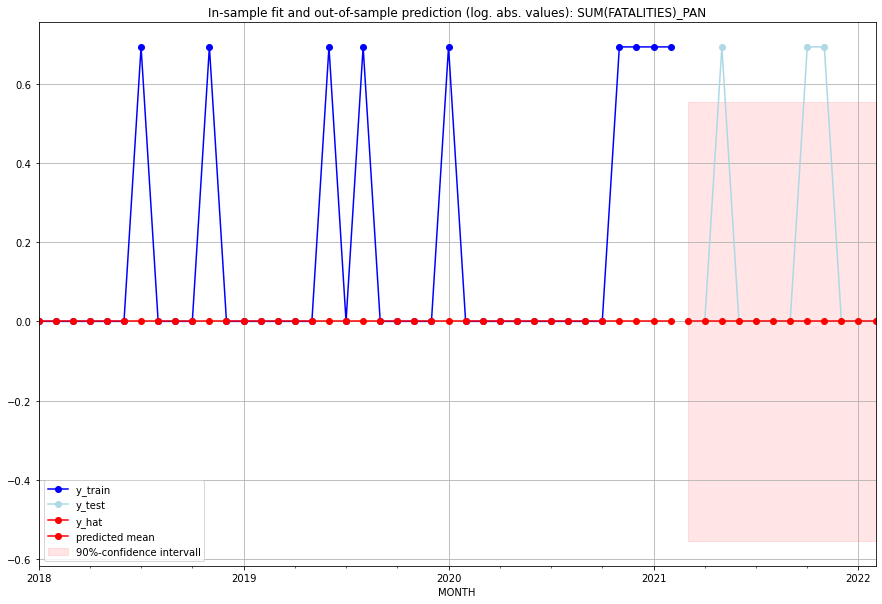

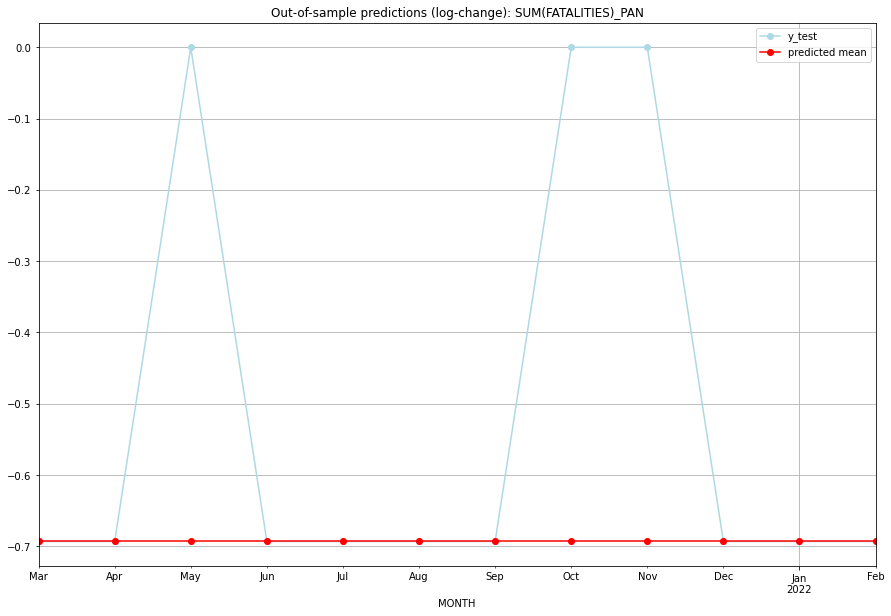

TADDA: 0.17328679513998632
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0     -0.693147       -0.693147   PAN   
1  2021-04-01       0.0         0.0     -0.693147       -0.693147   PAN   
2  2021-05-01       0.0         1.0     -0.693147        0.000000   PAN   
3  2021-06-01       0.0         0.0     -0.693147       -0.693147   PAN   
4  2021-07-01       0.0         0.0     -0.693147       -0.693147   PAN   
5  2021-08-01       0.0         0.0     -0.693147       -0.693147   PAN   
6  2021-09-01       0.0         0.0     -0.693147       -0.693147   PAN   
7  2021-10-01       0.0         1.0     -0.693147        0.000000   PAN   
8  2021-11-01       0.0         1.0     -0.693147        0.000000   PAN   
9  2021-12-01       0.0         0.0     -0.693147       -0.693147   PAN   
10 2022-01-01       0.0         0.0     -0.693147       -0.693147   PAN   
11 2022-02-01       0.0         0.0     -0.693147   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [1, (3, 1, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.6004479215970354, 'fold_results': [nan, 0.6004479215970354]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_PER   No. Observations:                   38
Model:                SARIMAX(3, 1, 3)   Log Likelihood                 -39.836
Date:                 Wed, 19 Oct 2022   AIC                             95.673
Time:                         11:07:46   BIC                            108.560
Sample:                     01-31-2018   HQIC                           100.216
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             0.0311      0.033      0.930 

<Figure size 432x288 with 0 Axes>

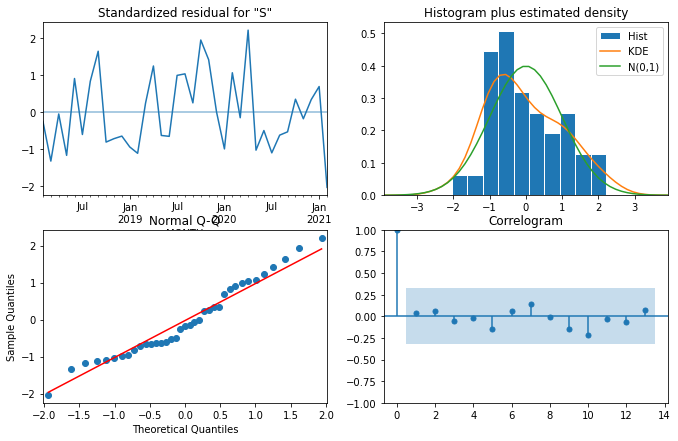

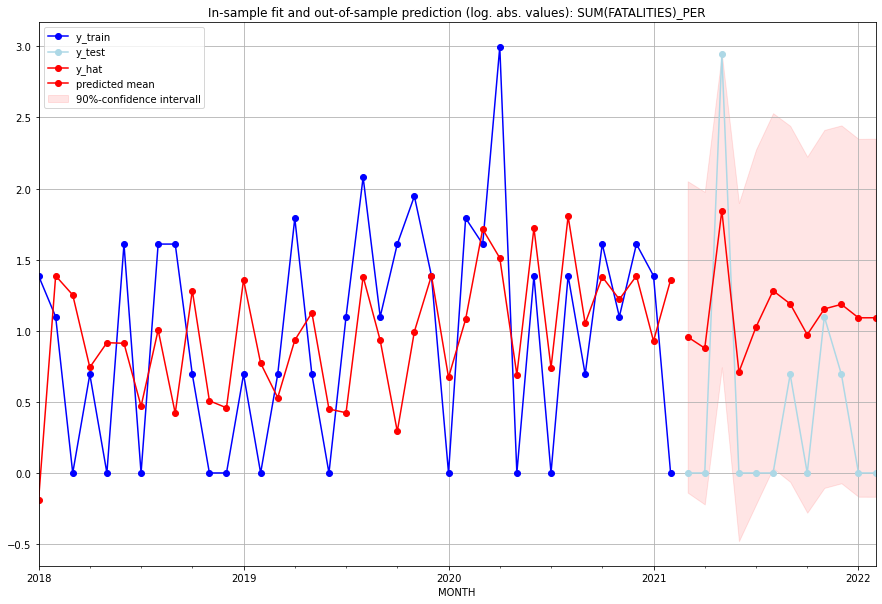

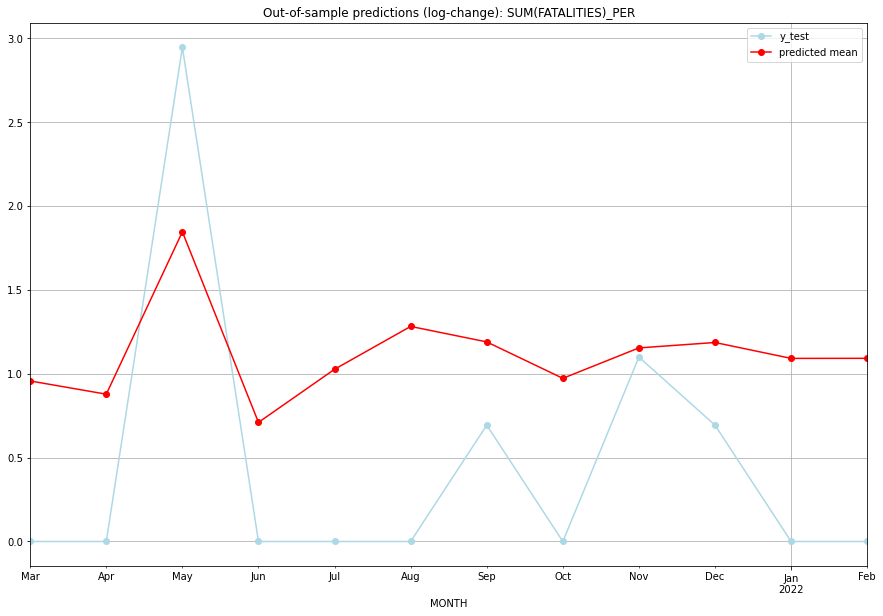

TADDA: 0.845723665110012
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  1.602437         0.0      0.956448        0.000000   PER   
1  2021-04-01  1.405323         0.0      0.877684        0.000000   PER   
2  2021-05-01  5.328617        18.0      1.845082        2.944439   PER   
3  2021-06-01  1.033337         0.0      0.709678        0.000000   PER   
4  2021-07-01  1.790308         0.0      1.026152        0.000000   PER   
5  2021-08-01  2.601807         0.0      1.281436        0.000000   PER   
6  2021-09-01  2.284249         1.0      1.189138        0.693147   PER   
7  2021-10-01  1.643748         0.0      0.972198        0.000000   PER   
8  2021-11-01  2.169056         2.0      1.153434        1.098612   PER   
9  2021-12-01  2.272843         1.0      1.185659        0.693147   PER   
10 2022-01-01  1.977122         0.0      1.090957        0.000000   PER   
11 2022-02-01  1.978589         0.0      1.091450     

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (2, 1, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.2013773990868446, 'fold_results': [nan, 0.23216876998335248, 0.13287677646633086, 0.23908665081085045]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_PHL   No. Observations:                   62
Model:                SARIMAX(2, 1, 3)   Log Likelihood                 -31.795
Date:                 Wed, 19 Oct 2022   AIC                             81.590
Time:                         11:07:59   BIC                            100.588
Sample:                     01-31-2016   HQIC                            89.036
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x

<Figure size 432x288 with 0 Axes>

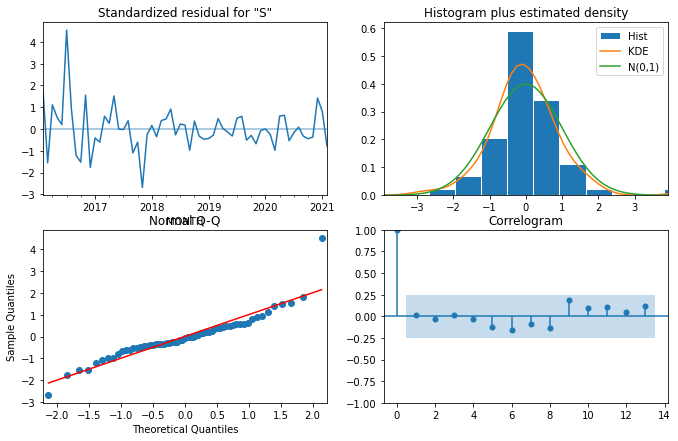

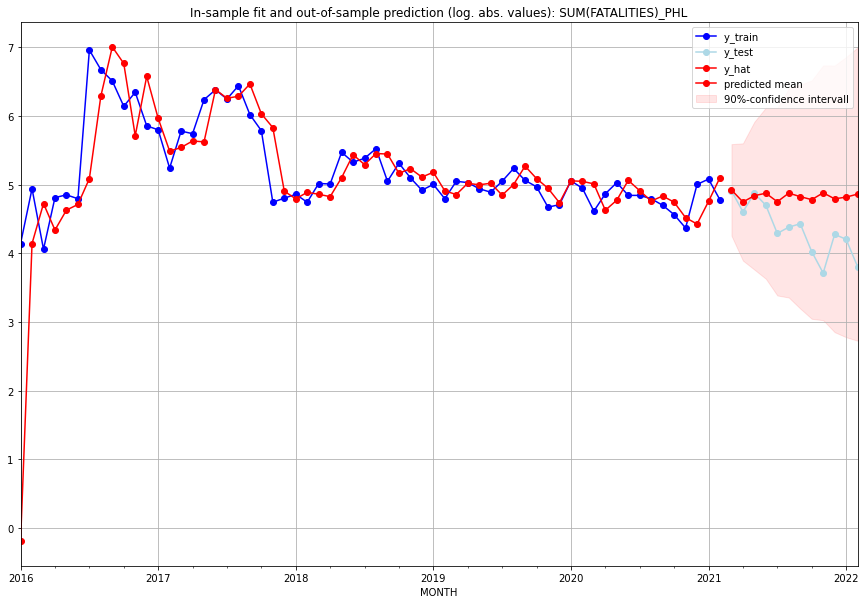

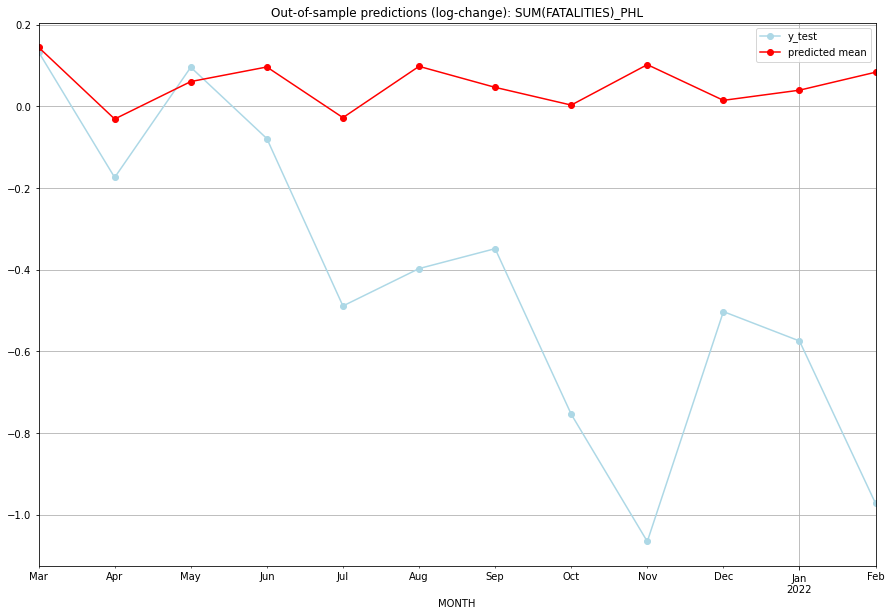

TADDA: 0.5263735631816648
Evaluation finished.
        MONTH    FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  136.553776       135.0      0.144891        0.133531   PHL   
1  2021-04-01  114.396745        99.0     -0.030747       -0.173953   PHL   
2  2021-05-01  125.482812       130.0      0.060983        0.096074   PHL   
3  2021-06-01  130.083349       109.0      0.096710       -0.078643   PHL   
4  2021-07-01  114.785994        72.0     -0.027380       -0.488664   PHL   
5  2021-08-01  130.286718        79.0      0.098260       -0.397097   PHL   
6  2021-09-01  123.703546        83.0      0.046816       -0.348307   PHL   
7  2021-10-01  118.404357        55.0      0.003392       -0.753772   PHL   
8  2021-11-01  130.840128        40.0      0.102467       -1.065551   PHL   
9  2021-12-01  119.797747        71.0      0.014994       -0.502457   PHL   
10 2022-01-01  122.841856        66.0      0.039882       -0.574431   PHL   
11 2022-02-01  128.413690    

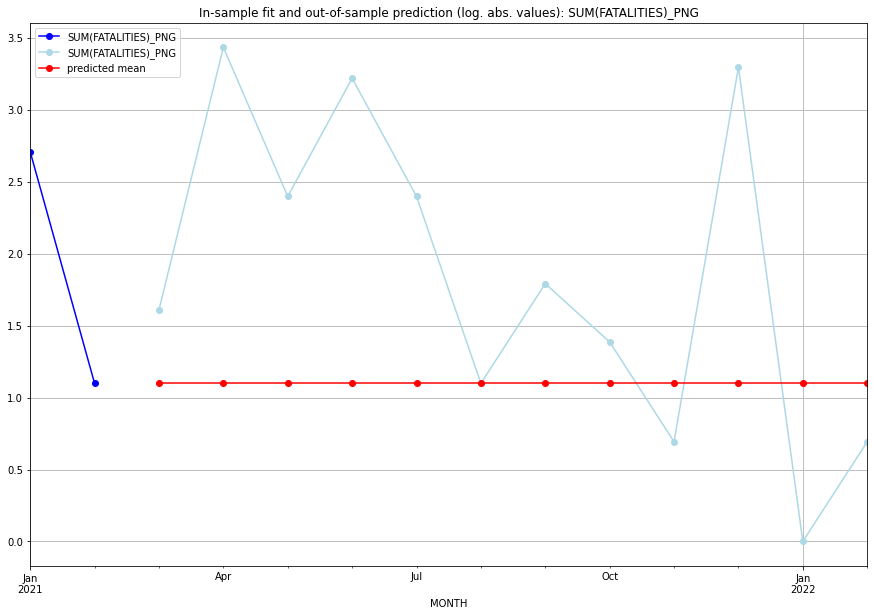

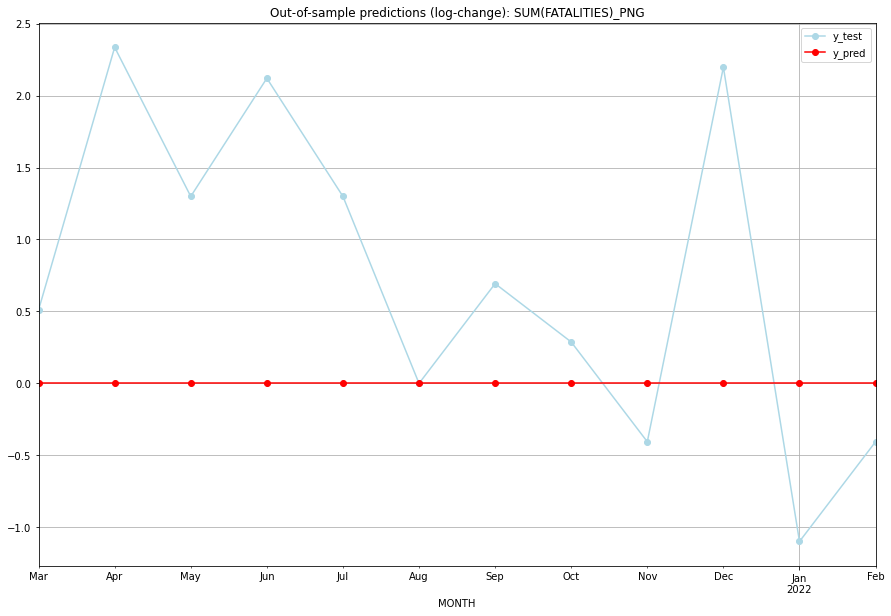

TADDA: 1.054385531606335
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  1.098612    1.609438           0.0        0.510826   PNG   
1  2021-04-01  1.098612    3.433987           0.0        2.335375   PNG   
2  2021-05-01  1.098612    2.397895           0.0        1.299283   PNG   
3  2021-06-01  1.098612    3.218876           0.0        2.120264   PNG   
4  2021-07-01  1.098612    2.397895           0.0        1.299283   PNG   
5  2021-08-01  1.098612    1.098612           0.0        0.000000   PNG   
6  2021-09-01  1.098612    1.791759           0.0        0.693147   PNG   
7  2021-10-01  1.098612    1.386294           0.0        0.287682   PNG   
8  2021-11-01  1.098612    0.693147           0.0       -0.405465   PNG   
9  2021-12-01  1.098612    3.295837           0.0        2.197225   PNG   
10 2022-01-01  1.098612    0.000000           0.0       -1.098612   PNG   
11 2022-02-01  1.098612    0.693147           0.0     

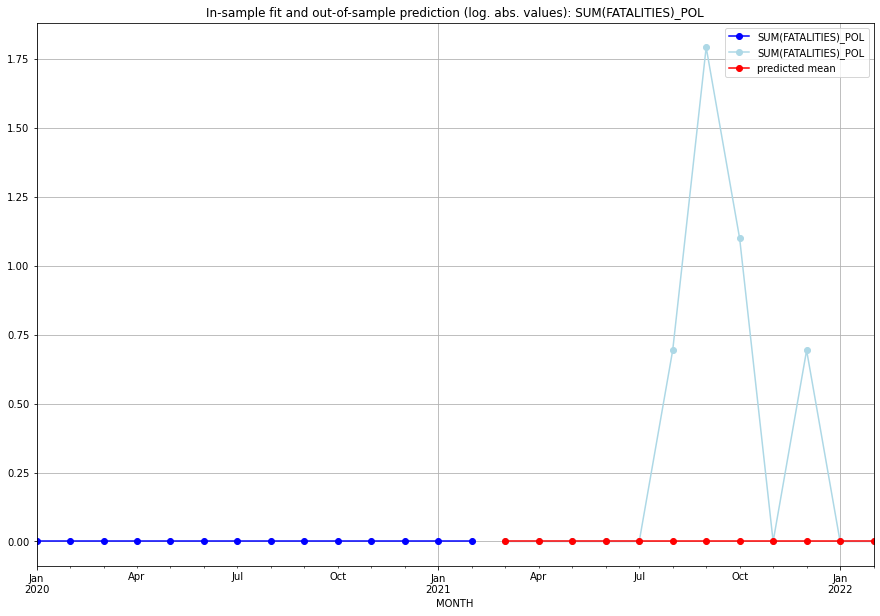

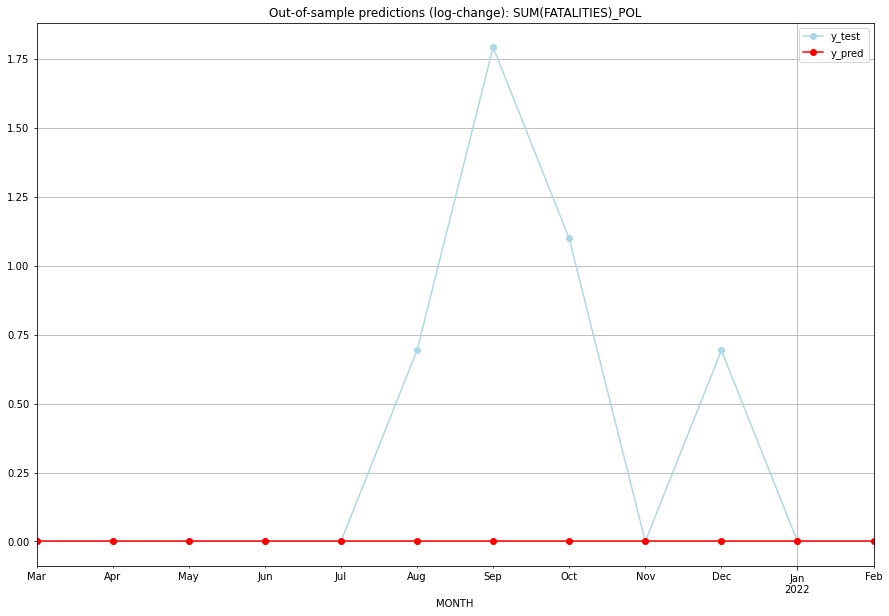

TADDA: 0.35638884325133796
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0    0.000000           0.0        0.000000   POL   
1  2021-04-01       0.0    0.000000           0.0        0.000000   POL   
2  2021-05-01       0.0    0.000000           0.0        0.000000   POL   
3  2021-06-01       0.0    0.000000           0.0        0.000000   POL   
4  2021-07-01       0.0    0.000000           0.0        0.000000   POL   
5  2021-08-01       0.0    0.693147           0.0        0.693147   POL   
6  2021-09-01       0.0    1.791759           0.0        1.791759   POL   
7  2021-10-01       0.0    1.098612           0.0        1.098612   POL   
8  2021-11-01       0.0    0.000000           0.0        0.000000   POL   
9  2021-12-01       0.0    0.693147           0.0        0.693147   POL   
10 2022-01-01       0.0    0.000000           0.0        0.000000   POL   
11 2022-02-01       0.0    0.000000           0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (2, 1, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.4753493193289153, 'fold_results': [nan, 0.4753493193289153]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_PRI   No. Observations:                   38
Model:                SARIMAX(2, 1, 3)   Log Likelihood                 -28.109
Date:                 Wed, 19 Oct 2022   AIC                             68.217
Time:                         11:08:10   BIC                             77.883
Sample:                     01-31-2018   HQIC                            71.625
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -1.0315      0.296     -3.482 

<Figure size 432x288 with 0 Axes>

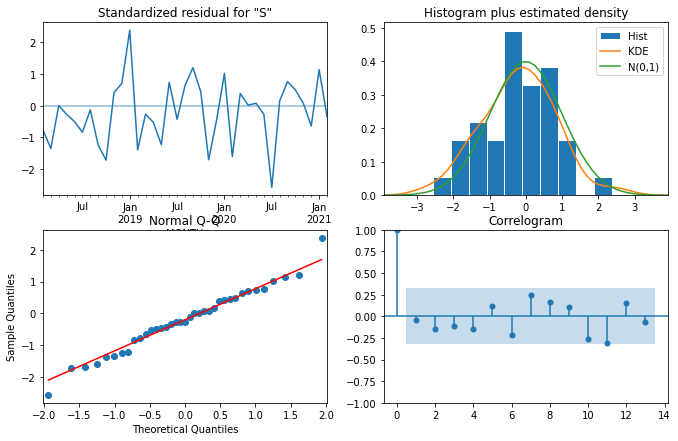

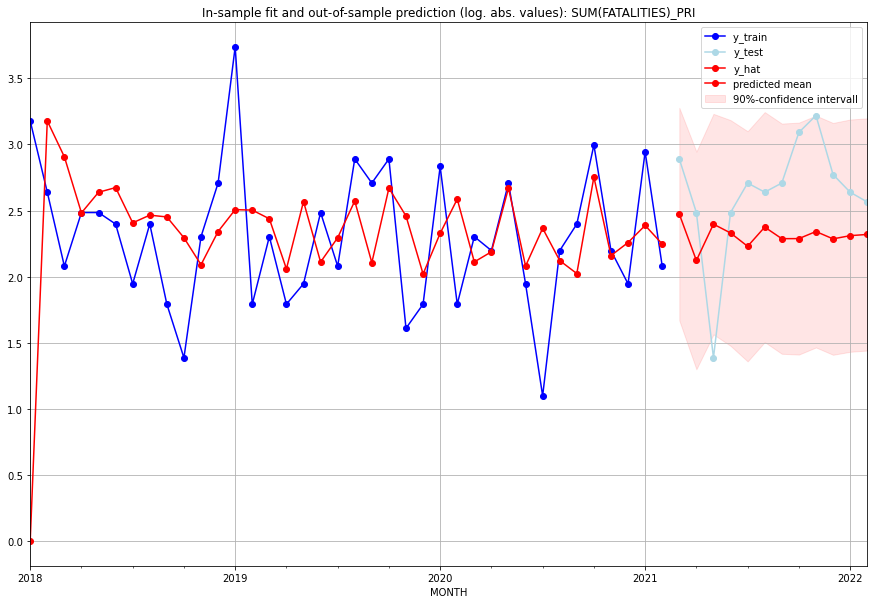

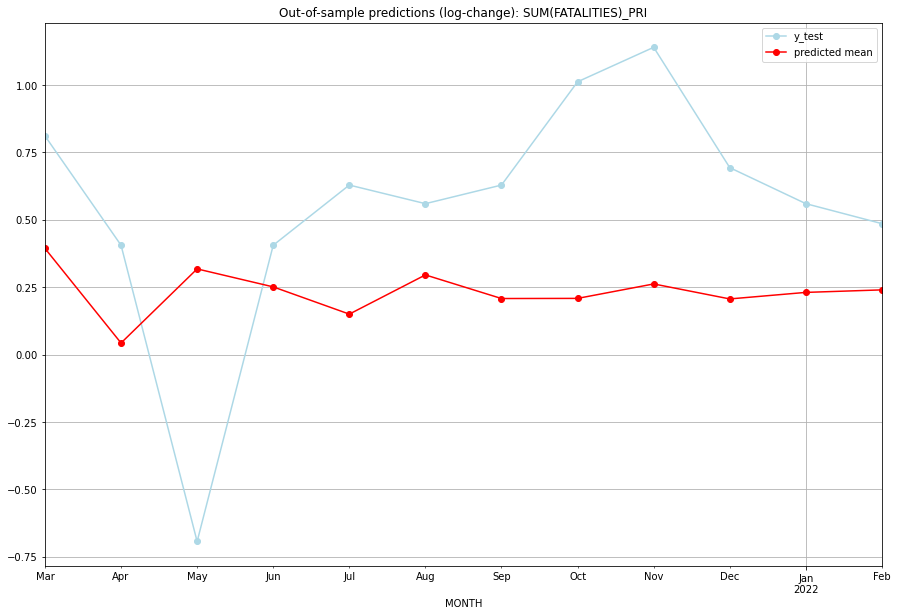

TADDA: 0.5140397749884901
Evaluation finished.
        MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  10.860156        17.0      0.393743        0.810930   PRI   
1  2021-04-01   7.350973        11.0      0.042937        0.405465   PRI   
2  2021-05-01   9.991478         3.0      0.317679       -0.693147   PRI   
3  2021-06-01   9.282593        11.0      0.251011        0.405465   PRI   
4  2021-07-01   8.295001        14.0      0.150035        0.628609   PRI   
5  2021-08-01   9.749167        13.0      0.295387        0.559616   PRI   
6  2021-09-01   8.848093        14.0      0.207836        0.628609   PRI   
7  2021-10-01   8.853103        21.0      0.208345        1.011601   PRI   
8  2021-11-01   9.395302        24.0      0.261912        1.139434   PRI   
9  2021-12-01   8.833374        15.0      0.206341        0.693147   PRI   
10 2022-01-01   9.074536        13.0      0.230569        0.559616   PRI   
11 2022-02-01   9.169085        12.0     

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [1, (3, 0, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.37470395423014247, 'fold_results': [0.28343311513851294, 0.46597479332177194]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_PRK   No. Observations:                   38
Model:                SARIMAX(3, 0, 2)   Log Likelihood                 -25.145
Date:                 Wed, 19 Oct 2022   AIC                             64.290
Time:                         11:08:21   BIC                             75.753
Sample:                     01-31-2018   HQIC                            68.368
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -0.0876     

<Figure size 432x288 with 0 Axes>

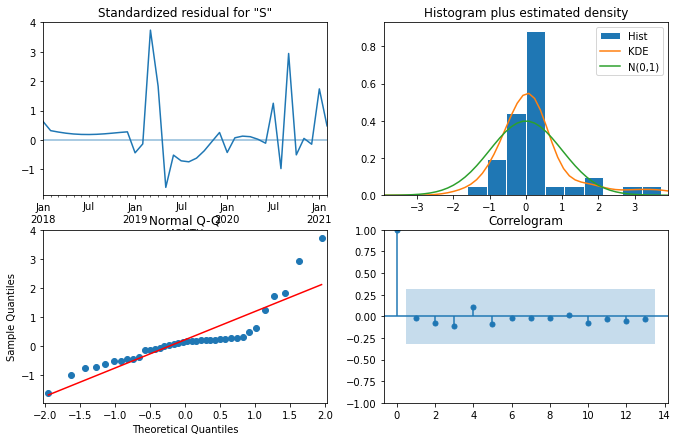

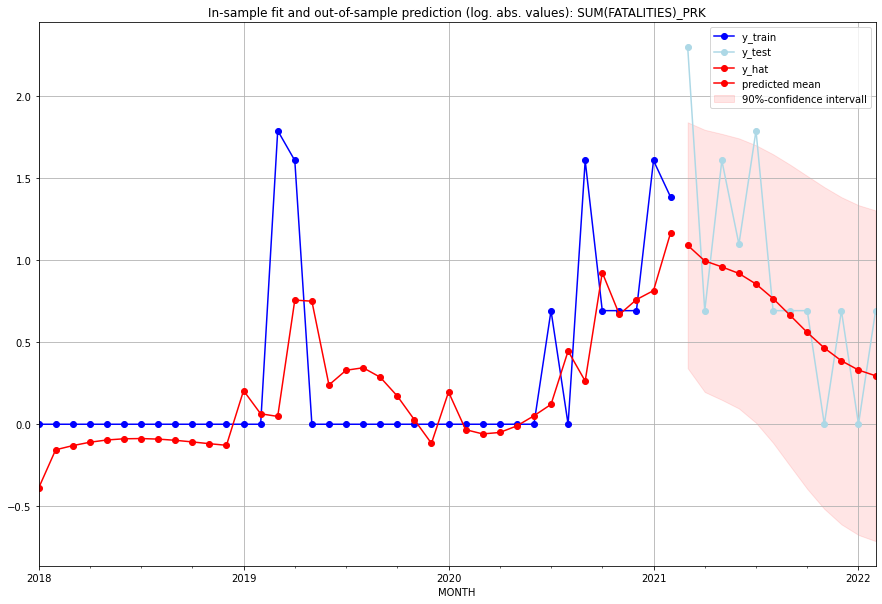

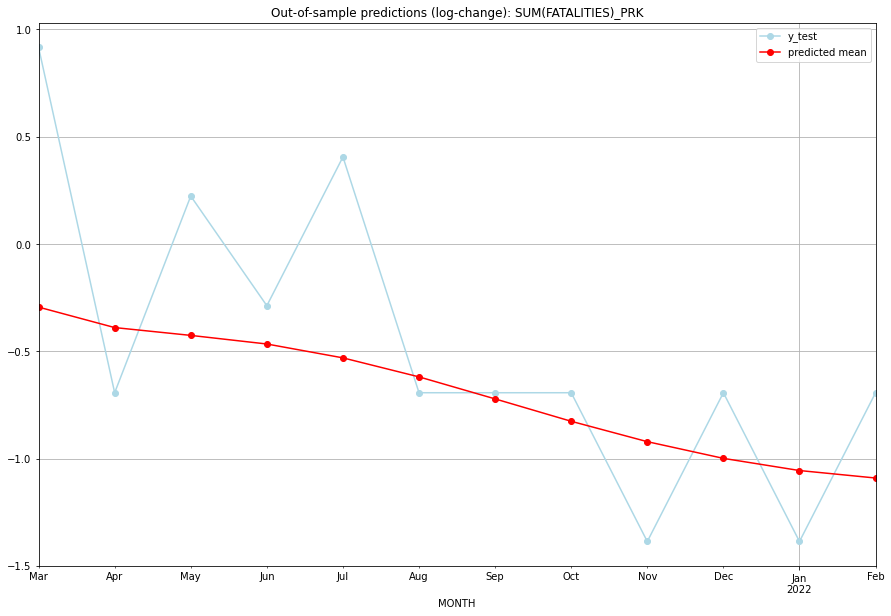

TADDA: 0.521953145251901
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  1.980501         9.0     -0.294203        0.916291   PRK   
1  2021-04-01  1.709391         1.0     -0.389571       -0.693147   PRK   
2  2021-05-01  1.612500         4.0     -0.425987        0.223144   PRK   
3  2021-06-01  1.509777         2.0     -0.466100       -0.287682   PRK   
4  2021-07-01  1.352692         5.0     -0.530734        0.405465   PRK   
5  2021-08-01  1.153211         1.0     -0.619334       -0.693147   PRK   
6  2021-09-01  0.943204         1.0     -0.721956       -0.693147   PRK   
7  2021-10-01  0.750795         1.0     -0.826225       -0.693147   PRK   
8  2021-11-01  0.592227         0.0     -0.921161       -1.386294   PRK   
9  2021-12-01  0.472999         1.0     -0.998994       -0.693147   PRK   
10 2022-01-01  0.391840         0.0     -1.055668       -1.386294   PRK   
11 2022-02-01  0.344144         1.0     -1.090537     

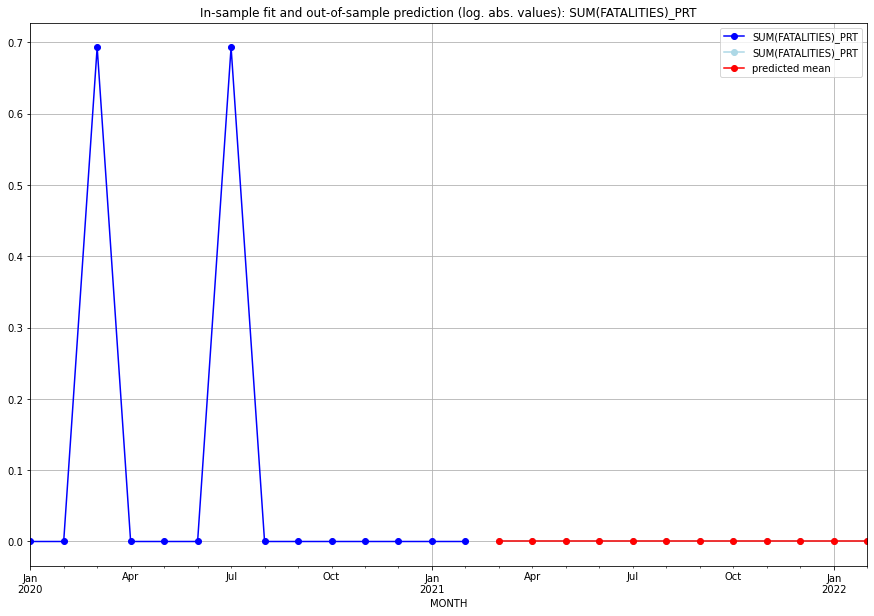

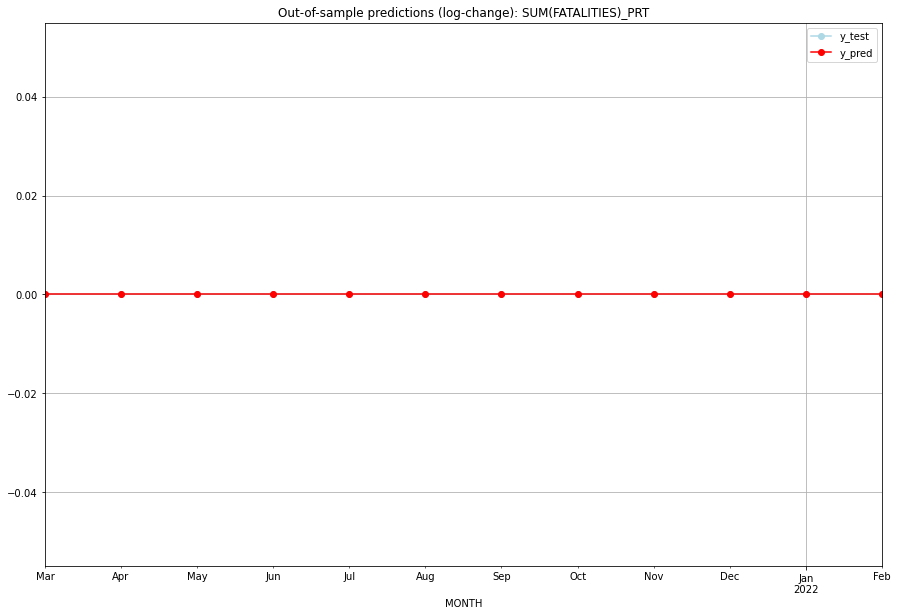

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   PRT   
1  2021-04-01       0.0         0.0           0.0             0.0   PRT   
2  2021-05-01       0.0         0.0           0.0             0.0   PRT   
3  2021-06-01       0.0         0.0           0.0             0.0   PRT   
4  2021-07-01       0.0         0.0           0.0             0.0   PRT   
5  2021-08-01       0.0         0.0           0.0             0.0   PRT   
6  2021-09-01       0.0         0.0           0.0             0.0   PRT   
7  2021-10-01       0.0         0.0           0.0             0.0   PRT   
8  2021-11-01       0.0         0.0           0.0             0.0   PRT   
9  2021-12-01       0.0         0.0           0.0             0.0   PRT   
10 2022-01-01       0.0         0.0           0.0             0.0   PRT   
11 2022-02-01       0.0         0.0           0.0             0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (3, 0, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.49312264194754213, 'fold_results': [0.5057021978168409, 0.48054308607824336]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_PRY   No. Observations:                   38
Model:                SARIMAX(3, 0, 2)   Log Likelihood                 -38.740
Date:                 Wed, 19 Oct 2022   AIC                             89.481
Time:                         11:08:33   BIC                             99.306
Sample:                     01-31-2018   HQIC                            92.977
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.1855      

<Figure size 432x288 with 0 Axes>

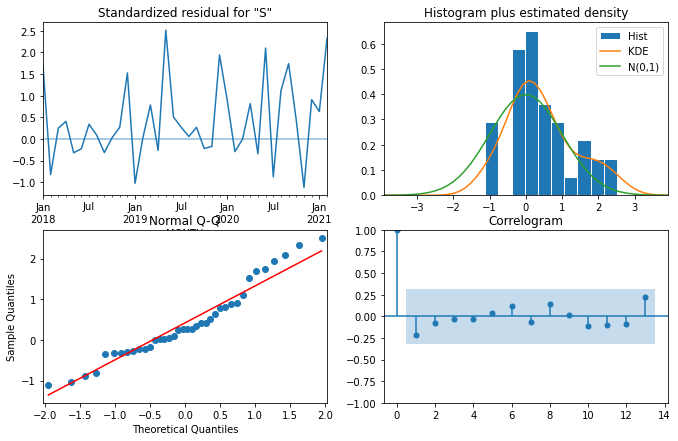

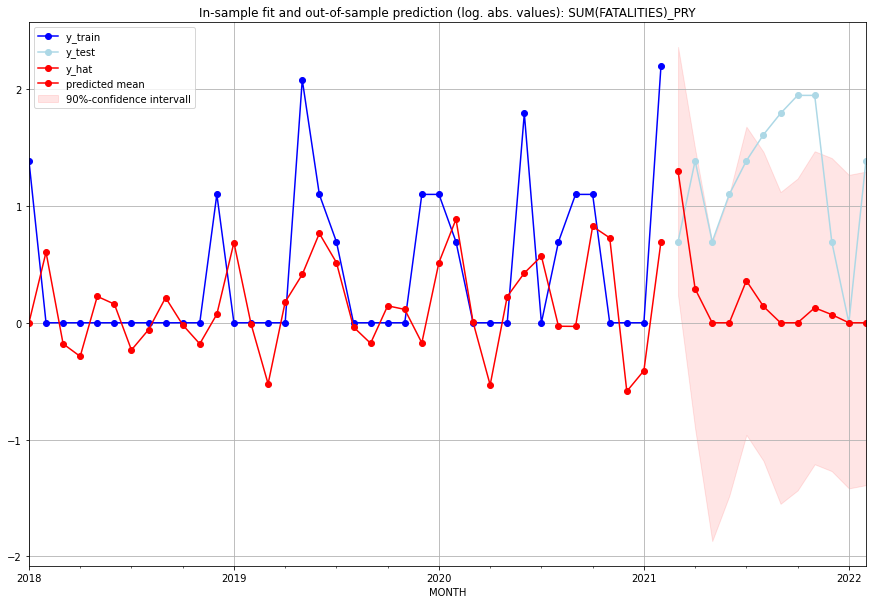

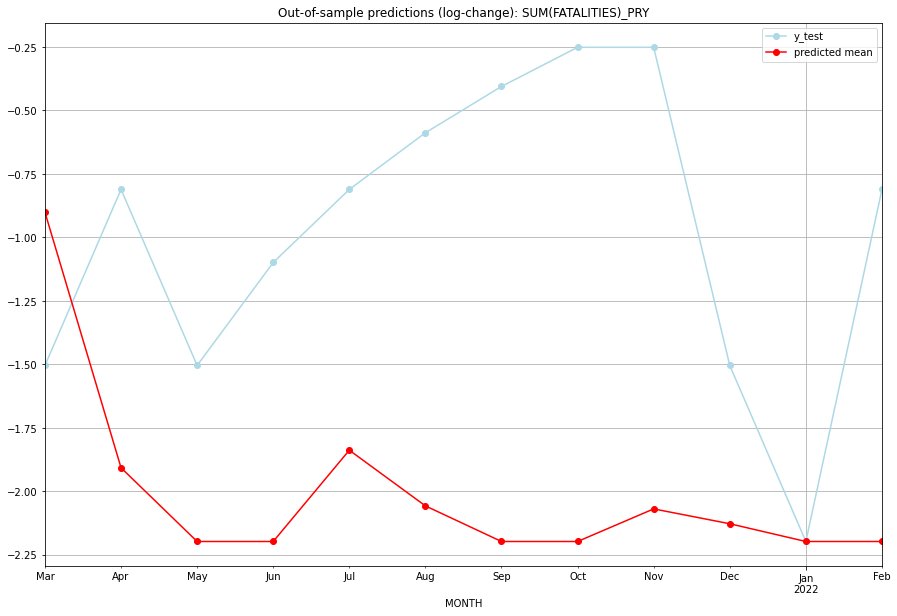

TADDA: 1.1293251108036877
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  2.656117         1.0     -0.900823       -1.504077   PRY   
1  2021-04-01  0.336756         3.0     -1.906979       -0.810930   PRY   
2  2021-05-01  0.000000         1.0     -2.197225       -1.504077   PRY   
3  2021-06-01  0.000000         2.0     -2.197225       -1.098612   PRY   
4  2021-07-01  0.432623         3.0     -1.837718       -0.810930   PRY   
5  2021-08-01  0.150493         4.0     -2.057034       -0.587787   PRY   
6  2021-09-01  0.000000         5.0     -2.197225       -0.405465   PRY   
7  2021-10-01  0.000000         6.0     -2.197225       -0.251314   PRY   
8  2021-11-01  0.136931         6.0     -2.068892       -0.251314   PRY   
9  2021-12-01  0.072385         1.0     -2.127340       -1.504077   PRY   
10 2022-01-01  0.000000         0.0     -2.197225       -2.197225   PRY   
11 2022-02-01  0.000000         3.0     -2.197225    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.6243109002257534, 'fold_results': [0.5558930782790926, 0.5890733062474913, 0.9063137262875257, 0.44596349008890424]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_PSE   No. Observations:                   62
Model:                SARIMAX(0, 1, 0)   Log Likelihood                 -87.538
Date:                 Wed, 19 Oct 2022   AIC                            177.077
Time:                         11:08:45   BIC                            179.188
Sample:                     01-31-2016   HQIC                           177.904
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------------

<Figure size 432x288 with 0 Axes>

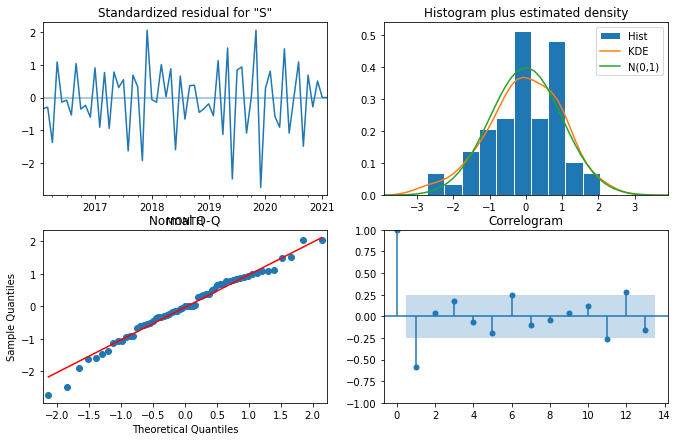

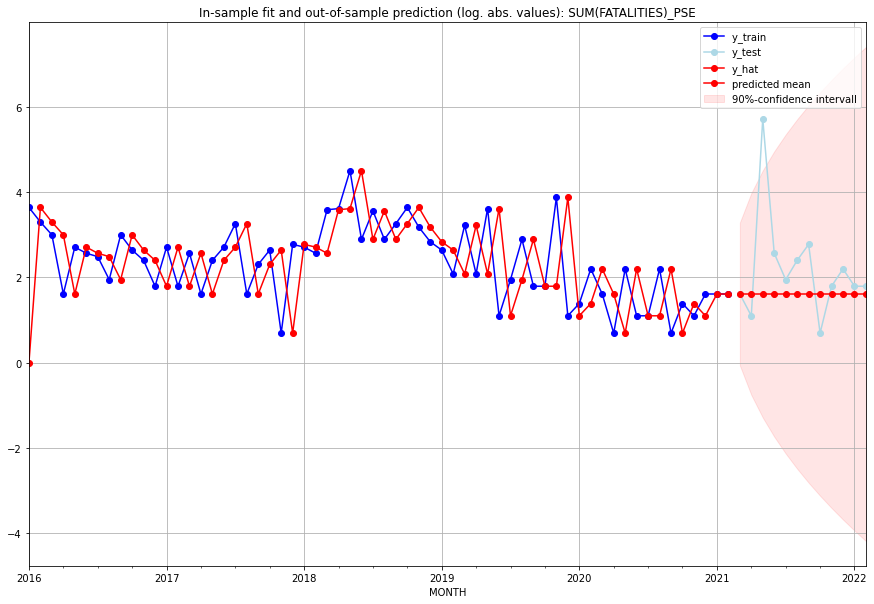

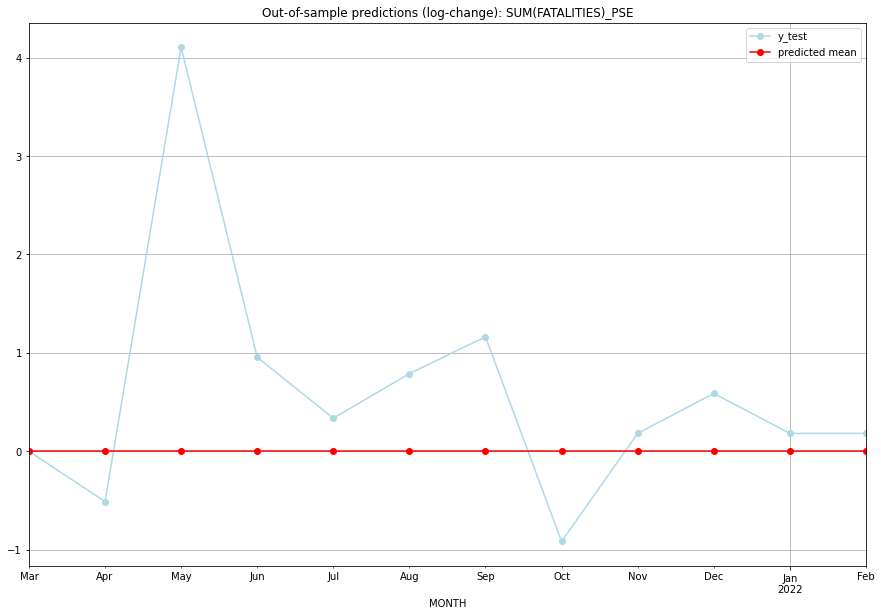

TADDA: 0.8258128696514998
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       4.0         4.0           0.0        0.000000   PSE   
1  2021-04-01       4.0         2.0           0.0       -0.510826   PSE   
2  2021-05-01       4.0       302.0           0.0        4.104295   PSE   
3  2021-06-01       4.0        12.0           0.0        0.955511   PSE   
4  2021-07-01       4.0         6.0           0.0        0.336472   PSE   
5  2021-08-01       4.0        10.0           0.0        0.788457   PSE   
6  2021-09-01       4.0        15.0           0.0        1.163151   PSE   
7  2021-10-01       4.0         1.0           0.0       -0.916291   PSE   
8  2021-11-01       4.0         5.0           0.0        0.182322   PSE   
9  2021-12-01       4.0         8.0           0.0        0.587787   PSE   
10 2022-01-01       4.0         5.0           0.0        0.182322   PSE   
11 2022-02-01       4.0         5.0           0.0    

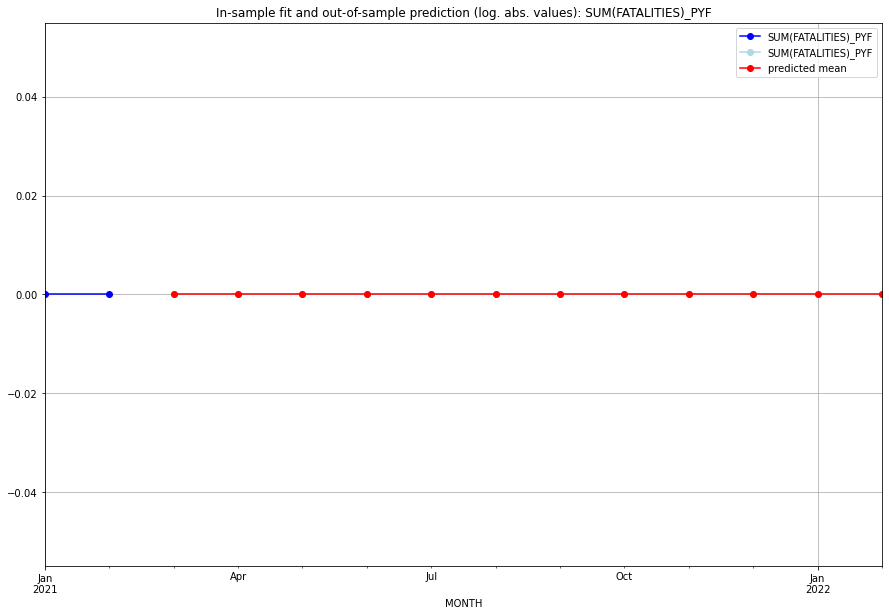

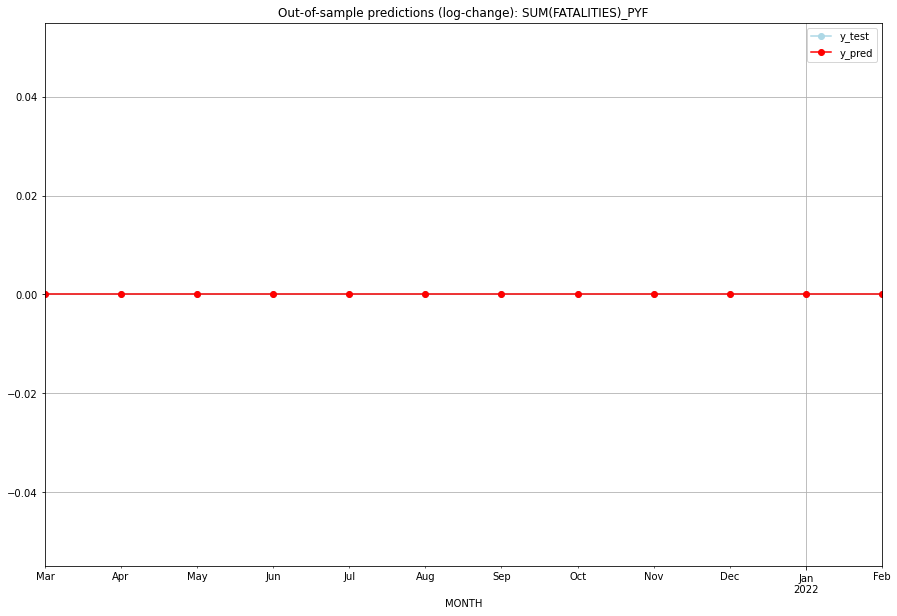

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   PYF   
1  2021-04-01       0.0         0.0           0.0             0.0   PYF   
2  2021-05-01       0.0         0.0           0.0             0.0   PYF   
3  2021-06-01       0.0         0.0           0.0             0.0   PYF   
4  2021-07-01       0.0         0.0           0.0             0.0   PYF   
5  2021-08-01       0.0         0.0           0.0             0.0   PYF   
6  2021-09-01       0.0         0.0           0.0             0.0   PYF   
7  2021-10-01       0.0         0.0           0.0             0.0   PYF   
8  2021-11-01       0.0         0.0           0.0             0.0   PYF   
9  2021-12-01       0.0         0.0           0.0             0.0   PYF   
10 2022-01-01       0.0         0.0           0.0             0.0   PYF   
11 2022-02-01       0.0         0.0           0.0             0.0   

<Figure size 432x288 with 0 Axes>

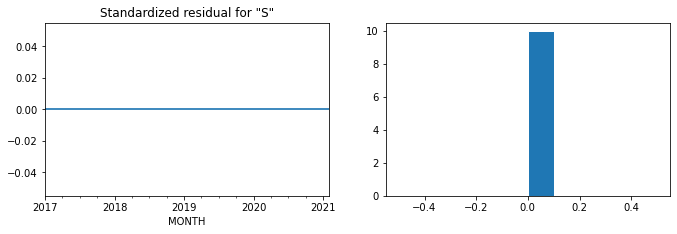

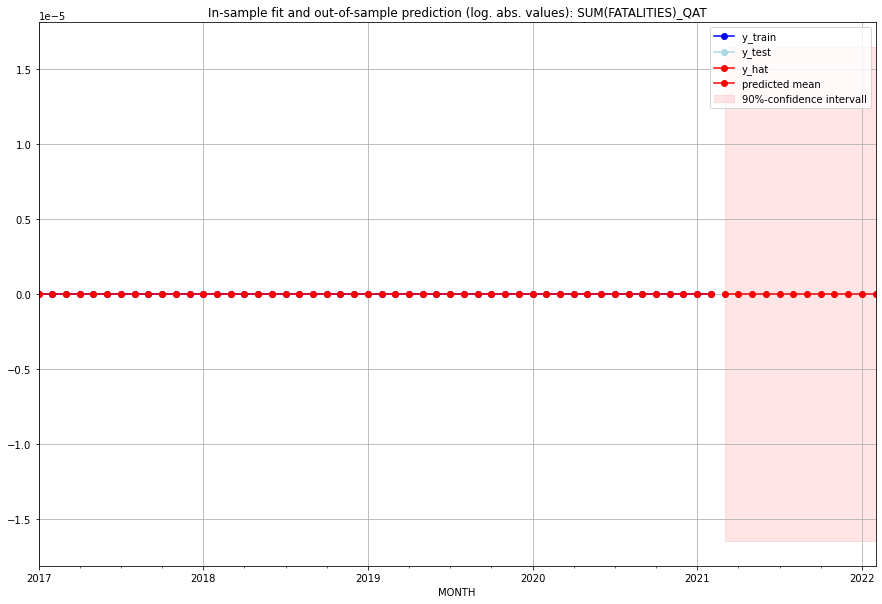

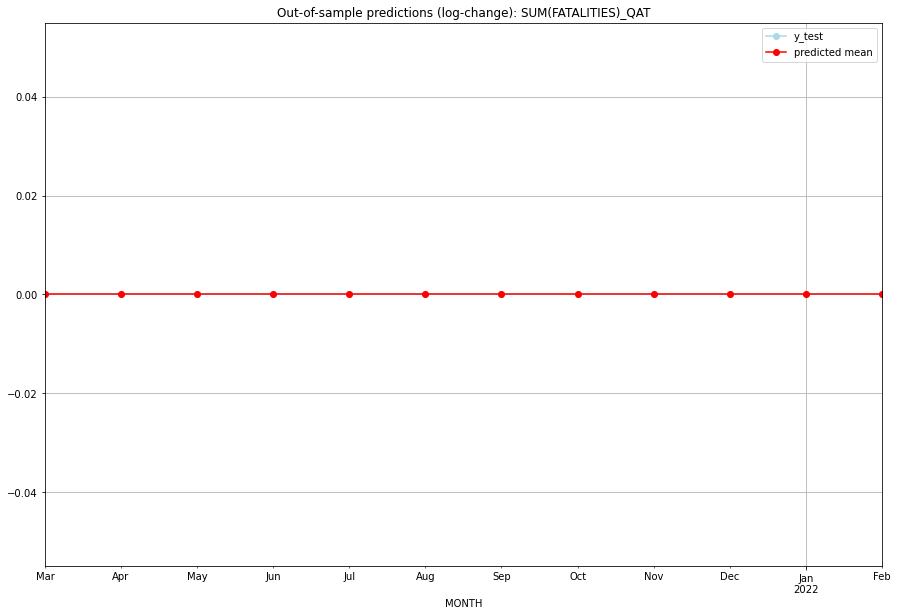

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   QAT   
1  2021-04-01       0.0         0.0           0.0             0.0   QAT   
2  2021-05-01       0.0         0.0           0.0             0.0   QAT   
3  2021-06-01       0.0         0.0           0.0             0.0   QAT   
4  2021-07-01       0.0         0.0           0.0             0.0   QAT   
5  2021-08-01       0.0         0.0           0.0             0.0   QAT   
6  2021-09-01       0.0         0.0           0.0             0.0   QAT   
7  2021-10-01       0.0         0.0           0.0             0.0   QAT   
8  2021-11-01       0.0         0.0           0.0             0.0   QAT   
9  2021-12-01       0.0         0.0           0.0             0.0   QAT   
10 2022-01-01       0.0         0.0           0.0             0.0   QAT   
11 2022-02-01       0.0         0.0           0.0             0.0   

<Figure size 432x288 with 0 Axes>

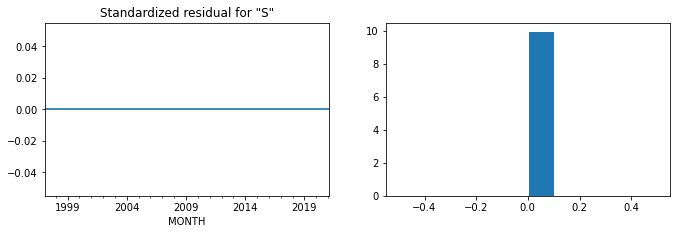

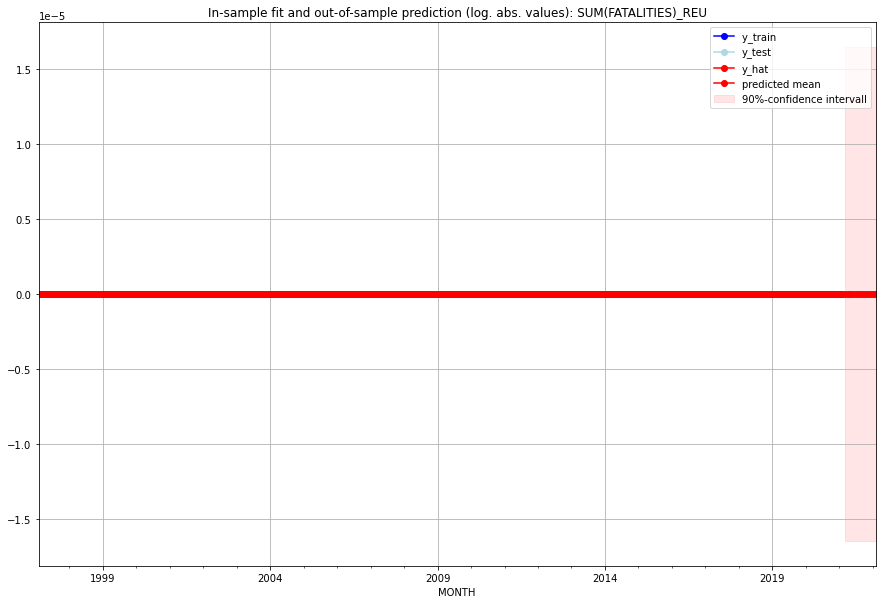

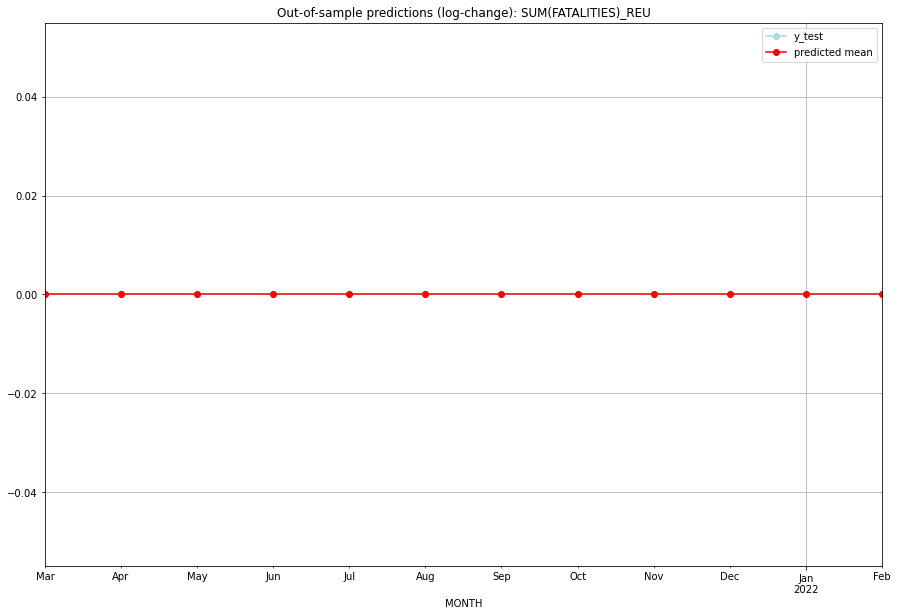

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   REU   
1  2021-04-01       0.0         0.0           0.0             0.0   REU   
2  2021-05-01       0.0         0.0           0.0             0.0   REU   
3  2021-06-01       0.0         0.0           0.0             0.0   REU   
4  2021-07-01       0.0         0.0           0.0             0.0   REU   
5  2021-08-01       0.0         0.0           0.0             0.0   REU   
6  2021-09-01       0.0         0.0           0.0             0.0   REU   
7  2021-10-01       0.0         0.0           0.0             0.0   REU   
8  2021-11-01       0.0         0.0           0.0             0.0   REU   
9  2021-12-01       0.0         0.0           0.0             0.0   REU   
10 2022-01-01       0.0         0.0           0.0             0.0   REU   
11 2022-02-01       0.0         0.0           0.0             0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.08664339756999316, 'fold_results': [0.057762265046662105, 0.11552453009332421]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_ROU   No. Observations:                   38
Model:                         SARIMAX   Log Likelihood                  -1.457
Date:                 Wed, 19 Oct 2022   AIC                              4.915
Time:                         11:09:04   BIC                              6.552
Sample:                     01-31-2018   HQIC                             5.497
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.0632    

<Figure size 432x288 with 0 Axes>

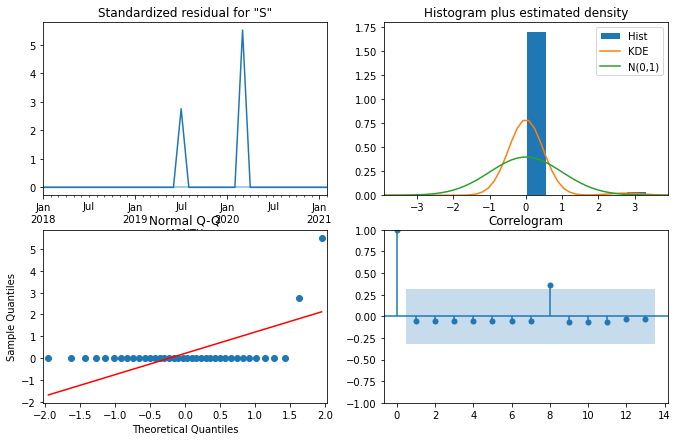

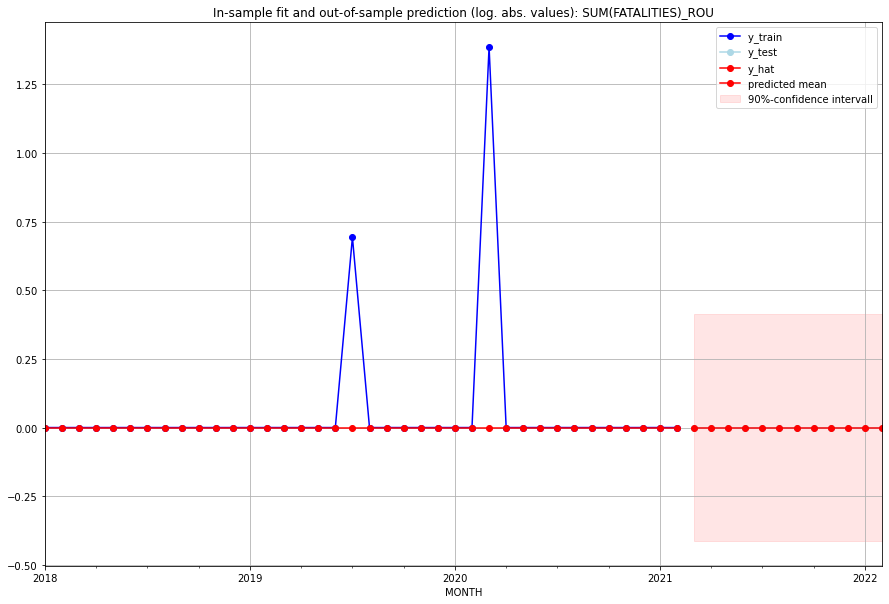

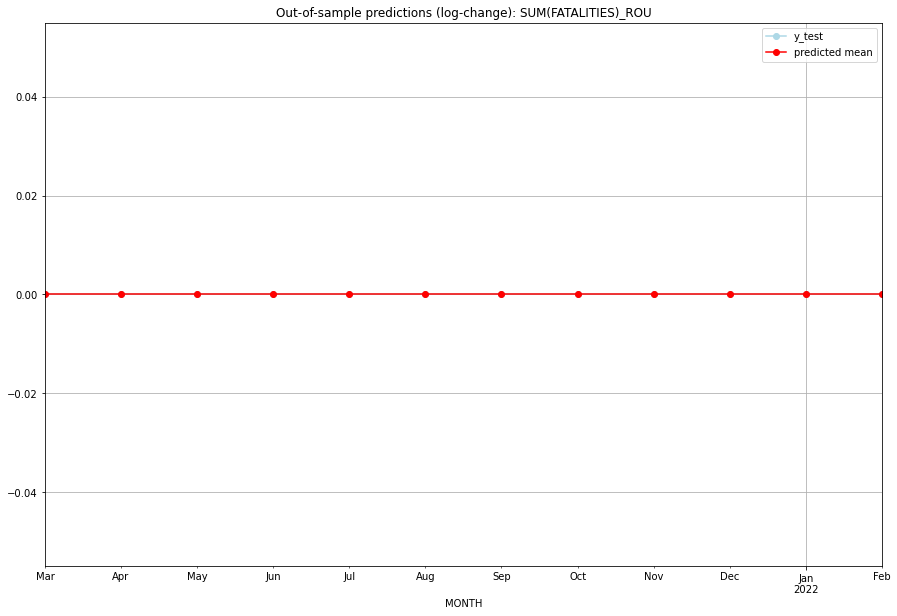

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   ROU   
1  2021-04-01       0.0         0.0           0.0             0.0   ROU   
2  2021-05-01       0.0         0.0           0.0             0.0   ROU   
3  2021-06-01       0.0         0.0           0.0             0.0   ROU   
4  2021-07-01       0.0         0.0           0.0             0.0   ROU   
5  2021-08-01       0.0         0.0           0.0             0.0   ROU   
6  2021-09-01       0.0         0.0           0.0             0.0   ROU   
7  2021-10-01       0.0         0.0           0.0             0.0   ROU   
8  2021-11-01       0.0         0.0           0.0             0.0   ROU   
9  2021-12-01       0.0         0.0           0.0             0.0   ROU   
10 2022-01-01       0.0         0.0           0.0             0.0   ROU   
11 2022-02-01       0.0         0.0           0.0             0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (2, 0, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.9163033133166567, 'fold_results': [0.640011613499959, 1.1925950131333545]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_RUS   No. Observations:                   38
Model:                SARIMAX(2, 0, 2)   Log Likelihood                 -47.700
Date:                 Wed, 19 Oct 2022   AIC                            105.399
Time:                         11:09:13   BIC                            113.587
Sample:                     01-31-2018   HQIC                           108.313
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.9559      0.4

<Figure size 432x288 with 0 Axes>

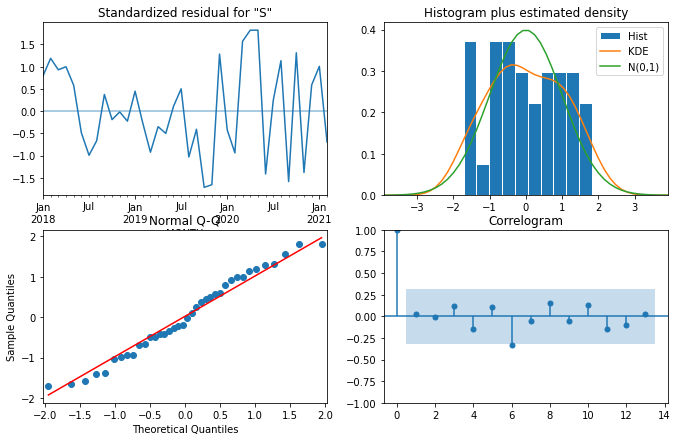

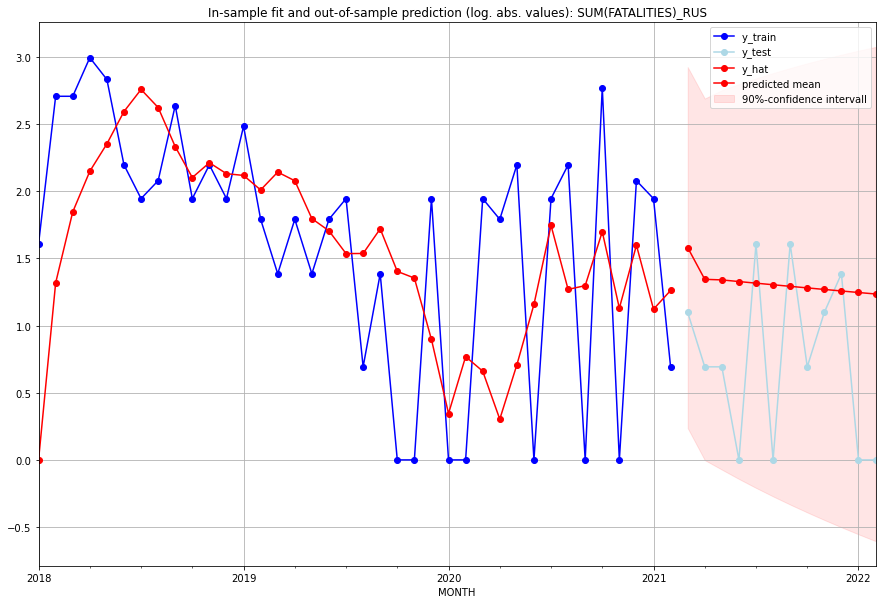

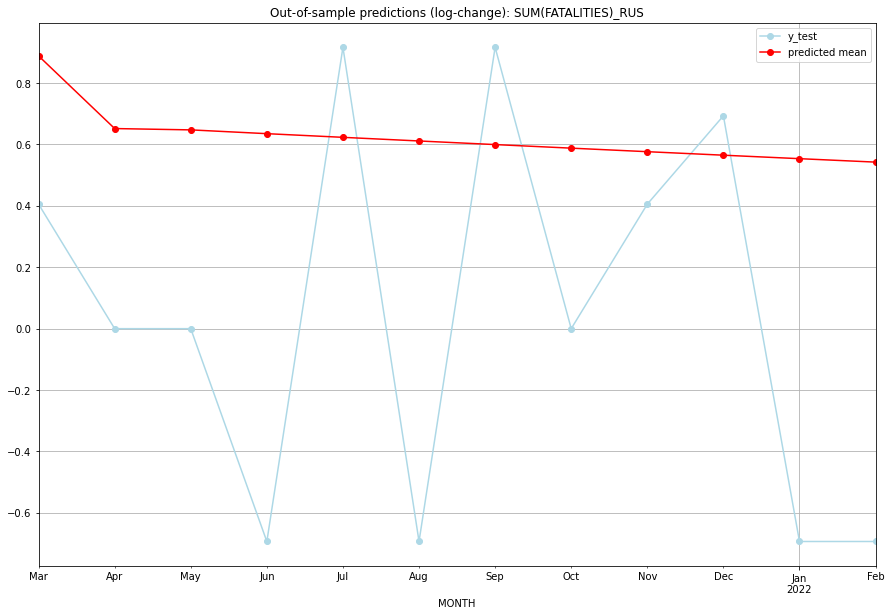

TADDA: 0.8946665527295804
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  3.861931         2.0      0.888289        0.405465   RUS   
1  2021-04-01  2.837537         1.0      0.651684        0.000000   RUS   
2  2021-05-01  2.821061         1.0      0.647381        0.000000   RUS   
3  2021-06-01  2.774206         0.0      0.635043       -0.693147   RUS   
4  2021-07-01  2.729396         4.0      0.623099        0.916291   RUS   
5  2021-08-01  2.685478         0.0      0.611253       -0.693147   RUS   
6  2021-09-01  2.642466         4.0      0.599514        0.916291   RUS   
7  2021-10-01  2.600336         1.0      0.587880        0.000000   RUS   
8  2021-11-01  2.559067         2.0      0.576351        0.405465   RUS   
9  2021-12-01  2.518636         3.0      0.564926        0.693147   RUS   
10 2022-01-01  2.479021         0.0      0.553604       -0.693147   RUS   
11 2022-02-01  2.440203         0.0      0.542383    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (3, 1, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.6808246944356673, 'fold_results': [0.2574420264248803, 0.6736107173988647, 0.8748932260854554, 0.8499173419887988, 0.7482601602803371]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_RWA   No. Observations:                  289
Model:                SARIMAX(3, 1, 3)   Log Likelihood                -430.229
Date:                 Wed, 19 Oct 2022   AIC                            880.458
Time:                         11:09:36   BIC                            917.088
Sample:                     02-28-1997   HQIC                           895.137
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------

<Figure size 432x288 with 0 Axes>

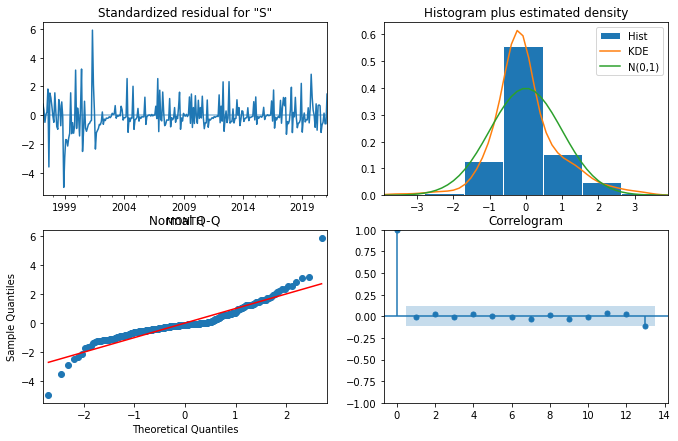

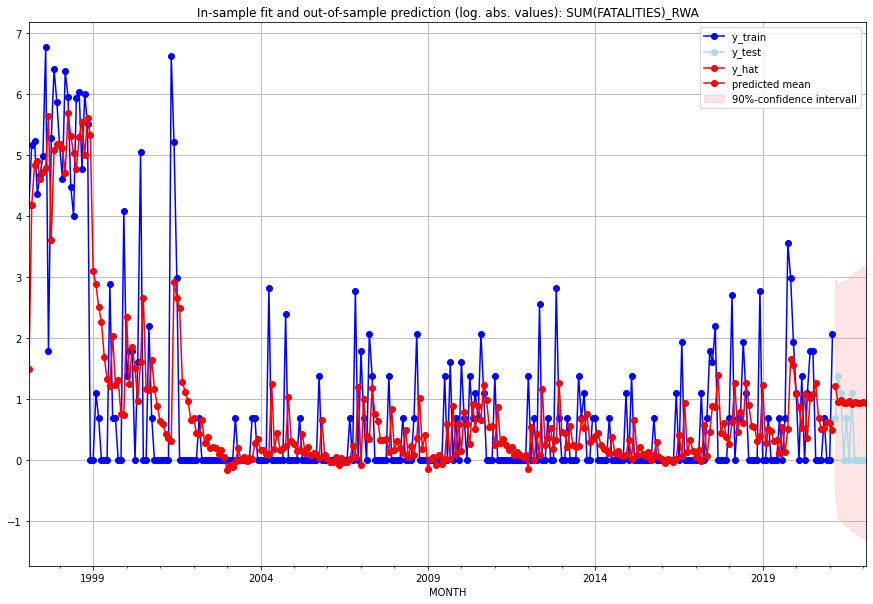

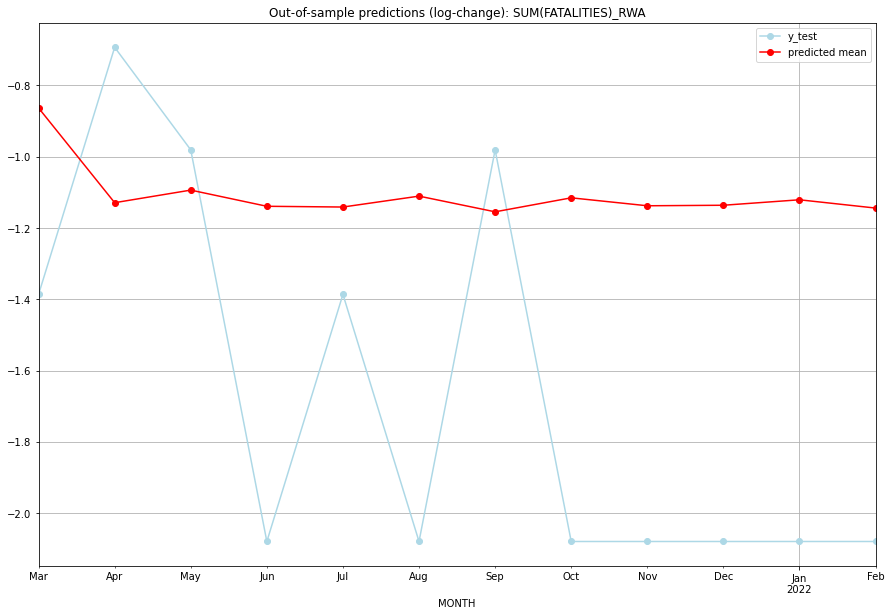

TADDA: 0.6785673204868741
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  2.374027         1.0     -0.863335       -1.386294   RWA   
1  2021-04-01  1.586720         3.0     -1.129051       -0.693147   RWA   
2  2021-05-01  1.679700         2.0     -1.093737       -0.980829   RWA   
3  2021-06-01  1.560863         0.0     -1.139097       -2.079442   RWA   
4  2021-07-01  1.555457         1.0     -1.141210       -1.386294   RWA   
5  2021-08-01  1.634860         0.0     -1.110611       -2.079442   RWA   
6  2021-09-01  1.521357         2.0     -1.154644       -0.980829   RWA   
7  2021-10-01  1.622365         0.0     -1.115365       -2.079442   RWA   
8  2021-11-01  1.564540         0.0     -1.137662       -2.079442   RWA   
9  2021-12-01  1.568262         0.0     -1.136212       -2.079442   RWA   
10 2022-01-01  1.607934         0.0     -1.120883       -2.079442   RWA   
11 2022-02-01  1.548029         0.0     -1.144122    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.99990045431305, 'fold_results': [1.3276487218655857, 0.4219158487065459, 0.3148660762098469, 0.8773506465825552, 2.057720978200716]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_SAU   No. Observations:                   74
Model:                SARIMAX(0, 1, 0)   Log Likelihood                -132.235
Date:                 Wed, 19 Oct 2022   AIC                            266.470
Time:                         11:09:51   BIC                            268.761
Sample:                     01-31-2015   HQIC                           267.383
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------

<Figure size 432x288 with 0 Axes>

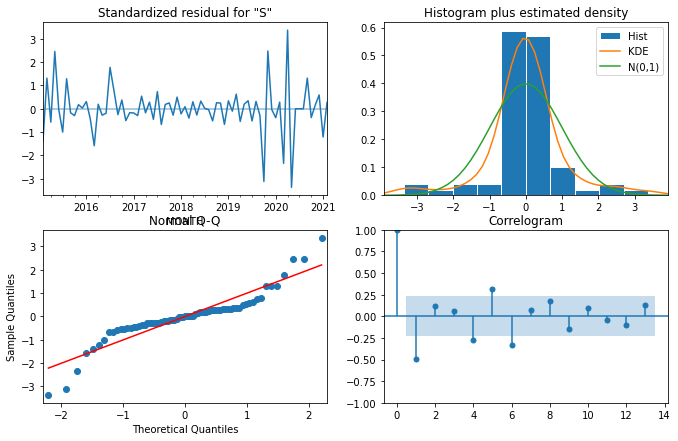

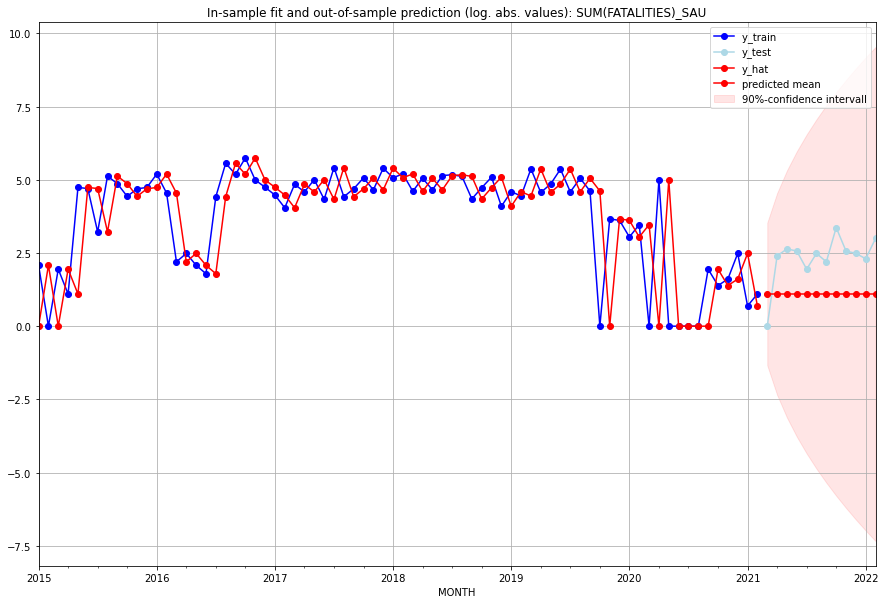

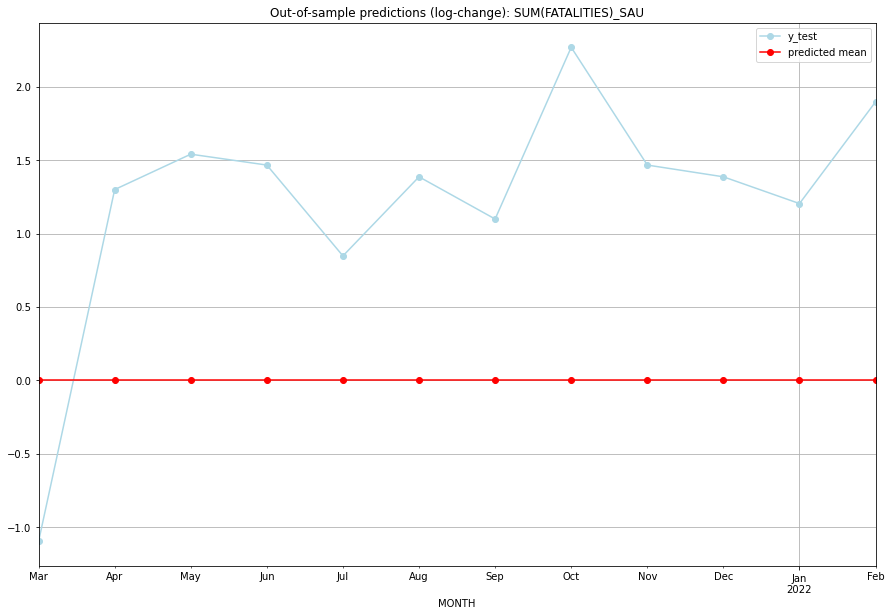

TADDA: 1.4132741377631375
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       2.0         0.0           0.0       -1.098612   SAU   
1  2021-04-01       2.0        10.0           0.0        1.299283   SAU   
2  2021-05-01       2.0        13.0           0.0        1.540445   SAU   
3  2021-06-01       2.0        12.0           0.0        1.466337   SAU   
4  2021-07-01       2.0         6.0           0.0        0.847298   SAU   
5  2021-08-01       2.0        11.0           0.0        1.386294   SAU   
6  2021-09-01       2.0         8.0           0.0        1.098612   SAU   
7  2021-10-01       2.0        28.0           0.0        2.268684   SAU   
8  2021-11-01       2.0        12.0           0.0        1.466337   SAU   
9  2021-12-01       2.0        11.0           0.0        1.386294   SAU   
10 2022-01-01       2.0         9.0           0.0        1.203973   SAU   
11 2022-02-01       2.0        19.0           0.0    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [1, (1, 0, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.7272960628008258, 'fold_results': [0.9336646706910422, 0.6307800579511101, 0.720078657864295, 0.5548803595403369, 0.7970765679573448]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_SDN   No. Observations:                  289
Model:                SARIMAX(1, 0, 2)   Log Likelihood                -498.401
Date:                 Wed, 19 Oct 2022   AIC                           1006.801
Time:                         11:10:07   BIC                           1025.134
Sample:                     02-28-1997   HQIC                          1014.147
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------

<Figure size 432x288 with 0 Axes>

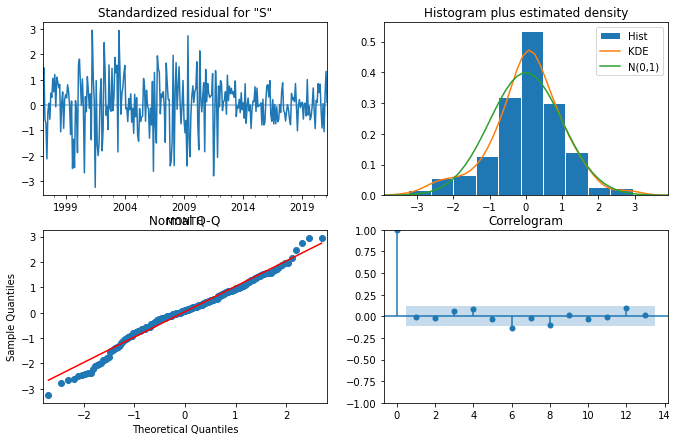

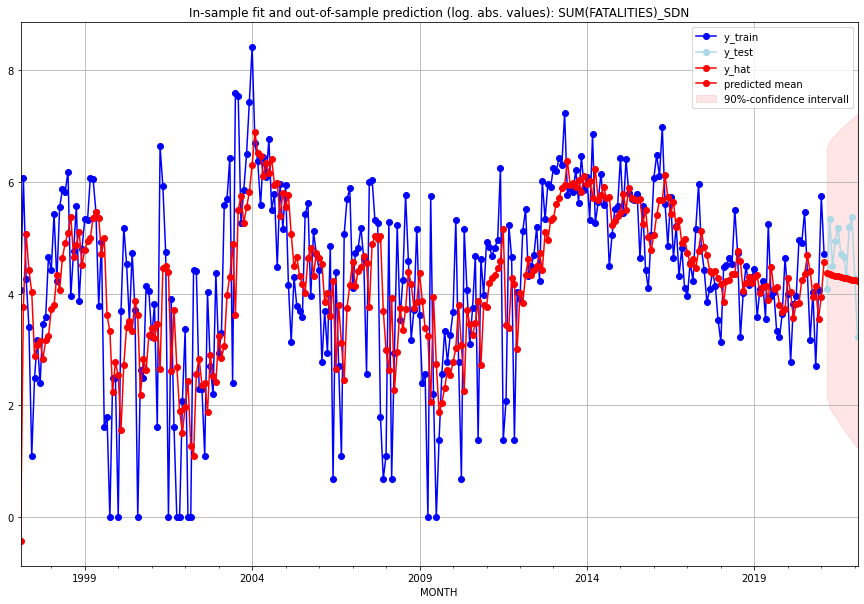

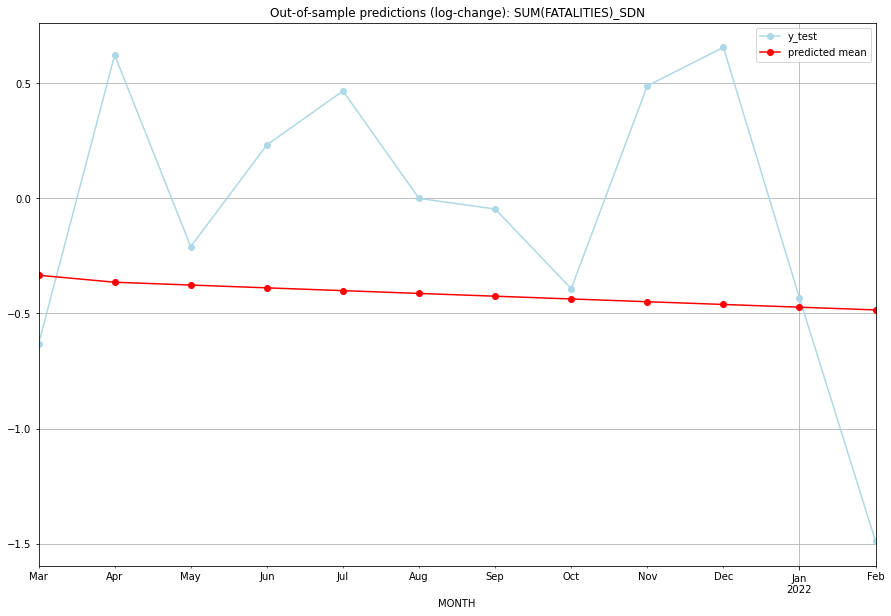

TADDA: 0.7451058408834186
Evaluation finished.
        MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  78.498404        58.0     -0.333793       -0.631993   SDN   
1  2021-04-01  76.117106       206.0     -0.364205        0.623189   SDN   
2  2021-05-01  75.179855        89.0     -0.376433       -0.209721   SDN   
3  2021-06-01  74.257313       139.0     -0.388617        0.232112   SDN   
4  2021-07-01  73.349208       176.0     -0.400757        0.466620   SDN   
5  2021-08-01  72.455276       110.0     -0.412853        0.000000   SDN   
6  2021-09-01  71.575256       105.0     -0.424906       -0.046091   SDN   
7  2021-10-01  70.708894        74.0     -0.436915       -0.392042   SDN   
8  2021-11-01  69.855942       180.0     -0.448881        0.488967   SDN   
9  2021-12-01  69.016156       213.0     -0.460804        0.656446   SDN   
10 2022-01-01  68.189296        71.0     -0.472684       -0.432864   SDN   
11 2022-02-01  67.375129        24.0     

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [2, (0, 0, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.3115285496796705, 'fold_results': [0.541019986251706, 0.28881132523331055, 0.39539609969964634, 0.18310204811135164, 0.1493132891023379]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_SEN   No. Observations:                  289
Model:                SARIMAX(0, 0, 2)   Log Likelihood                -429.700
Date:                 Wed, 19 Oct 2022   AIC                            869.400
Time:                         11:10:24   BIC                            887.733
Sample:                     02-28-1997   HQIC                           876.746
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------

<Figure size 432x288 with 0 Axes>

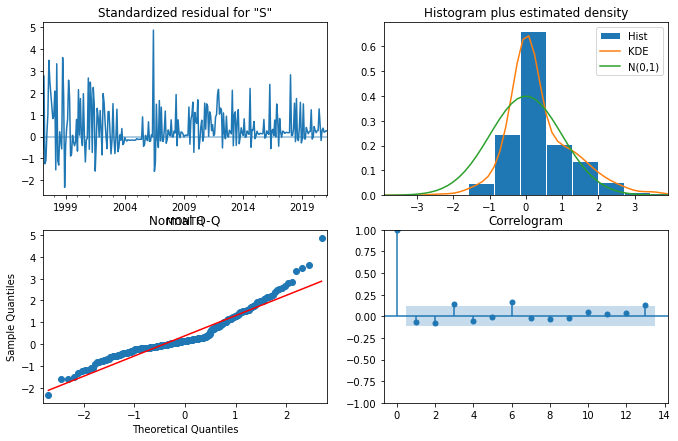

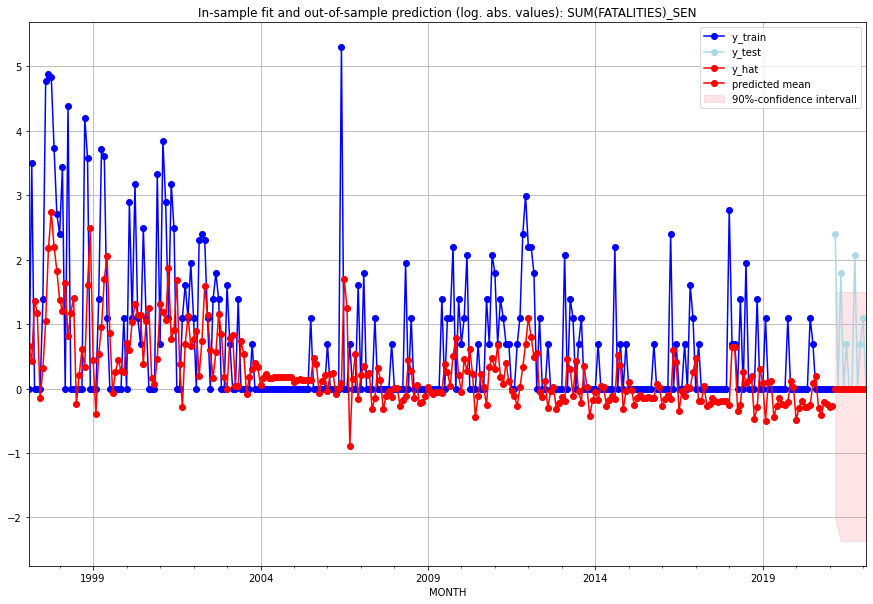

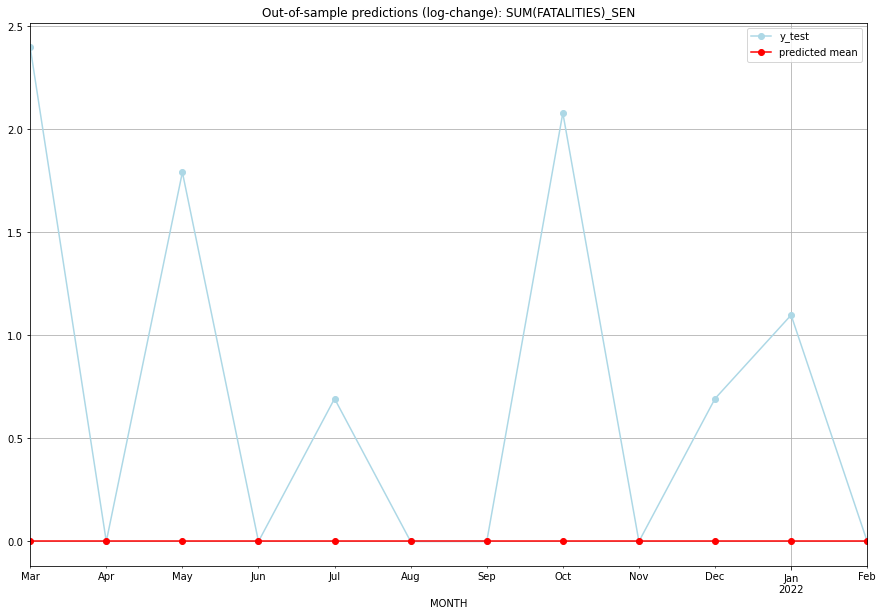

TADDA: 0.7295002444578551
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0        10.0           0.0        2.397895   SEN   
1  2021-04-01       0.0         0.0           0.0        0.000000   SEN   
2  2021-05-01       0.0         5.0           0.0        1.791759   SEN   
3  2021-06-01       0.0         0.0           0.0        0.000000   SEN   
4  2021-07-01       0.0         1.0           0.0        0.693147   SEN   
5  2021-08-01       0.0         0.0           0.0        0.000000   SEN   
6  2021-09-01       0.0         0.0           0.0        0.000000   SEN   
7  2021-10-01       0.0         7.0           0.0        2.079442   SEN   
8  2021-11-01       0.0         0.0           0.0        0.000000   SEN   
9  2021-12-01       0.0         1.0           0.0        0.693147   SEN   
10 2022-01-01       0.0         2.0           0.0        1.098612   SEN   
11 2022-02-01       0.0         0.0           0.0    

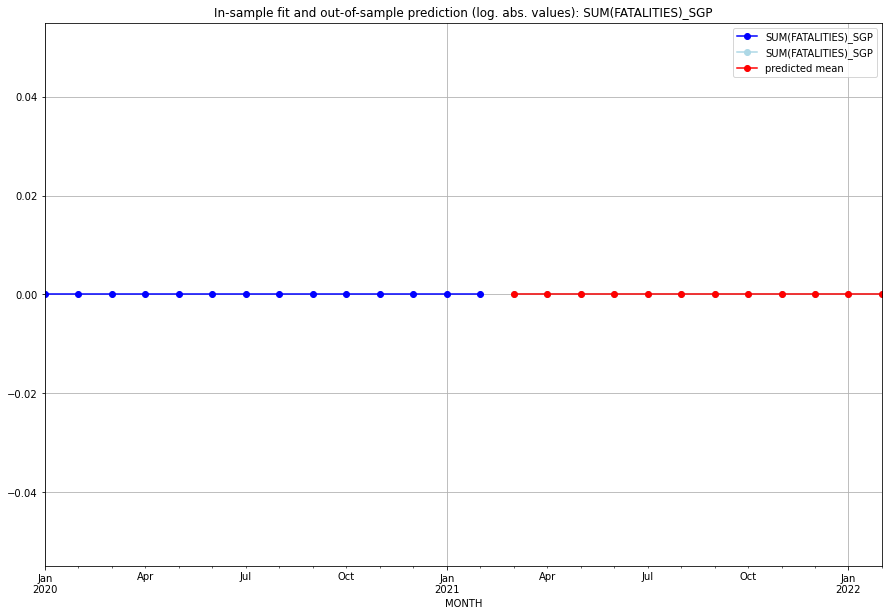

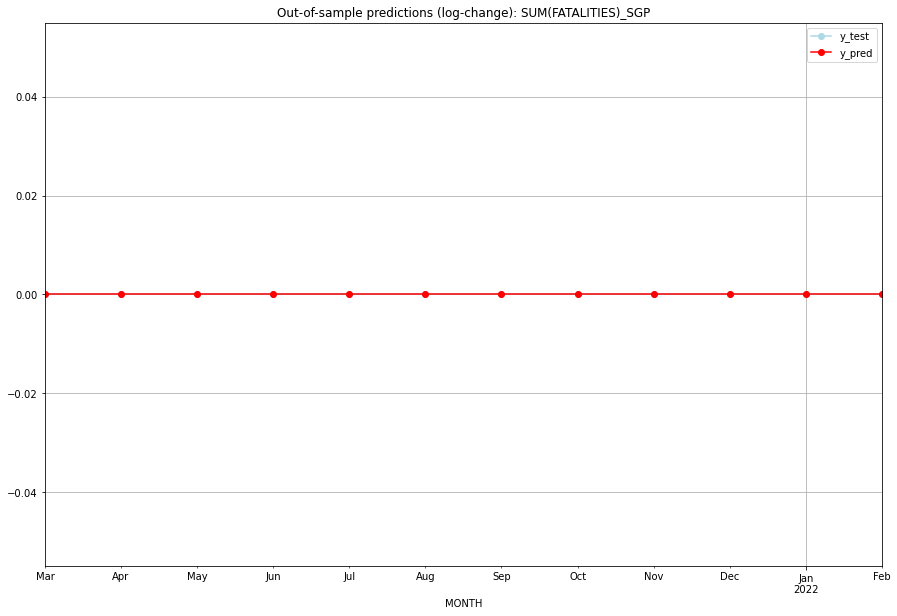

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   SGP   
1  2021-04-01       0.0         0.0           0.0             0.0   SGP   
2  2021-05-01       0.0         0.0           0.0             0.0   SGP   
3  2021-06-01       0.0         0.0           0.0             0.0   SGP   
4  2021-07-01       0.0         0.0           0.0             0.0   SGP   
5  2021-08-01       0.0         0.0           0.0             0.0   SGP   
6  2021-09-01       0.0         0.0           0.0             0.0   SGP   
7  2021-10-01       0.0         0.0           0.0             0.0   SGP   
8  2021-11-01       0.0         0.0           0.0             0.0   SGP   
9  2021-12-01       0.0         0.0           0.0             0.0   SGP   
10 2022-01-01       0.0         0.0           0.0             0.0   SGP   
11 2022-02-01       0.0         0.0           0.0             0.0   

<Figure size 432x288 with 0 Axes>

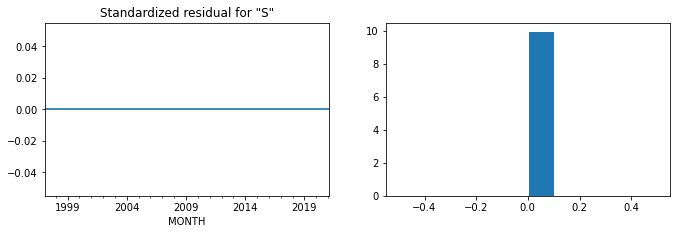

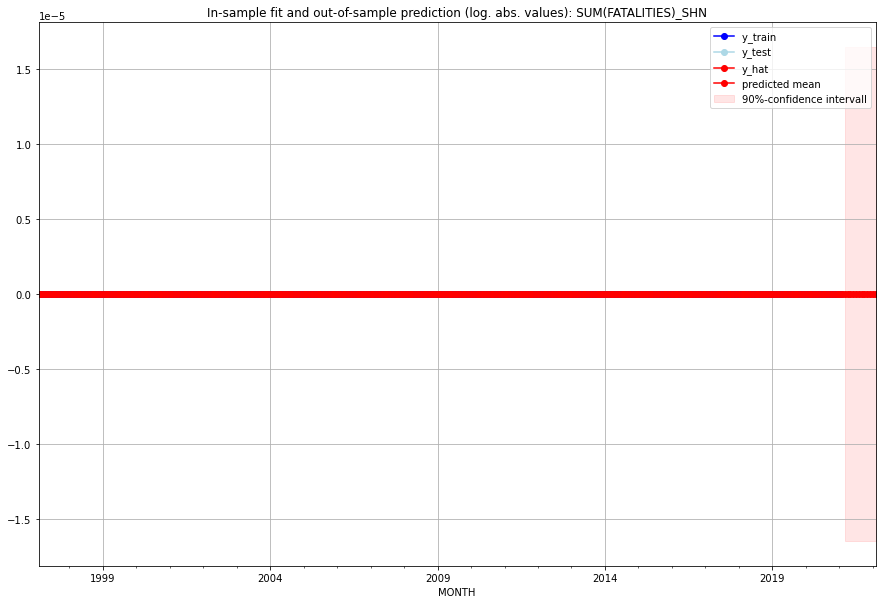

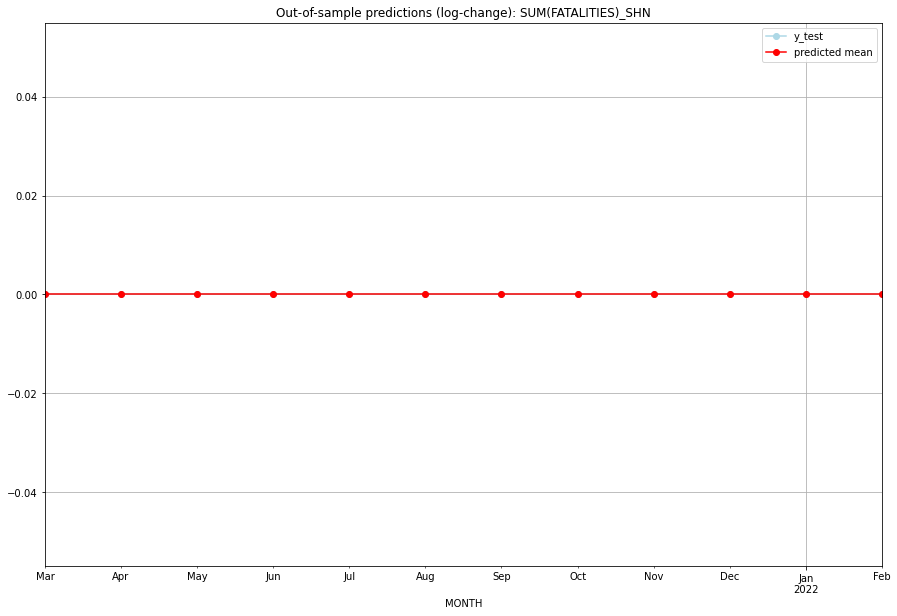

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   SHN   
1  2021-04-01       0.0         0.0           0.0             0.0   SHN   
2  2021-05-01       0.0         0.0           0.0             0.0   SHN   
3  2021-06-01       0.0         0.0           0.0             0.0   SHN   
4  2021-07-01       0.0         0.0           0.0             0.0   SHN   
5  2021-08-01       0.0         0.0           0.0             0.0   SHN   
6  2021-09-01       0.0         0.0           0.0             0.0   SHN   
7  2021-10-01       0.0         0.0           0.0             0.0   SHN   
8  2021-11-01       0.0         0.0           0.0             0.0   SHN   
9  2021-12-01       0.0         0.0           0.0             0.0   SHN   
10 2022-01-01       0.0         0.0           0.0             0.0   SHN   
11 2022-02-01       0.0         0.0           0.0             0.0   

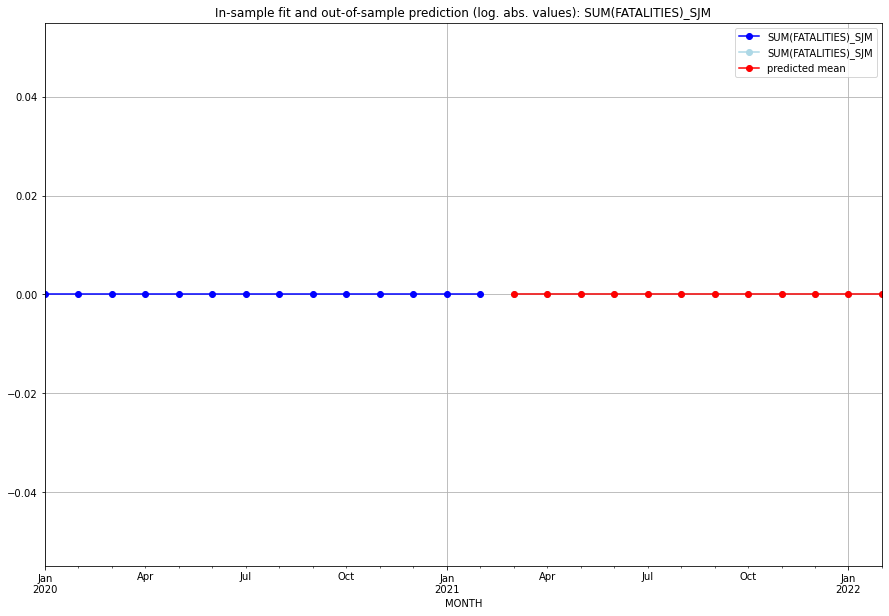

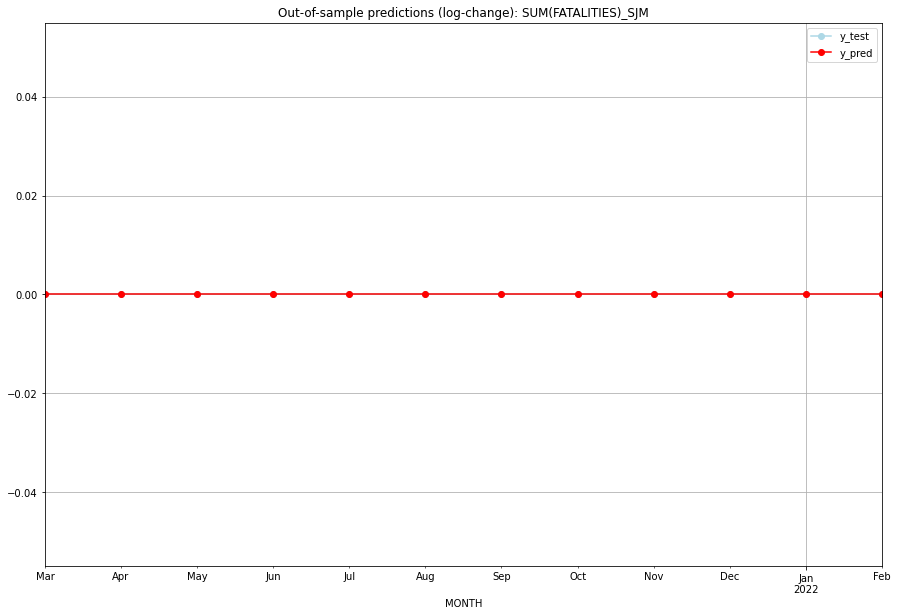

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   SJM   
1  2021-04-01       0.0         0.0           0.0             0.0   SJM   
2  2021-05-01       0.0         0.0           0.0             0.0   SJM   
3  2021-06-01       0.0         0.0           0.0             0.0   SJM   
4  2021-07-01       0.0         0.0           0.0             0.0   SJM   
5  2021-08-01       0.0         0.0           0.0             0.0   SJM   
6  2021-09-01       0.0         0.0           0.0             0.0   SJM   
7  2021-10-01       0.0         0.0           0.0             0.0   SJM   
8  2021-11-01       0.0         0.0           0.0             0.0   SJM   
9  2021-12-01       0.0         0.0           0.0             0.0   SJM   
10 2022-01-01       0.0         0.0           0.0             0.0   SJM   
11 2022-02-01       0.0         0.0           0.0             0.0   

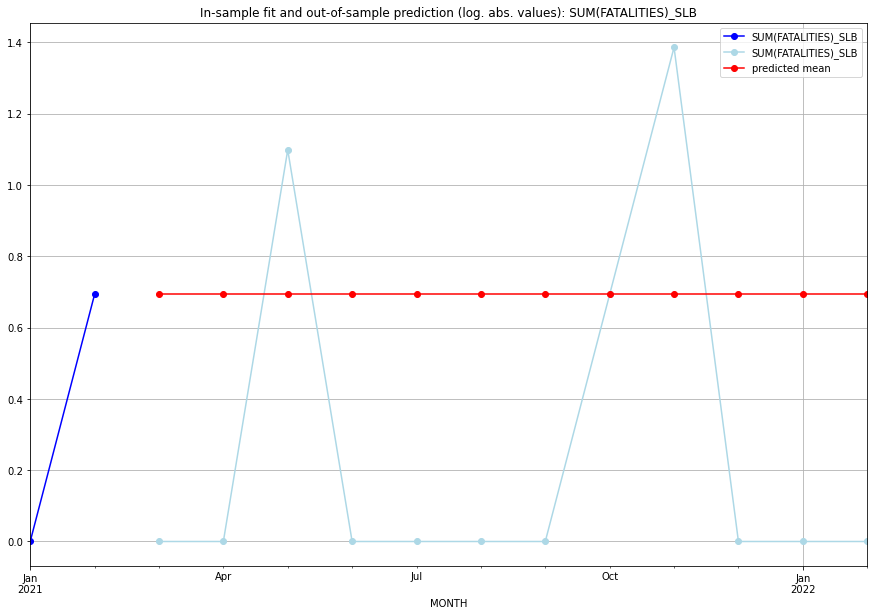

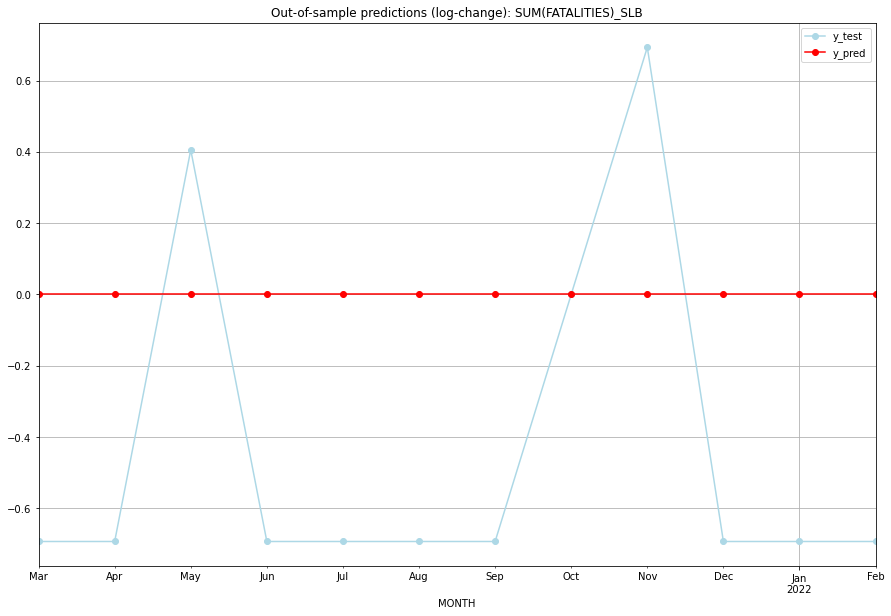

TADDA: 0.6114114094756348
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  0.693147    0.000000           0.0       -0.693147   SLB   
1  2021-04-01  0.693147    0.000000           0.0       -0.693147   SLB   
2  2021-05-01  0.693147    1.098612           0.0        0.405465   SLB   
3  2021-06-01  0.693147    0.000000           0.0       -0.693147   SLB   
4  2021-07-01  0.693147    0.000000           0.0       -0.693147   SLB   
5  2021-08-01  0.693147    0.000000           0.0       -0.693147   SLB   
6  2021-09-01  0.693147    0.000000           0.0       -0.693147   SLB   
7  2021-10-01  0.693147    0.693147           0.0        0.000000   SLB   
8  2021-11-01  0.693147    1.386294           0.0        0.693147   SLB   
9  2021-12-01  0.693147    0.000000           0.0       -0.693147   SLB   
10 2022-01-01  0.693147    0.000000           0.0       -0.693147   SLB   
11 2022-02-01  0.693147    0.000000           0.0    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (2, 0, 1), (0, 0, 0, 0), 'n'], 'cv_score': 0.5183132048188941, 'fold_results': [0.28343311513884334, 0.24127306107360666, 0.5199520493614457, 0.43145683944885116, 1.1154509590717236]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_SLE   No. Observations:                  289
Model:                SARIMAX(2, 0, 1)   Log Likelihood                -220.979
Date:                 Wed, 19 Oct 2022   AIC                            449.958
Time:                         11:10:55   BIC                            464.624
Sample:                     02-28-1997   HQIC                           455.835
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------

<Figure size 432x288 with 0 Axes>

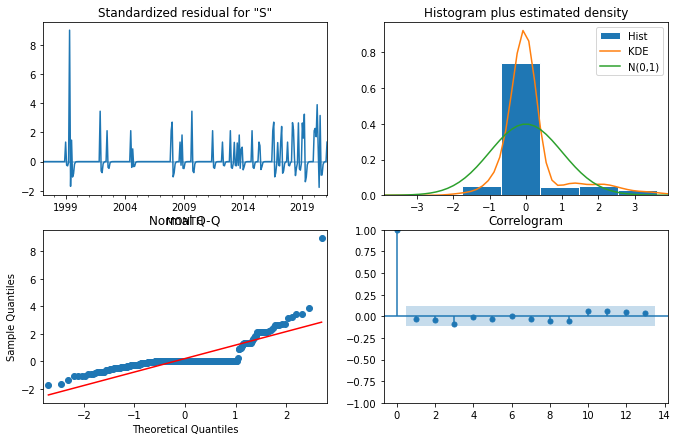

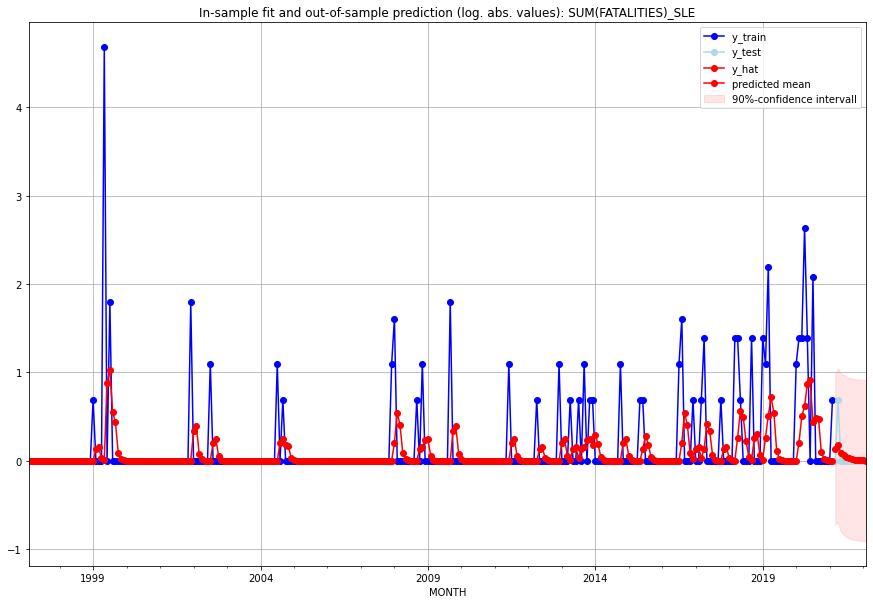

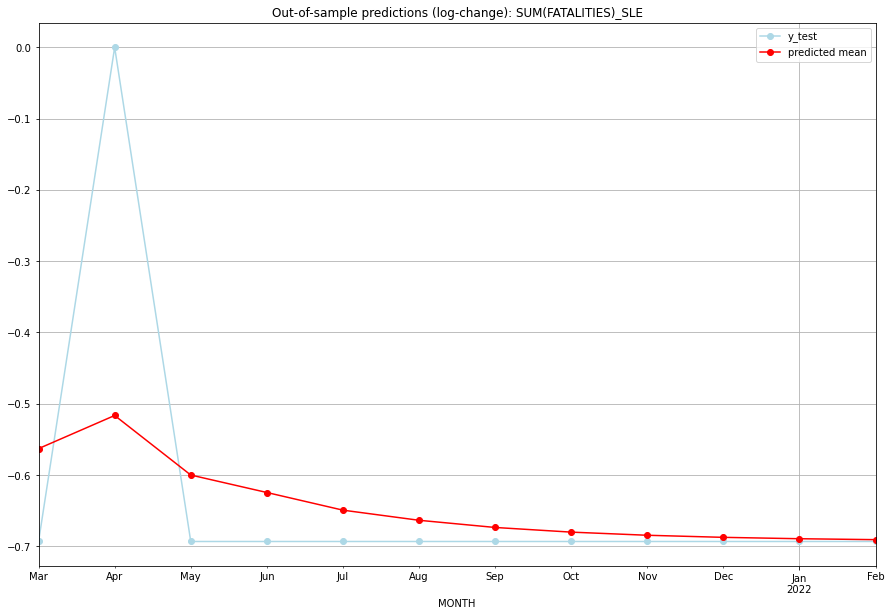

TADDA: 0.07801181161452965
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  0.139145         0.0     -0.562869       -0.693147   SLE   
1  2021-04-01  0.193318         1.0     -0.516410        0.000000   SLE   
2  2021-05-01  0.097707         0.0     -0.599924       -0.693147   SLE   
3  2021-06-01  0.071129         0.0     -0.624434       -0.693147   SLE   
4  2021-07-01  0.044926         0.0     -0.649202       -0.693147   SLE   
5  2021-08-01  0.030197         0.0     -0.663397       -0.693147   SLE   
6  2021-09-01  0.019870         0.0     -0.673472       -0.693147   SLE   
7  2021-10-01  0.013223         0.0     -0.680011       -0.693147   SLE   
8  2021-11-01  0.008775         0.0     -0.684411       -0.693147   SLE   
9  2021-12-01  0.005837         0.0     -0.687328       -0.693147   SLE   
10 2022-01-01  0.003882         0.0     -0.689273       -0.693147   SLE   
11 2022-02-01  0.002583         0.0     -0.690568   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (3, 0, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.47496576469741364, 'fold_results': [0.45172252902621607, 0.4982090003686112]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_SLV   No. Observations:                   38
Model:                SARIMAX(3, 0, 3)   Log Likelihood                  -9.780
Date:                 Wed, 19 Oct 2022   AIC                             39.559
Time:                         11:11:02   BIC                             55.935
Sample:                     01-31-2018   HQIC                            45.386
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -0.0751      

<Figure size 432x288 with 0 Axes>

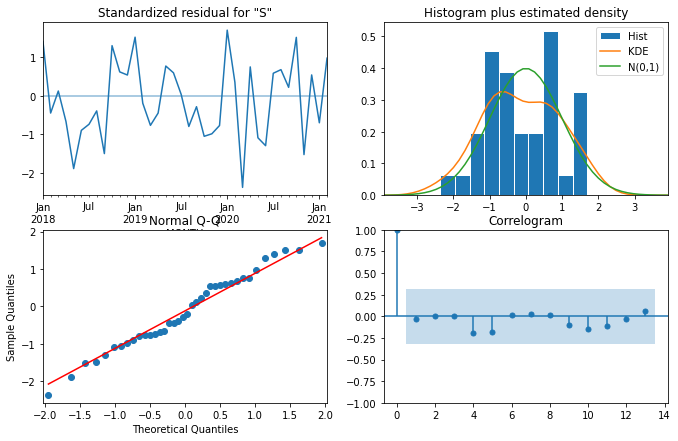

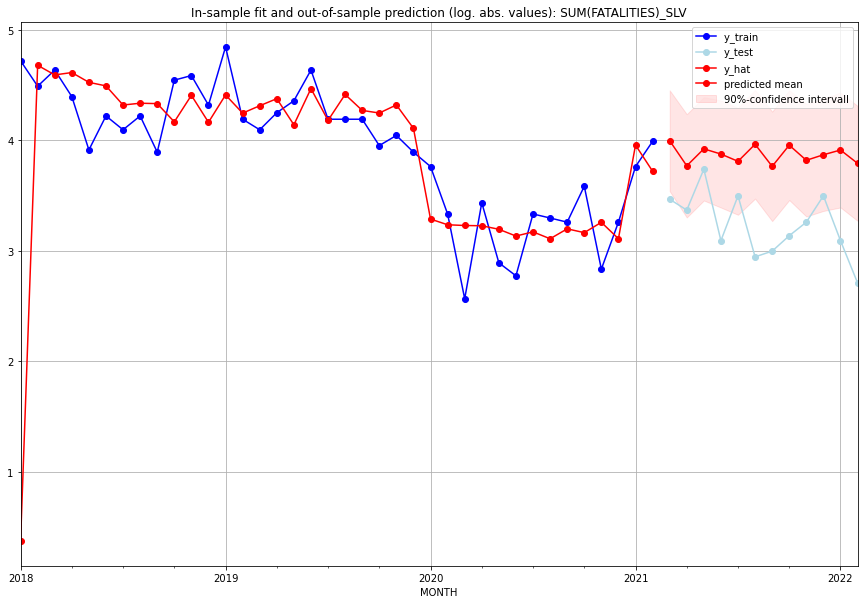

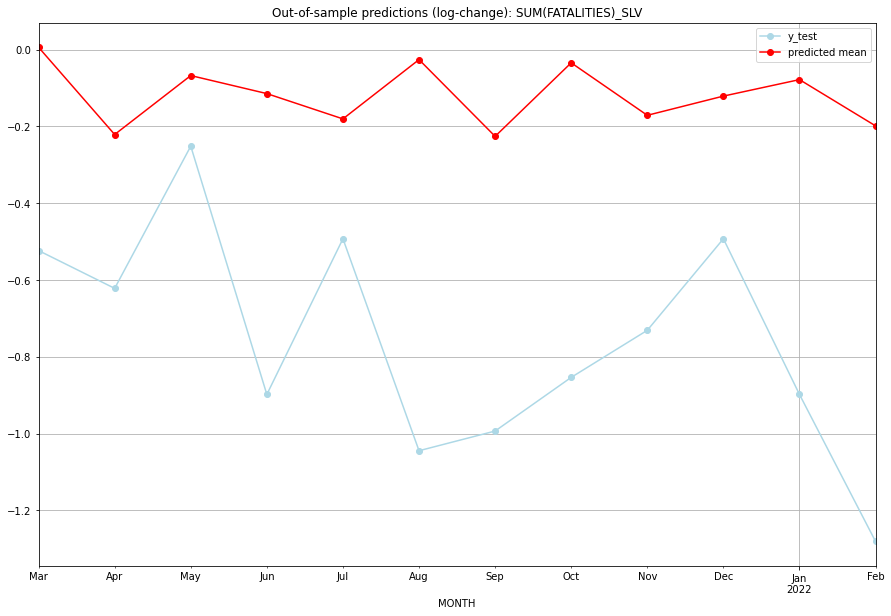

TADDA: 0.6379406327847161
Evaluation finished.
        MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  53.333629        31.0      0.006159       -0.523248   SLV   
1  2021-04-01  42.294319        28.0     -0.220963       -0.621688   SLV   
2  2021-05-01  49.478888        41.0     -0.067429       -0.251314   SLV   
3  2021-06-01  47.162976        21.0     -0.114393       -0.897942   SLV   
4  2021-07-01  44.092146        32.0     -0.180276       -0.492476   SLV   
5  2021-08-01  51.619918        18.0     -0.025889       -1.044545   SLV   
6  2021-09-01  42.088015        19.0     -0.225739       -0.993252   SLV   
7  2021-10-01  51.183395        22.0     -0.034220       -0.853490   SLV   
8  2021-11-01  44.514539        25.0     -0.170952       -0.730888   SLV   
9  2021-12-01  46.850304        32.0     -0.120907       -0.492476   SLV   
10 2022-01-01  48.948489        21.0     -0.077992       -0.897942   SLV   
11 2022-02-01  43.279319        14.0     

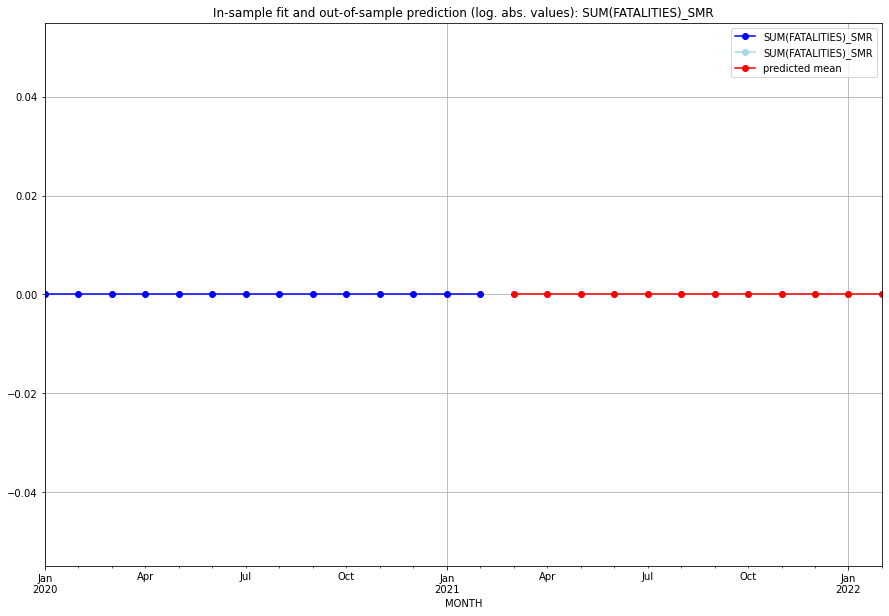

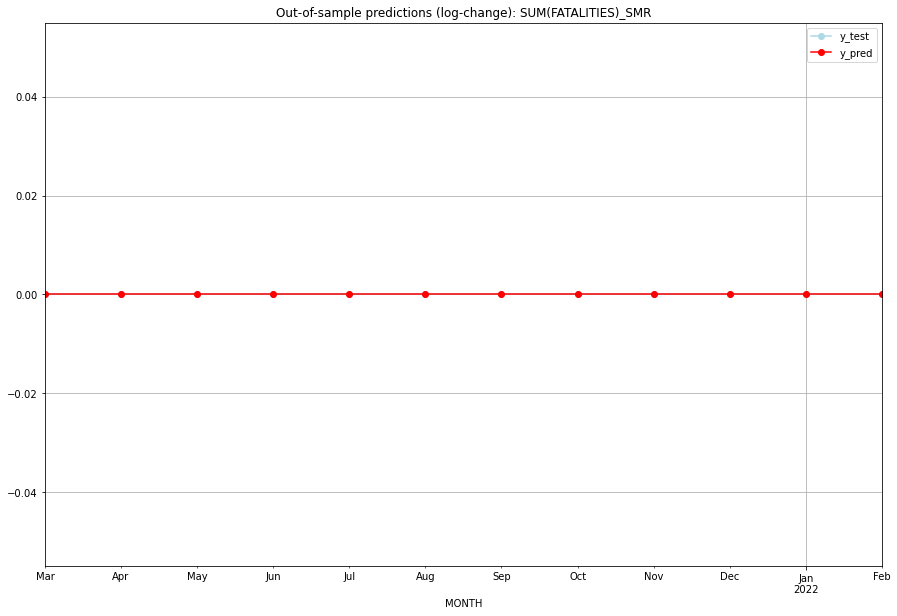

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   SMR   
1  2021-04-01       0.0         0.0           0.0             0.0   SMR   
2  2021-05-01       0.0         0.0           0.0             0.0   SMR   
3  2021-06-01       0.0         0.0           0.0             0.0   SMR   
4  2021-07-01       0.0         0.0           0.0             0.0   SMR   
5  2021-08-01       0.0         0.0           0.0             0.0   SMR   
6  2021-09-01       0.0         0.0           0.0             0.0   SMR   
7  2021-10-01       0.0         0.0           0.0             0.0   SMR   
8  2021-11-01       0.0         0.0           0.0             0.0   SMR   
9  2021-12-01       0.0         0.0           0.0             0.0   SMR   
10 2022-01-01       0.0         0.0           0.0             0.0   SMR   
11 2022-02-01       0.0         0.0           0.0             0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.23167300007808134, 'fold_results': [0.1651273091517115, 0.21798512924871657, 0.1793142319553159, 0.4907191836195352, 0.1052191464151276]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_SOM   No. Observations:                  289
Model:                SARIMAX(0, 1, 0)   Log Likelihood                -431.320
Date:                 Wed, 19 Oct 2022   AIC                            864.640
Time:                         11:11:21   BIC                            868.303
Sample:                     02-28-1997   HQIC                           866.108
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------

<Figure size 432x288 with 0 Axes>

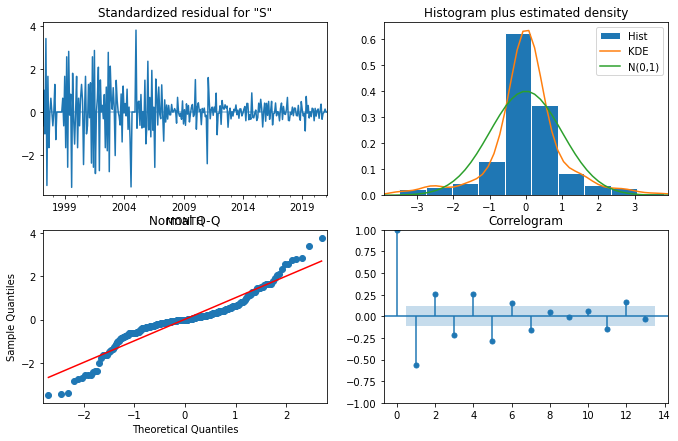

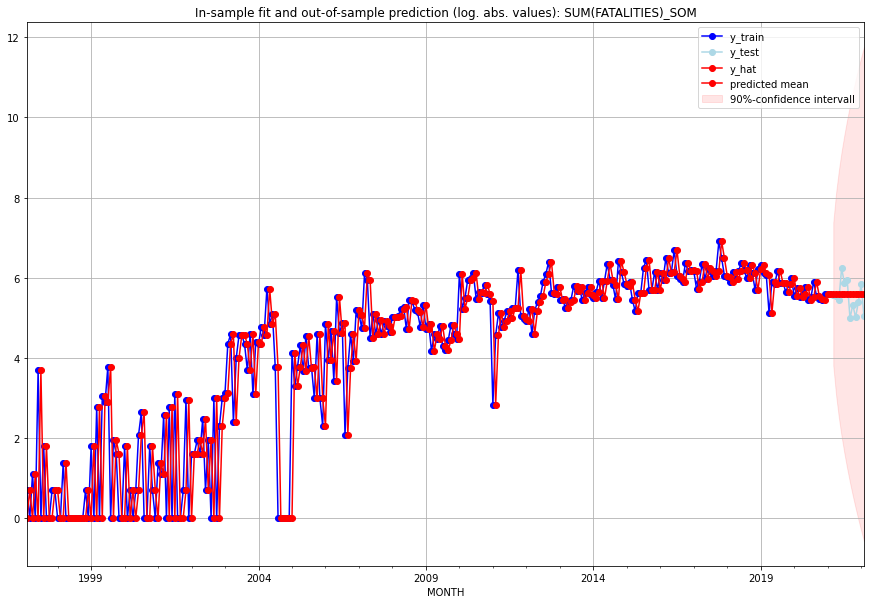

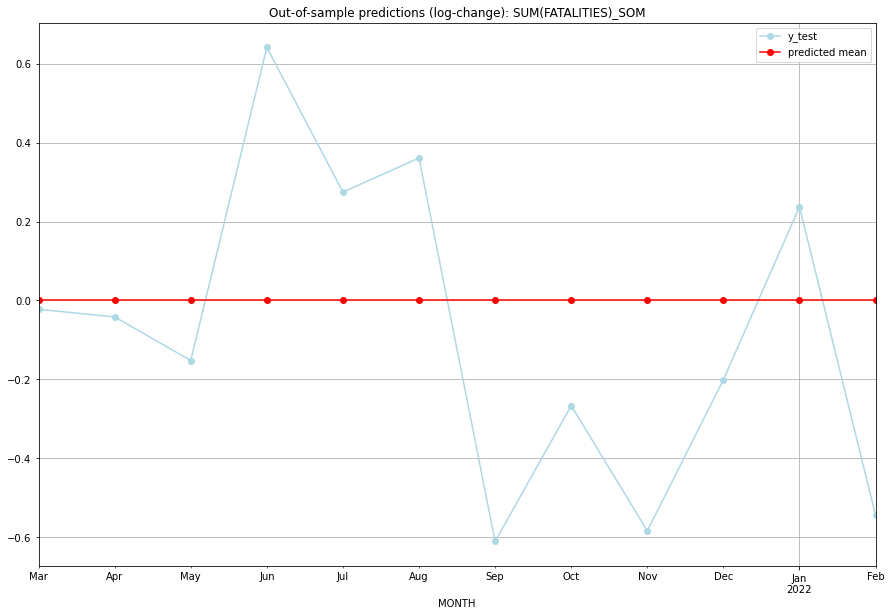

TADDA: 0.3282582418896612
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01     268.0       262.0           0.0       -0.022557   SOM   
1  2021-04-01     268.0       257.0           0.0       -0.041752   SOM   
2  2021-05-01     268.0       230.0           0.0       -0.152294   SOM   
3  2021-06-01     268.0       510.0           0.0        0.641658   SOM   
4  2021-07-01     268.0       353.0           0.0        0.274586   SOM   
5  2021-08-01     268.0       385.0           0.0        0.361126   SOM   
6  2021-09-01     268.0       145.0           0.0       -0.611105   SOM   
7  2021-10-01     268.0       205.0           0.0       -0.266835   SOM   
8  2021-11-01     268.0       149.0           0.0       -0.584076   SOM   
9  2021-12-01     268.0       219.0           0.0       -0.201084   SOM   
10 2022-01-01     268.0       340.0           0.0        0.237171   SOM   
11 2022-02-01     268.0       155.0           0.0    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [1, (0, 1, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.0, 'fold_results': [nan, 0.0]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_SRB   No. Observations:                   38
Model:                SARIMAX(0, 1, 3)   Log Likelihood                  -3.197
Date:                 Wed, 19 Oct 2022   AIC                             16.394
Time:                         11:11:30   BIC                             24.449
Sample:                     01-31-2018   HQIC                            19.234
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -0.0162      0.033     -0.486      0.627      -0.081       0

<Figure size 432x288 with 0 Axes>

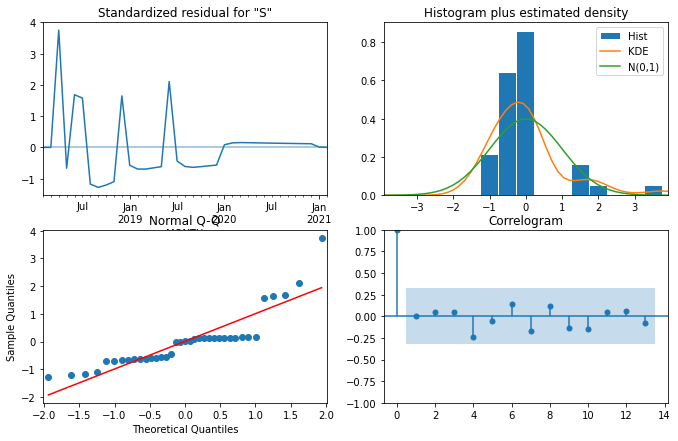

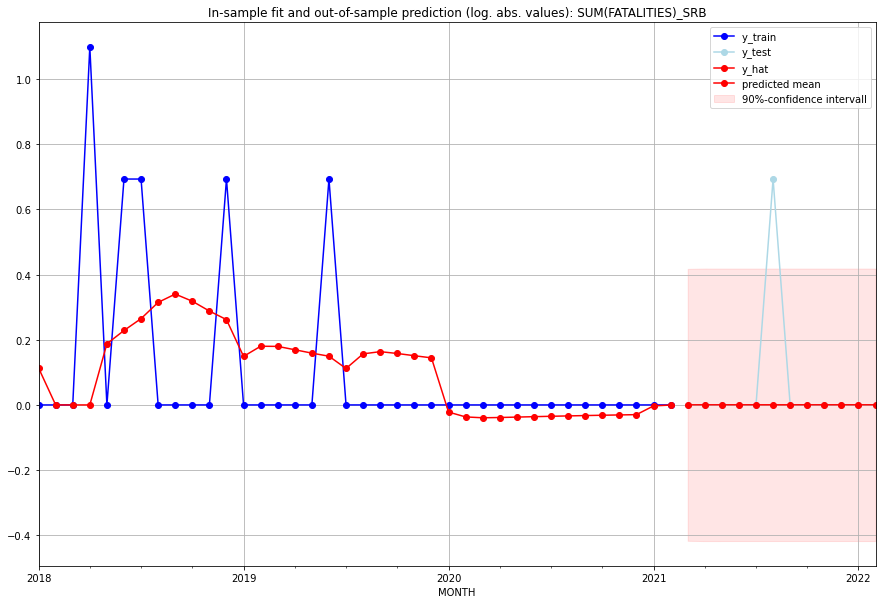

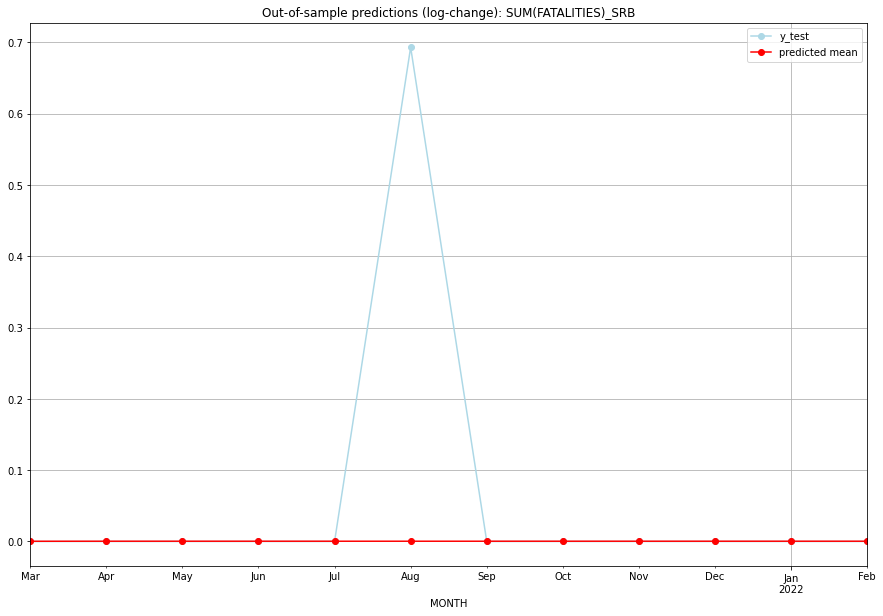

TADDA: 0.05807839272783544
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  0.000308         0.0      0.000308        0.000000   SRB   
1  2021-04-01  0.000383         0.0      0.000382        0.000000   SRB   
2  2021-05-01  0.000388         0.0      0.000388        0.000000   SRB   
3  2021-06-01  0.000388         0.0      0.000388        0.000000   SRB   
4  2021-07-01  0.000388         0.0      0.000388        0.000000   SRB   
5  2021-08-01  0.000388         1.0      0.000388        0.693147   SRB   
6  2021-09-01  0.000388         0.0      0.000388        0.000000   SRB   
7  2021-10-01  0.000388         0.0      0.000388        0.000000   SRB   
8  2021-11-01  0.000388         0.0      0.000388        0.000000   SRB   
9  2021-12-01  0.000388         0.0      0.000388        0.000000   SRB   
10 2022-01-01  0.000388         0.0      0.000388        0.000000   SRB   
11 2022-02-01  0.000388         0.0      0.000388   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [2, (2, 0, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.6779671652905325, 'fold_results': [0.6955554991228453, 0.628042167033423, 0.8713900227997167, 0.5070685655885758, 0.6877795719081017]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_SSD   No. Observations:                  289
Model:                SARIMAX(2, 0, 2)   Log Likelihood                -557.627
Date:                 Wed, 19 Oct 2022   AIC                           1129.254
Time:                         11:11:47   BIC                           1154.919
Sample:                     02-28-1997   HQIC                          1139.538
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------

<Figure size 432x288 with 0 Axes>

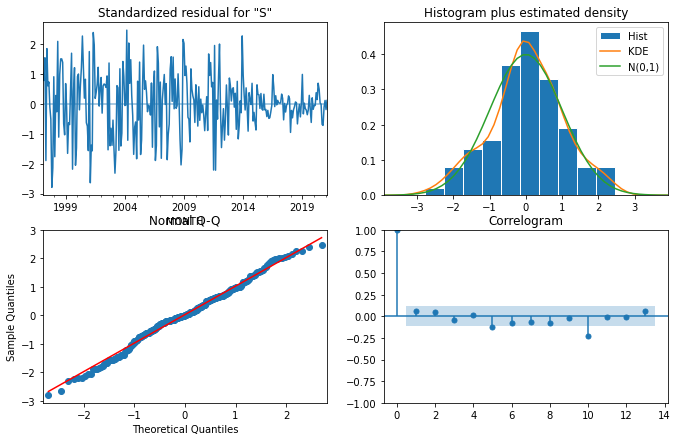

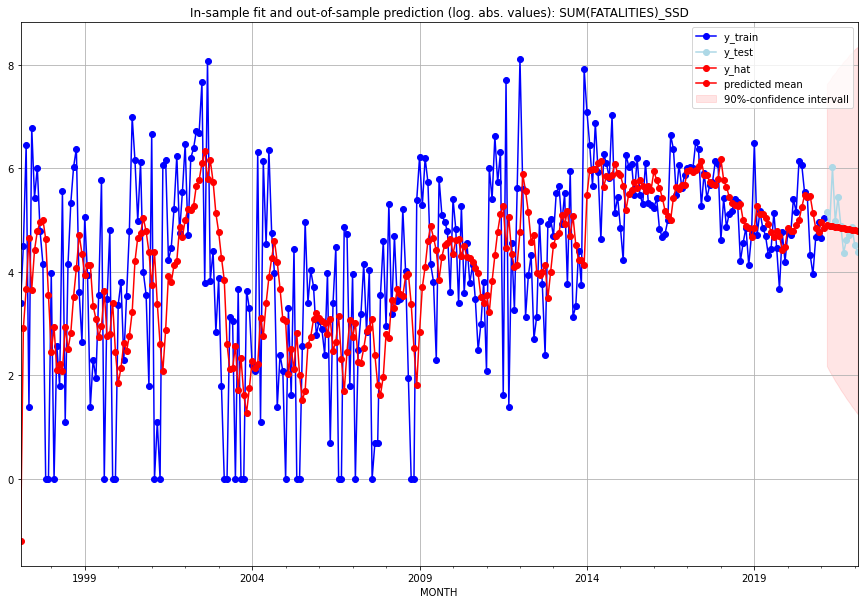

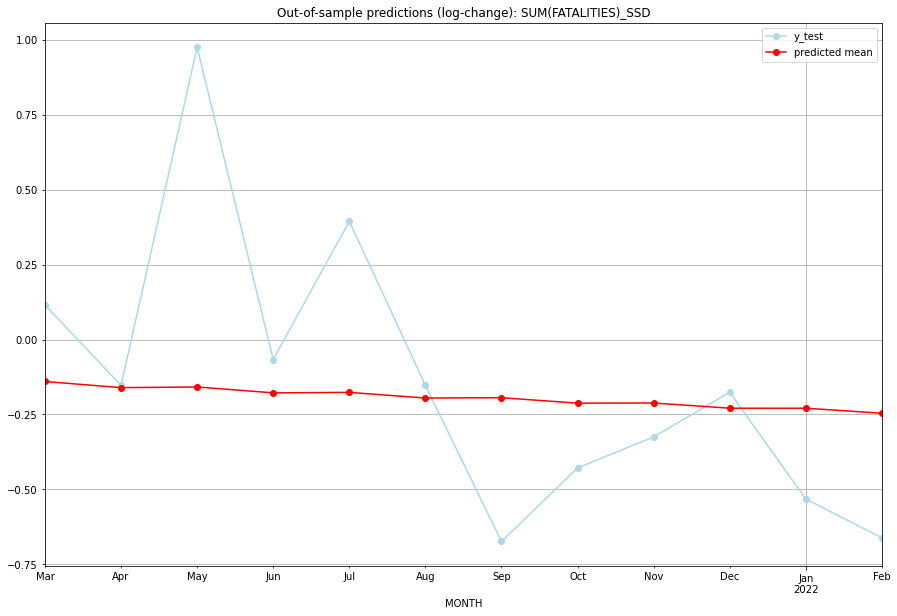

TADDA: 0.34806901207614954
Evaluation finished.
        MONTH    FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  133.742260       173.0     -0.140061        0.115630   SSD   
1  2021-04-01  131.007057       132.0     -0.160570       -0.153076   SSD   
2  2021-05-01  131.305666       410.0     -0.158310        0.975168   SSD   
3  2021-06-01  128.729864       144.0     -0.177971       -0.066691   SSD   
4  2021-07-01  128.940618       229.0     -0.176348        0.394654   SSD   
5  2021-08-01  126.512521       132.0     -0.195211       -0.153076   SSD   
6  2021-09-01  126.644390        78.0     -0.194177       -0.673977   SSD   
7  2021-10-01  124.353252       100.0     -0.212289       -0.428305   SSD   
8  2021-11-01  124.414384       111.0     -0.211802       -0.324926   SSD   
9  2021-12-01  122.250330       129.0     -0.229208       -0.175891   SSD   
10 2022-01-01  122.248128        90.0     -0.229225       -0.532566   SSD   
11 2022-02-01  120.202077   

<Figure size 432x288 with 0 Axes>

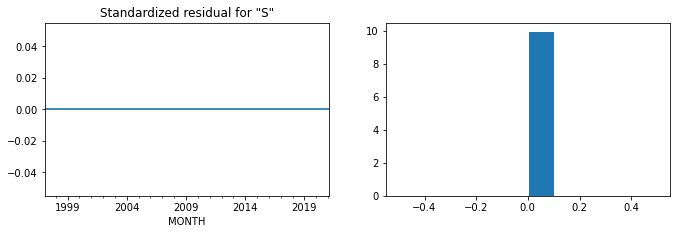

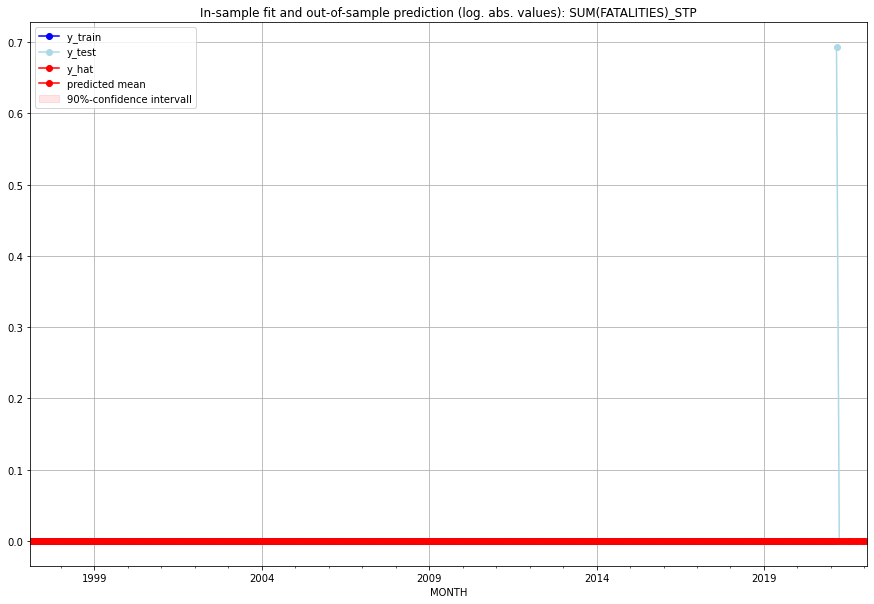

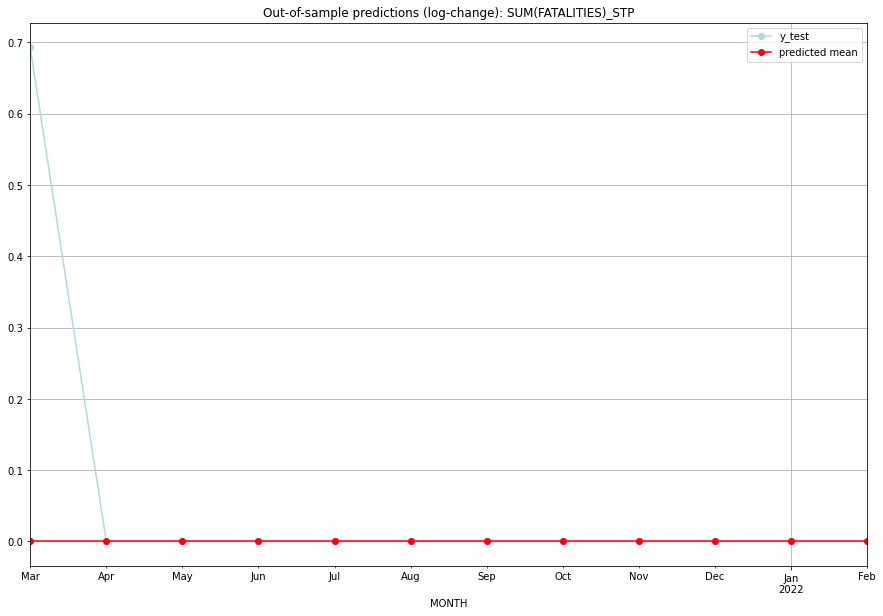

TADDA: 0.057762265046662105
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         1.0           0.0        0.693147   STP   
1  2021-04-01       0.0         0.0           0.0        0.000000   STP   
2  2021-05-01       0.0         0.0           0.0        0.000000   STP   
3  2021-06-01       0.0         0.0           0.0        0.000000   STP   
4  2021-07-01       0.0         0.0           0.0        0.000000   STP   
5  2021-08-01       0.0         0.0           0.0        0.000000   STP   
6  2021-09-01       0.0         0.0           0.0        0.000000   STP   
7  2021-10-01       0.0         0.0           0.0        0.000000   STP   
8  2021-11-01       0.0         0.0           0.0        0.000000   STP   
9  2021-12-01       0.0         0.0           0.0        0.000000   STP   
10 2022-01-01       0.0         0.0           0.0        0.000000   STP   
11 2022-02-01       0.0         0.0           0.0  

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (0, 1, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.12045133640101291, 'fold_results': [nan, 0.12045133640101291]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_SUR   No. Observations:                   38
Model:                SARIMAX(0, 1, 3)   Log Likelihood                  -7.757
Date:                 Wed, 19 Oct 2022   AIC                             29.515
Time:                         11:11:57   BIC                             40.791
Sample:                     01-31-2018   HQIC                            33.490
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -0.0553      0.028     -1.99

<Figure size 432x288 with 0 Axes>

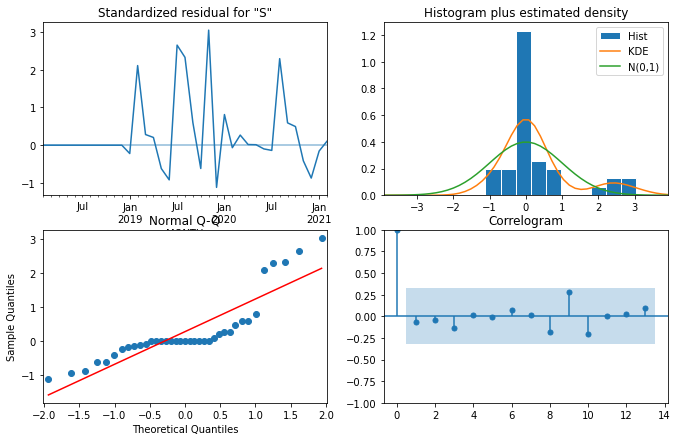

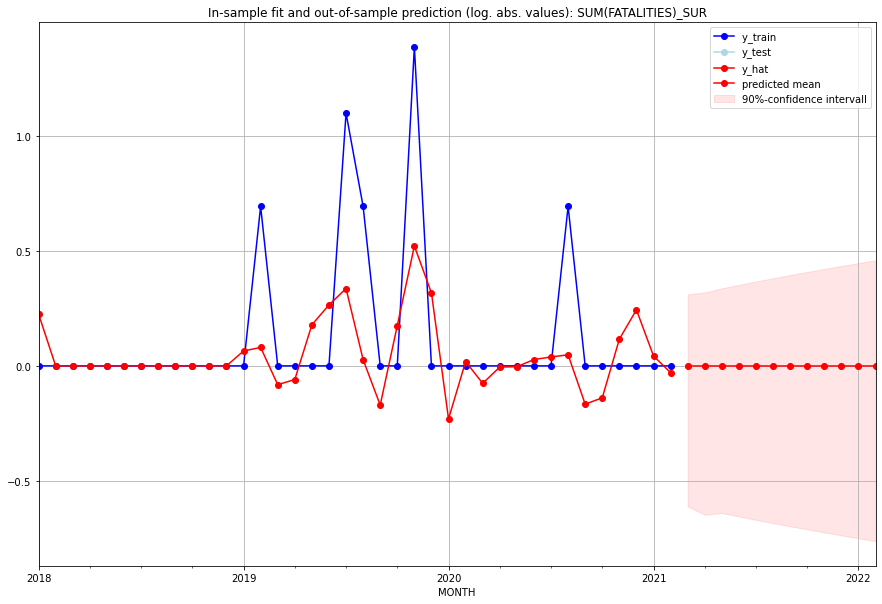

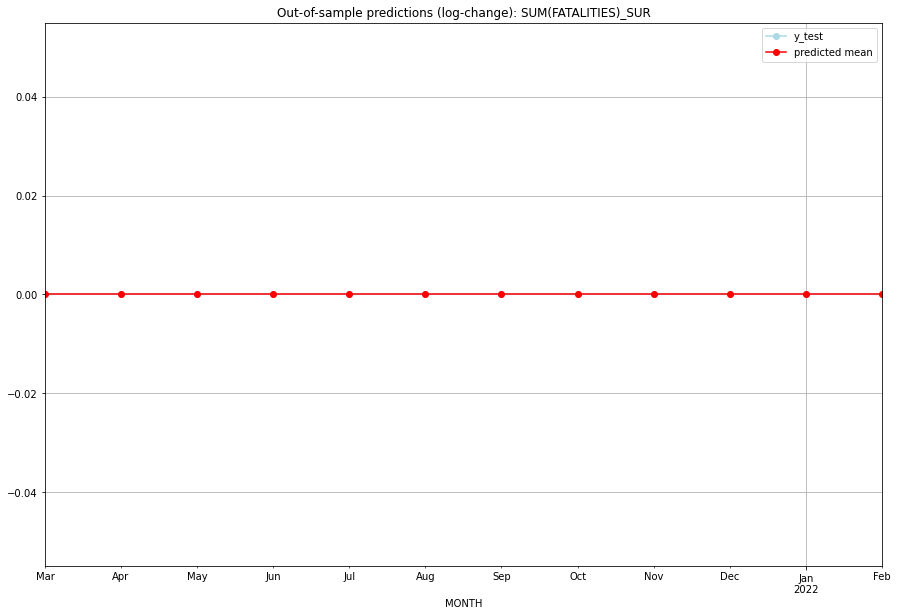

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   SUR   
1  2021-04-01       0.0         0.0           0.0             0.0   SUR   
2  2021-05-01       0.0         0.0           0.0             0.0   SUR   
3  2021-06-01       0.0         0.0           0.0             0.0   SUR   
4  2021-07-01       0.0         0.0           0.0             0.0   SUR   
5  2021-08-01       0.0         0.0           0.0             0.0   SUR   
6  2021-09-01       0.0         0.0           0.0             0.0   SUR   
7  2021-10-01       0.0         0.0           0.0             0.0   SUR   
8  2021-11-01       0.0         0.0           0.0             0.0   SUR   
9  2021-12-01       0.0         0.0           0.0             0.0   SUR   
10 2022-01-01       0.0         0.0           0.0             0.0   SUR   
11 2022-02-01       0.0         0.0           0.0             0.0   

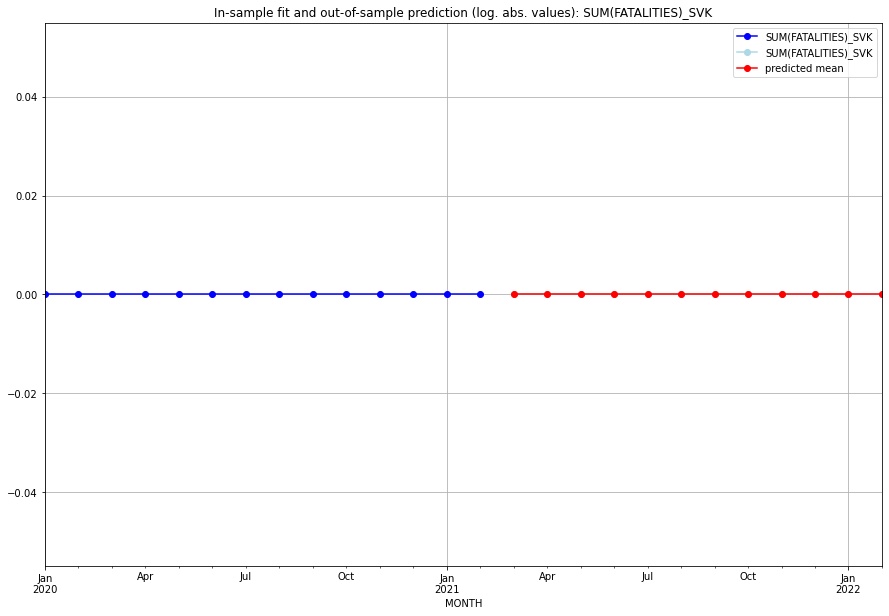

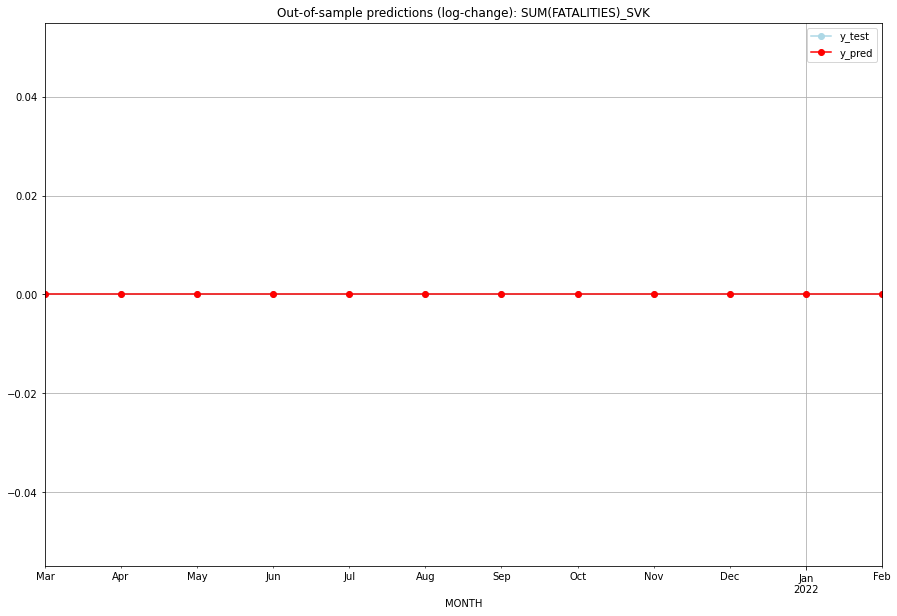

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   SVK   
1  2021-04-01       0.0         0.0           0.0             0.0   SVK   
2  2021-05-01       0.0         0.0           0.0             0.0   SVK   
3  2021-06-01       0.0         0.0           0.0             0.0   SVK   
4  2021-07-01       0.0         0.0           0.0             0.0   SVK   
5  2021-08-01       0.0         0.0           0.0             0.0   SVK   
6  2021-09-01       0.0         0.0           0.0             0.0   SVK   
7  2021-10-01       0.0         0.0           0.0             0.0   SVK   
8  2021-11-01       0.0         0.0           0.0             0.0   SVK   
9  2021-12-01       0.0         0.0           0.0             0.0   SVK   
10 2022-01-01       0.0         0.0           0.0             0.0   SVK   
11 2022-02-01       0.0         0.0           0.0             0.0   

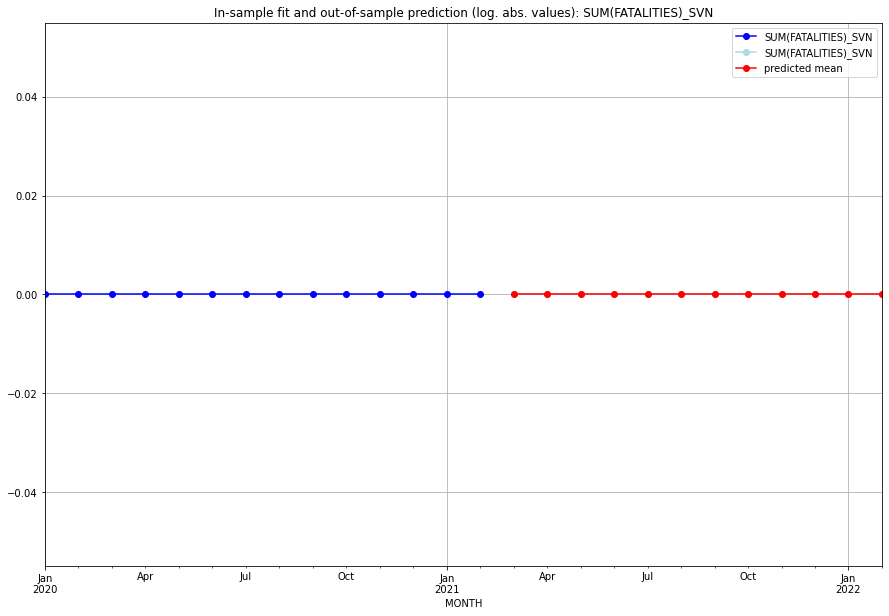

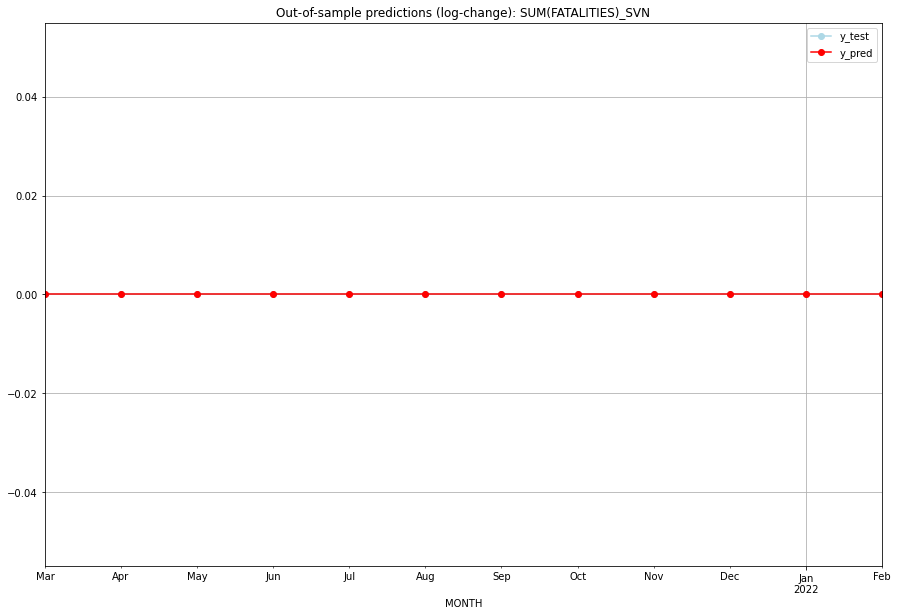

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   SVN   
1  2021-04-01       0.0         0.0           0.0             0.0   SVN   
2  2021-05-01       0.0         0.0           0.0             0.0   SVN   
3  2021-06-01       0.0         0.0           0.0             0.0   SVN   
4  2021-07-01       0.0         0.0           0.0             0.0   SVN   
5  2021-08-01       0.0         0.0           0.0             0.0   SVN   
6  2021-09-01       0.0         0.0           0.0             0.0   SVN   
7  2021-10-01       0.0         0.0           0.0             0.0   SVN   
8  2021-11-01       0.0         0.0           0.0             0.0   SVN   
9  2021-12-01       0.0         0.0           0.0             0.0   SVN   
10 2022-01-01       0.0         0.0           0.0             0.0   SVN   
11 2022-02-01       0.0         0.0           0.0             0.0   

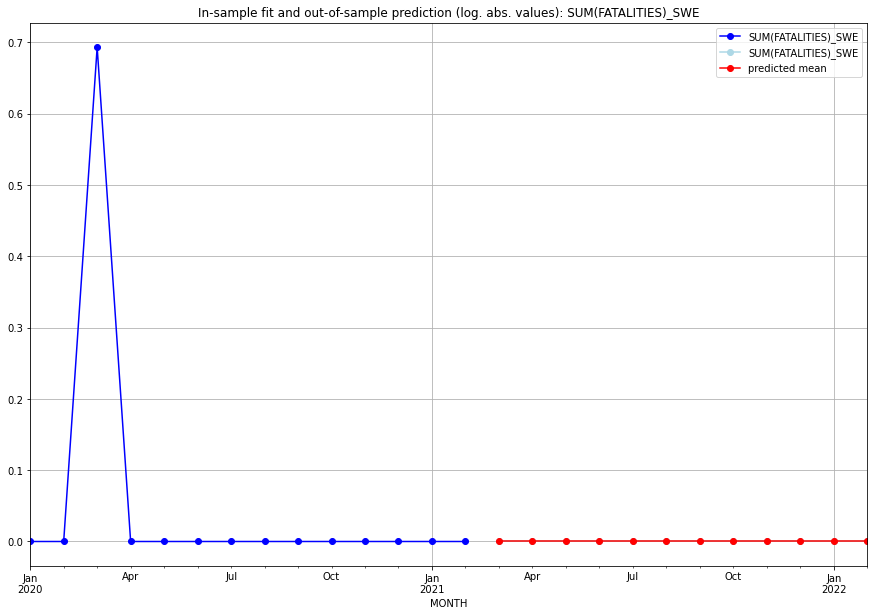

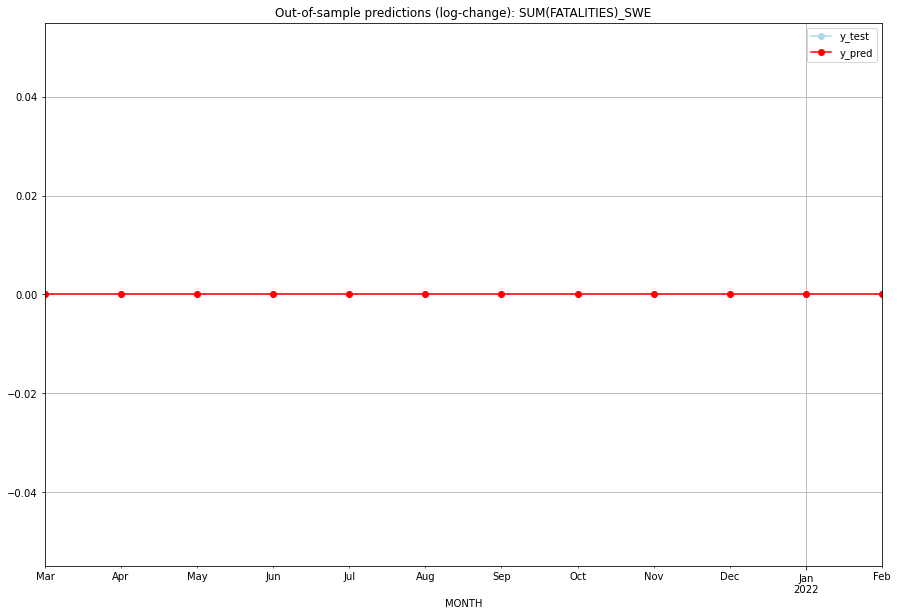

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   SWE   
1  2021-04-01       0.0         0.0           0.0             0.0   SWE   
2  2021-05-01       0.0         0.0           0.0             0.0   SWE   
3  2021-06-01       0.0         0.0           0.0             0.0   SWE   
4  2021-07-01       0.0         0.0           0.0             0.0   SWE   
5  2021-08-01       0.0         0.0           0.0             0.0   SWE   
6  2021-09-01       0.0         0.0           0.0             0.0   SWE   
7  2021-10-01       0.0         0.0           0.0             0.0   SWE   
8  2021-11-01       0.0         0.0           0.0             0.0   SWE   
9  2021-12-01       0.0         0.0           0.0             0.0   SWE   
10 2022-01-01       0.0         0.0           0.0             0.0   SWE   
11 2022-02-01       0.0         0.0           0.0             0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.09634572526320548, 'fold_results': [0.0, 0.0, 0.0, 0.1493132891023379, 0.33241533721368954]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_SWZ   No. Observations:                  289
Model:                         SARIMAX   Log Likelihood                  25.189
Date:                 Wed, 19 Oct 2022   AIC                            -48.378
Time:                         11:12:27   BIC                            -44.711
Sample:                     02-28-1997   HQIC                           -46.908
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2      

<Figure size 432x288 with 0 Axes>

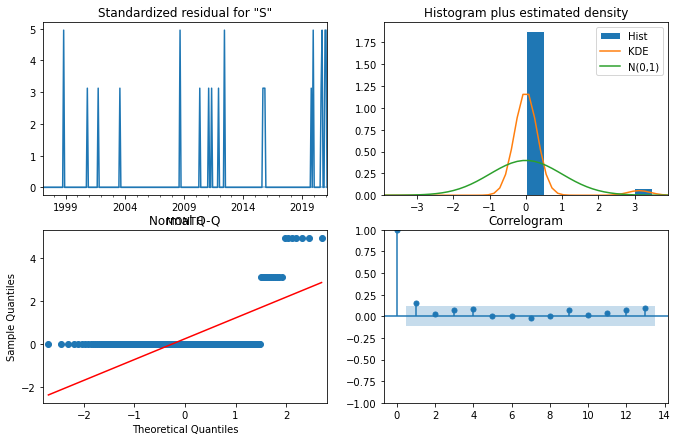

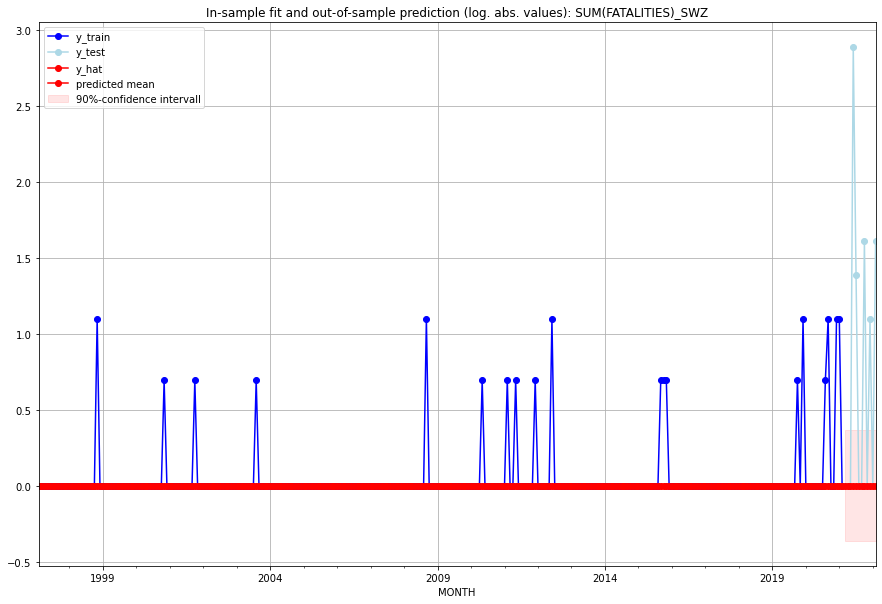

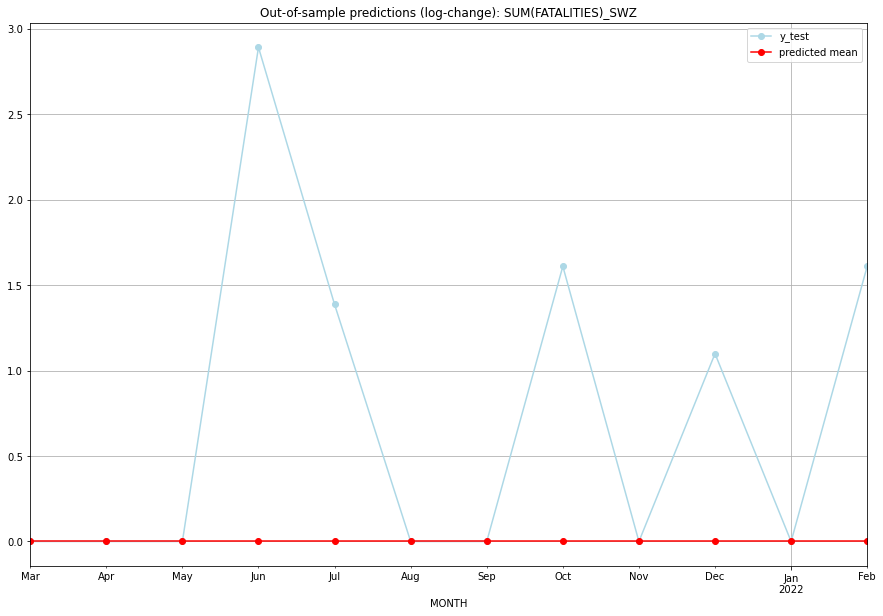

TADDA: 0.7161795193793639
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0        0.000000   SWZ   
1  2021-04-01       0.0         0.0           0.0        0.000000   SWZ   
2  2021-05-01       0.0         0.0           0.0        0.000000   SWZ   
3  2021-06-01       0.0        17.0           0.0        2.890372   SWZ   
4  2021-07-01       0.0         3.0           0.0        1.386294   SWZ   
5  2021-08-01       0.0         0.0           0.0        0.000000   SWZ   
6  2021-09-01       0.0         0.0           0.0        0.000000   SWZ   
7  2021-10-01       0.0         4.0           0.0        1.609438   SWZ   
8  2021-11-01       0.0         0.0           0.0        0.000000   SWZ   
9  2021-12-01       0.0         2.0           0.0        1.098612   SWZ   
10 2022-01-01       0.0         0.0           0.0        0.000000   SWZ   
11 2022-02-01       0.0         4.0           0.0    

<Figure size 432x288 with 0 Axes>

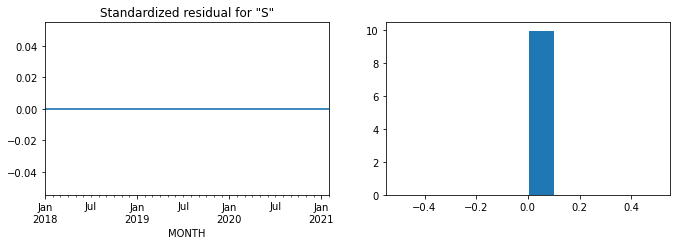

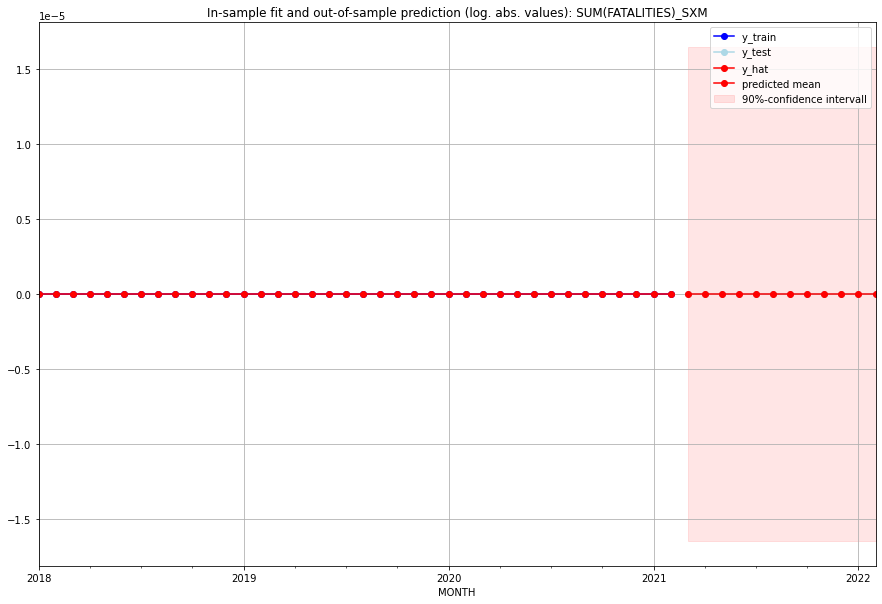

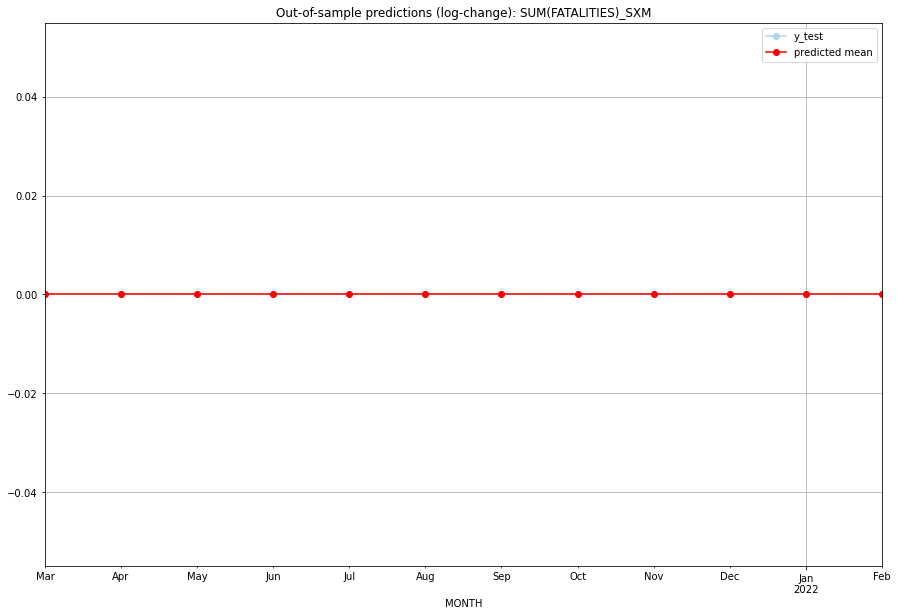

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   SXM   
1  2021-04-01       0.0         0.0           0.0             0.0   SXM   
2  2021-05-01       0.0         0.0           0.0             0.0   SXM   
3  2021-06-01       0.0         0.0           0.0             0.0   SXM   
4  2021-07-01       0.0         0.0           0.0             0.0   SXM   
5  2021-08-01       0.0         0.0           0.0             0.0   SXM   
6  2021-09-01       0.0         0.0           0.0             0.0   SXM   
7  2021-10-01       0.0         0.0           0.0             0.0   SXM   
8  2021-11-01       0.0         0.0           0.0             0.0   SXM   
9  2021-12-01       0.0         0.0           0.0             0.0   SXM   
10 2022-01-01       0.0         0.0           0.0             0.0   SXM   
11 2022-02-01       0.0         0.0           0.0             0.0   

<Figure size 432x288 with 0 Axes>

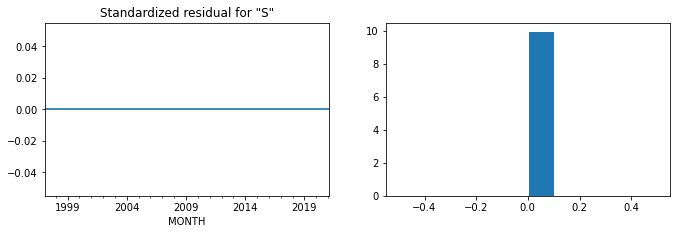

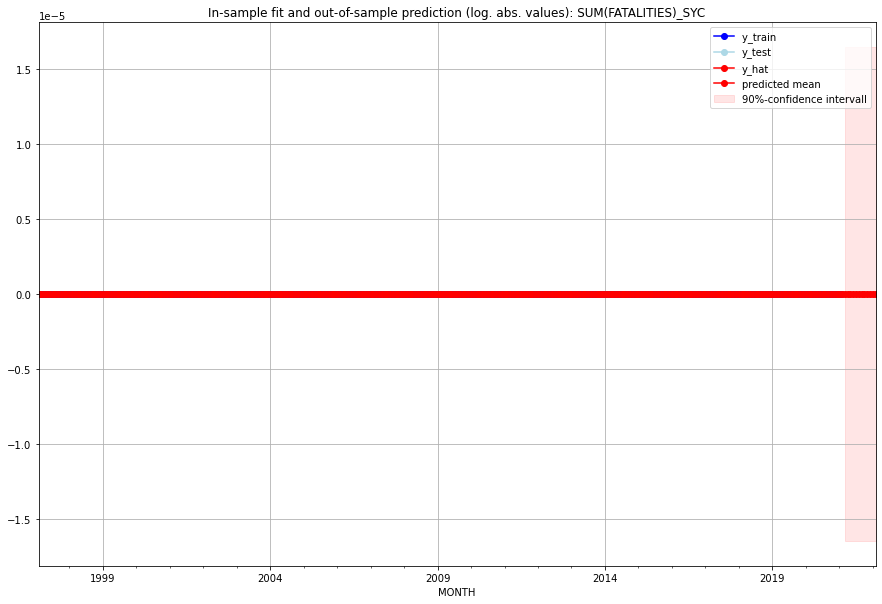

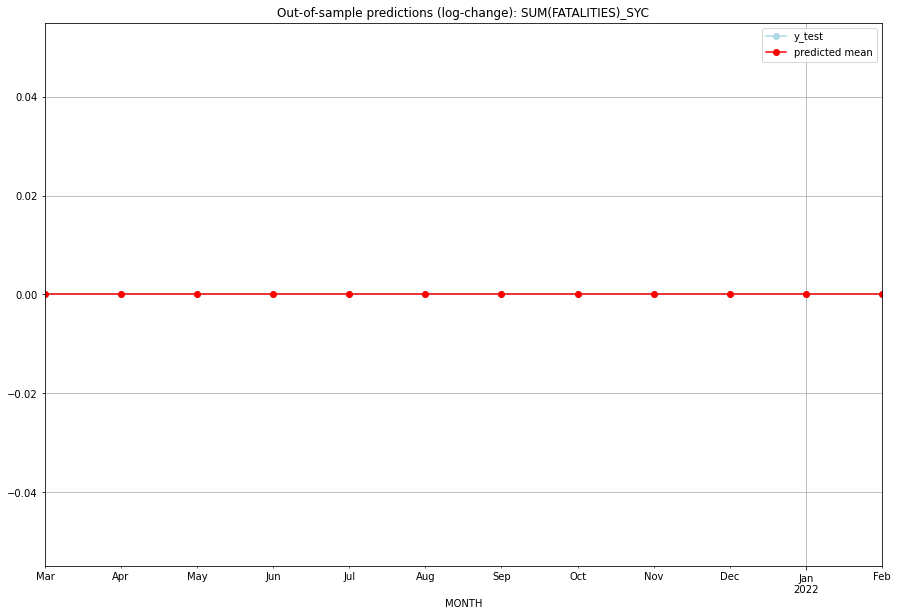

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   SYC   
1  2021-04-01       0.0         0.0           0.0             0.0   SYC   
2  2021-05-01       0.0         0.0           0.0             0.0   SYC   
3  2021-06-01       0.0         0.0           0.0             0.0   SYC   
4  2021-07-01       0.0         0.0           0.0             0.0   SYC   
5  2021-08-01       0.0         0.0           0.0             0.0   SYC   
6  2021-09-01       0.0         0.0           0.0             0.0   SYC   
7  2021-10-01       0.0         0.0           0.0             0.0   SYC   
8  2021-11-01       0.0         0.0           0.0             0.0   SYC   
9  2021-12-01       0.0         0.0           0.0             0.0   SYC   
10 2022-01-01       0.0         0.0           0.0             0.0   SYC   
11 2022-02-01       0.0         0.0           0.0             0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (3, 1, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.4072980238928028, 'fold_results': [nan, 0.3250412387875005, 0.48955480899810505]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_SYR   No. Observations:                   50
Model:                SARIMAX(3, 1, 3)   Log Likelihood                 -18.704
Date:                 Wed, 19 Oct 2022   AIC                             51.409
Time:                         11:12:43   BIC                             64.651
Sample:                     01-31-2017   HQIC                            56.433
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.8548  

<Figure size 432x288 with 0 Axes>

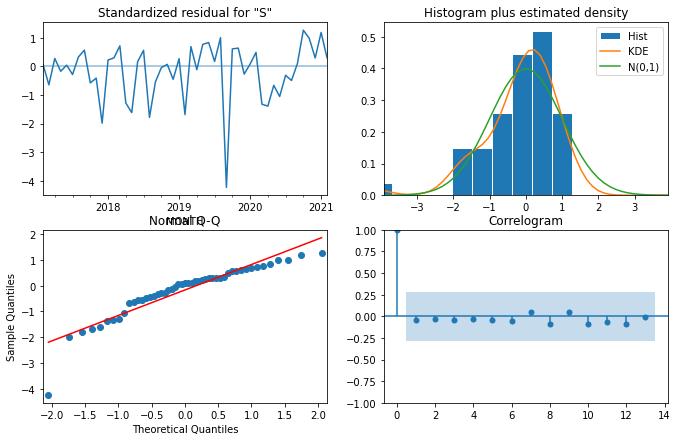

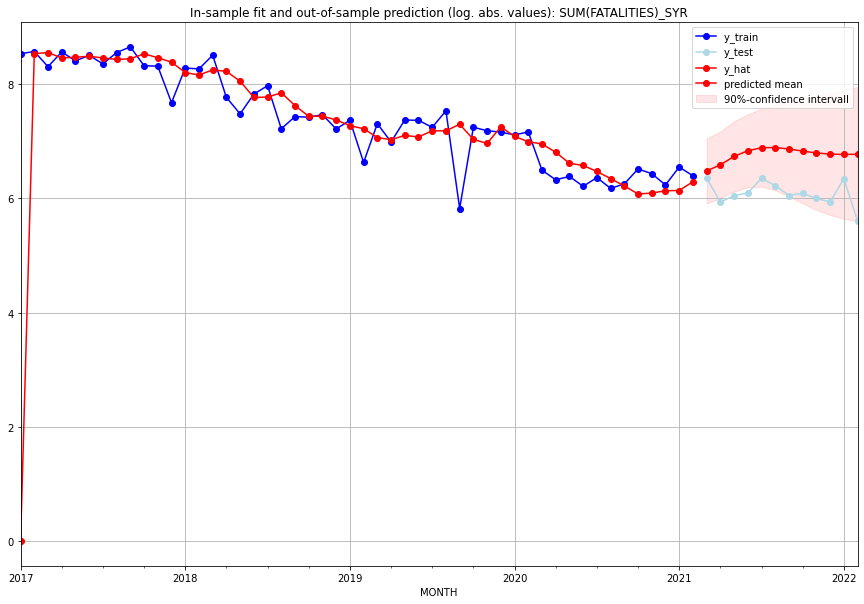

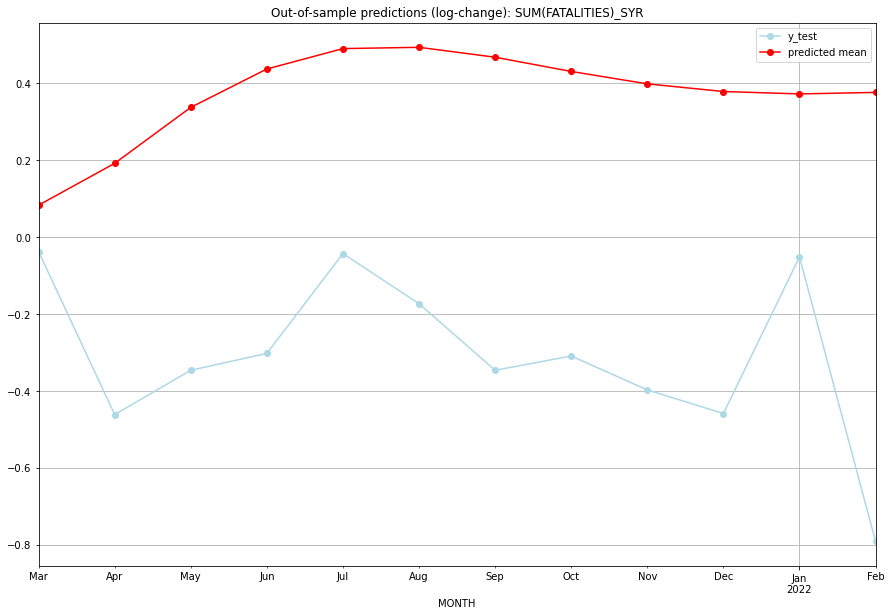

TADDA: 1.053087104822821
Evaluation finished.
        MONTH    FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  648.855003       575.0      0.083159       -0.037483   SYR   
1  2021-04-01  723.594258       376.0      0.192021       -0.461346   SYR   
2  2021-05-01  837.108639       422.0      0.337557       -0.346219   SYR   
3  2021-06-01  925.072696       441.0      0.437362       -0.302281   SYR   
4  2021-07-01  975.554630       572.0      0.490440       -0.042705   SYR   
5  2021-08-01  978.829530       502.0      0.493788       -0.173001   SYR   
6  2021-09-01  953.889883       422.0      0.468005       -0.346219   SYR   
7  2021-10-01  919.212829       438.0      0.431014       -0.309091   SYR   
8  2021-11-01  889.992557       401.0      0.398745       -0.397139   SYR   
9  2021-12-01  872.419299       377.0      0.378825       -0.458697   SYR   
10 2022-01-01  866.961154       567.0      0.372556       -0.051469   SYR   
11 2022-02-01  870.382421     

<Figure size 432x288 with 0 Axes>

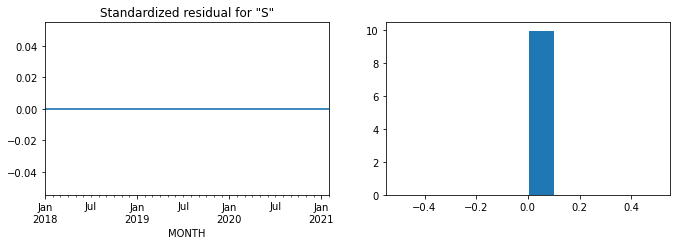

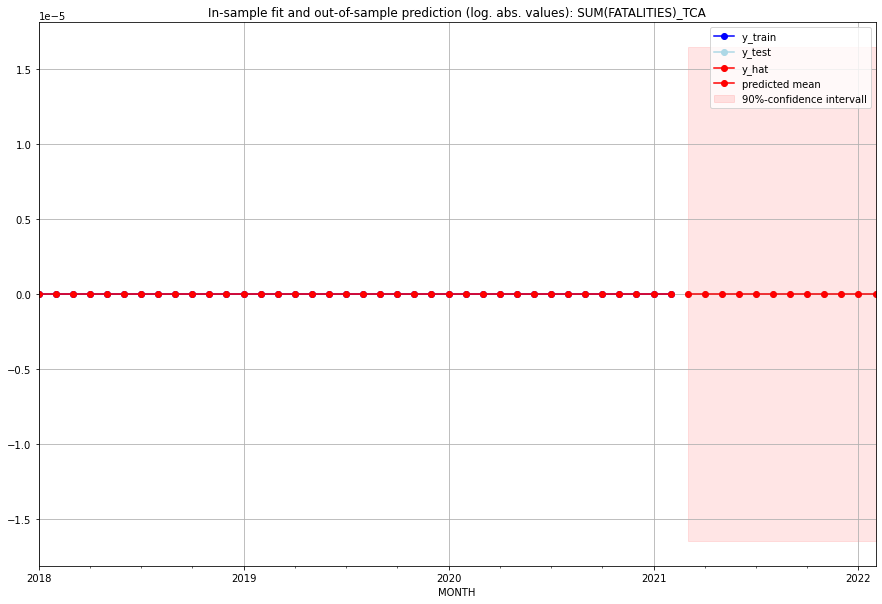

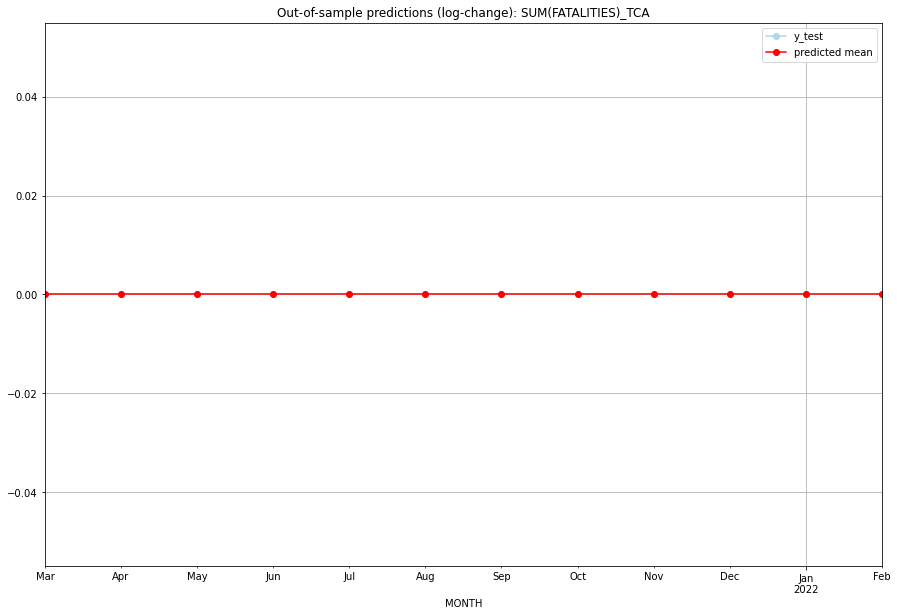

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   TCA   
1  2021-04-01       0.0         0.0           0.0             0.0   TCA   
2  2021-05-01       0.0         0.0           0.0             0.0   TCA   
3  2021-06-01       0.0         0.0           0.0             0.0   TCA   
4  2021-07-01       0.0         0.0           0.0             0.0   TCA   
5  2021-08-01       0.0         0.0           0.0             0.0   TCA   
6  2021-09-01       0.0         0.0           0.0             0.0   TCA   
7  2021-10-01       0.0         0.0           0.0             0.0   TCA   
8  2021-11-01       0.0         0.0           0.0             0.0   TCA   
9  2021-12-01       0.0         0.0           0.0             0.0   TCA   
10 2022-01-01       0.0         0.0           0.0             0.0   TCA   
11 2022-02-01       0.0         0.0           0.0             0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 1, 2), (0, 0, 0, 0), 'n'], 'cv_score': 1.4108038379118384, 'fold_results': [1.6711351831466097, 1.647946119013475, 1.3983565049366427, 1.4036964921706776, 0.9328848902917866]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_TCD   No. Observations:                  289
Model:                SARIMAX(0, 1, 2)   Log Likelihood                -571.670
Date:                 Wed, 19 Oct 2022   AIC                           1149.340
Time:                         11:13:03   BIC                           1160.329
Sample:                     02-28-1997   HQIC                          1153.744
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------

<Figure size 432x288 with 0 Axes>

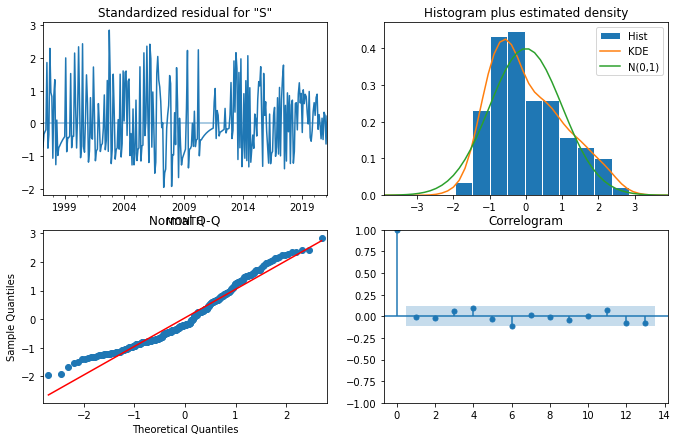

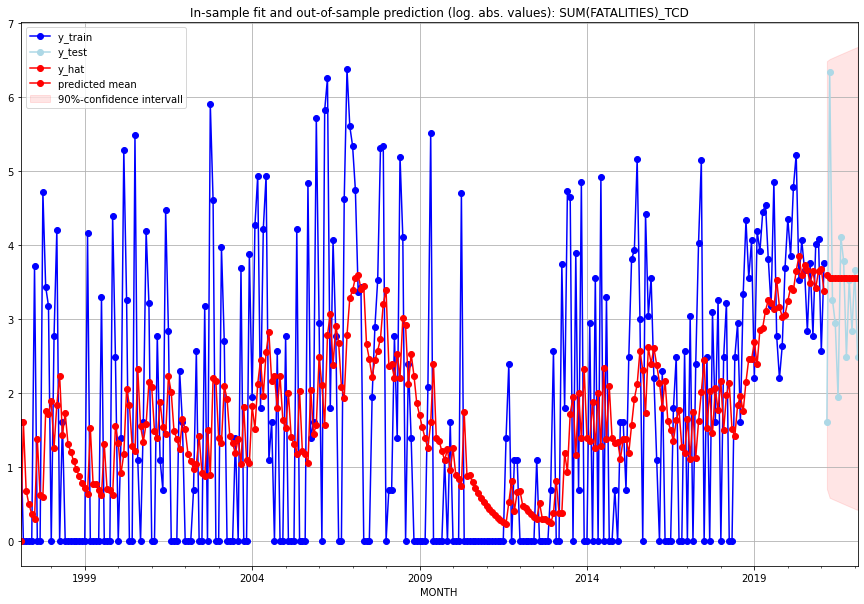

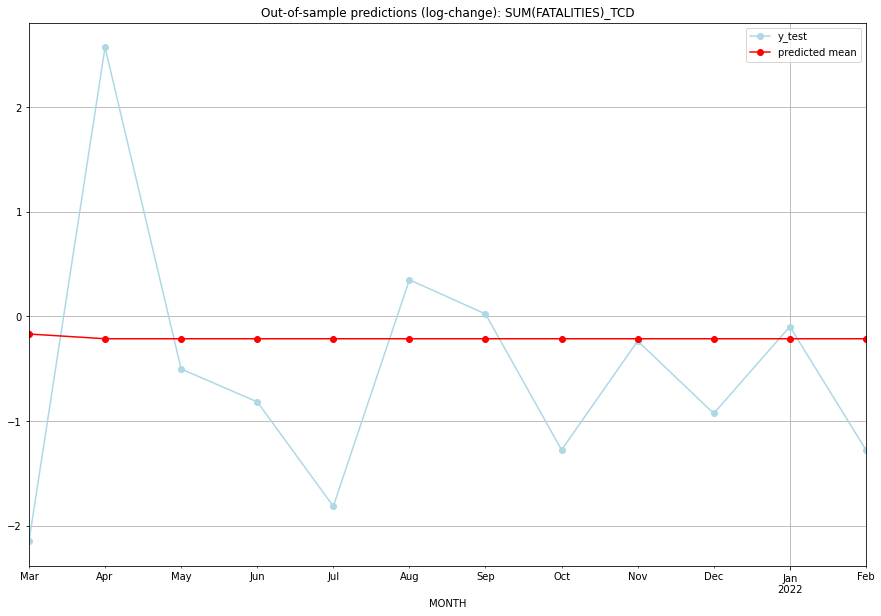

TADDA: 0.9734197458037414
Evaluation finished.
        MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  35.335767         4.0     -0.168398       -2.151762   TCD   
1  2021-04-01  33.728326       562.0     -0.213644        2.572080   TCD   
2  2021-05-01  33.728326        25.0     -0.213644       -0.503104   TCD   
3  2021-06-01  33.728326        18.0     -0.213644       -0.816761   TCD   
4  2021-07-01  33.728326         6.0     -0.213644       -1.815290   TCD   
5  2021-08-01  33.728326        60.0     -0.213644        0.349674   TCD   
6  2021-09-01  33.728326        43.0     -0.213644        0.022990   TCD   
7  2021-10-01  33.728326        11.0     -0.213644       -1.276293   TCD   
8  2021-11-01  33.728326        33.0     -0.213644       -0.234840   TCD   
9  2021-12-01  33.728326        16.0     -0.213644       -0.927987   TCD   
10 2022-01-01  33.728326        38.0     -0.213644       -0.097638   TCD   
11 2022-02-01  33.728326        11.0     

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (1, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.5143346159005393, 'fold_results': [0.35638884325133796, 1.0164207235526577, 0.19188209108283716, 0.3226000842423243, 0.6843813373735396]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_TGO   No. Observations:                  289
Model:                SARIMAX(1, 0, 0)   Log Likelihood                -234.578
Date:                 Wed, 19 Oct 2022   AIC                            473.155
Time:                         11:13:23   BIC                            480.488
Sample:                     02-28-1997   HQIC                           476.094
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------

<Figure size 432x288 with 0 Axes>

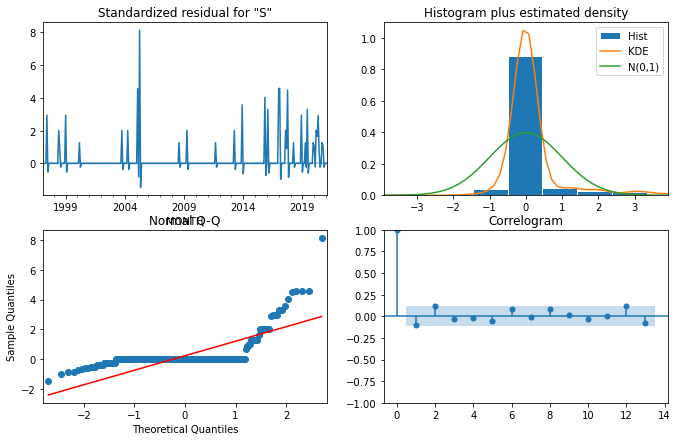

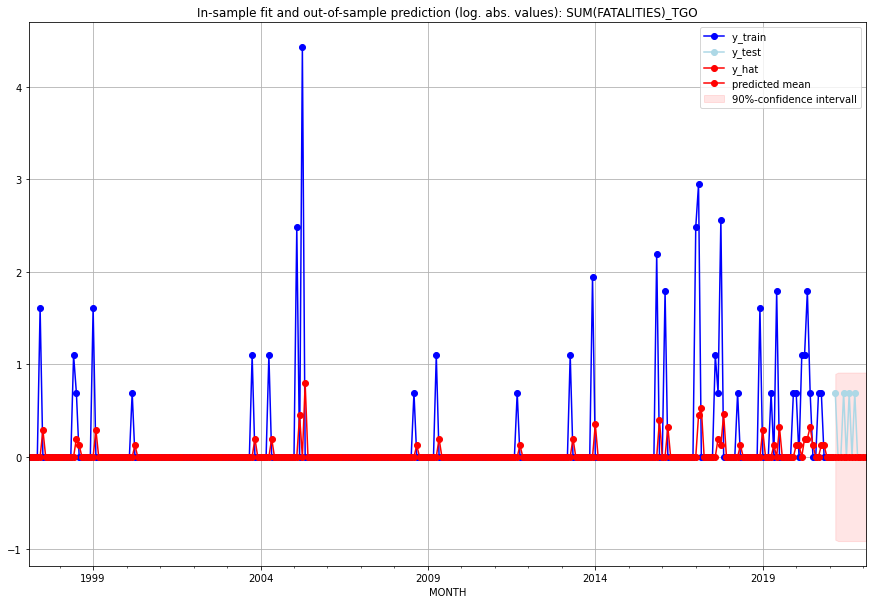

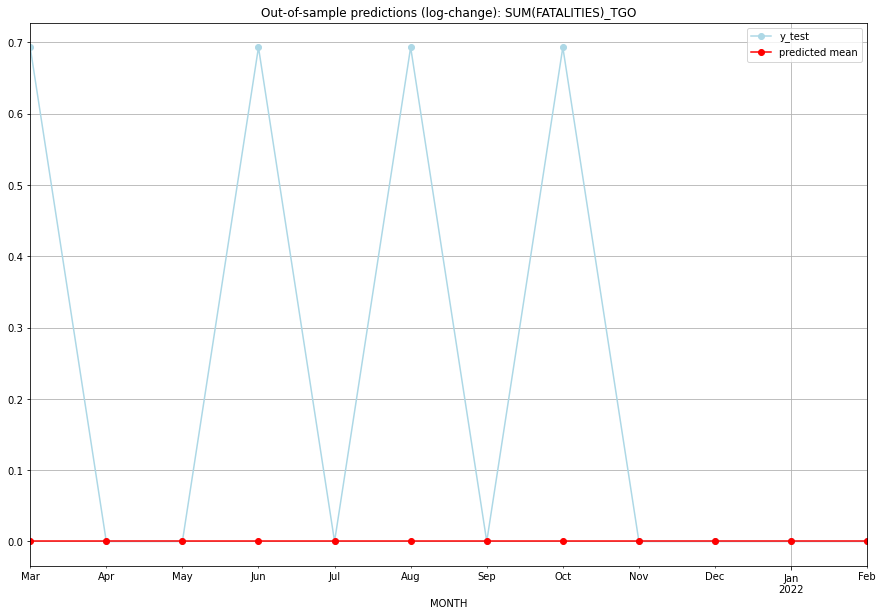

TADDA: 0.23104906018664842
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         1.0           0.0        0.693147   TGO   
1  2021-04-01       0.0         0.0           0.0        0.000000   TGO   
2  2021-05-01       0.0         0.0           0.0        0.000000   TGO   
3  2021-06-01       0.0         1.0           0.0        0.693147   TGO   
4  2021-07-01       0.0         0.0           0.0        0.000000   TGO   
5  2021-08-01       0.0         1.0           0.0        0.693147   TGO   
6  2021-09-01       0.0         0.0           0.0        0.000000   TGO   
7  2021-10-01       0.0         1.0           0.0        0.693147   TGO   
8  2021-11-01       0.0         0.0           0.0        0.000000   TGO   
9  2021-12-01       0.0         0.0           0.0        0.000000   TGO   
10 2022-01-01       0.0         0.0           0.0        0.000000   TGO   
11 2022-02-01       0.0         0.0           0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [2, (1, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.5524194796455645, 'fold_results': [0.7153254867998972, 0.5861374993457816, 0.44105383083666694, 0.40707322578561417, 0.6125073554598629]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_THA   No. Observations:                  134
Model:                SARIMAX(1, 0, 0)   Log Likelihood                -120.938
Date:                 Wed, 19 Oct 2022   AIC                            249.876
Time:                         11:13:37   BIC                            261.468
Sample:                     01-31-2010   HQIC                           254.587
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------

<Figure size 432x288 with 0 Axes>

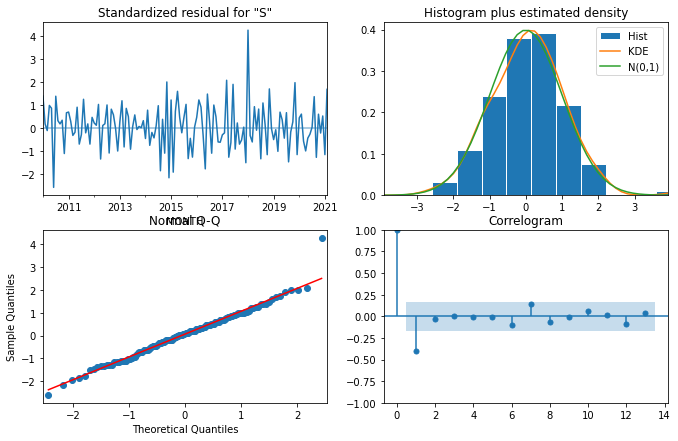

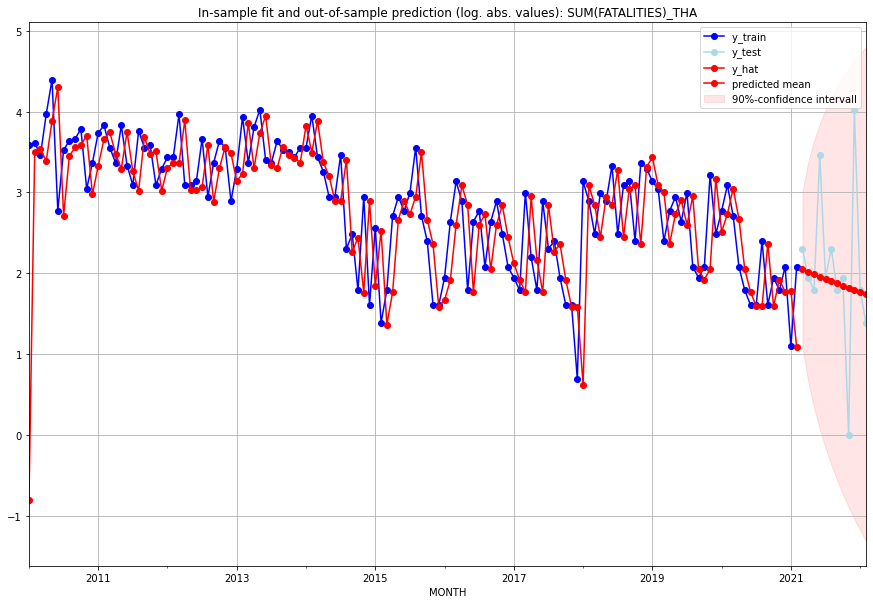

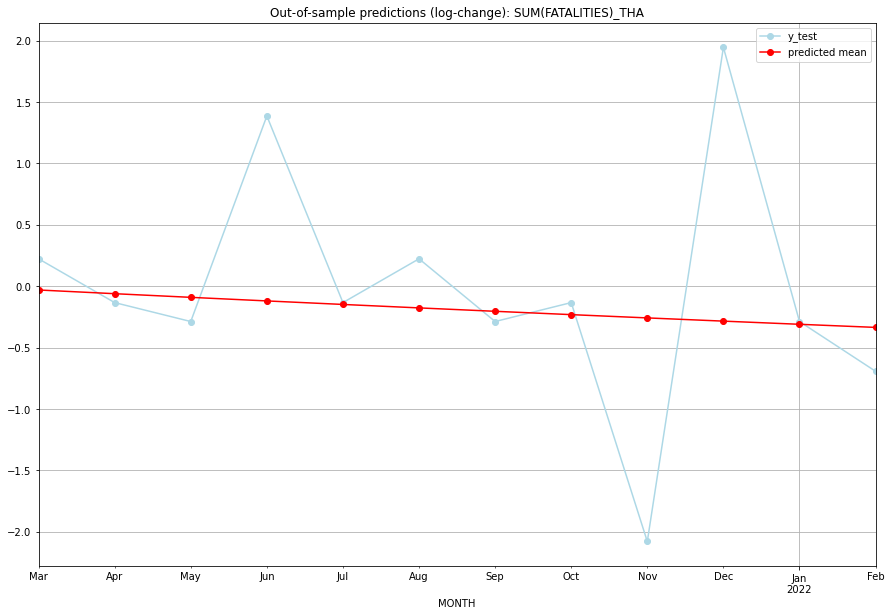

TADDA: 0.6391230555472104
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  6.757490         9.0     -0.030783        0.223144   THA   
1  2021-04-01  6.526421         6.0     -0.061022       -0.133531   THA   
2  2021-05-01  6.306135         5.0     -0.090727       -0.287682   THA   
3  2021-06-01  6.096018        31.0     -0.119908        1.386294   THA   
4  2021-07-01  5.895495         6.0     -0.148573       -0.133531   THA   
5  2021-08-01  5.704032         9.0     -0.176732        0.223144   THA   
6  2021-09-01  5.521126         5.0     -0.204394       -0.287682   THA   
7  2021-10-01  5.346310         6.0     -0.231568       -0.133531   THA   
8  2021-11-01  5.179144         0.0     -0.258262       -2.079442   THA   
9  2021-12-01  5.019218        55.0     -0.284484        1.945910   THA   
10 2022-01-01  4.866147         5.0     -0.310243       -0.287682   THA   
11 2022-02-01  4.719570         3.0     -0.335548    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [2, (0, 1, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.11552453009332421, 'fold_results': [nan, 0.11552453009332421]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_TJK   No. Observations:                   38
Model:                SARIMAX(0, 1, 3)   Log Likelihood                 -52.269
Date:                 Wed, 19 Oct 2022   AIC                            116.537
Time:                         11:13:44   BIC                            126.203
Sample:                     01-31-2018   HQIC                           119.945
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             0.0467      0.056      0.83

<Figure size 432x288 with 0 Axes>

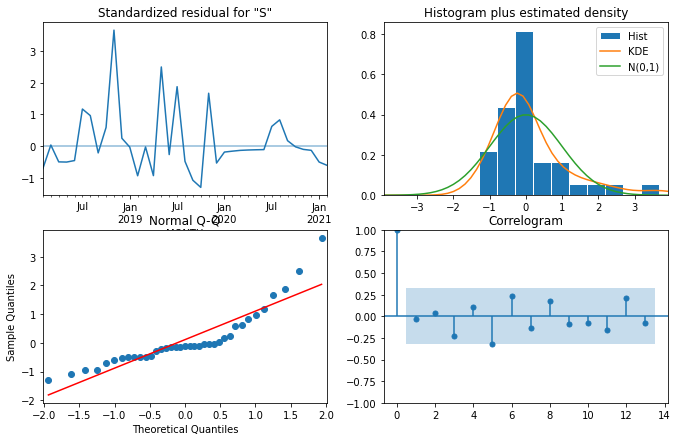

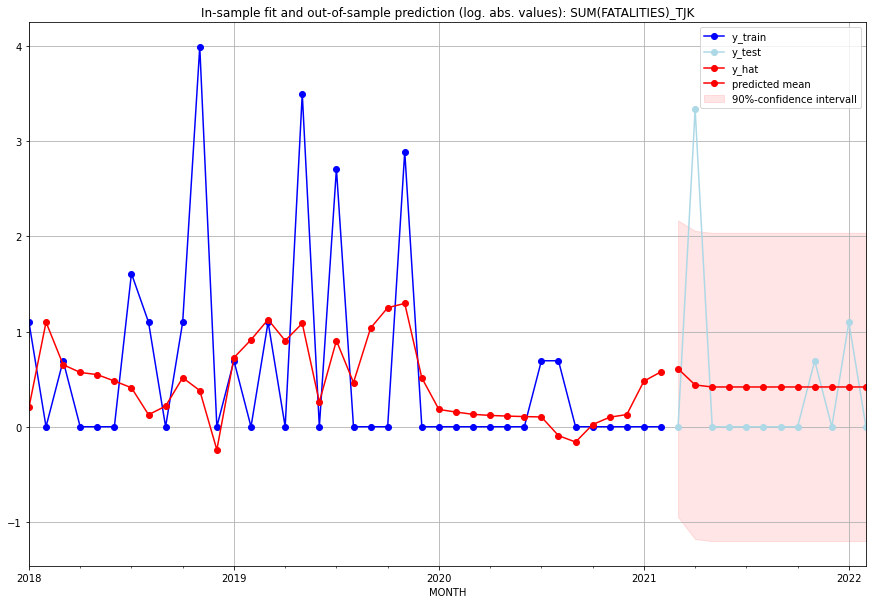

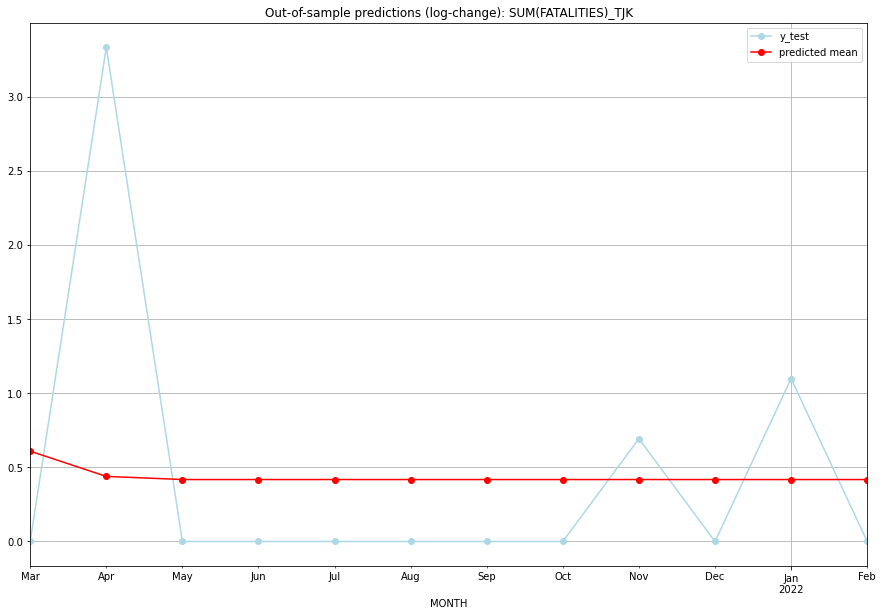

TADDA: 0.6501036126771402
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  0.838831         0.0      0.609130        0.000000   TJK   
1  2021-04-01  0.550971        27.0      0.438881        3.332205   TJK   
2  2021-05-01  0.518675         0.0      0.417838        0.000000   TJK   
3  2021-06-01  0.518675         0.0      0.417838        0.000000   TJK   
4  2021-07-01  0.518675         0.0      0.417838        0.000000   TJK   
5  2021-08-01  0.518675         0.0      0.417838        0.000000   TJK   
6  2021-09-01  0.518675         0.0      0.417838        0.000000   TJK   
7  2021-10-01  0.518675         0.0      0.417838        0.000000   TJK   
8  2021-11-01  0.518675         1.0      0.417838        0.693147   TJK   
9  2021-12-01  0.518675         0.0      0.417838        0.000000   TJK   
10 2022-01-01  0.518675         2.0      0.417838        1.098612   TJK   
11 2022-02-01  0.518675         0.0      0.417838    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (3, 1, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.057762265046662105, 'fold_results': [nan, 0.057762265046662105]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_TKM   No. Observations:                   38
Model:                SARIMAX(3, 1, 3)   Log Likelihood                 -35.417
Date:                 Wed, 19 Oct 2022   AIC                             90.833
Time:                         11:13:49   BIC                            106.942
Sample:                     01-31-2018   HQIC                            96.512
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             0.0158      0.077      0.

<Figure size 432x288 with 0 Axes>

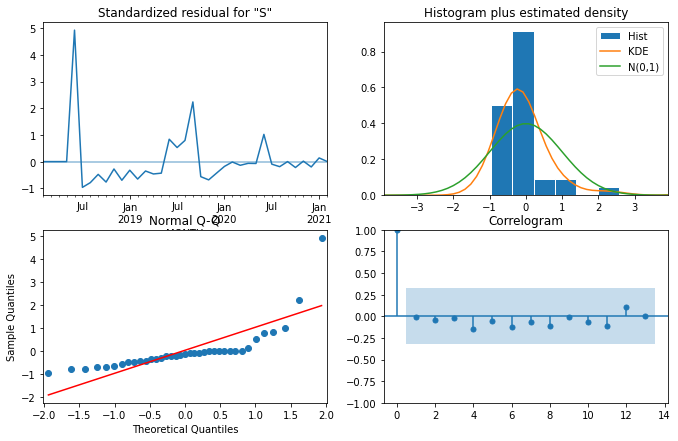

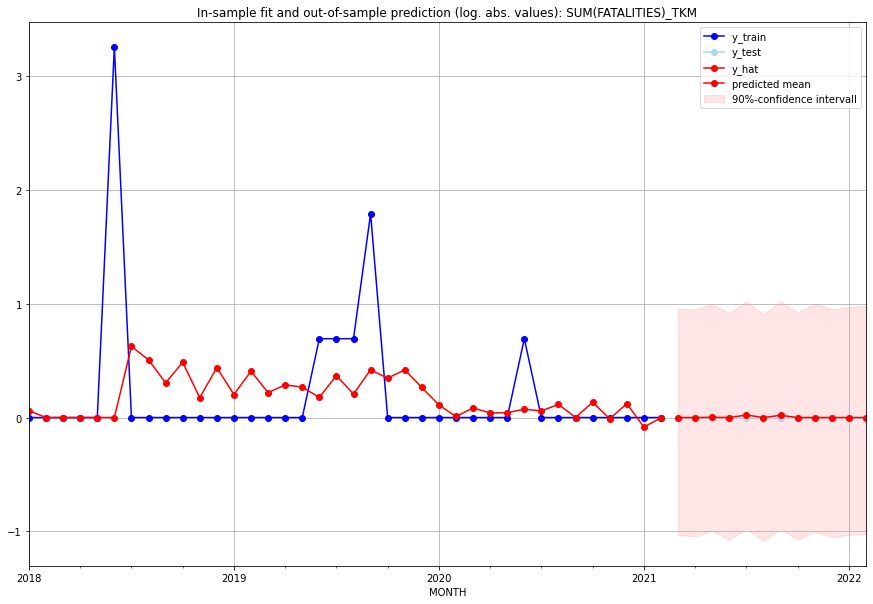

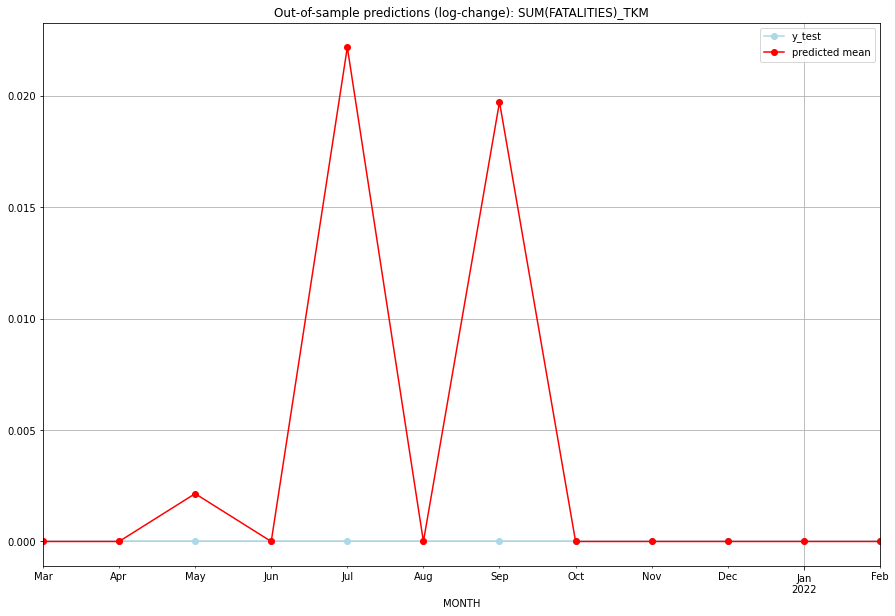

TADDA: 0.0036681888406259236
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  0.000000         0.0      0.000000             0.0   TKM   
1  2021-04-01  0.000000         0.0      0.000000             0.0   TKM   
2  2021-05-01  0.002147         0.0      0.002145             0.0   TKM   
3  2021-06-01  0.000000         0.0      0.000000             0.0   TKM   
4  2021-07-01  0.022411         0.0      0.022164             0.0   TKM   
5  2021-08-01  0.000000         0.0      0.000000             0.0   TKM   
6  2021-09-01  0.019905         0.0      0.019710             0.0   TKM   
7  2021-10-01  0.000000         0.0      0.000000             0.0   TKM   
8  2021-11-01  0.000000         0.0      0.000000             0.0   TKM   
9  2021-12-01  0.000000         0.0      0.000000             0.0   TKM   
10 2022-01-01  0.000000         0.0      0.000000             0.0   TKM   
11 2022-02-01  0.000000         0.0      0.000000 

<Figure size 432x288 with 0 Axes>

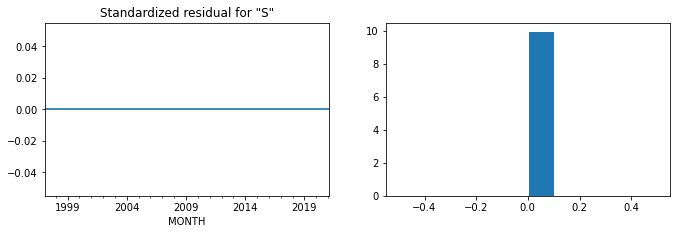

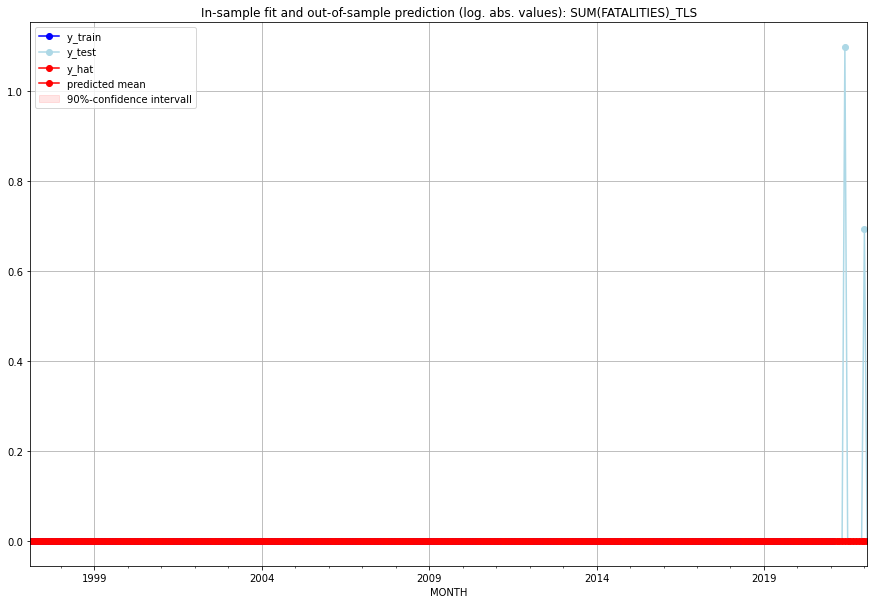

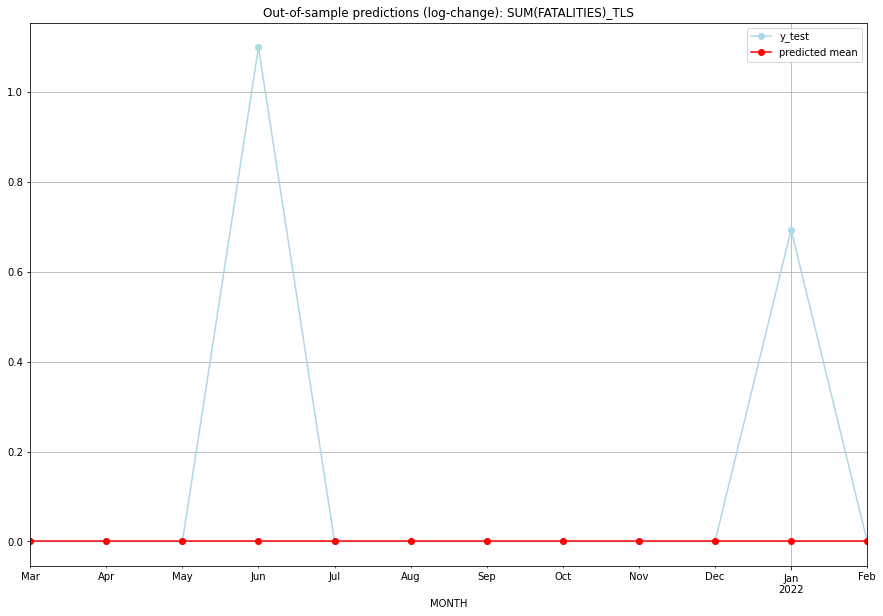

TADDA: 0.1493132891023379
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0        0.000000   TLS   
1  2021-04-01       0.0         0.0           0.0        0.000000   TLS   
2  2021-05-01       0.0         0.0           0.0        0.000000   TLS   
3  2021-06-01       0.0         2.0           0.0        1.098612   TLS   
4  2021-07-01       0.0         0.0           0.0        0.000000   TLS   
5  2021-08-01       0.0         0.0           0.0        0.000000   TLS   
6  2021-09-01       0.0         0.0           0.0        0.000000   TLS   
7  2021-10-01       0.0         0.0           0.0        0.000000   TLS   
8  2021-11-01       0.0         0.0           0.0        0.000000   TLS   
9  2021-12-01       0.0         0.0           0.0        0.000000   TLS   
10 2022-01-01       0.0         1.0           0.0        0.693147   TLS   
11 2022-02-01       0.0         0.0           0.0    

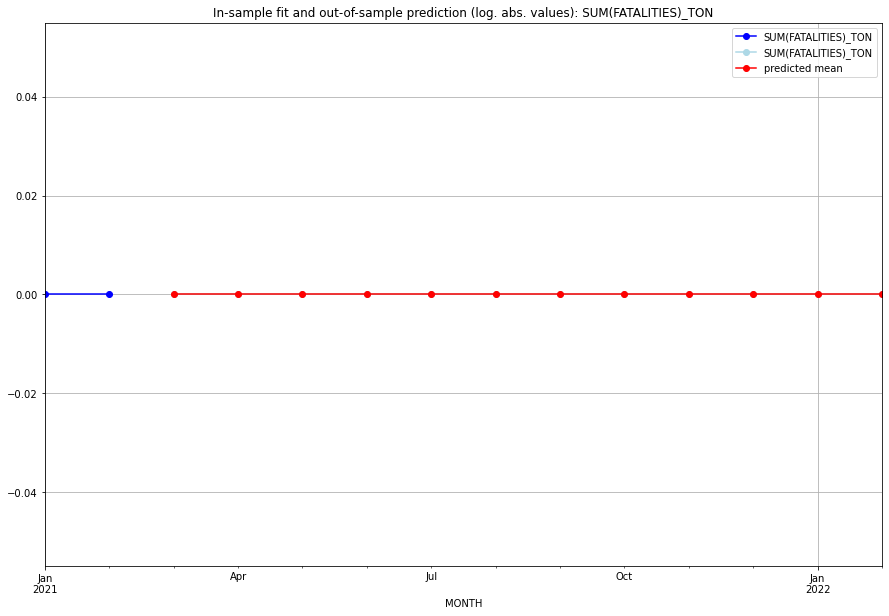

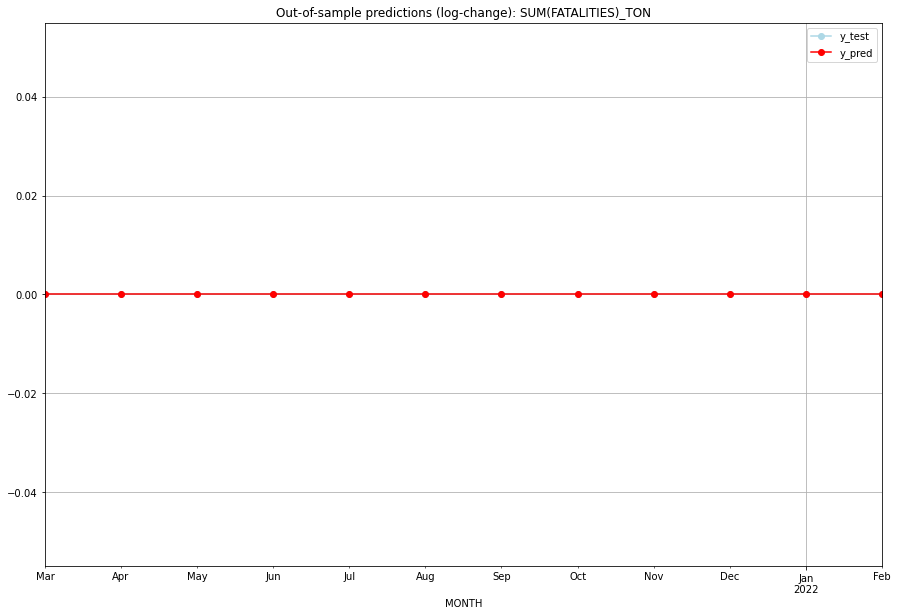

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   TON   
1  2021-04-01       0.0         0.0           0.0             0.0   TON   
2  2021-05-01       0.0         0.0           0.0             0.0   TON   
3  2021-06-01       0.0         0.0           0.0             0.0   TON   
4  2021-07-01       0.0         0.0           0.0             0.0   TON   
5  2021-08-01       0.0         0.0           0.0             0.0   TON   
6  2021-09-01       0.0         0.0           0.0             0.0   TON   
7  2021-10-01       0.0         0.0           0.0             0.0   TON   
8  2021-11-01       0.0         0.0           0.0             0.0   TON   
9  2021-12-01       0.0         0.0           0.0             0.0   TON   
10 2022-01-01       0.0         0.0           0.0             0.0   TON   
11 2022-02-01       0.0         0.0           0.0             0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [1, (3, 1, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.5049554762963986, 'fold_results': [nan, 0.5049554762963986]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_TTO   No. Observations:                   38
Model:                SARIMAX(3, 1, 3)   Log Likelihood                 -25.906
Date:                 Wed, 19 Oct 2022   AIC                             67.811
Time:                         11:14:07   BIC                             80.698
Sample:                     01-31-2018   HQIC                            72.354
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -0.0380      0.030     -1.253 

<Figure size 432x288 with 0 Axes>

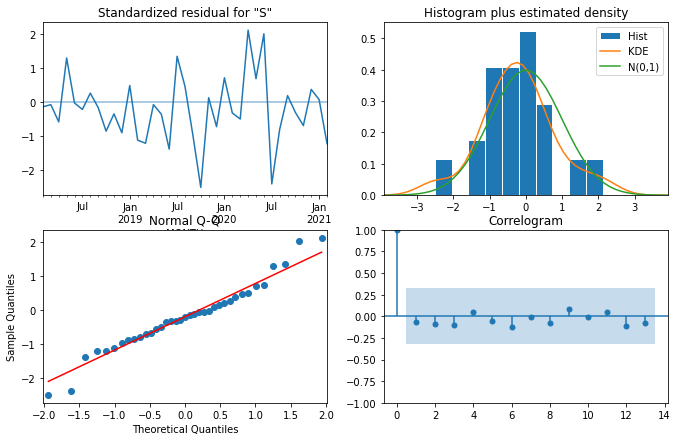

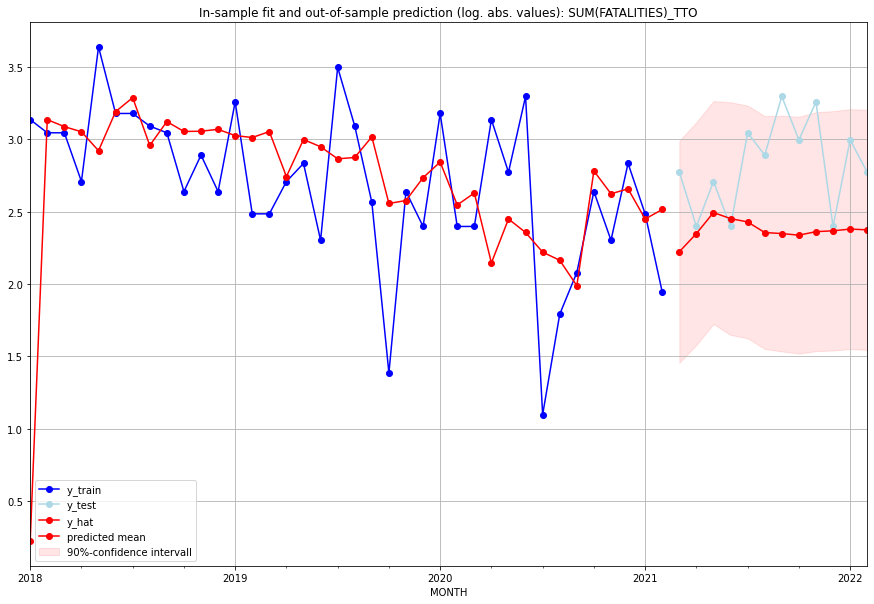

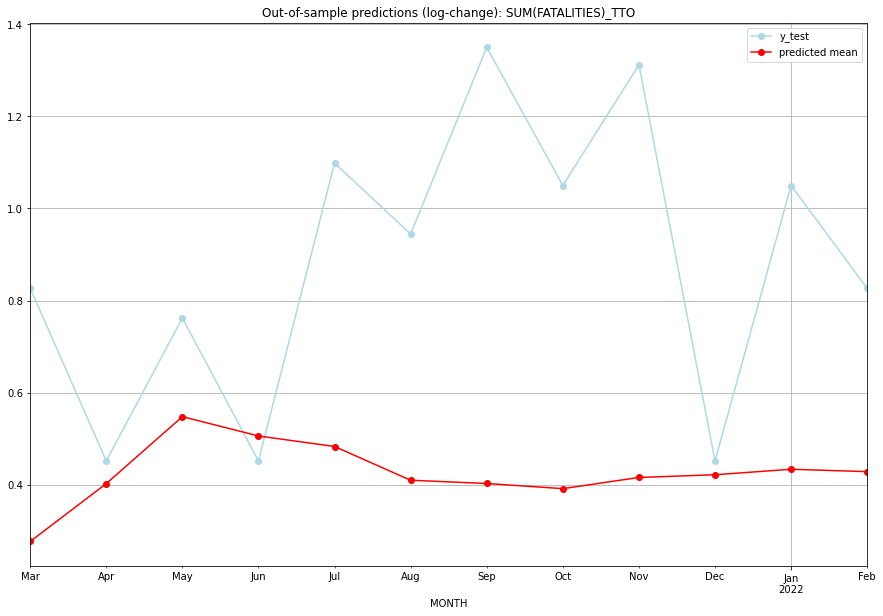

TADDA: 0.46352912712928673
Evaluation finished.
        MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01   8.234273        15.0      0.277012        0.826679   TTO   
1  2021-04-01   9.470726        10.0      0.402673        0.451985   TTO   
2  2021-05-01  11.109367        14.0      0.548069        0.762140   TTO   
3  2021-06-01  10.612196        10.0      0.506146        0.451985   TTO   
4  2021-07-01  10.349261        20.0      0.483243        1.098612   TTO   
5  2021-08-01   9.547626        17.0      0.409991        0.944462   TTO   
6  2021-09-01   9.473401        26.0      0.402929        1.349927   TTO   
7  2021-10-01   9.357032        19.0      0.391756        1.049822   TTO   
8  2021-11-01   9.611734        25.0      0.416050        1.312186   TTO   
9  2021-12-01   9.674003        10.0      0.421901        0.451985   TTO   
10 2022-01-01   9.802126        19.0      0.433833        1.049822   TTO   
11 2022-02-01   9.746331        15.0    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (2, 0, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.573521485695005, 'fold_results': [0.8332105292037205, 0.5602213328114237, 0.44335126277509285, 0.4737763856899431, 0.557047917994845]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_TUN   No. Observations:                  289
Model:                SARIMAX(2, 0, 3)   Log Likelihood                -305.300
Date:                 Wed, 19 Oct 2022   AIC                            622.599
Time:                         11:14:24   BIC                            644.598
Sample:                     02-28-1997   HQIC                           631.414
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------

<Figure size 432x288 with 0 Axes>

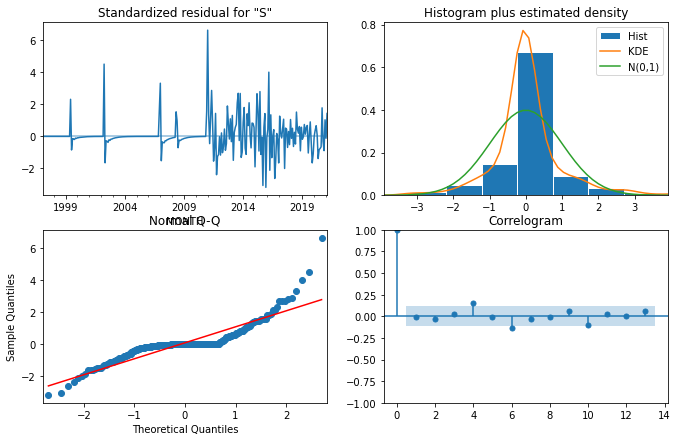

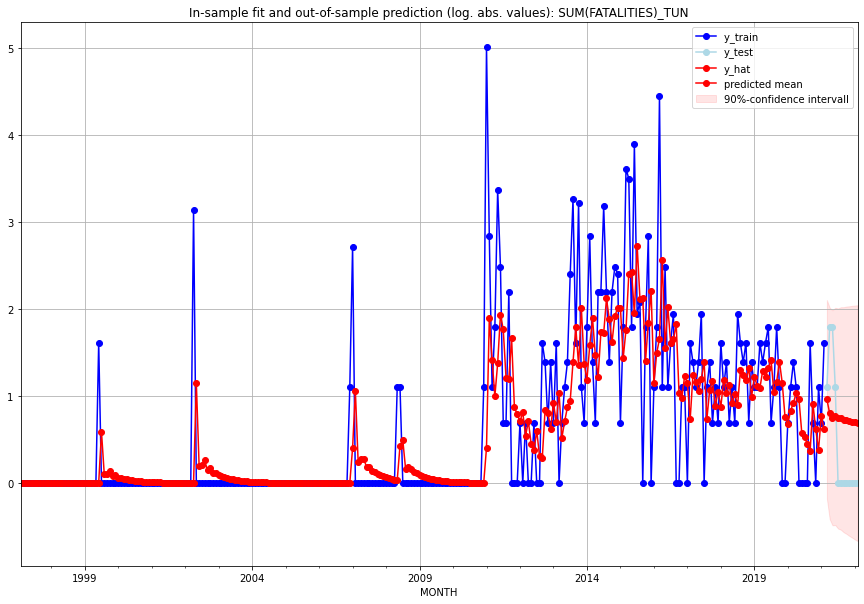

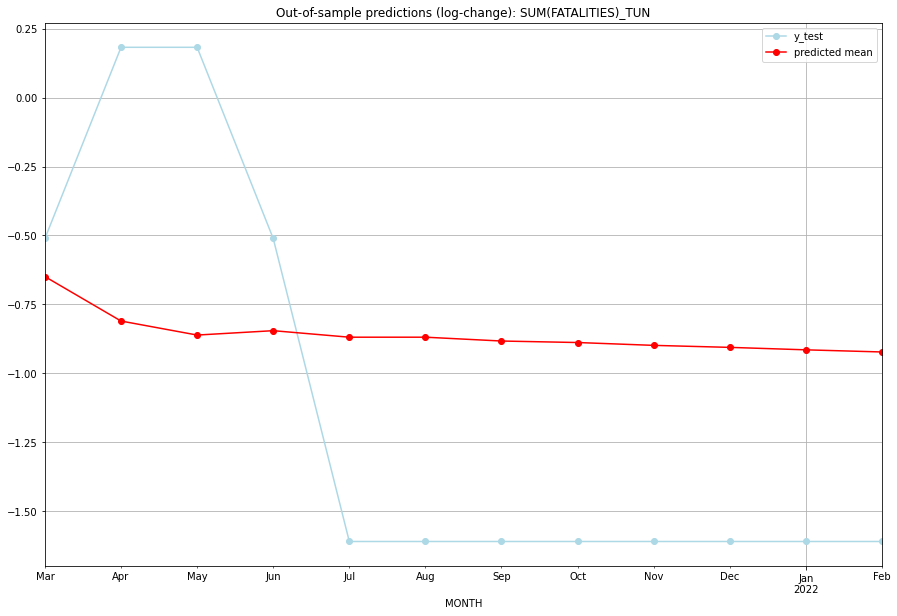

TADDA: 0.8254925063691313
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  1.612699         2.0     -0.649054       -0.510826   TUN   
1  2021-04-01  1.223971         5.0     -0.810143        0.182322   TUN   
2  2021-05-01  1.113760         5.0     -0.860970        0.182322   TUN   
3  2021-06-01  1.147595         2.0     -0.845089       -0.510826   TUN   
4  2021-07-01  1.097372         0.0     -0.868753       -1.609438   TUN   
5  2021-08-01  1.097466         0.0     -0.868708       -1.609438   TUN   
6  2021-09-01  1.068504         0.0     -0.882612       -1.609438   TUN   
7  2021-10-01  1.057288         0.0     -0.888049       -1.609438   TUN   
8  2021-11-01  1.036172         0.0     -0.898366       -1.609438   TUN   
9  2021-12-01  1.021459         0.0     -0.905619       -1.609438   TUN   
10 2022-01-01  1.003508         0.0     -0.914538       -1.609438   TUN   
11 2022-02-01  0.987998         0.0     -0.922310    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 1, 1), (0, 0, 0, 0), 'n'], 'cv_score': 1.1864649703464185, 'fold_results': [0.7921497202441875, 0.9139375924616813, 1.2463560827513815, 1.7934164859284234]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_TUR   No. Observations:                   62
Model:                SARIMAX(0, 1, 1)   Log Likelihood                 -65.961
Date:                 Wed, 19 Oct 2022   AIC                            135.922
Time:                         11:14:31   BIC                            140.144
Sample:                     01-31-2016   HQIC                           137.577
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------

<Figure size 432x288 with 0 Axes>

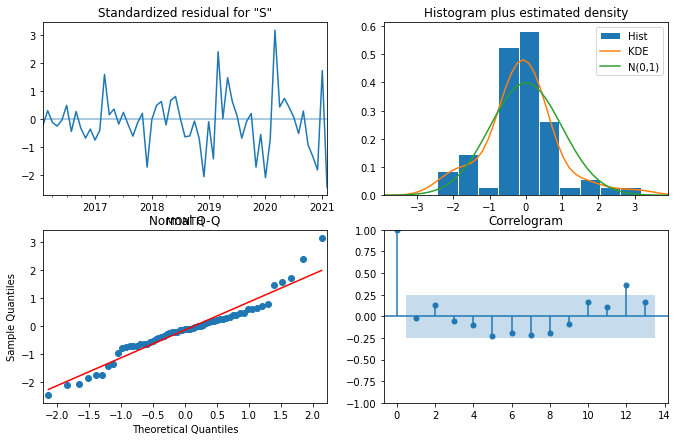

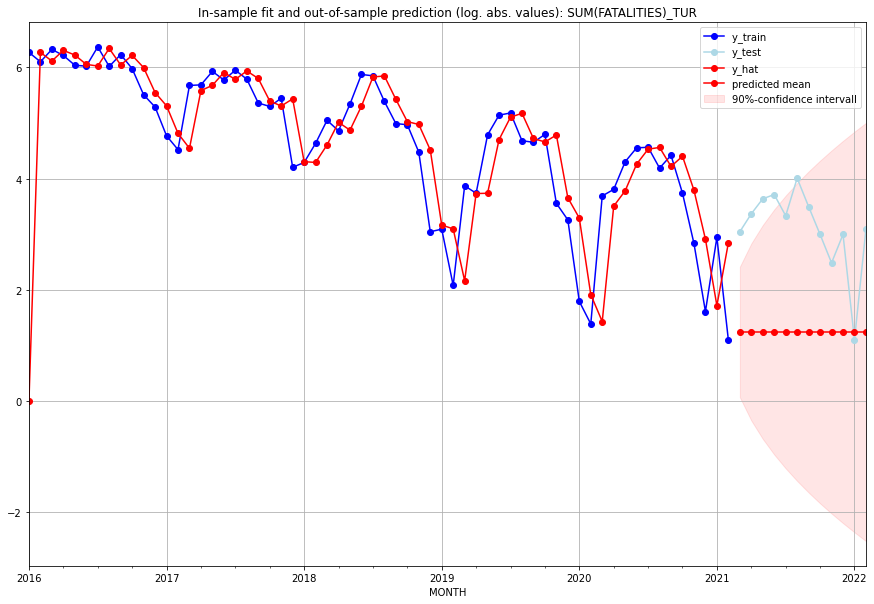

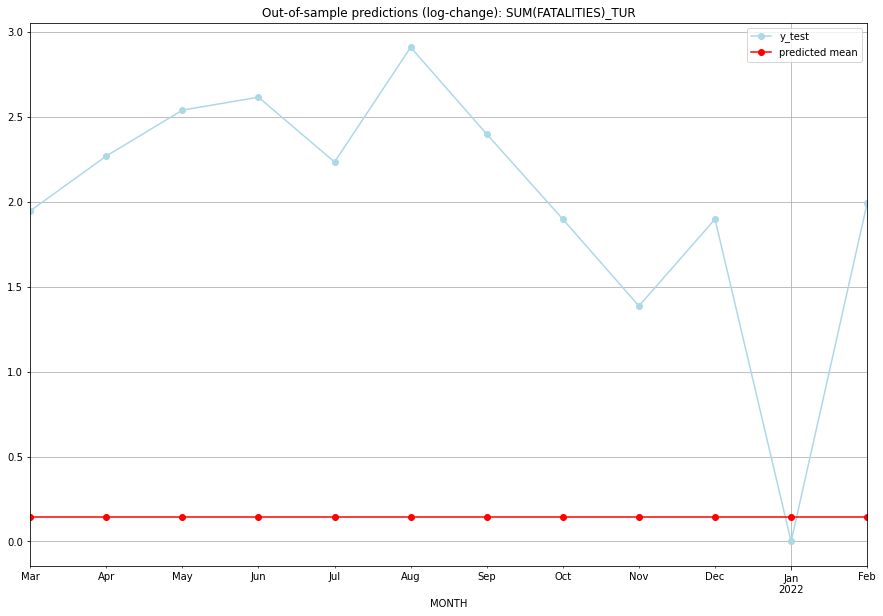

TADDA: 1.8879991405349668
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  2.459705        20.0      0.142571        1.945910   TUR   
1  2021-04-01  2.459705        28.0      0.142571        2.268684   TUR   
2  2021-05-01  2.459705        37.0      0.142571        2.538974   TUR   
3  2021-06-01  2.459705        40.0      0.142571        2.614960   TUR   
4  2021-07-01  2.459705        27.0      0.142571        2.233592   TUR   
5  2021-08-01  2.459705        54.0      0.142571        2.908721   TUR   
6  2021-09-01  2.459705        32.0      0.142571        2.397895   TUR   
7  2021-10-01  2.459705        19.0      0.142571        1.897120   TUR   
8  2021-11-01  2.459705        11.0      0.142571        1.386294   TUR   
9  2021-12-01  2.459705        19.0      0.142571        1.897120   TUR   
10 2022-01-01  2.459705         2.0      0.142571        0.000000   TUR   
11 2022-02-01  2.459705        21.0      0.142571    

<Figure size 432x288 with 0 Axes>

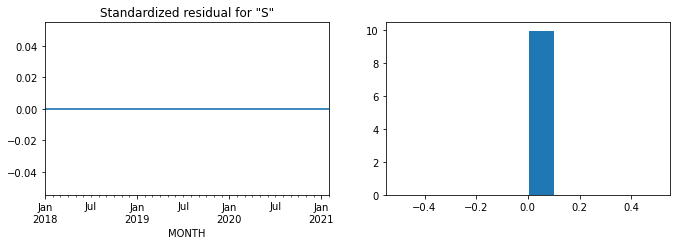

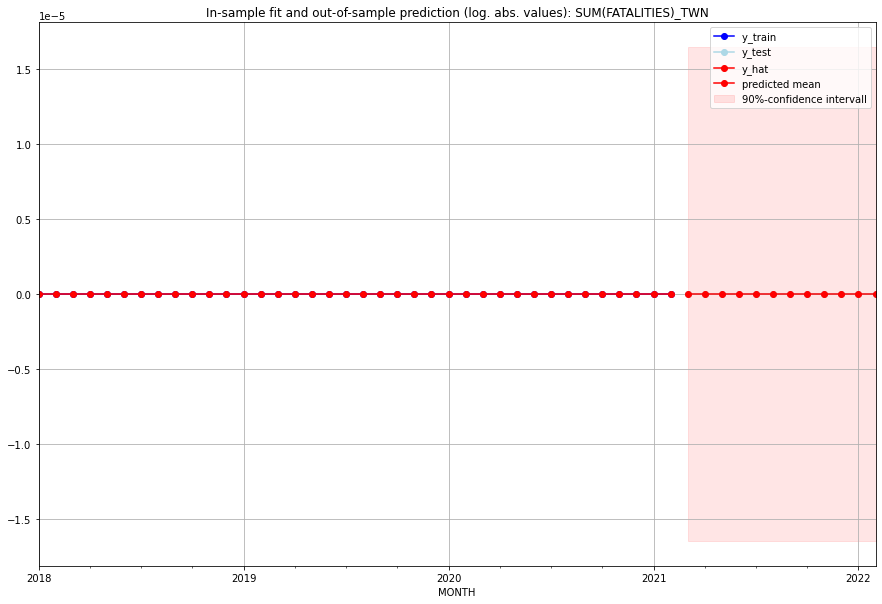

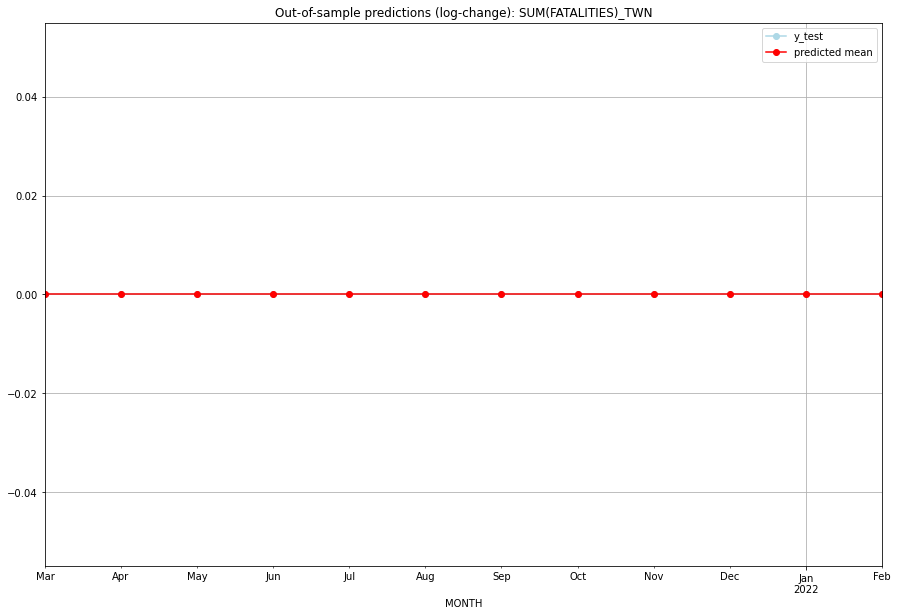

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   TWN   
1  2021-04-01       0.0         0.0           0.0             0.0   TWN   
2  2021-05-01       0.0         0.0           0.0             0.0   TWN   
3  2021-06-01       0.0         0.0           0.0             0.0   TWN   
4  2021-07-01       0.0         0.0           0.0             0.0   TWN   
5  2021-08-01       0.0         0.0           0.0             0.0   TWN   
6  2021-09-01       0.0         0.0           0.0             0.0   TWN   
7  2021-10-01       0.0         0.0           0.0             0.0   TWN   
8  2021-11-01       0.0         0.0           0.0             0.0   TWN   
9  2021-12-01       0.0         0.0           0.0             0.0   TWN   
10 2022-01-01       0.0         0.0           0.0             0.0   TWN   
11 2022-02-01       0.0         0.0           0.0             0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [2, (1, 0, 1), (0, 0, 0, 0), 'n'], 'cv_score': 1.0380311388741887, 'fold_results': [0.8002650251291582, 1.4442612562138162, 0.9414545578395321, 0.7548990814876704, 1.2492757737007671]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_TZA   No. Observations:                  289
Model:                SARIMAX(1, 0, 1)   Log Likelihood                -410.265
Date:                 Wed, 19 Oct 2022   AIC                            830.530
Time:                         11:14:48   BIC                            848.862
Sample:                     02-28-1997   HQIC                           837.876
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------

<Figure size 432x288 with 0 Axes>

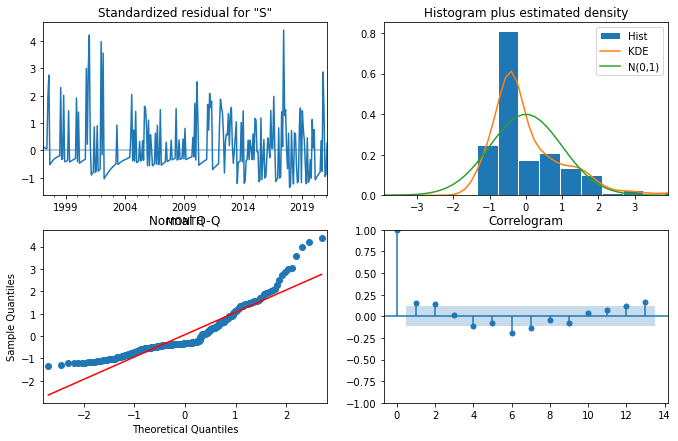

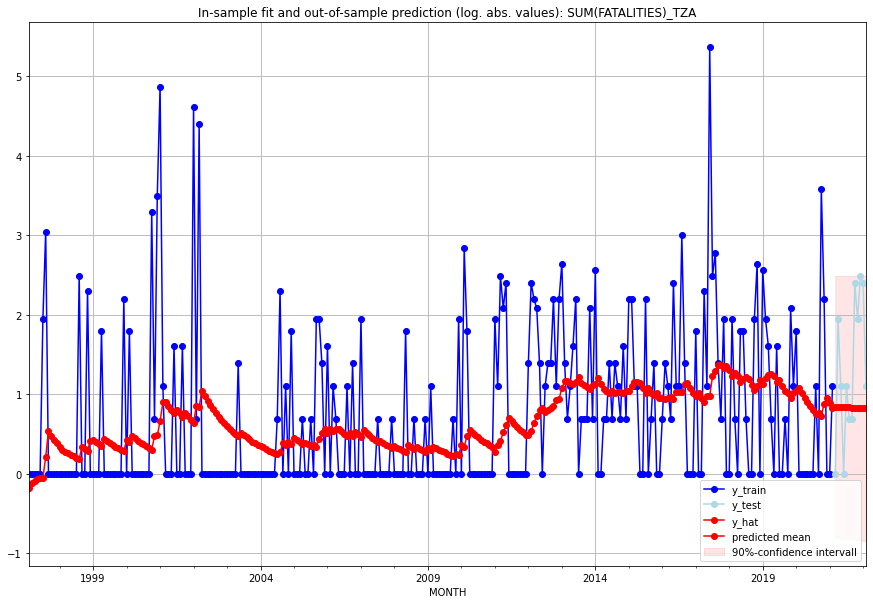

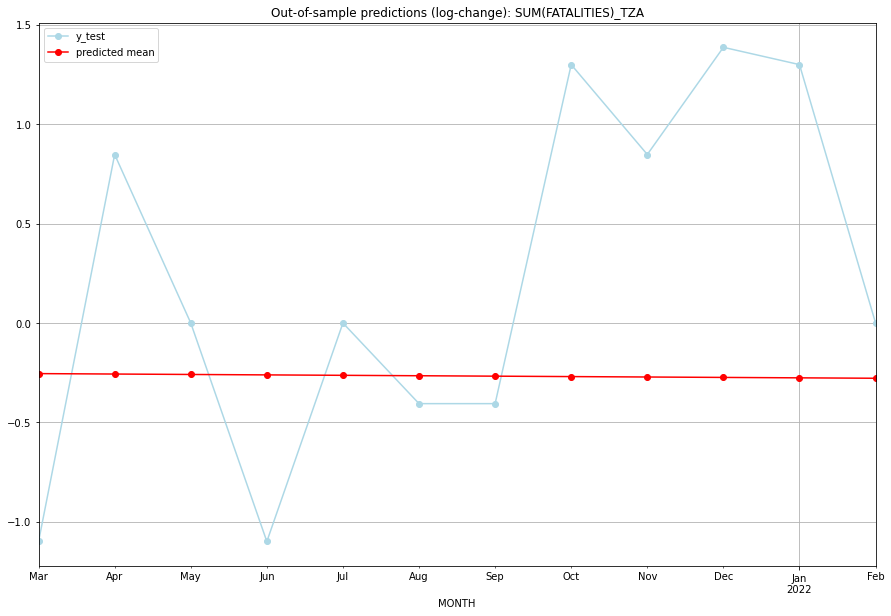

TADDA: 0.9277661932153708
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  1.326065         0.0     -0.254434       -1.098612   TZA   
1  2021-04-01  1.321036         6.0     -0.256599        0.847298   TZA   
2  2021-05-01  1.316037         2.0     -0.258755        0.000000   TZA   
3  2021-06-01  1.311067         0.0     -0.260903       -1.098612   TZA   
4  2021-07-01  1.306126         2.0     -0.263043        0.000000   TZA   
5  2021-08-01  1.301213         1.0     -0.265176       -0.405465   TZA   
6  2021-09-01  1.296329         1.0     -0.267301       -0.405465   TZA   
7  2021-10-01  1.291472        10.0     -0.269418        1.299283   TZA   
8  2021-11-01  1.286644         6.0     -0.271527        0.847298   TZA   
9  2021-12-01  1.281843        11.0     -0.273629        1.386294   TZA   
10 2022-01-01  1.277070        10.0     -0.275723        1.299283   TZA   
11 2022-02-01  1.272324         2.0     -0.277809    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.6942697717144355, 'fold_results': [1.0028587664728958, 1.0477222482707786, 0.37194705474261003, 0.3539413956299396, 0.6948793934559528]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_UGA   No. Observations:                  289
Model:                SARIMAX(0, 1, 0)   Log Likelihood                -486.596
Date:                 Wed, 19 Oct 2022   AIC                            975.191
Time:                         11:15:05   BIC                            978.854
Sample:                     02-28-1997   HQIC                           976.659
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------

<Figure size 432x288 with 0 Axes>

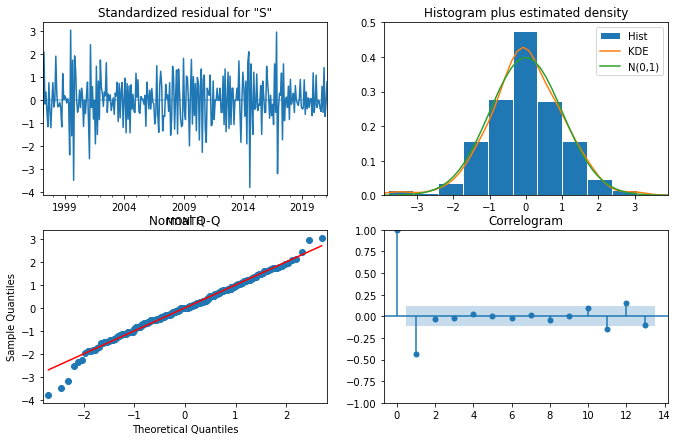

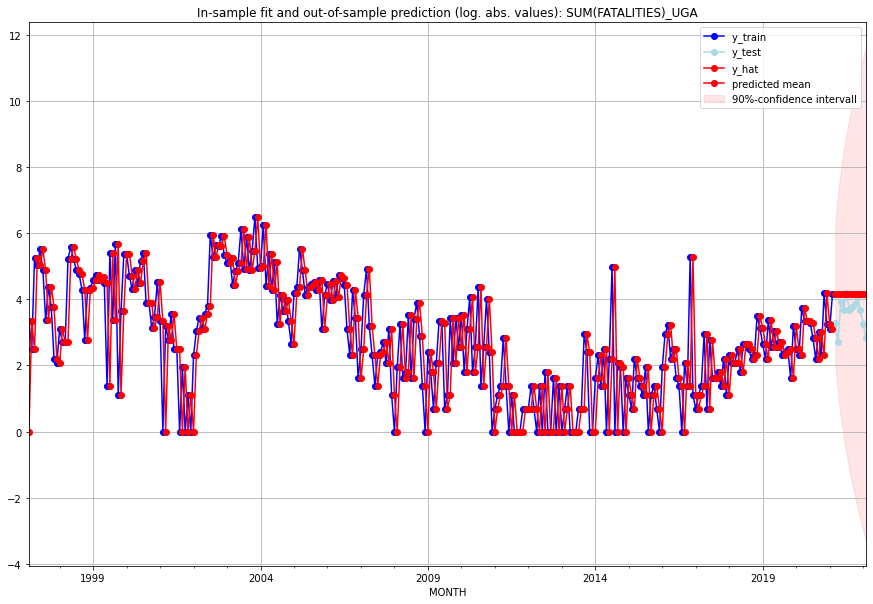

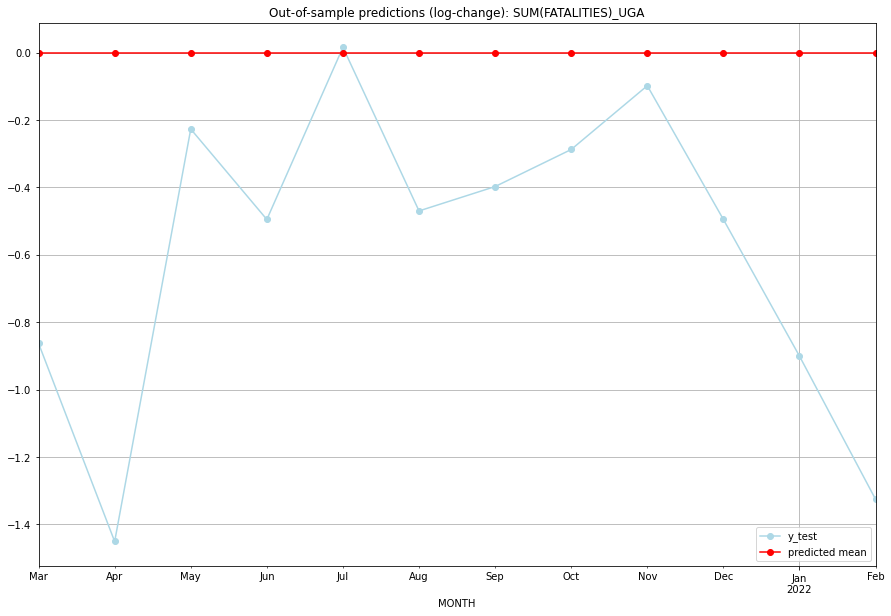

TADDA: 0.5856123865052247
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01      63.0        26.0           0.0       -0.863046   UGA   
1  2021-04-01      63.0        14.0           0.0       -1.450833   UGA   
2  2021-05-01      63.0        50.0           0.0       -0.227057   UGA   
3  2021-06-01      63.0        38.0           0.0       -0.495321   UGA   
4  2021-07-01      63.0        64.0           0.0        0.015504   UGA   
5  2021-08-01      63.0        39.0           0.0       -0.470004   UGA   
6  2021-09-01      63.0        42.0           0.0       -0.397683   UGA   
7  2021-10-01      63.0        47.0           0.0       -0.287682   UGA   
8  2021-11-01      63.0        57.0           0.0       -0.098440   UGA   
9  2021-12-01      63.0        38.0           0.0       -0.495321   UGA   
10 2022-01-01      63.0        25.0           0.0       -0.900787   UGA   
11 2022-02-01      63.0        16.0           0.0    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [1, (3, 0, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.5054574466768547, 'fold_results': [0.5488096168364379, 0.4621052765172715]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_UKR   No. Observations:                   38
Model:                SARIMAX(3, 0, 2)   Log Likelihood                 -25.490
Date:                 Wed, 19 Oct 2022   AIC                             64.981
Time:                         11:15:13   BIC                             76.444
Sample:                     01-31-2018   HQIC                            69.059
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -0.0523      0.

<Figure size 432x288 with 0 Axes>

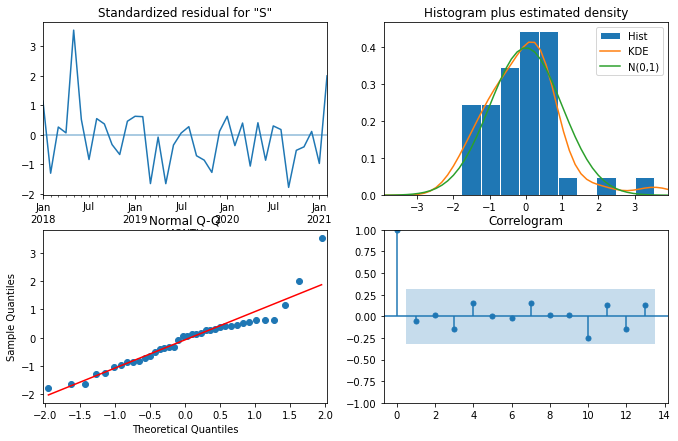

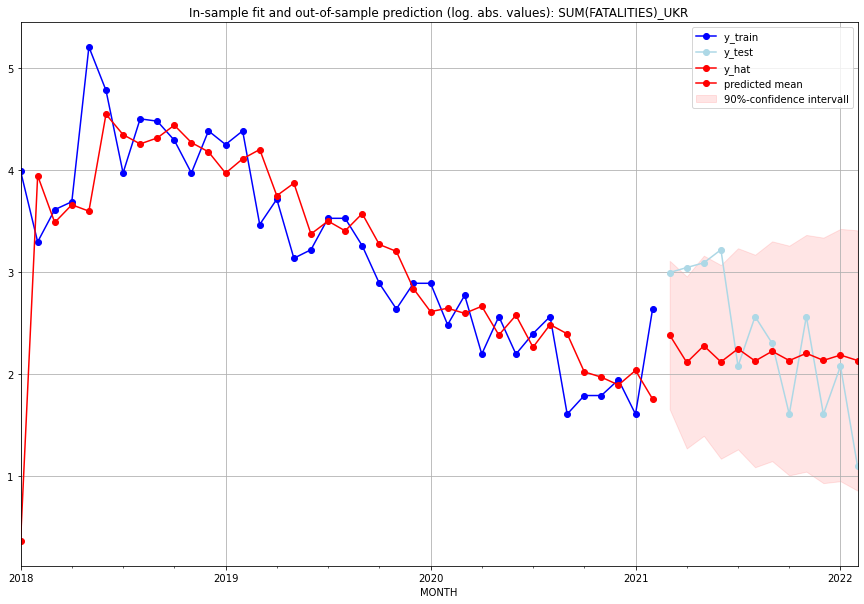

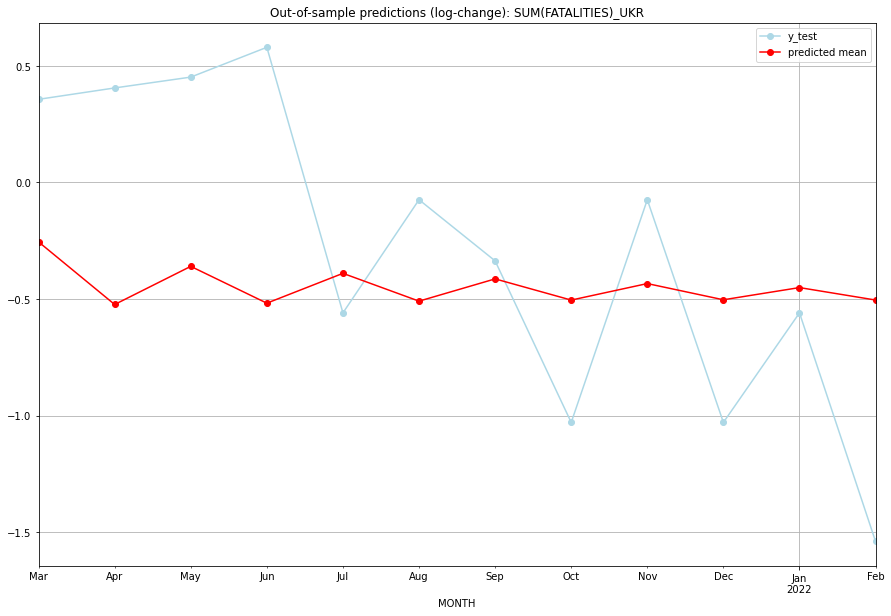

TADDA: 0.6954004401982231
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  9.847445        19.0     -0.255128        0.356675   UKR   
1  2021-04-01  7.293203        20.0     -0.523621        0.405465   UKR   
2  2021-05-01  8.767511        21.0     -0.359996        0.451985   UKR   
3  2021-06-01  7.340514        24.0     -0.517933        0.579818   UKR   
4  2021-07-01  8.479273         7.0     -0.389950       -0.559616   UKR   
5  2021-08-01  7.413213        12.0     -0.509254       -0.074108   UKR   
6  2021-09-01  8.255873         9.0     -0.413799       -0.336472   UKR   
7  2021-10-01  7.451460         4.0     -0.504718       -1.029619   UKR   
8  2021-11-01  8.072074        12.0     -0.433856       -0.074108   UKR   
9  2021-12-01  7.462612         4.0     -0.503399       -1.029619   UKR   
10 2022-01-01  7.917311         7.0     -0.451063       -0.559616   UKR   
11 2022-02-01  7.453314         2.0     -0.504499    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [2, (0, 1, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.0, 'fold_results': [nan, 0.0]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_URY   No. Observations:                   38
Model:                SARIMAX(0, 1, 3)   Log Likelihood                  12.111
Date:                 Wed, 19 Oct 2022   AIC                            -12.222
Time:                         11:15:22   BIC                             -2.557
Sample:                     01-31-2018   HQIC                            -8.815
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -0.0044      0.025     -0.174      0.862      -0.054       0

<Figure size 432x288 with 0 Axes>

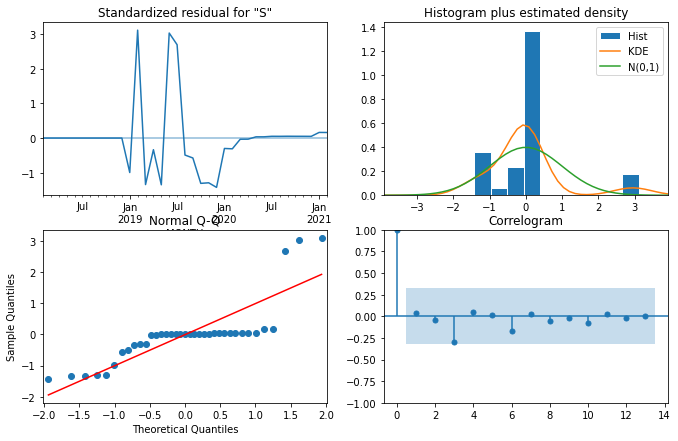

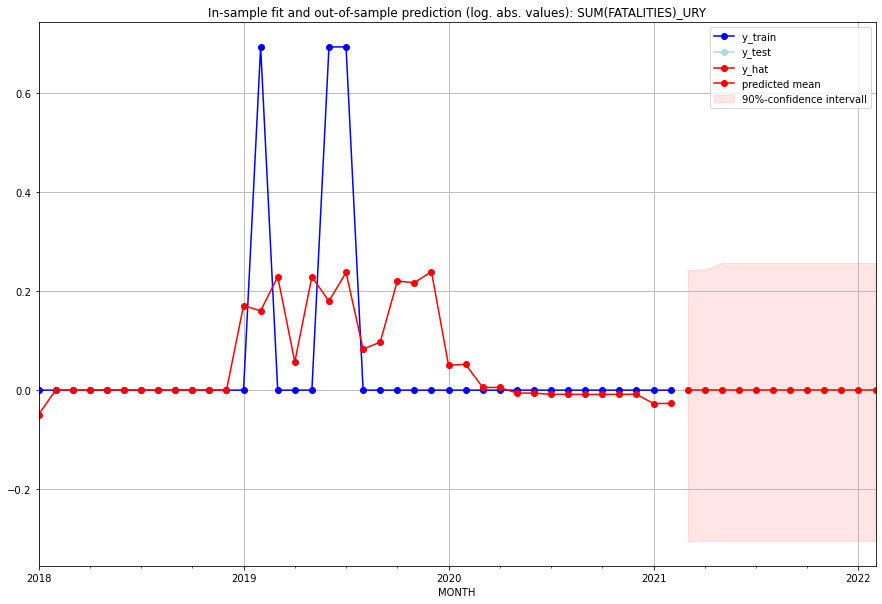

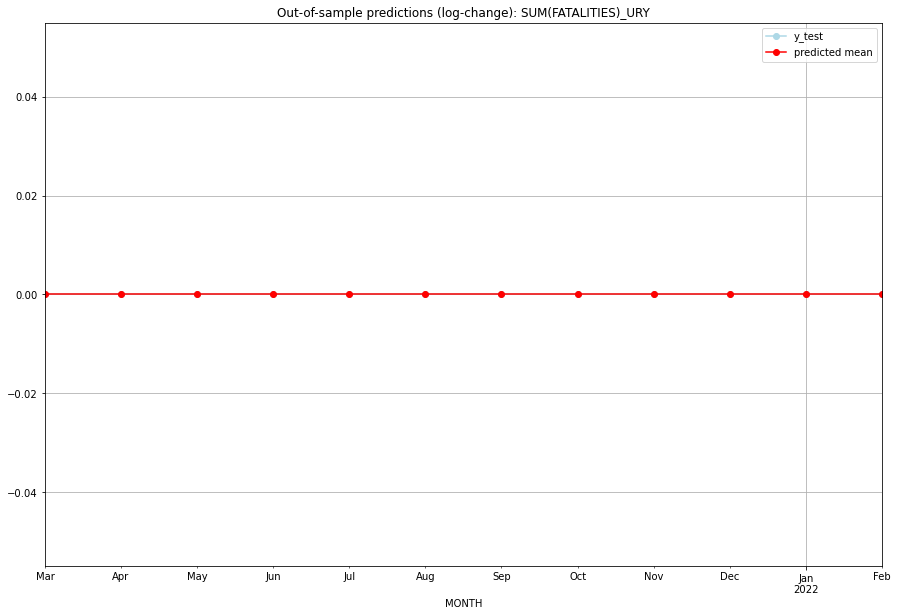

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   URY   
1  2021-04-01       0.0         0.0           0.0             0.0   URY   
2  2021-05-01       0.0         0.0           0.0             0.0   URY   
3  2021-06-01       0.0         0.0           0.0             0.0   URY   
4  2021-07-01       0.0         0.0           0.0             0.0   URY   
5  2021-08-01       0.0         0.0           0.0             0.0   URY   
6  2021-09-01       0.0         0.0           0.0             0.0   URY   
7  2021-10-01       0.0         0.0           0.0             0.0   URY   
8  2021-11-01       0.0         0.0           0.0             0.0   URY   
9  2021-12-01       0.0         0.0           0.0             0.0   URY   
10 2022-01-01       0.0         0.0           0.0             0.0   URY   
11 2022-02-01       0.0         0.0           0.0             0.0   

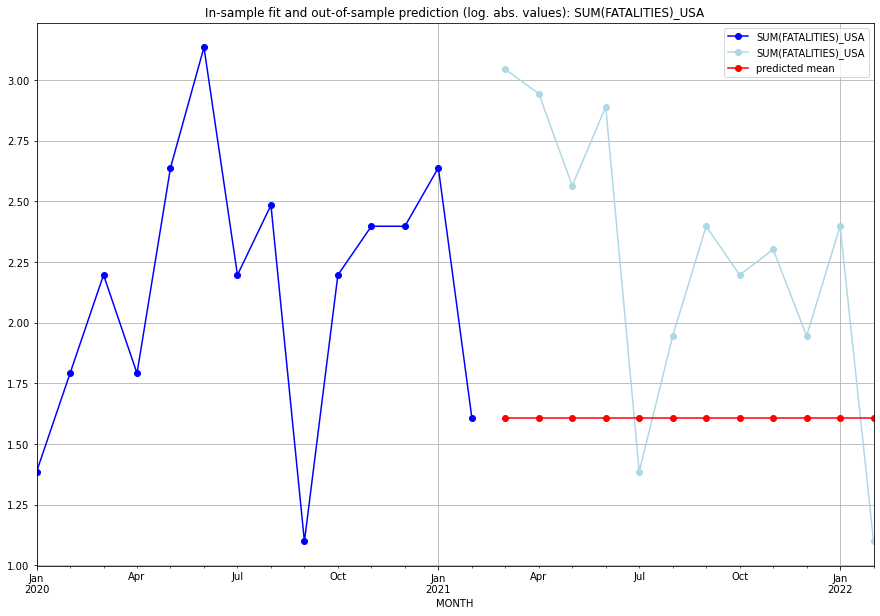

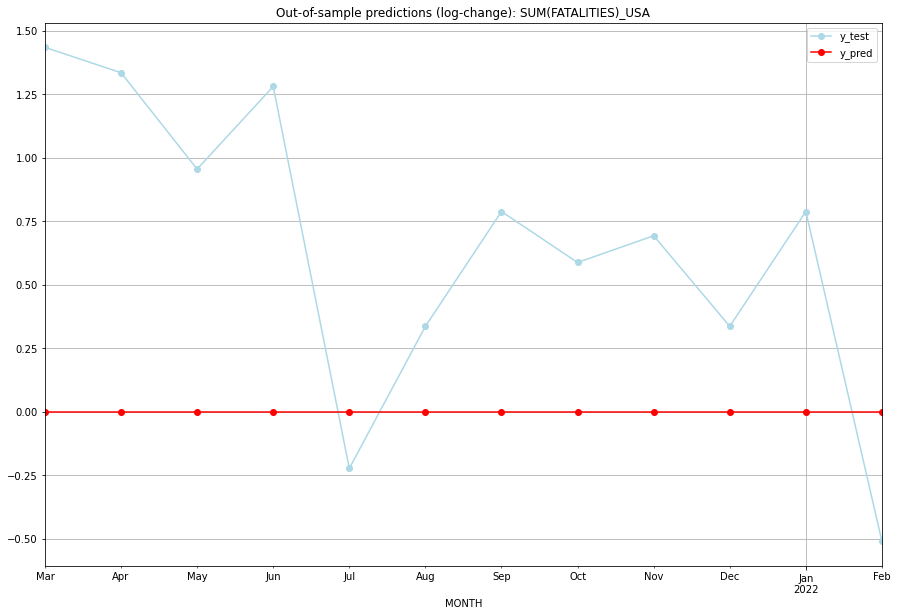

TADDA: 0.772607758085366
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  1.609438    3.044522           0.0        1.435085   USA   
1  2021-04-01  1.609438    2.944439           0.0        1.335001   USA   
2  2021-05-01  1.609438    2.564949           0.0        0.955511   USA   
3  2021-06-01  1.609438    2.890372           0.0        1.280934   USA   
4  2021-07-01  1.609438    1.386294           0.0       -0.223144   USA   
5  2021-08-01  1.609438    1.945910           0.0        0.336472   USA   
6  2021-09-01  1.609438    2.397895           0.0        0.788457   USA   
7  2021-10-01  1.609438    2.197225           0.0        0.587787   USA   
8  2021-11-01  1.609438    2.302585           0.0        0.693147   USA   
9  2021-12-01  1.609438    1.945910           0.0        0.336472   USA   
10 2022-01-01  1.609438    2.397895           0.0        0.788457   USA   
11 2022-02-01  1.609438    1.098612           0.0     

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.20707555414900003, 'fold_results': [0.20707555414900003, 0.20707555414900003]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_UZB   No. Observations:                   38
Model:                         SARIMAX   Log Likelihood                 -14.673
Date:                 Wed, 19 Oct 2022   AIC                             31.346
Time:                         11:15:29   BIC                             32.984
Sample:                     01-31-2018   HQIC                            31.929
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.1267     

<Figure size 432x288 with 0 Axes>

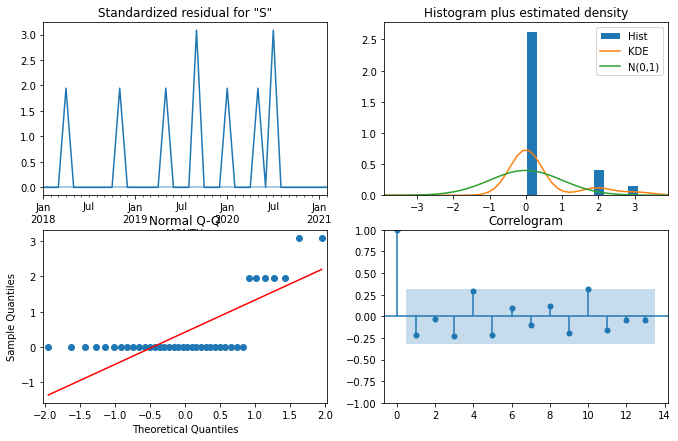

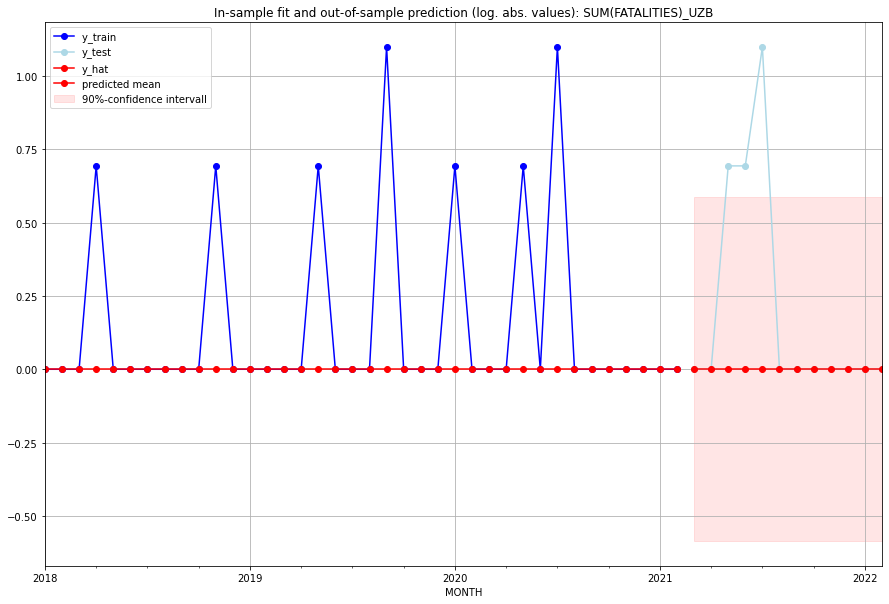

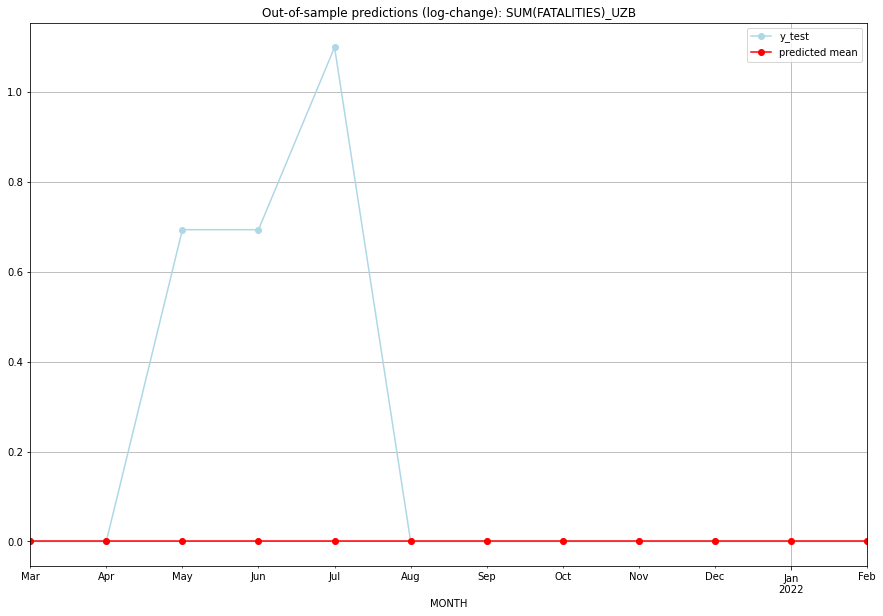

TADDA: 0.20707555414900003
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0        0.000000   UZB   
1  2021-04-01       0.0         0.0           0.0        0.000000   UZB   
2  2021-05-01       0.0         1.0           0.0        0.693147   UZB   
3  2021-06-01       0.0         1.0           0.0        0.693147   UZB   
4  2021-07-01       0.0         2.0           0.0        1.098612   UZB   
5  2021-08-01       0.0         0.0           0.0        0.000000   UZB   
6  2021-09-01       0.0         0.0           0.0        0.000000   UZB   
7  2021-10-01       0.0         0.0           0.0        0.000000   UZB   
8  2021-11-01       0.0         0.0           0.0        0.000000   UZB   
9  2021-12-01       0.0         0.0           0.0        0.000000   UZB   
10 2022-01-01       0.0         0.0           0.0        0.000000   UZB   
11 2022-02-01       0.0         0.0           0.0   

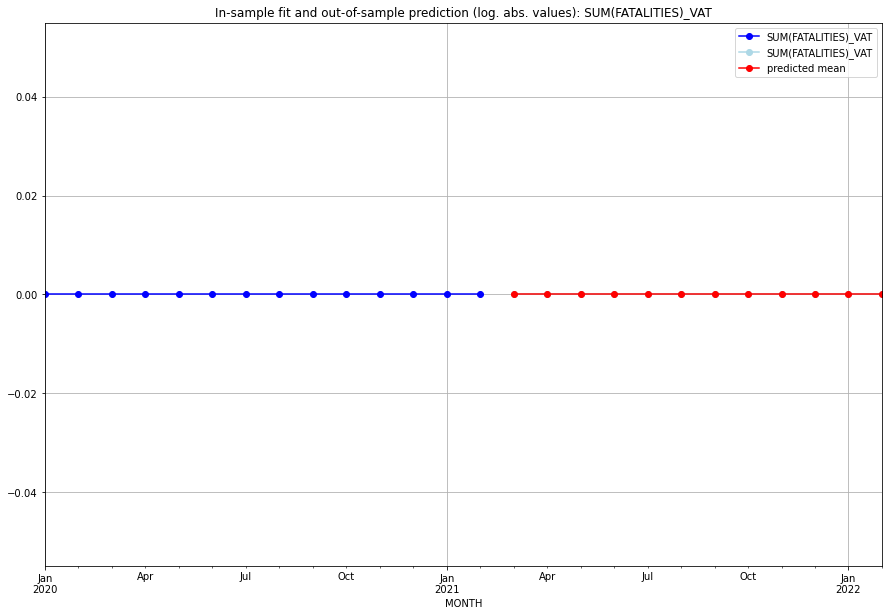

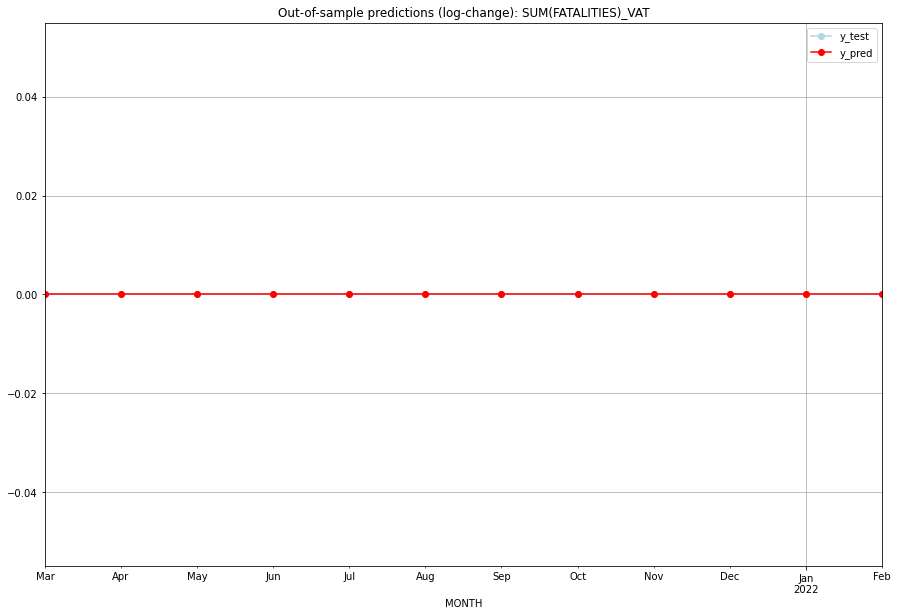

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   VAT   
1  2021-04-01       0.0         0.0           0.0             0.0   VAT   
2  2021-05-01       0.0         0.0           0.0             0.0   VAT   
3  2021-06-01       0.0         0.0           0.0             0.0   VAT   
4  2021-07-01       0.0         0.0           0.0             0.0   VAT   
5  2021-08-01       0.0         0.0           0.0             0.0   VAT   
6  2021-09-01       0.0         0.0           0.0             0.0   VAT   
7  2021-10-01       0.0         0.0           0.0             0.0   VAT   
8  2021-11-01       0.0         0.0           0.0             0.0   VAT   
9  2021-12-01       0.0         0.0           0.0             0.0   VAT   
10 2022-01-01       0.0         0.0           0.0             0.0   VAT   
11 2022-02-01       0.0         0.0           0.0             0.0   

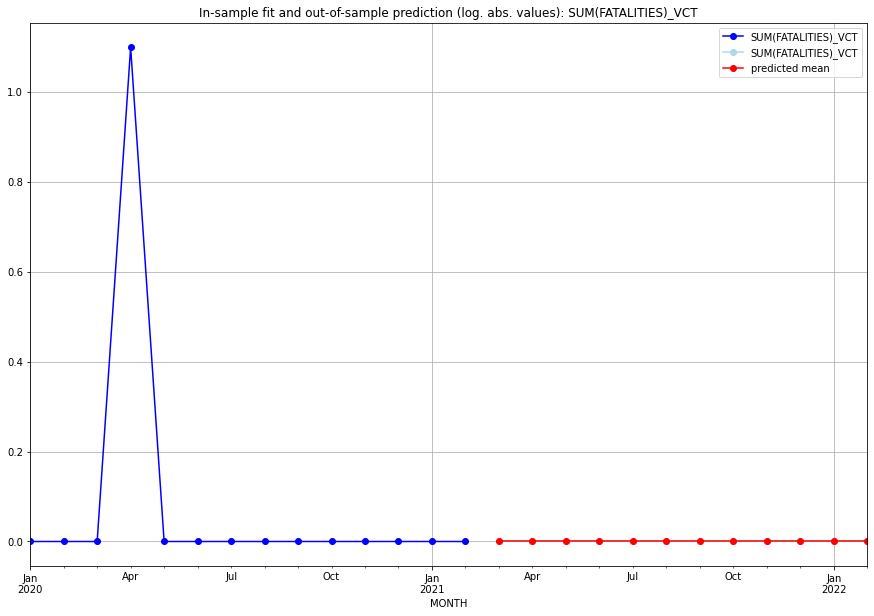

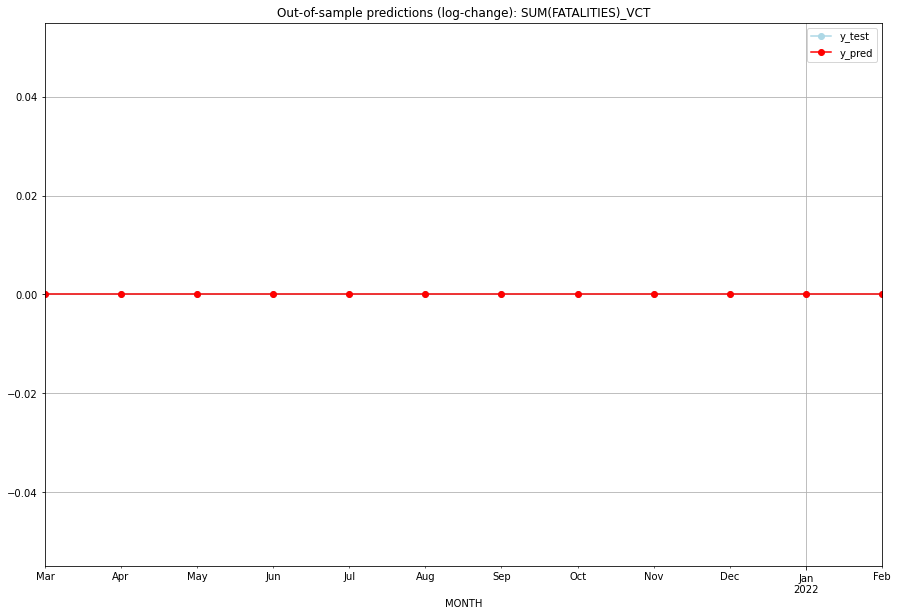

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   VCT   
1  2021-04-01       0.0         0.0           0.0             0.0   VCT   
2  2021-05-01       0.0         0.0           0.0             0.0   VCT   
3  2021-06-01       0.0         0.0           0.0             0.0   VCT   
4  2021-07-01       0.0         0.0           0.0             0.0   VCT   
5  2021-08-01       0.0         0.0           0.0             0.0   VCT   
6  2021-09-01       0.0         0.0           0.0             0.0   VCT   
7  2021-10-01       0.0         0.0           0.0             0.0   VCT   
8  2021-11-01       0.0         0.0           0.0             0.0   VCT   
9  2021-12-01       0.0         0.0           0.0             0.0   VCT   
10 2022-01-01       0.0         0.0           0.0             0.0   VCT   
11 2022-02-01       0.0         0.0           0.0             0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [2, (1, 0, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.6245371669381119, 'fold_results': [0.3540566307487891, 0.8950177031274348]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_VEN   No. Observations:                   38
Model:                SARIMAX(1, 0, 3)   Log Likelihood                 -29.147
Date:                 Wed, 19 Oct 2022   AIC                             72.294
Time:                         11:15:37   BIC                             83.757
Sample:                     01-31-2018   HQIC                            76.372
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             0.0144      0.

<Figure size 432x288 with 0 Axes>

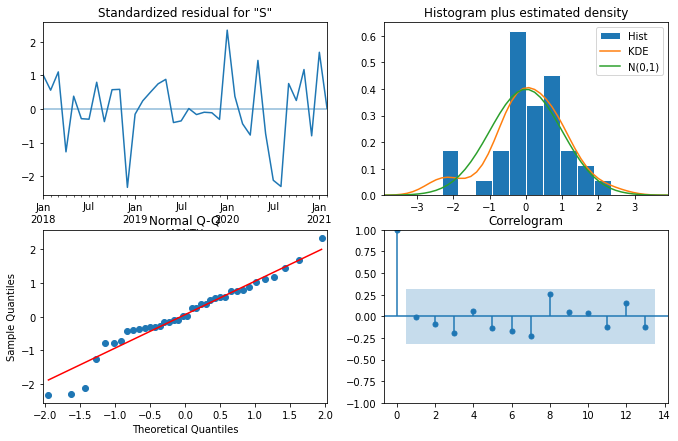

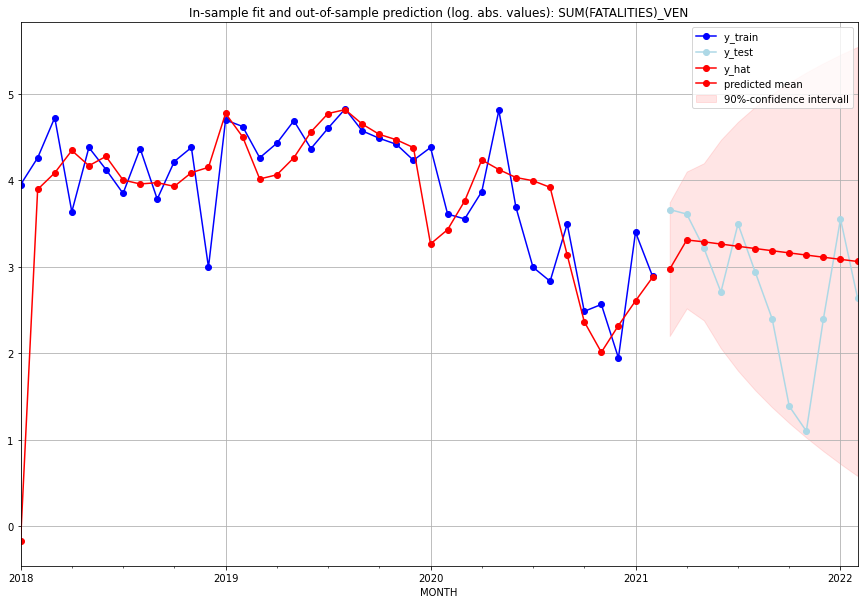

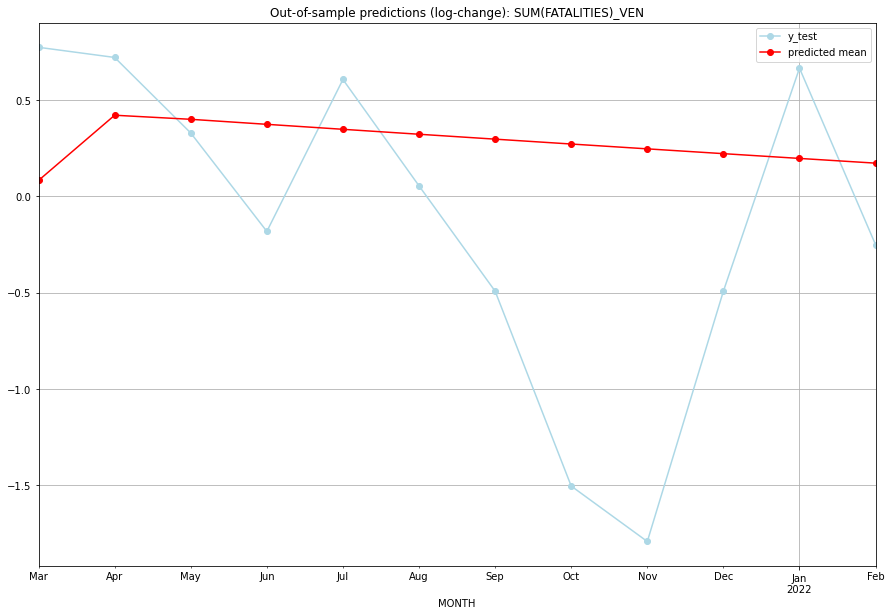

TADDA: 0.8276657595502169
Evaluation finished.
        MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  18.544787        38.0      0.082337        0.773190   VEN   
1  2021-04-01  26.413853        36.0      0.420677        0.720546   VEN   
2  2021-05-01  25.839196        24.0      0.399492        0.328504   VEN   
3  2021-06-01  25.149501        14.0      0.373458       -0.182322   VEN   
4  2021-07-01  24.482395        32.0      0.347616        0.606136   VEN   
5  2021-08-01  23.837016        18.0      0.321963        0.054067   VEN   
6  2021-09-01  23.212537        10.0      0.296499       -0.492476   VEN   
7  2021-10-01  22.608169         3.0      0.271221       -1.504077   VEN   
8  2021-11-01  22.023155         2.0      0.246129       -1.791759   VEN   
9  2021-12-01  21.456771        10.0      0.221220       -0.492476   VEN   
10 2022-01-01  20.908323        34.0      0.196495        0.664976   VEN   
11 2022-02-01  20.377145        13.0     

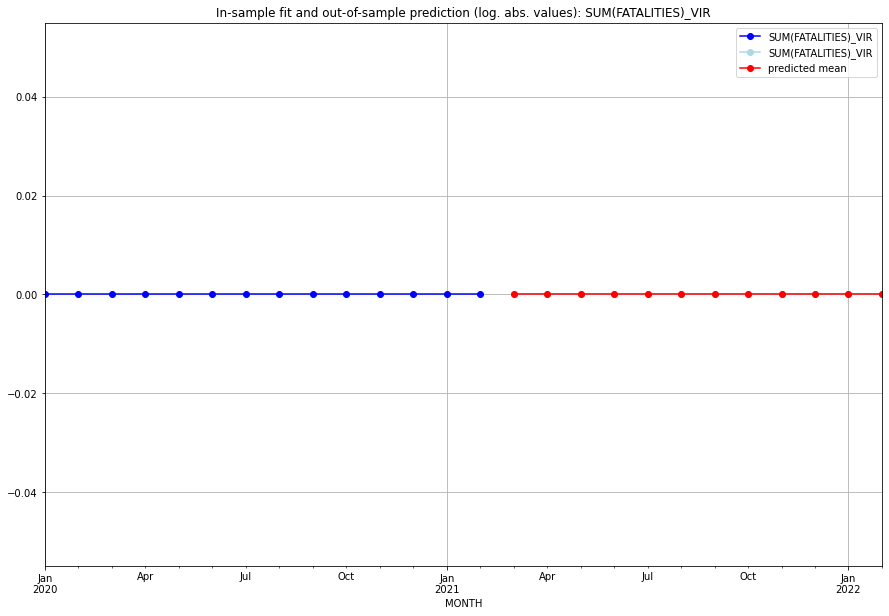

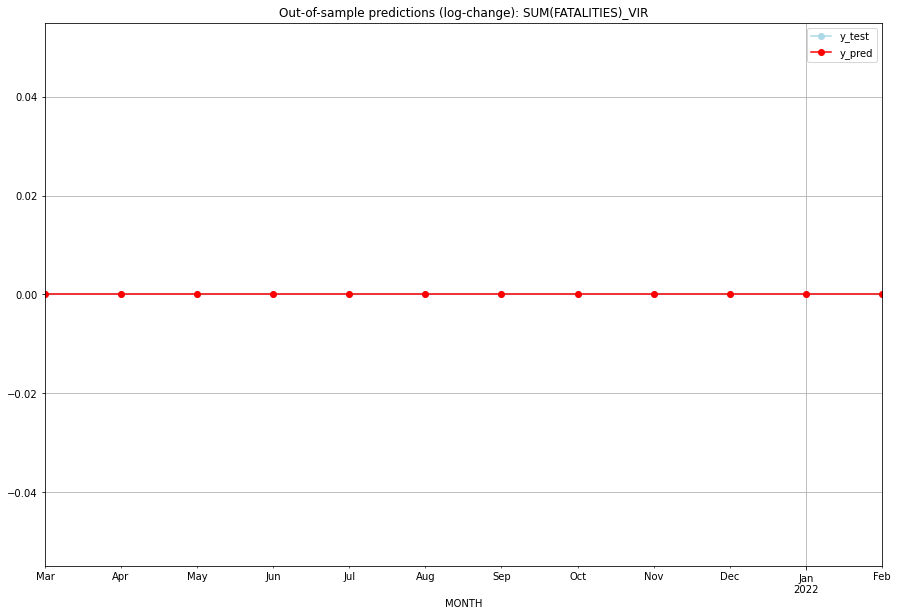

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   VIR   
1  2021-04-01       0.0         0.0           0.0             0.0   VIR   
2  2021-05-01       0.0         0.0           0.0             0.0   VIR   
3  2021-06-01       0.0         0.0           0.0             0.0   VIR   
4  2021-07-01       0.0         0.0           0.0             0.0   VIR   
5  2021-08-01       0.0         0.0           0.0             0.0   VIR   
6  2021-09-01       0.0         0.0           0.0             0.0   VIR   
7  2021-10-01       0.0         0.0           0.0             0.0   VIR   
8  2021-11-01       0.0         0.0           0.0             0.0   VIR   
9  2021-12-01       0.0         0.0           0.0             0.0   VIR   
10 2022-01-01       0.0         0.0           0.0             0.0   VIR   
11 2022-02-01       0.0         0.0           0.0             0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.14910624710236195, 'fold_results': [0.23104906018664842, 0.17328679513998632, 0.1493132891023379, 0.19188209108283716, 0.0]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_VNM   No. Observations:                  134
Model:                         SARIMAX   Log Likelihood                -132.136
Date:                 Wed, 19 Oct 2022   AIC                            266.272
Time:                         11:15:51   BIC                            269.170
Sample:                     01-31-2010   HQIC                           267.449
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------

<Figure size 432x288 with 0 Axes>

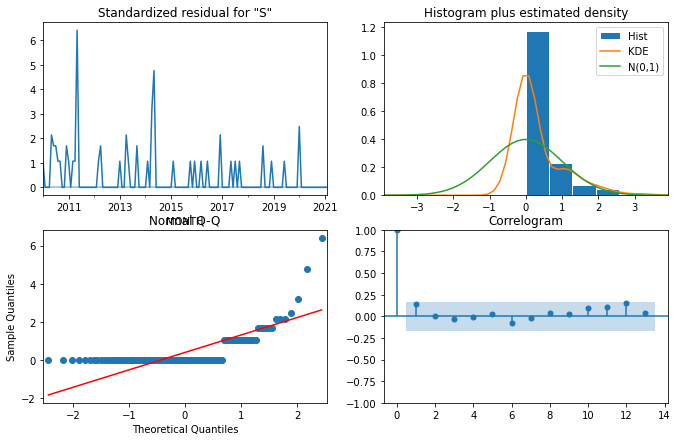

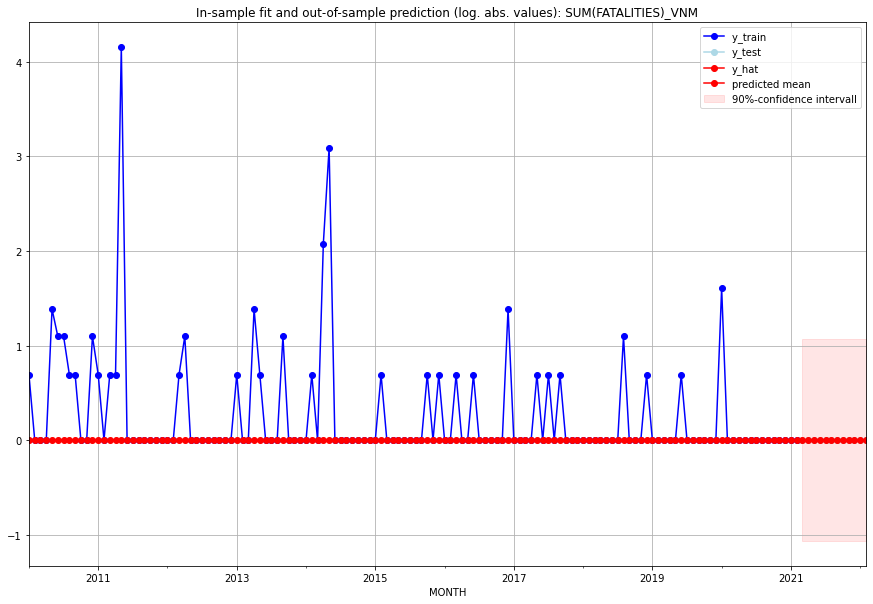

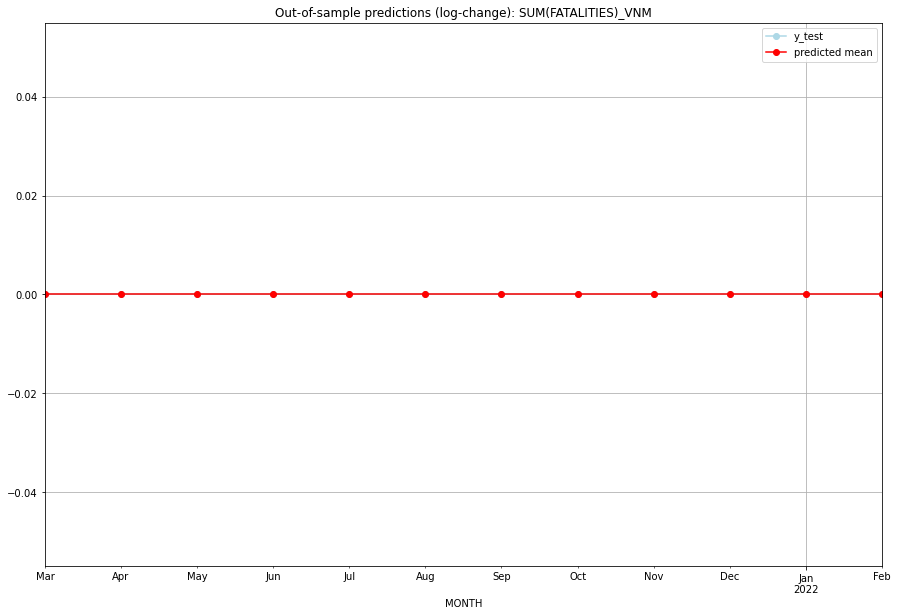

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   VNM   
1  2021-04-01       0.0         0.0           0.0             0.0   VNM   
2  2021-05-01       0.0         0.0           0.0             0.0   VNM   
3  2021-06-01       0.0         0.0           0.0             0.0   VNM   
4  2021-07-01       0.0         0.0           0.0             0.0   VNM   
5  2021-08-01       0.0         0.0           0.0             0.0   VNM   
6  2021-09-01       0.0         0.0           0.0             0.0   VNM   
7  2021-10-01       0.0         0.0           0.0             0.0   VNM   
8  2021-11-01       0.0         0.0           0.0             0.0   VNM   
9  2021-12-01       0.0         0.0           0.0             0.0   VNM   
10 2022-01-01       0.0         0.0           0.0             0.0   VNM   
11 2022-02-01       0.0         0.0           0.0             0.0   

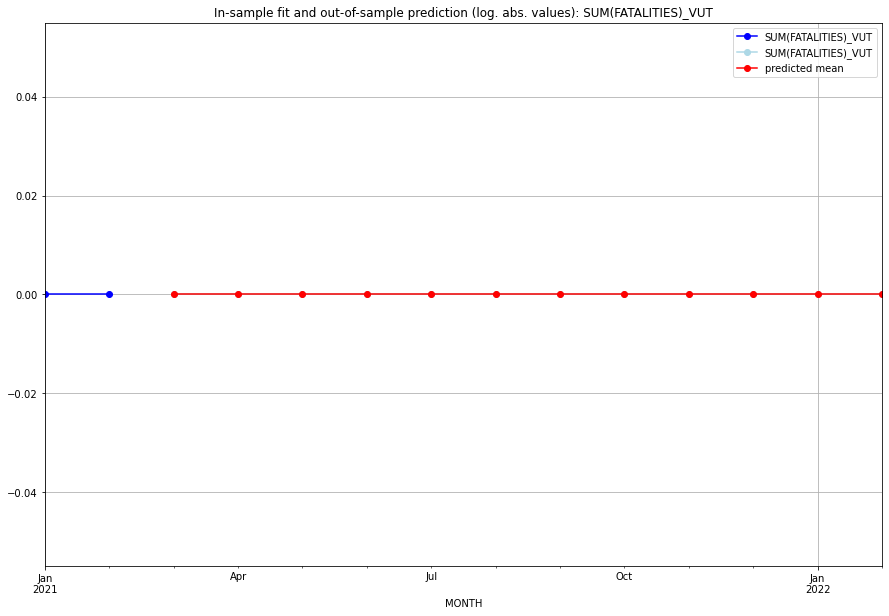

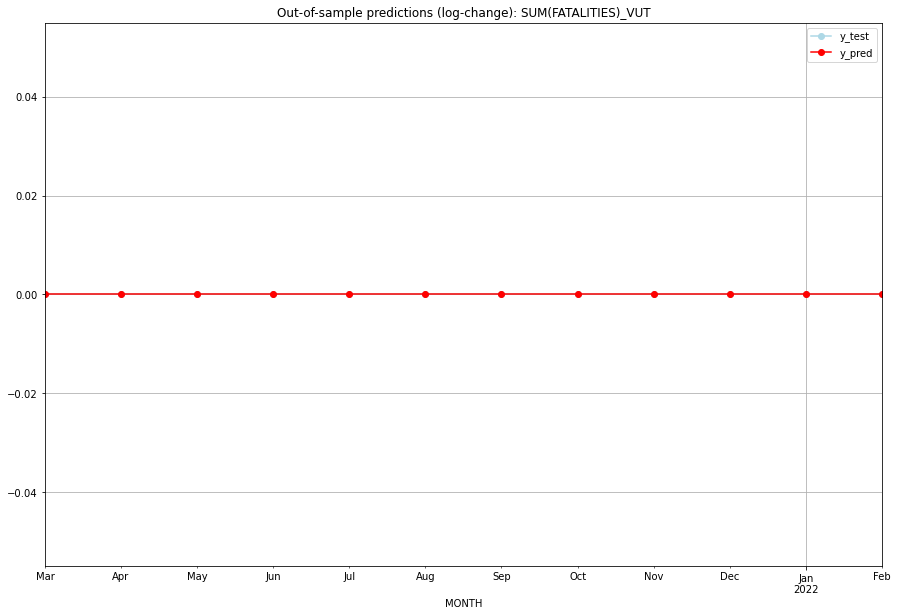

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   VUT   
1  2021-04-01       0.0         0.0           0.0             0.0   VUT   
2  2021-05-01       0.0         0.0           0.0             0.0   VUT   
3  2021-06-01       0.0         0.0           0.0             0.0   VUT   
4  2021-07-01       0.0         0.0           0.0             0.0   VUT   
5  2021-08-01       0.0         0.0           0.0             0.0   VUT   
6  2021-09-01       0.0         0.0           0.0             0.0   VUT   
7  2021-10-01       0.0         0.0           0.0             0.0   VUT   
8  2021-11-01       0.0         0.0           0.0             0.0   VUT   
9  2021-12-01       0.0         0.0           0.0             0.0   VUT   
10 2022-01-01       0.0         0.0           0.0             0.0   VUT   
11 2022-02-01       0.0         0.0           0.0             0.0   

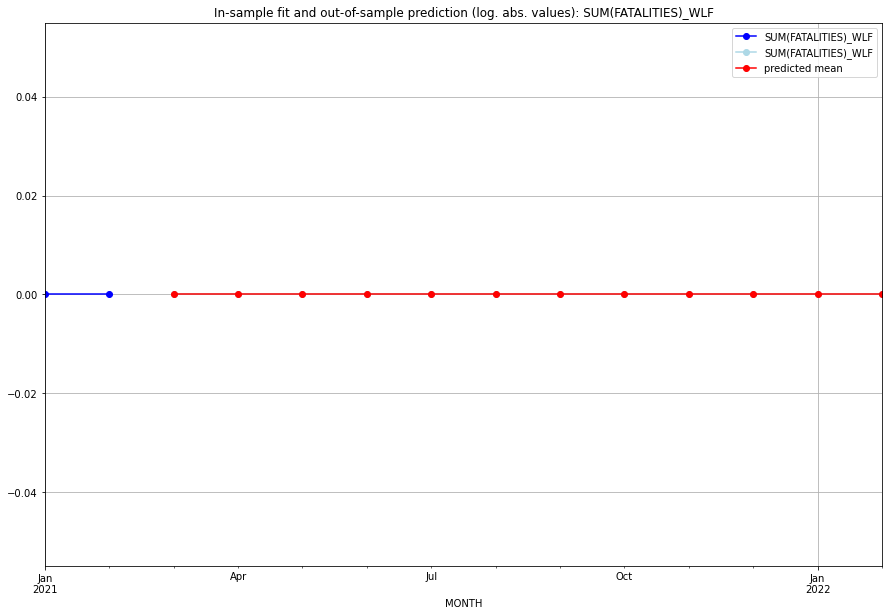

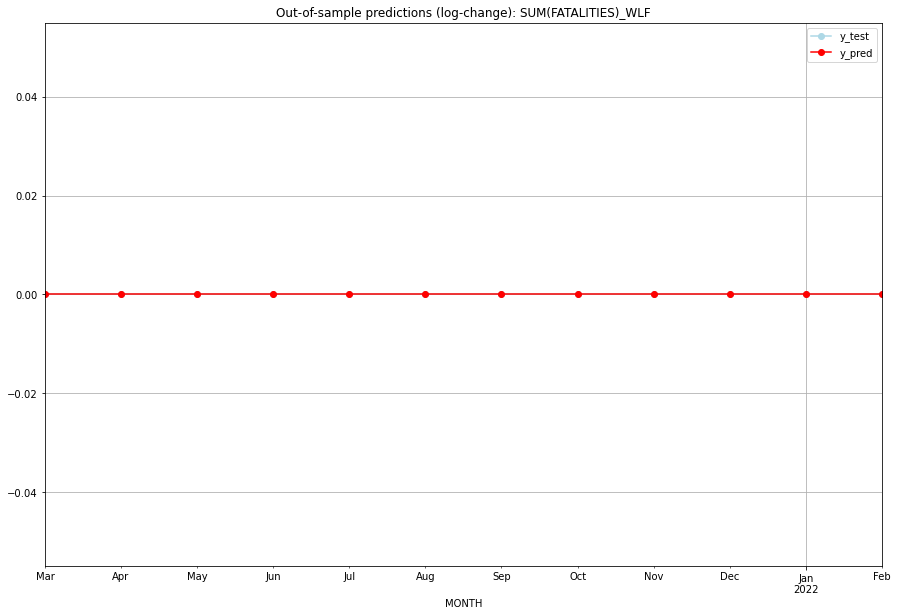

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   WLF   
1  2021-04-01       0.0         0.0           0.0             0.0   WLF   
2  2021-05-01       0.0         0.0           0.0             0.0   WLF   
3  2021-06-01       0.0         0.0           0.0             0.0   WLF   
4  2021-07-01       0.0         0.0           0.0             0.0   WLF   
5  2021-08-01       0.0         0.0           0.0             0.0   WLF   
6  2021-09-01       0.0         0.0           0.0             0.0   WLF   
7  2021-10-01       0.0         0.0           0.0             0.0   WLF   
8  2021-11-01       0.0         0.0           0.0             0.0   WLF   
9  2021-12-01       0.0         0.0           0.0             0.0   WLF   
10 2022-01-01       0.0         0.0           0.0             0.0   WLF   
11 2022-02-01       0.0         0.0           0.0             0.0   

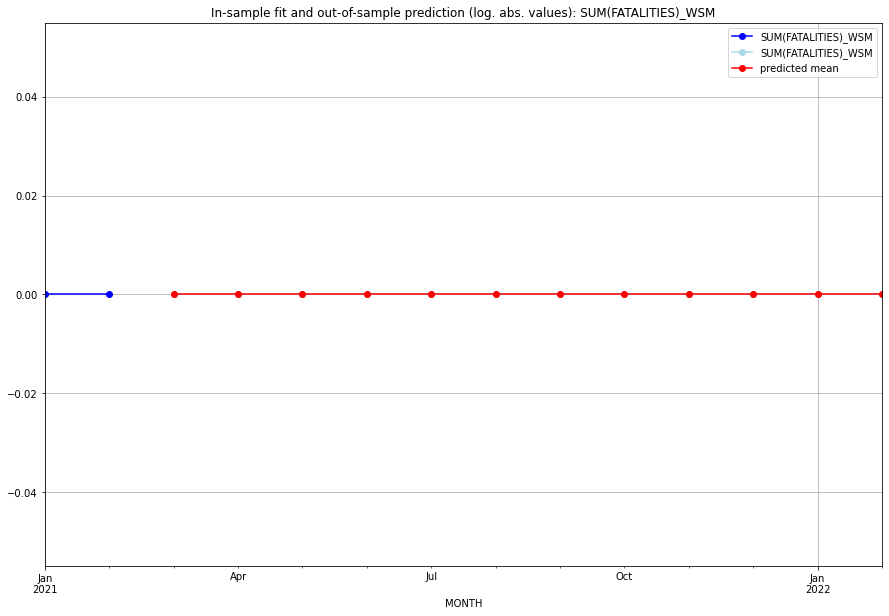

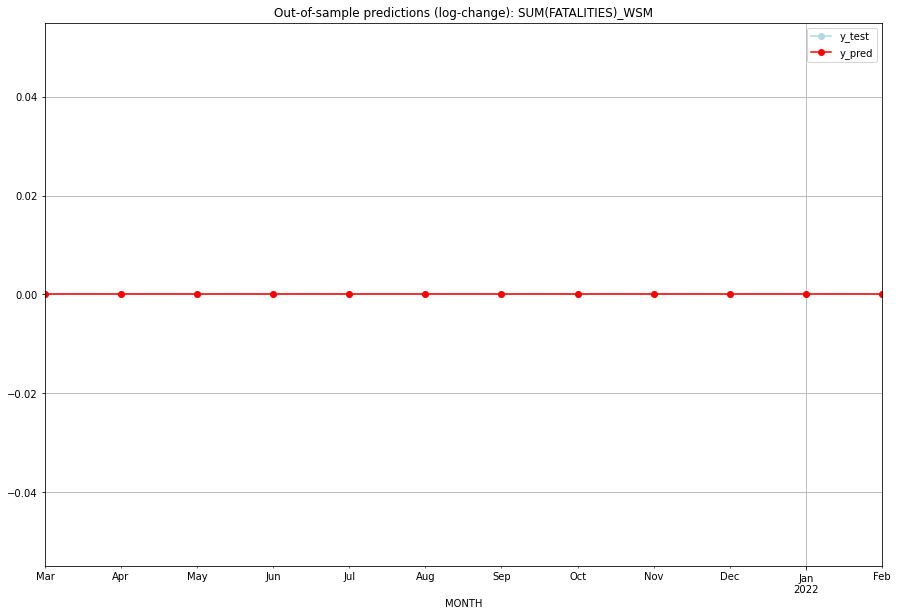

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   WSM   
1  2021-04-01       0.0         0.0           0.0             0.0   WSM   
2  2021-05-01       0.0         0.0           0.0             0.0   WSM   
3  2021-06-01       0.0         0.0           0.0             0.0   WSM   
4  2021-07-01       0.0         0.0           0.0             0.0   WSM   
5  2021-08-01       0.0         0.0           0.0             0.0   WSM   
6  2021-09-01       0.0         0.0           0.0             0.0   WSM   
7  2021-10-01       0.0         0.0           0.0             0.0   WSM   
8  2021-11-01       0.0         0.0           0.0             0.0   WSM   
9  2021-12-01       0.0         0.0           0.0             0.0   WSM   
10 2022-01-01       0.0         0.0           0.0             0.0   WSM   
11 2022-02-01       0.0         0.0           0.0             0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.7231088296192528, 'fold_results': [0.7161795193793639, 0.8654928084817018, 0.3226000842423243, 1.1630008016586992, 0.5482709343341752]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_XAR   No. Observations:                  289
Model:                         SARIMAX   Log Likelihood                -441.847
Date:                 Wed, 19 Oct 2022   AIC                            885.694
Time:                         11:16:07   BIC                            889.361
Sample:                     02-28-1997   HQIC                           887.163
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------

<Figure size 432x288 with 0 Axes>

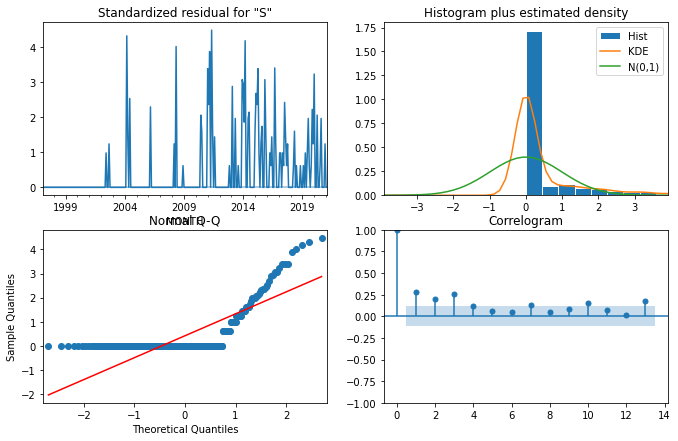

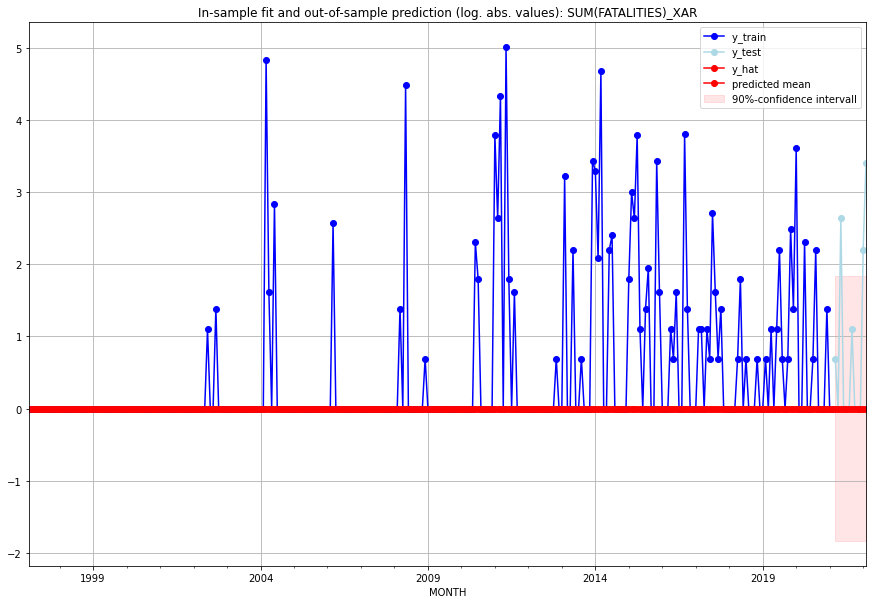

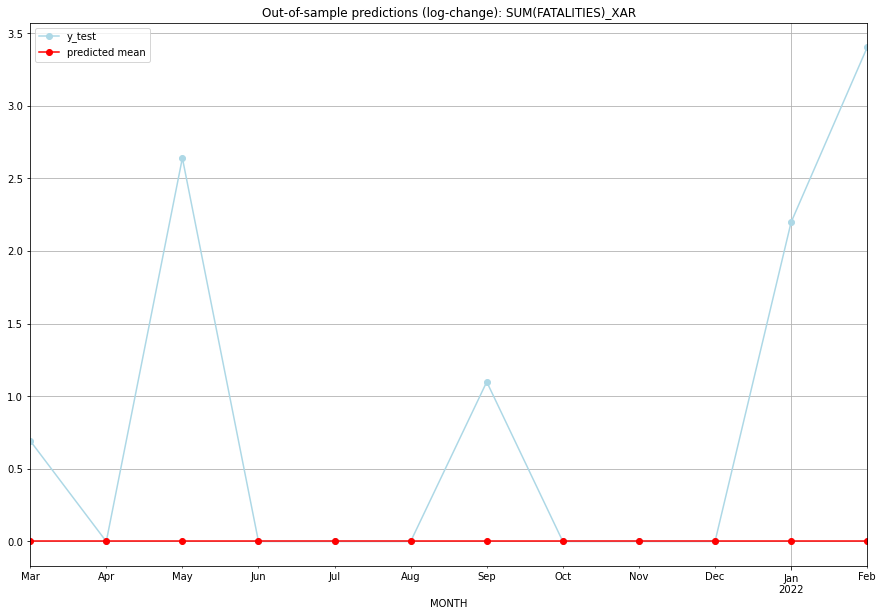

TADDA: 0.8357698964868074
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         1.0           0.0        0.693147   XAR   
1  2021-04-01       0.0         0.0           0.0        0.000000   XAR   
2  2021-05-01       0.0        13.0           0.0        2.639057   XAR   
3  2021-06-01       0.0         0.0           0.0        0.000000   XAR   
4  2021-07-01       0.0         0.0           0.0        0.000000   XAR   
5  2021-08-01       0.0         0.0           0.0        0.000000   XAR   
6  2021-09-01       0.0         2.0           0.0        1.098612   XAR   
7  2021-10-01       0.0         0.0           0.0        0.000000   XAR   
8  2021-11-01       0.0         0.0           0.0        0.000000   XAR   
9  2021-12-01       0.0         0.0           0.0        0.000000   XAR   
10 2022-01-01       0.0         8.0           0.0        2.197225   XAR   
11 2022-02-01       0.0        29.0           0.0    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.0, 'fold_results': [0.0, 0.0, 0.0, 0.0, 0.0]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_XIT   No. Observations:                  289
Model:                         SARIMAX   Log Likelihood                 114.301
Date:                 Wed, 19 Oct 2022   AIC                           -226.602
Time:                         11:16:16   BIC                           -222.935
Sample:                     02-28-1997   HQIC                          -225.133
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.0265      0.000    113.874      0.000     

<Figure size 432x288 with 0 Axes>

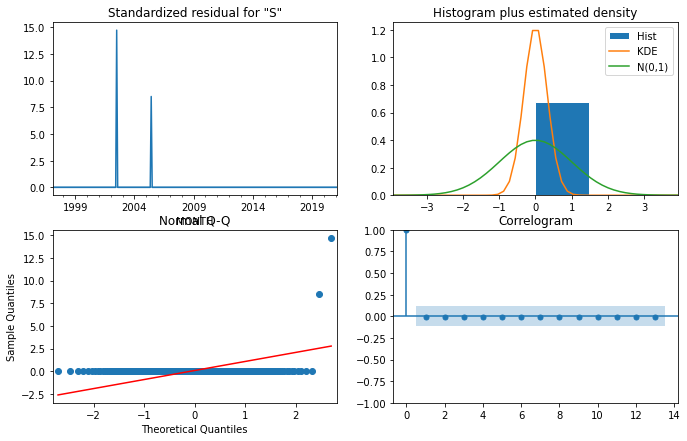

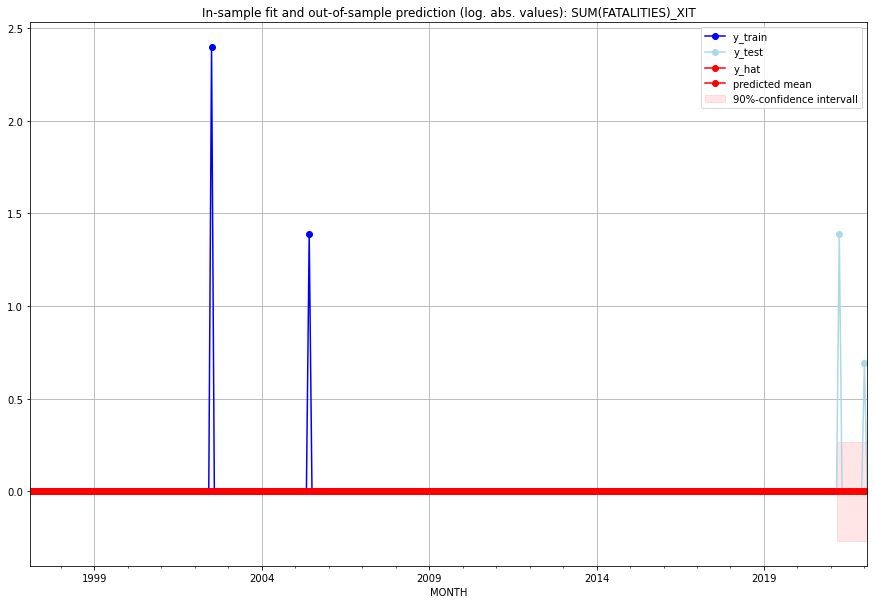

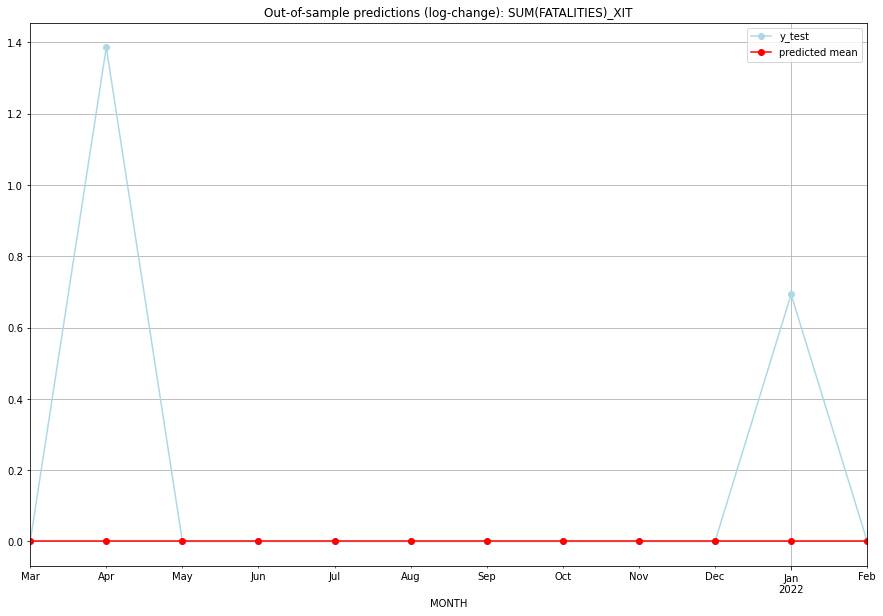

TADDA: 0.17328679513998632
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0        0.000000   XIT   
1  2021-04-01       0.0         3.0           0.0        1.386294   XIT   
2  2021-05-01       0.0         0.0           0.0        0.000000   XIT   
3  2021-06-01       0.0         0.0           0.0        0.000000   XIT   
4  2021-07-01       0.0         0.0           0.0        0.000000   XIT   
5  2021-08-01       0.0         0.0           0.0        0.000000   XIT   
6  2021-09-01       0.0         0.0           0.0        0.000000   XIT   
7  2021-10-01       0.0         0.0           0.0        0.000000   XIT   
8  2021-11-01       0.0         0.0           0.0        0.000000   XIT   
9  2021-12-01       0.0         0.0           0.0        0.000000   XIT   
10 2022-01-01       0.0         1.0           0.0        0.693147   XIT   
11 2022-02-01       0.0         0.0           0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.02986265782046758, 'fold_results': [0.0, 0.0, 0.0, 0.0, 0.1493132891023379]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_XKK   No. Observations:                  289
Model:                         SARIMAX   Log Likelihood                -112.227
Date:                 Wed, 19 Oct 2022   AIC                            226.454
Time:                         11:16:26   BIC                            230.120
Sample:                     02-28-1997   HQIC                           227.923
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.1273      0

<Figure size 432x288 with 0 Axes>

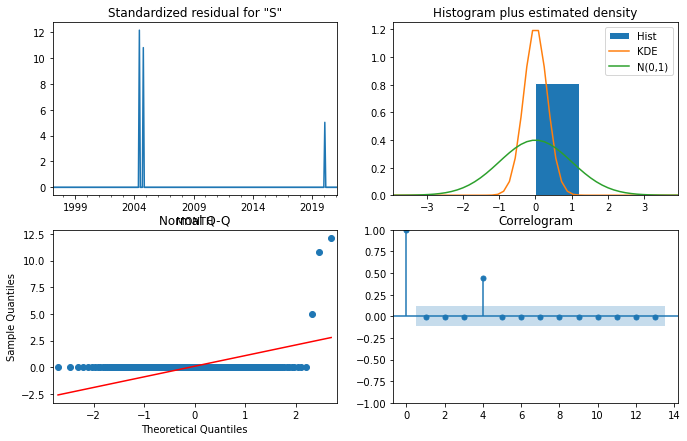

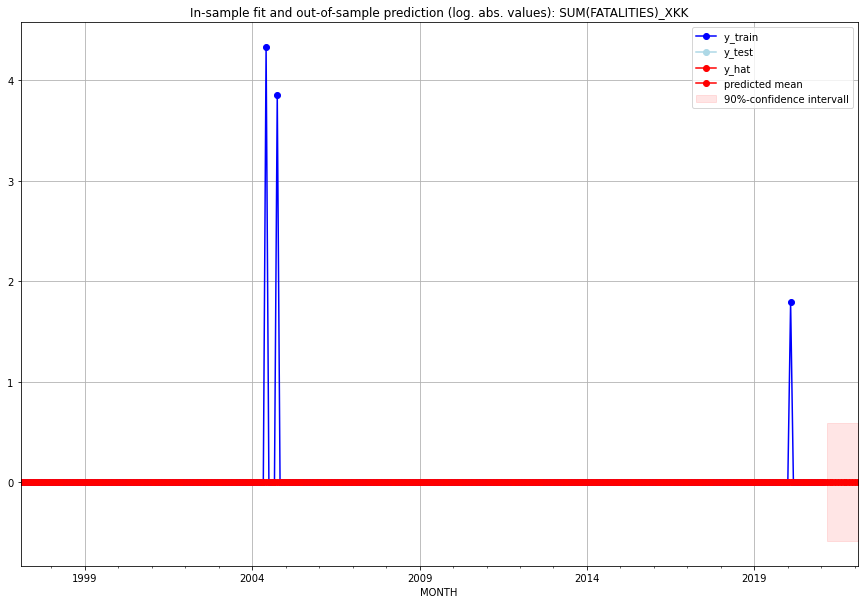

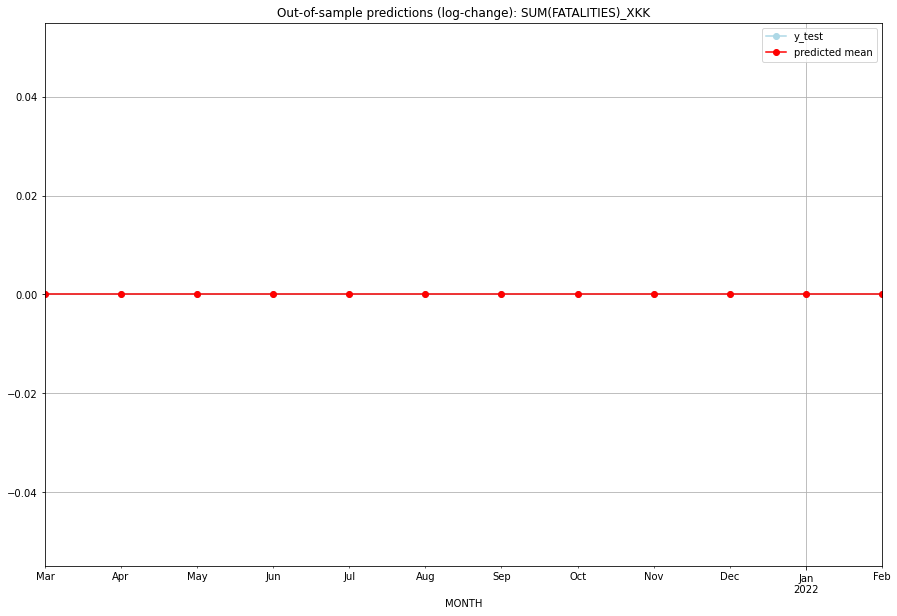

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   XKK   
1  2021-04-01       0.0         0.0           0.0             0.0   XKK   
2  2021-05-01       0.0         0.0           0.0             0.0   XKK   
3  2021-06-01       0.0         0.0           0.0             0.0   XKK   
4  2021-07-01       0.0         0.0           0.0             0.0   XKK   
5  2021-08-01       0.0         0.0           0.0             0.0   XKK   
6  2021-09-01       0.0         0.0           0.0             0.0   XKK   
7  2021-10-01       0.0         0.0           0.0             0.0   XKK   
8  2021-11-01       0.0         0.0           0.0             0.0   XKK   
9  2021-12-01       0.0         0.0           0.0             0.0   XKK   
10 2022-01-01       0.0         0.0           0.0             0.0   XKK   
11 2022-02-01       0.0         0.0           0.0             0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.0, 'fold_results': [0.0, 0.0]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_XKO   No. Observations:                   38
Model:                         SARIMAX   Log Likelihood                   0.493
Date:                 Wed, 19 Oct 2022   AIC                              1.013
Time:                         11:16:29   BIC                              2.651
Sample:                     01-31-2018   HQIC                             1.596
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.0570      0.005     11.741      0.000       0.048       0

<Figure size 432x288 with 0 Axes>

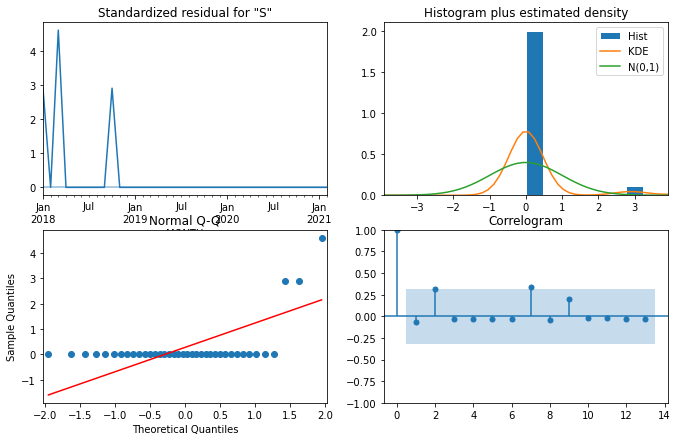

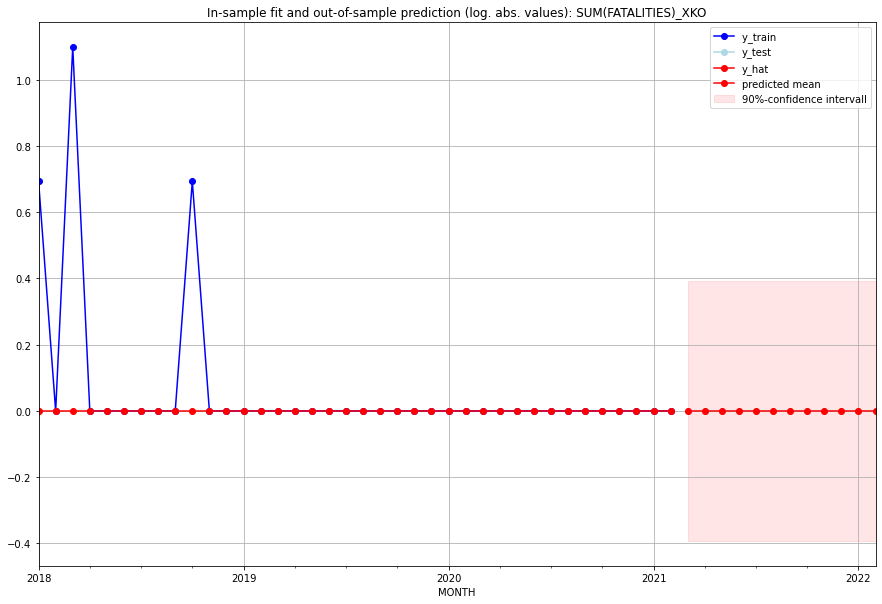

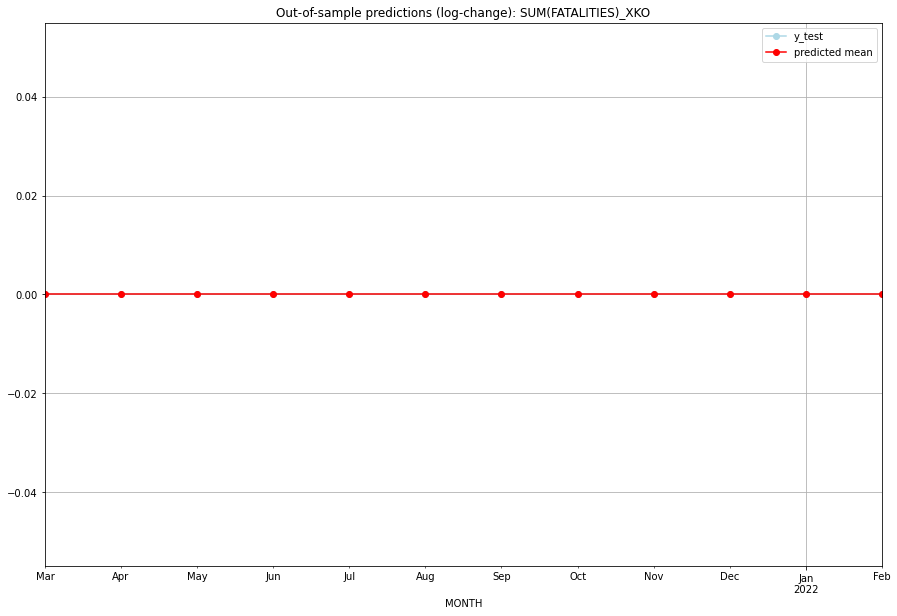

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   XKO   
1  2021-04-01       0.0         0.0           0.0             0.0   XKO   
2  2021-05-01       0.0         0.0           0.0             0.0   XKO   
3  2021-06-01       0.0         0.0           0.0             0.0   XKO   
4  2021-07-01       0.0         0.0           0.0             0.0   XKO   
5  2021-08-01       0.0         0.0           0.0             0.0   XKO   
6  2021-09-01       0.0         0.0           0.0             0.0   XKO   
7  2021-10-01       0.0         0.0           0.0             0.0   XKO   
8  2021-11-01       0.0         0.0           0.0             0.0   XKO   
9  2021-12-01       0.0         0.0           0.0             0.0   XKO   
10 2022-01-01       0.0         0.0           0.0             0.0   XKO   
11 2022-02-01       0.0         0.0           0.0             0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.028881132523331052, 'fold_results': [0.057762265046662105, 0.0]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_XNC   No. Observations:                   38
Model:                         SARIMAX   Log Likelihood                  15.952
Date:                 Wed, 19 Oct 2022   AIC                            -29.904
Time:                         11:16:33   BIC                            -28.267
Sample:                     01-31-2018   HQIC                           -29.322
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.0253      0.002     13.

<Figure size 432x288 with 0 Axes>

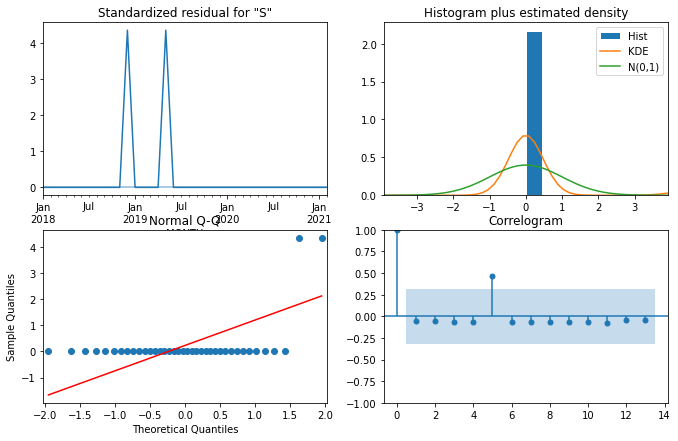

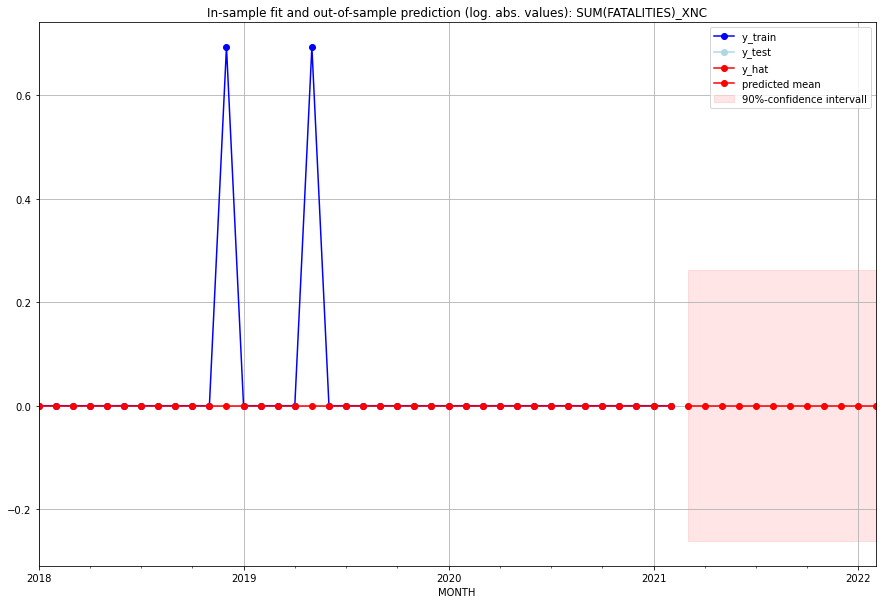

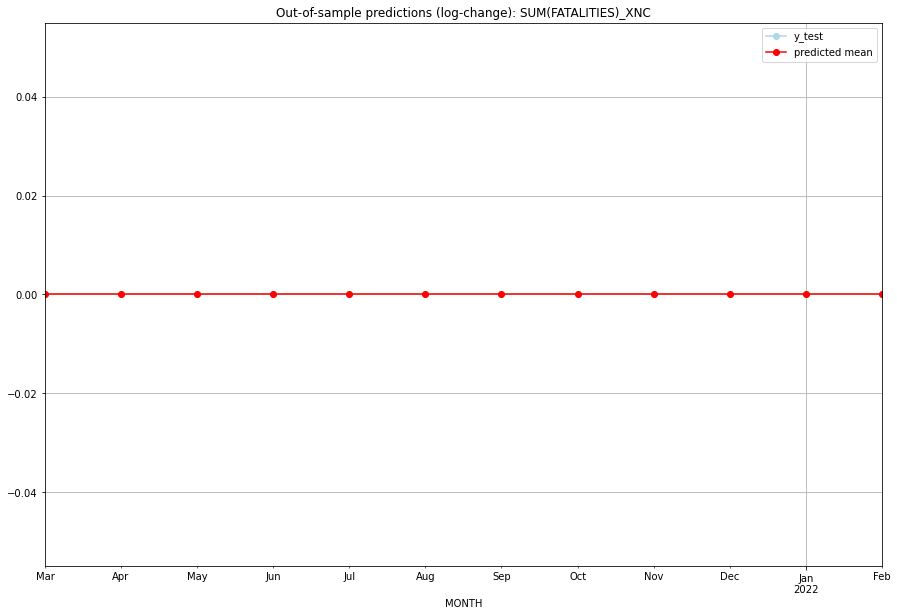

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   XNC   
1  2021-04-01       0.0         0.0           0.0             0.0   XNC   
2  2021-05-01       0.0         0.0           0.0             0.0   XNC   
3  2021-06-01       0.0         0.0           0.0             0.0   XNC   
4  2021-07-01       0.0         0.0           0.0             0.0   XNC   
5  2021-08-01       0.0         0.0           0.0             0.0   XNC   
6  2021-09-01       0.0         0.0           0.0             0.0   XNC   
7  2021-10-01       0.0         0.0           0.0             0.0   XNC   
8  2021-11-01       0.0         0.0           0.0             0.0   XNC   
9  2021-12-01       0.0         0.0           0.0             0.0   XNC   
10 2022-01-01       0.0         0.0           0.0             0.0   XNC   
11 2022-02-01       0.0         0.0           0.0             0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [1, (2, 1, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.26838481619890353, 'fold_results': [nan, 0.35361843163628026, 0.17242883770196774, 0.3782023018232455, 0.16928969363412052]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_YEM   No. Observations:                   74
Model:                SARIMAX(2, 1, 3)   Log Likelihood                  -8.077
Date:                 Wed, 19 Oct 2022   AIC                             30.154
Time:                         11:16:43   BIC                             46.187
Sample:                     01-31-2015   HQIC                            36.544
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------

<Figure size 432x288 with 0 Axes>

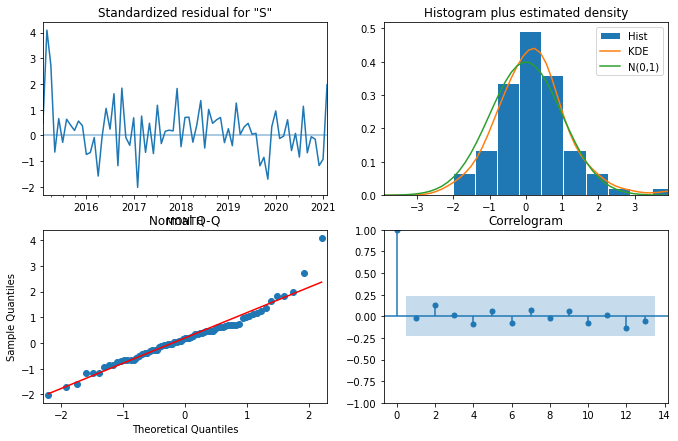

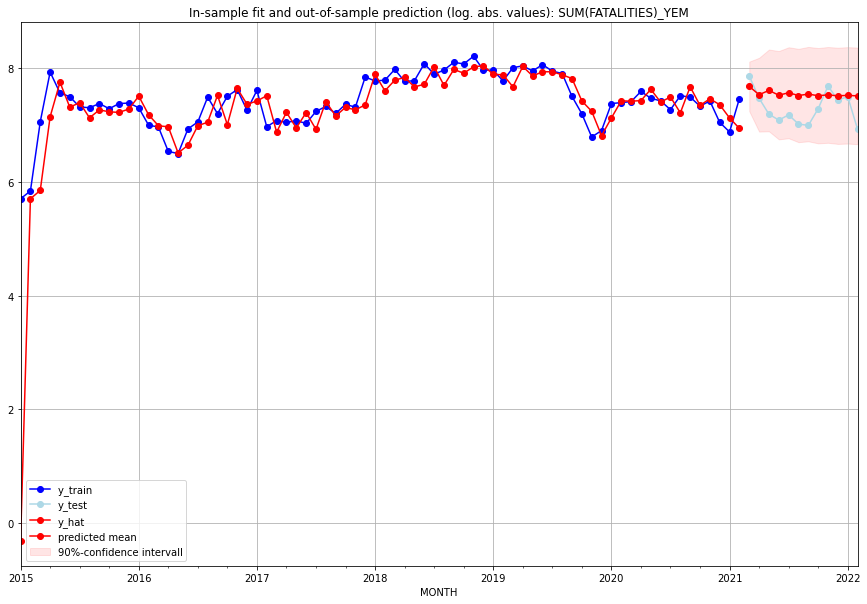

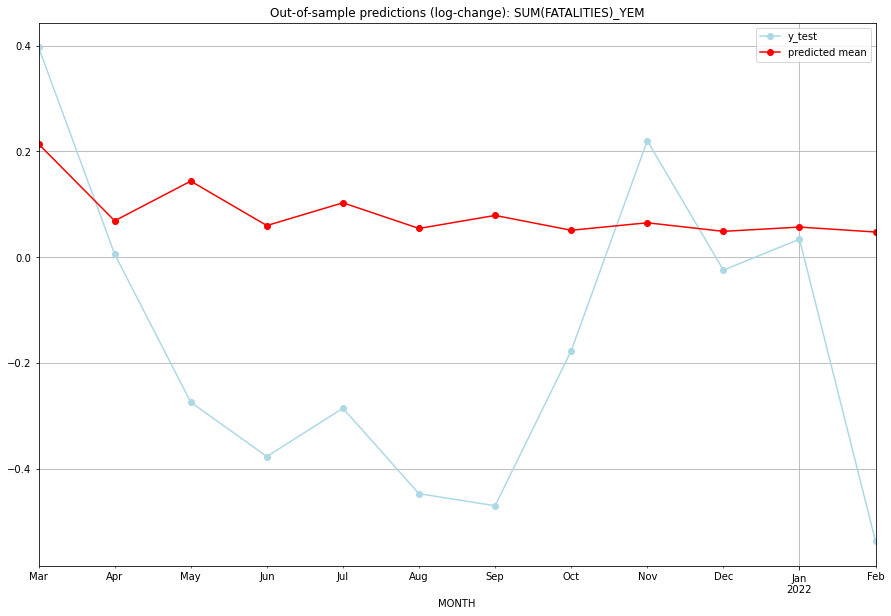

TADDA: 0.34937321430449725
Evaluation finished.
        MONTH     FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  2151.940283      2584.0      0.214099        0.396990   YEM   
1  2021-04-01  1860.724940      1747.0      0.068768        0.005737   YEM   
2  2021-05-01  2005.805793      1320.0      0.143809       -0.274346   YEM   
3  2021-06-01  1844.154964      1191.0      0.059828       -0.377102   YEM   
4  2021-07-01  1925.259112      1305.0      0.102845       -0.285766   YEM   
5  2021-08-01  1834.006232      1110.0      0.054313       -0.447475   YEM   
6  2021-09-01  1879.812367      1085.0      0.078969       -0.470234   YEM   
7  2021-10-01  1827.792679      1455.0      0.050921       -0.177042   YEM   
8  2021-11-01  1853.817552      2165.0      0.065051        0.220147   YEM   
9  2021-12-01  1823.992614      1695.0      0.048841       -0.024462   YEM   
10 2022-01-01  1838.829673      1797.0      0.056938        0.033940   YEM   
11 2022-02-01  1

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.41374650780283184, 'fold_results': [0.40429294842879004, 0.5776573654570557, 0.45093000209283357, 0.405981581911853, 0.22987064112362696]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_ZAF   No. Observations:                  289
Model:                SARIMAX(0, 1, 0)   Log Likelihood                -408.038
Date:                 Wed, 19 Oct 2022   AIC                            818.076
Time:                         11:16:55   BIC                            821.739
Sample:                     02-28-1997   HQIC                           819.544
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------

<Figure size 432x288 with 0 Axes>

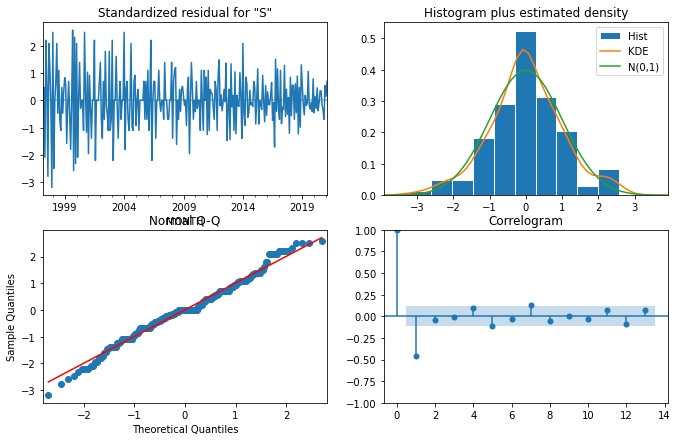

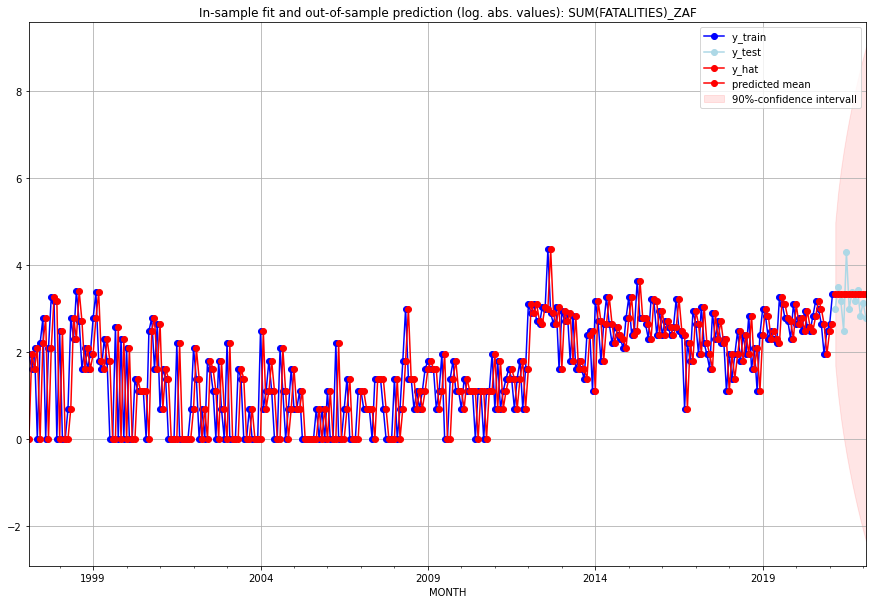

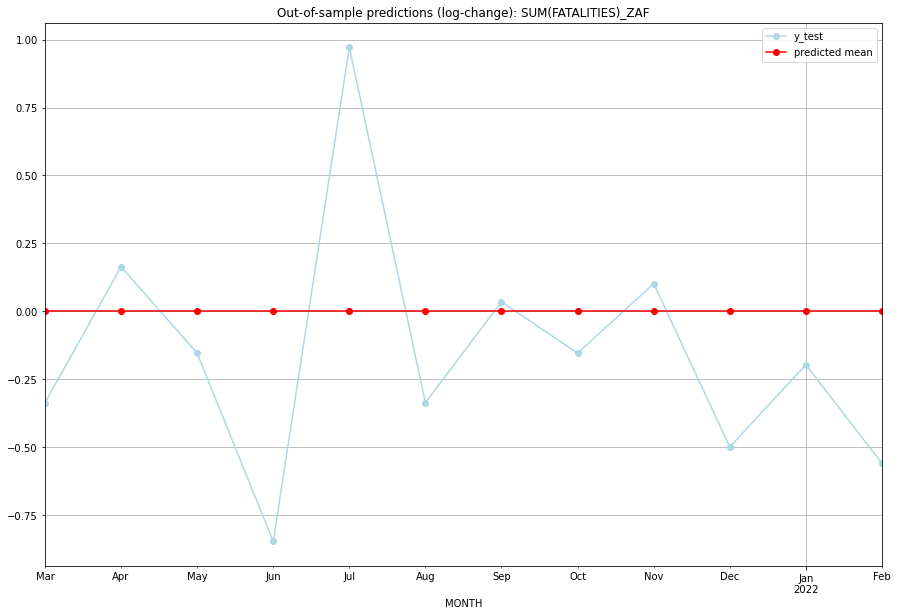

TADDA: 0.3630748825021725
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01      27.0        19.0  4.440892e-16       -0.336472   ZAF   
1  2021-04-01      27.0        32.0  4.440892e-16        0.164303   ZAF   
2  2021-05-01      27.0        23.0  4.440892e-16       -0.154151   ZAF   
3  2021-06-01      27.0        11.0  4.440892e-16       -0.847298   ZAF   
4  2021-07-01      27.0        73.0  4.440892e-16        0.971861   ZAF   
5  2021-08-01      27.0        19.0  4.440892e-16       -0.336472   ZAF   
6  2021-09-01      27.0        28.0  4.440892e-16        0.035091   ZAF   
7  2021-10-01      27.0        23.0  4.440892e-16       -0.154151   ZAF   
8  2021-11-01      27.0        30.0  4.440892e-16        0.101783   ZAF   
9  2021-12-01      27.0        16.0  4.440892e-16       -0.498991   ZAF   
10 2022-01-01      27.0        22.0  4.440892e-16       -0.196710   ZAF   
11 2022-02-01      27.0        15.0  4.440892e-16    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (1, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.5082960811458047, 'fold_results': [0.5230148764092379, 0.17328679513998632, 0.5057021323536759, 0.6168836623520824, 0.7225929394740414]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_ZMB   No. Observations:                  289
Model:                SARIMAX(1, 1, 0)   Log Likelihood                -307.997
Date:                 Wed, 19 Oct 2022   AIC                            619.994
Time:                         11:17:08   BIC                            627.320
Sample:                     02-28-1997   HQIC                           622.930
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------

<Figure size 432x288 with 0 Axes>

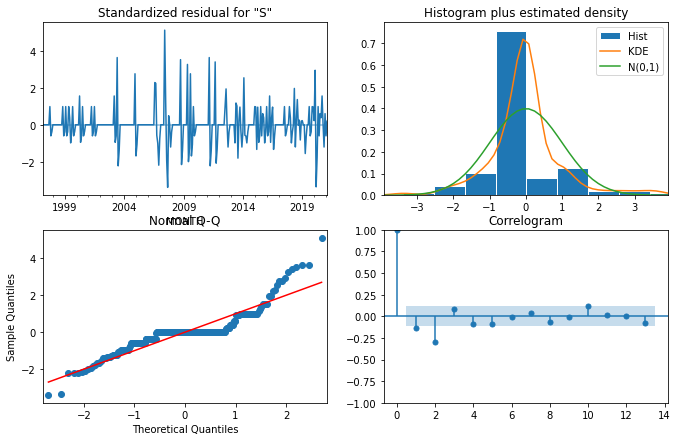

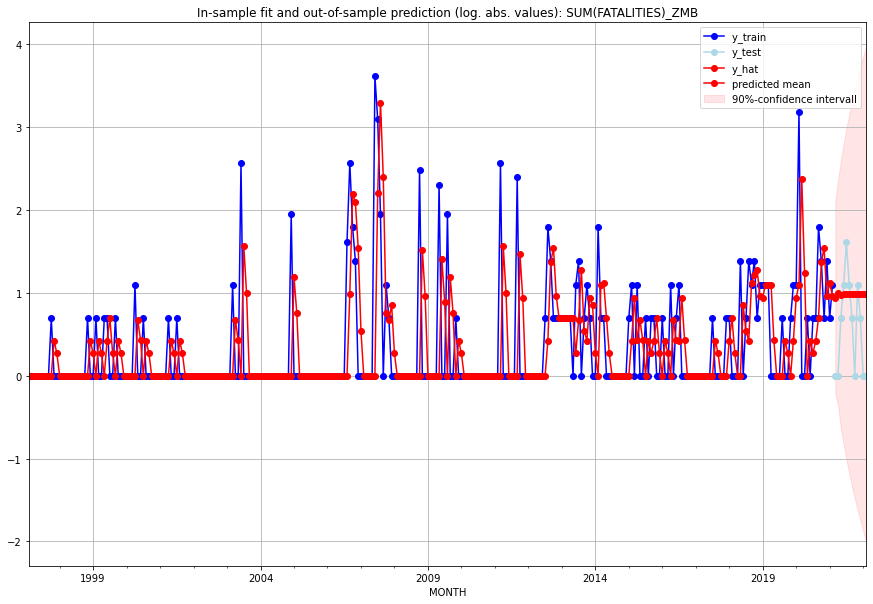

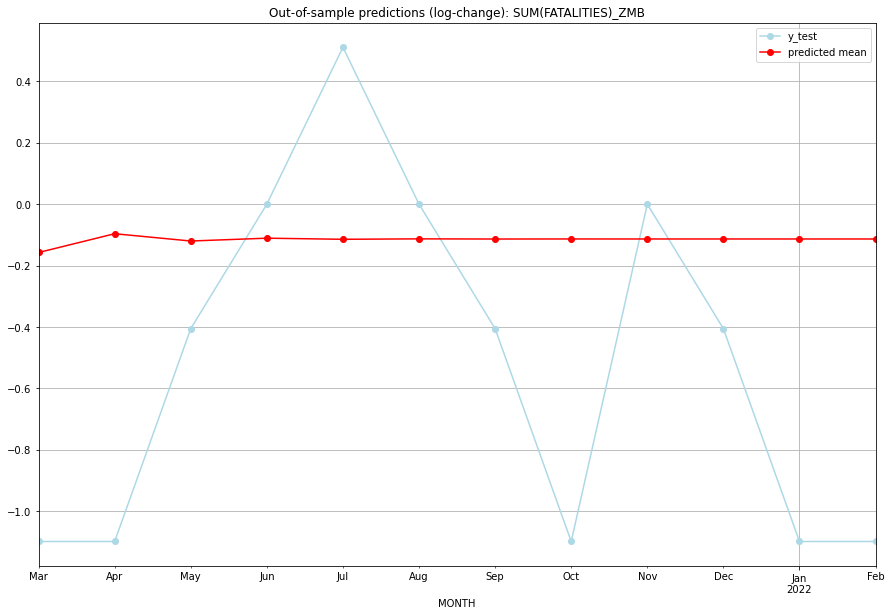

TADDA: 0.5704568212931747
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  1.563009         0.0     -0.157430       -1.098612   ZMB   
1  2021-04-01  1.724562         0.0     -0.096305       -1.098612   ZMB   
2  2021-05-01  1.660660         1.0     -0.120038       -0.405465   ZMB   
3  2021-06-01  1.685291         2.0     -0.110823        0.000000   ZMB   
4  2021-07-01  1.675701         4.0     -0.114401        0.510826   ZMB   
5  2021-08-01  1.679420         2.0     -0.113012        0.000000   ZMB   
6  2021-09-01  1.677975         1.0     -0.113551       -0.405465   ZMB   
7  2021-10-01  1.678536         0.0     -0.113342       -1.098612   ZMB   
8  2021-11-01  1.678319         2.0     -0.113423        0.000000   ZMB   
9  2021-12-01  1.678403         1.0     -0.113392       -0.405465   ZMB   
10 2022-01-01  1.678370         0.0     -0.113404       -1.098612   ZMB   
11 2022-02-01  1.678383         0.0     -0.113399    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [2, (0, 1, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.5703618472334586, 'fold_results': [0.387329207072957, 0.4741369721177883, 0.8818277432066489, 0.6401906821354473, 0.4683246316344516]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_ZWE   No. Observations:                  289
Model:                SARIMAX(0, 1, 2)   Log Likelihood                -304.469
Date:                 Wed, 19 Oct 2022   AIC                            618.937
Time:                         11:17:22   BIC                            637.252
Sample:                     02-28-1997   HQIC                           626.277
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------

<Figure size 432x288 with 0 Axes>

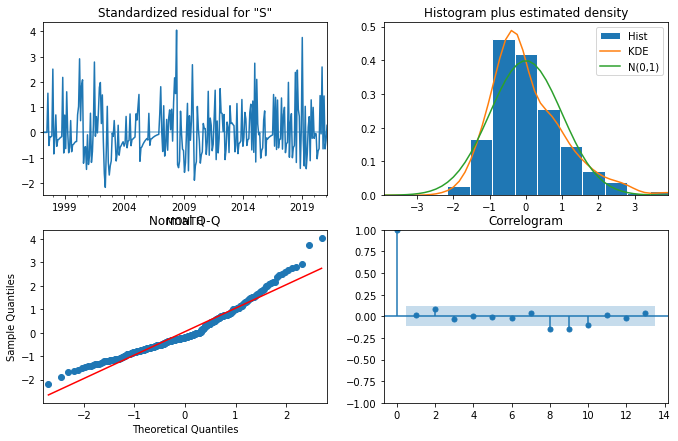

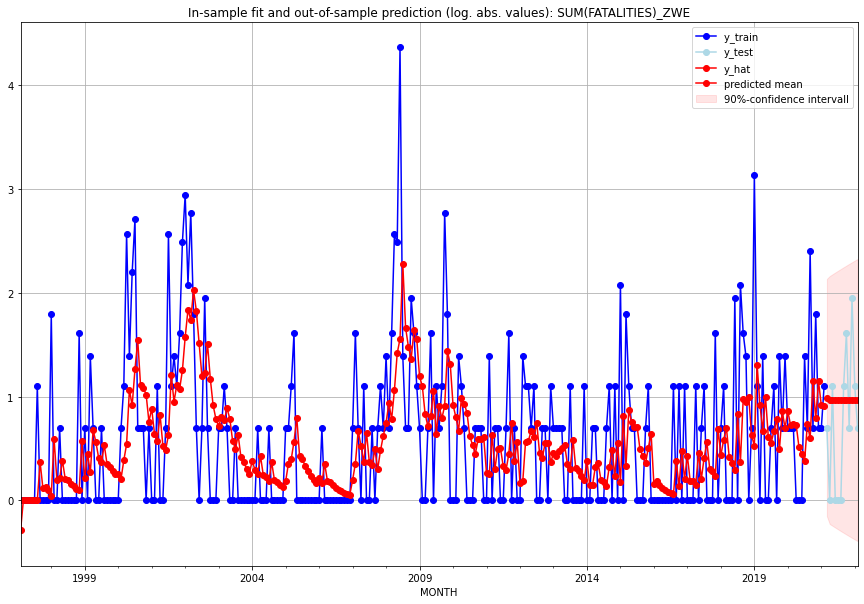

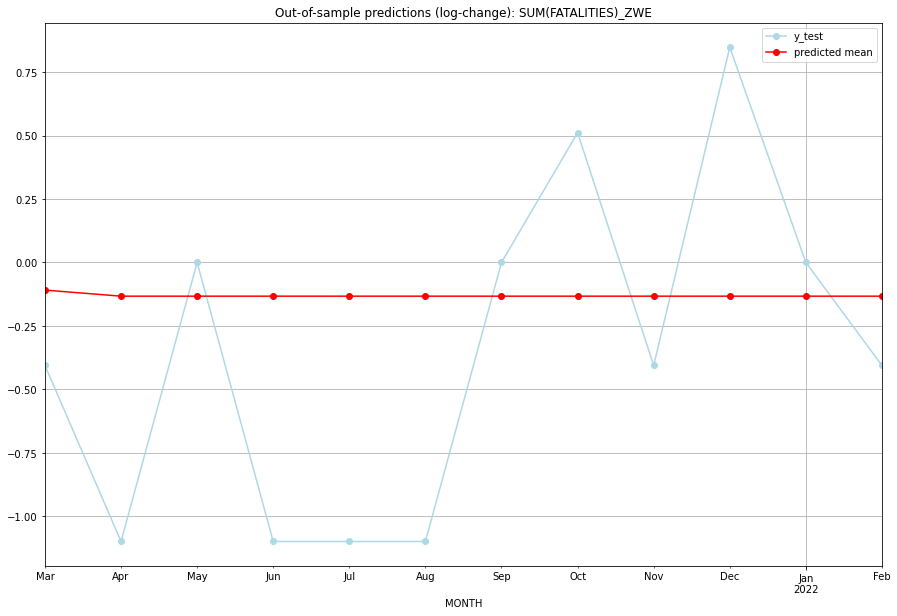

TADDA: 0.582737394796054
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  1.690945         1.0     -0.108720       -0.405465   ZWE   
1  2021-04-01  1.627444         0.0     -0.132601       -1.098612   ZWE   
2  2021-05-01  1.627444         2.0     -0.132601        0.000000   ZWE   
3  2021-06-01  1.627444         0.0     -0.132601       -1.098612   ZWE   
4  2021-07-01  1.627444         0.0     -0.132601       -1.098612   ZWE   
5  2021-08-01  1.627444         0.0     -0.132601       -1.098612   ZWE   
6  2021-09-01  1.627444         2.0     -0.132601        0.000000   ZWE   
7  2021-10-01  1.627444         4.0     -0.132601        0.510826   ZWE   
8  2021-11-01  1.627444         1.0     -0.132601       -0.405465   ZWE   
9  2021-12-01  1.627444         6.0     -0.132601        0.847298   ZWE   
10 2022-01-01  1.627444         2.0     -0.132601        0.000000   ZWE   
11 2022-02-01  1.627444         1.0     -0.132601     

In [8]:
# warnings.simplefilter(action='ignore')

sarimax_res = pd.DataFrame(columns=["MONTH", "FAT_PRED", "FAT_ACTUAL", "LC(FAT_PRED)", "LC(FAT_ACTUAL)", "GID_0", "PARAMETERS", "TIMESTAMP"])
csv_file = "../data/"+MODEL_NAME+"_PREDICTIONS.csv"

if os.path.exists(csv_file):
    existing_res = pd.read_csv("../data/"+MODEL_NAME+"_PREDICTIONS.csv")
    # print(existing_res)
    print("File already exists.")
    
else:
    sarimax_res.to_csv(csv_file, index=False, mode="a", header=True)
    existing_res = sarimax_res

for i, g in enumerate(gid_list):
# for i, g in enumerate(["XNC"]):
    print("######## "+g+" ("+str(i+1)+"/"+str(len(gid_list))+") #########")
    # print(existing_res[existing_res["GID_0"] == g])
    print(len(existing_res[existing_res["GID_0"] == g]))
    
    
    # skip country if results already exiast
    if len(existing_res[existing_res["GID_0"] == g]) > 0:
        print("Model for this country has already been fitted.")
        continue
    
    # add time series of neighboring  countries as predictor variables

    if NEIGHBORS == True:
        neighbor = gid0_neighbors[gid0_neighbors["GID_0"] == g]["NEIGHBOUR"].tolist()
    else:
        neighbor = []
    print("Neighbor countries: "+ str(neighbor))

    # measure time 
    st = time.time()

    res = sarimax(target_variable = TARGET_VARIABLE,
                  target_country = g,
                  predictor_countries = neighbor,
                  n_lags_X = N_LAGS_X,
                  seasonal_periodicity = SEASONAL_PERIODICITY)

    # append country results to csv with timestamp
    res["TIMESTAMP"] = datetime.datetime.now()
    
    res.to_csv(csv_file, index=False, mode="a", header=False)

    et = time.time()
    elapsed_time = et - st
    print('Execution time:', time.strftime("%M:%S", time.gmtime(elapsed_time)))

    sarimax_res = pd.concat([sarimax_res, res], ignore_index=True)

    # break

In [9]:
# varimax_res.to_csv("../data/"+MODEL_NAME+"_PREDICTIONS.csv", index=False)

In [10]:
sarimax_res

,MONTH,FAT_PRED,FAT_ACTUAL,LC(FAT_PRED),LC(FAT_ACTUAL),GID_0,PARAMETERS,TIMESTAMP
0,2021-03-01 00:00:00,0.0,0.0,0.0,0.0,ABW,{},2022-10-19 10:23:25.381216
1,2021-04-01 00:00:00,0.0,0.0,0.0,0.0,ABW,{},2022-10-19 10:23:25.381216
2,2021-05-01 00:00:00,0.0,0.0,0.0,0.0,ABW,{},2022-10-19 10:23:25.381216
3,2021-06-01 00:00:00,0.0,0.0,0.0,0.0,ABW,{},2022-10-19 10:23:25.381216
4,2021-07-01 00:00:00,0.0,0.0,0.0,0.0,ABW,{},2022-10-19 10:23:25.381216
...,...,...,...,...,...,...,...,...
2803,2021-10-01 00:00:00,1.627444,4.0,-0.132601,0.510826,ZWE,"{'params': [2, (0, 1, 2), (0, 0, 0, 0), 'n'], ...",2022-10-19 11:17:23.629977
2804,2021-11-01 00:00:00,1.627444,1.0,-0.132601,-0.405465,ZWE,"{'params': [2, (0, 1, 2), (0, 0, 0, 0), 'n'], ...",2022-10-19 11:17:23.629977
2805,2021-12-01 00:00:00,1.627444,6.0,-0.132601,0.847298,ZWE,"{'params': [2, (0, 1, 2), (0, 0, 0, 0), 'n'], ...",2022-10-19 11:17:23.629977
2806,2022-01-01 00:00:00,1.627444,2.0,-0.132601,0.0,ZWE,"{'params': [2, (0, 1, 2), (0, 0, 0, 0), 'n'], ...",2022-10-19 11:17:23.629977
